In [58]:
#%matplotlib inline
#%matplotlib ipympl
from scipy.stats import pearsonr
import numpy as np
import pandas as pd
import os
dataset="books"
df=None
datasets=["books","wmt", "global", "global_doc","wilde"]
src_surps={}
tgt_surps={}
trans_surps={}
suffix=""
skip_first=True
for dataset in datasets:
    for suffix in ["", "_no_punct"]:
        if dataset=="wmt":
            src_sent_f="wmt14.enfr.en"
            tgt_sent_f="wmt14.enfr.fr"
            trans_sent_f="wmt14.enfr.google.trans"
            src_surp_f="wmt14.enfr.en.surp"+suffix
            tgt_surp_f="wmt14.enfr.fr.surp"+suffix
            trans_surp_f="wmt14.enfr.google.trans.surp"+suffix
        elif dataset=="global_doc":
            src_sent_f="dev.en.doc"
            tgt_sent_f="dev.fr.doc"
            trans_sent_f="dev.en.detok.google.trans.doc"
            src_surp_f="dev.en.doc.surp"+suffix
            tgt_surp_f="dev.fr.doc.surp"+suffix
            trans_surp_f="dev.google.trans.doc.surp"+suffix
        elif dataset=="global":
            src_sent_f="dev.en.detok.snt"
            tgt_sent_f="dev.fr.detok.snt"
            trans_sent_f="dev.en.detok.google.trans.snt"
            src_surp_f="dev.en.surp"+suffix
            tgt_surp_f="dev.fr.surp"+suffix
            trans_surp_f="dev.google.trans.surp"+suffix
        elif dataset=="books":
            src_sent_f="Books.test.enfr.en"
            tgt_sent_f="Books.test.enfr.fr"
            trans_sent_f="Books.test.enfr.google.trans"
            src_surp_f="Books.test.enfr.en.surp"+suffix
            tgt_surp_f="Books.test.enfr.fr.surp"+suffix
            trans_surp_f="Books.test.enfr.google.trans.surp"+suffix
        elif dataset=="wilde":
            src_sent_f="poem.en.doc"
            tgt_sent_f="poem.fr.doc"
            trans_sent_f="poem.en.trans.google.doc"
            src_surp_f="poem.en.doc.surp"+suffix
            tgt_surp_f="poem.fr.doc.surp"+suffix
            trans_surp_f="poem.en.trans.google.doc.surp"+suffix
        comet_f=trans_sent_f+".comet"
        dataset=dataset+suffix
        df_ds=pd.DataFrame()
        with open(src_sent_f) as src:
            df_ds['source_sent']=src.readlines()
        with open(tgt_sent_f) as tgt:
            df_ds['target_sent']=tgt.readlines()
        with open(trans_sent_f) as trans:
            df_ds['trans_sent']=trans.readlines()
        with open(comet_f) as trans:
            trans_comet=[float(f.strip().split('score: ')[-1]) for f in trans.readlines()][:-1]
            df_ds['trans_comet']=trans_comet
        src_surps_dataset=[]
        tgt_surps_dataset=[]
        trans_surps_dataset=[]
        with open(src_surp_f) as src:
            for l in src:
                s=[float(x) for x in l.strip().split(",")]
                if skip_first and len(s)>1:
                    s=s[1:]
                src_surps_dataset.append(s)
        with open(tgt_surp_f) as tgt:
            for l in tgt:
                s=[float(x) for x in l.strip().split(",")]
                if skip_first and len(s)>1:
                    s=s[1:]
                tgt_surps_dataset.append(s)
        with open(trans_surp_f) as trans:
            for l in trans:
                s=[float(x) for x in l.strip().split(",")]
                if skip_first and len(s)>1:
                    s=s[1:]
                trans_surps_dataset.append(s)
        src_surps[dataset]=src_surps_dataset
        tgt_surps[dataset]=tgt_surps_dataset
        trans_surps[dataset]=trans_surps_dataset

        df_ds['dataset']=dataset
        print(df_ds)
        if df is None:
            df=df_ds
        else:
            df=pd.concat([df,df_ds])
print(df)

                                            source_sent  \
0     There she chose books to the value of ten loui...   
1     "What the deuce!" he roared, and then, "I'll b...   
2      Sing her "Turtle Soup," will you, old fellow?'\n   
3     "Has she left me a bed, at least?" said our ph...   
4     "Quite uncommon," I murmured; and George asked...   
...                                                 ...   
3995  He reached us before we could think of better ...   
3996   "Did ever you witness anything more masterly?"\n   
3997  And above all, what must he have thought when ...   
3998  He was on the point of betraying himself by so...   
3999  At seven o'clock little Berthe, who had not se...   

                                            target_sent  \
0     Là, elle choisit pour dix louis de livres qu’e...   
1     -- Qui diable?... hurla-t-il. Puis il ajouta: ...   
2     Chantez-lui « La Soupe à la Tortue, » hé ! cam...   
3     « M’a-t-elle au moins laissé un lit ? » dit no...

                                            source_sent  \
0     Serbia: Demonstrators Attack Journalists in Be...   
1     Starting with the night when Radovan Karadzic ...   
2     High Treason The arrest of Radovan Karadzic is...   
3     Every Serb knows who Radovan Karadzic is and w...   
4                              Every Serb is Radovan!\n   
...                                                 ...   
9190       Police: three terrorists are still inside.\n   
9191  update 14: 55 - cheerful calls next to Chabad ...   
9192  CNN: the commando forces overpowered the terro...   
9193  The emissary and his wife's status is still un...   
9194  update 15: 48 - five Jews found dead in Chabad...   

                                            target_sent  \
0     Serbie: Les blogueurs serbes commentent l' arr...   
1     Quelques jours après le 13ème anniversaire du ...   
2     C' est dans la nuit du 21 au 22 juillet 2008 q...   
3     La nouvelle a surpris plusieurs blogueurs de l...

                                           source_sent  \
0    He did not wear his scarlet coat,   For blood ...   
1    He walked amongst the Trial Men   In a suit of...   
2    I never saw a man who looked   With such a wis...   
3    I walked, with other souls in pain,   Within a...   
4    Dear Christ! the very prison walls   Suddenly ...   
..                                                 ...   
104  The man in red who reads the Law   Gave him th...   
105  And with tears of blood he cleansed the hand, ...   
106  In Reading gaol by Reading town   There is a p...   
107  And there, till Christ call forth the dead,   ...   
108  And all men kill the thing they love,   By all...   

                                           target_sent  \
0    Plus d’uniforme d’écarlate Car rouges sont le ...   
1    Il marchait, habit gris râpé, Parmi les Hommes...   
2    Tant de regret jamais ne vis Dans les yeux d’u...   
3    Parmi d’autres âmes en peine, Dans l’autre cer...   
4    Mon Dieu

In [59]:
# compute the measures

SKIP_FIRST=False
def kl_divergence(surp,*args):
    n=len(surp)
    surp_normalized = surp / np.sum(surp)
    uniform_distribution = np.full(n, 1 / n) * n
    return np.sum(surp_normalized * np.log2(surp_normalized / uniform_distribution))

def gini_coefficient(x,*args):
    """Compute Gini coefficient of array of values"""
    diffsum = 0
    for i, xi in enumerate(x[:-1], 1):
        diffsum += np.sum(np.abs(xi - x[i:]))
    return diffsum / (len(x)**2 * np.mean(x))

def cv(surp,*args):
    return np.std(surp) / np.mean(surp)
def x_log2_x(x):
    """ Return x * log2(x) and 0 if x is 0."""
    results = x * np.log2(x)
    if np.size(x) == 1:
        if np.isclose(x, 0.0):
            results = 0.0
    else:
        results[np.isclose(x, 0.0)] = 0.0
    return results

def renyi(X, sent, alpha=1):
    assert alpha >= 0, "Error: renyi_entropy only accepts values of alpha >= 0, but alpha = {}.".format(alpha)  # DEBUG
    if np.isinf(alpha):
        # XXX Min entropy!
        return - np.log2(np.max(X))
    elif np.isclose(alpha, 0):
        # XXX Max entropy!
        return np.log2(len(X))
    elif np.isclose(alpha, 1):
        # XXX Shannon entropy!
        return - np.sum(x_log2_x(X))
    else:
        return (1.0 / (1.0 - alpha)) * np.log2(np.sum(X ** alpha)) 
def gv(surp,mean=None):
    gv=0
    for i in range(0,len(surp)-1):
        gv+=(surp[i]-mean)**2
    return gv/len(surp)
def sl(surp,k):
    #return np.sum(np.asarray(surp)**k)/len(surp)
    return np.nanmean(np.asarray(surp)**k)
def slor(surp,sentence, k=1):
    print(sentence)
    return sl(surp,k)-get_unigram_log_prob(sentence,unigram_mapping)/len(sentence.split(" "))
def normlp(surp,sentence, k):
    return sl(surp,k)*len(sentence.split(" "))/get_unigram_log_prob(sentence,unigram_mapping)
def local_variance(surp,*args):
    lv=0
    for i in range(1,len(surp)):
        lv+=(surp[i]-surp[i-1])**2
    return lv/len(surp)
fnames = ["const", "L"]+["SL_"+str(k) for k in range(25,1000,25)] +["gini", "kl", "cv","lv", "renyi"]
flist = [lambda surp,_: 1, lambda surp,_: sl(surp, 1)] + [lambda surp,_,k=k: sl(surp, k/100.0) for k in range(25,1000,25)]+\
         [gini_coefficient, kl_divergence, cv, local_variance, renyi]

def compute_metrics(surps, fn, sentences=None, unigram_log_probs=None):
    if sentences is None:
        sentences = [None]*len(surps)
    if unigram_log_probs is None:
        unigram_log_probs = [None]*len(surps)
    assert len(surps) == len(unigram_log_probs) == len(sentences)
    out = []
    lens = []
    f=flist[fnames.index(fn)]
    #print(surps, file=sys.stderr)
    for sent_surp,unigram_log_prob, sent in zip(surps, unigram_log_probs, sentences):
        if "unigram" in fn.lower():
            fval = f(np.asarray(unigram_log_prob),sent)
        else:
            fval = f(np.asarray(sent_surp),sent)
        out.append(fval)
        lens.append(float(len(sent_surp)))
        #print(fn)
        #print(len(out))
        #print(len(df))
       # df.loc[:, fn] = out
       # df.loc[:, fn+'_times_len'] = np.asarray(out)*np.asarray(lens)
        #df=add_lau_accept_measures(df)
    return out
for suffix in ["", "_no_punct"]:
    for dataset in datasets:
        print(dataset)
        dataset=dataset+suffix
        for fn in fnames:
            df.loc[df["dataset"]==dataset,"src_"+fn]=compute_metrics(src_surps[dataset], fn)
            df.loc[df["dataset"]==dataset,"tgt_"+fn]=compute_metrics(tgt_surps[dataset], fn)
            df.loc[df["dataset"]==dataset,"trans_"+fn]=compute_metrics(trans_surps[dataset], fn)
print(df)

books


/tmp/ipykernel_61276/1935812228.py:95: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df.loc[df["dataset"]==dataset,"trans_"+fn]=compute_metrics(trans_surps[dataset], fn)
/tmp/ipykernel_61276/1935812228.py:93: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df.loc[df["dataset"]==dataset,"src_"+fn]=compute_metrics(src_surps[dataset], fn)
/tmp/ipykernel_61276/1935812228.py:94: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joi

/tmp/ipykernel_61276/1935812228.py:95: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df.loc[df["dataset"]==dataset,"trans_"+fn]=compute_metrics(trans_surps[dataset], fn)
/tmp/ipykernel_61276/1935812228.py:93: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df.loc[df["dataset"]==dataset,"src_"+fn]=compute_metrics(src_surps[dataset], fn)
/tmp/ipykernel_61276/1935812228.py:94: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joi

/tmp/ipykernel_61276/1935812228.py:95: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df.loc[df["dataset"]==dataset,"trans_"+fn]=compute_metrics(trans_surps[dataset], fn)


wmt
global
global_doc
wilde
books
wmt
global
global_doc
wilde
                                           source_sent  \
0    There she chose books to the value of ten loui...   
1    "What the deuce!" he roared, and then, "I'll b...   
2     Sing her "Turtle Soup," will you, old fellow?'\n   
3    "Has she left me a bed, at least?" said our ph...   
4    "Quite uncommon," I murmured; and George asked...   
..                                                 ...   
104  The man in red who reads the Law   Gave him th...   
105  And with tears of blood he cleansed the hand, ...   
106  In Reading gaol by Reading town   There is a p...   
107  And there, till Christ call forth the dead,   ...   
108  And all men kill the thing they love,   By all...   

                                           target_sent  \
0    Là, elle choisit pour dix louis de livres qu’e...   
1    -- Qui diable?... hurla-t-il. Puis il ajouta: ...   
2    Chantez-lui « La Soupe à la Tortue, » hé ! cam...   
3    « M’

In [60]:
print(df[df["dataset"]=="wilde_no_punct"])

                                           source_sent  \
0    He did not wear his scarlet coat,   For blood ...   
1    He walked amongst the Trial Men   In a suit of...   
2    I never saw a man who looked   With such a wis...   
3    I walked, with other souls in pain,   Within a...   
4    Dear Christ! the very prison walls   Suddenly ...   
..                                                 ...   
104  The man in red who reads the Law   Gave him th...   
105  And with tears of blood he cleansed the hand, ...   
106  In Reading gaol by Reading town   There is a p...   
107  And there, till Christ call forth the dead,   ...   
108  And all men kill the thing they love,   By all...   

                                           target_sent  \
0    Plus d’uniforme d’écarlate Car rouges sont le ...   
1    Il marchait, habit gris râpé, Parmi les Hommes...   
2    Tant de regret jamais ne vis Dans les yeux d’u...   
3    Parmi d’autres âmes en peine, Dans l’autre cer...   
4    Mon Dieu

In [71]:

tgt=[]
trans=[]
f=cv
results_all={}
#TODO: a continuous chart how with better COMET, MT variability decreases but Human stays the same
datasets_thresholds={"wmt":0.89,"books":0.885,"global":0.5, "wilde":0.72, "global_doc":0.7}
for d in datasets:
    for suffix in ["","_no_punct"]:
        print(d+suffix)
        print(len(df[df["dataset"]==d+suffix]))

def is_above_threshold(row):
    dataset = row['dataset'].replace('_no_punct','')
    value = row['trans_comet']
    threshold = datasets_thresholds.get(dataset, float('inf'))  # Default to inf if dataset not found
    return value > threshold

# Apply the function to each row and filter the DataFrame
df_filt = df[df.apply(is_above_threshold, axis=1)]
def get_results(df_filt):
    for d in datasets:
        for  suffix in ["","_no_punct"]:
            print(d+suffix)
            print(len(df_filt[df_filt["dataset"]==d+suffix]))
    display_metrics=["lv","cv","SL_300", "SL_100", "SL_25", "gini", "kl", "renyi"]
    for suffix in ["","_no_punct"]:
        for dataset in datasets:
            dataset=dataset+suffix
            results_all[dataset]={}
            print(dataset)
            for metric in display_metrics:
                results={}

                src_metric=df_filt[df_filt["dataset"]==dataset][f"src_{metric}"]
                human_metric=df_filt[df_filt["dataset"]==dataset][f"tgt_{metric}"]
                mt_metric=df_filt[df_filt["dataset"]==dataset][f"trans_{metric}"]
                print(metric)
                print(f"r SRC-HUMAN {metric}:",  pearsonr(src_metric, human_metric))
                print(f"r SRC-MT {metric}:", pearsonr(src_metric, mt_metric))
                results["src_corr_src"]=1
                results["human_corr_src"]=pearsonr(src_metric, human_metric)[0]
                results["mt_corr_src"]=pearsonr(src_metric, mt_metric)[0]

                import matplotlib.pyplot as plt
                plt.scatter(src_metric,human_metric,s=5)
                #plt.ylim(0,300)
                ax=plt.gca()
                xlim=ax.get_xlim()
                ylim=ax.get_ylim()
                plt.xlim(xlim)
                plt.ylim(ylim)
                plt.savefig("out_img/corr_src_tgt_"+dataset+"_"+metric+".png")
                plt.show()
                plt.scatter(src_metric,mt_metric,s=5)
                #plt.ylim(0,300)
                plt.savefig("out_img/corr_src_trans_"+dataset+"_"+metric+".png")

                plt.show()
                plt.hist(src_metric)
                ax=plt.gca()
                xlim=ax.get_xlim()
                ylim=ax.get_ylim()
                plt.savefig("out_img/hist_src_"+dataset+"_"+metric+".png")
                plt.show()
                plt.hist(human_metric)
                plt.xlim(xlim)
                plt.ylim(ylim)

                plt.savefig("out_img/hist_tgt_"+dataset+"_"+metric+".png")

                plt.show()
                plt.hist(mt_metric)
                plt.xlim(xlim)
                plt.ylim(ylim)
                plt.savefig("out_img/hist_trans_"+dataset+"_"+metric+".png")
                plt.show()
                print("src mean",src_metric.mean())
                print("human mean",human_metric.mean())
                print("mt mean",mt_metric.mean())
                results["src_mean"]=src_metric.mean()
                results["human_mean"]=human_metric.mean()
                results["mt_mean"]=mt_metric.mean()

                results["src_std"]=src_metric.std()
                results["human_std"]=human_metric.std()
                results["mt_std"]=mt_metric.std()

                results["src_median"]=src_metric.median()
                results["human_median"]=human_metric.median()
                results["mt_median"]=mt_metric.median()


                #print(len(df[human_metric-mt_metric>0]))
                #print(len(df[human_metric-mt_metric<0]))

                print("variability of variability")
                print("src ",f(src_metric))
                print("human ",f(human_metric))
                print("mt ",f(mt_metric))
                results["src_var_var"]=f(src_metric)
                results["human_var_var"]=f(human_metric)
                results["mt_var_var"]=f(mt_metric)
                print(results)
                df_res=pd.DataFrame.from_dict([results])
                results_all[dataset][metric]=results
                df_res.to_csv(dataset+"_"+metric+".csv")
    results_reshaped={}
    print(results_all)
    for suffix in ["","_no_punct"]:
        for d in datasets:
            d+=suffix
            results_reshaped[d]=[]
            for metric in display_metrics:

                results_reshaped[d].append(metric)
                results_reshaped[d].extend(results_all[dataset][metric])

    results_all=pd.DataFrame.from_dict(results_all)
    results_reshaped=pd.DataFrame.from_dict(results_reshaped)
    return results_all
#print(results_all)
#print(results_reshaped)
#results_all.to_csv("results_all.csv")
results_per_t=[]
for t in range(40,100):
    t=t/100
    print(t)
    df_filt = df[df["trans_comet"]>t]
    results_per_t[str(t)]=get_results(df_filt)

books
4000
books_no_punct
4000
wmt
3003
wmt_no_punct
3003
global
9195
global_no_punct
9195
global_doc
265
global_doc_no_punct
265
wilde
109
wilde_no_punct
109


TypeError: 'float' object cannot be interpreted as an integer

In [ ]:
#print(results_all)
lines=[]
for d in results_all:    
    for m in results_all[d].keys():
        print(m)
        
        lines.append([d,m]+list(results_all[d][m].values()))
df_reshaped=pd.DataFrame(lines,columns=['dataset', 'metric', 'src_corr_src', 'human_corr_src', 'mt_corr_src', 'src_mean', 'human_mean', 'mt_mean', 'src_std', 'human_std', 'mt_std', 'src_median', 'human_median', 'mt_median', 'src_var_var', 'human_var_var', 'mt_var_var'])
print(df_reshaped)
df_reshaped.to_csv("results_reshaped.csv")

In [ ]:
%pip install dtw-python

In [ ]:
import dtw
src_tgt=[]
src_trans=[]
for i in range(len(src_surps)):
    stgt=dtw.dtw(tgt_surps[i], src_surps[i], keep_internals=True).normalizedDistance
    strans=dtw.dtw(trans_surps[i], src_surps[i], keep_internals=True).normalizedDistance
    src_trans.append(strans)
    src_tgt.append(stgt)
    if stgt-strans>1:
        print(stgt)
        print(strans)
        print(df.iloc[i]["source_sent"])
        print(df.iloc[i]["target_sent"])
        print(df.iloc[i]["trans_sent"])

print(len(src_tgt))
print(sum(src_tgt))
print(sum(src_trans))


In [7]:
import pandas as pd
orig=False
fnames = ["const", "L"]+["SL_"+str(k) for k in range(25,1000,25)] +["gini", "kl", "cv","lv", "renyi"]
flist = [lambda surp,_: 1, lambda surp,_: sl(surp, 1)] + [lambda surp,_,k=k: sl(surp, k/100.0) for k in range(25,1000,25)]+\
         [gini_coefficient, kl_divergence, cv, local_variance, renyi]

suffix=""#"_tok"#"_vut"
def process_files(suffix, orig):
    src_sent_f="ort_source.txt"
    ref_sent_f1="ort_orig_ref1.txt"
    ref_sent_f2="ort_orig_ref2.txt"
    ref_sent_f3="ort_orig_ref3.txt"
    ref_sent_f4="ort_orig_ref4.txt"
    trans_sent_f="ort.google.trans"
    trans_sent_f2="ort.lingea.trans"
    src_surp_f="ort_source.surp_cs"+suffix
    trans_surp_f="ort.google.trans.surp_cs"+suffix
    trans_surp_f2="ort.lingea.trans.surp_cs"+suffix
    trans_comet_f="ort.google.trans.comet"
    trans_comet_f2="ort.lingea.trans.comet"
    if orig:
        ref_surp_f1="ort_orig_ref1.surp_cs"+suffix
        ref_surp_f2="ort_orig_ref2.surp_cs"+suffix
        ref_surp_f3="ort_orig_ref3.surp_cs"+suffix
        ref_surp_f4="ort_orig_ref4.surp_cs"+suffix
        suffix+="_orig"
    else:
        ref_surp_f1="ort_ref1.surp_cs"+suffix
        ref_surp_f2="ort_ref2.surp_cs"+suffix
        ref_surp_f3="ort_ref3.surp_cs"+suffix
        ref_surp_f4="ort_ref4.surp_cs"+suffix



    df=pd.DataFrame()
    with open(src_sent_f) as src:
        df['source_sent']=src.readlines()
    with open(ref_sent_f1) as ref1,open(ref_sent_f2) as ref2,open(ref_sent_f3) as ref3, open(ref_sent_f4) as ref4:
        df['ref_sent1']=ref1.readlines()
        df['ref_sent2']=ref2.readlines()
        df['ref_sent3']=ref3.readlines()
        df['ref_sent4']=ref4.readlines()
    with open(trans_sent_f) as trans, open(trans_sent_f2) as trans2:
        df['trans_sent']=trans.readlines()
        df['trans_sent2']=trans2.readlines()

    trans_surps=[]
    src_surps=[]
    trans2_surps=[]

    ref1_surps=[]
    ref2_surps=[]
    ref3_surps=[]
    ref4_surps=[]
    skip_first=False
    with open(src_surp_f) as src:
        for l in src:
            if skip_first:
                src_surps.append([float(x) for x in l.strip().split(",")][1:])

            else:
                src_surps.append([float(x) for x in l.strip().split(",")])
    with open(ref_surp_f1) as ref1,open(ref_surp_f2) as ref2,open(ref_surp_f3) as ref3, open(ref_surp_f4) as ref4:
        for r1,r2,r3,r4 in zip(ref1,ref2,ref3,ref4):
            sr1=[float(x) for x in r1.strip().split(",")]
            sr2=[float(x) for x in r2.strip().split(",")]
            sr3=[float(x) for x in r3.strip().split(",")]
            sr4=[float(x) for x in r4.strip().split(",")]
            if skip_first:
                if len(sr1)>1 and len(sr2)>1 and len(sr3)>1 and len(sr4)>1:
                    sr1=sr1[1:]
                    sr2=sr2[1:]
                    sr3=sr3[1:]
                    sr4=sr4[1:]

            ref1_surps.append(sr1)
            ref2_surps.append(sr2)
            ref3_surps.append(sr3)
            ref4_surps.append(sr4)

    with open(trans_surp_f) as trans:
        for l in trans:
            t=[float(x) for x in l.strip().split(",")]
            if skip_first:
                t=t[1:]
            trans_surps.append(t)
    with open(trans_surp_f2) as trans:
        for l in trans:
            t=[float(x) for x in l.strip().split(",")]
            if skip_first:
                t=t[1:]
            trans2_surps.append(t)


    with open(trans_comet_f) as trans:
        trans_comet=[float(f.strip().split("score: ")[-1]) for f in trans.readlines()][:-1]
    with open(trans_comet_f2) as trans:
        trans2_comet=[float(f.strip().split('score: ')[-1]) for f in trans.readlines()][:-1]

    return df, src_surps, trans_surps, trans2_surps, ref1_surps, ref2_surps, ref3_surps, ref4_surps, trans_comet, trans2_comet



NameError: name 'gini_coefficient' is not defined

In [2]:
print(df)

NameError: name 'df' is not defined

_tok_BUT
4.3769252137797094
4.8483577191621245
5.005411189791321
4.174440708880979
4.864216059728307
4.658158679018419
const
src
1.0
1.0
ref1
1.0
1.0
ref2
1.0
1.0
ref3
1.0
1.0
ref4
1.0
1.0
mt
1.0
1.0
mt2
1.0
1.0
            ref1_const  ref2_const  ref3_const  ref4_const  mt_const  \
ref1_const         NaN         NaN         NaN         NaN       NaN   
ref2_const         NaN         NaN         NaN         NaN       NaN   
ref3_const         NaN         NaN         NaN         NaN       NaN   
ref4_const         NaN         NaN         NaN         NaN       NaN   
mt_const           NaN         NaN         NaN         NaN       NaN   
mt2_const          NaN         NaN         NaN         NaN       NaN   

            mt2_const  
ref1_const        NaN  
ref2_const        NaN  
ref3_const        NaN  
ref4_const        NaN  
mt_const          NaN  
mt2_const         NaN  


/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


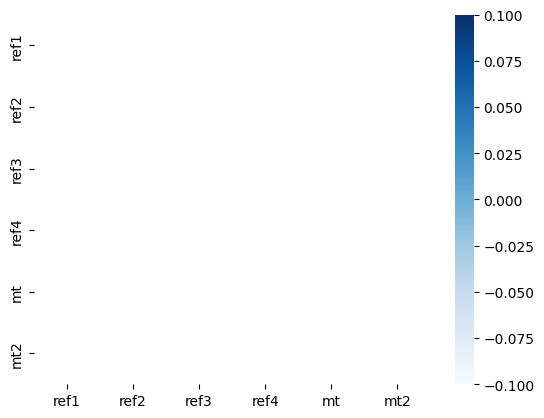

L
src
10.359164788583737
10.123614579255745
ref1
4.524701997465732
4.415615602102536
ref2
4.995150554045457
4.983631782335724
ref3
5.178154917030007
5.083259521657237
ref4
4.323703650181179
4.281259748988168
mt
5.064915498660881
4.849995730879434
mt2
4.922809232756004
4.785039760715277
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.760620  0.727757  0.855020  0.761700  0.790439
ref2_L  0.760620  1.000000  0.674135  0.797256  0.758103  0.707939
ref3_L  0.727757  0.674135  1.000000  0.741169  0.682082  0.741788
ref4_L  0.855020  0.797256  0.741169  1.000000  0.733870  0.758992
mt_L    0.761700  0.758103  0.682082  0.733870  1.000000  0.852493
mt2_L   0.790439  0.707939  0.741788  0.758992  0.852493  1.000000


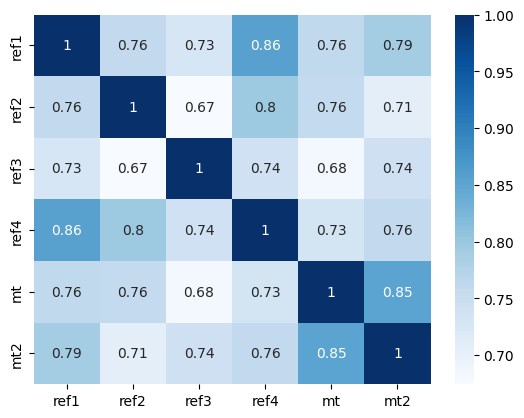

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.3413774862650494
1.3423354488574422
ref2
1.3739468195686264
1.374317031444769
ref3
1.3924060068932704
1.3897158973301065
ref4
1.3186065391571435
1.3117147002883034
mt
1.3786887395531262
1.376299802072645
mt2
1.366529145803568
1.3533812655091282
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.791979    0.766316    0.874012  0.823910   
ref2_SL_25    0.791979    1.000000    0.746601    0.818428  0.807556   
ref3_SL_25    0.766316    0.746601    1.000000    0.760228  0.760270   
ref4_SL_25    0.874012    0.818428    0.760228    1.000000  0.801723   
mt_SL_25      0.823910    0.807556    0.760270    0.801723  1.000000   
mt2_SL_25     0.818703    0.773405    0.781404    0.801821  0.889136   

            mt2_SL_25  
ref1_SL_25   0.818703  
ref2_SL_25   0.773405  
ref3_SL_25   0.781404  
ref4_SL_25   0.801821  
mt_SL_25     0.889136  
mt2_SL_25    1.000000  


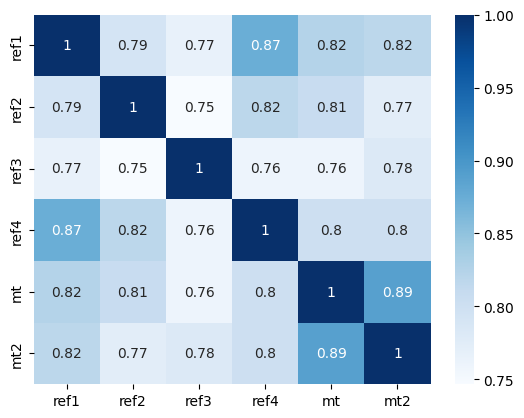

SL_50
src
3.0671973011635125
3.032966843199389
ref1
1.928905656911634
1.9252441081075578
ref2
2.0239302139518784
2.012952582782334
ref3
2.0713899017414446
2.06516064949587
ref4
1.874177811313648
1.852510351232465
mt
2.0391260769007027
2.0115000443242783
mt2
2.0058835715329284
1.9797007532093263
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.785419    0.748156    0.866961  0.802515   
ref2_SL_50    0.785419    1.000000    0.719471    0.814816  0.793094   
ref3_SL_50    0.748156    0.719471    1.000000    0.749364  0.730932   
ref4_SL_50    0.866961    0.814816    0.749364    1.000000  0.777385   
mt_SL_50      0.802515    0.793094    0.730932    0.777385  1.000000   
mt2_SL_50     0.814632    0.755053    0.768063    0.786983  0.879130   

            mt2_SL_50  
ref1_SL_50   0.814632  
ref2_SL_50   0.755053  
ref3_SL_50   0.768063  
ref4_SL_50   0.786983  
mt_SL_50     0.879130  
mt2_SL_50    1.000000  


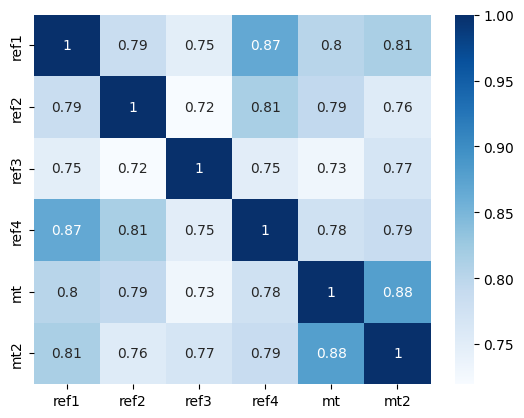

SL_75
src
5.5762344444241885
5.474223342002128
ref1
2.9036627195711926
2.85829461893603
ref2
3.1237082305516126
3.1132657344427197
ref3
3.220349562649195
3.202494206503045
ref4
2.795885965101922
2.77013179589646
mt
3.1581172550882575
3.0630084226771777
mt2
3.08663669589463
3.04086607782281
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.775382    0.736348    0.860664  0.782386   
ref2_SL_75    0.775382    1.000000    0.696373    0.808229  0.777538   
ref3_SL_75    0.736348    0.696373    1.000000    0.744217  0.706415   
ref4_SL_75    0.860664    0.808229    0.744217    1.000000  0.755145   
mt_SL_75      0.782386    0.777538    0.706415    0.755145  1.000000   
mt2_SL_75     0.805093    0.732852    0.755689    0.772691  0.866986   

            mt2_SL_75  
ref1_SL_75   0.805093  
ref2_SL_75   0.732852  
ref3_SL_75   0.755689  
ref4_SL_75   0.772691  
mt_SL_75     0.866986  
mt2_SL_75    1.000000  


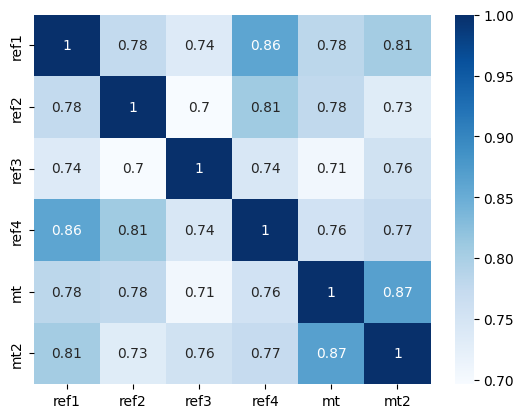

SL_100
src
10.359164788583737
10.123614579255745
ref1
4.524701997465732
4.415615602102536
ref2
4.995150554045457
4.983631782335724
ref3
5.178154917030007
5.083259521657237
ref4
4.323703650181179
4.281259748988168
mt
5.064915498660881
4.849995730879434
mt2
4.922809232756004
4.785039760715277
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.760620     0.727757     0.855020   0.761700   
ref2_SL_100     0.760620     1.000000     0.674135     0.797256   0.758103   
ref3_SL_100     0.727757     0.674135     1.000000     0.741169   0.682082   
ref4_SL_100     0.855020     0.797256     0.741169     1.000000   0.733870   
mt_SL_100       0.761700     0.758103     0.682082     0.733870   1.000000   
mt2_SL_100      0.790439     0.707939     0.741788     0.758992   0.852493   

             mt2_SL_100  
ref1_SL_100    0.790439  
ref2_SL_100    0.707939  
ref3_SL_100    0.741788  
ref4_SL_100    0.758992  
mt_SL_100      0.852493  
mt2_S

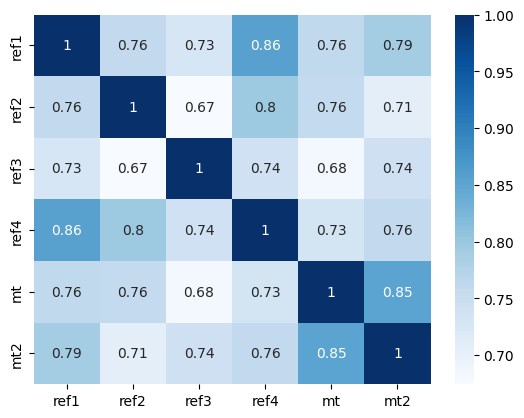

SL_125
src
19.634351008953868
18.984081758810827
ref1
7.254522324490407
7.01508141200396
ref2
8.225616415784627
8.145756882330545
ref3
8.562832001121558
8.345283753889698
ref4
6.885359897094898
6.723288151954061
mt
8.360694156296656
7.915481291346682
mt2
8.087312862260237
7.818523449578648
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.742320     0.721222     0.850235   0.739525   
ref2_SL_125     0.742320     1.000000     0.651713     0.782415   0.734482   
ref3_SL_125     0.721222     0.651713     1.000000     0.738694   0.655757   
ref4_SL_125     0.850235     0.782415     0.738694     1.000000   0.712593   
mt_SL_125       0.739525     0.734482     0.655757     0.712593   1.000000   
mt2_SL_125      0.771221     0.682345     0.724877     0.745745   0.834739   

             mt2_SL_125  
ref1_SL_125    0.771221  
ref2_SL_125    0.682345  
ref3_SL_125    0.724877  
ref4_SL_125    0.745745  
mt_SL_125      0.834739  
mt2_SL

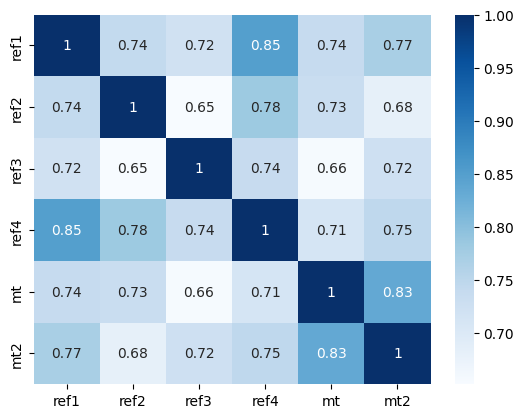

SL_150
src
37.92546190950008
36.245652911575796
ref1
11.92440041762805
11.329772175283615
ref2
13.89666750210823
13.739438746099518
ref3
14.51232350696605
14.060922644171324
ref4
11.24613674734668
10.944313575916771
mt
14.152595149616163
13.185629084406887
mt2
13.63477483286517
12.947169793540255
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.722464     0.716593     0.846595   0.715473   
ref2_SL_150     0.722464     1.000000     0.629745     0.765479   0.707745   
ref3_SL_150     0.716593     0.629745     1.000000     0.736646   0.627043   
ref4_SL_150     0.846595     0.765479     0.736646     1.000000   0.690756   
mt_SL_150       0.715473     0.707745     0.627043     0.690756   1.000000   
mt2_SL_150      0.748298     0.658672     0.704843     0.733140   0.812971   

             mt2_SL_150  
ref1_SL_150    0.748298  
ref2_SL_150    0.658672  
ref3_SL_150    0.704843  
ref4_SL_150    0.733140  
mt_SL_150      0.812971  

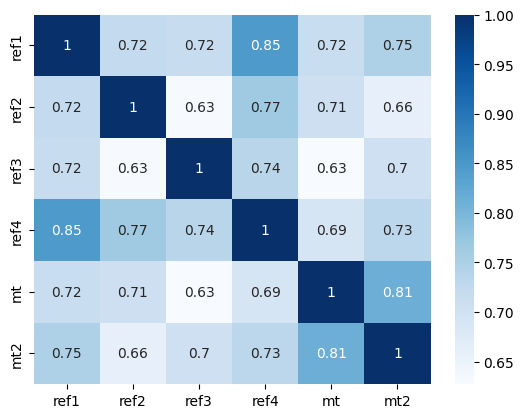

SL_175
src
74.59367553068095
71.2767390568266
ref1
20.04993764254968
18.632781872497446
ref2
24.02846424260067
23.409089279508315
ref3
25.152193092458567
24.019385904639915
ref4
18.79329449097905
18.404725510905337
mt
24.508963333893536
22.52676698931009
mt2
23.536398382324503
21.640764415951836
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.703348     0.714150     0.844432   0.689520   
ref2_SL_175     0.703348     1.000000     0.610077     0.749038   0.679733   
ref3_SL_175     0.714150     0.610077     1.000000     0.735761   0.596747   
ref4_SL_175     0.844432     0.749038     0.735761     1.000000   0.668198   
mt_SL_175       0.689520     0.679733     0.596747     0.668198   1.000000   
mt2_SL_175      0.723182     0.639687     0.682874     0.721839   0.786897   

             mt2_SL_175  
ref1_SL_175    0.723182  
ref2_SL_175    0.639687  
ref3_SL_175    0.682874  
ref4_SL_175    0.721839  
mt_SL_175      0.786897  


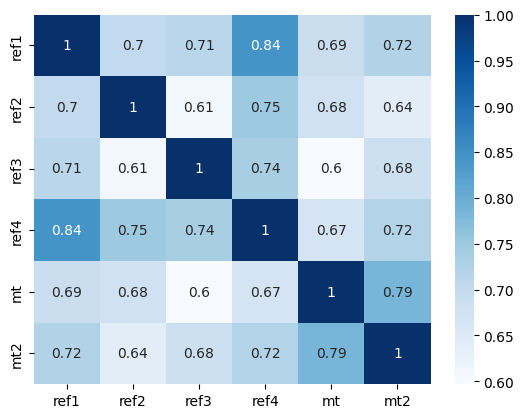

SL_200
src
149.29007454484417
140.79844066957907
ref1
34.44105599873641
31.371557086733933
ref2
42.45361115952062
40.14044371387881
ref3
44.51579597120893
41.85225854547876
ref4
32.08151903055896
30.631642663860596
mt
43.355588060331236
38.77798085211465
mt2
41.540423964688856
36.95975400721383
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.687322     0.714328     0.844089   0.662159   
ref2_SL_200     0.687322     1.000000     0.595211     0.735932   0.652635   
ref3_SL_200     0.714328     0.595211     1.000000     0.737331   0.566601   
ref4_SL_200     0.844089     0.735932     0.737331     1.000000   0.645308   
mt_SL_200       0.662159     0.652635     0.566601     0.645308   1.000000   
mt2_SL_200      0.698363     0.627808     0.661328     0.712973   0.756993   

             mt2_SL_200  
ref1_SL_200    0.698363  
ref2_SL_200    0.627808  
ref3_SL_200    0.661328  
ref4_SL_200    0.712973  
mt_SL_200      0.756993  
m

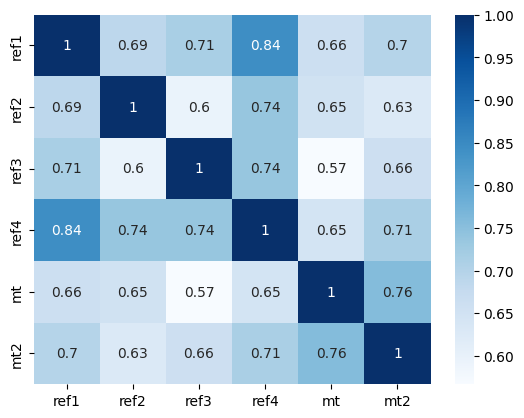

SL_225
src
303.8405857924159
280.9173422693609
ref1
60.402546310113756
54.56852313904582
ref2
76.56075947959785
69.66188788363203
ref3
80.38291195312374
73.70180550615405
ref4
55.896146659439786
51.98507060896462
mt
78.26781058649819
67.4996290033024
mt2
74.90495030346624
64.34888617769045
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.676468     0.717512     0.845792   0.634721   
ref2_SL_225     0.676468     1.000000     0.587568     0.728568   0.628531   
ref3_SL_225     0.717512     0.587568     1.000000     0.742759   0.538954   
ref4_SL_225     0.845792     0.728568     0.742759     1.000000   0.623262   
mt_SL_225       0.634721     0.628531     0.538954     0.623262   1.000000   
mt2_SL_225      0.677170     0.624490     0.643262     0.707874   0.724764   

             mt2_SL_225  
ref1_SL_225    0.677170  
ref2_SL_225    0.624490  
ref3_SL_225    0.643262  
ref4_SL_225    0.707874  
mt_SL_225      0.724764  
mt2_SL

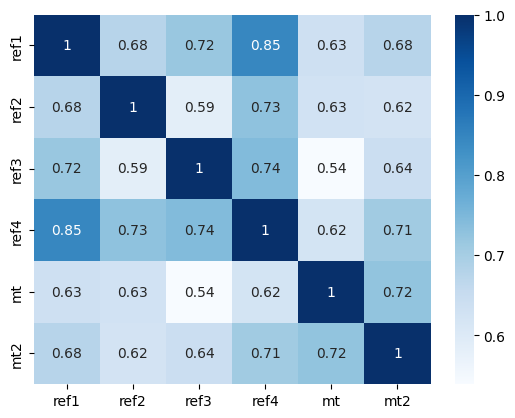

SL_250
src
628.4544909090951
577.7790438817206
ref1
108.1433306726014
93.25314035855718
ref2
140.82660563789278
122.88705977955739
ref3
148.01369873618182
128.83190364432153
ref4
99.36337917299927
90.52970733756916
mt
144.11305008774258
117.87418891495713
mt2
137.95300966188128
113.3622725356781
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.672218     0.723796     0.849450   0.609371   
ref2_SL_250     0.672218     1.000000     0.588668     0.728337   0.608986   
ref3_SL_250     0.723796     0.588668     1.000000     0.752923   0.516207   
ref4_SL_250     0.849450     0.728337     0.752923     1.000000   0.603953   
mt_SL_250       0.609371     0.608986     0.516207     0.603953   1.000000   
mt2_SL_250      0.662825     0.629823     0.631477     0.707515   0.692664   

             mt2_SL_250  
ref1_SL_250    0.662825  
ref2_SL_250    0.629823  
ref3_SL_250    0.631477  
ref4_SL_250    0.707515  
mt_SL_250      0.692664  


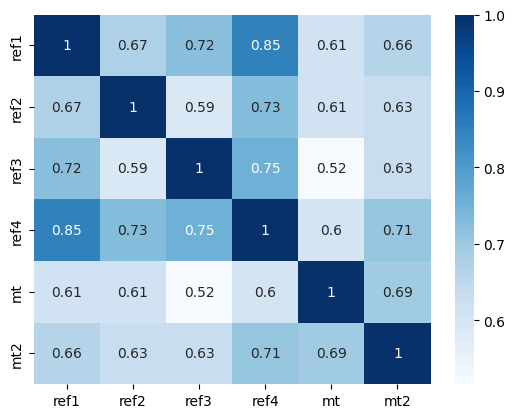

SL_275
src
1320.1522165503627
1219.778984730092
ref1
197.70930439558765
163.02053444173515
ref2
264.079250527062
224.66815578717726
ref3
277.85753686057745
230.65882872166776
ref4
180.21751973968102
158.94272439649617
mt
270.57801747310117
209.0933296346949
mt2
259.5050550062444
200.57514162988252
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.675058     0.732795     0.854591   0.588446   
ref2_SL_275     0.675058     1.000000     0.598605     0.735378   0.594787   
ref3_SL_275     0.732795     0.598605     1.000000     0.767618   0.500071   
ref4_SL_275     0.854591     0.735378     0.767618     1.000000   0.589288   
mt_SL_275       0.588446     0.594787     0.500071     0.589288   1.000000   
mt2_SL_275      0.657109     0.642573     0.627420     0.711953   0.663493   

             mt2_SL_275  
ref1_SL_275    0.657109  
ref2_SL_275    0.642573  
ref3_SL_275    0.627420  
ref4_SL_275    0.711953  
mt_SL_275      0.663493 

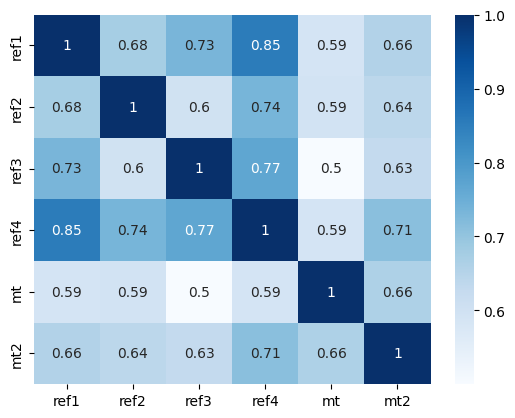

SL_300
src
2814.3535145845594
2540.753413906092
ref1
369.2883381664802
290.54298281375134
ref2
504.6578349854514
409.32478233596294
ref3
531.7319136641515
426.20084398994516
ref4
333.59469905101844
282.4818090484133
mt
517.9824354078803
375.69496755603086
mt2
498.71162912848644
355.60226201133645
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.684459     0.743652     0.860530   0.573471   
ref2_SL_300     0.684459     1.000000     0.616057     0.748708   0.585918   
ref3_SL_300     0.743652     0.616057     1.000000     0.785529   0.490995   
ref4_SL_300     0.860530     0.748708     0.785529     1.000000   0.580247   
mt_SL_300       0.573471     0.585918     0.490995     0.580247   1.000000   
mt2_SL_300      0.659719     0.660680     0.630685     0.720234   0.639522   

             mt2_SL_300  
ref1_SL_300    0.659719  
ref2_SL_300    0.660680  
ref3_SL_300    0.630685  
ref4_SL_300    0.720234  
mt_SL_300      0.639522  

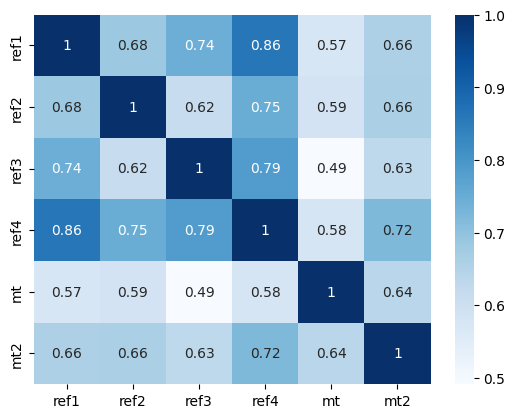

SL_325
src
6084.052939199673
5462.138856697426
ref1
705.1666251694743
517.2051183136928
ref2
982.5119762049816
766.9433647431922
ref3
1037.3323996125082
785.5949421397219
ref4
630.4968381586472
501.01069907649287
mt
1011.0448863025292
684.614040237262
mt2
979.4014144164158
642.9103945006457
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.699096     0.755293     0.866639   0.564629   
ref2_SL_325     0.699096     1.000000     0.638799     0.766631   0.581743   
ref3_SL_325     0.755293     0.638799     1.000000     0.804789   0.488127   
ref4_SL_325     0.866639     0.766631     0.804789     1.000000   0.576489   
mt_SL_325       0.564629     0.581743     0.488127     0.576489   1.000000   
mt2_SL_325      0.668777     0.681890     0.639414     0.730842   0.621883   

             mt2_SL_325  
ref1_SL_325    0.668777  
ref2_SL_325    0.681890  
ref3_SL_325    0.639414  
ref4_SL_325    0.730842  
mt_SL_325      0.621883  
mt2_S

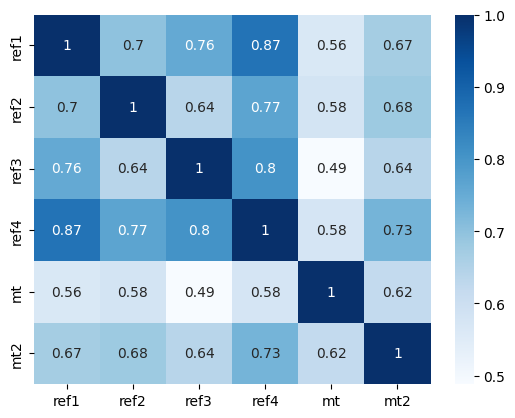

SL_350
src
13326.018221127724
11692.845168165546
ref1
1377.4005312605248
925.574581943745
ref2
1948.119070131883
1419.0228839362903
ref3
2063.0120414694184
1417.5160993105305
ref4
1217.269840468556
896.2980642407249
mt
2012.1220710769444
1262.5865890886657
mt2
1965.9098985061426
1176.4086983667014
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.717258     0.766752     0.872492   0.561007   
ref2_SL_350     0.717258     1.000000     0.664370     0.787230   0.581283   
ref3_SL_350     0.766752     0.664370     1.000000     0.823687   0.489780   
ref4_SL_350     0.872492     0.787230     0.823687     1.000000   0.576725   
mt_SL_350       0.561007     0.581283     0.489780     0.576725   1.000000   
mt2_SL_350      0.681884     0.704229     0.651211     0.742270   0.610538   

             mt2_SL_350  
ref1_SL_350    0.681884  
ref2_SL_350    0.704229  
ref3_SL_350    0.651211  
ref4_SL_350    0.742270  
mt_SL_350      0.610538 

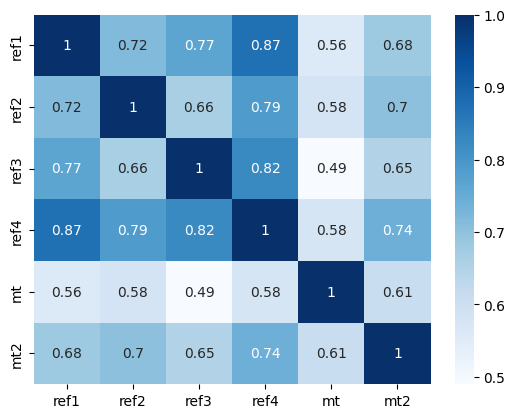

SL_375
src
29547.541988410783
25794.64486383465
ref1
2753.162005384097
1684.4587259520085
ref2
3932.416639456847
2664.5239836447536
ref3
4182.284961145502
2604.93055283752
ref4
2401.4798218514716
1591.9502338818206
mt
4082.4669289414196
2350.488051385746
mt2
4033.2511104178966
2171.1113278791872
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.737257     0.777368     0.877872   0.561210   
ref2_SL_375     0.737257     1.000000     0.690604     0.808767   0.583483   
ref3_SL_375     0.777368     0.690604     1.000000     0.841072   0.494073   
ref4_SL_375     0.877872     0.808767     0.841072     1.000000   0.579389   
mt_SL_375       0.561210     0.583483     0.494073     0.579389   1.000000   
mt2_SL_375      0.696929     0.726209     0.663921     0.753366   0.604669   

             mt2_SL_375  
ref1_SL_375    0.696929  
ref2_SL_375    0.726209  
ref3_SL_375    0.663921  
ref4_SL_375    0.753366  
mt_SL_375      0.604669  


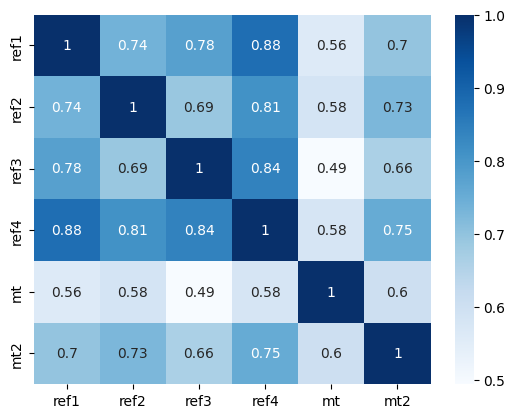

SL_400
src
66263.42583599311
56824.85462524026
ref1
5631.308068799558
3057.473067229298
ref2
8077.07395847764
4940.14948305386
ref3
8640.90731389898
4761.366208833477
ref4
4841.736741942358
2820.011918423782
mt
8442.32810709984
4415.040952708068
mt2
8454.837369671626
3991.3748842676314
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.757690     0.786802     0.882704   0.563878   
ref2_SL_400     0.757690     1.000000     0.715883     0.829893   0.587395   
ref3_SL_400     0.786802     0.715883     1.000000     0.856386   0.499399   
ref4_SL_400     0.882704     0.829893     0.856386     1.000000   0.583132   
mt_SL_400       0.563878     0.587395     0.499399     0.583132   1.000000   
mt2_SL_400      0.712397     0.746840     0.675977     0.763394   0.603145   

             mt2_SL_400  
ref1_SL_400    0.712397  
ref2_SL_400    0.746840  
ref3_SL_400    0.675977  
ref4_SL_400    0.763394  
mt_SL_400      0.603145  
mt2_SL_400

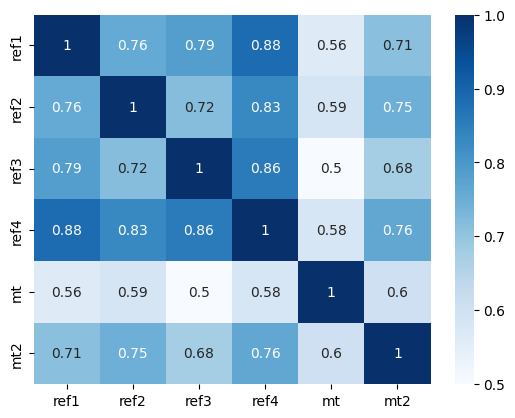

SL_425
src
150170.28195142408
126458.59758375768
ref1
11781.340053583517
5455.799013752694
ref2
16870.526871152335
9244.274379176384
ref3
18186.950881508827
8878.252483968168
ref4
9973.468602796123
5080.4329768998105
mt
17785.654727488527
8174.349508355308
mt2
18098.107584744987
7437.04378598729
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.777535     0.794959     0.886986   0.567940   
ref2_SL_425     0.777535     1.000000     0.739165     0.849702   0.592266   
ref3_SL_425     0.794959     0.739165     1.000000     0.869510   0.504618   
ref4_SL_425     0.886986     0.849702     0.869510     1.000000   0.587003   
mt_SL_425       0.567940     0.592266     0.504618     0.587003   1.000000   
mt2_SL_425      0.727336     0.765542     0.686417     0.771956   0.604858   

             mt2_SL_425  
ref1_SL_425    0.727336  
ref2_SL_425    0.765542  
ref3_SL_425    0.686417  
ref4_SL_425    0.771956  
mt_SL_425      0.604858  


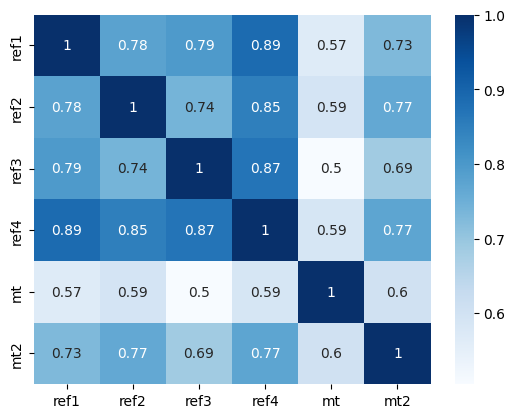

SL_450
src
343632.9097266221
283095.18838540884
ref1
25186.91001374283
10110.916862029691
ref2
35806.03811820682
17408.40306553786
ref3
38970.889996641105
16626.57817467571
ref4
20976.53634683952
9195.189674626126
mt
38145.49522972773
14937.999840889726
mt2
39519.13480010991
13864.2945830389
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.796136     0.801887     0.890756   0.572660   
ref2_SL_450     0.796136     1.000000     0.759897     0.867669   0.597546   
ref3_SL_450     0.801887     0.759897     1.000000     0.880578   0.509040   
ref4_SL_450     0.890756     0.867669     0.880578     1.000000   0.590440   
mt_SL_450       0.572660     0.597546     0.509040     0.590440   1.000000   
mt2_SL_450      0.741213     0.782032     0.694741     0.778875   0.608881   

             mt2_SL_450  
ref1_SL_450    0.741213  
ref2_SL_450    0.782032  
ref3_SL_450    0.694741  
ref4_SL_450    0.778875  
mt_SL_450      0.608881  
mt2_

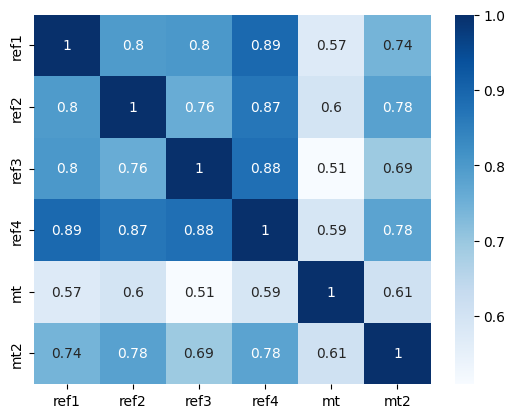

SL_475
src
793365.4482151263
640119.8046014623
ref1
54946.45998826835
18926.694673873746
ref2
77153.88720800755
33089.541220648054
ref3
84943.50351965139
31552.24214200771
ref4
44999.83504242687
16770.94002904548
mt
83211.55446436674
28131.261265359743
mt2
87915.29523878347
26203.921816289425
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.813138     0.807700     0.894060   0.577583   
ref2_SL_475     0.813138     1.000000     0.777881     0.883565   0.602867   
ref3_SL_475     0.807700     0.777881     1.000000     0.889836   0.512326   
ref4_SL_475     0.894060     0.883565     0.889836     1.000000   0.593168   
mt_SL_475       0.577583     0.602867     0.512326     0.593168   1.000000   
mt2_SL_475      0.753767     0.796228     0.700754     0.784105   0.614504   

             mt2_SL_475  
ref1_SL_475    0.753767  
ref2_SL_475    0.796228  
ref3_SL_475    0.700754  
ref4_SL_475    0.784105  
mt_SL_475      0.614504  
mt2

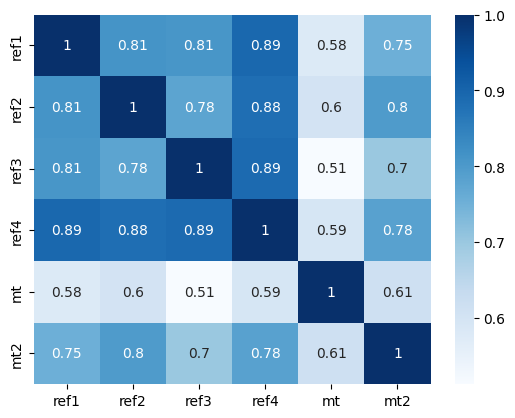

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
122102.89179797762
34569.516669045755
ref2
168620.9573924008
64378.26313959052
ref3
188137.08418305573
60530.53772259332
ref4
98327.6126385512
31342.839218209578
mt
184420.49813074694
53476.85302617143
mt2
198949.34628252854
49676.70938513055
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.828403     0.812532     0.896945   0.582452   
ref2_SL_500     0.828403     1.000000     0.793152     0.897362   0.608006   
ref3_SL_500     0.812532     0.793152     1.000000     0.897556   0.514367   
ref4_SL_500     0.896945     0.897362     0.897556     1.000000   0.595095   
mt_SL_500       0.582452     0.608006     0.514367     0.595095   1.000000   
mt2_SL_500      0.764901     0.808175     0.704446     0.787675   0.621213   

             mt2_SL_500  
ref1_SL_500    0.764901  
ref2_SL_500    0.808175  
ref3_SL_500    0.704446  
ref4_SL_500    0.787675  
mt_SL_500      0.621213  


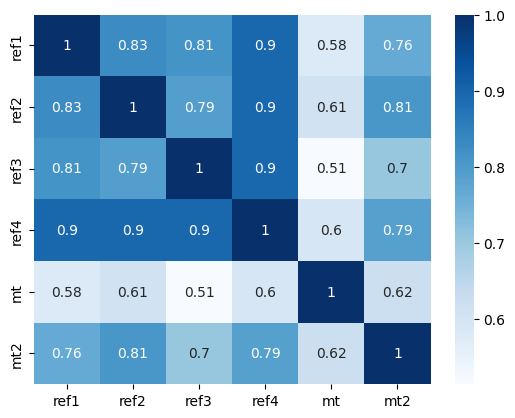

SL_525
src
4331606.646061756
3141367.4417431457
ref1
275851.9345460234
65292.15953345621
ref2
373392.76061598887
125425.06365931703
ref3
422914.5036785304
116198.89074067643
ref4
218482.26090610345
57152.476713473676
mt
414740.457545496
99033.26856929669
mt2
457217.8177941324
92457.38493871354
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.841938     0.816514     0.899459   0.587143   
ref2_SL_525     0.841938     1.000000     0.805885     0.909156   0.612839   
ref3_SL_525     0.816514     0.805885     1.000000     0.903997   0.515183   
ref4_SL_525     0.899459     0.909156     0.903997     1.000000   0.596234   
mt_SL_525       0.587143     0.612839     0.515183     0.596234   1.000000   
mt2_SL_525      0.774610     0.817994     0.705904     0.789655   0.628649   

             mt2_SL_525  
ref1_SL_525    0.774610  
ref2_SL_525    0.817994  
ref3_SL_525    0.705904  
ref4_SL_525    0.789655  
mt_SL_525      0.628649  
mt

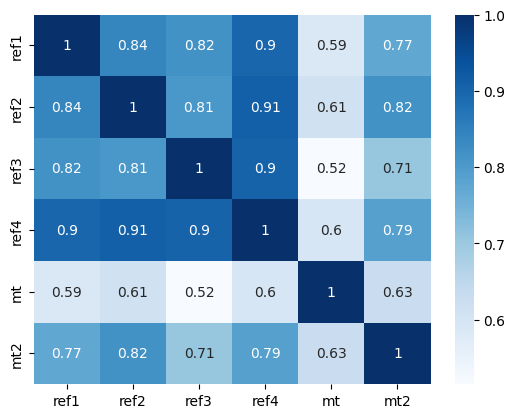

SL_550
src
10231354.187866237
7329958.645473514
ref1
632264.4132344385
123726.72437287119
ref2
836861.183169068
245816.2036916192
ref3
963612.6165235607
225879.22950038986
ref4
492788.21031717403
106065.74042337506
mt
945159.7448435898
187083.07296212297
mt2
1065299.9082358314
176816.7337096549
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.853835     0.819762     0.901642   0.591608   
ref2_SL_550     0.853835     1.000000     0.816322     0.919110   0.617313   
ref3_SL_550     0.819762     0.816322     1.000000     0.909388   0.514868   
ref4_SL_550     0.901642     0.919110     0.909388     1.000000   0.596650   
mt_SL_550       0.591608     0.617313     0.514868     0.596650   1.000000   
mt2_SL_550      0.782944     0.825845     0.705268     0.790133   0.636566   

             mt2_SL_550  
ref1_SL_550    0.782944  
ref2_SL_550    0.825845  
ref3_SL_550    0.705268  
ref4_SL_550    0.790133  
mt_SL_550      0.636566  
m

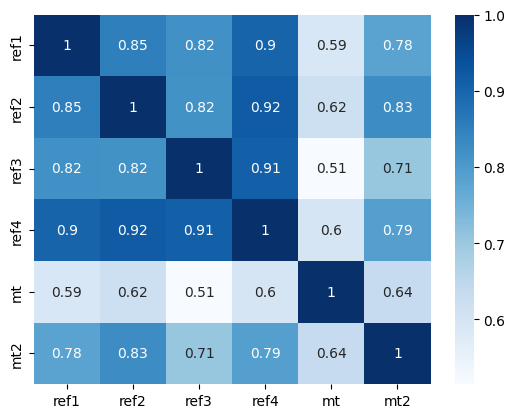

SL_575
src
24325330.39833967
16966711.067660846
ref1
1467308.8911499442
233713.93769534968
ref2
1896289.2411157966
472642.85393964825
ref3
2222515.164945633
428663.564349004
ref4
1126212.8403479503
196105.74329262448
mt
2179738.0326322615
361077.94470478815
mt2
2512310.1192316953
330307.08653963206
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.864237     0.822378     0.903531   0.595845   
ref2_SL_575     0.864237     1.000000     0.824728     0.927418   0.621419   
ref3_SL_575     0.822378     0.824728     1.000000     0.913917   0.513539   
ref4_SL_575     0.903531     0.927418     0.913917     1.000000   0.596429   
mt_SL_575       0.595845     0.621419     0.513539     0.596429   1.000000   
mt2_SL_575      0.789980     0.831906     0.702700     0.789213   0.644793   

             mt2_SL_575  
ref1_SL_575    0.789980  
ref2_SL_575    0.831906  
ref3_SL_575    0.702700  
ref4_SL_575    0.789213  
mt_SL_575      0.644793

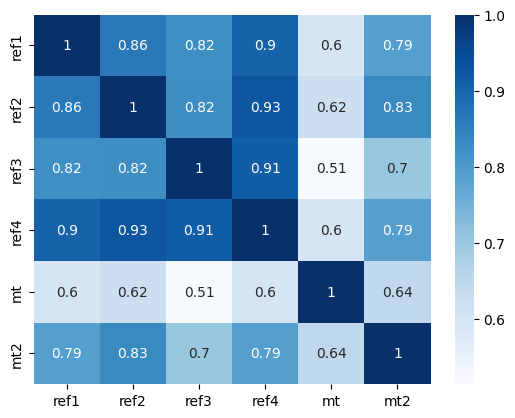

SL_600
src
58189712.87790054
39214596.580572255
ref1
3441353.2293524994
435595.3250118767
ref2
4339700.009714927
907235.0203879592
ref3
5182092.655326559
815456.9833131187
ref4
2603355.722956598
362947.1897612504
mt
5080346.754543759
705706.8187037054
mt2
5987651.003669693
627732.0346166203
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.873303     0.824443     0.905156   0.599873   
ref2_SL_600     0.873303     1.000000     0.831368     0.934279   0.625176   
ref3_SL_600     0.824443     0.831368     1.000000     0.917743   0.511317   
ref4_SL_600     0.905156     0.934279     0.917743     1.000000   0.595659   
mt_SL_600       0.599873     0.625176     0.511317     0.595659   1.000000   
mt2_SL_600      0.795811     0.836360     0.698372     0.787002   0.653218   

             mt2_SL_600  
ref1_SL_600    0.795811  
ref2_SL_600    0.836360  
ref3_SL_600    0.698372  
ref4_SL_600    0.787002  
mt_SL_600      0.653218  
mt2_S

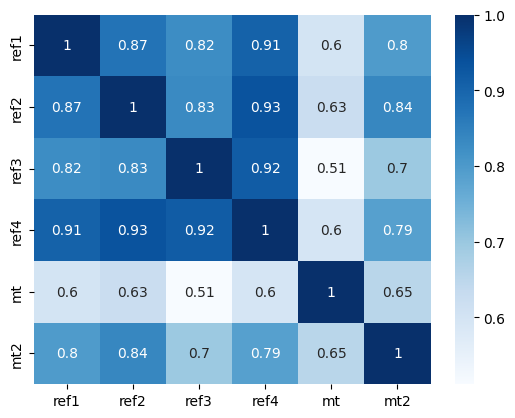

SL_625
src
140004729.32922277
89386250.1037006
ref1
8143058.928479678
815410.2896636381
ref2
10020254.287085889
1730751.1284778262
ref3
12199245.876935909
1553811.1244001202
ref4
6076991.478837536
670494.5148019998
mt
11951451.358864576
1382178.5522007784
mt2
14401635.640992573
1195297.6610840322
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.881195     0.826026     0.906546   0.603720   
ref2_SL_625     0.881195     1.000000     0.836485     0.939882   0.628616   
ref3_SL_625     0.826026     0.836485     1.000000     0.920991   0.508318   
ref4_SL_625     0.906546     0.939882     0.920991     1.000000   0.594420   
mt_SL_625       0.603720     0.628616     0.508318     0.594420   1.000000   
mt2_SL_625      0.800534     0.839389     0.692457     0.783614   0.661765   

             mt2_SL_625  
ref1_SL_625    0.800534  
ref2_SL_625    0.839389  
ref3_SL_625    0.692457  
ref4_SL_625    0.783614  
mt_SL_625      0.661765  

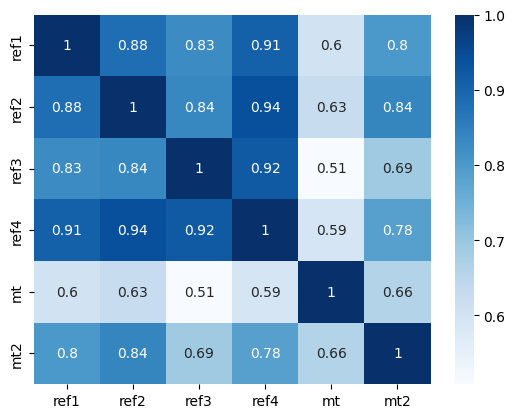

SL_650
src
338703171.3009422
210335993.3140239
ref1
19411264.30091935
1560656.8419646653
ref2
23321058.274247188
3308256.0928691356
ref3
28961016.57252497
2949979.11942682
ref4
14303567.390515434
1240903.1977184399
mt
28344917.489794202
2615781.019365512
mt2
34913890.2657263
2272703.4425871177
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.888065     0.827186     0.907723   0.607421   
ref2_SL_650     0.888065     1.000000     0.840299     0.944402   0.631777   
ref3_SL_650     0.827186     0.840299     1.000000     0.923765   0.504644   
ref4_SL_650     0.907723     0.944402     0.923765     1.000000   0.592784   
mt_SL_650       0.607421     0.631777     0.504644     0.592784   1.000000   
mt2_SL_650      0.804252     0.841165     0.685125     0.779159   0.670380   

             mt2_SL_650  
ref1_SL_650    0.804252  
ref2_SL_650    0.841165  
ref3_SL_650    0.685125  
ref4_SL_650    0.779159  
mt_SL_650      0.670380  
mt

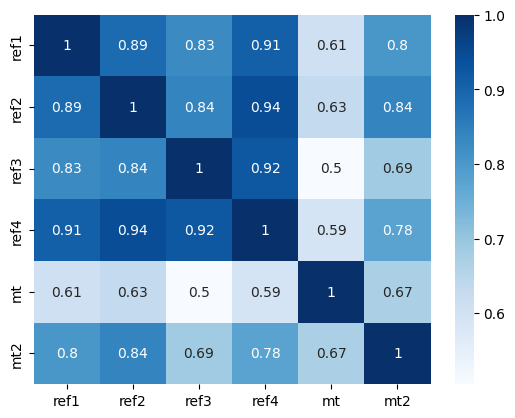

SL_675
src
823697155.0790491
502847016.137499
ref1
46556222.53568354
2964354.480350096
ref2
54662055.3954229
6397702.137260538
ref3
69259257.41107376
5692886.8401267165
ref4
33902840.7419791
2364370.7039896296
mt
67700808.43922384
5032886.4748812355
mt2
85220625.41743979
4328089.269444172
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.894056     0.827968     0.908710   0.611004   
ref2_SL_675     0.894056     1.000000     0.843004     0.947993   0.634701   
ref3_SL_675     0.827968     0.843004     1.000000     0.926145   0.500385   
ref4_SL_675     0.908710     0.947993     0.926145     1.000000   0.590813   
mt_SL_675       0.611004     0.634701     0.500385     0.590813   1.000000   
mt2_SL_675      0.807064     0.841852     0.676539     0.773749   0.679028   

             mt2_SL_675  
ref1_SL_675    0.807064  
ref2_SL_675    0.841852  
ref3_SL_675    0.676539  
ref4_SL_675    0.773749  
mt_SL_675      0.679028  
mt2_SL_

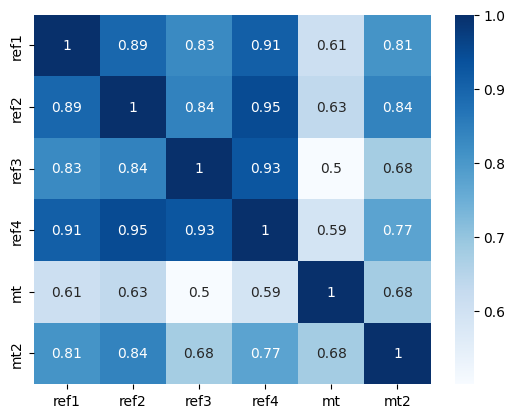

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
112226669.95998664
5505980.7763041295
ref2
128926740.85313019
12404635.496675763
ref3
166687739.32908928
11172357.897243876
ref4
80830690.17449993
4467289.119035296
mt
162691230.7599814
9787630.905521665
mt2
209241113.34660494
8174200.906107632
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.899290     0.828411     0.909523   0.614497   
ref2_SL_700     0.899290     1.000000     0.844764     0.950789   0.637426   
ref3_SL_700     0.828411     0.844764     1.000000     0.928198   0.495617   
ref4_SL_700     0.909523     0.950789     0.928198     1.000000   0.588556   
mt_SL_700       0.614497     0.637426     0.495617     0.588556   1.000000   
mt2_SL_700      0.809070     0.841600     0.666854     0.767495   0.687686   

             mt2_SL_700  
ref1_SL_700    0.809070  
ref2_SL_700    0.841600  
ref3_SL_700    0.666854  
ref4_SL_700    0.767495  
mt_SL_700      0.687686 

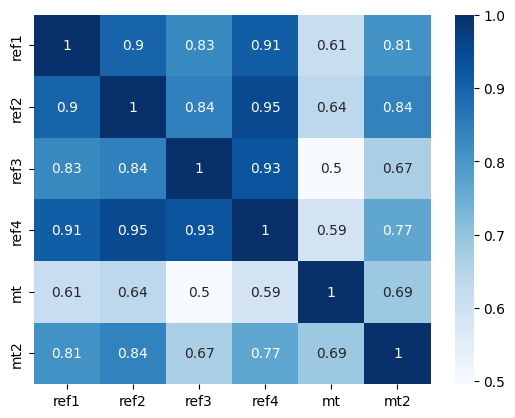

SL_725
src
4944587689.869408
2766777160.633936
ref1
271658766.80878377
10404106.327639181
ref2
305776771.75448316
24292071.29860557
ref3
403384043.0391191
21841774.849891126
ref4
193664592.9590019
8449649.475670282
mt
393028356.1960623
18896324.73689977
mt2
516371120.2460056
15437637.409456775
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.903879     0.828549     0.910177   0.617925   
ref2_SL_725     0.903879     1.000000     0.845721     0.952908   0.639988   
ref3_SL_725     0.828549     0.845721     1.000000     0.929978   0.490404   
ref4_SL_725     0.910177     0.952908     0.929978     1.000000   0.586056   
mt_SL_725       0.617925     0.639988     0.490404     0.586056   1.000000   
mt2_SL_725      0.810364     0.840550     0.656220     0.760501   0.696336   

             mt2_SL_725  
ref1_SL_725    0.810364  
ref2_SL_725    0.840550  
ref3_SL_725    0.656220  
ref4_SL_725    0.760501  
mt_SL_725      0.696336  
mt

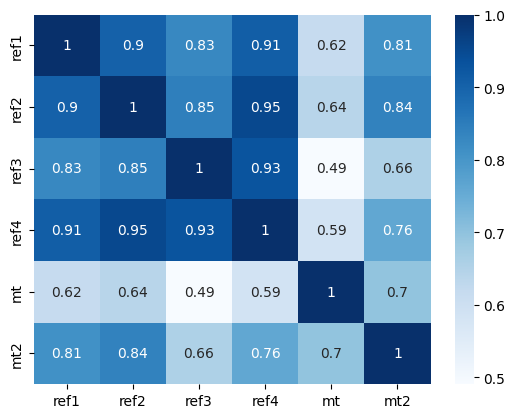

SL_750
src
12201196322.126482
6533701117.122557
ref1
659847237.4907147
19571318.647984903
ref2
728766927.6980706
47690781.59724027
ref3
980838253.3323944
41831548.8842987
ref4
465917447.0907787
16013467.959218537
mt
953802864.652038
37088410.13768284
mt2
1279971313.5046253
29418191.85610003
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.907916     0.828408     0.910686   0.621306   
ref2_SL_750     0.907916     1.000000     0.845996     0.954449   0.642420   
ref3_SL_750     0.828408     0.845996     1.000000     0.931529   0.484802   
ref4_SL_750     0.910686     0.954449     0.931529     1.000000   0.583347   
mt_SL_750       0.621306     0.642420     0.484802     0.583347   1.000000   
mt2_SL_750      0.811036     0.838830     0.644774     0.752868   0.704965   

             mt2_SL_750  
ref1_SL_750    0.811036  
ref2_SL_750    0.838830  
ref3_SL_750    0.644774  
ref4_SL_750    0.752868  
mt_SL_750      0.704965  
mt2_S

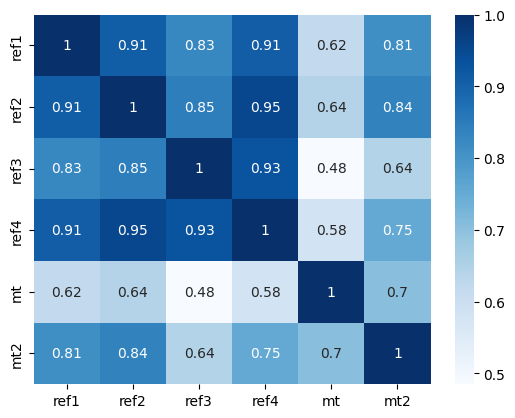

SL_775
src
30245243673.27781
15503724864.782127
ref1
1607294185.1804144
36726857.9288941
ref2
1744396293.331405
93803855.63612747
ref3
2394736111.744578
80182804.16896135
ref4
1124763689.6711323
30434844.29242347
mt
2323794633.7797947
72949487.32639766
mt2
3185072223.103054
56106321.07218835
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.911482     0.828013     0.911060   0.624657   
ref2_SL_775     0.911482     1.000000     0.845689     0.955496   0.644750   
ref3_SL_775     0.828013     0.845689     1.000000     0.932884   0.478858   
ref4_SL_775     0.911060     0.955496     0.932884     1.000000   0.580458   
mt_SL_775       0.624657     0.644750     0.478858     0.580458   1.000000   
mt2_SL_775      0.811169     0.836555     0.632645     0.744692   0.713562   

             mt2_SL_775  
ref1_SL_775    0.811169  
ref2_SL_775    0.836555  
ref3_SL_775    0.632645  
ref4_SL_775    0.744692  
mt_SL_775      0.713562  
mt2_

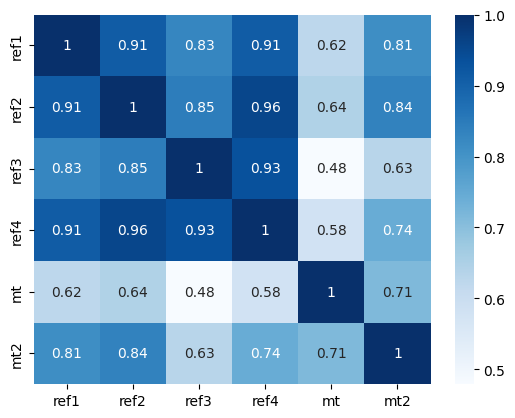

SL_800
src
75308449146.75627
37154119080.28433
ref1
3924351306.524041
69166622.7371324
ref2
4191339040.312029
182838680.0959503
ref3
5867551073.197624
153813758.6738873
ref4
2723111530.1444645
58227259.01545727
mt
5680805806.572465
142333417.81403777
mt2
7952727405.382356
107236369.8420861
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.914647     0.827383     0.911310   0.627990   
ref2_SL_800     0.914647     1.000000     0.844886     0.956121   0.647003   
ref3_SL_800     0.827383     0.844886     1.000000     0.934074   0.472613   
ref4_SL_800     0.911310     0.956121     0.934074     1.000000   0.577410   
mt_SL_800       0.627990     0.647003     0.472613     0.577410   1.000000   
mt2_SL_800      0.810844     0.833831     0.619954     0.736063   0.722119   

             mt2_SL_800  
ref1_SL_800    0.810844  
ref2_SL_800    0.833831  
ref3_SL_800    0.619954  
ref4_SL_800    0.736063  
mt_SL_800      0.722119  
mt2_SL

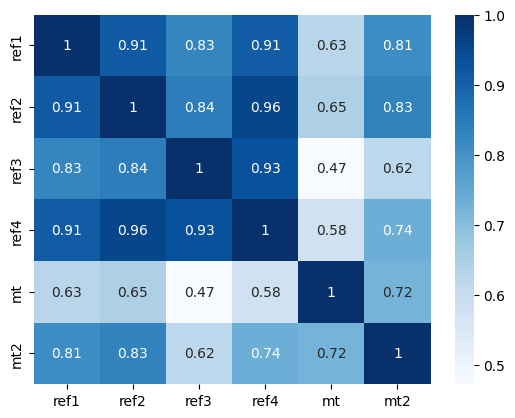

SL_825
src
188328461125.37543
88759479197.95065
ref1
9600385651.110882
132783973.88715214
ref2
10104549385.847761
353339500.3293488
ref3
14420732791.92145
295273291.4148729
ref4
6608782303.735595
111532186.6646752
mt
13928312797.427969
273744822.6178658
mt2
19916861966.574314
206656083.14226353
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.917469     0.826537     0.911444   0.631314   
ref2_SL_825     0.917469     1.000000     0.843658     0.956384   0.649199   
ref3_SL_825     0.826537     0.843658     1.000000     0.935122   0.466102   
ref4_SL_825     0.911444     0.956384     0.935122     1.000000   0.574224   
mt_SL_825       0.631314     0.649199     0.466102     0.574224   1.000000   
mt2_SL_825      0.810132     0.830749     0.606811     0.727062   0.730627   

             mt2_SL_825  
ref1_SL_825    0.810132  
ref2_SL_825    0.830749  
ref3_SL_825    0.606811  
ref4_SL_825    0.727062  
mt_SL_825      0.730627  
m

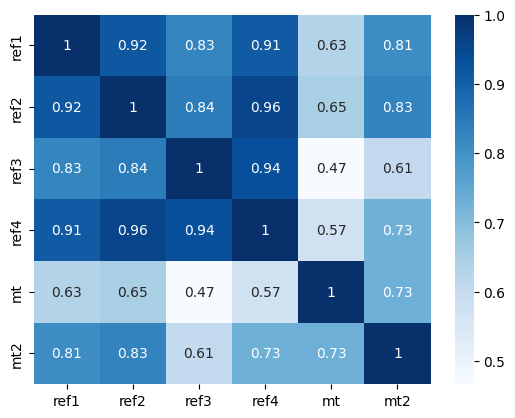

SL_850
src
472965874424.6596
209696852072.8994
ref1
23524359891.974945
251690947.29619217
ref2
24432445502.062637
676957118.4585145
ref3
35536268163.7668
568800374.0515077
ref4
16071790603.332794
213130008.66300094
mt
34237084589.64825
527314302.31273425
mt2
50014001329.6892
398633401.5518997
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.919998     0.825489     0.911469   0.634637   
ref2_SL_850     0.919998     1.000000     0.842065     0.956336   0.651354   
ref3_SL_850     0.825489     0.842065     1.000000     0.936048   0.459356   
ref4_SL_850     0.911469     0.956336     0.936048     1.000000   0.570913   
mt_SL_850       0.634637     0.651354     0.459356     0.570913   1.000000   
mt2_SL_850      0.809101     0.827394     0.593314     0.717766   0.739079   

             mt2_SL_850  
ref1_SL_850    0.809101  
ref2_SL_850    0.827394  
ref3_SL_850    0.593314  
ref4_SL_850    0.717766  
mt_SL_850      0.739079  
mt2

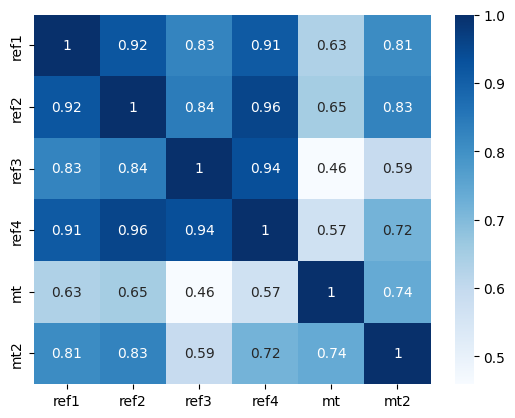

SL_875
src
1192729481778.0728
501307929419.6415
ref1
57722021596.13423
482038880.3242912
ref2
59231589194.75612
1317963117.6973193
ref3
87772709864.8227
1108895701.155923
ref4
39152336597.1671
402637671.2355708
mt
84345878175.11946
1016555693.6465828
mt2
125895102607.63846
767632983.0462579
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.922276     0.824253     0.911391   0.637963   
ref2_SL_875     0.922276     1.000000     0.840158     0.956019   0.653483   
ref3_SL_875     0.824253     0.840158     1.000000     0.936869   0.452403   
ref4_SL_875     0.911391     0.956019     0.936869     1.000000   0.567493   
mt_SL_875       0.637963     0.653483     0.452403     0.567493   1.000000   
mt2_SL_875      0.807811     0.823839     0.579555     0.708243   0.747466   

             mt2_SL_875  
ref1_SL_875    0.807811  
ref2_SL_875    0.823839  
ref3_SL_875    0.579555  
ref4_SL_875    0.708243  
mt_SL_875      0.747466  
mt2_S

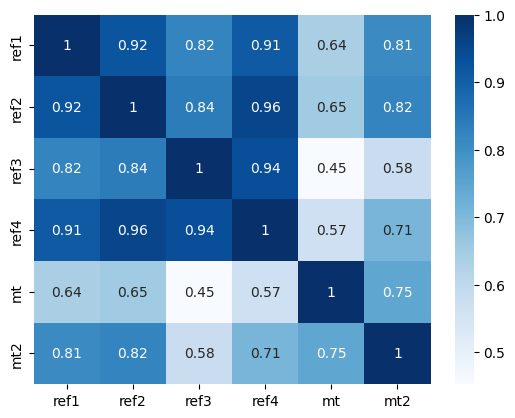

SL_900
src
3020011763176.6636
1193341285325.353
ref1
141797078416.74417
921119984.0824932
ref2
143928158058.63864
2600900431.655283
ref3
217231168923.3794
2164078394.592717
ref4
95518892034.45305
764393621.3626089
mt
208200078512.714
1926273556.2784538
mt2
317593822935.27094
1476825707.0431828
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.924339     0.822842     0.911216   0.641295   
ref2_SL_900     0.924339     1.000000     0.837980     0.955470   0.655598   
ref3_SL_900     0.822842     0.837980     1.000000     0.937599   0.445269   
ref4_SL_900     0.911216     0.955470     0.937599     1.000000   0.563972   
mt_SL_900       0.641295     0.655598     0.445269     0.563972   1.000000   
mt2_SL_900      0.806317     0.820148     0.565616     0.698556   0.755779   

             mt2_SL_900  
ref1_SL_900    0.806317  
ref2_SL_900    0.820148  
ref3_SL_900    0.565616  
ref4_SL_900    0.698556  
mt_SL_900      0.755779  
mt

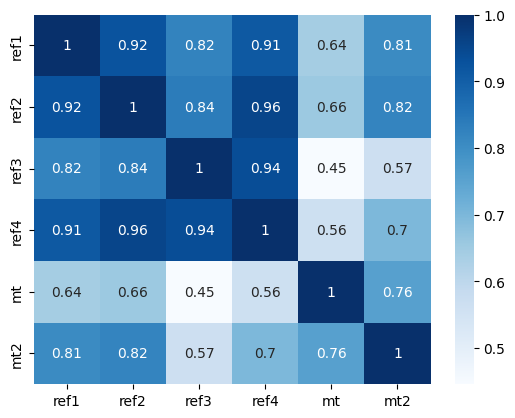

SL_925
src
7676878874728.81
2825871516031.6035
ref1
348674052691.3512
1748627639.709731
ref2
350453279811.47534
5138940826.167677
ref3
538580577075.9858
4226271204.946041
ref4
233327595659.64044
1459295300.8027136
mt
514810721902.7365
3672811188.9811215
mt2
802779063240.2413
2842940087.9475136
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.926216     0.821266     0.910948   0.644636   
ref2_SL_925     0.926216     1.000000     0.835567     0.954718   0.657707   
ref3_SL_925     0.821266     0.835567     1.000000     0.938249   0.437975   
ref4_SL_925     0.910948     0.954718     0.938249     1.000000   0.560362   
mt_SL_925       0.644636     0.657707     0.437975     0.560362   1.000000   
mt2_SL_925      0.804668     0.816376     0.551569     0.688760   0.764011   

             mt2_SL_925  
ref1_SL_925    0.804668  
ref2_SL_925    0.816376  
ref3_SL_925    0.551569  
ref4_SL_925    0.688760  
mt_SL_925      0.764011  
mt

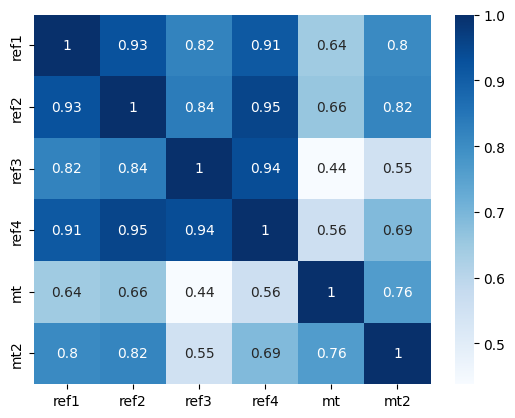

SL_950
src
19589480415784.91
6695745864435.366
ref1
858098107948.4325
3340358155.302527
ref2
854883633750.9506
10165306015.91956
ref3
1337372601274.6802
8258915471.890066
ref4
570572988697.496
2816281107.80947
mt
1274909577387.4683
7083322480.7566185
mt2
2032863408037.867
5490833020.317367
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.927934     0.819536     0.910591   0.647987   
ref2_SL_950     0.927934     1.000000     0.832948     0.953790   0.659817   
ref3_SL_950     0.819536     0.832948     1.000000     0.938830   0.430543   
ref4_SL_950     0.910591     0.953790     0.938830     1.000000   0.556671   
mt_SL_950       0.647987     0.659817     0.430543     0.556671   1.000000   
mt2_SL_950      0.802908     0.812573     0.537478     0.678906   0.772151   

             mt2_SL_950  
ref1_SL_950    0.802908  
ref2_SL_950    0.812573  
ref3_SL_950    0.537478  
ref4_SL_950    0.678906  
mt_SL_950      0.772151  
mt2_SL

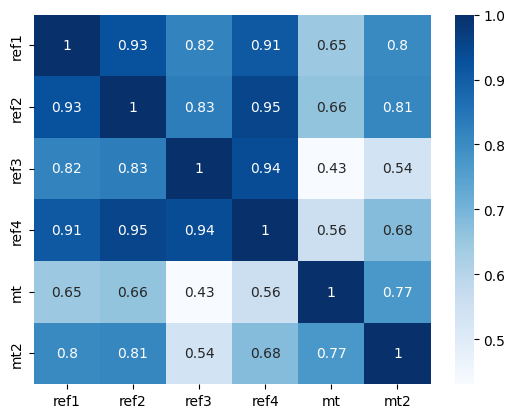

SL_975
src
50173418288827.71
15873783084476.455
ref1
2113336888463.0115
6367257123.92599
ref2
2088764886230.7607
20129561775.00674
ref3
3325434405681.0386
16149211862.627392
ref4
1396563466257.3525
5456402668.020836
mt
3161585457978.815
13686178440.71006
mt2
5156395559836.361
10668491375.667665
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.929514     0.817660     0.910150   0.651346   
ref2_SL_975     0.929514     1.000000     0.830151     0.952705   0.661935   
ref3_SL_975     0.817660     0.830151     1.000000     0.939351   0.422993   
ref4_SL_975     0.910150     0.952705     0.939351     1.000000   0.552905   
mt_SL_975       0.651346     0.661935     0.422993     0.552905   1.000000   
mt2_SL_975      0.801076     0.808780     0.523400     0.669036   0.780190   

             mt2_SL_975  
ref1_SL_975    0.801076  
ref2_SL_975    0.808780  
ref3_SL_975    0.523400  
ref4_SL_975    0.669036  
mt_SL_975      0.780190  
m

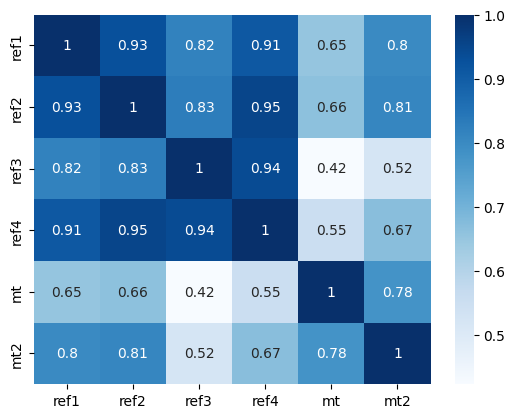

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.4225553679086687
0.42387205739943457
ref2
0.42572620492762686
0.43285870136470855
ref3
0.41320649131253656
0.4153367938957512
ref4
0.4348239456276908
0.4389318453087976
mt
0.4205312089038751
0.42078320116168433
mt2
0.4262787277637764
0.42856304574000914
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.736694   0.762676   0.825903  0.805427  0.740360
ref2_gini   0.736694   1.000000   0.724813   0.690685  0.756106  0.791779
ref3_gini   0.762676   0.724813   1.000000   0.705466  0.766629  0.669901
ref4_gini   0.825903   0.690685   0.705466   1.000000  0.747870  0.741548
mt_gini     0.805427   0.756106   0.766629   0.747870  1.000000  0.841643
mt2_gini    0.740360   0.791779   0.669901   0.741548  0.841643  1.000000


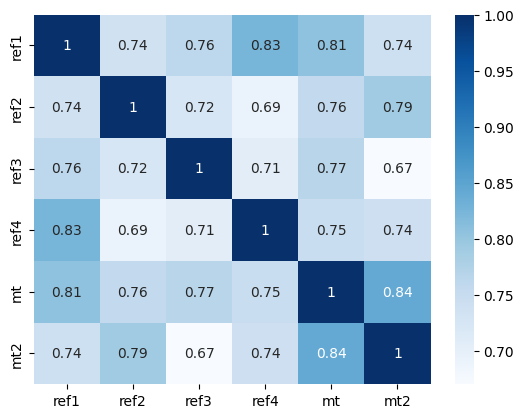

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.562437158525807
-4.655076119521967
ref2
-4.533974357328263
-4.639717907345342
ref3
-4.498011839153725
-4.576203956537494
ref4
-4.5696715503056415
-4.698242965839823
mt
-4.495972885563489
-4.568748046828788
mt2
-4.51568581209284
-4.575947420269833
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.978411  0.962632  0.977126  0.978941  0.972213
ref2_kl  0.978411  1.000000  0.969147  0.979014  0.982224  0.978062
ref3_kl  0.962632  0.969147  1.000000  0.960599  0.976688  0.967231
ref4_kl  0.977126  0.979014  0.960599  1.000000  0.974973  0.968761
mt_kl    0.978941  0.982224  0.976688  0.974973  1.000000  0.985407
mt2_kl   0.972213  0.978062  0.967231  0.968761  0.985407  1.000000


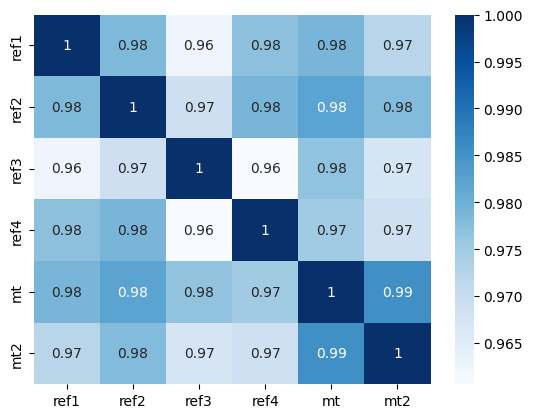

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.7940791671262075
0.7875772627284134
ref2
0.8034227328002009
0.7900010379896449
ref3
0.7765828335198948
0.7647081400004818
ref4
0.8197214128182975
0.8119612833586283
mt
0.7881968531505654
0.7779398317886337
mt2
0.8039336799156147
0.792633375988885
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.719664  0.739296  0.818038  0.794146  0.722277
ref2_cv  0.719664  1.000000  0.724782  0.721239  0.764764  0.737949
ref3_cv  0.739296  0.724782  1.000000  0.721657  0.753389  0.653715
ref4_cv  0.818038  0.721239  0.721657  1.000000  0.763127  0.760605
mt_cv    0.794146  0.764764  0.753389  0.763127  1.000000  0.793569
mt2_cv   0.722277  0.737949  0.653715  0.760605  0.793569  1.000000


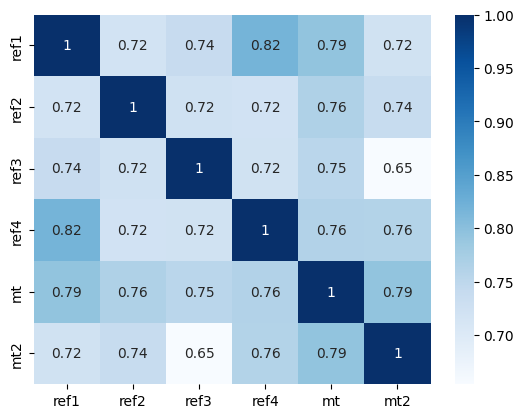

lv
src
72.35425230811832
69.03561950442358
ref1
25.377201752939182
21.949017934905754
ref2
28.74413711750859
24.662548996045917
ref3
30.103838901189143
25.731361455260377
ref4
24.521878439977936
21.76309693693465
mt
28.423390879193647
24.37644376072734
mt2
30.701034133213
27.31610406169696
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.641762  0.628363  0.715007  0.563335  0.551199
ref2_lv  0.641762  1.000000  0.598065  0.719273  0.671958  0.680456
ref3_lv  0.628363  0.598065  1.000000  0.642711  0.494954  0.516646
ref4_lv  0.715007  0.719273  0.642711  1.000000  0.579354  0.672696
mt_lv    0.563335  0.671958  0.494954  0.579354  1.000000  0.650511
mt2_lv   0.551199  0.680456  0.516646  0.672696  0.650511  1.000000


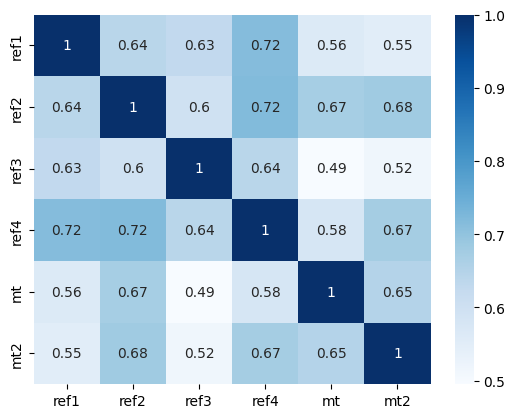

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-417.9557253656525
-383.63272058488803
ref2
-484.980252596744
-441.295800011589
ref3
-483.7038264685725
-423.93116737513196
ref4
-404.54925038803975
-352.50365118248544
mt
-468.74096640586475
-427.65443498010677
mt2
-460.96570424167794
-422.12435043453956
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.934694    0.941799    0.968677  0.925174   
ref2_renyi    0.934694    1.000000    0.927690    0.937808  0.946562   
ref3_renyi    0.941799    0.927690    1.000000    0.937848  0.916731   
ref4_renyi    0.968677    0.937808    0.937848    1.000000  0.916756   
mt_renyi      0.925174    0.946562    0.916731    0.916756  1.000000   
mt2_renyi     0.951288    0.938485    0.947352    0.947485  0.943357   

            mt2_renyi  
ref1_renyi   0.951288  
ref2_renyi   0.938485  
ref3_renyi   0.947352  
ref4_renyi   0.947485  
mt_renyi     0.943357  
mt2_renyi    1.000000  


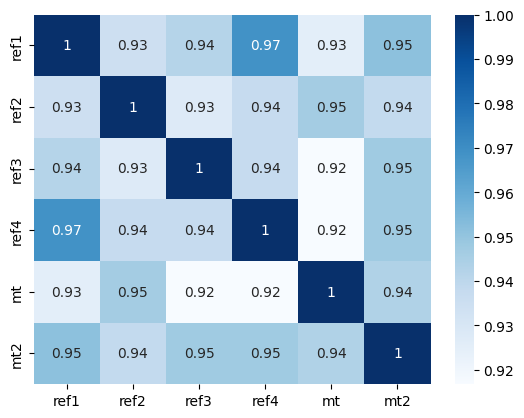

41.78302361451637
13.700356610511308
17.204616998315103
17.29752288684321
13.170575832999779
17.251918231432917


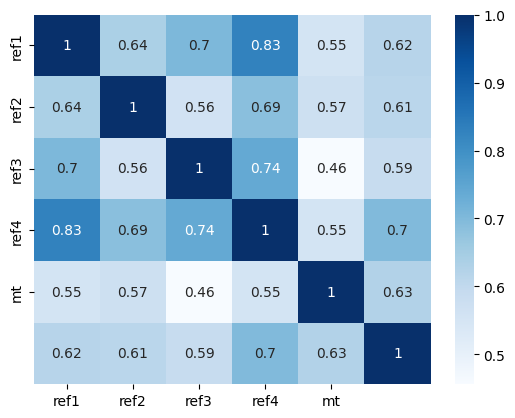

*************************************
13.675203939907835
13.675203939907835
17.318796886652546
17.581918911135965
13.217748347488405
17.39227222185741
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


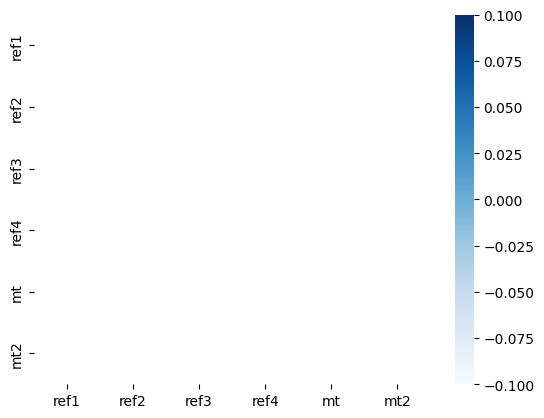

L
src
10.359164788583737
10.123614579255745
ref1
4.448937399448149
4.363903070466492
ref2
4.767095146294136
4.702993246080875
ref3
4.831204270461292
4.726469778238654
ref4
4.320187327518389
4.2491066129029305
mt
5.064915498660881
4.849995730879434
mt2
4.922809232756004
4.785039760715277
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.788479  0.762744  0.853182  0.681346  0.702701
ref2_L  0.788479  1.000000  0.786749  0.829314  0.688031  0.667659
ref3_L  0.762744  0.786749  1.000000  0.787270  0.661707  0.694029
ref4_L  0.853182  0.829314  0.787270  1.000000  0.688099  0.710269
mt_L    0.681346  0.688031  0.661707  0.688099  1.000000  0.852493
mt2_L   0.702701  0.667659  0.694029  0.710269  0.852493  1.000000


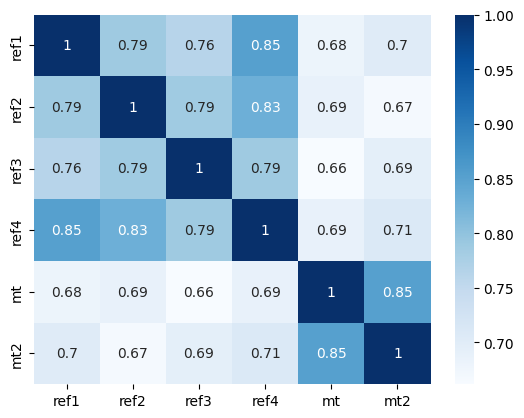

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.3329593156616335
1.329931418085137
ref2
1.3551667044243294
1.3521572014033378
ref3
1.363867693283994
1.3604897720317926
ref4
1.3178537119422356
1.3121256003071617
mt
1.3786887395531262
1.376299802072645
mt2
1.366529145803568
1.3533812655091282
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.827097    0.805301    0.881821  0.780585   
ref2_SL_25    0.827097    1.000000    0.819324    0.845042  0.763856   
ref3_SL_25    0.805301    0.819324    1.000000    0.804510  0.745005   
ref4_SL_25    0.881821    0.845042    0.804510    1.000000  0.783196   
mt_SL_25      0.780585    0.763856    0.745005    0.783196  1.000000   
mt2_SL_25     0.777639    0.754653    0.761196    0.785499  0.889136   

            mt2_SL_25  
ref1_SL_25   0.777639  
ref2_SL_25   0.754653  
ref3_SL_25   0.761196  
ref4_SL_25   0.785499  
mt_SL_25     0.889136  
mt2_SL_25    1.000000  


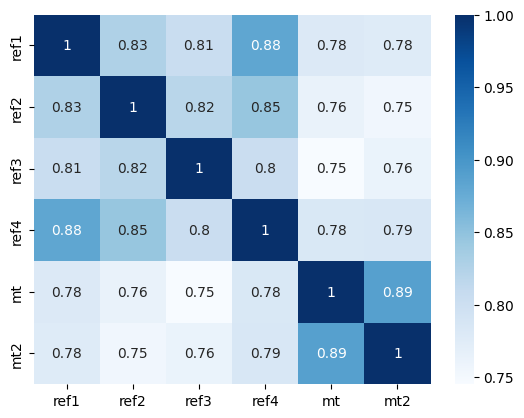

SL_50
src
3.0671973011635125
3.032966843199389
ref1
1.9084568500170715
1.9026653655657189
ref2
1.9734254970972394
1.9630181627447052
ref3
1.9937492169458715
1.9763717744706906
ref4
1.8725570042919675
1.8536938240102256
mt
2.0391260769007027
2.0115000443242783
mt2
2.0058835715329284
1.9797007532093263
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.816333    0.788851    0.872912  0.745610   
ref2_SL_50    0.816333    1.000000    0.805483    0.840210  0.737006   
ref3_SL_50    0.788851    0.805483    1.000000    0.795403  0.713361   
ref4_SL_50    0.872912    0.840210    0.795403    1.000000  0.749867   
mt_SL_50      0.745610    0.737006    0.713361    0.749867  1.000000   
mt2_SL_50     0.755616    0.726322    0.738015    0.760133  0.879130   

            mt2_SL_50  
ref1_SL_50   0.755616  
ref2_SL_50   0.726322  
ref3_SL_50   0.738015  
ref4_SL_50   0.760133  
mt_SL_50     0.879130  
mt2_SL_50    1.000000  


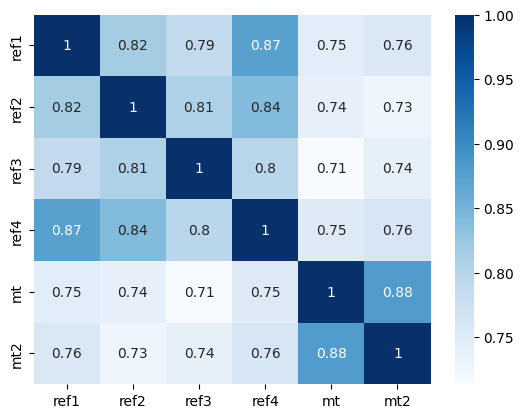

SL_75
src
5.5762344444241885
5.474223342002128
ref1
2.8631222429073726
2.827776274408189
ref2
3.0130189769215177
2.989089534701067
ref3
3.0506003528541648
3.0079992895437786
ref4
2.7932734392643903
2.764395639926037
mt
3.1581172550882575
3.0630084226771777
mt2
3.08663669589463
3.04086607782281
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.803345    0.774939    0.863182  0.712942   
ref2_SL_75    0.803345    1.000000    0.795255    0.835182  0.712648   
ref3_SL_75    0.774939    0.795255    1.000000    0.790305  0.686661   
ref4_SL_75    0.863182    0.835182    0.790305    1.000000  0.718425   
mt_SL_75      0.712942    0.712648    0.686661    0.718425  1.000000   
mt2_SL_75     0.730120    0.697081    0.715832    0.734844  0.866986   

            mt2_SL_75  
ref1_SL_75   0.730120  
ref2_SL_75   0.697081  
ref3_SL_75   0.715832  
ref4_SL_75   0.734844  
mt_SL_75     0.866986  
mt2_SL_75    1.000000  


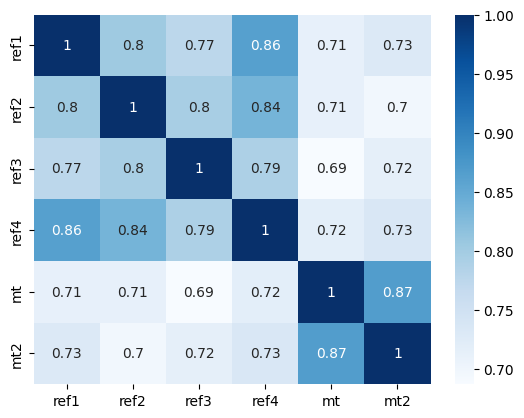

SL_100
src
10.359164788583737
10.123614579255745
ref1
4.448937399448149
4.363903070466492
ref2
4.767095146294136
4.702993246080875
ref3
4.831204270461292
4.726469778238654
ref4
4.320187327518389
4.2491066129029305
mt
5.064915498660881
4.849995730879434
mt2
4.922809232756004
4.785039760715277
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.788479     0.762744     0.853182   0.681346   
ref2_SL_100     0.788479     1.000000     0.786749     0.829314   0.688031   
ref3_SL_100     0.762744     0.786749     1.000000     0.787270   0.661707   
ref4_SL_100     0.853182     0.829314     0.787270     1.000000   0.688099   
mt_SL_100       0.681346     0.688031     0.661707     0.688099   1.000000   
mt2_SL_100      0.702701     0.667659     0.694029     0.710269   0.852493   

             mt2_SL_100  
ref1_SL_100    0.702701  
ref2_SL_100    0.667659  
ref3_SL_100    0.694029  
ref4_SL_100    0.710269  
mt_SL_100      0.852493  
mt2_

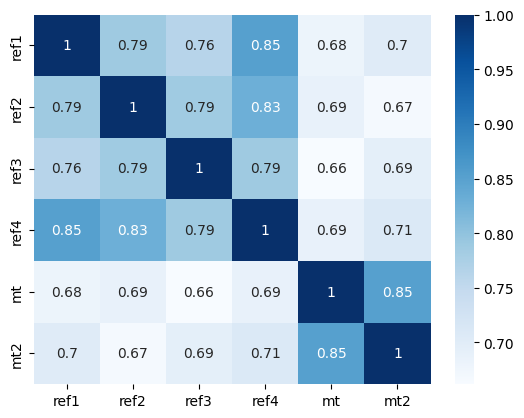

SL_125
src
19.634351008953868
18.984081758810827
ref1
7.115648593325273
6.942899135170199
ref2
7.766308317452673
7.629747997958631
ref3
7.870933172557289
7.629575358647138
ref4
6.881805286992095
6.691785787271774
mt
8.360694156296656
7.915481291346682
mt2
8.087312862260237
7.818523449578648
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.773090     0.752405     0.843855   0.650745   
ref2_SL_125     0.773090     1.000000     0.779000     0.822444   0.662420   
ref3_SL_125     0.752405     0.779000     1.000000     0.785223   0.637084   
ref4_SL_125     0.843855     0.822444     0.785223     1.000000   0.658530   
mt_SL_125       0.650745     0.662420     0.637084     0.658530   1.000000   
mt2_SL_125      0.674962     0.639327     0.672377     0.686929   0.834739   

             mt2_SL_125  
ref1_SL_125    0.674962  
ref2_SL_125    0.639327  
ref3_SL_125    0.672377  
ref4_SL_125    0.686929  
mt_SL_125      0.834739  
mt2_S

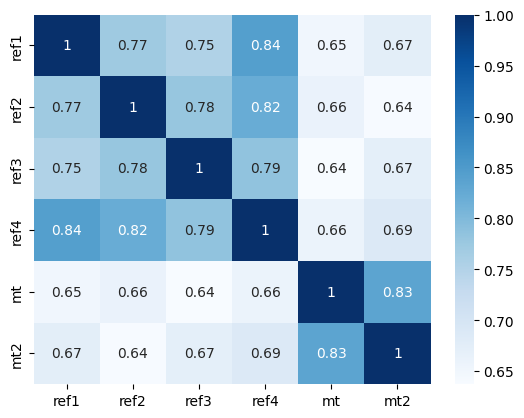

SL_150
src
37.92546190950008
36.245652911575796
ref1
11.670553107701503
11.265367798181792
ref2
12.978318859358641
12.66564494807099
ref3
13.142750709834258
12.556493135809212
ref4
11.245632407639045
10.89167565846707
mt
14.152595149616163
13.185629084406887
mt2
13.63477483286517
12.947169793540255
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.758904     0.744701     0.836214   0.621938   
ref2_SL_150     0.758904     1.000000     0.771966     0.815063   0.636456   
ref3_SL_150     0.744701     0.771966     1.000000     0.783974   0.612742   
ref4_SL_150     0.836214     0.815063     0.783974     1.000000   0.630085   
mt_SL_150       0.621938     0.636456     0.612742     0.630085   1.000000   
mt2_SL_150      0.648916     0.614140     0.651610     0.665944   0.812971   

             mt2_SL_150  
ref1_SL_150    0.648916  
ref2_SL_150    0.614140  
ref3_SL_150    0.651610  
ref4_SL_150    0.665944  
mt_SL_150      0.812971

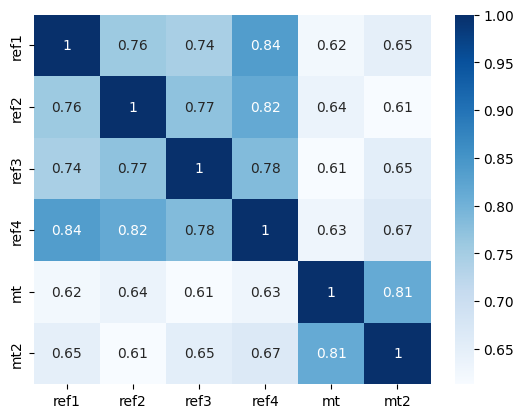

SL_175
src
74.59367553068095
71.2767390568266
ref1
19.58294165649454
18.41976417637744
ref2
22.192287329606973
21.39985550912853
ref3
22.439220359451653
21.143065288860157
ref4
18.80473364912112
18.2089880211186
mt
24.508963333893536
22.52676698931009
mt2
23.536398382324503
21.640764415951836
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.747903     0.740795     0.831344   0.596167   
ref2_SL_175     0.747903     1.000000     0.766322     0.808333   0.611555   
ref3_SL_175     0.740795     0.766322     1.000000     0.784017   0.589439   
ref4_SL_175     0.831344     0.808333     0.784017     1.000000   0.603714   
mt_SL_175       0.596167     0.611555     0.589439     0.603714   1.000000   
mt2_SL_175      0.627079     0.594758     0.633385     0.649112   0.786897   

             mt2_SL_175  
ref1_SL_175    0.627079  
ref2_SL_175    0.594758  
ref3_SL_175    0.633385  
ref4_SL_175    0.649112  
mt_SL_175      0.786897  
mt2

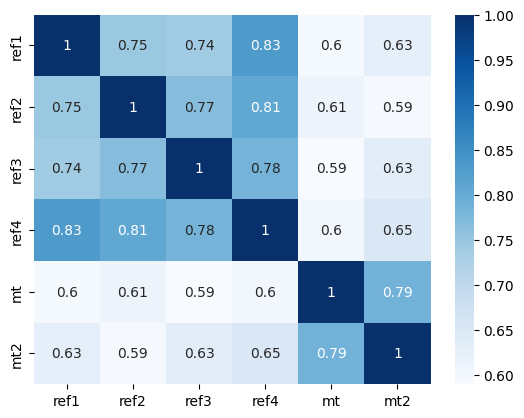

SL_200
src
149.29007454484417
140.79844066957907
ref1
33.5710199275372
31.205704049072608
ref2
38.76849170205772
36.548973689893344
ref3
39.114593039830666
36.01743802911039
ref4
32.12830055251635
30.489578693985308
mt
43.355588060331236
38.77798085211465
mt2
41.540423964688856
36.95975400721383
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.742193     0.741957     0.830345   0.574794   
ref2_SL_200     0.742193     1.000000     0.763239     0.803920   0.589487   
ref3_SL_200     0.741957     0.763239     1.000000     0.786302   0.568394   
ref4_SL_200     0.830345     0.803920     0.786302     1.000000   0.580754   
mt_SL_200       0.574794     0.589487     0.568394     0.580754   1.000000   
mt2_SL_200      0.612276     0.583977     0.620007     0.638611   0.756993   

             mt2_SL_200  
ref1_SL_200    0.612276  
ref2_SL_200    0.583977  
ref3_SL_200    0.620007  
ref4_SL_200    0.638611  
mt_SL_200      0.756993  


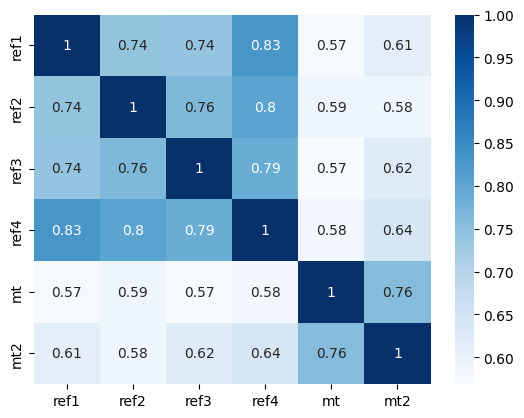

SL_225
src
303.8405857924159
280.9173422693609
ref1
58.75320470601394
52.97938431686313
ref2
69.12236596796127
63.96254748462206
ref3
69.54951914084886
62.42722027574119
ref4
56.03707376821765
51.8185677470692
mt
78.26781058649819
67.4996290033024
mt2
74.90495030346624
64.34888617769045
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.743556     0.749076     0.834036   0.559005   
ref2_SL_225     0.743556     1.000000     0.763998     0.803570   0.571973   
ref3_SL_225     0.749076     0.763998     1.000000     0.791839   0.550984   
ref4_SL_225     0.834036     0.803570     0.791839     1.000000   0.562667   
mt_SL_225       0.559005     0.571973     0.550984     0.562667   1.000000   
mt2_SL_225      0.606953     0.583873     0.613761     0.636260   0.724764   

             mt2_SL_225  
ref1_SL_225    0.606953  
ref2_SL_225    0.583873  
ref3_SL_225    0.613761  
ref4_SL_225    0.636260  
mt_SL_225      0.724764  
mt2_SL_22

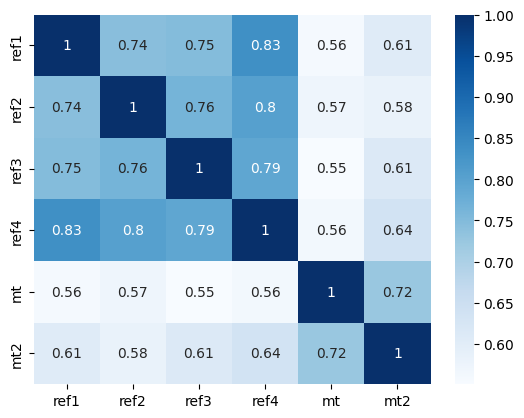

SL_250
src
628.4544909090951
577.7790438817206
ref1
104.94972856217673
91.69358251232828
ref2
125.71059540418086
112.3681529678704
ref3
126.091940753435
109.82375844824938
ref4
99.74255883862281
89.74503366513767
mt
144.11305008774258
117.87418891495713
mt2
137.95300966188128
113.3622725356781
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.752745     0.762028     0.842463   0.549469   
ref2_SL_250     0.752745     1.000000     0.769415     0.808434   0.560238   
ref3_SL_250     0.762028     0.769415     1.000000     0.801118   0.538341   
ref4_SL_250     0.842463     0.808434     0.801118     1.000000   0.550610   
mt_SL_250       0.549469     0.560238     0.538341     0.550610   1.000000   
mt2_SL_250      0.612150     0.594845     0.615918     0.642565   0.692664   

             mt2_SL_250  
ref1_SL_250    0.612150  
ref2_SL_250    0.594845  
ref3_SL_250    0.615918  
ref4_SL_250    0.642565  
mt_SL_250      0.692664  
mt

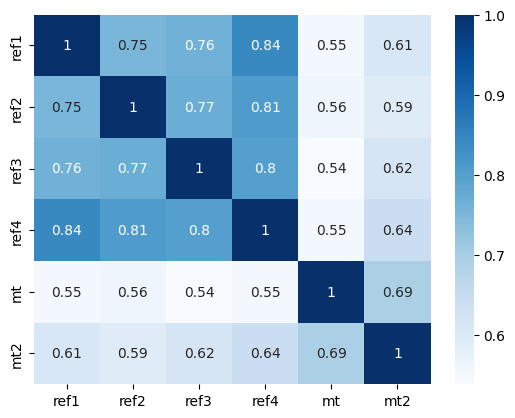

SL_275
src
1320.1522165503627
1219.778984730092
ref1
191.37510906392853
159.3190672077991
ref2
233.13941613850835
201.50781814219715
ref3
233.06691487958093
193.7986937840298
ref4
181.18321606196815
157.32908371507258
mt
270.57801747310117
209.0933296346949
mt2
259.5050550062444
200.57514162988252
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.768945     0.779329     0.854612   0.546070   
ref2_SL_275     0.768945     1.000000     0.779333     0.818497   0.554633   
ref3_SL_275     0.779329     0.779333     1.000000     0.813653   0.530932   
ref4_SL_275     0.854612     0.818497     0.813653     1.000000   0.544962   
mt_SL_275       0.546070     0.554633     0.530932     0.544962   1.000000   
mt2_SL_275      0.626792     0.615176     0.625964     0.656218   0.663493   

             mt2_SL_275  
ref1_SL_275    0.626792  
ref2_SL_275    0.615176  
ref3_SL_275    0.625964  
ref4_SL_275    0.656218  
mt_SL_275      0.663493 

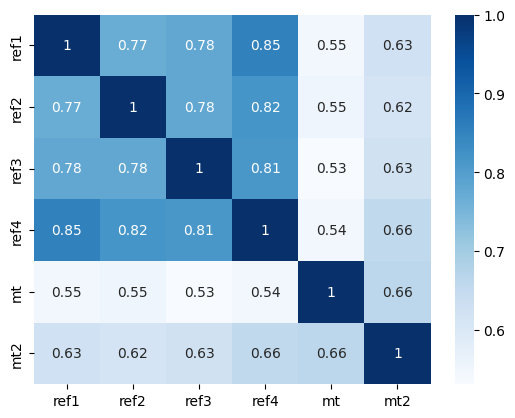

SL_300
src
2814.3535145845594
2540.753413906092
ref1
356.3964852770317
281.2973063557679
ref2
440.86669809693484
362.9766978628914
ref3
439.2787448392863
346.2358666731185
ref4
335.98237467255314
281.79926554384775
mt
517.9824354078803
375.69496755603086
mt2
498.71162912848644
355.60226201133645
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.789938     0.798519     0.868679   0.547870   
ref2_SL_300     0.789938     1.000000     0.792552     0.832530   0.554533   
ref3_SL_300     0.798519     0.792552     1.000000     0.828043   0.528338   
ref4_SL_300     0.868679     0.832530     0.828043     1.000000   0.545085   
mt_SL_300       0.547870     0.554533     0.528338     0.545085   1.000000   
mt2_SL_300      0.648001     0.641573     0.641689     0.674562   0.639522   

             mt2_SL_300  
ref1_SL_300    0.648001  
ref2_SL_300    0.641573  
ref3_SL_300    0.641689  
ref4_SL_300    0.674562  
mt_SL_300      0.639522  


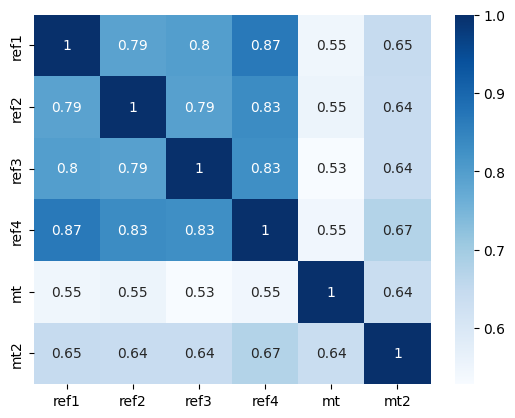

SL_325
src
6084.052939199673
5462.138856697426
ref1
678.2273283921526
502.5025261853538
ref2
850.04599581478
653.0268123819412
ref3
844.4838865213808
623.9859429017395
ref4
636.3040585342266
496.6126133994652
mt
1011.0448863025292
684.614040237262
mt2
979.4014144164158
642.9103945006457
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.812944     0.817082     0.882794   0.553386   
ref2_SL_325     0.812944     1.000000     0.807280     0.848643   0.558589   
ref3_SL_325     0.817082     0.807280     1.000000     0.842556   0.529389   
ref4_SL_325     0.882794     0.848643     0.842556     1.000000   0.549523   
mt_SL_325       0.553386     0.558589     0.529389     0.549523   1.000000   
mt2_SL_325      0.672284     0.670347     0.660119     0.694688   0.621883   

             mt2_SL_325  
ref1_SL_325    0.672284  
ref2_SL_325    0.670347  
ref3_SL_325    0.660119  
ref4_SL_325    0.694688  
mt_SL_325      0.621883  
mt2_SL_32

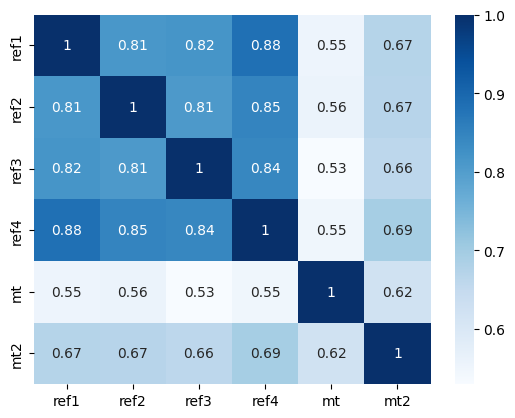

SL_350
src
13326.018221127724
11692.845168165546
ref1
1319.645892291087
900.4468789226077
ref2
1671.1535797945696
1193.972942258178
ref3
1656.4255535027673
1129.95559160023
ref4
1231.2690908567604
883.6535439453868
mt
2012.1220710769444
1262.5865890886657
mt2
1965.9098985061426
1176.4086983667014
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.835548     0.833239     0.895627   0.561026   
ref2_SL_350     0.835548     1.000000     0.821770     0.865002   0.565195   
ref3_SL_350     0.833239     0.821770     1.000000     0.855763   0.532589   
ref4_SL_350     0.895627     0.865002     0.855763     1.000000   0.556515   
mt_SL_350       0.561026     0.565195     0.532589     0.556515   1.000000   
mt2_SL_350      0.696715     0.698482     0.678561     0.714323   0.610538   

             mt2_SL_350  
ref1_SL_350    0.696715  
ref2_SL_350    0.698482  
ref3_SL_350    0.678561  
ref4_SL_350    0.714323  
mt_SL_350      0.610538  

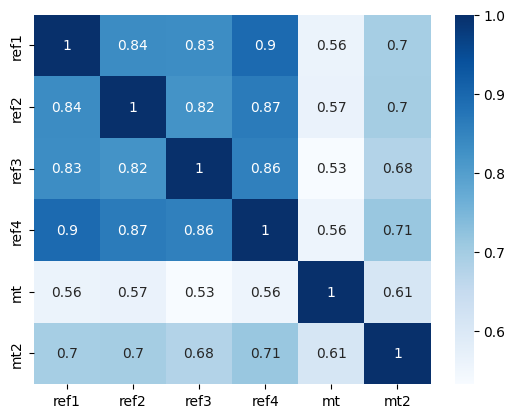

SL_375
src
29547.541988410783
25794.64486383465
ref1
2626.3625211532535
1612.0355875276032
ref2
3349.5651768777457
2205.3966340053644
ref3
3315.770975192981
2043.147770464096
ref4
2435.0832016269105
1574.902954258357
mt
4082.4669289414196
2350.488051385746
mt2
4033.2511104178966
2171.1113278791872
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.856198     0.846168     0.906554   0.569453   
ref2_SL_375     0.856198     1.000000     0.834748     0.880281   0.572910   
ref3_SL_375     0.846168     0.834748     1.000000     0.866823   0.536539   
ref4_SL_375     0.906554     0.880281     0.866823     1.000000   0.564487   
mt_SL_375       0.569453     0.572910     0.536539     0.564487   1.000000   
mt2_SL_375      0.719441     0.724075     0.695156     0.732108   0.604669   

             mt2_SL_375  
ref1_SL_375    0.719441  
ref2_SL_375    0.724075  
ref3_SL_375    0.695156  
ref4_SL_375    0.732108  
mt_SL_375      0.604669 

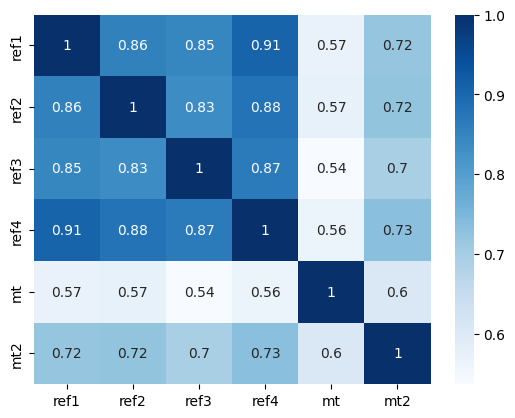

SL_400
src
66263.42583599311
56824.85462524026
ref1
5346.97180504164
2884.511177654773
ref2
6843.093882276138
4067.9960785852636
ref3
6774.114180034014
3796.9872471505923
ref4
4922.284727975959
2808.921706162284
mt
8442.32810709984
4415.040952708068
mt2
8454.837369671626
3991.3748842676314
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.874189     0.855781     0.915484   0.577738   
ref2_SL_400     0.874189     1.000000     0.845513     0.893760   0.580686   
ref3_SL_400     0.855781     0.845513     1.000000     0.875436   0.540196   
ref4_SL_400     0.915484     0.893760     0.875436     1.000000   0.572303   
mt_SL_400       0.577738     0.580686     0.540196     0.572303   1.000000   
mt2_SL_400      0.739587     0.746240     0.708905     0.747439   0.603145   

             mt2_SL_400  
ref1_SL_400    0.739587  
ref2_SL_400    0.746240  
ref3_SL_400    0.708905  
ref4_SL_400    0.747439  
mt_SL_400      0.603145  
mt2_SL

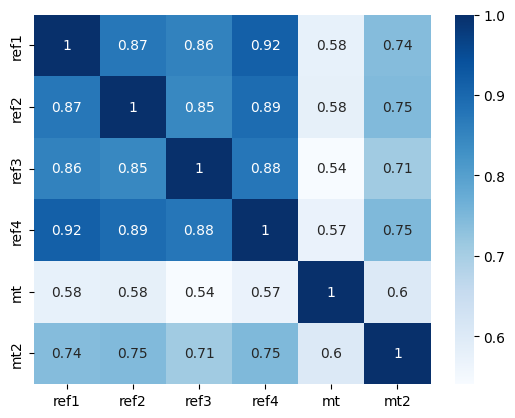

SL_425
src
150170.28195142408
126458.59758375768
ref1
11132.10165621963
5232.380606653818
ref2
14243.480061127495
7515.747829210534
ref3
14121.617492947047
6958.876334238771
ref4
10166.625636502953
5049.65111623092
mt
17785.654727488527
8174.349508355308
mt2
18098.107584744987
7437.04378598729
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.889412     0.862388     0.922608   0.585352   
ref2_SL_425     0.889412     1.000000     0.853818     0.905191   0.587886   
ref3_SL_425     0.862388     0.853818     1.000000     0.881648   0.542914   
ref4_SL_425     0.922608     0.905191     0.881648     1.000000   0.579297   
mt_SL_425       0.585352     0.587886     0.542914     0.579297   1.000000   
mt2_SL_425      0.756919     0.764788     0.719431     0.760183   0.604858   

             mt2_SL_425  
ref1_SL_425    0.756919  
ref2_SL_425    0.764788  
ref3_SL_425    0.719431  
ref4_SL_425    0.760183  
mt_SL_425      0.604858  
mt

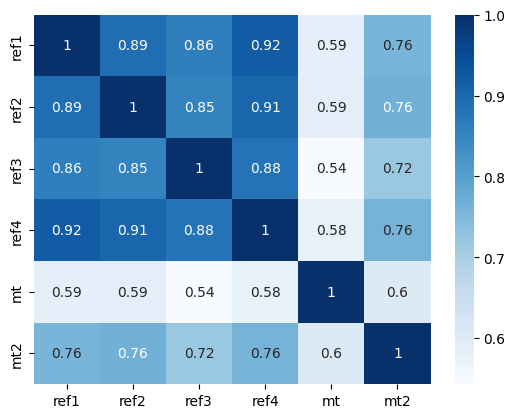

SL_450
src
343632.9097266221
283095.18838540884
ref1
23682.114829674956
9569.03547800846
ref2
30184.95343773775
13997.969107056015
ref3
30022.918201111825
12999.335748561467
ref4
21440.45672280825
9186.525380896099
mt
38145.49522972773
14937.999840889726
mt2
39519.13480010991
13864.2945830389
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.902086     0.866430     0.928217   0.592065   
ref2_SL_450     0.902086     1.000000     0.859704     0.914619   0.594201   
ref3_SL_450     0.866430     0.859704     1.000000     0.885674   0.544379   
ref4_SL_450     0.928217     0.914619     0.885674     1.000000   0.585164   
mt_SL_450       0.592065     0.594201     0.544379     0.585164   1.000000   
mt2_SL_450      0.771534     0.779902     0.726722     0.770442   0.608881   

             mt2_SL_450  
ref1_SL_450    0.771534  
ref2_SL_450    0.779902  
ref3_SL_450    0.726722  
ref4_SL_450    0.770442  
mt_SL_450      0.608881  
mt2

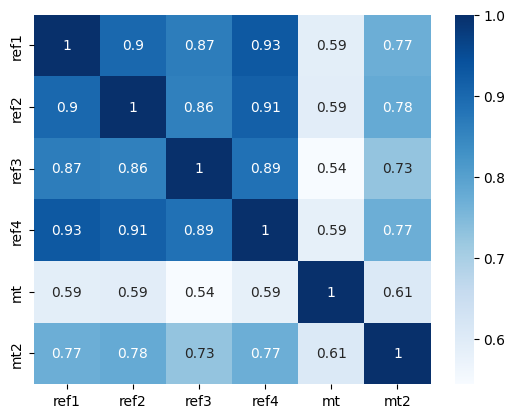

SL_475
src
793365.4482151263
640119.8046014623
ref1
51416.41983578021
17788.998414455877
ref2
65071.705880608155
26181.500937827026
ref3
65041.5433023267
24270.005445940573
ref4
46116.56755925343
16745.789955449476
mt
83211.55446436674
28131.261265359743
mt2
87915.29523878347
26203.921816289425
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.912558     0.868342     0.932599   0.597833   
ref2_SL_475     0.912558     1.000000     0.863359     0.922236   0.599542   
ref3_SL_475     0.868342     0.863359     1.000000     0.887779   0.544496   
ref4_SL_475     0.932599     0.922236     0.887779     1.000000   0.589837   
mt_SL_475       0.597833     0.599542     0.544496     0.589837   1.000000   
mt2_SL_475      0.783660     0.791921     0.730941     0.778409   0.614504   

             mt2_SL_475  
ref1_SL_475    0.783660  
ref2_SL_475    0.791921  
ref3_SL_475    0.730941  
ref4_SL_475    0.778409  
mt_SL_475      0.614504  
m

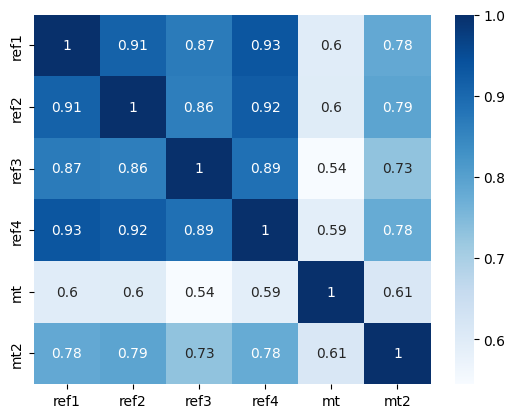

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
113743.23396396743
32414.97652038804
ref2
142545.9793127012
49172.40183427272
ref3
143418.55263555932
45515.479351199014
ref4
101022.81172296956
31264.45839327414
mt
184420.49813074694
53476.85302617143
mt2
198949.34628252854
49676.70938513055
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.921197     0.868490     0.935998   0.602714   
ref2_SL_500     0.921197     1.000000     0.865019     0.928280   0.603945   
ref3_SL_500     0.868490     0.865019     1.000000     0.888220   0.543298   
ref4_SL_500     0.935998     0.928280     0.888220     1.000000   0.593382   
mt_SL_500       0.602714     0.603945     0.543298     0.593382   1.000000   
mt2_SL_500      0.793554     0.801221     0.732320     0.784295   0.621213   

             mt2_SL_500  
ref1_SL_500    0.793554  
ref2_SL_500    0.801221  
ref3_SL_500    0.732320  
ref4_SL_500    0.784295  
mt_SL_500      0.621213  

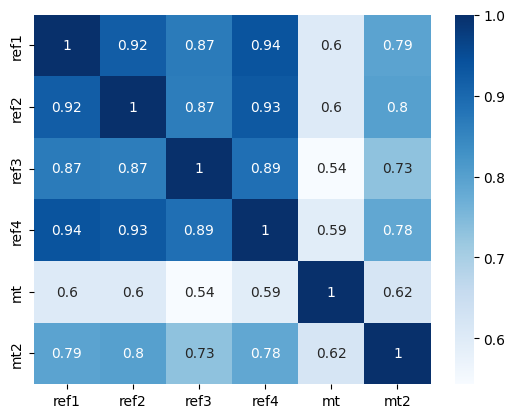

SL_525
src
4331606.646061756
3141367.4417431457
ref1
255910.45942916226
59807.71667928761
ref2
316920.0929252144
92569.81865043848
ref3
321443.917797211
84926.69543865634
ref4
225005.18694725525
57112.91682426602
mt
414740.457545496
99033.26856929669
mt2
457217.8177941324
92457.38493871354
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.928340     0.867166     0.938614   0.606813   
ref2_SL_525     0.928340     1.000000     0.864924     0.932992   0.607501   
ref3_SL_525     0.867166     0.864924     1.000000     0.887220   0.540884   
ref4_SL_525     0.938614     0.932992     0.887220     1.000000   0.595923   
mt_SL_525       0.606813     0.607501     0.540884     0.595923   1.000000   
mt2_SL_525      0.801458     0.808152     0.731105     0.788305   0.628649   

             mt2_SL_525  
ref1_SL_525    0.801458  
ref2_SL_525    0.808152  
ref3_SL_525    0.731105  
ref4_SL_525    0.788305  
mt_SL_525      0.628649  
mt2_SL

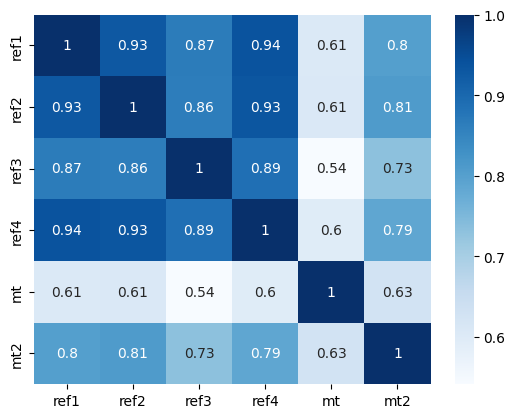

SL_550
src
10231354.187866237
7329958.645473514
ref1
584432.9673943919
109629.01715590185
ref2
714181.3856073362
176520.15324264613
ref3
731200.463145391
160951.92929902463
ref4
508619.5756688713
105559.19112287443
mt
945159.7448435898
187083.07296212297
mt2
1065299.9082358314
176816.7337096549
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.934273     0.864591     0.940597   0.610243   
ref2_SL_550     0.934273     1.000000     0.863289     0.936587   0.610326   
ref3_SL_550     0.864591     0.863289     1.000000     0.884965   0.537371   
ref4_SL_550     0.940597     0.936587     0.884965     1.000000   0.597603   
mt_SL_550       0.610243     0.610326     0.537371     0.597603   1.000000   
mt2_SL_550      0.807587     0.813024     0.727537     0.790622   0.636566   

             mt2_SL_550  
ref1_SL_550    0.807587  
ref2_SL_550    0.813024  
ref3_SL_550    0.727537  
ref4_SL_550    0.790622  
mt_SL_550      0.636566  
m

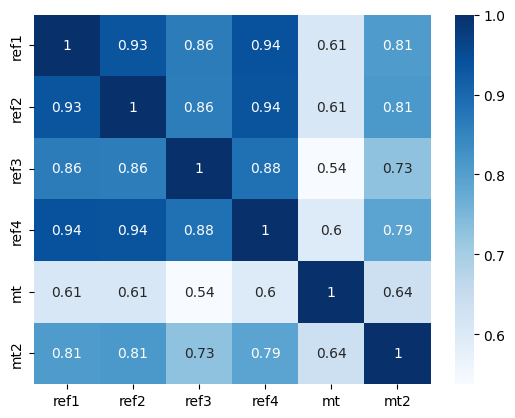

SL_575
src
24325330.39833967
16966711.067660846
ref1
1352111.7226790802
200964.9160977029
ref2
1629102.790550356
337464.15077394724
ref3
1685462.4284912385
303940.7391055984
ref4
1164742.4060860984
196232.0363514738
mt
2179738.0326322615
361077.94470478815
mt2
2512310.1192316953
330307.08653963206
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.939231     0.860932     0.942065   0.613114   
ref2_SL_575     0.939231     1.000000     0.860299     0.939250   0.612530   
ref3_SL_575     0.860932     0.860299     1.000000     0.881603   0.532879   
ref4_SL_575     0.942065     0.939250     0.881603     1.000000   0.598560   
mt_SL_575       0.613114     0.612530     0.532879     0.598560   1.000000   
mt2_SL_575      0.812130     0.816102     0.721839     0.791415   0.644793   

             mt2_SL_575  
ref1_SL_575    0.812130  
ref2_SL_575    0.816102  
ref3_SL_575    0.721839  
ref4_SL_575    0.791415  
mt_SL_575      0.644793 

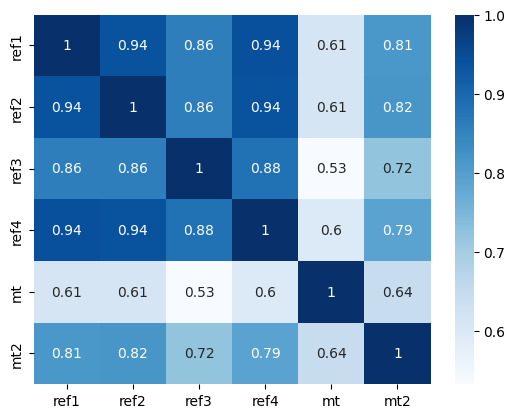

SL_600
src
58189712.87790054
39214596.580572255
ref1
3163087.1734842528
371703.988486356
ref2
3756592.4812323386
630751.9675302494
ref3
3930791.819078174
574138.4955665958
ref4
2697375.8329324313
361332.3560756366
mt
5080346.754543759
705706.8187037054
mt2
5987651.003669693
627732.0346166203
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.943404     0.856312     0.943106   0.615523   
ref2_SL_600     0.943404     1.000000     0.856111     0.941132   0.614216   
ref3_SL_600     0.856312     0.856111     1.000000     0.877254   0.527518   
ref4_SL_600     0.943106     0.941132     0.877254     1.000000   0.598917   
mt_SL_600       0.615523     0.614216     0.527518     0.598917   1.000000   
mt2_SL_600      0.815249     0.817614     0.714221     0.790835   0.653218   

             mt2_SL_600  
ref1_SL_600    0.815249  
ref2_SL_600    0.817614  
ref3_SL_600    0.714221  
ref4_SL_600    0.790835  
mt_SL_600      0.653218  
mt2_

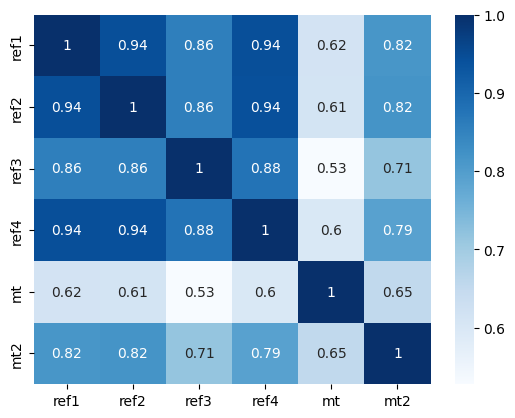

SL_625
src
140004729.32922277
89386250.1037006
ref1
7469468.707484211
699786.4799154715
ref2
8745696.920314044
1206335.4372904329
ref3
9261453.220087532
1081915.2335488205
ref4
6306995.2722130995
672390.3770119062
mt
11951451.358864576
1382178.5522007784
mt2
14401635.640992573
1195297.6610840322
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.946941     0.850824     0.943788   0.617552   
ref2_SL_625     0.946941     1.000000     0.850850     0.942359   0.615472   
ref3_SL_625     0.850824     0.850850     1.000000     0.872013   0.521383   
ref4_SL_625     0.943788     0.942359     0.872013     1.000000   0.598780   
mt_SL_625       0.617552     0.615472     0.521383     0.598780   1.000000   
mt2_SL_625      0.817094     0.817758     0.704879     0.789025   0.661765   

             mt2_SL_625  
ref1_SL_625    0.817094  
ref2_SL_625    0.817758  
ref3_SL_625    0.704879  
ref4_SL_625    0.789025  
mt_SL_625      0.661765  


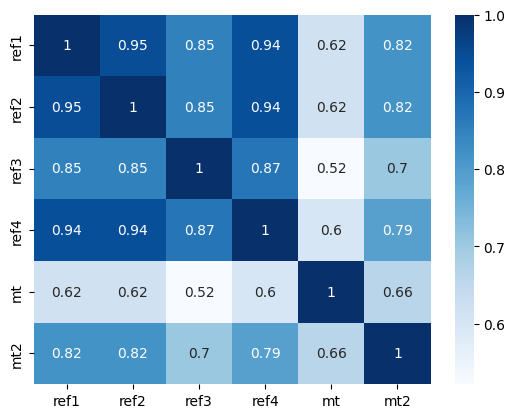

SL_650
src
338703171.3009422
210335993.3140239
ref1
17778355.680711024
1321830.9809887134
ref2
20532212.82166898
2315734.1653811345
ref3
22015396.95593142
2043240.6830016496
ref4
14867550.54872352
1239595.555787068
mt
28344917.489794202
2615781.019365512
mt2
34913890.2657263
2272703.4425871177
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.949962     0.844540     0.944163   0.619269   
ref2_SL_650     0.949962     1.000000     0.844623     0.943032   0.616371   
ref3_SL_650     0.844540     0.844623     1.000000     0.865956   0.514558   
ref4_SL_650     0.944163     0.943032     0.865956     1.000000   0.598237   
mt_SL_650       0.619269     0.616371     0.514558     0.598237   1.000000   
mt2_SL_650      0.817796     0.816705     0.693998     0.786115   0.670380   

             mt2_SL_650  
ref1_SL_650    0.817796  
ref2_SL_650    0.816705  
ref3_SL_650    0.693998  
ref4_SL_650    0.786115  
mt_SL_650      0.670380  
mt

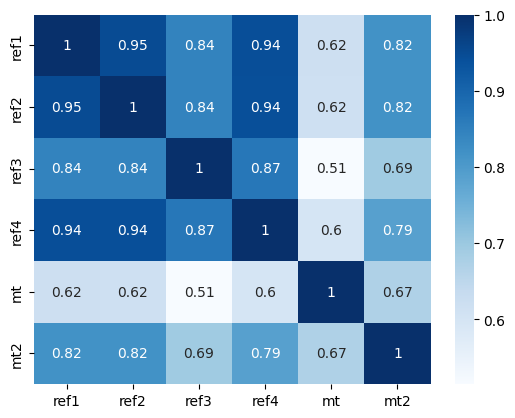

SL_675
src
823697155.0790491
502847016.137499
ref1
42593995.62792054
2502283.5609175777
ref2
48556693.32861391
4424230.807984488
ref3
52734226.92640119
3921523.19350635
ref4
35288769.00339213
2345019.6016917108
mt
67700808.43922384
5032886.4748812355
mt2
85220625.41743979
4328089.269444172
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.952562     0.837515     0.944271   0.620728   
ref2_SL_675     0.952562     1.000000     0.837517     0.943232   0.616972   
ref3_SL_675     0.837515     0.837517     1.000000     0.859144   0.507114   
ref4_SL_675     0.944271     0.943232     0.859144     1.000000   0.597358   
mt_SL_675       0.620728     0.616972     0.507114     0.597358   1.000000   
mt2_SL_675      0.817479     0.814609     0.681753     0.782231   0.679028   

             mt2_SL_675  
ref1_SL_675    0.817479  
ref2_SL_675    0.814609  
ref3_SL_675    0.681753  
ref4_SL_675    0.782231  
mt_SL_675      0.679028  
mt2_SL

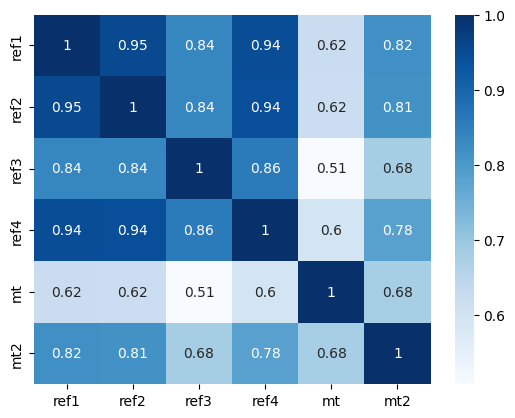

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
102606989.61924276
4804387.03566937
ref2
115561641.06790882
8512652.372552916
ref3
127148564.70360073
7567424.147119265
ref4
84243293.74441813
4445678.559152484
mt
162691230.7599814
9787630.905521665
mt2
209241113.34660494
8174200.906107632
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.954816     0.829795     0.944145   0.621973   
ref2_SL_700     0.954816     1.000000     0.829604     0.943028   0.617325   
ref3_SL_700     0.829795     0.829604     1.000000     0.851630   0.499111   
ref4_SL_700     0.944145     0.943028     0.851630     1.000000   0.596203   
mt_SL_700       0.621973     0.617325     0.499111     0.596203   1.000000   
mt2_SL_700      0.816256     0.811606     0.668308     0.777490   0.687686   

             mt2_SL_700  
ref1_SL_700    0.816256  
ref2_SL_700    0.811606  
ref3_SL_700    0.668308  
ref4_SL_700    0.777490  
mt_SL_700      0.687686  
mt

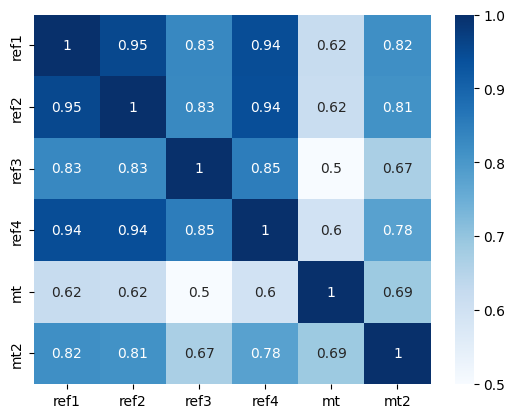

SL_725
src
4944587689.869408
2766777160.633936
ref1
248297438.38522574
9183801.046994042
ref2
276539560.4142453
16353762.885717971
ref3
308304564.7977143
14512359.27326262
ref4
202083016.66960138
8401548.642097566
mt
393028356.1960623
18896324.73689977
mt2
516371120.2460056
15437637.409456775
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.956783     0.821417     0.943809   0.623039   
ref2_SL_725     0.956783     1.000000     0.820945     0.942471   0.617469   
ref3_SL_725     0.821417     0.820945     1.000000     0.843458   0.490602   
ref4_SL_725     0.943809     0.942471     0.843458     1.000000   0.594819   
mt_SL_725       0.623039     0.617469     0.490602     0.594819   1.000000   
mt2_SL_725      0.814233     0.807818     0.653822     0.772003   0.696336   

             mt2_SL_725  
ref1_SL_725    0.814233  
ref2_SL_725    0.807818  
ref3_SL_725    0.653822  
ref4_SL_725    0.772003  
mt_SL_725      0.696336  
mt2

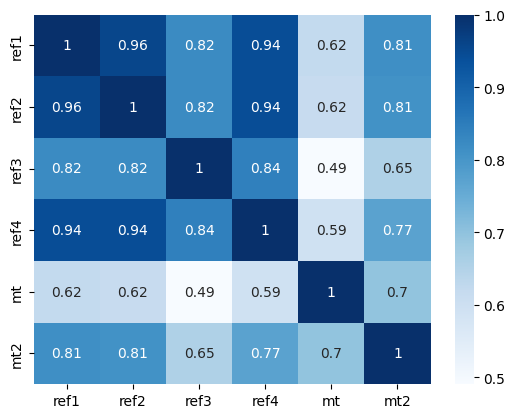

SL_750
src
12201196322.126482
6533701117.122557
ref1
603112196.746011
17452689.89749831
ref2
664896485.6290108
30971359.31028851
ref3
751196370.6021717
27997060.145597782
ref4
486719610.3683254
15756550.011457957
mt
953802864.652038
37088410.13768284
mt2
1279971313.5046253
29418191.85610003
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.958514     0.812412     0.943284   0.623951   
ref2_SL_750     0.958514     1.000000     0.811593     0.941607   0.617434   
ref3_SL_750     0.812412     0.811593     1.000000     0.834665   0.481634   
ref4_SL_750     0.943284     0.941607     0.834665     1.000000   0.593243   
mt_SL_750       0.623951     0.617434     0.481634     0.593243   1.000000   
mt2_SL_750      0.811508     0.803357     0.638441     0.765875   0.704965   

             mt2_SL_750  
ref1_SL_750    0.811508  
ref2_SL_750    0.803357  
ref3_SL_750    0.638441  
ref4_SL_750    0.765875  
mt_SL_750      0.704965  
mt2_S

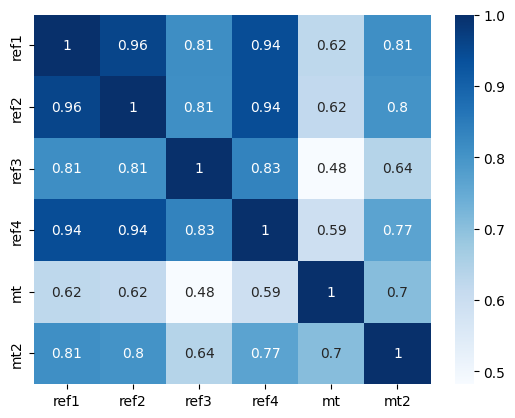

SL_775
src
30245243673.27781
15503724864.782127
ref1
1469527056.5618353
33193315.932092935
ref2
1605171253.847502
59732682.39077918
ref3
1837978378.826447
54188210.02204674
ref4
1176245772.7295763
29667142.700888846
mt
2323794633.7797947
72949487.32639766
mt2
3185072223.103054
56106321.07218835
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.960046     0.802810     0.942585   0.624732   
ref2_SL_775     0.960046     1.000000     0.801596     0.940470   0.617244   
ref3_SL_775     0.802810     0.801596     1.000000     0.825285   0.472248   
ref4_SL_775     0.942585     0.940470     0.825285     1.000000   0.591506   
mt_SL_775       0.624732     0.617244     0.472248     0.591506   1.000000   
mt2_SL_775      0.808174     0.798323     0.622306     0.759203   0.713562   

             mt2_SL_775  
ref1_SL_775    0.808174  
ref2_SL_775    0.798323  
ref3_SL_775    0.622306  
ref4_SL_775    0.759203  
mt_SL_775      0.713562  
m

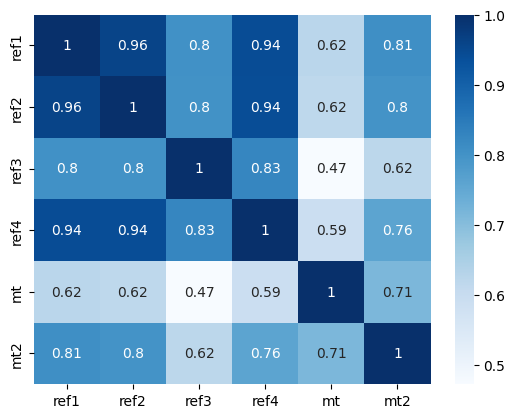

SL_800
src
75308449146.75627
37154119080.28433
ref1
3589909865.1552925
63521843.98669694
ref2
3888800473.8462534
115976946.63158196
ref3
4513315215.10844
103600046.23043291
ref4
2850701094.0715265
56528823.77352531
mt
5680805806.572465
142333417.81403777
mt2
7952727405.382356
107236369.8420861
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.961411     0.792640     0.941727   0.625396   
ref2_SL_800     0.961411     1.000000     0.790994     0.939091   0.616919   
ref3_SL_800     0.792640     0.790994     1.000000     0.815350   0.462483   
ref4_SL_800     0.941727     0.939091     0.815350     1.000000   0.589632   
mt_SL_800       0.625396     0.616919     0.462483     0.589632   1.000000   
mt2_SL_800      0.804313     0.792806     0.605547     0.752077   0.722119   

             mt2_SL_800  
ref1_SL_800    0.804313  
ref2_SL_800    0.792806  
ref3_SL_800    0.605547  
ref4_SL_800    0.752077  
mt_SL_800      0.722119  
mt

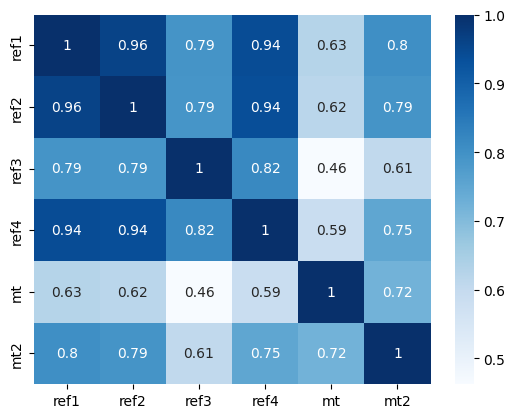

SL_825
src
188328461125.37543
88759479197.95065
ref1
8788814372.180523
120708816.19822475
ref2
9449915541.997353
224131411.03935087
ref3
11117688407.250093
198895382.19985092
ref4
6925397398.227662
107756645.13837841
mt
13928312797.427969
273744822.6178658
mt2
19916861966.574314
206656083.14226353
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.962636     0.781928     0.940720   0.625955   
ref2_SL_825     0.962636     1.000000     0.779827     0.937493   0.616474   
ref3_SL_825     0.781928     0.779827     1.000000     0.804890   0.452376   
ref4_SL_825     0.940720     0.937493     0.804890     1.000000   0.587641   
mt_SL_825       0.625955     0.616474     0.452376     0.587641   1.000000   
mt2_SL_825      0.800003     0.786889     0.588286     0.744580   0.730627   

             mt2_SL_825  
ref1_SL_825    0.800003  
ref2_SL_825    0.786889  
ref3_SL_825    0.588286  
ref4_SL_825    0.744580  
mt_SL_825      0.730627 

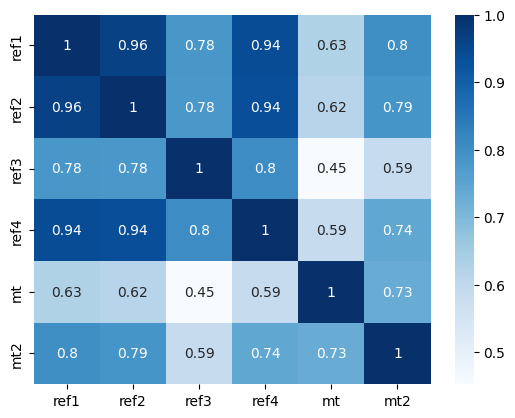

SL_850
src
472965874424.6596
209696852072.8994
ref1
21555903081.945374
229263371.4613696
ref2
23023933710.243317
434095137.3997326
ref3
27461635269.368862
385092591.43951595
ref4
16858393962.675892
203371005.89825818
mt
34237084589.64825
527314302.31273425
mt2
50014001329.6892
398633401.5518997
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.963742     0.770699     0.939573   0.626417   
ref2_SL_850     0.963742     1.000000     0.768131     0.935697   0.615920   
ref3_SL_850     0.770699     0.768131     1.000000     0.793933   0.441961   
ref4_SL_850     0.939573     0.935697     0.793933     1.000000   0.585550   
mt_SL_850       0.626417     0.615920     0.441961     0.585550   1.000000   
mt2_SL_850      0.795316     0.780644     0.570636     0.736788   0.739079   

             mt2_SL_850  
ref1_SL_850    0.795316  
ref2_SL_850    0.780644  
ref3_SL_850    0.570636  
ref4_SL_850    0.736788  
mt_SL_850      0.739079  
m

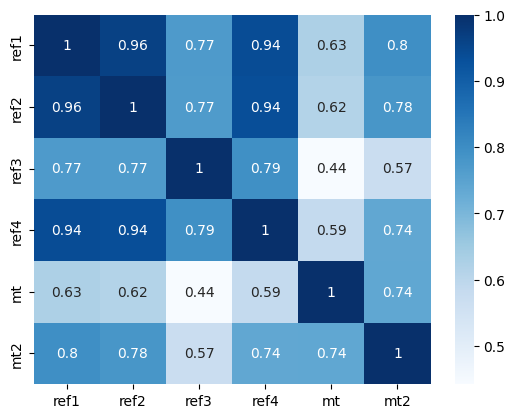

SL_875
src
1192729481778.0728
501307929419.6415
ref1
52950197727.20744
436395063.592717
ref2
56223526394.92003
850935163.9188163
ref3
67997002038.49977
746943079.1058307
ref4
41108666437.854744
389831127.48891884
mt
84345878175.11946
1016555693.6465828
mt2
125895102607.63846
767632983.0462579
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.964746     0.758983     0.938293   0.626789   
ref2_SL_875     0.964746     1.000000     0.755942     0.933721   0.615265   
ref3_SL_875     0.758983     0.755942     1.000000     0.782508   0.431271   
ref4_SL_875     0.938293     0.933721     0.782508     1.000000   0.583371   
mt_SL_875       0.626789     0.615265     0.431271     0.583371   1.000000   
mt2_SL_875      0.790314     0.774137     0.552701     0.728771   0.747466   

             mt2_SL_875  
ref1_SL_875    0.790314  
ref2_SL_875    0.774137  
ref3_SL_875    0.552701  
ref4_SL_875    0.728771  
mt_SL_875      0.747466  
mt2

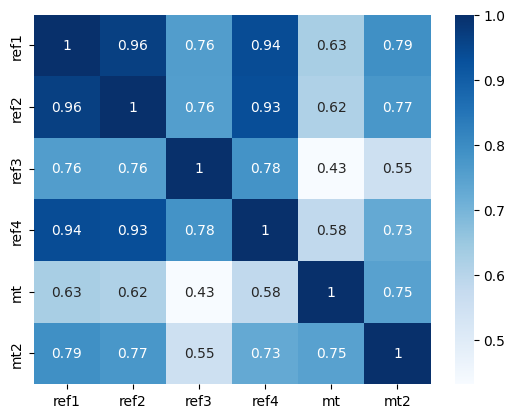

SL_900
src
3020011763176.6636
1193341285325.353
ref1
130236674220.98003
820025579.9362291
ref2
137566849104.85532
1652822178.0638824
ref3
168728019188.9109
1450289848.7738748
ref4
100389112985.6766
752254322.5239005
mt
208200078512.714
1926273556.2784538
mt2
317593822935.27094
1476825707.0431828
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.965663     0.746805     0.936887   0.627073   
ref2_SL_900     0.965663     1.000000     0.743294     0.931577   0.614515   
ref3_SL_900     0.746805     0.743294     1.000000     0.770643   0.420342   
ref4_SL_900     0.936887     0.931577     0.770643     1.000000   0.581116   
mt_SL_900       0.627073     0.614515     0.420342     0.581116   1.000000   
mt2_SL_900      0.785057     0.767426     0.534578     0.720591   0.755779   

             mt2_SL_900  
ref1_SL_900    0.785057  
ref2_SL_900    0.767426  
ref3_SL_900    0.534578  
ref4_SL_900    0.720591  
mt_SL_900      0.755779  


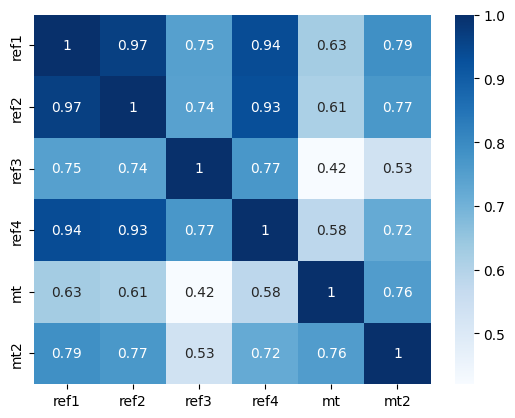

SL_925
src
7676878874728.81
2825871516031.6035
ref1
320686485189.43964
1534792885.00543
ref2
337175597388.9696
3234400222.2550607
ref3
419489849824.61707
2827084029.0323224
ref4
245462525967.12906
1439630791.9318802
mt
514810721902.7365
3672811188.9811215
mt2
802779063240.2413
2842940087.9475136
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.966506     0.734196     0.935359   0.627273   
ref2_SL_925     0.966506     1.000000     0.730221     0.929278   0.613675   
ref3_SL_925     0.734196     0.730221     1.000000     0.758367   0.409204   
ref4_SL_925     0.935359     0.929278     0.758367     1.000000   0.578794   
mt_SL_925       0.627273     0.613675     0.409204     0.578794   1.000000   
mt2_SL_925      0.779594     0.760562     0.516354     0.712302   0.764011   

             mt2_SL_925  
ref1_SL_925    0.779594  
ref2_SL_925    0.760562  
ref3_SL_925    0.516354  
ref4_SL_925    0.712302  
mt_SL_925      0.764011  


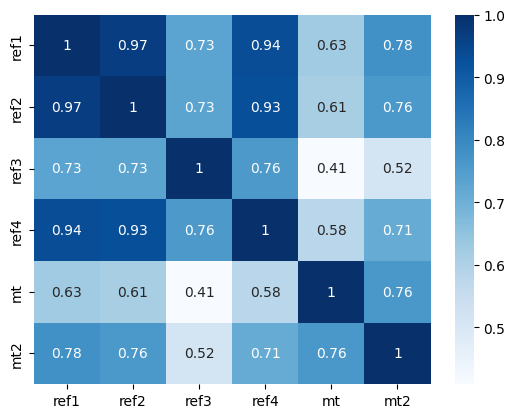

SL_950
src
19589480415784.91
6695745864435.366
ref1
790390785456.5964
2976649374.6871147
ref2
827658178792.4619
6322667809.809858
ref3
1044748952224.8513
5410164243.031971
ref4
600833267758.8942
2741653856.0131855
mt
1274909577387.4683
7083322480.7566185
mt2
2032863408037.867
5490833020.317367
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.967285     0.721183     0.933715   0.627390   
ref2_SL_950     0.967285     1.000000     0.716757     0.926834   0.612749   
ref3_SL_950     0.721183     0.716757     1.000000     0.745709   0.397891   
ref4_SL_950     0.933715     0.926834     0.745709     1.000000   0.576413   
mt_SL_950       0.627390     0.612749     0.397891     0.576413   1.000000   
mt2_SL_950      0.773973     0.753589     0.498109     0.703955   0.772151   

             mt2_SL_950  
ref1_SL_950    0.773973  
ref2_SL_950    0.753589  
ref3_SL_950    0.498109  
ref4_SL_950    0.703955  
mt_SL_950      0.772151  
mt

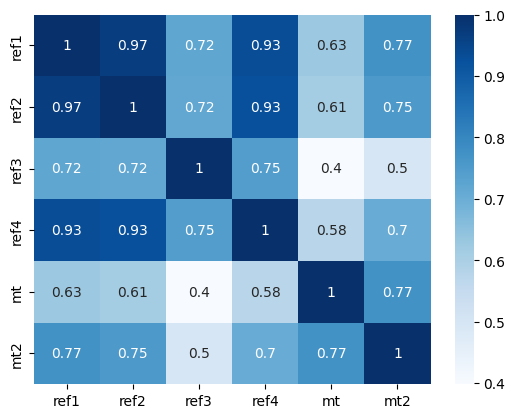

SL_975
src
50173418288827.71
15873783084476.455
ref1
1949670410635.563
5792780127.293659
ref2
2034315138272.5273
12333857119.722956
ref3
2606105058645.7046
10543230025.918903
ref4
1472076784337.259
5282908165.329968
mt
3161585457978.815
13686178440.71006
mt2
5156395559836.361
10668491375.667665
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.968009     0.707799     0.931957   0.627425   
ref2_SL_975     0.968009     1.000000     0.702937     0.924253   0.611739   
ref3_SL_975     0.707799     0.702937     1.000000     0.732698   0.386436   
ref4_SL_975     0.931957     0.924253     0.732698     1.000000   0.573979   
mt_SL_975       0.627425     0.611739     0.386436     0.573979   1.000000   
mt2_SL_975      0.768232     0.746548     0.479915     0.695592   0.780190   

             mt2_SL_975  
ref1_SL_975    0.768232  
ref2_SL_975    0.746548  
ref3_SL_975    0.479915  
ref4_SL_975    0.695592  
mt_SL_975      0.780190  
m

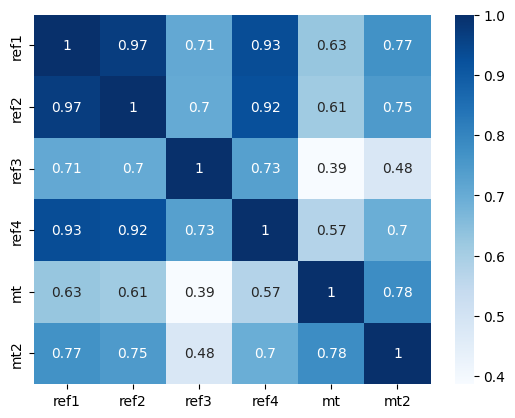

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.4263167463181811
0.42981366852355685
ref2
0.4282771845931903
0.4340280725235805
ref3
0.42057548024329816
0.4210144229149275
ref4
0.4354448348407493
0.4385975019548235
mt
0.4205312089038751
0.42078320116168433
mt2
0.4262787277637764
0.42856304574000914
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.757780   0.777497   0.821276  0.746328  0.702841
ref2_gini   0.757780   1.000000   0.794842   0.755342  0.731848  0.765194
ref3_gini   0.777497   0.794842   1.000000   0.751107  0.731640  0.688385
ref4_gini   0.821276   0.755342   0.751107   1.000000  0.728680  0.730408
mt_gini     0.746328   0.731848   0.731640   0.728680  1.000000  0.841643
mt2_gini    0.702841   0.765194   0.688385   0.730408  0.841643  1.000000


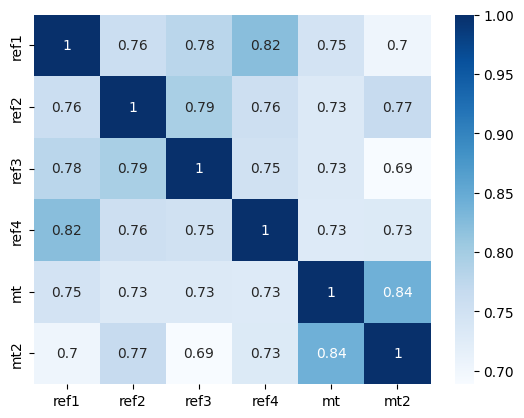

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.557465176514919
-4.654422630258653
ref2
-4.526742395992492
-4.641382842683896
ref3
-4.507379706627377
-4.596616535117514
ref4
-4.566001856823871
-4.687130935213706
mt
-4.495972885563489
-4.568748046828788
mt2
-4.51568581209284
-4.575947420269833
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.972217  0.964208  0.971332  0.944308  0.936346
ref2_kl  0.972217  1.000000  0.976889  0.979656  0.953936  0.948130
ref3_kl  0.964208  0.976889  1.000000  0.969290  0.948651  0.940700
ref4_kl  0.971332  0.979656  0.969290  1.000000  0.950885  0.944027
mt_kl    0.944308  0.953936  0.948651  0.950885  1.000000  0.985407
mt2_kl   0.936346  0.948130  0.940700  0.944027  0.985407  1.000000


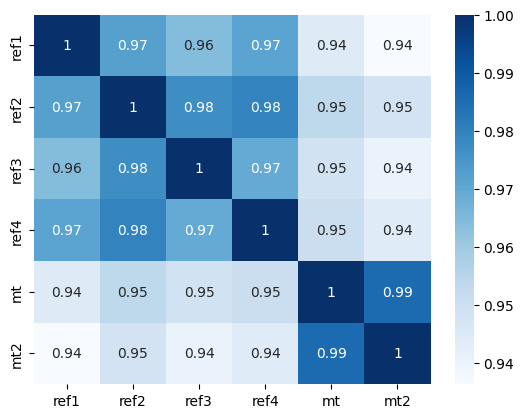

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.8016596901204844
0.7908584003897275
ref2
0.807055087177093
0.7983716896765594
ref3
0.7885924292481913
0.7760799662496773
ref4
0.8210082214666908
0.8117214652419279
mt
0.7881968531505654
0.7779398317886337
mt2
0.8039336799156147
0.792633375988885
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.767295  0.788509  0.835408  0.758132  0.715194
ref2_cv  0.767295  1.000000  0.804514  0.781211  0.751417  0.744596
ref3_cv  0.788509  0.804514  1.000000  0.771342  0.744069  0.693788
ref4_cv  0.835408  0.781211  0.771342  1.000000  0.751647  0.752232
mt_cv    0.758132  0.751417  0.744069  0.751647  1.000000  0.793569
mt2_cv   0.715194  0.744596  0.693788  0.752232  0.793569  1.000000


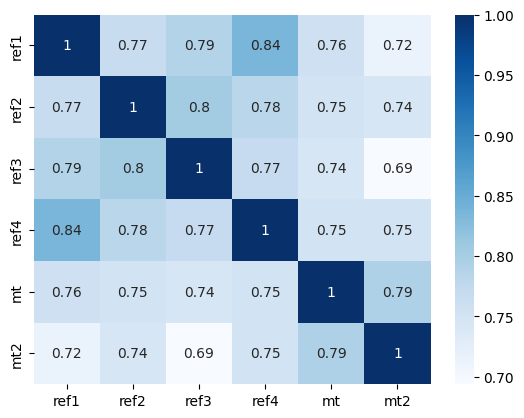

lv
src
72.35425230811832
69.03561950442358
ref1
24.592240838844766
21.34193019945911
ref2
27.261277831886872
23.64804105842043
ref3
27.304996150597873
24.377202046857402
ref4
24.484359581506872
21.609077534198
mt
28.423390879193647
24.37644376072734
mt2
30.701034133213
27.31610406169696
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.709942  0.703434  0.771563  0.591998  0.587633
ref2_lv  0.709942  1.000000  0.698993  0.742581  0.622970  0.622325
ref3_lv  0.703434  0.698993  1.000000  0.684540  0.540888  0.537788
ref4_lv  0.771563  0.742581  0.684540  1.000000  0.562567  0.650128
mt_lv    0.591998  0.622970  0.540888  0.562567  1.000000  0.650511
mt2_lv   0.587633  0.622325  0.537788  0.650128  0.650511  1.000000


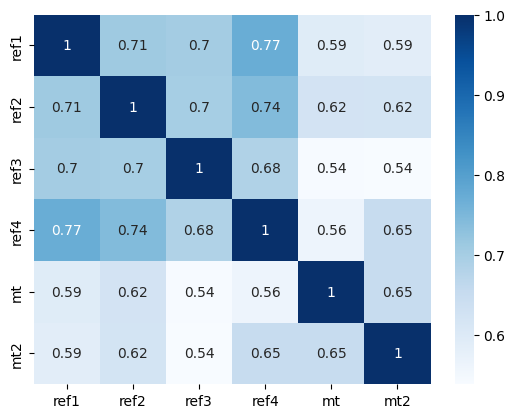

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-409.8770726153816
-374.54975225562504
ref2
-451.8542211374495
-399.5435024598218
ref3
-445.7914530682684
-398.17409426042144
ref4
-403.3468499626683
-352.69565873158103
mt
-468.74096640586475
-427.65443498010677
mt2
-460.96570424167794
-422.12435043453956
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.949539    0.950438    0.969226  0.915599   
ref2_renyi    0.949539    1.000000    0.945741    0.947125  0.924881   
ref3_renyi    0.950438    0.945741    1.000000    0.947656  0.907733   
ref4_renyi    0.969226    0.947125    0.947656    1.000000  0.908857   
mt_renyi      0.915599    0.924881    0.907733    0.908857  1.000000   
mt2_renyi     0.938943    0.925391    0.931125    0.936932  0.943357   

            mt2_renyi  
ref1_renyi   0.938943  
ref2_renyi   0.925391  
ref3_renyi   0.931125  
ref4_renyi   0.936932  
mt_renyi     0.943357  
mt2_renyi    1.000000  


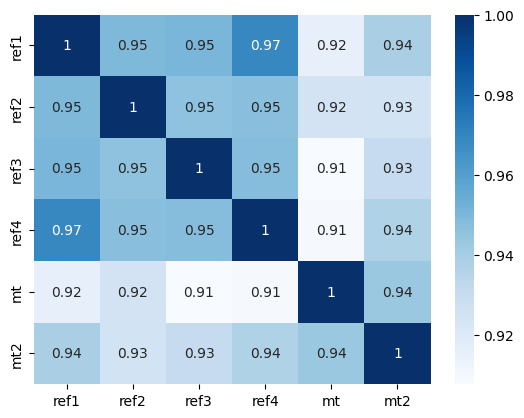

41.78302361451637
13.407119221049626
15.685217085753798
15.414055525544425
13.186438783937298
17.251918231432917


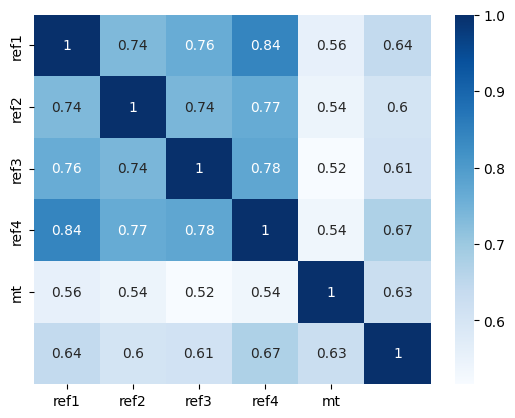

*************************************
13.380747266599544
13.380747266599544
15.714298732551883
15.478025302888875
13.186742317371264
17.497383382792204
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že s

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


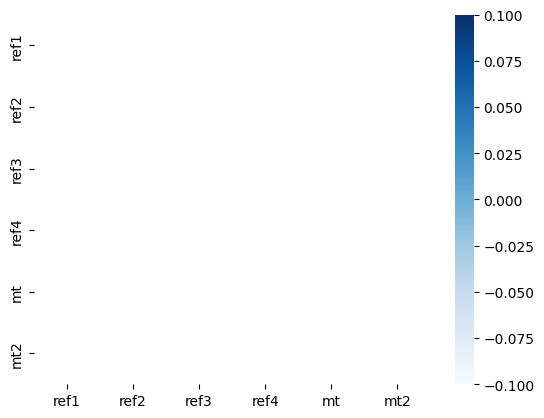

L
src
10.359164788583737
10.123614579255745
ref1
7.077058234851334
6.983306599624928
ref2
7.714582863850799
7.612652857690501
ref3
7.799193937037912
7.572531484274401
ref4
6.8962239692972265
6.762419542674149
mt
7.69086457409261
7.476903698618777
mt2
7.478194149550895
7.276083682601446
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.775119  0.732106  0.868323  0.794539  0.784313
ref2_L  0.775119  1.000000  0.692011  0.798536  0.790960  0.704058
ref3_L  0.732106  0.692011  1.000000  0.722027  0.713833  0.742986
ref4_L  0.868323  0.798536  0.722027  1.000000  0.736139  0.751859
mt_L    0.794539  0.790960  0.713833  0.736139  1.000000  0.811071
mt2_L   0.784313  0.704058  0.742986  0.751859  0.811071  1.000000


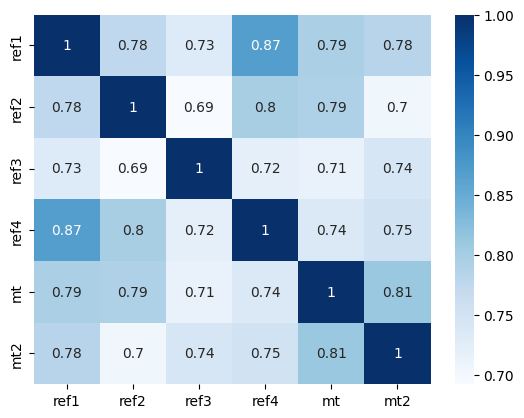

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.5271175779593327
1.5274844385793045
ref2
1.5642347677668678
1.5610376626983995
ref3
1.5719857473419372
1.562109560842491
ref4
1.5134923236025974
1.5092680979078628
mt
1.561932711439299
1.5554693078666806
mt2
1.5508475054785296
1.5522454422078256
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.769613    0.737690    0.848974  0.805081   
ref2_SL_25    0.769613    1.000000    0.720422    0.780617  0.749047   
ref3_SL_25    0.737690    0.720422    1.000000    0.744225  0.761119   
ref4_SL_25    0.848974    0.780617    0.744225    1.000000  0.770662   
mt_SL_25      0.805081    0.749047    0.761119    0.770662  1.000000   
mt2_SL_25     0.747365    0.706392    0.767537    0.728336  0.836998   

            mt2_SL_25  
ref1_SL_25   0.747365  
ref2_SL_25   0.706392  
ref3_SL_25   0.767537  
ref4_SL_25   0.728336  
mt_SL_25     0.836998  
mt2_SL_25    1.000000  


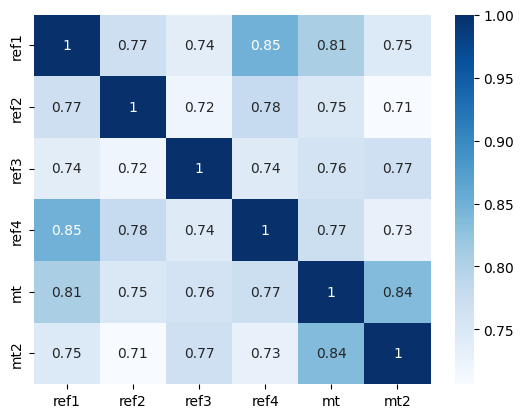

SL_50
src
3.0671973011635125
3.032966843199389
ref1
2.4592390392033807
2.4606042955490697
ref2
2.5739105777842286
2.569231527007501
ref3
2.5960245081057316
2.5575137170228426
ref4
2.4211685794955455
2.400466310875178
mt
2.5684851508939386
2.541627394681286
mt2
2.5328428338116726
2.5146714372666574
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.780251    0.734088    0.853935  0.804663   
ref2_SL_50    0.780251    1.000000    0.713573    0.795684  0.763434   
ref3_SL_50    0.734088    0.713573    1.000000    0.737346  0.742644   
ref4_SL_50    0.853935    0.795684    0.737346    1.000000  0.757467   
mt_SL_50      0.804663    0.763434    0.742644    0.757467  1.000000   
mt2_SL_50     0.759000    0.712689    0.763654    0.732838  0.832549   

            mt2_SL_50  
ref1_SL_50   0.759000  
ref2_SL_50   0.712689  
ref3_SL_50   0.763654  
ref4_SL_50   0.732838  
mt_SL_50     0.832549  
mt2_SL_50    1.000000  


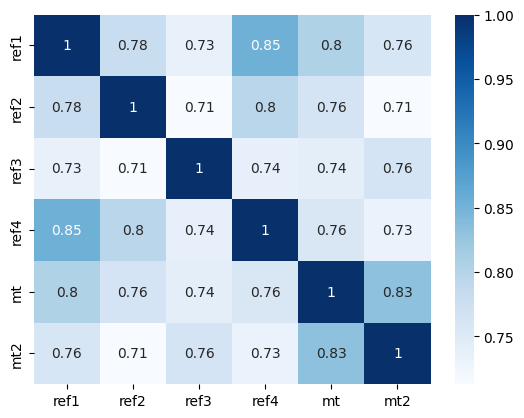

SL_75
src
5.5762344444241885
5.474223342002128
ref1
4.110232045966565
4.087760980924504
ref2
4.391138203925353
4.376199731721078
ref3
4.437695302559434
4.332311203190599
ref4
4.024584978709494
3.964959474048854
mt
4.3798779546741216
4.304077015781328
mt2
4.289391089654724
4.215850904554786
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.780930    0.732062    0.861276  0.801214   
ref2_SL_75    0.780930    1.000000    0.703572    0.800902  0.777477   
ref3_SL_75    0.732062    0.703572    1.000000    0.730032  0.726952   
ref4_SL_75    0.861276    0.800902    0.730032    1.000000  0.746840   
mt_SL_75      0.801214    0.777477    0.726952    0.746840  1.000000   
mt2_SL_75     0.771837    0.710135    0.754156    0.741718  0.823676   

            mt2_SL_75  
ref1_SL_75   0.771837  
ref2_SL_75   0.710135  
ref3_SL_75   0.754156  
ref4_SL_75   0.741718  
mt_SL_75     0.823676  
mt2_SL_75    1.000000  


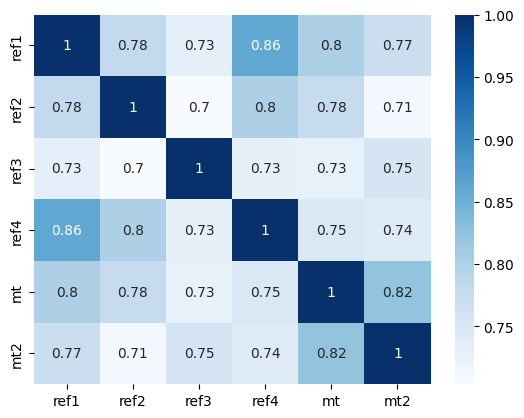

SL_100
src
10.359164788583737
10.123614579255745
ref1
7.077058234851334
6.983306599624928
ref2
7.714582863850799
7.612652857690501
ref3
7.799193937037912
7.572531484274401
ref4
6.8962239692972265
6.762419542674149
mt
7.69086457409261
7.476903698618777
mt2
7.478194149550895
7.276083682601446
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.775119     0.732106     0.868323   0.794539   
ref2_SL_100     0.775119     1.000000     0.692011     0.798536   0.790960   
ref3_SL_100     0.732106     0.692011     1.000000     0.722027   0.713833   
ref4_SL_100     0.868323     0.798536     0.722027     1.000000   0.736139   
mt_SL_100       0.794539     0.790960     0.713833     0.736139   1.000000   
mt2_SL_100      0.784313     0.704058     0.742986     0.751859   0.811071   

             mt2_SL_100  
ref1_SL_100    0.784313  
ref2_SL_100    0.704058  
ref3_SL_100    0.742986  
ref4_SL_100    0.751859  
mt_SL_100      0.811071  
mt2_S

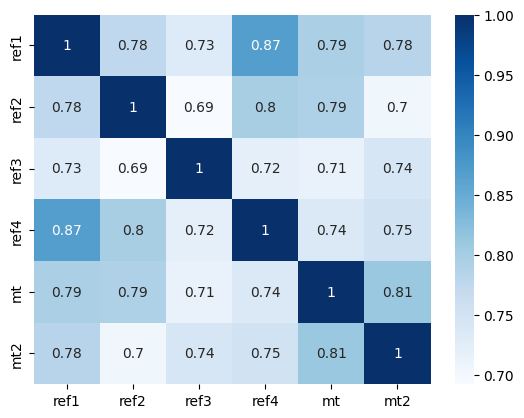

SL_125
src
19.634351008953868
18.984081758810827
ref1
12.503895997132629
12.148435605156676
ref2
13.906556847492832
13.504831976488397
ref3
14.04114924211423
13.520188135607167
ref4
12.12911305715902
11.735520048355243
mt
13.853536250428096
13.31669669431988
mt2
13.368645407859264
12.857400391569534
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.763987     0.733506     0.873037   0.784451   
ref2_SL_125     0.763987     1.000000     0.680301     0.790102   0.803348   
ref3_SL_125     0.733506     0.680301     1.000000     0.713061   0.702385   
ref4_SL_125     0.873037     0.790102     0.713061     1.000000   0.723640   
mt_SL_125       0.784451     0.803348     0.702385     0.723640   1.000000   
mt2_SL_125      0.794517     0.696941     0.730791     0.761670   0.795220   

             mt2_SL_125  
ref1_SL_125    0.794517  
ref2_SL_125    0.696941  
ref3_SL_125    0.730791  
ref4_SL_125    0.761670  
mt_SL_125      0.79522

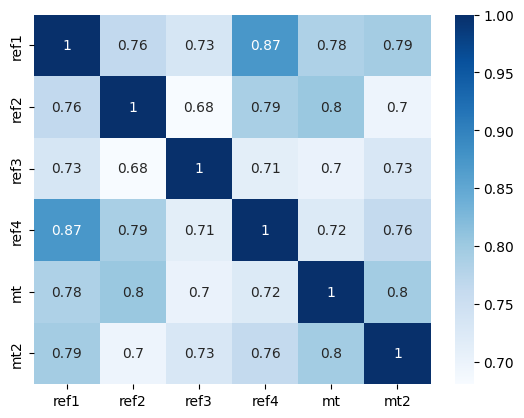

SL_150
src
37.92546190950008
36.245652911575796
ref1
22.617826313758517
21.76208560906272
ref2
25.666110838349528
24.558224781069605
ref3
25.83830105442268
24.662843470986374
ref4
21.840328177365034
21.03795883461314
mt
25.53921212847735
24.336066218038845
mt2
24.446982426784068
23.090583681745947
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.748414     0.735228     0.873922   0.770851   
ref2_SL_150     0.748414     1.000000     0.669710     0.777272   0.814103   
ref3_SL_150     0.735228     0.669710     1.000000     0.703561   0.692000   
ref4_SL_150     0.873922     0.777272     0.703561     1.000000   0.708864   
mt_SL_150       0.770851     0.814103     0.692000     0.708864   1.000000   
mt2_SL_150      0.800790     0.690252     0.717885     0.770502   0.776906   

             mt2_SL_150  
ref1_SL_150    0.800790  
ref2_SL_150    0.690252  
ref3_SL_150    0.717885  
ref4_SL_150    0.770502  
mt_SL_150      0.776906 

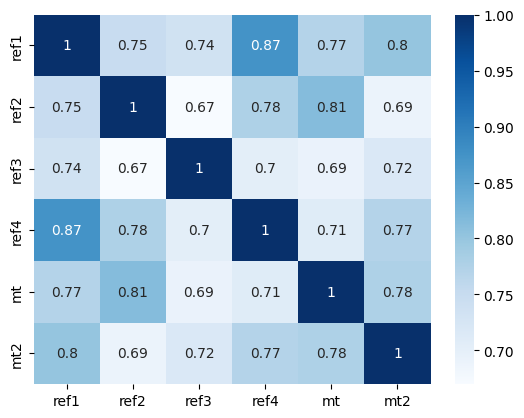

SL_175
src
74.59367553068095
71.2767390568266
ref1
41.828926093253884
39.36971922668012
ref2
48.43153381230065
46.167227804328476
ref3
48.5306877913815
45.66453936681421
ref4
40.197298638853965
37.95487684581683
mt
48.11077678527639
44.51448205256439
mt2
45.66176463828782
41.98616900926105
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.729551     0.736160     0.870093   0.753898   
ref2_SL_175     0.729551     1.000000     0.661310     0.762087   0.822823   
ref3_SL_175     0.736160     0.661310     1.000000     0.694441   0.682404   
ref4_SL_175     0.870093     0.762087     0.694441     1.000000   0.692388   
mt_SL_175       0.753898     0.822823     0.682404     0.692388   1.000000   
mt2_SL_175      0.801910     0.684904     0.704804     0.778060   0.757159   

             mt2_SL_175  
ref1_SL_175    0.801910  
ref2_SL_175    0.684904  
ref3_SL_175    0.704804  
ref4_SL_175    0.778060  
mt_SL_175      0.757159  
mt2_SL

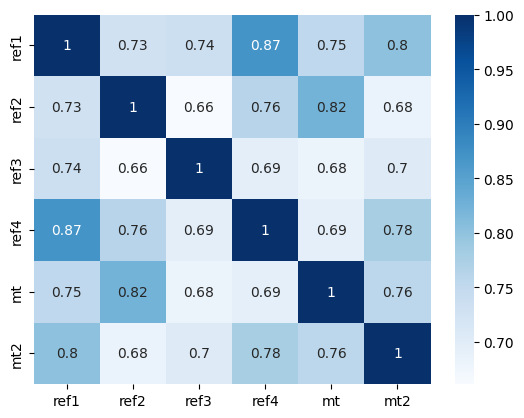

SL_200
src
149.29007454484417
140.79844066957907
ref1
79.02663088045877
73.58247282298734
ref2
93.34530941678153
88.05470361426202
ref3
92.94671406446729
86.79078578915426
ref4
75.54107730624156
69.14685904776758
mt
92.50692982021015
86.02179414813699
mt2
87.02552670861145
78.25183468263741
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.708823     0.735302     0.861367   0.734093   
ref2_SL_200     0.708823     1.000000     0.655908     0.746834   0.829330   
ref3_SL_200     0.735302     0.655908     1.000000     0.686804   0.673562   
ref4_SL_200     0.861367     0.746834     0.686804     1.000000   0.675504   
mt_SL_200       0.734093     0.829330     0.673562     0.675504   1.000000   
mt2_SL_200      0.797257     0.681414     0.692278     0.784206   0.737090   

             mt2_SL_200  
ref1_SL_200    0.797257  
ref2_SL_200    0.681414  
ref3_SL_200    0.692278  
ref4_SL_200    0.784206  
mt_SL_200      0.737090  
mt2_S

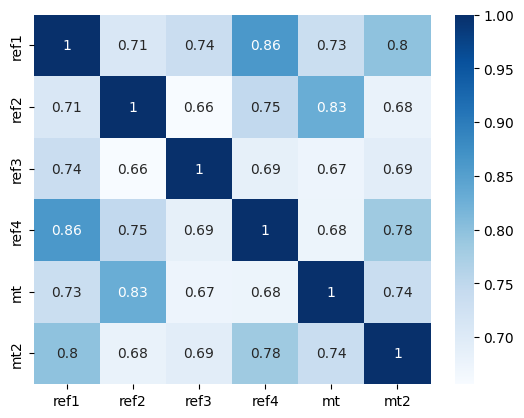

SL_225
src
303.8405857924159
280.9173422693609
ref1
152.45496485709475
136.98567081589206
ref2
183.61174898573154
173.26329005517044
ref3
181.38357207830526
169.58291322479067
ref4
144.84741205383176
127.3284096631316
mt
181.3856565677651
167.01726203668707
mt2
169.13239814485615
146.9633224121409
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.687695     0.731944     0.848222   0.712264   
ref2_SL_225     0.687695     1.000000     0.653999     0.733732   0.833707   
ref3_SL_225     0.731944     0.653999     1.000000     0.681665   0.665581   
ref4_SL_225     0.848222     0.733732     0.681665     1.000000   0.659801   
mt_SL_225       0.712264     0.833707     0.665581     0.659801   1.000000   
mt2_SL_225      0.786903     0.680022     0.681067     0.788961   0.717745   

             mt2_SL_225  
ref1_SL_225    0.786903  
ref2_SL_225    0.680022  
ref3_SL_225    0.681067  
ref4_SL_225    0.788961  
mt_SL_225      0.717745 

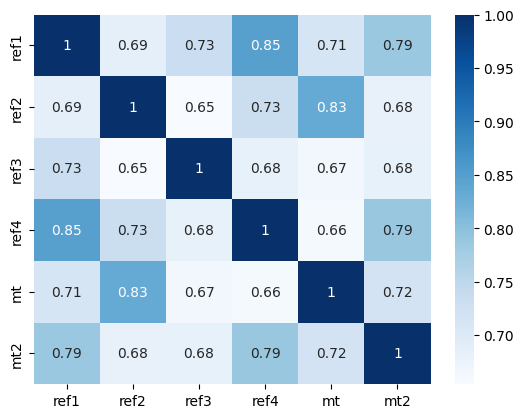

SL_250
src
628.4544909090951
577.7790438817206
ref1
300.2384501068339
258.679760632056
ref2
368.3140680740511
344.9351686070378
ref3
360.4473796744014
330.1003498192466
ref4
283.2442172209824
242.72162269538987
mt
362.3768680759488
321.1867382549393
mt2
335.03570085195463
282.2104068967163
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.667412     0.725761     0.831574   0.689432   
ref2_SL_250     0.667412     1.000000     0.655733     0.724563   0.836250   
ref3_SL_250     0.725761     0.655733     1.000000     0.679729   0.658618   
ref4_SL_250     0.831574     0.724563     0.679729     1.000000   0.646766   
mt_SL_250       0.689432     0.836250     0.658618     0.646766   1.000000   
mt2_SL_250      0.771556     0.680775     0.671779     0.792513   0.700012   

             mt2_SL_250  
ref1_SL_250    0.771556  
ref2_SL_250    0.680775  
ref3_SL_250    0.671779  
ref4_SL_250    0.792513  
mt_SL_250      0.700012  
mt2_SL

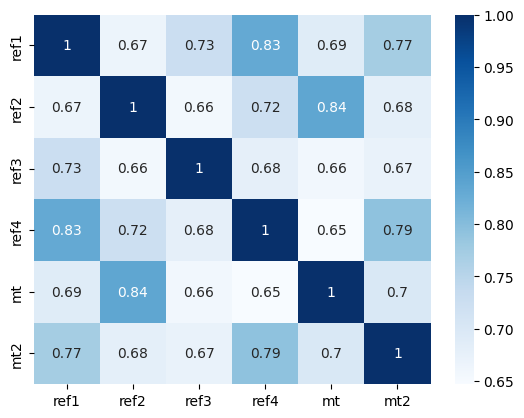

SL_275
src
1320.1522165503627
1219.778984730092
ref1
603.4863590395357
500.9123872385744
ref2
752.8237396257055
683.8437901878635
ref3
728.9782126955923
642.5342236629247
ref4
564.6225093874286
460.3173290128573
mt
737.0118211619877
658.5514780671174
mt2
676.1881752511828
536.1180242244167
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.648824     0.716785     0.812497   0.666627   
ref2_SL_275     0.648824     1.000000     0.660929     0.720427   0.837381   
ref3_SL_275     0.716785     0.660929     1.000000     0.681250   0.652809   
ref4_SL_275     0.812497     0.720427     0.681250     1.000000   0.637507   
mt_SL_275       0.666627     0.837381     0.652809     0.637507   1.000000   
mt2_SL_275      0.752349     0.683606     0.664739     0.795178   0.684567   

             mt2_SL_275  
ref1_SL_275    0.752349  
ref2_SL_275    0.683606  
ref3_SL_275    0.664739  
ref4_SL_275    0.795178  
mt_SL_275      0.684567  
mt2_SL

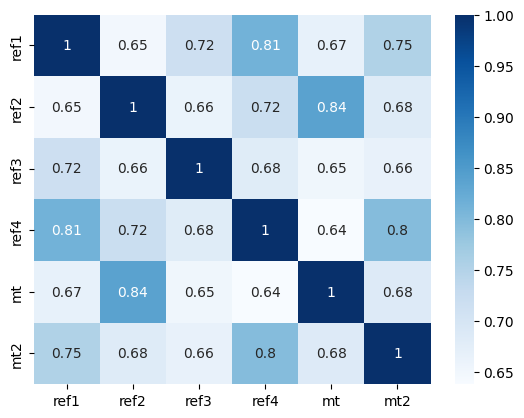

SL_300
src
2814.3535145845594
2540.753413906092
ref1
1237.824611521051
987.1381119958136
ref2
1566.514355289313
1378.4789189806324
ref3
1499.5296843572178
1291.6076946804537
ref4
1146.9215066185423
877.8752114280255
mt
1524.5711446868604
1319.0055412835154
mt2
1389.8832412106756
1063.1312572507431
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.632336     0.705303     0.791968   0.644716   
ref2_SL_300     0.632336     1.000000     0.669129     0.721679   0.837552   
ref3_SL_300     0.705303     0.669129     1.000000     0.686009   0.648217   
ref4_SL_300     0.791968     0.721679     0.686009     1.000000   0.632633   
mt_SL_300       0.644716     0.837552     0.648217     0.632633   1.000000   
mt2_SL_300      0.730576     0.688370     0.659937     0.797343   0.671872   

             mt2_SL_300  
ref1_SL_300    0.730576  
ref2_SL_300    0.688370  
ref3_SL_300    0.659937  
ref4_SL_300    0.797343  
mt_SL_300      0.671872 

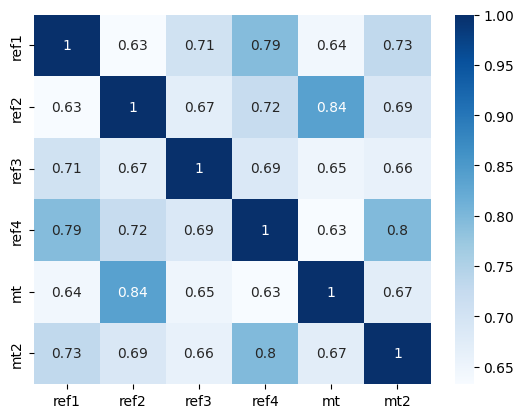

SL_325
src
6084.052939199673
5462.138856697426
ref1
2590.113325305665
1948.6563508845302
ref2
3315.1800880787837
2785.7592042010965
ref3
3135.2965782002484
2606.8388160212376
ref4
2373.016516420242
1764.7036043754615
mt
3204.4309753230646
2736.5420809454195
mt2
2908.131739824494
2062.8983329581824
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.617970     0.691711     0.770739   0.624306   
ref2_SL_325     0.617970     1.000000     0.679677     0.728027   0.837180   
ref3_SL_325     0.691711     0.679677     1.000000     0.693390   0.644811   
ref4_SL_325     0.770739     0.728027     0.693390     1.000000   0.632279   
mt_SL_325       0.624306     0.837180     0.644811     0.632279   1.000000   
mt2_SL_325      0.707439     0.694871     0.657060     0.799387   0.662193   

             mt2_SL_325  
ref1_SL_325    0.707439  
ref2_SL_325    0.694871  
ref3_SL_325    0.657060  
ref4_SL_325    0.799387  
mt_SL_325      0.662193 

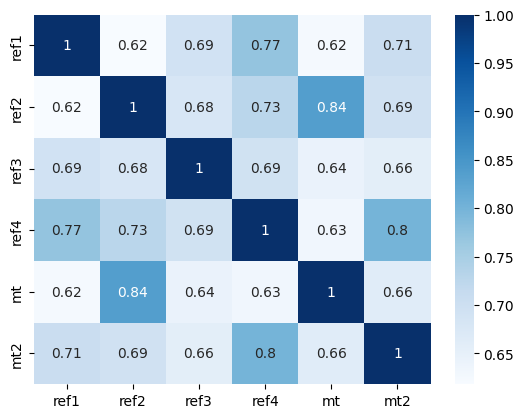

SL_350
src
13326.018221127724
11692.845168165546
ref1
5526.7015783708475
3955.413295287829
ref2
7127.542224352137
5661.07991848703
ref3
6658.417377071876
5294.97066986625
ref4
4998.470217493858
3440.503059717641
mt
6836.368757553687
5585.5731272412095
mt2
6190.4090131059065
4124.785583190247
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.605479     0.676416     0.749310   0.605717   
ref2_SL_350     0.605479     1.000000     0.691801     0.738713   0.836610   
ref3_SL_350     0.676416     0.691801     1.000000     0.702520   0.642471   
ref4_SL_350     0.749310     0.738713     0.702520     1.000000   0.636207   
mt_SL_350       0.605717     0.836610     0.642471     0.636207   1.000000   
mt2_SL_350      0.683907     0.702859     0.655574     0.801636   0.655639   

             mt2_SL_350  
ref1_SL_350    0.683907  
ref2_SL_350    0.702859  
ref3_SL_350    0.655574  
ref4_SL_350    0.801636  
mt_SL_350      0.655639  
mt2_

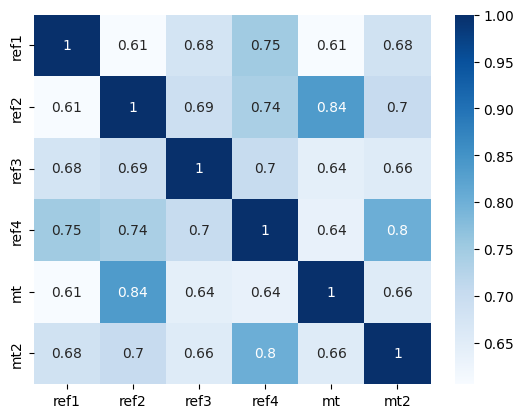

SL_375
src
29547.541988410783
25794.64486383465
ref1
12018.52689665975
7997.181954284373
ref2
15550.211072142198
11976.324804953445
ref3
14351.256633351672
10605.787924264148
ref4
10712.139830930506
7053.517613922464
mt
14787.429435849968
11383.422491768364
mt2
13396.367189846036
8184.069732526836
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.594469     0.659770     0.727978   0.589021   
ref2_SL_375     0.594469     1.000000     0.704700     0.752720   0.836104   
ref3_SL_375     0.659770     0.704700     1.000000     0.712433   0.640999   
ref4_SL_375     0.727978     0.752720     0.712433     1.000000   0.643935   
mt_SL_375       0.589021     0.836104     0.640999     0.643935   1.000000   
mt2_SL_375      0.660659     0.712048     0.654834     0.804326   0.652194   

             mt2_SL_375  
ref1_SL_375    0.660659  
ref2_SL_375    0.712048  
ref3_SL_375    0.654834  
ref4_SL_375    0.804326  
mt_SL_375      0.652194 

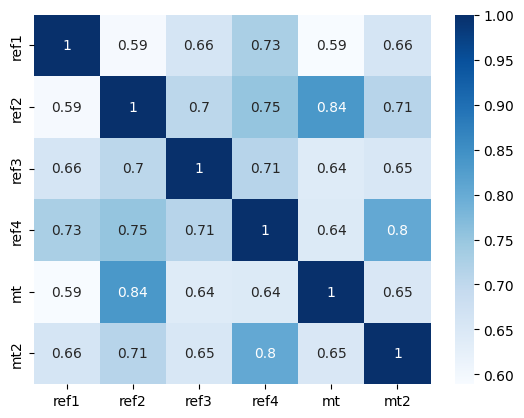

SL_400
src
66263.42583599311
56824.85462524026
ref1
26616.673965372713
16357.103635736017
ref2
34386.8390594387
24943.088600846786
ref3
31366.867070162258
22036.98461290049
ref4
23340.279015953336
13763.397212623673
mt
32394.14866765054
23323.192018425972
mt2
29448.377517713423
16428.918220652202
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.584496     0.642063     0.706895   0.574104   
ref2_SL_400     0.584496     1.000000     0.717616     0.768948   0.835847   
ref3_SL_400     0.642063     0.717616     1.000000     0.722202   0.640148   
ref4_SL_400     0.706895     0.768948     0.722202     1.000000   0.654851   
mt_SL_400       0.574104     0.835847     0.640148     0.654851   1.000000   
mt2_SL_400      0.638101     0.722118     0.654185     0.807597   0.651751   

             mt2_SL_400  
ref1_SL_400    0.638101  
ref2_SL_400    0.722118  
ref3_SL_400    0.654185  
ref4_SL_400    0.807597  
mt_SL_400      0.651751  

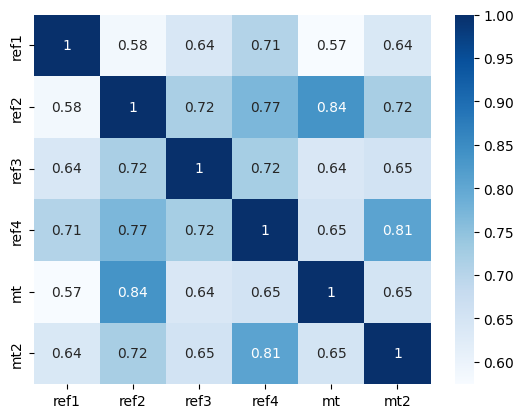

SL_425
src
150170.28195142408
126458.59758375768
ref1
59977.48114962683
33063.08643288787
ref2
76985.90347380271
51456.426088401815
ref3
69460.41066236515
46799.73207558886
ref4
51662.27109350498
28161.39023577798
mt
71790.5573491644
48016.65020045565
mt2
65697.18686310167
33429.76565360591
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.575133     0.623529     0.686132   0.560730   
ref2_SL_425     0.575133     1.000000     0.729884     0.786350   0.835952   
ref3_SL_425     0.623529     0.729884     1.000000     0.731044   0.639644   
ref4_SL_425     0.686132     0.786350     0.731044     1.000000   0.668305   
mt_SL_425       0.560730     0.835952     0.639644     0.668305   1.000000   
mt2_SL_425      0.616423     0.732735     0.653034     0.811498   0.654134   

             mt2_SL_425  
ref1_SL_425    0.616423  
ref2_SL_425    0.732735  
ref3_SL_425    0.653034  
ref4_SL_425    0.811498  
mt_SL_425      0.654134  
mt2_S

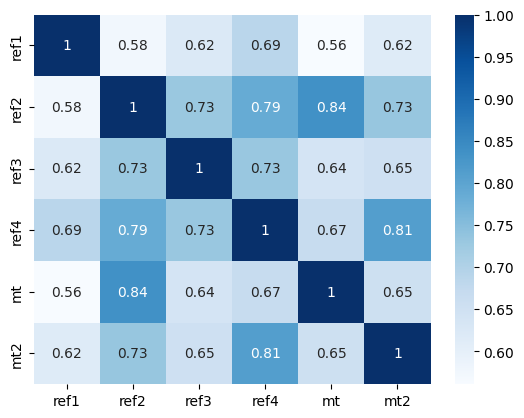

SL_450
src
343632.9097266221
283095.18838540884
ref1
137377.77788467304
67533.3743041344
ref2
174308.37676988204
108550.87568344014
ref3
155706.9010216809
100302.7263971846
ref4
116062.87512912179
57633.723759565764
mt
160780.4853256131
101399.92767259604
mt2
148600.59419808903
69020.56793871237
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.566017     0.604360     0.665719   0.548606   
ref2_SL_450     0.566017     1.000000     0.740967     0.804012   0.836474   
ref3_SL_450     0.604360     0.740967     1.000000     0.738364   0.639208   
ref4_SL_450     0.665719     0.804012     0.738364     1.000000   0.683662   
mt_SL_450       0.548606     0.836474     0.639208     0.683662   1.000000   
mt2_SL_450      0.595666     0.743568     0.650899     0.816002   0.659113   

             mt2_SL_450  
ref1_SL_450    0.595666  
ref2_SL_450    0.743568  
ref3_SL_450    0.650899  
ref4_SL_450    0.816002  
mt_SL_450      0.659113  


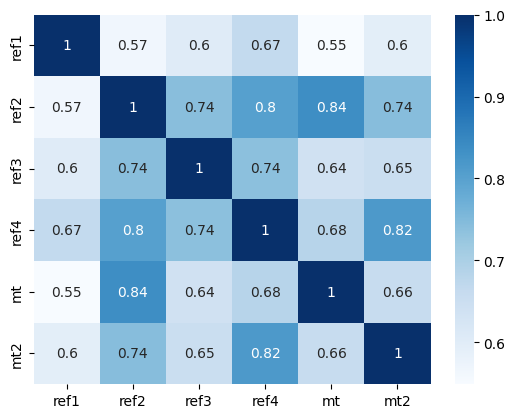

SL_475
src
793365.4482151263
640119.8046014623
ref1
319494.4469167237
142456.3807418932
ref2
398722.11474493844
233627.4893735203
ref3
353026.83772681205
212692.18797891255
ref4
264398.4750813087
118877.47011121835
mt
363521.97133287
212635.3088852846
mt2
340444.8310634737
141741.75650915195
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.556860     0.584724     0.645664   0.537416   
ref2_SL_475     0.556860     1.000000     0.750469     0.821200   0.837421   
ref3_SL_475     0.584724     0.750469     1.000000     0.743771   0.638572   
ref4_SL_475     0.645664     0.821200     0.743771     1.000000   0.700338   
mt_SL_475       0.537416     0.837421     0.638572     0.700338   1.000000   
mt2_SL_475      0.575776     0.754306     0.647427     0.821028   0.666420   

             mt2_SL_475  
ref1_SL_475    0.575776  
ref2_SL_475    0.754306  
ref3_SL_475    0.647427  
ref4_SL_475    0.821028  
mt_SL_475      0.666420  
mt2_

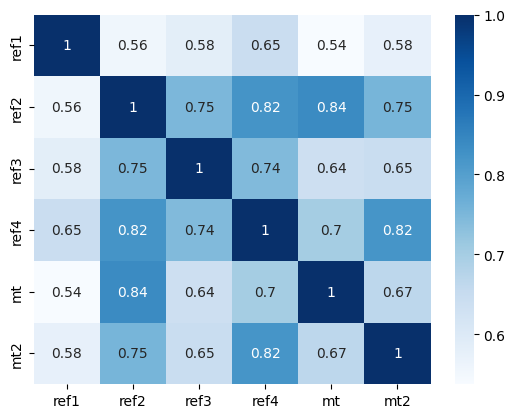

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
753585.5789235145
295694.2630525986
ref2
920582.1363774649
506601.3111565029
ref3
808863.4437828885
455471.8195439104
ref4
610174.0198131227
246630.59545979198
mt
829009.4769007846
446303.41670893773
mt2
789204.2658081537
291402.1247745423
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.547455     0.564771     0.625972   0.526861   
ref2_SL_500     0.547455     1.000000     0.758131     0.837370   0.838761   
ref3_SL_500     0.564771     0.758131     1.000000     0.747057   0.637491   
ref4_SL_500     0.625972     0.837370     0.747057     1.000000   0.717812   
mt_SL_500       0.526861     0.838761     0.637491     0.717812   1.000000   
mt2_SL_500      0.556657     0.764674     0.642395     0.826458   0.675755   

             mt2_SL_500  
ref1_SL_500    0.556657  
ref2_SL_500    0.764674  
ref3_SL_500    0.642395  
ref4_SL_500    0.826458  
mt_SL_500      0.675755  
mt2

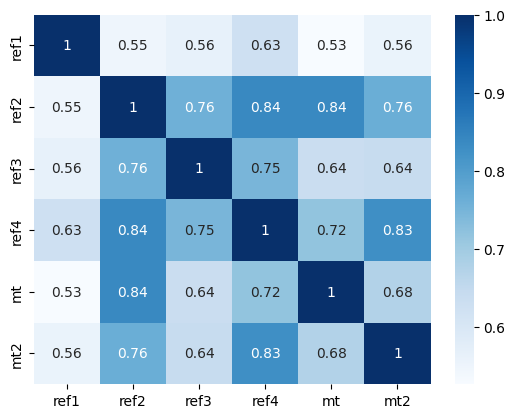

SL_525
src
4331606.646061756
3141367.4417431457
ref1
1800622.2789272123
608014.5108608942
ref2
2143537.8300256445
1110664.6855673362
ref3
1871403.1674514676
962333.9696990838
ref4
1425152.2476012143
516300.0976227947
mt
1905274.8767955971
942712.750179225
mt2
1849370.4120990946
603320.5962877665
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.537668     0.544639     0.606642   0.516667   
ref2_SL_525     0.537668     1.000000     0.763819     0.852154   0.840435   
ref3_SL_525     0.544639     0.763819     1.000000     0.748163   0.635753   
ref4_SL_525     0.606642     0.852154     0.748163     1.000000   0.735634   
mt_SL_525       0.516667     0.840435     0.635753     0.735634   1.000000   
mt2_SL_525      0.538193     0.774442     0.635695     0.832156   0.686801   

             mt2_SL_525  
ref1_SL_525    0.538193  
ref2_SL_525    0.774442  
ref3_SL_525    0.635695  
ref4_SL_525    0.832156  
mt_SL_525      0.686801  


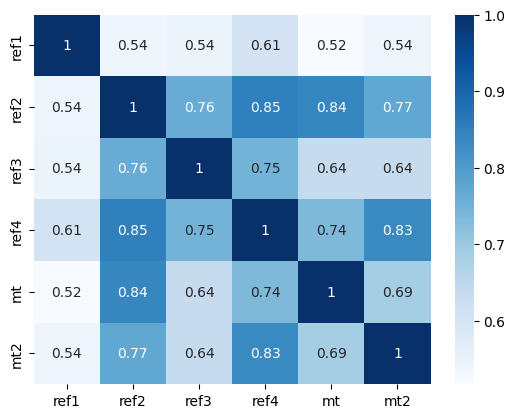

SL_550
src
10231354.187866237
7329958.645473514
ref1
4353507.6461041495
1264885.8636431014
ref2
5029832.746447232
2446333.1284182575
ref3
4368812.991955742
2096092.417361793
ref4
3365690.0578302816
1069421.9091459988
mt
4409624.109673603
2035932.6390080247
mt2
4376686.160274213
1253064.7599636256
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.527428     0.524454     0.587675   0.506606   
ref2_SL_550     0.527428     1.000000     0.767502     0.865335   0.842360   
ref3_SL_550     0.524454     0.767502     1.000000     0.747143   0.633182   
ref4_SL_550     0.587675     0.865335     0.747143     1.000000   0.753420   
mt_SL_550       0.506606     0.842360     0.633182     0.753420   1.000000   
mt2_SL_550      0.520279     0.783430     0.627314     0.837988   0.699230   

             mt2_SL_550  
ref1_SL_550    0.520279  
ref2_SL_550    0.783430  
ref3_SL_550    0.627314  
ref4_SL_550    0.837988  
mt_SL_550      0.699230  

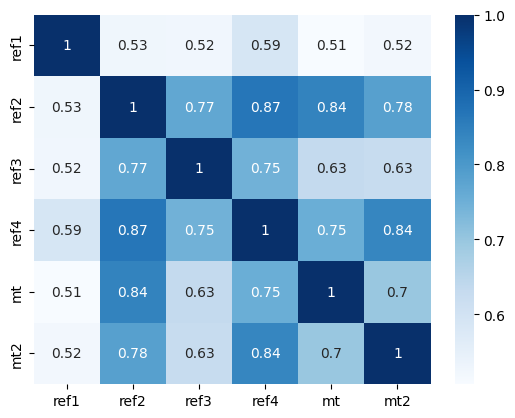

SL_575
src
24325330.39833967
16966711.067660846
ref1
10639135.04166004
2592745.975369449
ref2
11886288.545632508
5334486.279606642
ref3
10284108.334206779
4495370.288851118
ref4
8029716.763227173
2246817.176347716
mt
10270829.47245894
4353486.856921892
mt2
10451410.59763135
2718373.9420926776
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.516713     0.504327     0.569073   0.496490   
ref2_SL_575     0.516713     1.000000     0.769227     0.876822   0.844441   
ref3_SL_575     0.504327     0.769227     1.000000     0.744125   0.629641   
ref4_SL_575     0.569073     0.876822     0.744125     1.000000   0.770851   
mt_SL_575       0.496490     0.844441     0.629641     0.770851   1.000000   
mt2_SL_575      0.502825     0.791510     0.617312     0.843825   0.712714   

             mt2_SL_575  
ref1_SL_575    0.502825  
ref2_SL_575    0.791510  
ref3_SL_575    0.617312  
ref4_SL_575    0.843825  
mt_SL_575      0.712714  
mt2

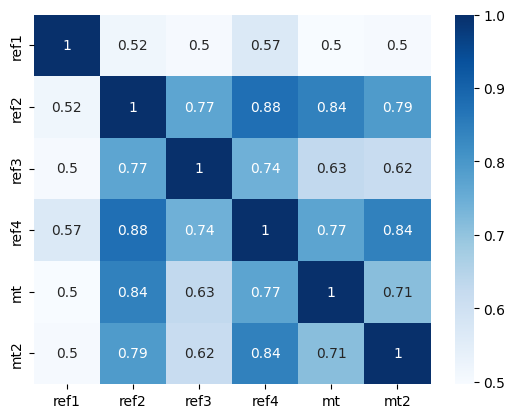

SL_600
src
58189712.87790054
39214596.580572255
ref1
26252608.808805417
5430363.924120896
ref2
28272338.042679064
11649741.813845634
ref3
24395185.444438
9518468.90933076
ref4
19336035.50100008
4778569.7480281
mt
24061310.41141141
9175464.120451786
mt2
25163006.42898155
5654482.732756066
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.505540     0.484357     0.550836   0.486183   
ref2_SL_600     0.505540     1.000000     0.769099     0.886617   0.846579   
ref3_SL_600     0.484357     0.769099     1.000000     0.739284   0.625036   
ref4_SL_600     0.550836     0.886617     0.739284     1.000000   0.787670   
mt_SL_600       0.486183     0.846579     0.625036     0.787670   1.000000   
mt2_SL_600      0.485761     0.798601     0.605802     0.849556   0.726937   

             mt2_SL_600  
ref1_SL_600    0.485761  
ref2_SL_600    0.798601  
ref3_SL_600    0.605802  
ref4_SL_600    0.849556  
mt_SL_600      0.726937  
mt2_SL_6

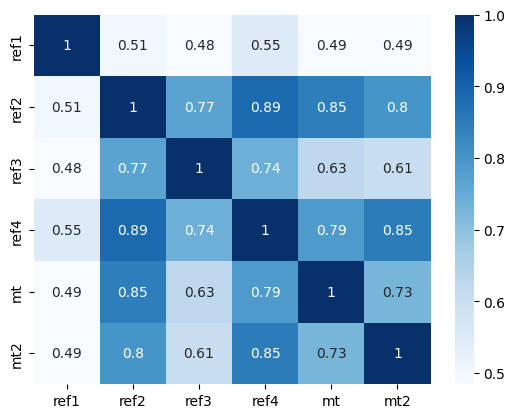

SL_625
src
140004729.32922277
89386250.1037006
ref1
65345617.57063453
11409169.786186941
ref2
67652546.31911708
25522625.544057906
ref3
58280902.18608564
19941601.437886678
ref4
46959798.671785906
10085841.65190712
mt
56666341.479557194
19389922.799321584
mt2
61036384.71035585
11906493.448817907
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.493948     0.464631     0.532966   0.475588   
ref2_SL_625     0.493948     1.000000     0.767260     0.894787   0.848673   
ref3_SL_625     0.464631     0.767260     1.000000     0.732815   0.619312   
ref4_SL_625     0.532966     0.894787     0.732815     1.000000   0.803674   
mt_SL_625       0.475588     0.848673     0.619312     0.803674   1.000000   
mt2_SL_625      0.469039     0.804665     0.592936     0.855090   0.741600   

             mt2_SL_625  
ref1_SL_625    0.469039  
ref2_SL_625    0.804665  
ref3_SL_625    0.592936  
ref4_SL_625    0.855090  
mt_SL_625      0.741600  


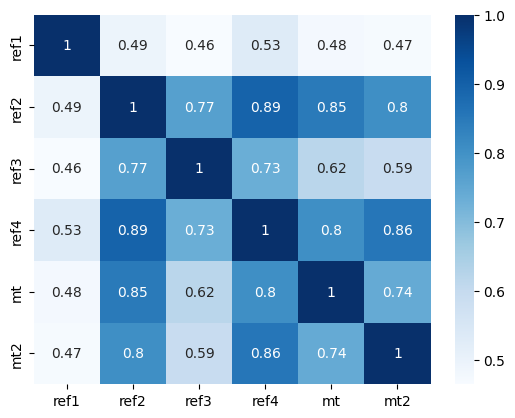

SL_650
src
338703171.3009422
210335993.3140239
ref1
163926629.11152884
24318565.476768974
ref2
162789116.70428446
56038313.66744544
ref3
140153855.3464217
42411939.84105705
ref4
114934658.10962412
21451773.230170377
mt
134101823.05733533
41725315.029201776
mt2
149061146.52073306
25414659.18330583
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.481994     0.445221     0.515463   0.464652   
ref2_SL_650     0.481994     1.000000     0.763871     0.901441   0.850630   
ref3_SL_650     0.445221     0.763871     1.000000     0.724922   0.612453   
ref4_SL_650     0.515463     0.901441     0.724922     1.000000   0.818714   
mt_SL_650       0.464652     0.850630     0.612453     0.818714   1.000000   
mt2_SL_650      0.452631     0.809698     0.578882     0.860358   0.756434   

             mt2_SL_650  
ref1_SL_650    0.452631  
ref2_SL_650    0.809698  
ref3_SL_650    0.578882  
ref4_SL_650    0.860358  
mt_SL_650      0.756434  

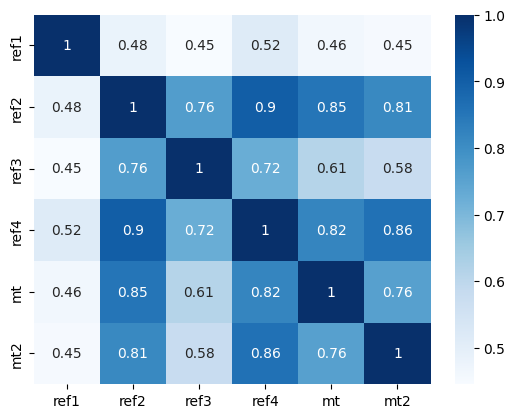

SL_675
src
823697155.0790491
502847016.137499
ref1
414110392.12026054
51064787.59349991
ref2
393750088.3220293
123169256.64008671
ref3
339103403.2495174
90542290.55726439
ref4
283295947.7599288
46153855.54357091
mt
318775476.8448414
90743008.41040307
mt2
366293415.84680545
53881652.43563932
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.469745     0.426189     0.498329   0.453353   
ref2_SL_675     0.469745     1.000000     0.759103     0.906715   0.852367   
ref3_SL_675     0.426189     0.759103     1.000000     0.715798   0.604475   
ref4_SL_675     0.498329     0.906715     0.715798     1.000000   0.832687   
mt_SL_675       0.453353     0.852367     0.604475     0.832687   1.000000   
mt2_SL_675      0.436525     0.813727     0.563822     0.865310   0.771199   

             mt2_SL_675  
ref1_SL_675    0.436525  
ref2_SL_675    0.813727  
ref3_SL_675    0.563822  
ref4_SL_675    0.865310  
mt_SL_675      0.771199  
mt2_S

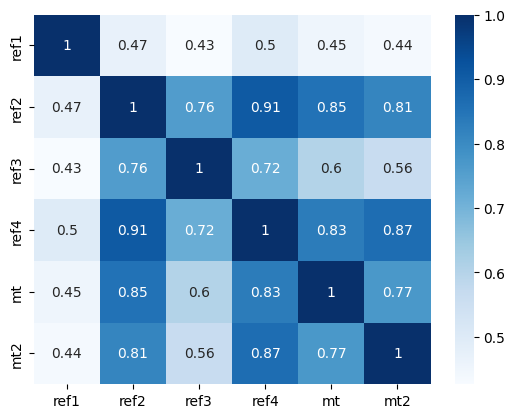

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
1052673897.0273695
108151177.74917263
ref2
957028626.1815051
272082692.37751913
ref3
825119609.3979492
198208929.78091294
ref4
702775437.7198689
99185993.45457709
mt
760913339.2917241
193853228.6052302
mt2
905209959.8653005
114256143.26552814
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.457270     0.407583     0.481565   0.441699   
ref2_SL_700     0.457270     1.000000     0.753124     0.910754   0.853817   
ref3_SL_700     0.407583     0.753124     1.000000     0.705628   0.595424   
ref4_SL_700     0.481565     0.910754     0.705628     1.000000   0.845529   
mt_SL_700       0.441699     0.853817     0.595424     0.845529   1.000000   
mt2_SL_700      0.420720     0.816797     0.547936     0.869916   0.785694   

             mt2_SL_700  
ref1_SL_700    0.420720  
ref2_SL_700    0.816797  
ref3_SL_700    0.547936  
ref4_SL_700    0.869916  
mt_SL_700      0.785694  


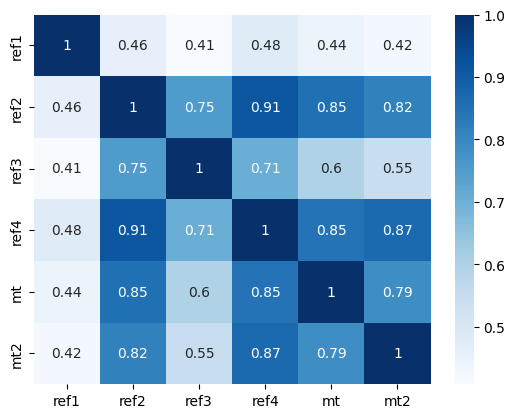

SL_725
src
4944587689.869408
2766777160.633936
ref1
2690865407.337863
234271626.66580117
ref2
2336733739.4762306
606544875.5035474
ref3
2018293699.4694927
436171205.1511692
ref4
1753576454.735423
210640100.03637332
mt
1823324718.5709052
424408047.45095015
mt2
2248621236.049775
242996965.13027048
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.444638     0.389444     0.465174   0.429722   
ref2_SL_725     0.444638     1.000000     0.746095     0.913706   0.854927   
ref3_SL_725     0.389444     0.746095     1.000000     0.694580   0.585370   
ref4_SL_725     0.465174     0.913706     0.694580     1.000000   0.857217   
mt_SL_725       0.429722     0.854927     0.585370     0.857217   1.000000   
mt2_SL_725      0.405226     0.818971     0.531399     0.874162   0.799754   

             mt2_SL_725  
ref1_SL_725    0.405226  
ref2_SL_725    0.818971  
ref3_SL_725    0.531399  
ref4_SL_725    0.874162  
mt_SL_725      0.799754  


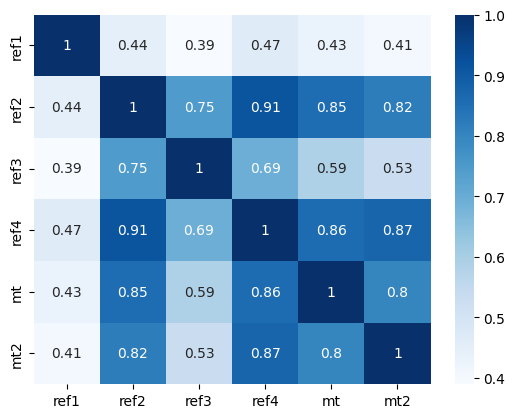

SL_750
src
12201196322.126482
6533701117.122557
ref1
6912733030.213508
507021118.5936487
ref2
5730042700.167143
1359951768.4999633
ref3
4961047954.65233
961771259.800411
ref4
4398771512.101384
451850020.7180561
mt
4384964455.627505
951929853.8247039
mt2
5612334526.680735
519941945.1358269
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.431914     0.371804     0.449158   0.417470   
ref2_SL_750     0.431914     1.000000     0.738165     0.915711   0.855658   
ref3_SL_750     0.371804     0.738165     1.000000     0.682804   0.574402   
ref4_SL_750     0.449158     0.915711     0.682804     1.000000   0.867755   
mt_SL_750       0.417470     0.855658     0.574402     0.867755   1.000000   
mt2_SL_750      0.390058     0.820319     0.514377     0.878046   0.813250   

             mt2_SL_750  
ref1_SL_750    0.390058  
ref2_SL_750    0.820319  
ref3_SL_750    0.514377  
ref4_SL_750    0.878046  
mt_SL_750      0.813250  
mt2_SL_

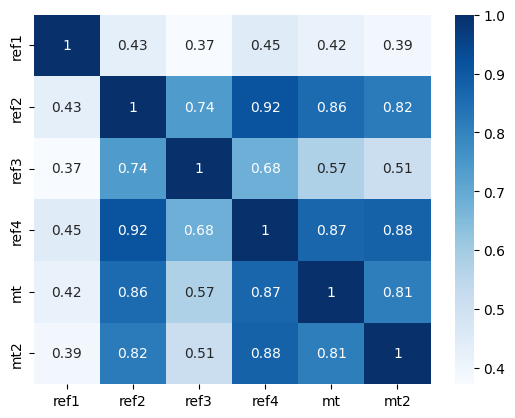

SL_775
src
30245243673.27781
15503724864.782127
ref1
17837520086.046925
1087471633.7544756
ref2
14108012539.276379
3025825999.0059853
ref3
12249976774.856213
2124605735.2764273
ref4
11087243428.082615
970392668.7486007
mt
10581562534.221548
2137412339.6529813
mt2
14069039715.25952
1131303130.8917503
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.419160     0.354684     0.433520   0.404999   
ref2_SL_775     0.419160     1.000000     0.729470     0.916903   0.855987   
ref3_SL_775     0.354684     0.729470     1.000000     0.670433   0.562619   
ref4_SL_775     0.433520     0.916903     0.670433     1.000000   0.877174   
mt_SL_775       0.404999     0.855987     0.562619     0.877174   1.000000   
mt2_SL_775      0.375231     0.820917     0.497023     0.881579   0.826090   

             mt2_SL_775  
ref1_SL_775    0.375231  
ref2_SL_775    0.820917  
ref3_SL_775    0.497023  
ref4_SL_775    0.881579  
mt_SL_775      0.82609

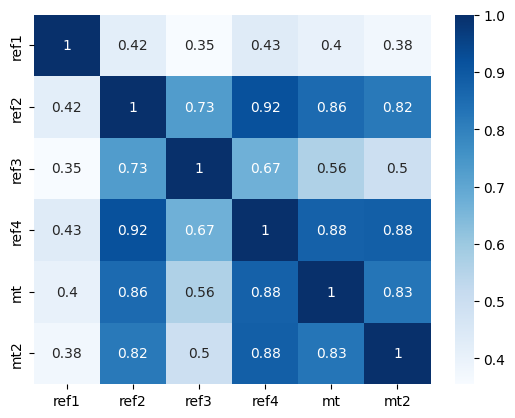

SL_800
src
75308449146.75627
37154119080.28433
ref1
46210311422.0445
2355472194.4623675
ref2
34868789335.41944
6601131619.280916
ref3
30376095451.681896
4625566617.27437
ref4
28067715184.252743
2080416725.172237
mt
25617406029.483185
4803563302.460163
mt2
35410343528.21013
2466942459.330911
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.406431     0.338104     0.418262   0.392375   
ref2_SL_800     0.406431     1.000000     0.720133     0.917402   0.855905   
ref3_SL_800     0.338104     0.720133     1.000000     0.657587   0.550129   
ref4_SL_800     0.418262     0.917402     0.657587     1.000000   0.885522   
mt_SL_800       0.392375     0.855905     0.550129     0.885522   1.000000   
mt2_SL_800      0.360766     0.820845     0.479476     0.884776   0.838211   

             mt2_SL_800  
ref1_SL_800    0.360766  
ref2_SL_800    0.820845  
ref3_SL_800    0.479476  
ref4_SL_800    0.884776  
mt_SL_800      0.838211  
mt2_S

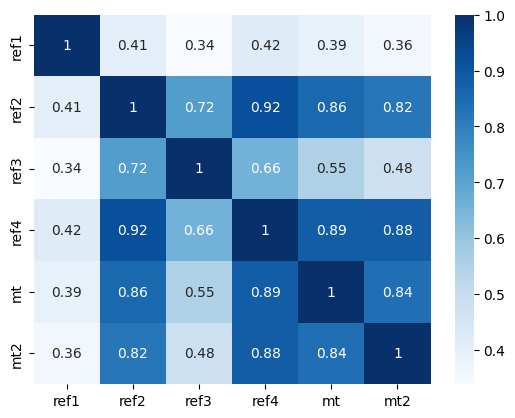

SL_825
src
188328461125.37543
88759479197.95065
ref1
120137686194.17102
5109194998.026093
ref2
86493145716.38434
14603784246.267986
ref3
75619756004.3975
10211201282.729355
ref4
71335417348.50623
4424288532.893234
mt
62208783093.10988
10803676011.070545
mt2
89455570568.22035
5326194723.527244
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.393775     0.322073     0.403387   0.379665   
ref2_SL_825     0.393775     1.000000     0.710261     0.917317   0.855413   
ref3_SL_825     0.322073     0.710261     1.000000     0.644366   0.537042   
ref4_SL_825     0.403387     0.917317     0.644366     1.000000   0.892864   
mt_SL_825       0.379665     0.855413     0.537042     0.892864   1.000000   
mt2_SL_825      0.346680     0.820178     0.461860     0.887660   0.849578   

             mt2_SL_825  
ref1_SL_825    0.346680  
ref2_SL_825    0.820178  
ref3_SL_825    0.461860  
ref4_SL_825    0.887660  
mt_SL_825      0.849578  
mt2

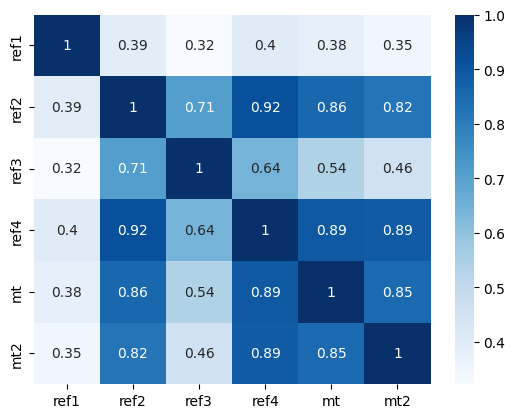

SL_850
src
472965874424.6596
209696852072.8994
ref1
313323468689.74896
11096040075.281578
ref2
215286495766.1549
32687801494.28449
ref3
188940824847.4056
22582109349.385757
ref4
181952330951.28204
9419983559.719528
mt
151508519260.67892
24377311267.58777
mt2
226765421862.47034
11469006122.491344
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.381237     0.306600     0.388897   0.366935   
ref2_SL_850     0.381237     1.000000     0.699948     0.916743   0.854523   
ref3_SL_850     0.306600     0.699948     1.000000     0.630860   0.523469   
ref4_SL_850     0.388897     0.916743     0.630860     1.000000   0.899272   
mt_SL_850       0.366935     0.854523     0.523469     0.899272   1.000000   
mt2_SL_850      0.332990     0.818990     0.444284     0.890257   0.860179   

             mt2_SL_850  
ref1_SL_850    0.332990  
ref2_SL_850    0.818990  
ref3_SL_850    0.444284  
ref4_SL_850    0.890257  
mt_SL_850      0.860179  


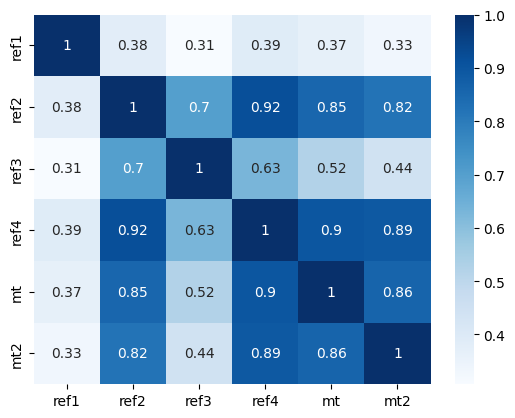

SL_875
src
1192729481778.0728
501307929419.6415
ref1
819475952688.6877
23841509761.504597
ref2
537605105573.44794
73550721226.29665
ref3
473687713677.15155
50031787674.457825
ref4
465606345760.29626
20077950652.80897
mt
370028707356.499
54751400122.73937
mt2
576675230242.901
24319155574.065125
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.368854     0.291687     0.374794   0.354247   
ref2_SL_875     0.368854     1.000000     0.689277     0.915765   0.853251   
ref3_SL_875     0.291687     0.689277     1.000000     0.617148   0.509514   
ref4_SL_875     0.374794     0.915765     0.617148     1.000000   0.904826   
mt_SL_875       0.354247     0.853251     0.509514     0.904826   1.000000   
mt2_SL_875      0.319708     0.817353     0.426844     0.892594   0.870019   

             mt2_SL_875  
ref1_SL_875    0.319708  
ref2_SL_875    0.817353  
ref3_SL_875    0.426844  
ref4_SL_875    0.892594  
mt_SL_875      0.870019  
mt

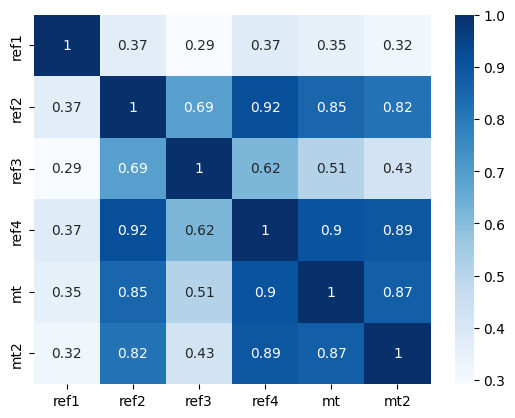

SL_900
src
3020011763176.6636
1193341285325.353
ref1
2148732874395.7915
50913796466.524666
ref2
1346625108314.983
165656765068.0257
ref3
1191324645785.9534
110599755132.24207
ref4
1194970982262.245
43355291421.40465
mt
906142506466.1003
123348447136.74426
mt2
1470870296121.2715
51604389588.14581
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.356657     0.277333     0.361080   0.341658   
ref2_SL_900     0.356657     1.000000     0.678321     0.914454   0.851623   
ref3_SL_900     0.277333     0.678321     1.000000     0.603295   0.495278   
ref4_SL_900     0.361080     0.914454     0.603295     1.000000   0.909605   
mt_SL_900       0.341658     0.851623     0.495278     0.909605   1.000000   
mt2_SL_900      0.306845     0.815330     0.409621     0.894700   0.879119   

             mt2_SL_900  
ref1_SL_900    0.306845  
ref2_SL_900    0.815330  
ref3_SL_900    0.409621  
ref4_SL_900    0.894700  
mt_SL_900      0.879119  


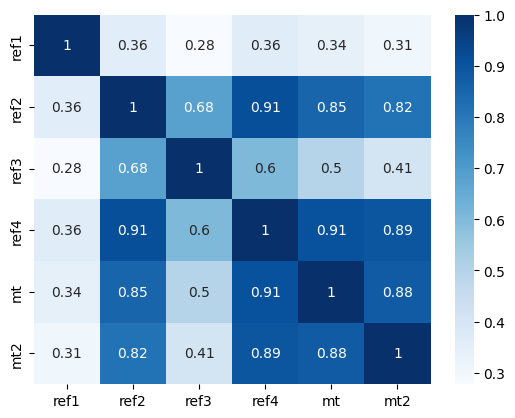

SL_925
src
7676878874728.81
2825871516031.6035
ref1
5647028415456.303
108791968542.43433
ref2
3382948951454.8867
373426379224.9971
ref3
3004986716456.7075
244126642721.04825
ref4
3075062998639.7075
94119015275.12875
mt
2224715716450.513
278002211989.21436
mt2
3762003121351.4976
111134795626.70895
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.344673     0.263535     0.347756   0.329222   
ref2_SL_925     0.344673     1.000000     0.667140     0.912874   0.849664   
ref3_SL_925     0.263535     0.667140     1.000000     0.589361   0.480853   
ref4_SL_925     0.347756     0.912874     0.589361     1.000000   0.913691   
mt_SL_925       0.329222     0.849664     0.480853     0.913691   1.000000   
mt2_SL_925      0.294410     0.812981     0.392684     0.896601   0.887510   

             mt2_SL_925  
ref1_SL_925    0.294410  
ref2_SL_925    0.812981  
ref3_SL_925    0.392684  
ref4_SL_925    0.896601  
mt_SL_925      0.887510  

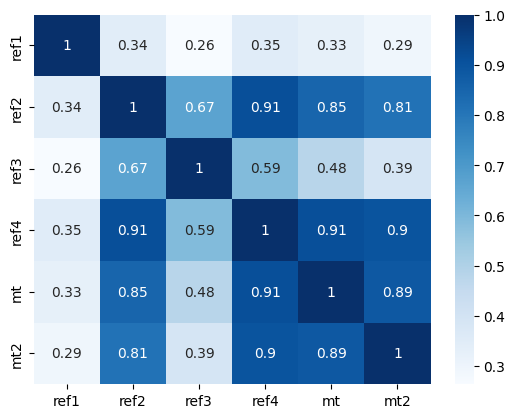

SL_950
src
19589480415784.91
6695745864435.366
ref1
14871358497316.824
232593765100.0718
ref2
8521996549118.749
842428193561.1781
ref3
7600436069897.412
539071066279.0355
ref4
7932341757067.791
204432173800.39664
mt
5475545572152.932
626777854002.157
mt2
9646884346737.543
240000056387.9594
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.332925     0.250287     0.334820   0.316982   
ref2_SL_950     0.332925     1.000000     0.655789     0.911078   0.847404   
ref3_SL_950     0.250287     0.655789     1.000000     0.575396   0.466324   
ref4_SL_950     0.334820     0.911078     0.575396     1.000000   0.917161   
mt_SL_950       0.316982     0.847404     0.466324     0.917161   1.000000   
mt2_SL_950      0.282406     0.810360     0.376089     0.898325   0.895229   

             mt2_SL_950  
ref1_SL_950    0.282406  
ref2_SL_950    0.810360  
ref3_SL_950    0.376089  
ref4_SL_950    0.898325  
mt_SL_950      0.895229  
mt2_SL

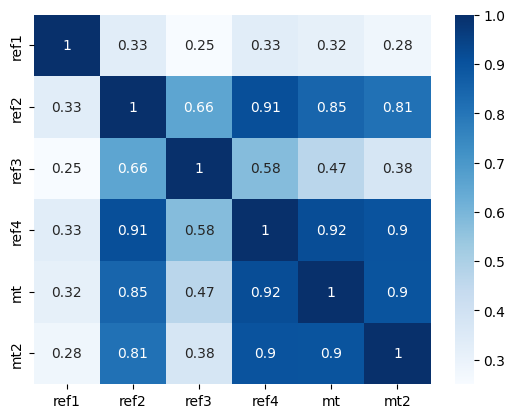

SL_975
src
50173418288827.71
15873783084476.455
ref1
39236302077679.94
496499774658.45386
ref2
21523803073407.42
1901763618816.6294
ref3
19272278849120.48
1190761211266.1377
ref4
20507025201008.15
443548741812.20856
mt
13508778662998.04
1385114004901.064
mt2
24797447841670.477
518693251920.93085
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.321431     0.237580     0.322273   0.304978   
ref2_SL_975     0.321431     1.000000     0.644312     0.909111   0.844871   
ref3_SL_975     0.237580     0.644312     1.000000     0.561442   0.451766   
ref4_SL_975     0.322273     0.909111     0.561442     1.000000   0.920090   
mt_SL_975       0.304978     0.844871     0.451766     0.920090   1.000000   
mt2_SL_975      0.270834     0.807515     0.359882     0.899897   0.902319   

             mt2_SL_975  
ref1_SL_975    0.270834  
ref2_SL_975    0.807515  
ref3_SL_975    0.359882  
ref4_SL_975    0.899897  
mt_SL_975      0.902319  


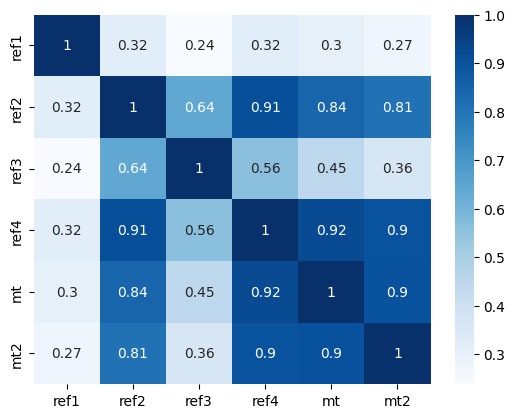

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.38351390595460216
0.3840526499856932
ref2
0.3781600569046347
0.3803361396469245
ref3
0.36797757719217244
0.3707878075456248
ref4
0.39074825753281583
0.3878215471579596
mt
0.37856098241729164
0.37916260323175355
mt2
0.37797258552086466
0.3796121685892363
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.578757   0.651104   0.693708  0.654934  0.651968
ref2_gini   0.578757   1.000000   0.646417   0.637030  0.657045  0.672080
ref3_gini   0.651104   0.646417   1.000000   0.651874  0.698969  0.673898
ref4_gini   0.693708   0.637030   0.651874   1.000000  0.646998  0.643941
mt_gini     0.654934   0.657045   0.698969   0.646998  1.000000  0.736592
mt2_gini    0.651968   0.672080   0.673898   0.643941  0.736592  1.000000


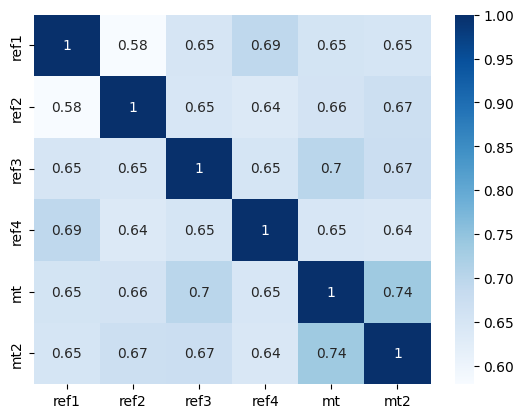

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.639820982279638
-4.773719822254829
ref2
-4.627609831603128
-4.754524656258228
ref3
-4.585188465899927
-4.681969835083924
ref4
-4.662484516769112
-4.7802569126079835
mt
-4.578983597922014
-4.659500217286231
mt2
-4.6149914795471245
-4.723371024683862
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.975665  0.964508  0.977674  0.978174  0.979190
ref2_kl  0.975665  1.000000  0.971514  0.975997  0.979835  0.978502
ref3_kl  0.964508  0.971514  1.000000  0.964475  0.976655  0.973088
ref4_kl  0.977674  0.975997  0.964475  1.000000  0.974654  0.971858
mt_kl    0.978174  0.979835  0.976655  0.974654  1.000000  0.985162
mt2_kl   0.979190  0.978502  0.973088  0.971858  0.985162  1.000000


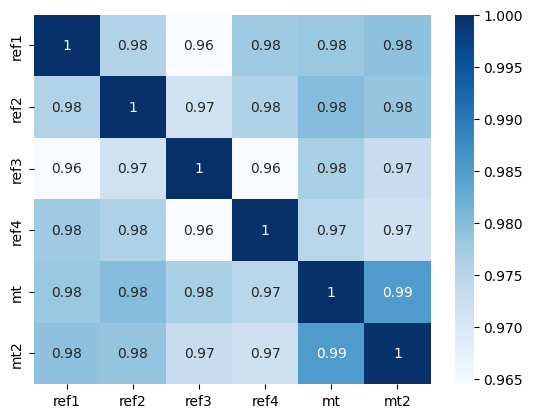

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.7283455151472055
0.7048597194223071
ref2
0.7256307667590621
0.7207832692210218
ref3
0.696942344392053
0.6950736760000034
ref4
0.7381491953858064
0.7279154847314943
mt
0.7209377618403191
0.7216664638021023
mt2
0.7103310339771421
0.6945430365192136
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.538874  0.637468  0.710840  0.602432  0.683121
ref2_cv  0.538874  1.000000  0.604965  0.613712  0.694163  0.658451
ref3_cv  0.637468  0.604965  1.000000  0.671870  0.669042  0.694045
ref4_cv  0.710840  0.613712  0.671870  1.000000  0.610382  0.705764
mt_cv    0.602432  0.694163  0.669042  0.610382  1.000000  0.706973
mt2_cv   0.683121  0.658451  0.694045  0.705764  0.706973  1.000000


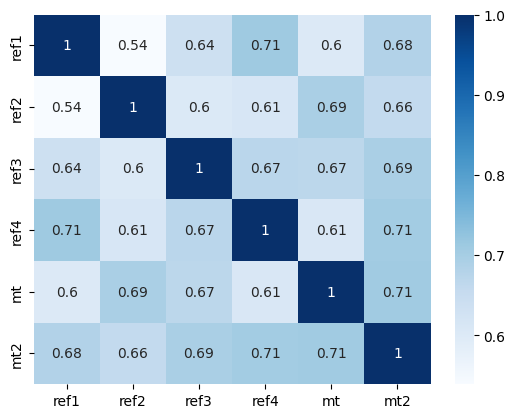

lv
src
72.35425230811832
69.03561950442358
ref1
45.43337329266884
38.496183415858184
ref2
50.27316419967457
45.67361151525419
ref3
48.79861087733949
43.33676316696125
ref4
44.34681431149812
38.24455582600997
mt
47.766712577500755
43.08428242089433
mt2
49.41484485462758
42.68896312017394
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.665044  0.667718  0.742152  0.676185  0.670655
ref2_lv  0.665044  1.000000  0.696063  0.791425  0.771731  0.751108
ref3_lv  0.667718  0.696063  1.000000  0.687776  0.591159  0.588131
ref4_lv  0.742152  0.791425  0.687776  1.000000  0.715442  0.767870
mt_lv    0.676185  0.771731  0.591159  0.715442  1.000000  0.750443
mt2_lv   0.670655  0.751108  0.588131  0.767870  0.750443  1.000000


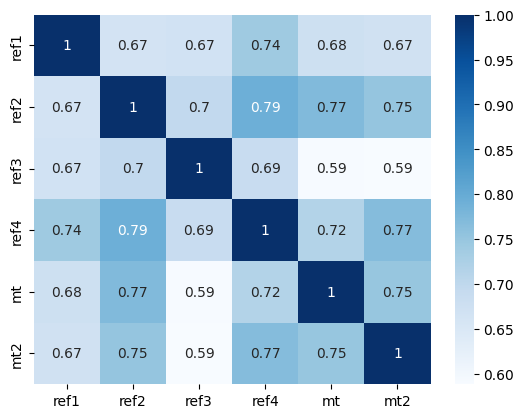

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-794.2468506270194
-718.701423199353
ref2
-888.2483826964445
-860.932558011686
ref3
-854.2050745450955
-769.3265467512471
ref4
-793.6629389475103
-699.4521479276385
mt
-848.6018805683296
-782.1100096157827
mt2
-832.2446595965026
-733.645043913784
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.942605    0.944651    0.976182  0.953387   
ref2_renyi    0.942605    1.000000    0.924591    0.943943  0.960379   
ref3_renyi    0.944651    0.924591    1.000000    0.947746  0.934109   
ref4_renyi    0.976182    0.943943    0.947746    1.000000  0.943919   
mt_renyi      0.953387    0.960379    0.934109    0.943919  1.000000   
mt2_renyi     0.966223    0.947304    0.947759    0.965839  0.954529   

            mt2_renyi  
ref1_renyi   0.966223  
ref2_renyi   0.947304  
ref3_renyi   0.947759  
ref4_renyi   0.965839  
mt_renyi     0.954529  
mt2_renyi    1.000000  


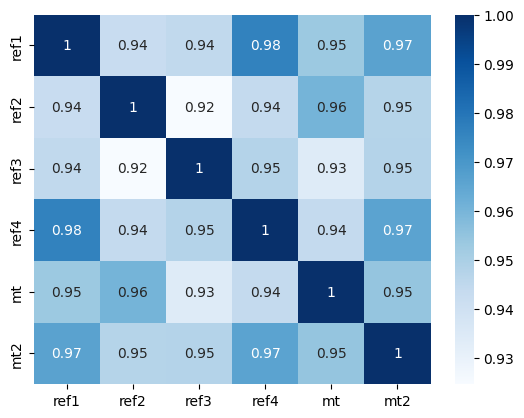

41.78302361451637
28.225018967931366
33.10751263534731
31.4557730623852
27.145755843311896
32.49491327744682


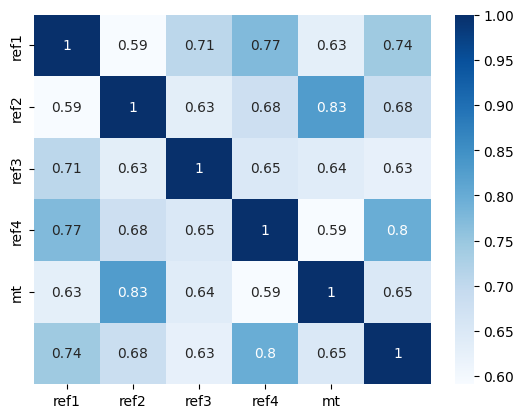

*************************************
28.277572726968867
28.277572726968867
33.249736438009485
31.677389829531275
27.312327695356082
32.61162841832383
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


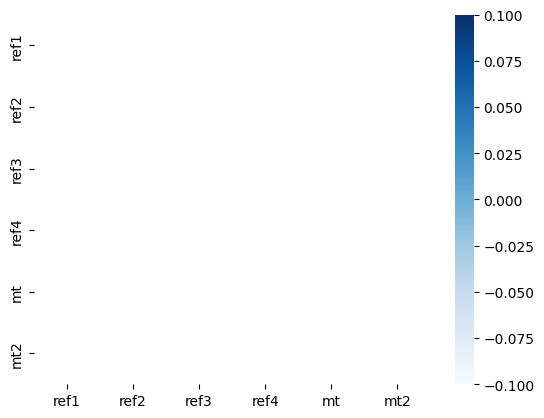

L
src
10.359164788583737
10.123614579255745
ref1
7.025890255895033
6.931599287063569
ref2
7.472031320255155
7.327978416005083
ref3
7.462089946460265
7.27404882734637
ref4
6.901631789566824
6.767866243122389
mt
7.69086457409261
7.476903698618777
mt2
7.478194149550895
7.276083682601446
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.789616  0.779266  0.853226  0.690803  0.688465
ref2_L  0.789616  1.000000  0.813677  0.836938  0.708610  0.658211
ref3_L  0.779266  0.813677  1.000000  0.799228  0.693384  0.691562
ref4_L  0.853226  0.836938  0.799228  1.000000  0.680504  0.696156
mt_L    0.690803  0.708610  0.693384  0.680504  1.000000  0.811071
mt2_L   0.688465  0.658211  0.691562  0.696156  0.811071  1.000000


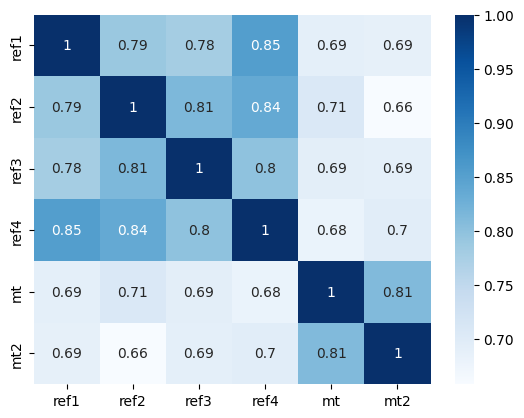

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.5226665435928912
1.522656556086793
ref2
1.5488763374687762
1.5461589522398131
ref3
1.550408495229785
1.5479362438849926
ref4
1.513314071763203
1.5087214983808748
mt
1.561932711439299
1.5554693078666806
mt2
1.5508475054785296
1.5522454422078256
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.808644    0.788572    0.850219  0.747402   
ref2_SL_25    0.808644    1.000000    0.813330    0.819332  0.716834   
ref3_SL_25    0.788572    0.813330    1.000000    0.788216  0.737913   
ref4_SL_25    0.850219    0.819332    0.788216    1.000000  0.740547   
mt_SL_25      0.747402    0.716834    0.737913    0.740547  1.000000   
mt2_SL_25     0.703262    0.682602    0.722227    0.701455  0.836998   

            mt2_SL_25  
ref1_SL_25   0.703262  
ref2_SL_25   0.682602  
ref3_SL_25   0.722227  
ref4_SL_25   0.701455  
mt_SL_25     0.836998  
mt2_SL_25    1.000000  


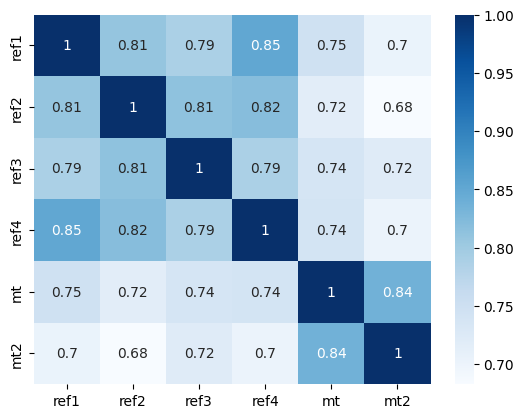

SL_50
src
3.0671973011635125
3.032966843199389
ref1
2.4472107197978605
2.4427589807969388
ref2
2.528094938646029
2.5093995416294144
ref3
2.531049489843815
2.5070921815013705
ref4
2.4212128111119635
2.4002130635356056
mt
2.5684851508939386
2.541627394681286
mt2
2.5328428338116726
2.5146714372666574
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.806863    0.785514    0.850589  0.730210   
ref2_SL_50    0.806863    1.000000    0.814884    0.829108  0.712237   
ref3_SL_50    0.785514    0.814884    1.000000    0.792191  0.720727   
ref4_SL_50    0.850589    0.829108    0.792191    1.000000  0.718030   
mt_SL_50      0.730210    0.712237    0.720727    0.718030  1.000000   
mt2_SL_50     0.696651    0.675657    0.711277    0.695658  0.832549   

            mt2_SL_50  
ref1_SL_50   0.696651  
ref2_SL_50   0.675657  
ref3_SL_50   0.711277  
ref4_SL_50   0.695658  
mt_SL_50     0.832549  
mt2_SL_50    1.000000  


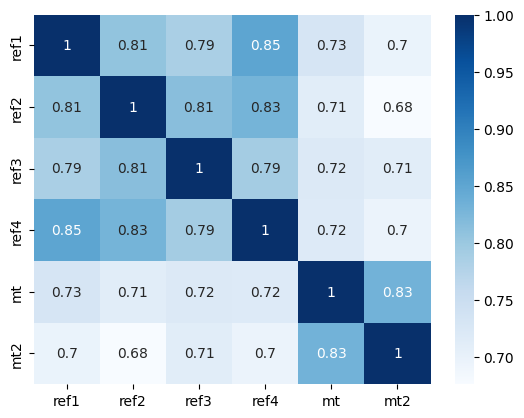

SL_75
src
5.5762344444241885
5.474223342002128
ref1
4.0844909396332145
4.05346265064055
ref2
4.281939600244479
4.22369988955479
ref3
4.28365911913951
4.215461282062231
ref4
4.025906816405061
3.9636258931648523
mt
4.3798779546741216
4.304077015781328
mt2
4.289391089654724
4.215850904554786
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.799514    0.782036    0.852142  0.711103   
ref2_SL_75    0.799514    1.000000    0.814915    0.834821  0.709849   
ref3_SL_75    0.782036    0.814915    1.000000    0.796172  0.706082   
ref4_SL_75    0.852142    0.834821    0.796172    1.000000  0.698655   
mt_SL_75      0.711103    0.709849    0.706082    0.698655  1.000000   
mt2_SL_75     0.691862    0.666812    0.700687    0.694743  0.823676   

            mt2_SL_75  
ref1_SL_75   0.691862  
ref2_SL_75   0.666812  
ref3_SL_75   0.700687  
ref4_SL_75   0.694743  
mt_SL_75     0.823676  
mt2_SL_75    1.000000  


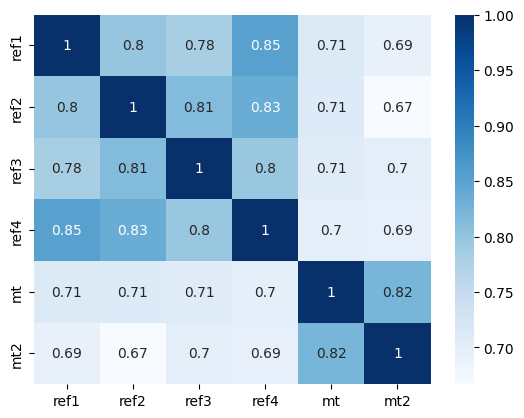

SL_100
src
10.359164788583737
10.123614579255745
ref1
7.025890255895033
6.931599287063569
ref2
7.472031320255155
7.327978416005083
ref3
7.462089946460265
7.27404882734637
ref4
6.901631789566824
6.767866243122389
mt
7.69086457409261
7.476903698618777
mt2
7.478194149550895
7.276083682601446
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.789616     0.779266     0.853226   0.690803   
ref2_SL_100     0.789616     1.000000     0.813677     0.836938   0.708610   
ref3_SL_100     0.779266     0.813677     1.000000     0.799228   0.693384   
ref4_SL_100     0.853226     0.836938     0.799228     1.000000   0.680504   
mt_SL_100       0.690803     0.708610     0.693384     0.680504   1.000000   
mt2_SL_100      0.688465     0.658211     0.691562     0.696156   0.811071   

             mt2_SL_100  
ref1_SL_100    0.688465  
ref2_SL_100    0.658211  
ref3_SL_100    0.691562  
ref4_SL_100    0.696156  
mt_SL_100      0.811071  
mt2_SL_

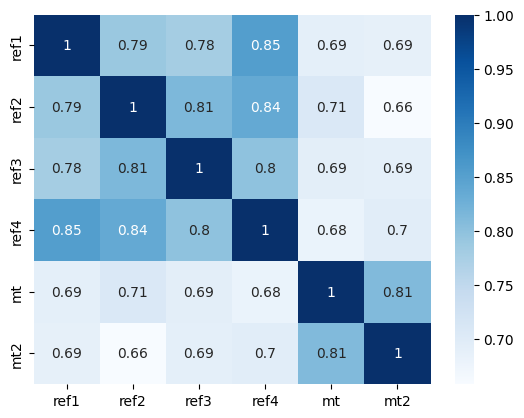

SL_125
src
19.634351008953868
18.984081758810827
ref1
12.404310425342791
12.118053730210864
ref2
13.381631893820458
12.985080225357438
ref3
13.32737817133813
12.847238331224176
ref4
12.145703075623503
11.735834256188443
mt
13.853536250428096
13.31669669431988
mt2
13.368645407859264
12.857400391569534
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.778503     0.777281     0.853106   0.670248   
ref2_SL_125     0.778503     1.000000     0.811263     0.835523   0.707919   
ref3_SL_125     0.777281     0.811263     1.000000     0.800495   0.681868   
ref4_SL_125     0.853106     0.835523     0.800495     1.000000   0.662535   
mt_SL_125       0.670248     0.707919     0.681868     0.662535   1.000000   
mt2_SL_125      0.686114     0.651060     0.683492     0.698815   0.795220   

             mt2_SL_125  
ref1_SL_125    0.686114  
ref2_SL_125    0.651060  
ref3_SL_125    0.683492  
ref4_SL_125    0.698815  
mt_SL_125      0.7952

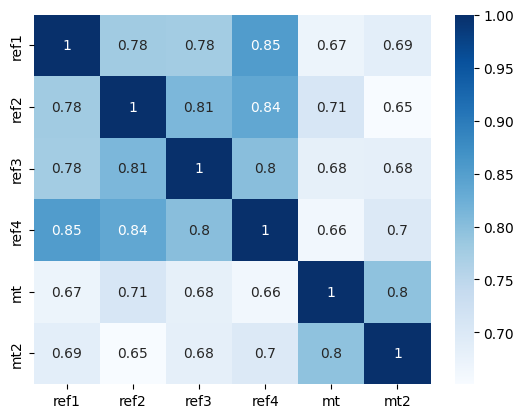

SL_150
src
37.92546190950008
36.245652911575796
ref1
22.422594143812628
21.71979239801279
ref2
24.53897462443092
23.46352966846418
ref3
24.347322072221107
23.235691702649206
ref4
21.885405035665425
20.951647484437128
mt
25.53921212847735
24.336066218038845
mt2
24.446982426784068
23.090583681745947
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.767134     0.775988     0.851640   0.650511   
ref2_SL_150     0.767134     1.000000     0.807836     0.830887   0.707558   
ref3_SL_150     0.775988     0.807836     1.000000     0.799697   0.671199   
ref4_SL_150     0.851640     0.830887     0.799697     1.000000   0.644730   
mt_SL_150       0.650511     0.707558     0.671199     0.644730   1.000000   
mt2_SL_150      0.684801     0.646266     0.676284     0.702530   0.776906   

             mt2_SL_150  
ref1_SL_150    0.684801  
ref2_SL_150    0.646266  
ref3_SL_150    0.676284  
ref4_SL_150    0.702530  
mt_SL_150      0.776906 

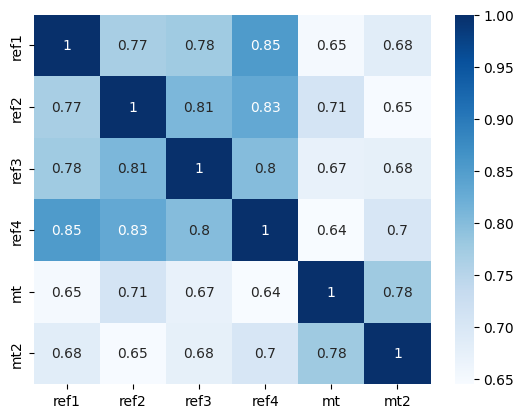

SL_175
src
74.59367553068095
71.2767390568266
ref1
41.43555926719848
39.3412619881546
ref2
46.00958940044217
43.65711359174236
ref3
45.42869332668004
42.7845866388061
ref4
40.31209713905262
37.91861220292834
mt
48.11077678527639
44.51448205256439
mt2
45.66176463828782
41.98616900926105
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.756435     0.775317     0.849058   0.632644   
ref2_SL_175     0.756435     1.000000     0.803684     0.823753   0.707524   
ref3_SL_175     0.775317     0.803684     1.000000     0.797059   0.661377   
ref4_SL_175     0.849058     0.823753     0.797059     1.000000   0.627797   
mt_SL_175       0.632644     0.707524     0.661377     0.627797   1.000000   
mt2_SL_175      0.684620     0.644415     0.670069     0.707329   0.757159   

             mt2_SL_175  
ref1_SL_175    0.684620  
ref2_SL_175    0.644415  
ref3_SL_175    0.670069  
ref4_SL_175    0.707329  
mt_SL_175      0.757159  
mt2_SL_175

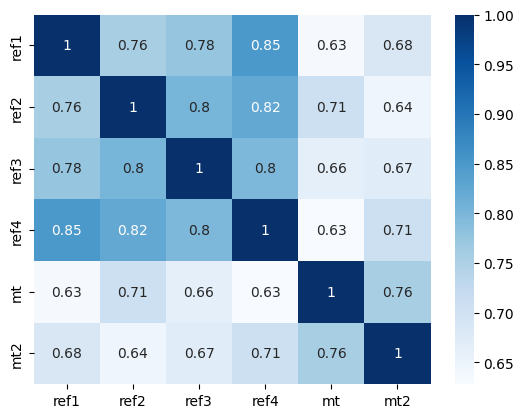

SL_200
src
149.29007454484417
140.79844066957907
ref1
78.19979749114063
73.30941042522768
ref2
88.11544087056966
82.184388498477
ref3
86.48625724120906
79.51309589132347
ref4
75.82236692251605
69.32580554305359
mt
92.50692982021015
86.02179414813699
mt2
87.02552670861145
78.25183468263741
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.747283     0.775222     0.845779   0.617492   
ref2_SL_200     0.747283     1.000000     0.799232     0.815227   0.707899   
ref3_SL_200     0.775222     0.799232     1.000000     0.793139   0.652582   
ref4_SL_200     0.845779     0.815227     0.793139     1.000000   0.612790   
mt_SL_200       0.617492     0.707899     0.652582     0.612790   1.000000   
mt2_SL_200      0.685570     0.645712     0.665145     0.713171   0.737090   

             mt2_SL_200  
ref1_SL_200    0.685570  
ref2_SL_200    0.645712  
ref3_SL_200    0.665145  
ref4_SL_200    0.713171  
mt_SL_200      0.737090  
mt2_SL_

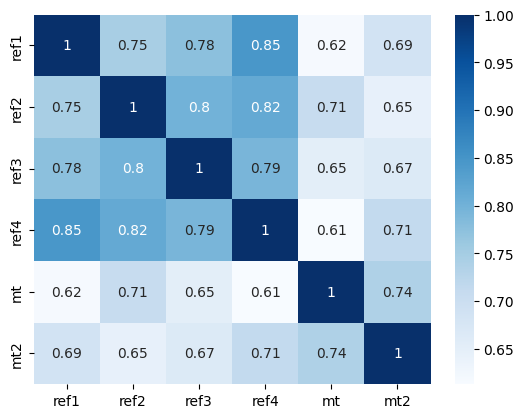

SL_225
src
303.8405857924159
280.9173422693609
ref1
150.6260663399799
136.90925809224973
ref2
172.2408947708142
156.96341678769218
ref3
167.87777137219848
150.9147730373291
ref4
145.52000967596157
127.35175615561465
mt
181.3856565677651
167.01726203668707
mt2
169.13239814485615
146.9633224121409
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.740399     0.775641     0.842244   0.605569   
ref2_SL_225     0.740399     1.000000     0.795010     0.806628   0.708760   
ref3_SL_225     0.775641     0.795010     1.000000     0.788652   0.645022   
ref4_SL_225     0.842244     0.806628     0.788652     1.000000   0.600774   
mt_SL_225       0.605569     0.708760     0.645022     0.600774   1.000000   
mt2_SL_225      0.687450     0.650013     0.661796     0.719892   0.717745   

             mt2_SL_225  
ref1_SL_225    0.687450  
ref2_SL_225    0.650013  
ref3_SL_225    0.661796  
ref4_SL_225    0.719892  
mt_SL_225      0.717745  


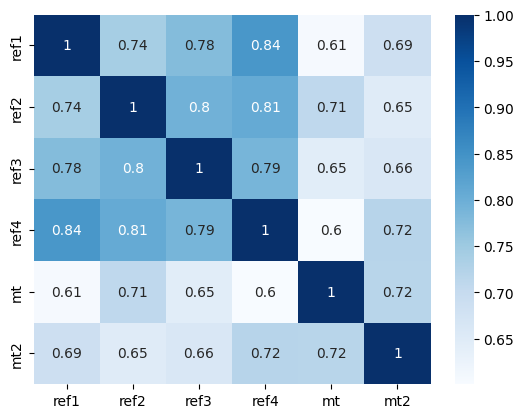

SL_250
src
628.4544909090951
577.7790438817206
ref1
295.97664337529574
260.1682867823392
ref2
343.4060914654966
303.9380381531478
ref3
332.0681566393579
287.2885995014393
ref4
284.8270192281231
242.8636315633646
mt
362.3768680759488
321.1867382549393
mt2
335.03570085195463
282.2104068967163
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.736240     0.776454     0.838772   0.597016   
ref2_SL_250     0.736240     1.000000     0.791559     0.799247   0.710137   
ref3_SL_250     0.776454     0.791559     1.000000     0.784294   0.638824   
ref4_SL_250     0.838772     0.799247     0.784294     1.000000   0.592581   
mt_SL_250       0.597016     0.710137     0.638824     0.592581   1.000000   
mt2_SL_250      0.689856     0.656905     0.660156     0.727246   0.700012   

             mt2_SL_250  
ref1_SL_250    0.689856  
ref2_SL_250    0.656905  
ref3_SL_250    0.660156  
ref4_SL_250    0.727246  
mt_SL_250      0.700012  
mt2_S

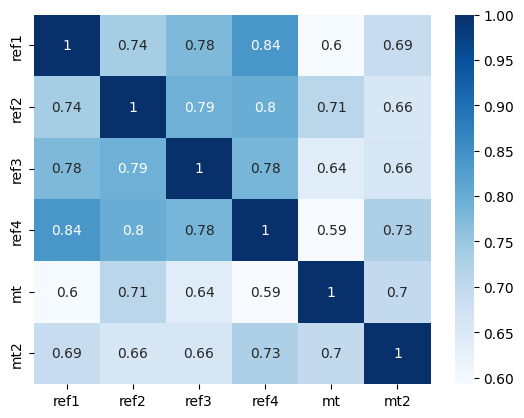

SL_275
src
1320.1522165503627
1219.778984730092
ref1
593.0840169847535
499.5657144341908
ref2
697.8629597462921
597.877653813242
ref3
669.0117795263668
561.7548610635854
ref4
568.3083907356296
465.2243865255576
mt
737.0118211619877
658.5514780671174
mt2
676.1881752511828
536.1180242244167
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.734932     0.777456     0.835470   0.591639   
ref2_SL_275     0.734932     1.000000     0.789328     0.794113   0.712000   
ref3_SL_275     0.777456     0.789328     1.000000     0.780590   0.633983   
ref4_SL_275     0.835470     0.794113     0.780590     1.000000   0.588683   
mt_SL_275       0.591639     0.712000     0.633983     0.588683   1.000000   
mt2_SL_275      0.692247     0.665806     0.660130     0.734973   0.684567   

             mt2_SL_275  
ref1_SL_275    0.692247  
ref2_SL_275    0.665806  
ref3_SL_275    0.660130  
ref4_SL_275    0.734973  
mt_SL_275      0.684567  
mt2_SL_

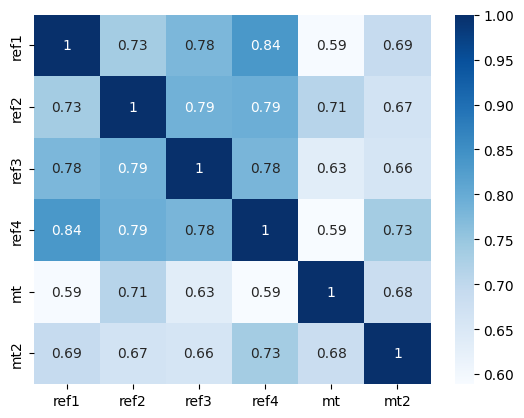

SL_300
src
2814.3535145845594
2540.753413906092
ref1
1211.4868380096646
982.5376847373605
ref2
1444.4309388431166
1190.202443343996
ref3
1372.1270974125507
1101.967257382878
ref4
1155.446838070917
884.1170609605999
mt
1524.5711446868604
1319.0055412835154
mt2
1389.8832412106756
1063.1312572507431
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.736262     0.778351     0.832231   0.589002   
ref2_SL_300     0.736262     1.000000     0.788579     0.791832   0.714267   
ref3_SL_300     0.778351     0.788579     1.000000     0.777789   0.630350   
ref4_SL_300     0.832231     0.791832     0.777789     1.000000   0.589179   
mt_SL_300       0.589002     0.714267     0.630350     0.589179   1.000000   
mt2_SL_300      0.694054     0.676064     0.661380     0.742847   0.671872   

             mt2_SL_300  
ref1_SL_300    0.694054  
ref2_SL_300    0.676064  
ref3_SL_300    0.661380  
ref4_SL_300    0.742847  
mt_SL_300      0.671872  

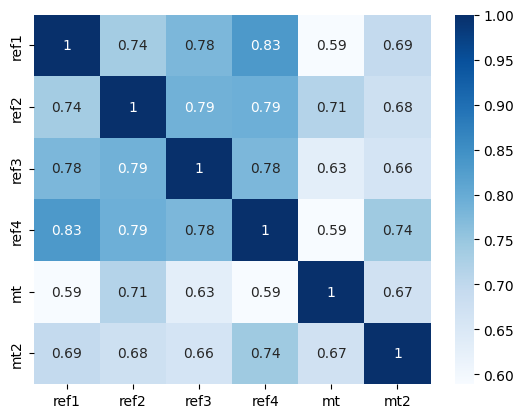

SL_325
src
6084.052939199673
5462.138856697426
ref1
2521.655526940974
1942.3030461849248
ref2
3042.439845431868
2393.7513745707643
ref3
2863.3149397219236
2190.1381332990977
ref4
2392.6533798241417
1765.4775871149627
mt
3204.4309753230646
2736.5420809454195
mt2
2908.131739824494
2062.8983329581824
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.739736     0.778777     0.828792   0.588540   
ref2_SL_325     0.739736     1.000000     0.789334     0.792526   0.716827   
ref3_SL_325     0.778777     0.789334     1.000000     0.775839   0.627661   
ref4_SL_325     0.828792     0.792526     0.775839     1.000000   0.593849   
mt_SL_325       0.588540     0.716827     0.627661     0.593849   1.000000   
mt2_SL_325      0.694787     0.687020     0.663380     0.750710   0.662193   

             mt2_SL_325  
ref1_SL_325    0.694787  
ref2_SL_325    0.687020  
ref3_SL_325    0.663380  
ref4_SL_325    0.750710  
mt_SL_325      0.662193 

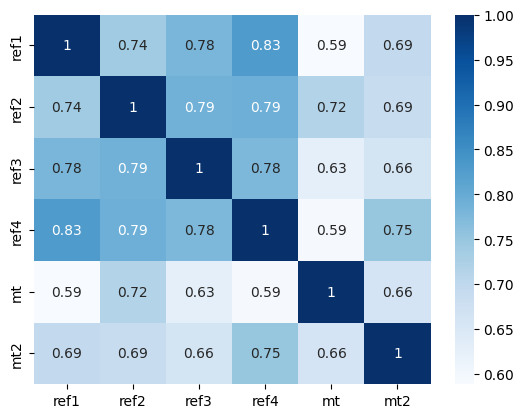

SL_350
src
13326.018221127724
11692.845168165546
ref1
5345.653705294367
3905.8355859966623
ref2
6515.385609350336
4899.204414662472
ref3
6075.577355166152
4408.196389307483
ref4
5043.597855327474
3482.233655086661
mt
6836.368757553687
5585.5731272412095
mt2
6190.4090131059065
4124.785583190247
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.744677     0.778350     0.824819   0.589669   
ref2_SL_350     0.744677     1.000000     0.791380     0.795881   0.719562   
ref3_SL_350     0.778350     0.791380     1.000000     0.774426   0.625584   
ref4_SL_350     0.824819     0.795881     0.774426     1.000000   0.602249   
mt_SL_350       0.589669     0.719562     0.625584     0.602249   1.000000   
mt2_SL_350      0.694118     0.698057     0.665496     0.758479   0.655639   

             mt2_SL_350  
ref1_SL_350    0.694118  
ref2_SL_350    0.698057  
ref3_SL_350    0.665496  
ref4_SL_350    0.758479  
mt_SL_350      0.655639  
mt

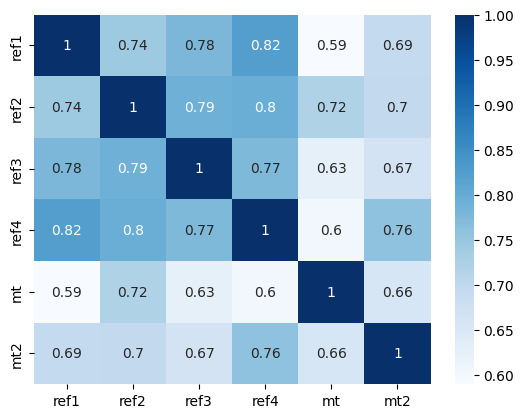

SL_375
src
29547.541988410783
25794.64486383465
ref1
11534.582698396165
7887.136912045164
ref2
14171.436964070776
10013.799956508743
ref3
13099.256418144021
9046.931555684085
ref4
10815.753358905995
7071.483274600223
mt
14787.429435849968
11383.422491768364
mt2
13396.367189846036
8184.069732526836
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.750347     0.776720     0.820004   0.591853   
ref2_SL_375     0.750347     1.000000     0.794321     0.801264   0.722358   
ref3_SL_375     0.776720     0.794321     1.000000     0.773070   0.623769   
ref4_SL_375     0.820004     0.801264     0.773070     1.000000   0.613810   
mt_SL_375       0.591853     0.722358     0.623769     0.613810   1.000000   
mt2_SL_375      0.691897     0.708633     0.667085     0.766125   0.652194   

             mt2_SL_375  
ref1_SL_375    0.691897  
ref2_SL_375    0.708633  
ref3_SL_375    0.667085  
ref4_SL_375    0.766125  
mt_SL_375      0.652194 

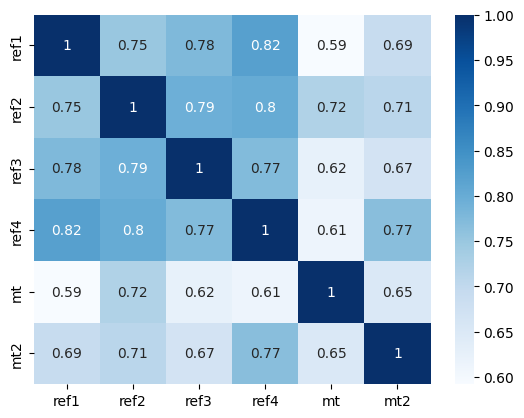

SL_400
src
66263.42583599311
56824.85462524026
ref1
25315.15774195823
16211.174403381887
ref2
31274.278302207305
20678.08123070164
ref3
28675.757385601584
18506.799282609245
ref4
23578.19153300799
13849.467560601448
mt
32394.14866765054
23323.192018425972
mt2
29448.377517713423
16428.918220652202
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.756045     0.773611     0.814114   0.594636   
ref2_SL_400     0.756045     1.000000     0.797657     0.807870   0.725114   
ref3_SL_400     0.773611     0.797657     1.000000     0.771234   0.621877   
ref4_SL_400     0.814114     0.807870     0.771234     1.000000   0.627916   
mt_SL_400       0.594636     0.725114     0.621877     0.627916   1.000000   
mt2_SL_400      0.688129     0.718297     0.667571     0.773654   0.651751   

             mt2_SL_400  
ref1_SL_400    0.688129  
ref2_SL_400    0.718297  
ref3_SL_400    0.667571  
ref4_SL_400    0.773654  
mt_SL_400      0.651751  

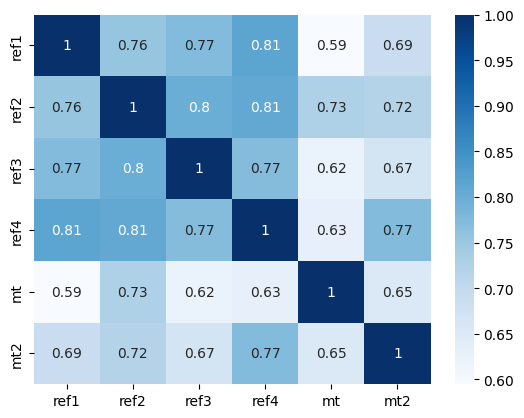

SL_425
src
150170.28195142408
126458.59758375768
ref1
56466.00819868931
32678.847986114866
ref2
69951.97885031872
43137.73510259515
ref3
63685.41982070599
38547.75809659529
ref4
52208.949000708184
28821.47118122832
mt
71790.5573491644
48016.65020045565
mt2
65697.18686310167
33429.76565360591
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.761189     0.768850     0.807024   0.597644   
ref2_SL_425     0.761189     1.000000     0.800871     0.814869   0.727740   
ref3_SL_425     0.768850     0.800871     1.000000     0.768421   0.619611   
ref4_SL_425     0.807024     0.814869     0.768421     1.000000   0.643961   
mt_SL_425       0.597644     0.727740     0.619611     0.643961   1.000000   
mt2_SL_425      0.682920     0.726693     0.666497     0.781086   0.654134   

             mt2_SL_425  
ref1_SL_425    0.682920  
ref2_SL_425    0.726693  
ref3_SL_425    0.666497  
ref4_SL_425    0.781086  
mt_SL_425      0.654134  
mt2_

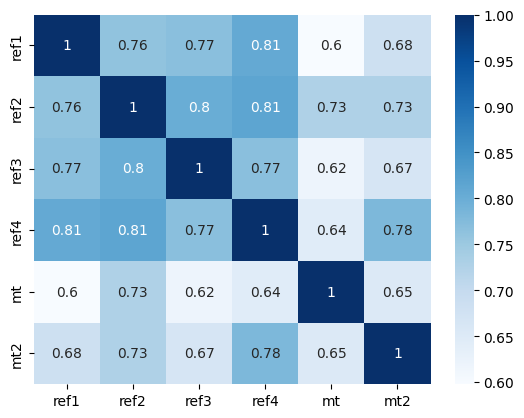

SL_450
src
343632.9097266221
283095.18838540884
ref1
127890.40032320266
67473.43049991404
ref2
158416.64027832486
90615.46893156576
ref3
143369.9976599981
80621.3654535072
ref4
117320.43342102048
58714.30981354455
mt
160780.4853256131
101399.92767259604
mt2
148600.59419808903
69020.56793871237
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.765350     0.762372     0.798701   0.600568   
ref2_SL_450     0.765350     1.000000     0.803499     0.821514   0.730148   
ref3_SL_450     0.762372     0.803499     1.000000     0.764239   0.616719   
ref4_SL_450     0.798701     0.821514     0.764239     1.000000   0.661383   
mt_SL_450       0.600568     0.730148     0.616719     0.661383   1.000000   
mt2_SL_450      0.676415     0.733562     0.663546     0.788427   0.659113   

             mt2_SL_450  
ref1_SL_450    0.676415  
ref2_SL_450    0.733562  
ref3_SL_450    0.663546  
ref4_SL_450    0.788427  
mt_SL_450      0.659113  
mt

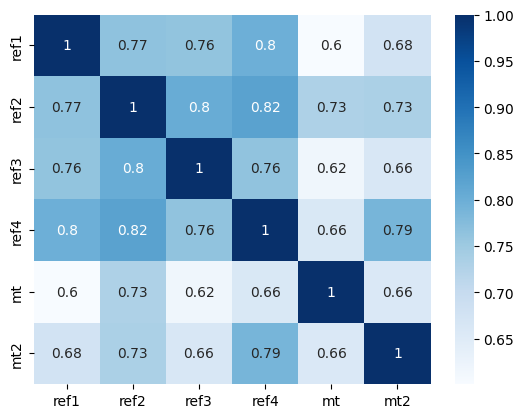

SL_475
src
793365.4482151263
640119.8046014623
ref1
293850.8107149933
139807.8453450388
ref2
362876.2540787995
191588.37839519687
ref3
326891.76619219873
168379.1461264195
ref4
267294.9510069072
120504.86388132986
mt
363521.97133287
212635.3088852846
mt2
340444.8310634737
141741.75650915195
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.768253     0.754204     0.789182   0.603149   
ref2_SL_475     0.768253     1.000000     0.805179     0.827204   0.732249   
ref3_SL_475     0.754204     0.805179     1.000000     0.758433   0.612994   
ref4_SL_475     0.789182     0.827204     0.758433     1.000000   0.679679   
mt_SL_475       0.603149     0.732249     0.612994     0.679679   1.000000   
mt2_SL_475      0.668764     0.738736     0.658541     0.795668   0.666420   

             mt2_SL_475  
ref1_SL_475    0.668764  
ref2_SL_475    0.738736  
ref3_SL_475    0.658541  
ref4_SL_475    0.795668  
mt_SL_475      0.666420  
mt2_S

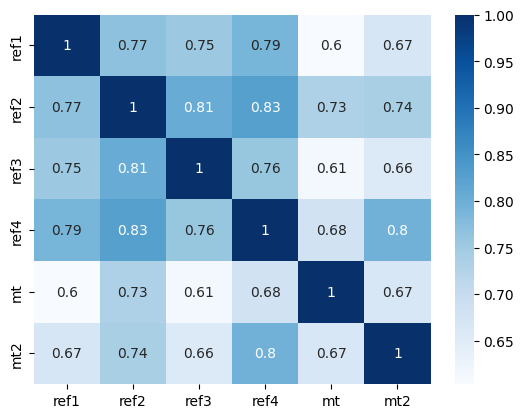

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
684282.0706474367
286321.0199983287
ref2
839981.9425833302
407947.4560869043
ref3
754254.2215168325
354466.7988113739
ref4
616853.1409700209
250185.59569222655
mt
829009.4769007846
446303.41670893773
mt2
789204.2658081537
291402.1247745423
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.769763     0.744448     0.778552   0.605158   
ref2_SL_500     0.769763     1.000000     0.805661     0.831511   0.733947   
ref3_SL_500     0.744448     0.805661     1.000000     0.750878   0.608275   
ref4_SL_500     0.778552     0.831511     0.750878     1.000000   0.698407   
mt_SL_500       0.605158     0.733947     0.608275     0.698407   1.000000   
mt2_SL_500      0.660092     0.742121     0.651424     0.802777   0.675755   

             mt2_SL_500  
ref1_SL_500    0.660092  
ref2_SL_500    0.742121  
ref3_SL_500    0.651424  
ref4_SL_500    0.802777  
mt_SL_500      0.675755  
mt2

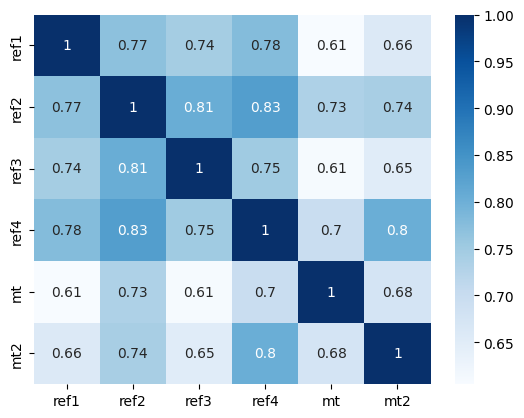

SL_525
src
4331606.646061756
3141367.4417431457
ref1
1613397.3410101891
593257.5233427702
ref2
1963197.4762156454
875207.6594642363
ref3
1759758.3457135
750127.0149876594
ref4
1440567.1159715173
517276.9975360589
mt
1905274.8767955971
942712.750179225
mt2
1849370.4120990946
603320.5962877665
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.769851     0.733252     0.766920   0.606396   
ref2_SL_525     0.769851     1.000000     0.804808     0.834172   0.735138   
ref3_SL_525     0.733252     0.804808     1.000000     0.741568   0.602436   
ref4_SL_525     0.766920     0.834172     0.741568     1.000000   0.717185   
mt_SL_525       0.606396     0.735138     0.602436     0.717185   1.000000   
mt2_SL_525      0.650502     0.743690     0.642237     0.809708   0.686801   

             mt2_SL_525  
ref1_SL_525    0.650502  
ref2_SL_525    0.743690  
ref3_SL_525    0.642237  
ref4_SL_525    0.809708  
mt_SL_525      0.686801  
mt2_

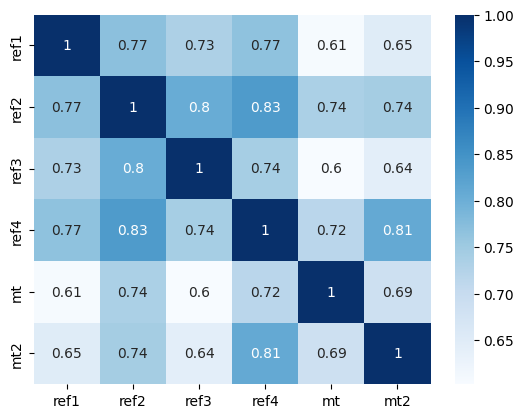

SL_550
src
10231354.187866237
7329958.645473514
ref1
3847952.2816746766
1247886.0524589205
ref2
4629174.868310718
1897730.796859885
ref3
4148399.81923969
1607433.9663914393
ref4
3401277.2425777344
1077154.8621301013
mt
4409624.109673603
2035932.6390080247
mt2
4376686.160274213
1253064.7599636256
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.768568     0.720789     0.754402   0.606694   
ref2_SL_550     0.768568     1.000000     0.802575     0.835063   0.735711   
ref3_SL_550     0.720789     0.802575     1.000000     0.730581   0.595391   
ref4_SL_550     0.754402     0.835063     0.730581     1.000000   0.735689   
mt_SL_550       0.606694     0.735711     0.595391     0.735689   1.000000   
mt2_SL_550      0.640072     0.743467     0.631093     0.816402   0.699230   

             mt2_SL_550  
ref1_SL_550    0.640072  
ref2_SL_550    0.743467  
ref3_SL_550    0.631093  
ref4_SL_550    0.816402  
mt_SL_550      0.699230  


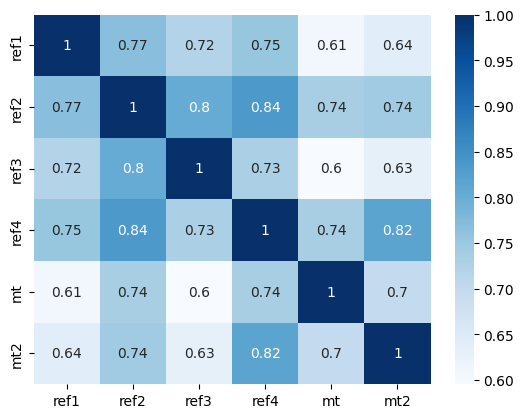

SL_575
src
24325330.39833967
16966711.067660846
ref1
9274631.874917582
2608644.7207300803
ref2
11004873.625500662
4113542.1764591746
ref3
9873955.659991458
3443564.990234147
ref4
8111834.067157132
2261803.641151832
mt
10270829.47245894
4353486.856921892
mt2
10451410.59763135
2718373.9420926776
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.766016     0.707242     0.741112   0.605909   
ref2_SL_575     0.766016     1.000000     0.798991     0.834165   0.735560   
ref3_SL_575     0.707242     0.798991     1.000000     0.718054   0.587088   
ref4_SL_575     0.741112     0.834165     0.718054     1.000000   0.753645   
mt_SL_575       0.605909     0.735560     0.587088     0.753645   1.000000   
mt2_SL_575      0.628868     0.741514     0.618158     0.822802   0.712714   

             mt2_SL_575  
ref1_SL_575    0.628868  
ref2_SL_575    0.741514  
ref3_SL_575    0.618158  
ref4_SL_575    0.822802  
mt_SL_575      0.712714  
mt

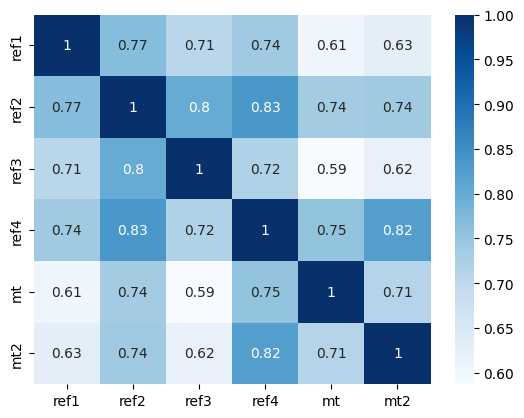

SL_600
src
58189712.87790054
39214596.580572255
ref1
22571266.65388884
5480873.117016727
ref2
26359431.6320396
8776451.307319148
ref3
23713541.257767767
7413256.625939375
ref4
19525224.16067759
4805549.557151365
mt
24061310.41141141
9175464.120451786
mt2
25163006.42898155
5654482.732756066
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.762324     0.692792     0.727158   0.603936   
ref2_SL_600     0.762324     1.000000     0.794129     0.831540   0.734581   
ref3_SL_600     0.692792     0.794129     1.000000     0.704158   0.577510   
ref4_SL_600     0.727158     0.831540     0.704158     1.000000   0.770833   
mt_SL_600       0.603936     0.734581     0.577510     0.770833   1.000000   
mt2_SL_600      0.616950     0.737922     0.603628     0.828850   0.726937   

             mt2_SL_600  
ref1_SL_600    0.616950  
ref2_SL_600    0.737922  
ref3_SL_600    0.603628  
ref4_SL_600    0.828850  
mt_SL_600      0.726937  
mt2_SL

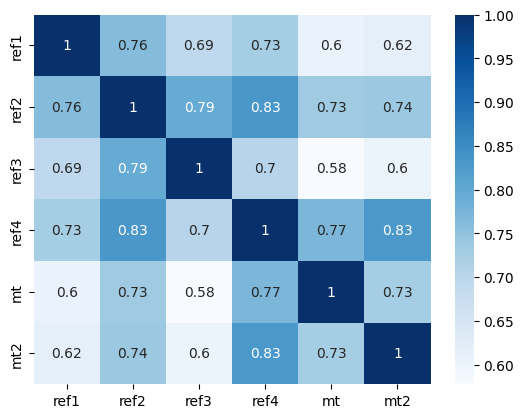

SL_625
src
140004729.32922277
89386250.1037006
ref1
55416797.10311883
11649391.8094326
ref2
63578831.60490509
18784890.197526075
ref3
57428686.4106146
16080407.90857122
ref4
47394370.64100352
10074383.458561065
mt
56666341.479557194
19389922.799321584
mt2
61036384.71035585
11906493.448817907
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.757634     0.677609     0.712639   0.600704   
ref2_SL_625     0.757634     1.000000     0.788092     0.827293   0.732689   
ref3_SL_625     0.677609     0.788092     1.000000     0.689079   0.566672   
ref4_SL_625     0.712639     0.827293     0.689079     1.000000   0.787076   
mt_SL_625       0.600704     0.732689     0.566672     0.787076   1.000000   
mt2_SL_625      0.604376     0.732801     0.587718     0.834504   0.741600   

             mt2_SL_625  
ref1_SL_625    0.604376  
ref2_SL_625    0.732801  
ref3_SL_625    0.587718  
ref4_SL_625    0.834504  
mt_SL_625      0.741600  
mt2_

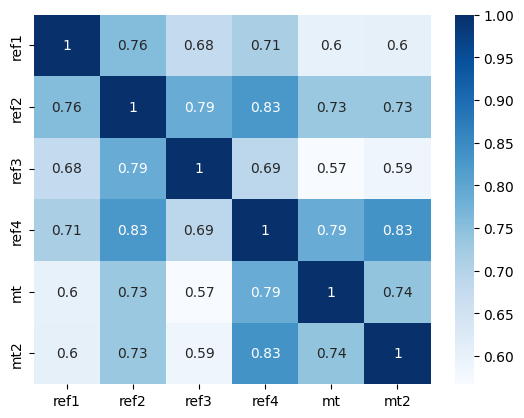

SL_650
src
338703171.3009422
210335993.3140239
ref1
137154355.65068513
24813784.77947038
ref2
154346080.4651112
40688717.9139948
ref3
140165497.97027627
35156950.90815545
ref4
115928085.9441748
21232228.072039045
mt
134101823.05733533
41725315.029201776
mt2
149061146.52073306
25414659.18330583
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.752090     0.661848     0.697646   0.596183   
ref2_SL_650     0.752090     1.000000     0.780998     0.821560   0.729812   
ref3_SL_650     0.661848     0.780998     1.000000     0.673009   0.554622   
ref4_SL_650     0.697646     0.821560     0.673009     1.000000   0.802243   
mt_SL_650       0.596183     0.729812     0.554622     0.802243   1.000000   
mt2_SL_650      0.591211     0.726275     0.570649     0.839728   0.756434   

             mt2_SL_650  
ref1_SL_650    0.591211  
ref2_SL_650    0.726275  
ref3_SL_650    0.570649  
ref4_SL_650    0.839728  
mt_SL_650      0.756434  
mt

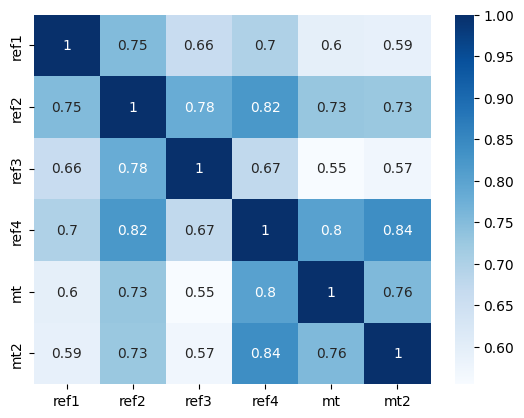

SL_675
src
823697155.0790491
502847016.137499
ref1
341932562.7533735
53031557.71447939
ref2
376953636.0703823
88486031.40655422
ref3
344591355.0310183
76531779.02099249
ref4
285550544.3095598
45708174.68008194
mt
318775476.8448414
90743008.41040307
mt2
366293415.84680545
53881652.43563932
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.745827     0.645648     0.682260   0.590373   
ref2_SL_675     0.745827     1.000000     0.772966     0.814487   0.725906   
ref3_SL_675     0.645648     0.772966     1.000000     0.656129   0.541433   
ref4_SL_675     0.682260     0.814487     0.656129     1.000000   0.816244   
mt_SL_675       0.590373     0.725906     0.541433     0.816244   1.000000   
mt2_SL_675      0.577522     0.718474     0.552643     0.844504   0.771199   

             mt2_SL_675  
ref1_SL_675    0.577522  
ref2_SL_675    0.718474  
ref3_SL_675    0.552643  
ref4_SL_675    0.844504  
mt_SL_675      0.771199  
mt2_SL_

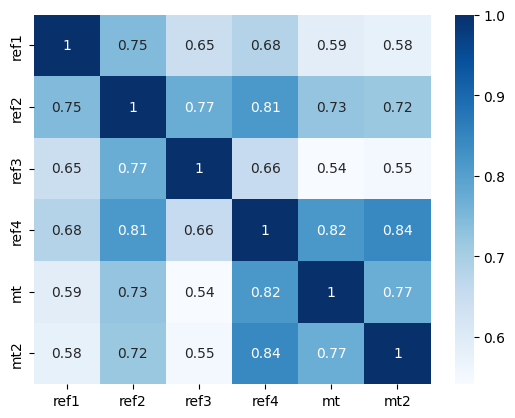

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
858099841.4262714
114575802.40950444
ref2
925786307.1783222
194612236.61792615
ref3
852917647.613874
166336896.69288385
ref4
707838838.8183887
98798752.3426717
mt
760913339.2917241
193853228.6052302
mt2
905209959.8653005
114256143.26552814
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.738972     0.629131     0.666554   0.583313   
ref2_SL_700     0.738972     1.000000     0.764112     0.806223   0.720947   
ref3_SL_700     0.629131     0.764112     1.000000     0.638613   0.527207   
ref4_SL_700     0.666554     0.806223     0.638613     1.000000   0.829029   
mt_SL_700       0.583313     0.720947     0.527207     0.829029   1.000000   
mt2_SL_700      0.563382     0.709528     0.533910     0.848824   0.785694   

             mt2_SL_700  
ref1_SL_700    0.563382  
ref2_SL_700    0.709528  
ref3_SL_700    0.533910  
ref4_SL_700    0.848824  
mt_SL_700      0.785694  
mt2

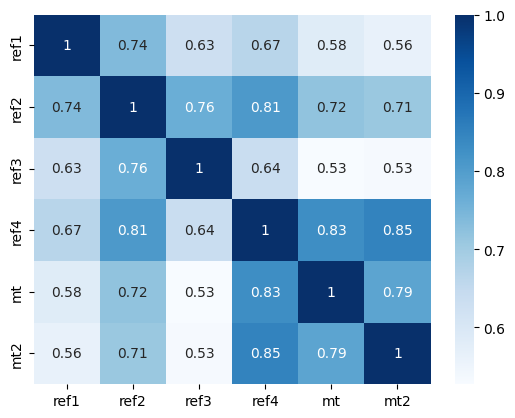

SL_725
src
4944587689.869408
2766777160.633936
ref1
2166352528.81985
247072149.7395109
ref2
2285603934.505441
429482925.02410144
ref3
2124484158.943396
359531227.2961284
ref4
1764777747.5504878
208033450.74742395
mt
1823324718.5709052
424408047.45095015
mt2
2248621236.049775
242996965.13027048
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.731639     0.612405     0.650598   0.575064   
ref2_SL_725     0.731639     1.000000     0.754543     0.796909   0.714938   
ref3_SL_725     0.612405     0.754543     1.000000     0.620621   0.512060   
ref4_SL_725     0.650598     0.796909     0.620621     1.000000   0.840578   
mt_SL_725       0.575064     0.714938     0.512060     0.840578   1.000000   
mt2_SL_725      0.548867     0.699569     0.514649     0.852692   0.799754   

             mt2_SL_725  
ref1_SL_725    0.548867  
ref2_SL_725    0.699569  
ref3_SL_725    0.514649  
ref4_SL_725    0.852692  
mt_SL_725      0.799754  
mt

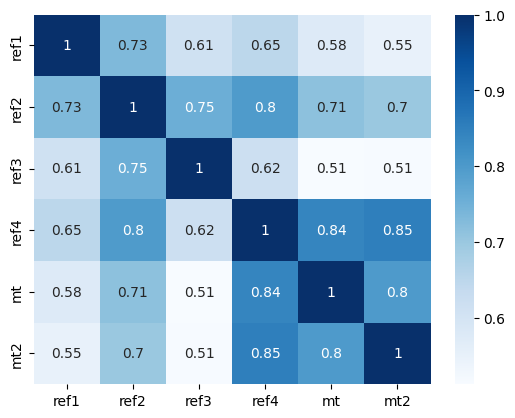

SL_750
src
12201196322.126482
6533701117.122557
ref1
5498760696.688159
530847194.49733007
ref2
5670336576.945034
934804585.138541
ref3
5323069764.564408
774121313.423075
ref4
4423015166.109991
445630404.35324085
mt
4384964455.627505
951929853.8247039
mt2
5612334526.680735
519941945.1358269
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.723929     0.595563     0.634452   0.565715   
ref2_SL_750     0.723929     1.000000     0.744356     0.786681   0.707902   
ref3_SL_750     0.595563     0.744356     1.000000     0.602296   0.496124   
ref4_SL_750     0.634452     0.786681     0.602296     1.000000   0.850904   
mt_SL_750       0.565715     0.707902     0.496124     0.850904   1.000000   
mt2_SL_750      0.534055     0.688724     0.495046     0.856122   0.813250   

             mt2_SL_750  
ref1_SL_750    0.534055  
ref2_SL_750    0.688724  
ref3_SL_750    0.495046  
ref4_SL_750    0.856122  
mt_SL_750      0.813250  
mt2_SL

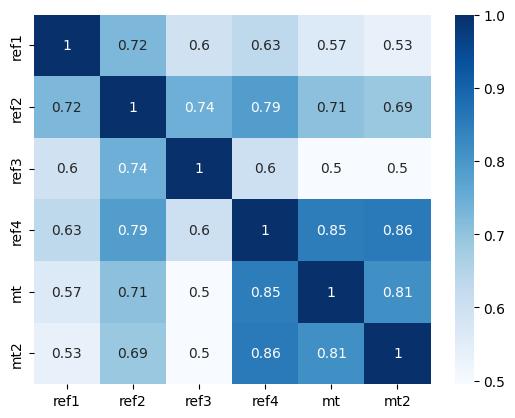

SL_775
src
30245243673.27781
15503724864.782127
ref1
14025469204.491398
1136019561.8142834
ref2
14131749255.181942
2039376566.5160584
ref3
13411113957.27345
1647990520.0239682
ref4
11138027086.721907
957951462.9708956
mt
10581562534.221548
2137412339.6529813
mt2
14069039715.25952
1131303130.8917503
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.715932     0.578684     0.618175   0.555368   
ref2_SL_775     0.715932     1.000000     0.733637     0.775660   0.699881   
ref3_SL_775     0.578684     0.733637     1.000000     0.583770   0.479539   
ref4_SL_775     0.618175     0.775660     0.583770     1.000000   0.860040   
mt_SL_775       0.555368     0.699881     0.479539     0.860040   1.000000   
mt2_SL_775      0.519025     0.677116     0.475269     0.859136   0.826090   

             mt2_SL_775  
ref1_SL_775    0.519025  
ref2_SL_775    0.677116  
ref3_SL_775    0.475269  
ref4_SL_775    0.859136  
mt_SL_775      0.826090

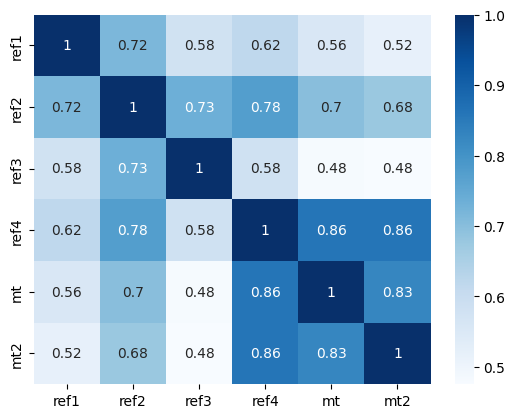

SL_800
src
75308449146.75627
37154119080.28433
ref1
35931913683.28305
2442764547.1288757
ref2
35369879092.9628
4474015602.242462
ref3
33962956814.41399
3552795413.5334125
ref4
28168711423.112476
2060773497.9908166
mt
25617406029.483185
4803563302.460163
mt2
35410343528.21013
2466942459.330911
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.707726     0.561838     0.601820   0.544138   
ref2_SL_800     0.707726     1.000000     0.722464     0.763960   0.690934   
ref3_SL_800     0.561838     0.722464     1.000000     0.565157   0.462447   
ref4_SL_800     0.601820     0.763960     0.565157     1.000000   0.868043   
mt_SL_800       0.544138     0.690934     0.462447     0.868043   1.000000   
mt2_SL_800      0.503853     0.664860     0.455467     0.861762   0.838211   

             mt2_SL_800  
ref1_SL_800    0.503853  
ref2_SL_800    0.664860  
ref3_SL_800    0.455467  
ref4_SL_800    0.861762  
mt_SL_800      0.838211  
mt2

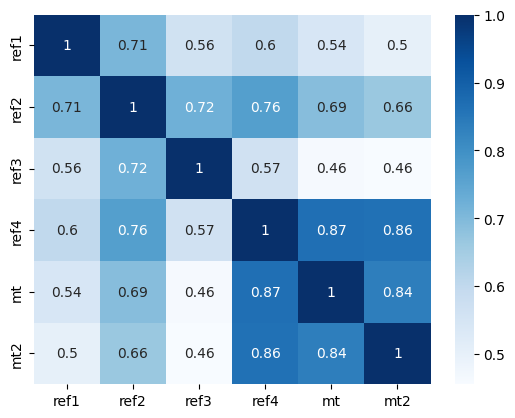

SL_825
src
188328461125.37543
88759479197.95065
ref1
92420195284.61555
5323799199.749534
ref2
88879514585.4055
10011154525.468582
ref3
86424972468.43533
7672047480.493367
ref4
71518675266.64539
4440154917.793062
mt
62208783093.10988
10803676011.070545
mt2
89455570568.22035
5326194723.527244
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.699377     0.545084     0.585435   0.532146   
ref2_SL_825     0.699377     1.000000     0.710900     0.751680   0.681132   
ref3_SL_825     0.545084     0.710900     1.000000     0.546562   0.444988   
ref4_SL_825     0.585435     0.751680     0.546562     1.000000   0.874978   
mt_SL_825       0.532146     0.681132     0.444988     0.874978   1.000000   
mt2_SL_825      0.488612     0.652064     0.435773     0.864029   0.849578   

             mt2_SL_825  
ref1_SL_825    0.488612  
ref2_SL_825    0.652064  
ref3_SL_825    0.435773  
ref4_SL_825    0.864029  
mt_SL_825      0.849578  
mt2_S

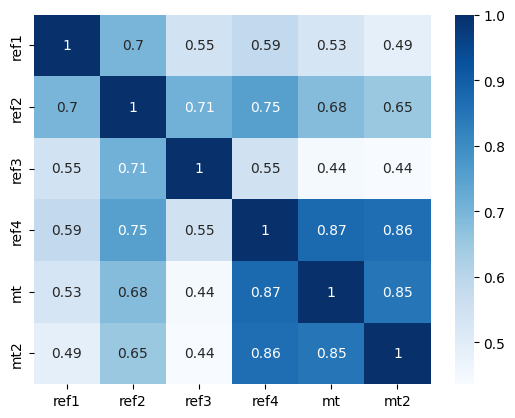

SL_850
src
472965874424.6596
209696852072.8994
ref1
238566050072.75427
11391691010.599611
ref2
224175262189.6836
22270627828.931248
ref3
220918356278.38116
16802740737.577019
ref4
182224505465.34708
9575999604.455595
mt
151508519260.67892
24377311267.58777
mt2
226765421862.47034
11469006122.491344
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.690943     0.528472     0.569068   0.519514   
ref2_SL_850     0.690943     1.000000     0.699006     0.738913   0.670554   
ref3_SL_850     0.528472     0.699006     1.000000     0.528075   0.427298   
ref4_SL_850     0.569068     0.738913     0.528075     1.000000   0.880924   
mt_SL_850       0.519514     0.670554     0.427298     0.880924   1.000000   
mt2_SL_850      0.473372     0.638828     0.416303     0.865973   0.860179   

             mt2_SL_850  
ref1_SL_850    0.473372  
ref2_SL_850    0.638828  
ref3_SL_850    0.416303  
ref4_SL_850    0.865973  
mt_SL_850      0.860179 

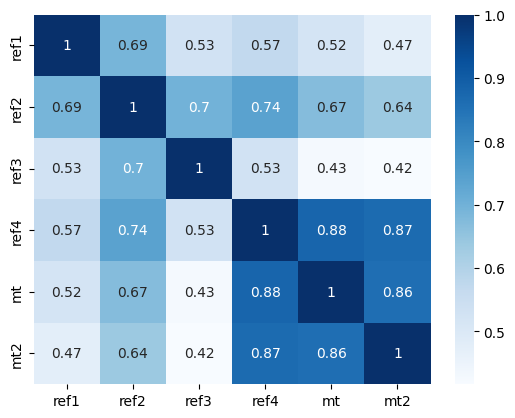

SL_875
src
1192729481778.0728
501307929419.6415
ref1
617809147528.9066
24224092660.460903
ref2
567395586940.2192
48817872901.664276
ref3
567098748447.8743
36449742134.71351
ref4
465784384553.27313
20669590900.318798
mt
370028707356.499
54751400122.73937
mt2
576675230242.901
24319155574.065125
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.682474     0.512045     0.552761   0.506361   
ref2_SL_875     0.682474     1.000000     0.686829     0.725738   0.659285   
ref3_SL_875     0.512045     0.686829     1.000000     0.509776   0.409506   
ref4_SL_875     0.552761     0.725738     0.509776     1.000000   0.885963   
mt_SL_875       0.506361     0.659285     0.409506     0.885963   1.000000   
mt2_SL_875      0.458196     0.625245     0.397154     0.867626   0.870019   

             mt2_SL_875  
ref1_SL_875    0.458196  
ref2_SL_875    0.625245  
ref3_SL_875    0.397154  
ref4_SL_875    0.867626  
mt_SL_875      0.870019  
mt2

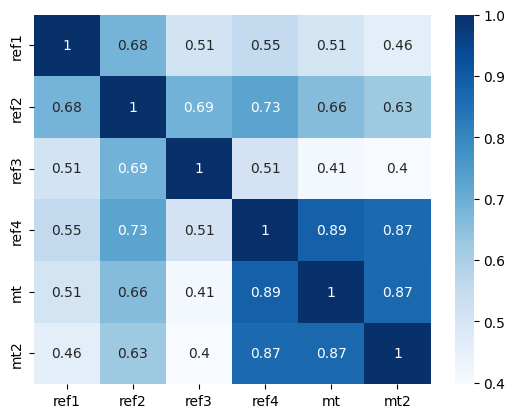

SL_900
src
3020011763176.6636
1193341285325.353
ref1
1604605942689.4792
51020496447.839386
ref2
1440778290460.4805
107495066670.29504
ref3
1461519854593.8813
78815346451.31277
ref4
1194053010583.11
44647027820.10345
mt
906142506466.1003
123348447136.74426
mt2
1470870296121.2715
51604389588.14581
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.674012     0.495839     0.536552   0.492804   
ref2_SL_900     0.674012     1.000000     0.674415     0.712230   0.647410   
ref3_SL_900     0.495839     0.674415     1.000000     0.491734   0.391728   
ref4_SL_900     0.536552     0.712230     0.491734     1.000000   0.890181   
mt_SL_900       0.492804     0.647410     0.391728     0.890181   1.000000   
mt2_SL_900      0.443142     0.611399     0.378409     0.869023   0.879119   

             mt2_SL_900  
ref1_SL_900    0.443142  
ref2_SL_900    0.611399  
ref3_SL_900    0.378409  
ref4_SL_900    0.869023  
mt_SL_900      0.879119  


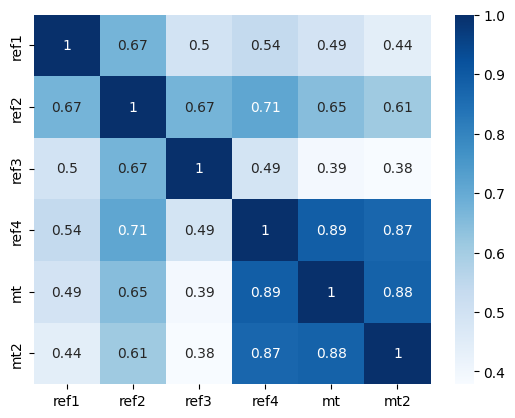

SL_925
src
7676878874728.81
2825871516031.6035
ref1
4178588882103.1343
110137868251.70557
ref2
3669677568031.7896
234588417216.61957
ref3
3780623719702.8237
170378457573.3145
ref4
3069058270437.926
96499228471.37703
mt
2224715716450.513
278002211989.21436
mt2
3762003121351.4976
111134795626.70895
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.665591     0.479885     0.520479   0.478950   
ref2_SL_925     0.665591     1.000000     0.661802     0.698454   0.635017   
ref3_SL_925     0.479885     0.661802     1.000000     0.474011   0.374072   
ref4_SL_925     0.520479     0.698454     0.474011     1.000000   0.893662   
mt_SL_925       0.478950     0.635017     0.374072     0.893662   1.000000   
mt2_SL_925      0.428261     0.597366     0.360137     0.870195   0.887510   

             mt2_SL_925  
ref1_SL_925    0.428261  
ref2_SL_925    0.597366  
ref3_SL_925    0.360137  
ref4_SL_925    0.870195  
mt_SL_925      0.887510  

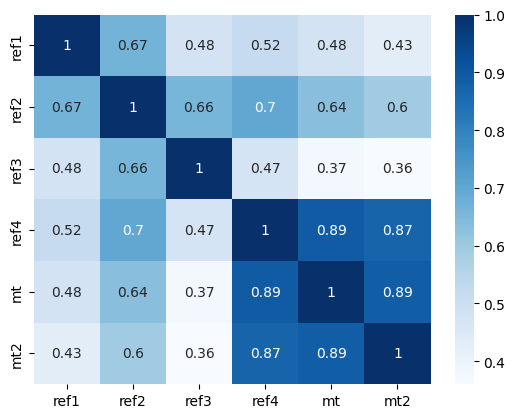

SL_950
src
19589480415784.91
6695745864435.366
ref1
10907619868598.309
238859863940.16364
ref2
9373255204539.533
516599818888.57434
ref3
9813788615817.176
365478133916.435
ref4
7907210958511.894
208684004623.4819
mt
5475545572152.932
626777854002.157
mt2
9646884346737.543
240000056387.9594
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.657242     0.464208     0.504574   0.464899   
ref2_SL_950     0.657242     1.000000     0.649024     0.684470   0.622190   
ref3_SL_950     0.464208     0.649024     1.000000     0.456656   0.356631   
ref4_SL_950     0.504574     0.684470     0.456656     1.000000   0.896488   
mt_SL_950       0.464899     0.622190     0.356631     0.896488   1.000000   
mt2_SL_950      0.413598     0.583215     0.342393     0.871174   0.895229   

             mt2_SL_950  
ref1_SL_950    0.413598  
ref2_SL_950    0.583215  
ref3_SL_950    0.342393  
ref4_SL_950    0.871174  
mt_SL_950      0.895229  
mt2_SL

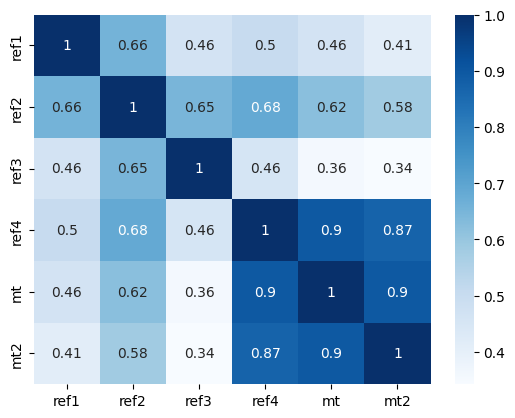

SL_975
src
50173418288827.71
15873783084476.455
ref1
28534694439673.254
515603490049.62897
ref2
24005036008026.92
1129060257953.061
ref3
25558421010299.918
785148552947.3948
ref4
20416557302135.79
450100378810.8449
mt
13508778662998.04
1385114004901.064
mt2
24797447841670.477
518693251920.93085
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.648990     0.448829     0.488867   0.450741   
ref2_SL_975     0.648990     1.000000     0.636112     0.670331   0.609008   
ref3_SL_975     0.448829     0.636112     1.000000     0.439715   0.339487   
ref4_SL_975     0.488867     0.670331     0.439715     1.000000   0.898737   
mt_SL_975       0.450741     0.609008     0.339487     0.898737   1.000000   
mt2_SL_975      0.399192     0.569008     0.325220     0.871989   0.902319   

             mt2_SL_975  
ref1_SL_975    0.399192  
ref2_SL_975    0.569008  
ref3_SL_975    0.325220  
ref4_SL_975    0.871989  
mt_SL_975      0.902319  
m

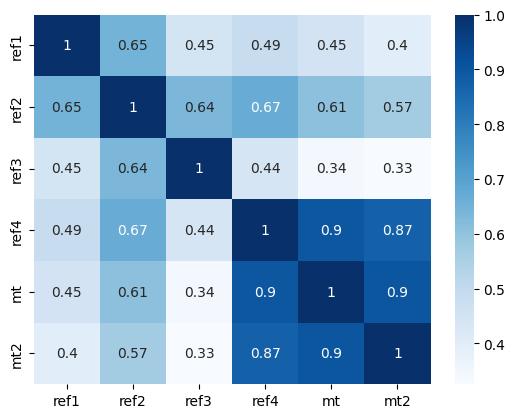

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.38644474031663195
0.385929371119094
ref2
0.38202552472295614
0.38373821137497344
ref3
0.37659002221727195
0.3769380473037267
ref4
0.39111218679052334
0.38886979714687353
mt
0.37856098241729164
0.37916260323175355
mt2
0.37797258552086466
0.3796121685892363
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.668255   0.703200   0.727534  0.595047  0.607558
ref2_gini   0.668255   1.000000   0.726149   0.698902  0.627485  0.646875
ref3_gini   0.703200   0.726149   1.000000   0.693178  0.632673  0.631510
ref4_gini   0.727534   0.698902   0.693178   1.000000  0.619698  0.626394
mt_gini     0.595047   0.627485   0.632673   0.619698  1.000000  0.736592
mt2_gini    0.607558   0.646875   0.631510   0.626394  0.736592  1.000000


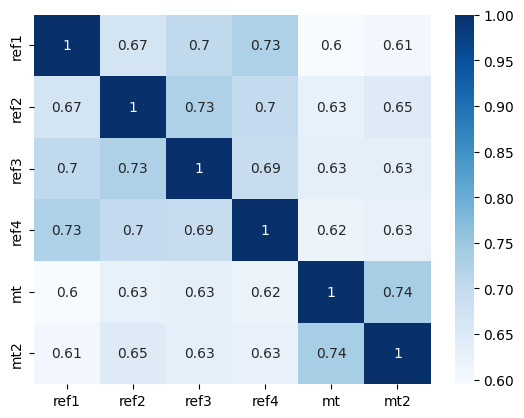

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.638338300471387
-4.767750064131852
ref2
-4.619404107661168
-4.748193500888792
ref3
-4.594596101233034
-4.6933259767328455
ref4
-4.659080806789176
-4.7802569126079835
mt
-4.578983597922014
-4.659500217286231
mt2
-4.6149914795471245
-4.723371024683862
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.972396  0.965803  0.973164  0.946961  0.945741
ref2_kl  0.972396  1.000000  0.976923  0.978622  0.954084  0.951831
ref3_kl  0.965803  0.976923  1.000000  0.970704  0.950869  0.947984
ref4_kl  0.973164  0.978622  0.970704  1.000000  0.952642  0.949858
mt_kl    0.946961  0.954084  0.950869  0.952642  1.000000  0.985162
mt2_kl   0.945741  0.951831  0.947984  0.949858  0.985162  1.000000


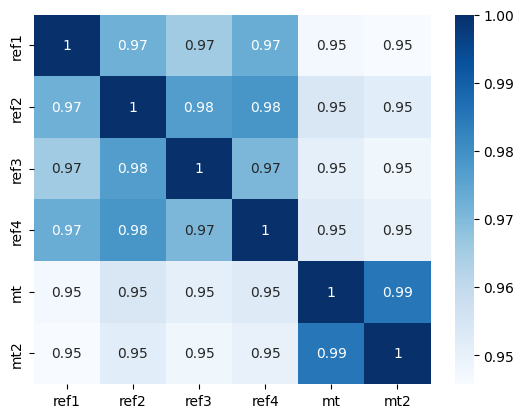

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.7329257741100773
0.7114554256436127
ref2
0.7299832155256781
0.7264396766124577
ref3
0.7123349046091151
0.7013177361701509
ref4
0.7389583457406779
0.7306626629780683
mt
0.7209377618403191
0.7216664638021023
mt2
0.7103310339771421
0.6945430365192136
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.671071  0.706498  0.768013  0.565953  0.659940
ref2_cv  0.671071  1.000000  0.707665  0.691818  0.645998  0.666888
ref3_cv  0.706498  0.707665  1.000000  0.707938  0.603250  0.666657
ref4_cv  0.768013  0.691818  0.707938  1.000000  0.587430  0.690595
mt_cv    0.565953  0.645998  0.603250  0.587430  1.000000  0.706973
mt2_cv   0.659940  0.666888  0.666657  0.690595  0.706973  1.000000


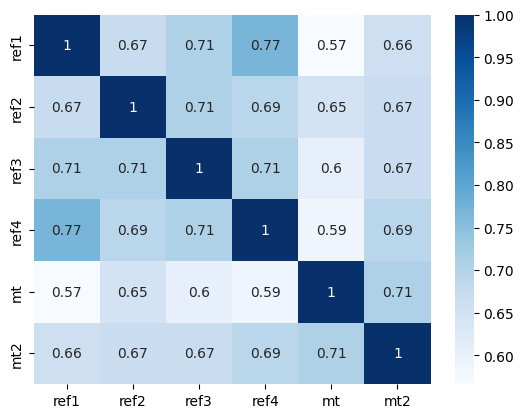

lv
src
72.35425230811832
69.03561950442358
ref1
44.751574169936745
39.00277773160546
ref2
48.5620766665648
43.40540139644081
ref3
46.971792030360895
41.482456389657514
ref4
44.410800964862766
37.978330017842595
mt
47.766712577500755
43.08428242089433
mt2
49.41484485462758
42.68896312017394
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.769066  0.770576  0.822456  0.693092  0.689222
ref2_lv  0.769066  1.000000  0.770776  0.822966  0.739629  0.724891
ref3_lv  0.770576  0.770776  1.000000  0.768429  0.635732  0.629717
ref4_lv  0.822456  0.822966  0.768429  1.000000  0.697407  0.750093
mt_lv    0.693092  0.739629  0.635732  0.697407  1.000000  0.750443
mt2_lv   0.689222  0.724891  0.629717  0.750093  0.750443  1.000000


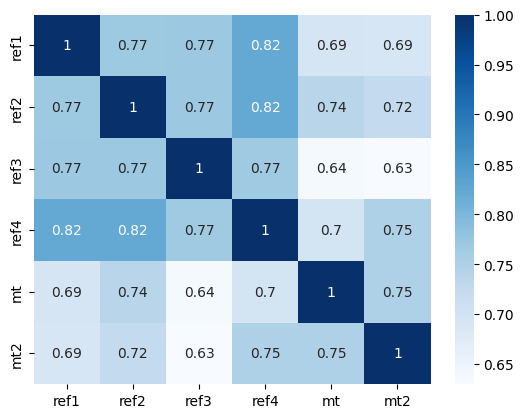

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-790.6190731354552
-721.4234260285656
ref2
-849.2185388318461
-795.4704762318606
ref3
-821.8525922135238
-733.2154297964319
ref4
-792.4585259943989
-699.7344182058557
mt
-848.6018805683296
-782.1100096157827
mt2
-832.2446595965026
-733.645043913784
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.957602    0.959010    0.978869  0.942928   
ref2_renyi    0.957602    1.000000    0.951452    0.956149  0.947181   
ref3_renyi    0.959010    0.951452    1.000000    0.958744  0.933045   
ref4_renyi    0.978869    0.956149    0.958744    1.000000  0.937681   
mt_renyi      0.942928    0.947181    0.933045    0.937681  1.000000   
mt2_renyi     0.958121    0.941234    0.943778    0.958051  0.954529   

            mt2_renyi  
ref1_renyi   0.958121  
ref2_renyi   0.941234  
ref3_renyi   0.943778  
ref4_renyi   0.958051  
mt_renyi     0.954529  
mt2_renyi    1.000000  


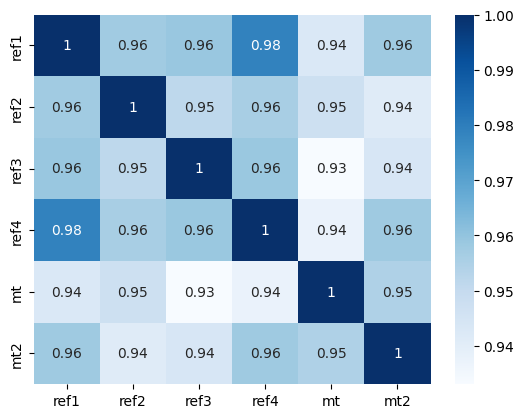

41.78302361451637
27.862388861999136
31.39296109696456
29.97503739284887
27.258151999078844
32.49491327744682


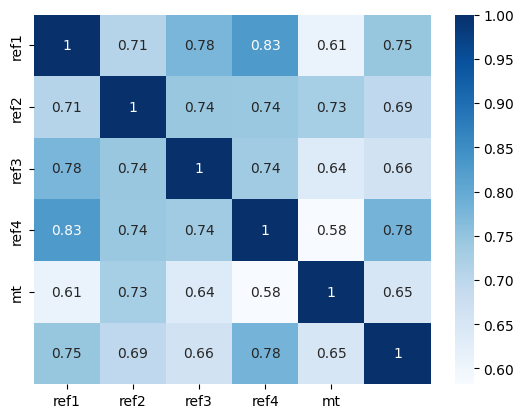

*************************************
27.898808796740674
27.898808796740674
31.44063905721861
30.0199722522994
27.34782539928825
32.69632818594781
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se Spi

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


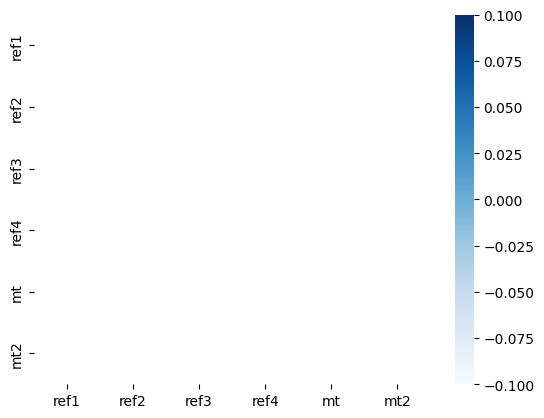

L
src
10.211511127247567
9.91642159210252
ref1
4.7875088079017285
4.659250937919084
ref2
5.1843018944567465
5.074417281093904
ref3
5.721642011820874
5.613611703584324
ref4
4.557266891332942
4.5208909385548575
mt
5.237856476939272
5.138388239928949
mt2
5.299150829892921
5.134557296530288
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.826423  0.689303  0.852679  0.816303  0.781938
ref2_L  0.826423  1.000000  0.680855  0.840560  0.787946  0.765222
ref3_L  0.689303  0.680855  1.000000  0.701914  0.665503  0.659973
ref4_L  0.852679  0.840560  0.701914  1.000000  0.779919  0.751916
mt_L    0.816303  0.787946  0.665503  0.779919  1.000000  0.910988
mt2_L   0.781938  0.765222  0.659973  0.751916  0.910988  1.000000


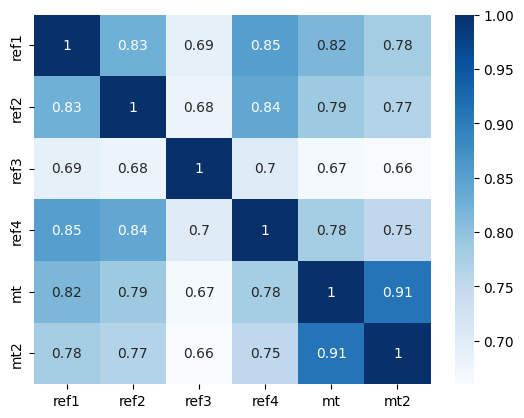

SL_25
src
1.7158199036178436
1.7084754300384066
ref1
1.3551732173602693
1.3571546720185248
ref2
1.3846759035580953
1.3861875169319706
ref3
1.4250474099445
1.4279333004899153
ref4
1.3329390713708
1.3395496114850798
mt
1.3869435622777286
1.3812077177479738
mt2
1.3852410930903103
1.3824214176623926
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.823270    0.754303    0.853935  0.851269   
ref2_SL_25    0.823270    1.000000    0.759481    0.823819  0.816315   
ref3_SL_25    0.754303    0.759481    1.000000    0.748503  0.752133   
ref4_SL_25    0.853935    0.823819    0.748503    1.000000  0.814192   
mt_SL_25      0.851269    0.816315    0.752133    0.814192  1.000000   
mt2_SL_25     0.799970    0.798063    0.738515    0.782185  0.917546   

            mt2_SL_25  
ref1_SL_25   0.799970  
ref2_SL_25   0.798063  
ref3_SL_25   0.738515  
ref4_SL_25   0.782185  
mt_SL_25     0.917546  
mt2_SL_25    1.000000  


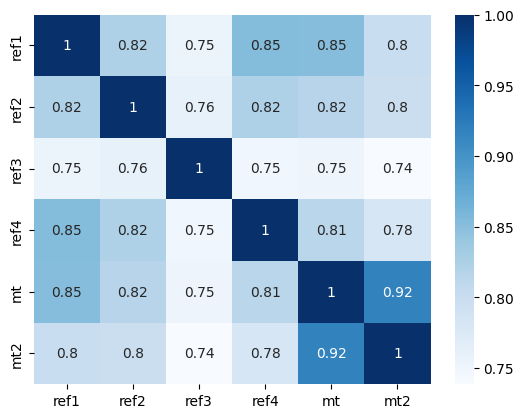

SL_50
src
3.032333587802964
2.994348112198704
ref1
1.9788732738382548
1.961833434866152
ref2
2.061769394501402
2.046385157338534
ref3
2.1755632783790495
2.1750739320000676
ref4
1.9211938849302297
1.9219655874241246
mt
2.0716012260413916
2.0517013549168377
mt2
2.0737003095133817
2.0543154533782166
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.832795    0.725519    0.853568  0.837453   
ref2_SL_50    0.832795    1.000000    0.733596    0.837744  0.809818   
ref3_SL_50    0.725519    0.733596    1.000000    0.728179  0.717381   
ref4_SL_50    0.853568    0.837744    0.728179    1.000000  0.799280   
mt_SL_50      0.837453    0.809818    0.717381    0.799280  1.000000   
mt2_SL_50     0.795729    0.792647    0.710353    0.771175  0.916547   

            mt2_SL_50  
ref1_SL_50   0.795729  
ref2_SL_50   0.792647  
ref3_SL_50   0.710353  
ref4_SL_50   0.771175  
mt_SL_50     0.916547  
mt2_SL_50    1.000000  


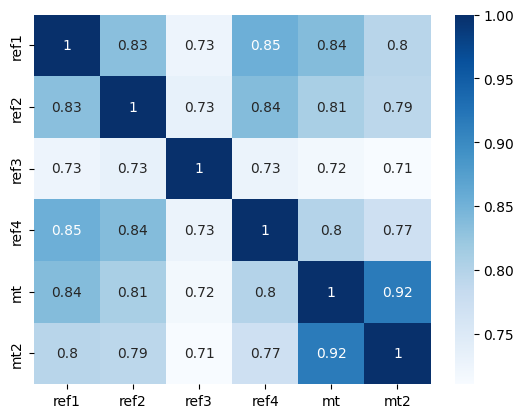

SL_75
src
5.500150418205578
5.387426818826963
ref1
3.0257415911976895
2.9659380904055452
ref2
3.213802106365422
3.169050355873572
ref3
3.4701595922180943
3.4550647843061117
ref4
2.9062589205219234
2.9073246712949925
mt
3.238794180746542
3.16144428390468
mt2
3.2564130397179825
3.2112883756687634
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.833320    0.704947    0.853147  0.826478   
ref2_SL_75    0.833320    1.000000    0.707111    0.843008  0.800505   
ref3_SL_75    0.704947    0.707111    1.000000    0.713640  0.689938   
ref4_SL_75    0.853147    0.843008    0.713640    1.000000  0.788486   
mt_SL_75      0.826478    0.800505    0.689938    0.788486  1.000000   
mt2_SL_75     0.790455    0.780725    0.684695    0.761079  0.914067   

            mt2_SL_75  
ref1_SL_75   0.790455  
ref2_SL_75   0.780725  
ref3_SL_75   0.684695  
ref4_SL_75   0.761079  
mt_SL_75     0.914067  
mt2_SL_75    1.000000  


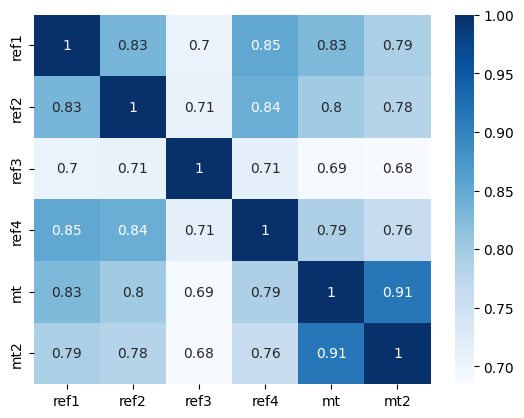

SL_100
src
10.211511127247567
9.91642159210252
ref1
4.7875088079017285
4.659250937919084
ref2
5.1843018944567465
5.074417281093904
ref3
5.721642011820874
5.613611703584324
ref4
4.557266891332942
4.5208909385548575
mt
5.237856476939272
5.138388239928949
mt2
5.299150829892921
5.134557296530288
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.826423     0.689303     0.852679   0.816303   
ref2_SL_100     0.826423     1.000000     0.680855     0.840560   0.787946   
ref3_SL_100     0.689303     0.680855     1.000000     0.701914   0.665503   
ref4_SL_100     0.852679     0.840560     0.701914     1.000000   0.779919   
mt_SL_100       0.816303     0.787946     0.665503     0.779919   1.000000   
mt2_SL_100      0.781938     0.765222     0.659973     0.751916   0.910988   

             mt2_SL_100  
ref1_SL_100    0.781938  
ref2_SL_100    0.765222  
ref3_SL_100    0.659973  
ref4_SL_100    0.751916  
mt_SL_100      0.910988  
mt2_

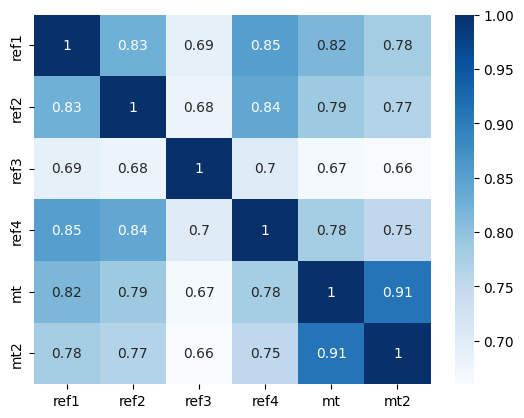

SL_125
src
19.365030885588965
18.687936361637508
ref1
7.791488198244864
7.490008898388041
ref2
8.603122338808713
8.372676566404532
ref3
9.697159291595934
9.391695119257115
ref4
7.359886320032447
7.215699937005882
mt
8.707740472591126
8.398230392927235
mt2
8.88006891819526
8.464294653766965
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.813474     0.676461     0.852670   0.806314   
ref2_SL_125     0.813474     1.000000     0.655044     0.831490   0.772551   
ref3_SL_125     0.676461     0.655044     1.000000     0.691440   0.642061   
ref4_SL_125     0.852670     0.831490     0.691440     1.000000   0.772960   
mt_SL_125       0.806314     0.772551     0.642061     0.772960   1.000000   
mt2_SL_125      0.770225     0.747793     0.634797     0.743718   0.906948   

             mt2_SL_125  
ref1_SL_125    0.770225  
ref2_SL_125    0.747793  
ref3_SL_125    0.634797  
ref4_SL_125    0.743718  
mt_SL_125      0.906948  
mt2_SL

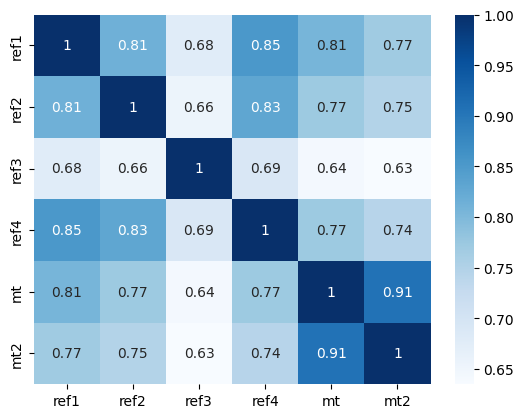

SL_150
src
37.45052879320806
35.78847869113898
ref1
12.996091855166073
12.303131164118584
ref2
14.634280935949851
13.988990805197645
ref3
16.835974227397127
16.22550804752638
ref4
12.193893660955519
11.707611641480359
mt
14.824264764539116
14.044405275921736
mt2
15.266146234260317
14.237428597989851
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.795542     0.665473     0.853427   0.796458   
ref2_SL_150     0.795542     1.000000     0.630362     0.817136   0.755659   
ref3_SL_150     0.665473     0.630362     1.000000     0.682010   0.619471   
ref4_SL_150     0.853427     0.817136     0.682010     1.000000   0.767561   
mt_SL_150       0.796458     0.755659     0.619471     0.767561   1.000000   
mt2_SL_150      0.756022     0.729835     0.609025     0.736695   0.901545   

             mt2_SL_150  
ref1_SL_150    0.756022  
ref2_SL_150    0.729835  
ref3_SL_150    0.609025  
ref4_SL_150    0.736695  
mt_SL_150      0.90154

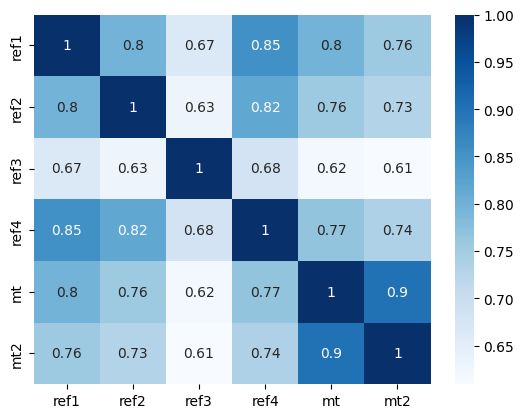

SL_175
src
73.76707514674146
69.69690026132474
ref1
22.16761808702483
20.706331093968828
ref2
25.459445479281452
23.907869913697677
ref3
29.876169968668652
28.462341652368618
ref4
20.6741086258729
19.60760086894155
mt
25.778357036763353
23.799371637009603
mt2
26.8585845218889
24.34463469443533
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.773833     0.656214     0.854995   0.786984   
ref2_SL_175     0.773833     1.000000     0.608091     0.799257   0.739275   
ref3_SL_175     0.656214     0.608091     1.000000     0.674438   0.598856   
ref4_SL_175     0.854995     0.799257     0.674438     1.000000   0.764006   
mt_SL_175       0.786984     0.739275     0.598856     0.764006   1.000000   
mt2_SL_175      0.740409     0.712764     0.583840     0.731278   0.894688   

             mt2_SL_175  
ref1_SL_175    0.740409  
ref2_SL_175    0.712764  
ref3_SL_175    0.583840  
ref4_SL_175    0.731278  
mt_SL_175      0.894688  
mt

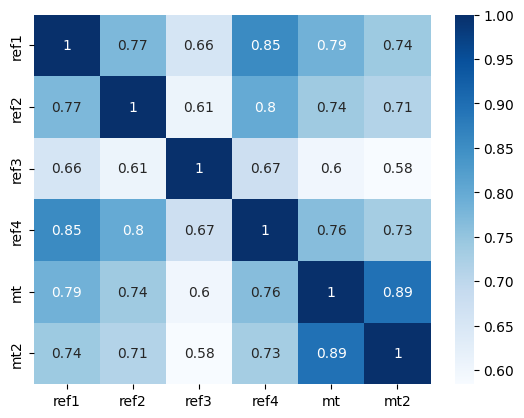

SL_200
src
147.84281085773674
137.00847151636816
ref1
38.61389228314997
35.42234742071875
ref2
45.23141110166056
41.394323869602744
ref3
54.1044444857387
51.21565139653283
ref4
35.81043114875023
33.37149424316617
mt
45.709327513926524
41.07608603357524
mt2
48.28071875664404
42.09753855410411
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.750084     0.649167     0.857227   0.778460   
ref2_SL_200     0.750084     1.000000     0.589907     0.780106   0.725677   
ref3_SL_200     0.649167     0.589907     1.000000     0.670189   0.582120   
ref4_SL_200     0.857227     0.780106     0.670189     1.000000   0.762806   
mt_SL_200       0.778460     0.725677     0.582120     0.762806   1.000000   
mt2_SL_200      0.724937     0.698038     0.561490     0.728105   0.886745   

             mt2_SL_200  
ref1_SL_200    0.724937  
ref2_SL_200    0.698038  
ref3_SL_200    0.561490  
ref4_SL_200    0.728105  
mt_SL_200      0.886745  
mt2_

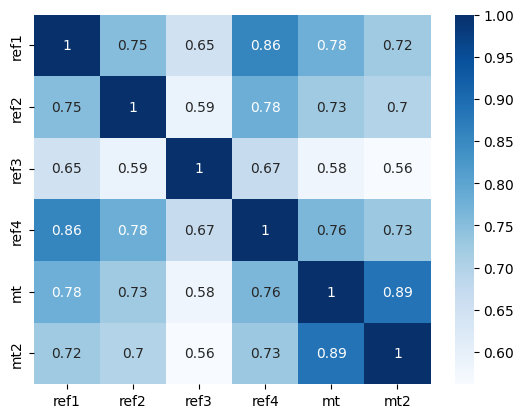

SL_225
src
301.2466761680831
275.52337897331546
ref1
68.63632578687115
61.13508155039078
ref2
81.98189916399294
72.58517316846124
ref3
99.88277663684967
94.3563793028482
ref4
63.30511715702853
57.59543544450516
mt
82.5505811611292
71.53884019299714
mt2
88.58125480086227
74.68891745603491
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.726689     0.645167     0.859869   0.771819   
ref2_SL_225     0.726689     1.000000     0.577495     0.762307   0.716950   
ref3_SL_225     0.645167     0.577495     1.000000     0.670840   0.571402   
ref4_SL_225     0.859869     0.762307     0.670840     1.000000   0.764592   
mt_SL_225       0.771819     0.716950     0.571402     0.764592   1.000000   
mt2_SL_225      0.711630     0.687026     0.544695     0.727883   0.878589   

             mt2_SL_225  
ref1_SL_225    0.711630  
ref2_SL_225    0.687026  
ref3_SL_225    0.544695  
ref4_SL_225    0.727883  
mt_SL_225      0.878589  
mt2_SL_2

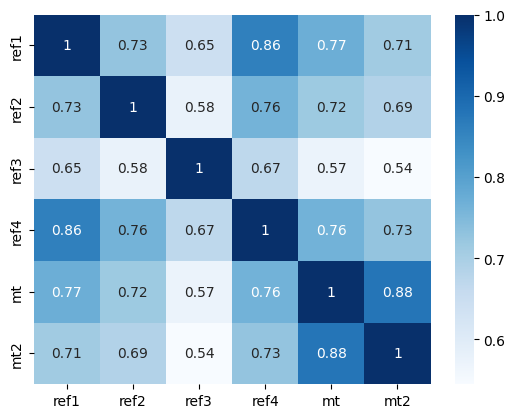

SL_250
src
623.645866435032
555.8978641182189
ref1
124.45554073229654
106.38635634613254
ref2
151.49673395548638
128.29221221925178
ref3
187.82885255867745
173.99325875025738
ref4
114.14516121749925
101.87407191384105
mt
151.7326624252881
125.62166823252556
mt2
165.76824531179594
135.96233347661206
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.706451     0.645013     0.862653   0.768256   
ref2_SL_250     0.706451     1.000000     0.572104     0.748479   0.714506   
ref3_SL_250     0.645013     0.572104     1.000000     0.677406   0.568383   
ref4_SL_250     0.862653     0.748479     0.677406     1.000000   0.769907   
mt_SL_250       0.768256     0.714506     0.568383     0.769907   1.000000   
mt2_SL_250      0.702600     0.680788     0.535772     0.731087   0.871505   

             mt2_SL_250  
ref1_SL_250    0.702600  
ref2_SL_250    0.680788  
ref3_SL_250    0.535772  
ref4_SL_250    0.731087  
mt_SL_250      0.871505

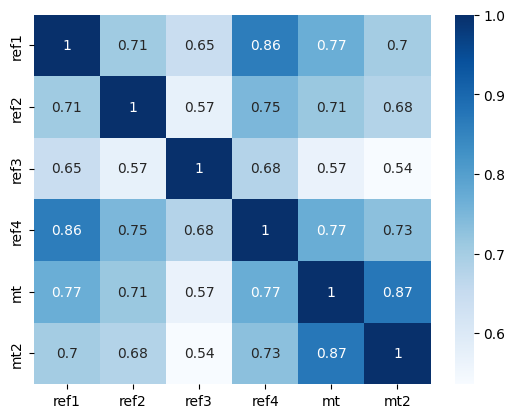

SL_275
src
1310.977397071309
1132.7542992350716
ref1
230.21498276806994
185.5180111473307
ref2
285.3060147727858
227.4989012593473
ref3
359.58784548603165
315.73706242720334
ref4
209.87206947424738
179.31935924296448
mt
283.7236459628586
226.67375354195656
mt2
316.29195253113323
245.47452318112744
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.691964     0.649063     0.865373   0.768807   
ref2_SL_275     0.691964     1.000000     0.574214     0.740707   0.718762   
ref3_SL_275     0.649063     0.574214     1.000000     0.689830   0.573625   
ref4_SL_275     0.865373     0.740707     0.689830     1.000000   0.778860   
mt_SL_275       0.768807     0.718762     0.573625     0.778860   1.000000   
mt2_SL_275      0.699346     0.679880     0.535784     0.737654   0.866858   

             mt2_SL_275  
ref1_SL_275    0.699346  
ref2_SL_275    0.679880  
ref3_SL_275    0.535784  
ref4_SL_275    0.737654  
mt_SL_275      0.866858 

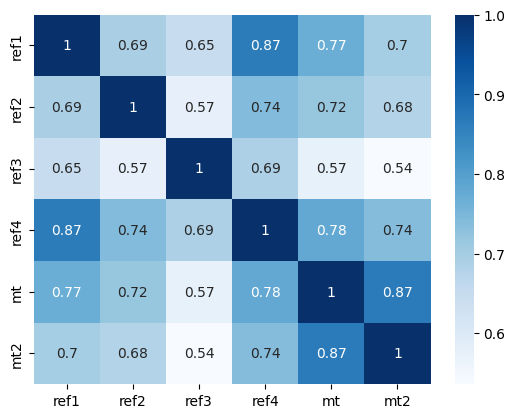

SL_300
src
2796.8218905645454
2387.612248532461
ref1
434.5301365676123
333.2433885510778
ref2
547.4024022879827
412.7476114088422
ref3
700.543813816721
584.6881641165505
ref4
393.48079063139
318.4589667221451
mt
539.6173045635662
417.3992929961969
mt2
615.2021883293087
453.5176147052333
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.684912     0.657002     0.867924   0.773791   
ref2_SL_300     0.684912     1.000000     0.583428     0.740060   0.729076   
ref3_SL_300     0.657002     0.583428     1.000000     0.706958   0.586211   
ref4_SL_300     0.867924     0.740060     0.706958     1.000000   0.790814   
mt_SL_300       0.773791     0.729076     0.586211     0.790814   1.000000   
mt2_SL_300      0.702182     0.684268     0.544148     0.746873   0.865645   

             mt2_SL_300  
ref1_SL_300    0.702182  
ref2_SL_300    0.684268  
ref3_SL_300    0.544148  
ref4_SL_300    0.746873  
mt_SL_300      0.865645  
mt2_SL_30

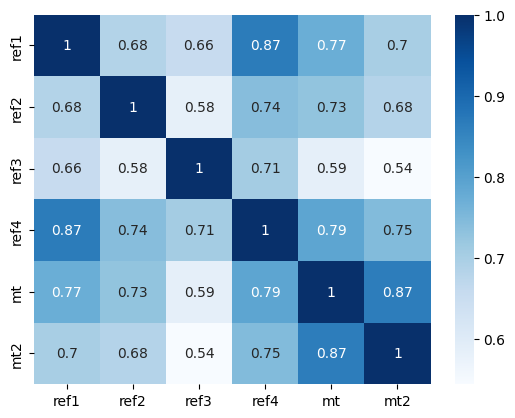

SL_325
src
6052.440412343158
5067.499631975445
ref1
837.2017016334761
611.9109950052277
ref2
1069.7217167340962
753.5965824534851
ref3
1388.3613030758231
1065.8925938035252
ref4
752.3508704121886
569.4539891705246
mt
1043.8542423812762
751.2186984868131
mt2
1219.6863833081184
845.2281943895398
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.685675     0.667932     0.870280   0.782525   
ref2_SL_325     0.685675     1.000000     0.598618     0.746414   0.743993   
ref3_SL_325     0.667932     0.598618     1.000000     0.726976   0.603938   
ref4_SL_325     0.870280     0.746414     0.726976     1.000000   0.804375   
mt_SL_325       0.782525     0.743993     0.603938     0.804375   1.000000   
mt2_SL_325      0.710218     0.693381     0.558914     0.757575   0.868158   

             mt2_SL_325  
ref1_SL_325    0.710218  
ref2_SL_325    0.693381  
ref3_SL_325    0.558914  
ref4_SL_325    0.757575  
mt_SL_325      0.868158  
mt

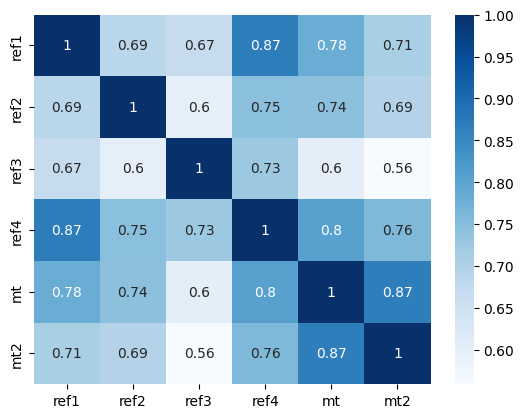

SL_350
src
13279.478374280556
10815.499306469592
ref1
1647.0892742926674
1120.003162013619
ref2
2128.4711800719488
1376.634930136027
ref3
2798.1157261724384
1968.414076978067
ref4
1467.3083864752298
1055.7704787131768
mt
2053.962889036941
1371.5128773210781
mt2
2464.5851888314996
1598.0139614055129
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.693440     0.680669     0.872456   0.793572   
ref2_SL_350     0.693440     1.000000     0.618222     0.758672   0.761684   
ref3_SL_350     0.680669     0.618222     1.000000     0.748011   0.623977   
ref4_SL_350     0.872456     0.758672     0.748011     1.000000   0.817787   
mt_SL_350       0.793572     0.761684     0.623977     0.817787   1.000000   
mt2_SL_350      0.721844     0.706261     0.577479     0.768504   0.873966   

             mt2_SL_350  
ref1_SL_350    0.721844  
ref2_SL_350    0.706261  
ref3_SL_350    0.577479  
ref4_SL_350    0.768504  
mt_SL_350      0.873966

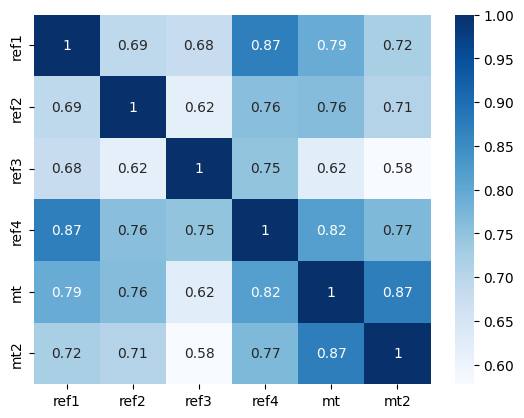

SL_375
src
29526.03133636129
23324.288337065693
ref1
3309.603493064425
2061.5966588207584
ref2
4310.454099262278
2550.458122483751
ref3
5732.8983998142
3716.5213664445128
ref4
2919.2968577164147
1889.7747980272875
mt
4111.458891532566
2540.4465933660895
mt2
5075.106981468457
2970.181463974128
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.706656     0.694076     0.874466   0.805307   
ref2_SL_375     0.706656     1.000000     0.640562     0.775200   0.780395   
ref3_SL_375     0.694076     0.640562     1.000000     0.768554   0.643650   
ref4_SL_375     0.874466     0.775200     0.768554     1.000000   0.829471   
mt_SL_375       0.805307     0.780395     0.643650     0.829471   1.000000   
mt2_SL_375      0.735348     0.721766     0.597310     0.778609   0.882183   

             mt2_SL_375  
ref1_SL_375    0.735348  
ref2_SL_375    0.721766  
ref3_SL_375    0.597310  
ref4_SL_375    0.778609  
mt_SL_375      0.882183  
mt2

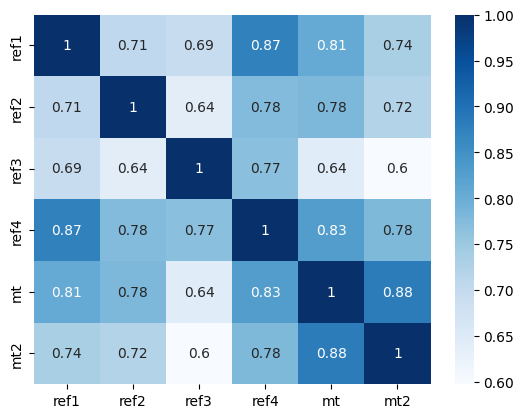

SL_400
src
66494.96119344678
50745.4892341152
ref1
6791.9499432475395
3811.0834829903542
ref2
8879.887777624714
4797.323447086983
ref3
11935.822819271258
7017.701788431362
ref4
5924.8434590887155
3425.3494738540603
mt
8373.16954684981
4717.08653257727
mt2
10647.352817778976
5419.575315042193
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.723538     0.707253     0.876314   0.816405   
ref2_SL_400     0.723538     1.000000     0.664089     0.794262   0.798732   
ref3_SL_400     0.707253     0.664089     1.000000     0.787616   0.660969   
ref4_SL_400     0.876314     0.794262     0.787616     1.000000   0.838399   
mt_SL_400       0.816405     0.798732     0.660969     0.838399   1.000000   
mt2_SL_400      0.749307     0.738743     0.616396     0.787181   0.891814   

             mt2_SL_400  
ref1_SL_400    0.749307  
ref2_SL_400    0.738743  
ref3_SL_400    0.616396  
ref4_SL_400    0.787181  
mt_SL_400      0.891814  
mt2_

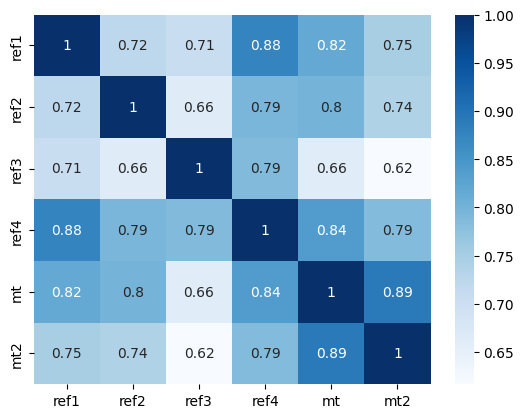

SL_425
src
151605.1445348483
107414.33371279857
ref1
14230.39441930869
6969.096134817373
ref2
18596.47090760507
8838.626046000547
ref3
25239.901751818845
13289.895414874369
ref4
12263.175969098284
6301.709008967706
mt
17349.019110232377
8631.739286297972
mt2
22748.468650529016
10013.574529655978
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.742422     0.719602     0.877995   0.826052   
ref2_SL_425     0.742422     1.000000     0.687527     0.814318   0.815750   
ref3_SL_425     0.719602     0.687527     1.000000     0.804685   0.674795   
ref4_SL_425     0.877995     0.814318     0.804685     1.000000   0.844154   
mt_SL_425       0.826052     0.815750     0.674795     0.844154   1.000000   
mt2_SL_425      0.762732     0.756161     0.633380     0.793842   0.902002   

             mt2_SL_425  
ref1_SL_425    0.762732  
ref2_SL_425    0.756161  
ref3_SL_425    0.633380  
ref4_SL_425    0.793842  
mt_SL_425      0.902002  


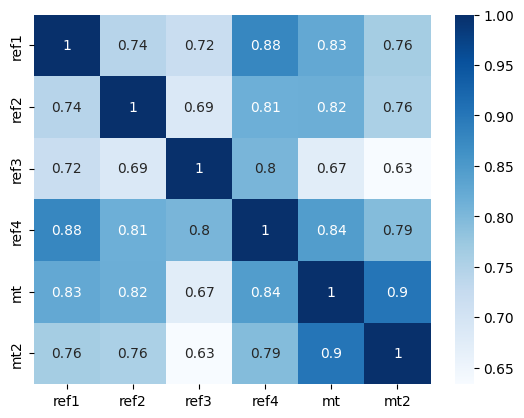

SL_450
src
349750.43900701974
239274.23862115724
ref1
30417.704303114228
13176.365304107268
ref2
39558.63696761485
16266.405150549192
ref3
54178.24952632758
24945.739585459436
ref4
25871.42025087144
11641.426073937939
mt
36566.92758176826
15948.240897563473
mt2
49466.935780093576
19120.98012377992
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.761951     0.730789     0.879498   0.833902   
ref2_SL_450     0.761951     1.000000     0.709924     0.834160   0.830914   
ref3_SL_450     0.730789     0.709924     1.000000     0.819603   0.684717   
ref4_SL_450     0.879498     0.834160     0.819603     1.000000   0.846795   
mt_SL_450       0.833902     0.830914     0.684717     0.846795   1.000000   
mt2_SL_450      0.775027     0.773180     0.647500     0.798461   0.912123   

             mt2_SL_450  
ref1_SL_450    0.775027  
ref2_SL_450    0.773180  
ref3_SL_450    0.647500  
ref4_SL_450    0.798461  
mt_SL_450      0.912123 

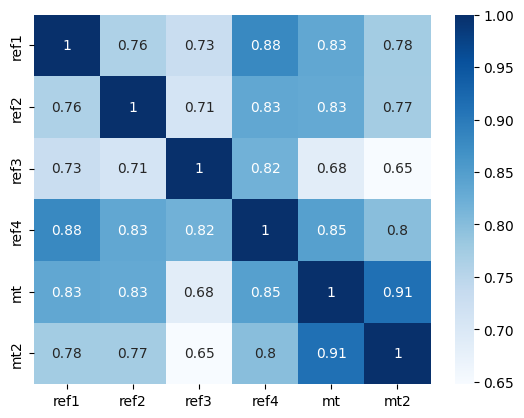

SL_475
src
816009.8847112523
525034.1888591917
ref1
66259.67114689328
24125.988880757097
ref2
85395.86243836166
30385.380614935246
ref3
117968.2491045429
47931.397974726046
ref4
55585.91248821833
21805.882840024307
mt
78376.80463505663
30521.312392660213
mt2
109392.36523195928
36662.77919530238
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.781129     0.740672     0.880814   0.839938   
ref2_SL_475     0.781129     1.000000     0.730640     0.852940   0.843988   
ref3_SL_475     0.740672     0.730640     1.000000     0.832430   0.690814   
ref4_SL_475     0.880814     0.852940     0.832430     1.000000   0.846651   
mt_SL_475       0.839938     0.843988     0.690814     0.846651   1.000000   
mt2_SL_475      0.785896     0.789180     0.658438     0.801075   0.921785   

             mt2_SL_475  
ref1_SL_475    0.785896  
ref2_SL_475    0.789180  
ref3_SL_475    0.658438  
ref4_SL_475    0.801075  
mt_SL_475      0.921785  
m

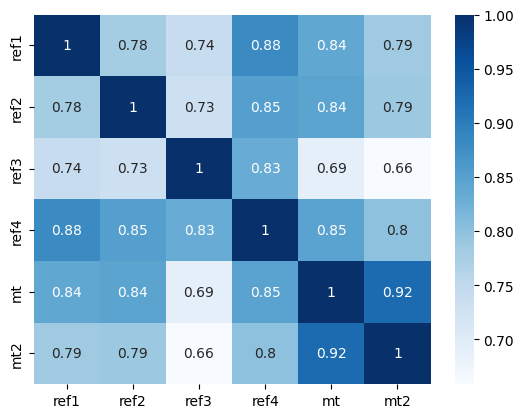

SL_500
src
1924403.405301824
1175499.1198987286
ref1
146885.69315619813
45048.77494770239
ref2
186885.23233553919
56917.61458714573
ref3
260356.56554754748
92889.30648486412
ref4
121493.97451041218
41663.70761467096
mt
170741.97702418716
58579.58375410369
mt2
245783.1054874408
69117.80170741974
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.799287     0.749242     0.881937   0.844322   
ref2_SL_500     0.799287     1.000000     0.749300     0.870126   0.854942   
ref3_SL_500     0.749242     0.749300     1.000000     0.843343   0.693440   
ref4_SL_500     0.881937     0.870126     0.843343     1.000000   0.844162   
mt_SL_500       0.844322     0.854942     0.693440     0.844162   1.000000   
mt2_SL_500      0.795244     0.803744     0.666173     0.801810   0.930768   

             mt2_SL_500  
ref1_SL_500    0.795244  
ref2_SL_500    0.803744  
ref3_SL_500    0.666173  
ref4_SL_500    0.801810  
mt_SL_500      0.930768  
m

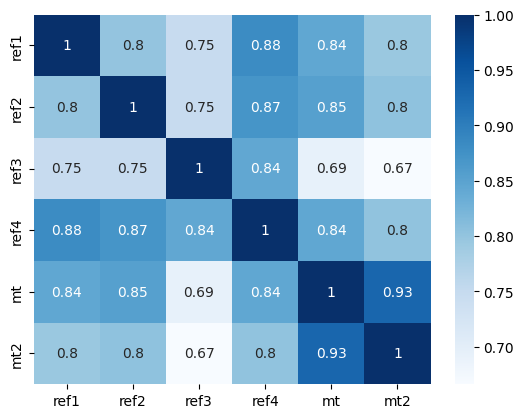

SL_525
src
4584894.057092059
2539933.8119729375
ref1
330839.46829907625
83666.34483680982
ref2
414180.9854944184
106224.9586512048
ref3
581918.859603751
180875.6612190402
ref4
269783.0907758393
76952.25511880132
mt
377769.70101994165
111518.982294855
mt2
560449.3175215671
133363.4961018944
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.816035     0.756558     0.882866   0.847289   
ref2_SL_525     0.816035     1.000000     0.765739     0.885441   0.863866   
ref3_SL_525     0.756558     0.765739     1.000000     0.852569   0.693053   
ref4_SL_525     0.882866     0.885441     0.852569     1.000000   0.839771   
mt_SL_525       0.847289     0.863866     0.693053     0.839771   1.000000   
mt2_SL_525      0.803097     0.816635     0.670866     0.800844   0.938973   

             mt2_SL_525  
ref1_SL_525    0.803097  
ref2_SL_525    0.816635  
ref3_SL_525    0.670866  
ref4_SL_525    0.800844  
mt_SL_525      0.938973  
mt2_SL

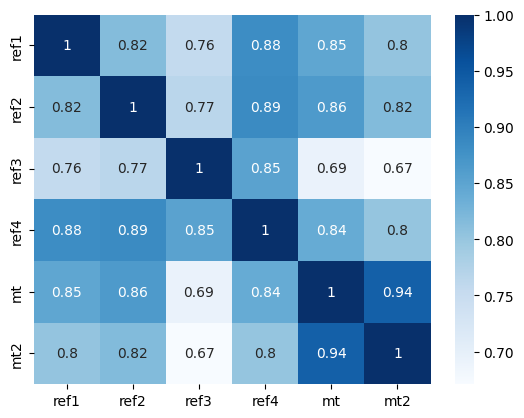

SL_550
src
11029694.493780375
5527291.345079647
ref1
755811.2585579314
161811.24341480102
ref2
928557.7497842198
201156.0607836463
ref3
1315984.7937221723
344819.19642887474
ref4
607724.920551684
142322.5991055366
mt
848107.4085886403
209506.744576975
mt2
1295472.7155814422
255026.35024075187
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.831183     0.762718     0.883603   0.849088   
ref2_SL_550     0.831183     1.000000     0.779938     0.898793   0.870923   
ref3_SL_550     0.762718     0.779938     1.000000     0.860340   0.690127   
ref4_SL_550     0.883603     0.898793     0.860340     1.000000   0.833876   
mt_SL_550       0.849088     0.870923     0.690127     0.833876   1.000000   
mt2_SL_550      0.809552     0.827760     0.672769     0.798368   0.946377   

             mt2_SL_550  
ref1_SL_550    0.809552  
ref2_SL_550    0.827760  
ref3_SL_550    0.672769  
ref4_SL_550    0.798368  
mt_SL_550      0.946377  
mt2

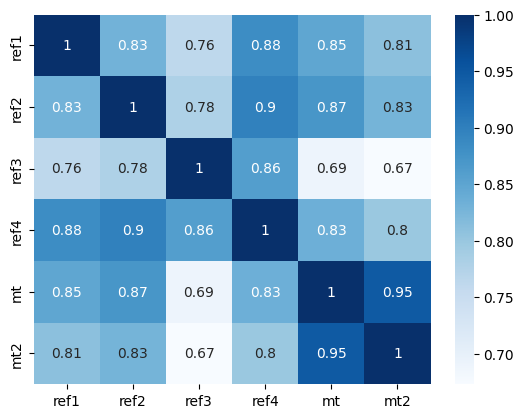

SL_575
src
26777380.81795083
12368663.179223837
ref1
1748279.6939526137
304604.3159117221
ref2
2103605.2727799704
384323.89302734786
ref3
3008331.7227065107
679263.1240076056
ref4
1386647.3890064755
264373.43461000954
mt
1929985.125605749
397590.2676560428
mt2
3031787.7602126654
489062.32051221246
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.844691     0.767833     0.884152   0.849944   
ref2_SL_575     0.844691     1.000000     0.791981     0.910218   0.876307   
ref3_SL_575     0.767833     0.791981     1.000000     0.866876   0.685097   
ref4_SL_575     0.884152     0.910218     0.866876     1.000000   0.826814   
mt_SL_575       0.849944     0.876307     0.685097     0.826814   1.000000   
mt2_SL_575      0.814739     0.837129     0.672177     0.794580   0.952999   

             mt2_SL_575  
ref1_SL_575    0.814739  
ref2_SL_575    0.837129  
ref3_SL_575    0.672177  
ref4_SL_575    0.794580  
mt_SL_575      0.952999 

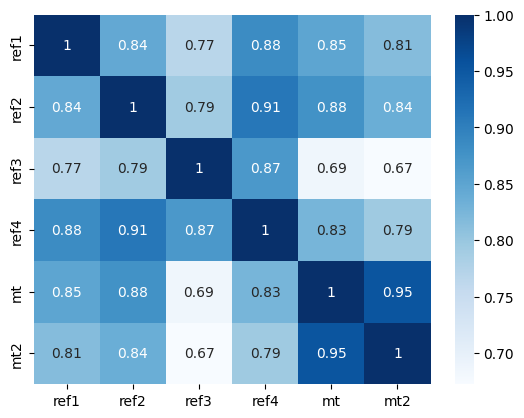

SL_600
src
65571469.76712747
27455892.468231287
ref1
4087716.3152025826
565209.9496715947
ref2
4810686.868639782
736196.2797086064
ref3
6945085.892591687
1321213.1570264304
ref4
3199848.0188222905
493605.31281066383
mt
4446717.734947516
756423.827053312
mt2
7174981.39348228
940294.4424037258
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.856610     0.772013     0.884523   0.850055   
ref2_SL_600     0.856610     1.000000     0.802014     0.919830   0.880224   
ref3_SL_600     0.772013     0.802014     1.000000     0.872369   0.678345   
ref4_SL_600     0.884523     0.919830     0.872369     1.000000   0.818858   
mt_SL_600       0.850055     0.880224     0.678345     0.818858   1.000000   
mt2_SL_600      0.818804     0.844825     0.669392     0.789663   0.958882   

             mt2_SL_600  
ref1_SL_600    0.818804  
ref2_SL_600    0.844825  
ref3_SL_600    0.669392  
ref4_SL_600    0.789663  
mt_SL_600      0.958882  
mt2_

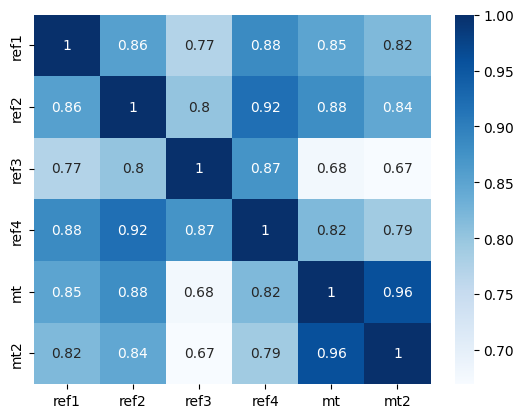

SL_625
src
161874865.1296033
61125063.16988797
ref1
9645970.787790123
1049737.4003198696
ref2
11094679.58647487
1419093.6061802993
ref3
16177289.077826833
2601180.7605359396
ref4
7456983.066623352
929354.3407421873
mt
10360800.519358978
1458786.014061937
mt2
17150820.535405792
1820993.6516791391
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.867049     0.775361     0.884723   0.849585   
ref2_SL_625     0.867049     1.000000     0.810211     0.927786   0.882876   
ref3_SL_625     0.775361     0.810211     1.000000     0.876986   0.670195   
ref4_SL_625     0.884723     0.927786     0.876986     1.000000   0.810227   
mt_SL_625       0.849585     0.882876     0.670195     0.810227   1.000000   
mt2_SL_625      0.821892     0.850980     0.664706     0.783793   0.964082   

             mt2_SL_625  
ref1_SL_625    0.821892  
ref2_SL_625    0.850980  
ref3_SL_625    0.664706  
ref4_SL_625    0.783793  
mt_SL_625      0.964082  


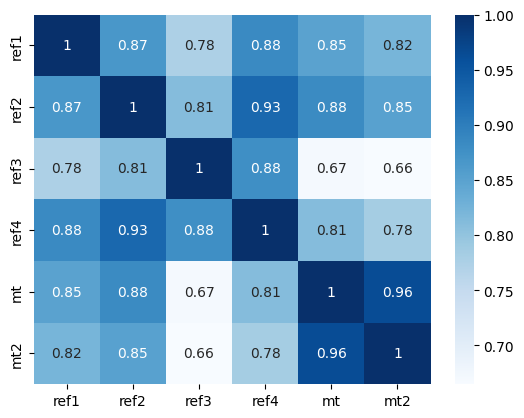

SL_650
src
402663287.21272
136555136.96661842
ref1
22940172.824535377
1956500.884305534
ref2
25780799.34207789
2694520.91816598
ref3
37986200.076539196
5121356.967449062
ref4
17525882.308374546
1749859.1837544735
mt
24383912.399129435
2786541.6984179644
mt2
41362953.35530331
3434983.8263862664
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.876148     0.777970     0.884763   0.848669   
ref2_SL_650     0.876148     1.000000     0.816761     0.934261   0.884455   
ref3_SL_650     0.777970     0.816761     1.000000     0.880867   0.660914   
ref4_SL_650     0.884763     0.934261     0.880867     1.000000   0.801096   
mt_SL_650       0.848669     0.884455     0.660914     0.801096   1.000000   
mt2_SL_650      0.824140     0.855746     0.658392     0.777125   0.968660   

             mt2_SL_650  
ref1_SL_650    0.824140  
ref2_SL_650    0.855746  
ref3_SL_650    0.658392  
ref4_SL_650    0.777125  
mt_SL_650      0.968660  
mt

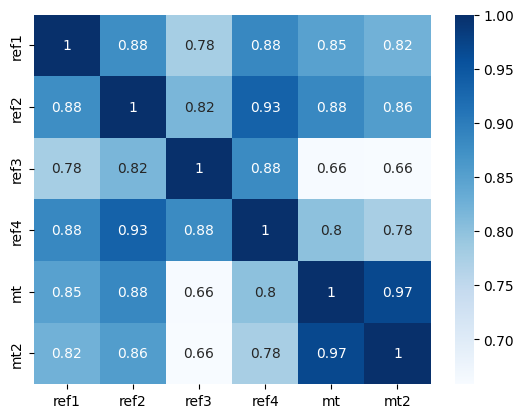

SL_675
src
1008763482.5921872
301100437.7826258
ref1
54915702.34391248
3666977.548702065
ref2
60310859.846404664
5212524.245751543
ref3
89841342.40602599
10214272.014507353
ref4
41490503.54796345
3290829.35400102
mt
57899777.42182671
5280726.224427741
mt2
100544540.43819806
6614218.256028629
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.884054     0.779921     0.884653   0.847418   
ref2_SL_675     0.884054     1.000000     0.821848     0.939433   0.885135   
ref3_SL_675     0.779921     0.821848     1.000000     0.884130   0.650727   
ref4_SL_675     0.884653     0.939433     0.884130     1.000000   0.791604   
mt_SL_675       0.847418     0.885135     0.650727     0.791604   1.000000   
mt2_SL_675      0.825678     0.859291     0.650695     0.769804   0.972676   

             mt2_SL_675  
ref1_SL_675    0.825678  
ref2_SL_675    0.859291  
ref3_SL_675    0.650695  
ref4_SL_675    0.769804  
mt_SL_675      0.972676  
mt2_

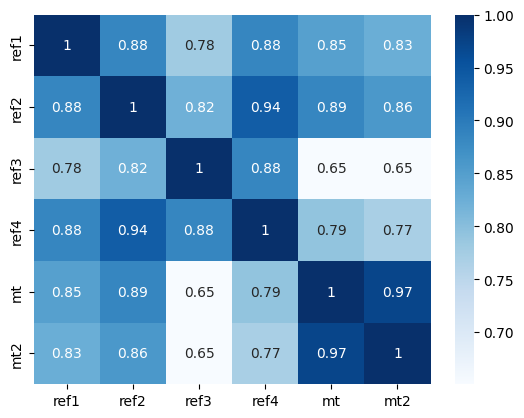

SL_700
src
2543988667.46707
660574048.4768372
ref1
132185057.0520023
6816702.786987491
ref2
141935442.1689807
10038151.911428995
ref3
213856108.31906298
20428241.94976525
ref4
98832500.56252606
6196917.296401878
mt
138564461.87564394
10022540.425773568
mt2
246107606.42202407
12601682.399536308
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.890918     0.781285     0.884403   0.845921   
ref2_SL_700     0.890918     1.000000     0.825649     0.943472   0.885075   
ref3_SL_700     0.781285     0.825649     1.000000     0.886872   0.639818   
ref4_SL_700     0.884403     0.943472     0.886872     1.000000   0.781861   
mt_SL_700       0.845921     0.885075     0.639818     0.781861   1.000000   
mt2_SL_700      0.826623     0.861778     0.641837     0.761954   0.976189   

             mt2_SL_700  
ref1_SL_700    0.826623  
ref2_SL_700    0.861778  
ref3_SL_700    0.641837  
ref4_SL_700    0.761954  
mt_SL_700      0.976189  
mt

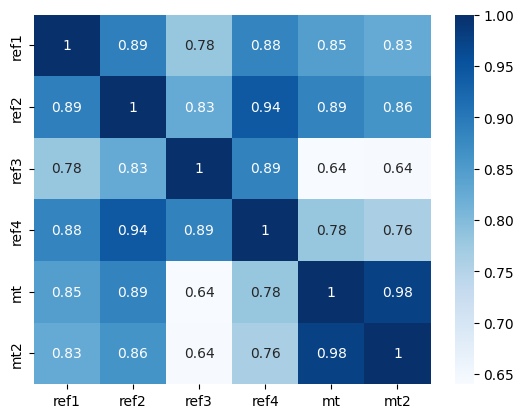

SL_725
src
6455374132.250073
1453516880.8054214
ref1
319639186.9771831
12767369.311908089
ref2
335811199.36436796
19842474.834061652
ref3
511982930.8553798
40252226.30765527
ref4
236659562.93326798
11684106.646934472
mt
333891141.0896542
19048745.991922267
mt2
606112175.2209655
24177426.824229
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.896878     0.782123     0.884023   0.844250   
ref2_SL_725     0.896878     1.000000     0.828324     0.946534   0.884414   
ref3_SL_725     0.782123     0.828324     1.000000     0.889172   0.628342   
ref4_SL_725     0.884023     0.946534     0.889172     1.000000   0.771956   
mt_SL_725       0.844250     0.884414     0.628342     0.771956   1.000000   
mt2_SL_725      0.827078     0.863366     0.632014     0.753687   0.979256   

             mt2_SL_725  
ref1_SL_725    0.827078  
ref2_SL_725    0.863366  
ref3_SL_725    0.632014  
ref4_SL_725    0.753687  
mt_SL_725      0.979256  
mt

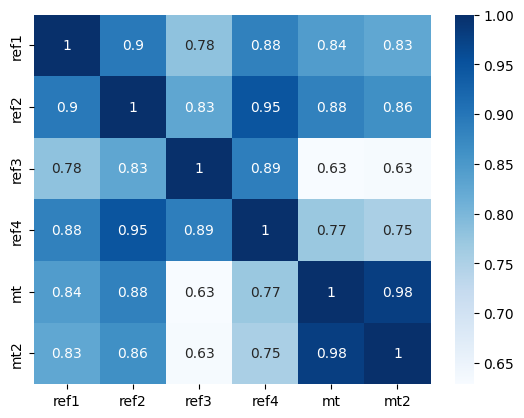

SL_750
src
16474751893.586031
3216083910.8851676
ref1
775885767.0546492
24342619.092590183
ref2
798276653.2911081
38778889.02616273
ref3
1231970282.2541409
80055784.1287497
ref4
569206520.3825469
22484928.330456503
mt
809384746.2324054
35883506.84561695
mt2
1500810077.1842308
46435285.40096208
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.902062     0.782490     0.883522   0.842465   
ref2_SL_750     0.902062     1.000000     0.830017     0.948758   0.883274   
ref3_SL_750     0.782490     0.830017     1.000000     0.891097   0.616425   
ref4_SL_750     0.883522     0.948758     0.891097     1.000000   0.761961   
mt_SL_750       0.842465     0.883274     0.616425     0.761961   1.000000   
mt2_SL_750      0.827137     0.864199     0.621401     0.745101   0.981928   

             mt2_SL_750  
ref1_SL_750    0.827137  
ref2_SL_750    0.864199  
ref3_SL_750    0.621401  
ref4_SL_750    0.745101  
mt_SL_750      0.981928  
mt

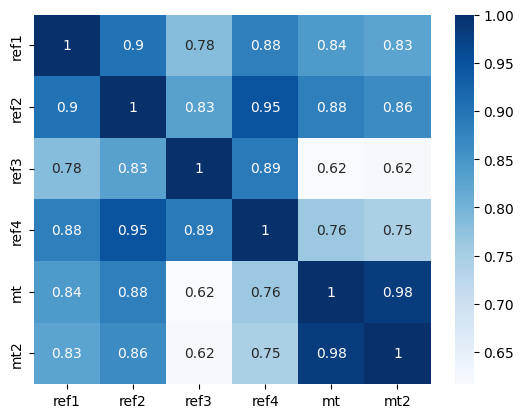

SL_775
src
42269568179.47928
7078075105.309652
ref1
1889377531.5841246
46816187.729986735
ref2
1905636842.9880936
74451607.57045889
ref3
2977879169.5549173
157652461.0506368
ref4
1374161649.217497
42999063.509663045
mt
1972261171.6286235
67609837.65481648
mt2
3733924588.329539
89270783.42634177
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.906585     0.782430     0.882909   0.840614   
ref2_SL_775     0.906585     1.000000     0.830856     0.950267   0.881761   
ref3_SL_775     0.782430     0.830856     1.000000     0.892702   0.604174   
ref4_SL_775     0.882909     0.950267     0.892702     1.000000   0.751935   
mt_SL_775       0.840614     0.881761     0.604174     0.751935   1.000000   
mt2_SL_775      0.826879     0.864410     0.610149     0.736281   0.984252   

             mt2_SL_775  
ref1_SL_775    0.826879  
ref2_SL_775    0.864410  
ref3_SL_775    0.610149  
ref4_SL_775    0.736281  
mt_SL_775      0.984252  
m

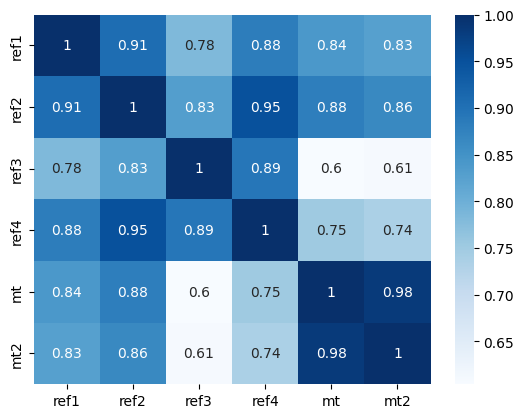

SL_800
src
108987902198.81746
15553008816.681133
ref1
4613102271.444094
90118017.03222242
ref2
4566217447.219274
143076007.41189405
ref3
7226939806.754951
314468712.7929841
ref4
3327935449.936971
82562960.18823972
mt
4827665308.956
128602382.3959825
mt2
9328899202.26546
171869224.36495173
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.910545     0.781985     0.882192   0.838736   
ref2_SL_800     0.910545     1.000000     0.830953     0.951168   0.879965   
ref3_SL_800     0.781985     0.830953     1.000000     0.894031   0.591681   
ref4_SL_800     0.882192     0.951168     0.894031     1.000000   0.741925   
mt_SL_800       0.838736     0.879965     0.591681     0.741925   1.000000   
mt2_SL_800      0.826375     0.864116     0.598390     0.727301   0.986272   

             mt2_SL_800  
ref1_SL_800    0.826375  
ref2_SL_800    0.864116  
ref3_SL_800    0.598390  
ref4_SL_800    0.727301  
mt_SL_800      0.986272  
mt2_SL_

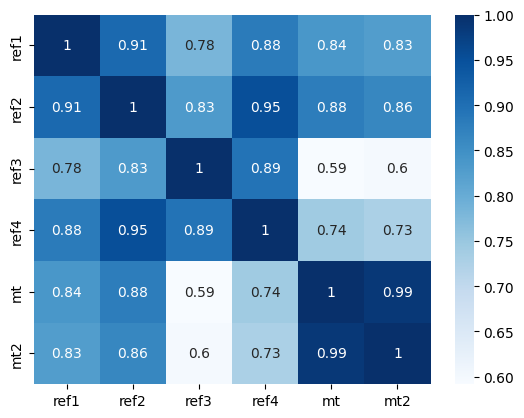

SL_825
src
282299752766.7757
34216605990.864147
ref1
11288359447.977173
173502913.7223177
ref2
10978118463.906914
275190691.3445409
ref3
17601357233.9898
626521615.7546692
ref4
8081059809.006816
160420830.40910226
mt
11863593753.369951
250653022.2421444
mt2
23394310137.254574
333100599.6611322
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.914031     0.781188     0.881378   0.836863   
ref2_SL_825     0.914031     1.000000     0.830405     0.951553   0.877963   
ref3_SL_825     0.781188     0.830405     1.000000     0.895124   0.579021   
ref4_SL_825     0.881378     0.951553     0.895124     1.000000   0.731969   
mt_SL_825       0.836863     0.877963     0.579021     0.731969   1.000000   
mt2_SL_825      0.825686     0.863422     0.586241     0.718224   0.988025   

             mt2_SL_825  
ref1_SL_825    0.825686  
ref2_SL_825    0.863422  
ref3_SL_825    0.586241  
ref4_SL_825    0.718224  
mt_SL_825      0.988025  
mt

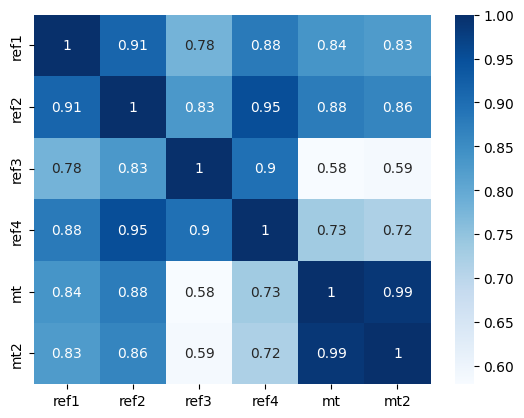

SL_850
src
734302046467.6154
75362205367.15195
ref1
27674218027.111088
331672703.65611076
ref2
26472828399.30464
529711940.94849837
ref3
43004043340.64965
1231446325.7329226
ref4
19667078221.60471
310631018.12502635
mt
29253665212.15041
491887677.87697464
mt2
58860399092.26558
646007613.9406362
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.917116     0.780071     0.880473   0.835022   
ref2_SL_850     0.917116     1.000000     0.829297     0.951498   0.875821   
ref3_SL_850     0.780071     0.829297     1.000000     0.896013   0.566259   
ref4_SL_850     0.880473     0.951498     0.896013     1.000000   0.722101   
mt_SL_850       0.835022     0.875821     0.566259     0.722101   1.000000   
mt2_SL_850      0.824864     0.862418     0.573801     0.709103   0.989546   

             mt2_SL_850  
ref1_SL_850    0.824864  
ref2_SL_850    0.862418  
ref3_SL_850    0.573801  
ref4_SL_850    0.709103  
mt_SL_850      0.989546  
m

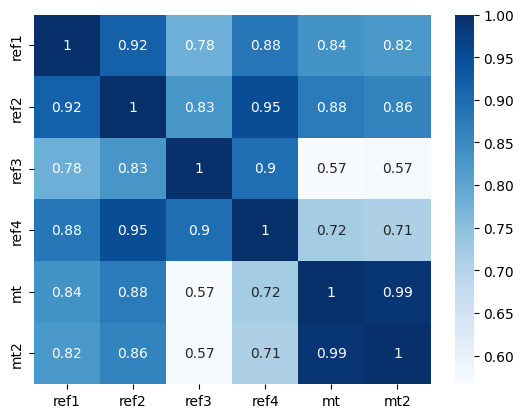

SL_875
src
1917482458681.6265
166811632657.35742
ref1
67951287765.803276
634601762.255014
ref2
64008644890.39806
1020657502.5981307
ref3
105363905270.8216
2450752027.8601856
ref4
47955721155.771736
595203959.2633483
mt
72350126715.93887
965949131.0333691
mt2
148529258450.85587
1253615802.8028202
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.919864     0.778661     0.879483   0.833234   
ref2_SL_875     0.919864     1.000000     0.827701     0.951071   0.873593   
ref3_SL_875     0.778661     0.827701     1.000000     0.896724   0.553452   
ref4_SL_875     0.879483     0.951071     0.896724     1.000000   0.712345   
mt_SL_875       0.833234     0.873593     0.553452     0.712345   1.000000   
mt2_SL_875      0.823952     0.861179     0.561157     0.699986   0.990865   

             mt2_SL_875  
ref1_SL_875    0.823952  
ref2_SL_875    0.861179  
ref3_SL_875    0.561157  
ref4_SL_875    0.699986  
mt_SL_875      0.990865  


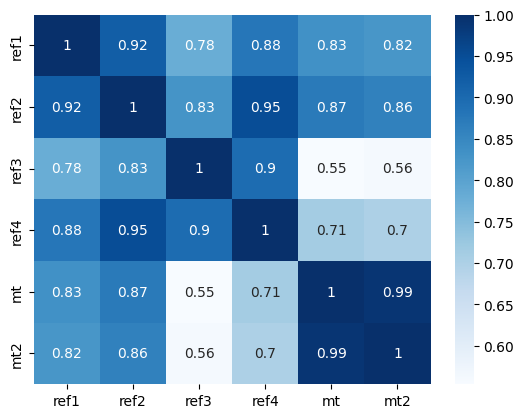

SL_900
src
5025169717931.154
371164455251.421
ref1
167067379468.1135
1215231803.1467364
ref2
155139972061.4799
1981996217.5616992
ref3
258797809280.25537
4885957292.841942
ref4
117123914971.22627
1141600987.2847342
mt
179403547121.38318
1858716001.650289
mt2
375786077389.3764
2434096112.078246
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.922328     0.776981     0.878414   0.831516   
ref2_SL_900     0.922328     1.000000     0.825680     0.950326   0.871325   
ref3_SL_900     0.776981     0.825680     1.000000     0.897281   0.540647   
ref4_SL_900     0.878414     0.950326     0.897281     1.000000   0.702724   
mt_SL_900       0.831516     0.871325     0.540647     0.702724   1.000000   
mt2_SL_900      0.822990     0.859774     0.548385     0.690911   0.992008   

             mt2_SL_900  
ref1_SL_900    0.822990  
ref2_SL_900    0.859774  
ref3_SL_900    0.548385  
ref4_SL_900    0.690911  
mt_SL_900      0.992008  
mt

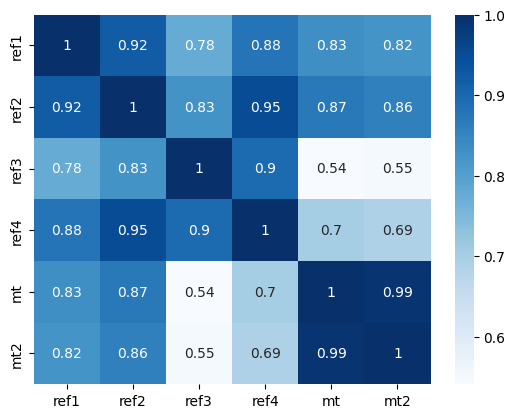

SL_925
src
13213338425008.05
836014175755.9829
ref1
411215834937.4946
2328964045.8564806
ref2
376834455017.16064
3871079723.0581083
ref3
637087080818.5288
9762128709.428875
ref4
286451660501.7004
2185927800.559921
mt
445879128258.0774
3524343611.71274
mt2
952996973282.1396
4728693633.610302
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.924554     0.775054     0.877270   0.829882   
ref2_SL_925     0.924554     1.000000     0.823286     0.949311   0.869054   
ref3_SL_925     0.775054     0.823286     1.000000     0.897704   0.527884   
ref4_SL_925     0.877270     0.949311     0.897704     1.000000   0.693255   
mt_SL_925       0.829882     0.869054     0.527884     0.693255   1.000000   
mt2_SL_925      0.822008     0.858256     0.535549     0.681910   0.993000   

             mt2_SL_925  
ref1_SL_925    0.822008  
ref2_SL_925    0.858256  
ref3_SL_925    0.535549  
ref4_SL_925    0.681910  
mt_SL_925      0.993000  
mt2_S

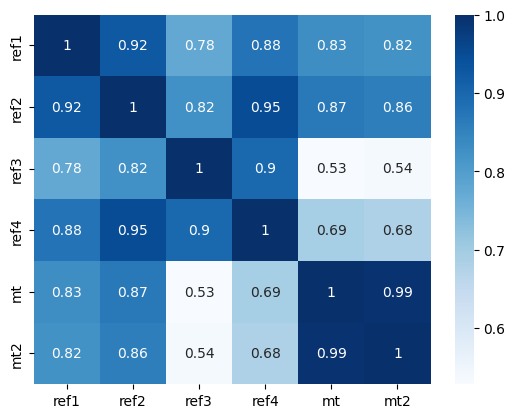

SL_950
src
34850247472212.29
1884283331109.4531
ref1
1013118199135.1278
4466767179.521909
ref2
917120973583.0892
7566561804.726091
ref3
1571463629670.902
19488470560.192375
ref4
701408192414.2809
4185979921.1445665
mt
1110401019082.1833
6704254404.391577
mt2
2421934927759.5195
9190946615.318497
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.926579     0.772899     0.876056   0.828344   
ref2_SL_950     0.926579     1.000000     0.820567     0.948065   0.866812   
ref3_SL_950     0.772899     0.820567     1.000000     0.898009   0.515198   
ref4_SL_950     0.876056     0.948065     0.898009     1.000000   0.683951   
mt_SL_950       0.828344     0.866812     0.515198     0.683951   1.000000   
mt2_SL_950      0.821033     0.856674     0.522704     0.673011   0.993861   

             mt2_SL_950  
ref1_SL_950    0.821033  
ref2_SL_950    0.856674  
ref3_SL_950    0.522704  
ref4_SL_950    0.673011  
mt_SL_950      0.993861  
m

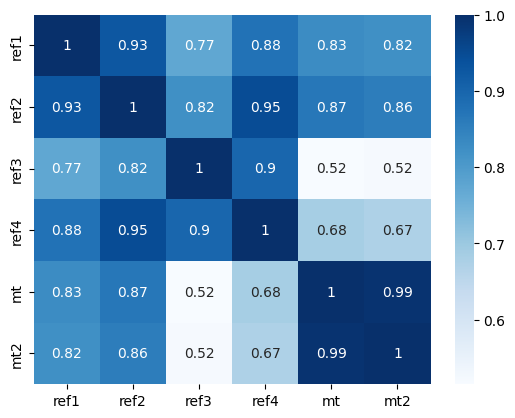

SL_975
src
92178233039508.98
4249520576092.678
ref1
2498060786146.207
8523587909.095896
ref2
2235989473221.2944
14800450738.386806
ref3
3883182676584.1807
38909139975.266556
ref4
1719219597611.568
8021788873.065418
mt
2770249253993.393
12882446044.884008
mt2
6166870665625.95
17872356419.044777
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.928436     0.770532     0.874776   0.826910   
ref2_SL_975     0.928436     1.000000     0.817561     0.946620   0.864624   
ref3_SL_975     0.770532     0.817561     1.000000     0.898213   0.502619   
ref4_SL_975     0.874776     0.946620     0.898213     1.000000   0.674824   
mt_SL_975       0.826910     0.864624     0.502619     0.674824   1.000000   
mt2_SL_975      0.820086     0.855065     0.509898     0.664235   0.994608   

             mt2_SL_975  
ref1_SL_975    0.820086  
ref2_SL_975    0.855065  
ref3_SL_975    0.509898  
ref4_SL_975    0.664235  
mt_SL_975      0.994608  
mt

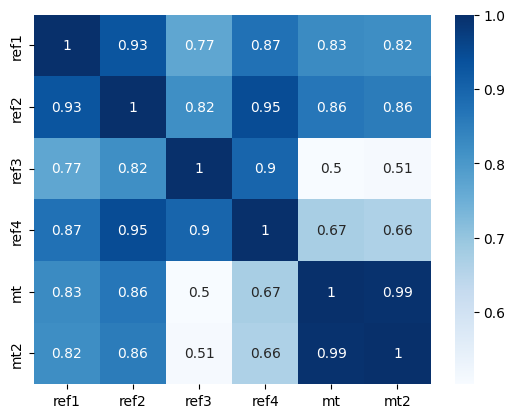

gini
src
0.32971138523171883
0.3342593905576323
ref1
0.42132969710958545
0.42658343653457353
ref2
0.41891476107893466
0.4248179024101282
ref3
0.41125751865610805
0.4178089969386709
ref4
0.4340477382432996
0.43702054449364747
mt
0.416485214803536
0.41927919758186666
mt2
0.4276836822415805
0.4277192372235229
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.701758   0.744347   0.804484  0.778807  0.702849
ref2_gini   0.701758   1.000000   0.709942   0.637942  0.746579  0.760436
ref3_gini   0.744347   0.709942   1.000000   0.658162  0.718722  0.635589
ref4_gini   0.804484   0.637942   0.658162   1.000000  0.707812  0.691387
mt_gini     0.778807   0.746579   0.718722   0.707812  1.000000  0.844579
mt2_gini    0.702849   0.760436   0.635589   0.691387  0.844579  1.000000


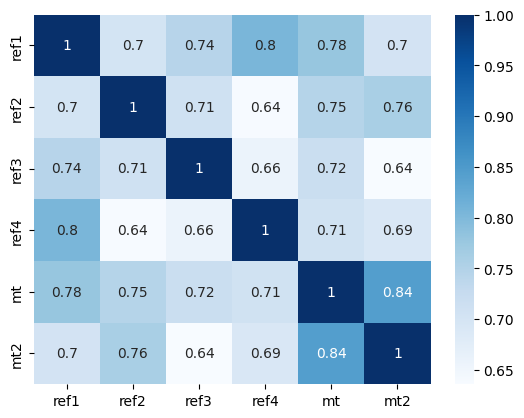

kl
src
-4.6569741162768965
-4.700664247164787
ref1
-4.349303117342762
-4.4174263580170345
ref2
-4.318434047582089
-4.385493256860553
ref3
-4.277791404136203
-4.3104397327693516
ref4
-4.363345425802565
-4.430690615422867
mt
-4.282178185665325
-4.346003193616667
mt2
-4.291501131195245
-4.360666685568036
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.979093  0.961112  0.977602  0.978595  0.972686
ref2_kl  0.979093  1.000000  0.969401  0.973778  0.984765  0.980126
ref3_kl  0.961112  0.969401  1.000000  0.956048  0.974046  0.966051
ref4_kl  0.977602  0.973778  0.956048  1.000000  0.972574  0.965818
mt_kl    0.978595  0.984765  0.974046  0.972574  1.000000  0.988541
mt2_kl   0.972686  0.980126  0.966051  0.965818  0.988541  1.000000


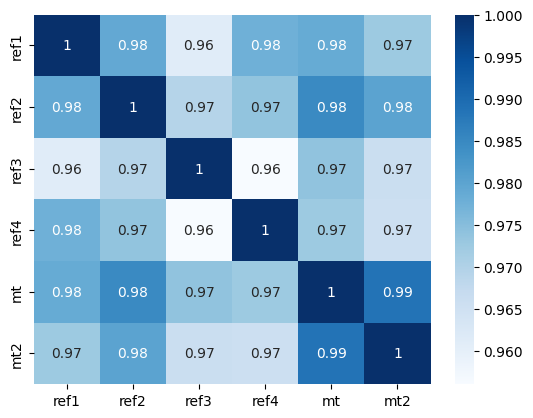

cv
src
0.619461482618071
0.6188531130334651
ref1
0.7894755596756342
0.7783806357795278
ref2
0.7852384991649476
0.7795409258732491
ref3
0.7730672237309728
0.7628784684310204
ref4
0.8180825098791791
0.8107144787732044
mt
0.7736223835318464
0.7613808112237037
mt2
0.8029753288238891
0.7918057808345442
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.657809  0.673181  0.798931  0.772341  0.685500
ref2_cv  0.657809  1.000000  0.676267  0.669711  0.728695  0.710113
ref3_cv  0.673181  0.676267  1.000000  0.655133  0.702144  0.583420
ref4_cv  0.798931  0.669711  0.655133  1.000000  0.743965  0.720943
mt_cv    0.772341  0.728695  0.702144  0.743965  1.000000  0.802793
mt2_cv   0.685500  0.710113  0.583420  0.720943  0.802793  1.000000


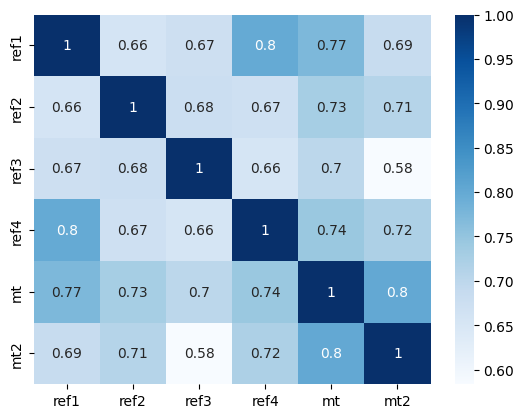

lv
src
70.61660964375977
64.19573431566207
ref1
27.597885875339298
23.096588196833743
ref2
32.368669942152245
27.95396121736445
ref3
36.04231325450917
31.434445039928345
ref4
26.467120236739834
22.12591019961389
mt
30.209702813375678
26.560867608474506
mt2
34.673425289767444
29.597219157372017
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.611993  0.584931  0.745790  0.707829  0.614023
ref2_lv  0.611993  1.000000  0.466204  0.704485  0.721559  0.655543
ref3_lv  0.584931  0.466204  1.000000  0.609964  0.551811  0.435731
ref4_lv  0.745790  0.704485  0.609964  1.000000  0.756536  0.703119
mt_lv    0.707829  0.721559  0.551811  0.756536  1.000000  0.799757
mt2_lv   0.614023  0.655543  0.435731  0.703119  0.799757  1.000000


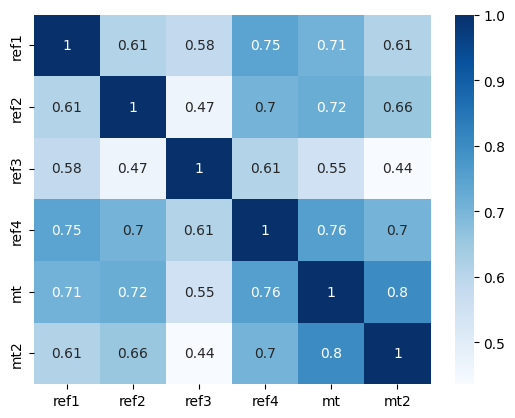

renyi
src
-1211.938583862788
-1159.3914677763003
ref1
-397.2821405167469
-361.70906051000094
ref2
-438.6834750033997
-373.47887096345534
ref3
-490.2544302787899
-430.0573253620729
ref4
-383.01981296030635
-330.25596103947294
mt
-427.0244120494649
-375.04997393328256
mt2
-446.68727514944726
-408.58558991473734
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.952159    0.917375    0.966669  0.956162   
ref2_renyi    0.952159    1.000000    0.920378    0.956908  0.956000   
ref3_renyi    0.917375    0.920378    1.000000    0.918843  0.916707   
ref4_renyi    0.966669    0.956908    0.918843    1.000000  0.953934   
mt_renyi      0.956162    0.956000    0.916707    0.953934  1.000000   
mt2_renyi     0.951098    0.951462    0.911224    0.951640  0.972359   

            mt2_renyi  
ref1_renyi   0.951098  
ref2_renyi   0.951462  
ref3_renyi   0.911224  
ref4_renyi   0.951640  
mt_renyi     0.972359  
mt2_renyi    1.000000  


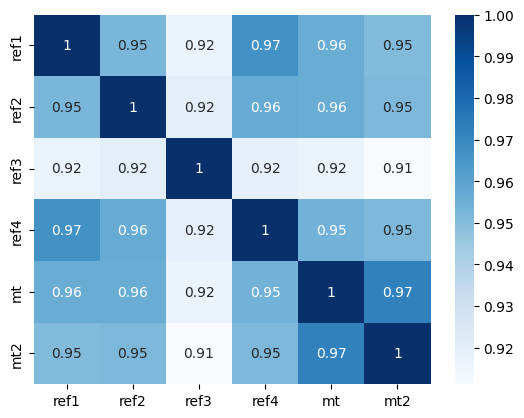

42.02190154044549
15.111888951977878
17.739223411990878
20.375757524087025
14.458406307376691
17.183622976617396


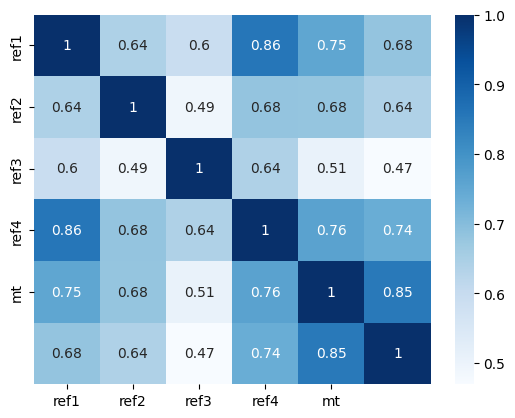

*************************************
15.12392036664164
15.12392036664164
17.765162057049597
20.888425137576615
14.601209760469382
17.216296989897177
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se 

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


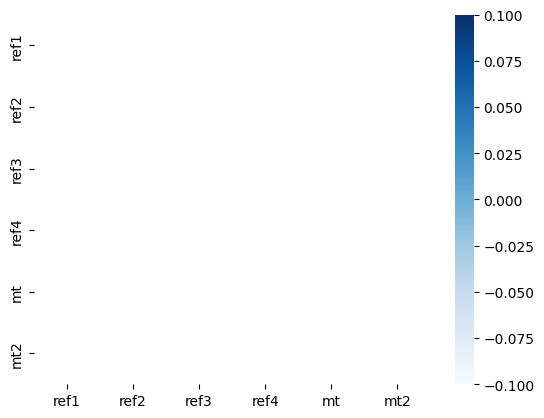

L
src
10.211511127247567
9.91642159210252
ref1
4.696530289589378
4.592569731571006
ref2
4.963956266047389
4.900915201452068
ref3
5.2542101846548155
5.160020049936857
ref4
4.554560801868667
4.507758259095929
mt
5.237856476939272
5.138388239928949
mt2
5.299150829892921
5.134557296530288
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.834302  0.743783  0.858220  0.740843  0.710273
ref2_L  0.834302  1.000000  0.771364  0.861451  0.725780  0.713851
ref3_L  0.743783  0.771364  1.000000  0.750317  0.644171  0.634676
ref4_L  0.858220  0.861451  0.750317  1.000000  0.736526  0.712050
mt_L    0.740843  0.725780  0.644171  0.736526  1.000000  0.910988
mt2_L   0.710273  0.713851  0.634676  0.712050  0.910988  1.000000


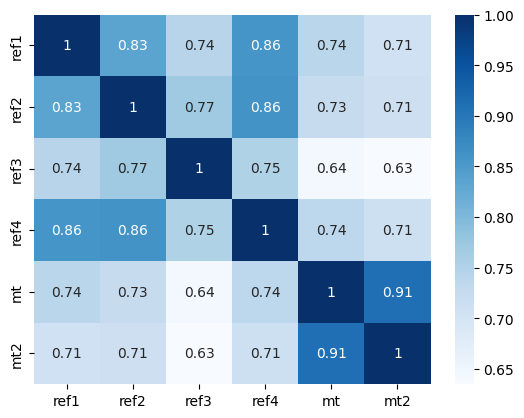

SL_25
src
1.7158199036178436
1.7084754300384066
ref1
1.3463747097144771
1.3501176392141898
ref2
1.3667357664814115
1.3667407627711974
ref3
1.3892401965186212
1.390405428521337
ref4
1.3322901621543506
1.3384485280446787
mt
1.3869435622777286
1.3812077177479738
mt2
1.3852410930903103
1.3824214176623926
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.846866    0.798884    0.869618  0.807536   
ref2_SL_25    0.846866    1.000000    0.811211    0.848318  0.779537   
ref3_SL_25    0.798884    0.811211    1.000000    0.789725  0.732725   
ref4_SL_25    0.869618    0.848318    0.789725    1.000000  0.798215   
mt_SL_25      0.807536    0.779537    0.732725    0.798215  1.000000   
mt2_SL_25     0.764517    0.769530    0.724386    0.768665  0.917546   

            mt2_SL_25  
ref1_SL_25   0.764517  
ref2_SL_25   0.769530  
ref3_SL_25   0.724386  
ref4_SL_25   0.768665  
mt_SL_25     0.917546  
mt2_SL_25    1.000000  


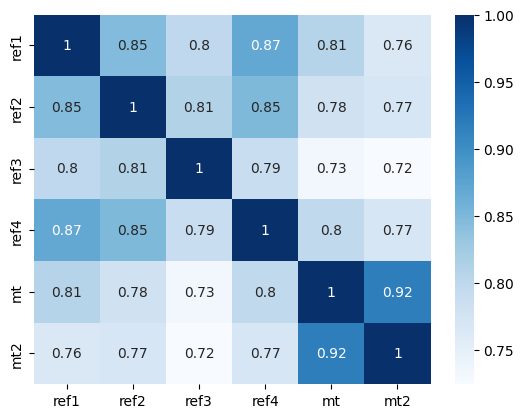

SL_50
src
3.032333587802964
2.994348112198704
ref1
1.9562649662661433
1.954091971326359
ref2
2.013265966112727
2.005612850874624
ref3
2.07561919517887
2.065886769337444
ref4
1.919821959050316
1.9217214876513067
mt
2.0716012260413916
2.0517013549168377
mt2
2.0737003095133817
2.0543154533782166
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.847124    0.777166    0.867585  0.781425   
ref2_SL_50    0.847124    1.000000    0.797172    0.856407  0.759627   
ref3_SL_50    0.777166    0.797172    1.000000    0.772474  0.695526   
ref4_SL_50    0.867585    0.856407    0.772474    1.000000  0.774013   
mt_SL_50      0.781425    0.759627    0.695526    0.774013  1.000000   
mt2_SL_50     0.746394    0.752305    0.690517    0.748569  0.916547   

            mt2_SL_50  
ref1_SL_50   0.746394  
ref2_SL_50   0.752305  
ref3_SL_50   0.690517  
ref4_SL_50   0.748569  
mt_SL_50     0.916547  
mt2_SL_50    1.000000  


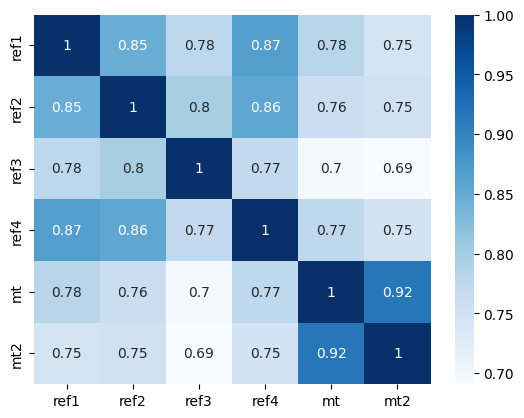

SL_75
src
5.500150418205578
5.387426818826963
ref1
2.978847851740464
2.939648639932682
ref2
3.107111567566683
3.0819008008028077
ref3
3.2462783240497677
3.206567651764805
ref4
2.904098363558723
2.896453428442328
mt
3.238794180746542
3.16144428390468
mt2
3.2564130397179825
3.2112883756687634
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.842295    0.758951    0.863571  0.759715   
ref2_SL_75    0.842295    1.000000    0.783693    0.860487  0.742366   
ref3_SL_75    0.758951    0.783693    1.000000    0.759884  0.667337   
ref4_SL_75    0.863571    0.860487    0.759884    1.000000  0.753947   
mt_SL_75      0.759715    0.742366    0.667337    0.753947  1.000000   
mt2_SL_75     0.728466    0.733251    0.660841    0.729526  0.914067   

            mt2_SL_75  
ref1_SL_75   0.728466  
ref2_SL_75   0.733251  
ref3_SL_75   0.660841  
ref4_SL_75   0.729526  
mt_SL_75     0.914067  
mt2_SL_75    1.000000  


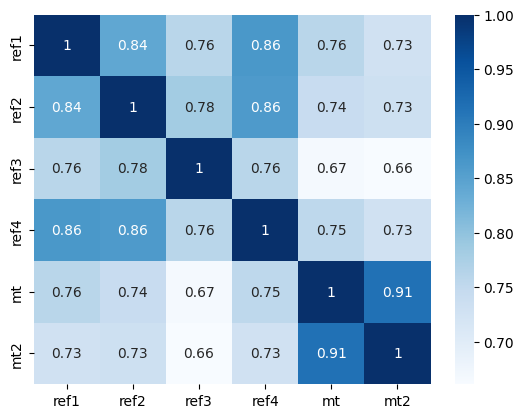

SL_100
src
10.211511127247567
9.91642159210252
ref1
4.696530289589378
4.592569731571006
ref2
4.963956266047389
4.900915201452068
ref3
5.2542101846548155
5.160020049936857
ref4
4.554560801868667
4.507758259095929
mt
5.237856476939272
5.138388239928949
mt2
5.299150829892921
5.134557296530288
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.834302     0.743783     0.858220   0.740843   
ref2_SL_100     0.834302     1.000000     0.771364     0.861451   0.725780   
ref3_SL_100     0.743783     0.771364     1.000000     0.750317   0.644171   
ref4_SL_100     0.858220     0.861451     0.750317     1.000000   0.736526   
mt_SL_100       0.740843     0.725780     0.644171     0.736526   1.000000   
mt2_SL_100      0.710273     0.713851     0.634676     0.712050   0.910988   

             mt2_SL_100  
ref1_SL_100    0.710273  
ref2_SL_100    0.713851  
ref3_SL_100    0.634676  
ref4_SL_100    0.712050  
mt_SL_100      0.910988  
mt2_SL

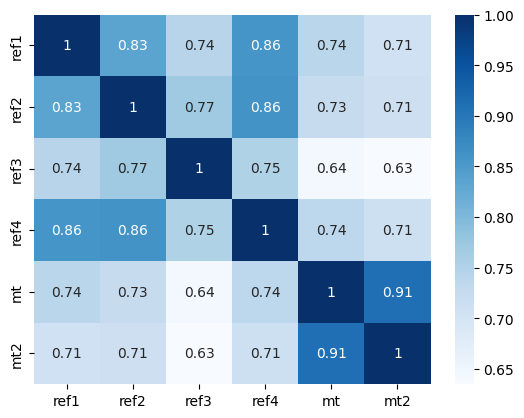

SL_125
src
19.365030885588965
18.687936361637508
ref1
7.619350384010162
7.368434873815235
ref2
8.158312607901484
8.005907556279265
ref3
8.747699515507254
8.52565559508448
ref4
7.357934654788027
7.183938370597971
mt
8.707740472591126
8.398230392927235
mt2
8.88006891819526
8.464294653766965
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.824455     0.730984     0.852571   0.724679   
ref2_SL_125     0.824455     1.000000     0.759841     0.859539   0.709260   
ref3_SL_125     0.730984     0.759841     1.000000     0.742471   0.624056   
ref4_SL_125     0.852571     0.859539     0.742471     1.000000   0.721409   
mt_SL_125       0.724679     0.709260     0.624056     0.721409   1.000000   
mt2_SL_125      0.692619     0.694856     0.611162     0.696493   0.906948   

             mt2_SL_125  
ref1_SL_125    0.692619  
ref2_SL_125    0.694856  
ref3_SL_125    0.611162  
ref4_SL_125    0.696493  
mt_SL_125      0.906948  
mt2_SL_

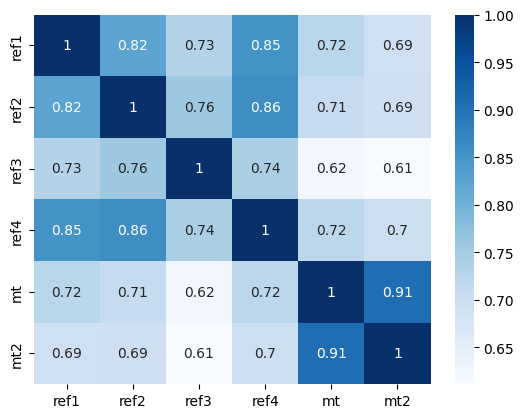

SL_150
src
37.45052879320806
35.78847869113898
ref1
12.672811748154722
12.116126658985438
ref2
13.74232547465455
13.318319331330319
ref3
14.926594936491501
14.415373461011853
ref4
12.196959438953941
11.712721466089606
mt
14.824264764539116
14.044405275921736
mt2
15.266146234260317
14.237428597989851
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.813665     0.720345     0.847455   0.711848   
ref2_SL_150     0.813665     1.000000     0.748967     0.854931   0.693471   
ref3_SL_150     0.720345     0.748967     1.000000     0.735861   0.606751   
ref4_SL_150     0.847455     0.854931     0.735861     1.000000   0.709024   
mt_SL_150       0.711848     0.693471     0.606751     0.709024   1.000000   
mt2_SL_150      0.676787     0.677243     0.590283     0.683489   0.901545   

             mt2_SL_150  
ref1_SL_150    0.676787  
ref2_SL_150    0.677243  
ref3_SL_150    0.590283  
ref4_SL_150    0.683489  
mt_SL_150      0.90154

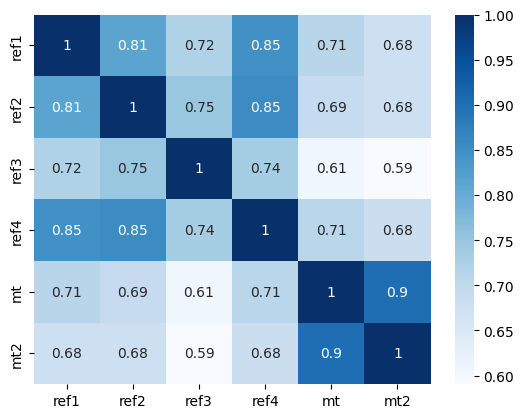

SL_175
src
73.76707514674146
69.69690026132474
ref1
21.559266193694402
20.150089313930394
ref2
23.669250813417605
22.51798047012035
ref3
26.042242887199013
24.86901291299904
ref4
20.694150190794684
19.610561084626134
mt
25.778357036763353
23.799371637009603
mt2
26.8585845218889
24.34463469443533
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.802803     0.712207     0.843560   0.703356   
ref2_SL_175     0.802803     1.000000     0.739070     0.848083   0.679920   
ref3_SL_175     0.712207     0.739070     1.000000     0.730791   0.593141   
ref4_SL_175     0.843560     0.848083     0.730791     1.000000   0.700299   
mt_SL_175       0.703356     0.679920     0.593141     0.700299   1.000000   
mt2_SL_175      0.664329     0.662313     0.572954     0.673990   0.894688   

             mt2_SL_175  
ref1_SL_175    0.664329  
ref2_SL_175    0.662313  
ref3_SL_175    0.572954  
ref4_SL_175    0.673990  
mt_SL_175      0.894688  


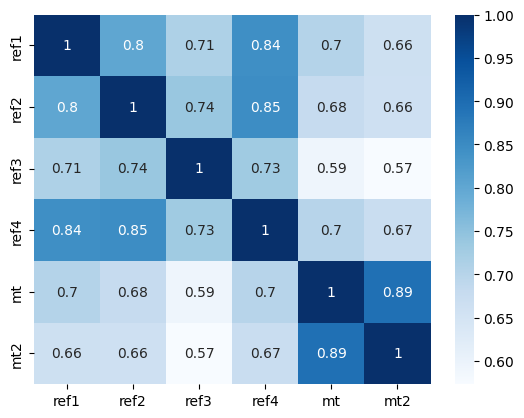

SL_200
src
147.84281085773674
137.00847151636816
ref1
37.45986639113651
34.16034314954152
ref2
41.621552471285355
38.416355942463966
ref3
46.383073825219746
43.2619548506721
ref4
35.878616813657956
33.24768669360259
mt
45.709327513926524
41.07608603357524
mt2
48.28071875664404
42.09753855410411
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.792971     0.707382     0.841533   0.700326   
ref2_SL_200     0.792971     1.000000     0.730991     0.839955   0.670568   
ref3_SL_200     0.707382     0.730991     1.000000     0.728188   0.584753   
ref4_SL_200     0.841533     0.839955     0.728188     1.000000   0.696415   
mt_SL_200       0.700326     0.670568     0.584753     0.696415   1.000000   
mt2_SL_200      0.656912     0.651603     0.560787     0.669123   0.886745   

             mt2_SL_200  
ref1_SL_200    0.656912  
ref2_SL_200    0.651603  
ref3_SL_200    0.560787  
ref4_SL_200    0.669123  
mt_SL_200      0.886745  
m

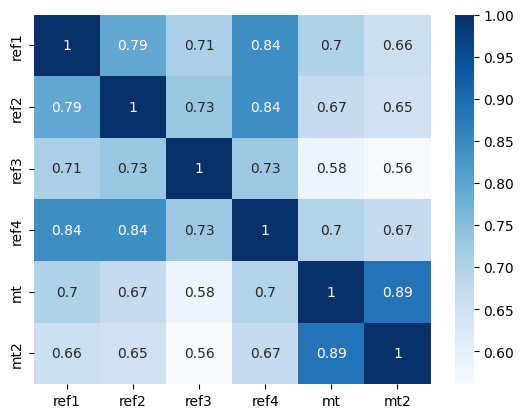

SL_225
src
301.2466761680831
275.52337897331546
ref1
66.42007391833086
58.97147963132186
ref2
74.6549149923996
66.65759171722114
ref3
84.24566833769785
76.12752798154378
ref4
63.499498941635586
57.566013383842545
mt
82.5505811611292
71.53884019299714
mt2
88.58125480086227
74.68891745603491
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.785543     0.706853     0.841933   0.703673   
ref2_SL_225     0.785543     1.000000     0.725900     0.832051   0.667387   
ref3_SL_225     0.706853     0.725900     1.000000     0.729236   0.583228   
ref4_SL_225     0.841933     0.832051     0.729236     1.000000   0.698468   
mt_SL_225       0.703673     0.667387     0.583228     0.698468   1.000000   
mt2_SL_225      0.655974     0.646607     0.555570     0.669861   0.878589   

             mt2_SL_225  
ref1_SL_225    0.655974  
ref2_SL_225    0.646607  
ref3_SL_225    0.555570  
ref4_SL_225    0.669861  
mt_SL_225      0.878589  
mt2_SL

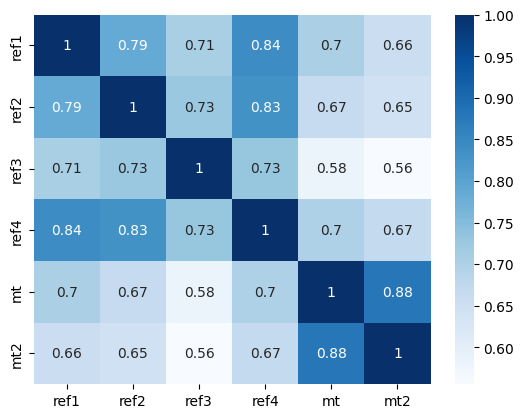

SL_250
src
623.645866435032
555.8978641182189
ref1
120.13274746269799
102.00702099448215
ref2
136.51524166164145
117.35340191420543
ref3
155.93655619782615
136.38187831491766
ref4
114.65672242324625
101.00641603175492
mt
151.7326624252881
125.62166823252556
mt2
165.76824531179594
135.96233347661206
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.781891     0.711281     0.845033   0.713710   
ref2_SL_250     0.781891     1.000000     0.724887     0.826135   0.671786   
ref3_SL_250     0.711281     0.724887     1.000000     0.734814   0.589660   
ref4_SL_250     0.845033     0.826135     0.734814     1.000000   0.707020   
mt_SL_250       0.713710     0.671786     0.589660     0.707020   1.000000   
mt2_SL_250      0.662191     0.648320     0.558512     0.676539   0.871505   

             mt2_SL_250  
ref1_SL_250    0.662191  
ref2_SL_250    0.648320  
ref3_SL_250    0.558512  
ref4_SL_250    0.676539  
mt_SL_250      0.871505

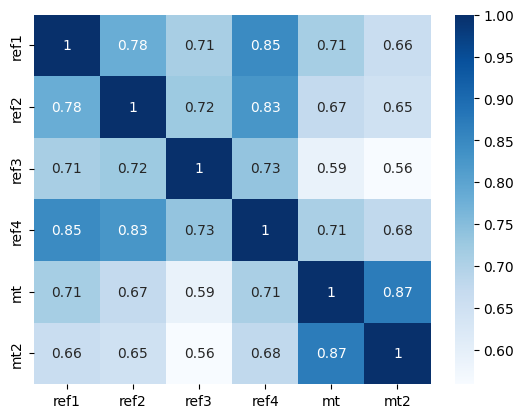

SL_275
src
1310.977397071309
1132.7542992350716
ref1
221.6307644093517
180.77143938684114
ref2
254.4418900055079
209.47868974769008
ref3
294.0217593407484
245.13054821471272
ref4
211.16182292515904
177.54058430589956
mt
283.7236459628586
226.67375354195656
mt2
316.29195253113323
245.47452318112744
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.782906     0.720528     0.850612   0.729798   
ref2_SL_275     0.782906     1.000000     0.728481     0.823680   0.684045   
ref3_SL_275     0.720528     0.728481     1.000000     0.744971   0.603977   
ref4_SL_275     0.850612     0.823680     0.744971     1.000000   0.721649   
mt_SL_275       0.729798     0.684045     0.603977     0.721649   1.000000   
mt2_SL_275      0.675043     0.656796     0.569574     0.688503   0.866858   

             mt2_SL_275  
ref1_SL_275    0.675043  
ref2_SL_275    0.656796  
ref3_SL_275    0.569574  
ref4_SL_275    0.688503  
mt_SL_275      0.866858 

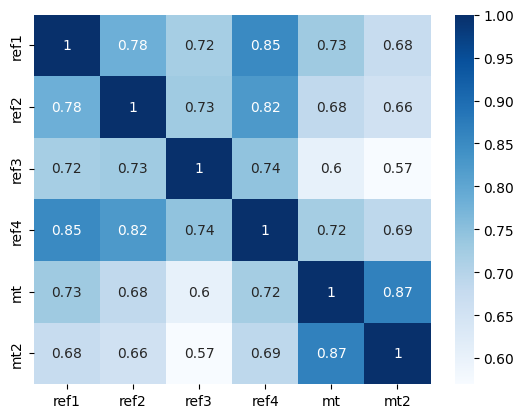

SL_300
src
2796.8218905645454
2387.612248532461
ref1
417.145981347536
322.0957541913243
ref2
483.3516214893679
373.0383869631657
ref3
564.5932722881608
445.8107020178494
ref4
396.6530702241855
315.726933101532
mt
539.6173045635662
417.3992929961969
mt2
615.2021883293087
453.5176147052333
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.788628     0.733535     0.857943   0.750268   
ref2_SL_300     0.788628     1.000000     0.736382     0.825342   0.703025   
ref3_SL_300     0.733535     0.736382     1.000000     0.758772   0.624656   
ref4_SL_300     0.857943     0.825342     0.758772     1.000000   0.740792   
mt_SL_300       0.750268     0.703025     0.624656     0.740792   1.000000   
mt2_SL_300      0.692843     0.671019     0.587280     0.704171   0.865645   

             mt2_SL_300  
ref1_SL_300    0.692843  
ref2_SL_300    0.671019  
ref3_SL_300    0.587280  
ref4_SL_300    0.704171  
mt_SL_300      0.865645  
mt2_SL_3

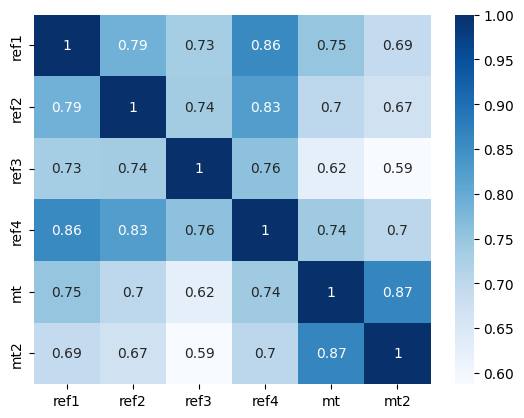

SL_325
src
6052.440412343158
5067.499631975445
ref1
801.2665075697325
583.7964312899603
ref2
935.8900094940353
677.4759894420059
ref3
1103.9534533195945
818.5045177696674
ref4
760.0408536681111
567.9421325343816
mt
1043.8542423812762
751.2186984868131
mt2
1219.6863833081184
845.2281943895398
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.798242     0.748651     0.866049   0.772761   
ref2_SL_325     0.798242     1.000000     0.747541     0.830817   0.726418   
ref3_SL_325     0.748651     0.747541     1.000000     0.774615   0.649015   
ref4_SL_325     0.866049     0.830817     0.774615     1.000000   0.762056   
mt_SL_325       0.772761     0.726418     0.649015     0.762056   1.000000   
mt2_SL_325      0.713288     0.689207     0.609151     0.721517   0.868158   

             mt2_SL_325  
ref1_SL_325    0.713288  
ref2_SL_325    0.689207  
ref3_SL_325    0.609151  
ref4_SL_325    0.721517  
mt_SL_325      0.868158  
mt2_

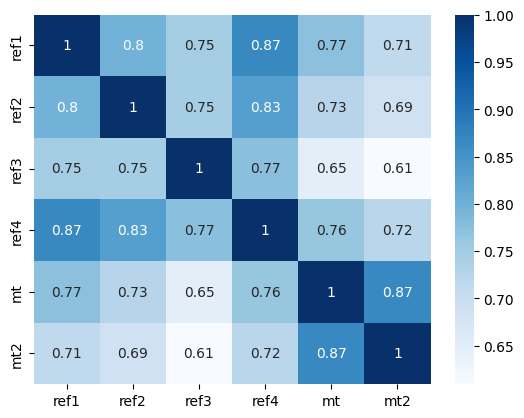

SL_350
src
13279.478374280556
10815.499306469592
ref1
1571.2551374797233
1069.703256938172
ref2
1847.099851859908
1236.5101050266464
ref3
2197.699943011554
1511.3112465937618
ref4
1485.7956811531487
1028.2291130161423
mt
2053.962889036941
1371.5128773210781
mt2
2464.5851888314996
1598.0139614055129
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.810448     0.764169     0.874041   0.794858   
ref2_SL_350     0.810448     1.000000     0.760541     0.839113   0.751435   
ref3_SL_350     0.764169     0.760541     1.000000     0.790787   0.673963   
ref4_SL_350     0.874041     0.839113     0.790787     1.000000   0.782888   
mt_SL_350       0.794858     0.751435     0.673963     0.782888   1.000000   
mt2_SL_350      0.734179     0.709353     0.632458     0.738663   0.873966   

             mt2_SL_350  
ref1_SL_350    0.734179  
ref2_SL_350    0.709353  
ref3_SL_350    0.632458  
ref4_SL_350    0.738663  
mt_SL_350      0.873966

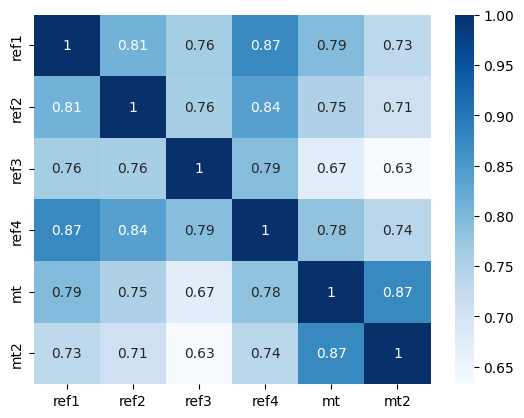

SL_375
src
29526.03133636129
23324.288337065693
ref1
3146.32165243988
1909.8409507603258
ref2
3715.662359533548
2282.2570396702504
ref3
4453.628607779642
2812.7344295018147
ref4
2963.550476193917
1870.4624418582232
mt
4111.458891532566
2540.4465933660895
mt2
5075.106981468457
2970.181463974128
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.823898     0.778734     0.881313   0.814663   
ref2_SL_375     0.823898     1.000000     0.773991     0.849014   0.775571   
ref3_SL_375     0.778734     0.773991     1.000000     0.805899   0.696806   
ref4_SL_375     0.881313     0.849014     0.805899     1.000000   0.801239   
mt_SL_375       0.814663     0.775571     0.696806     0.801239   1.000000   
mt2_SL_375      0.753887     0.729698     0.654868     0.754247   0.882183   

             mt2_SL_375  
ref1_SL_375    0.753887  
ref2_SL_375    0.729698  
ref3_SL_375    0.654868  
ref4_SL_375    0.754247  
mt_SL_375      0.882183  
mt

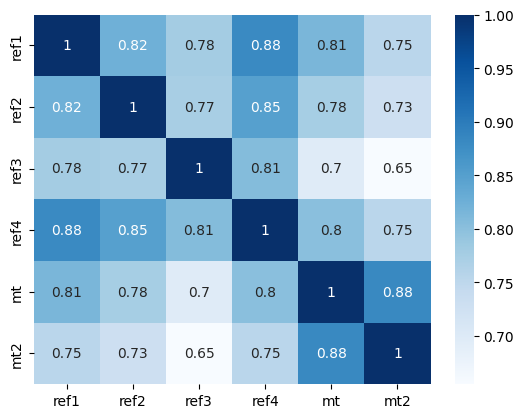

SL_400
src
66494.96119344678
50745.4892341152
ref1
6433.671900679948
3489.1737174749087
ref2
7616.705407401569
4225.621573443465
ref3
9184.828972281539
5351.504054251088
ref4
6030.596269822678
3418.455941358089
mt
8373.16954684981
4717.08653257727
mt2
10647.352817778976
5419.575315042193
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.837499     0.791487     0.887571   0.831081   
ref2_SL_400     0.837499     1.000000     0.786789     0.859426   0.797083   
ref3_SL_400     0.791487     0.786789     1.000000     0.819060   0.715733   
ref4_SL_400     0.887571     0.859426     0.819060     1.000000   0.815901   
mt_SL_400       0.831081     0.797083     0.715733     0.815901   1.000000   
mt2_SL_400      0.771457     0.748958     0.674748     0.767493   0.891814   

             mt2_SL_400  
ref1_SL_400    0.771457  
ref2_SL_400    0.748958  
ref3_SL_400    0.674748  
ref4_SL_400    0.767493  
mt_SL_400      0.891814  
mt2_SL_4

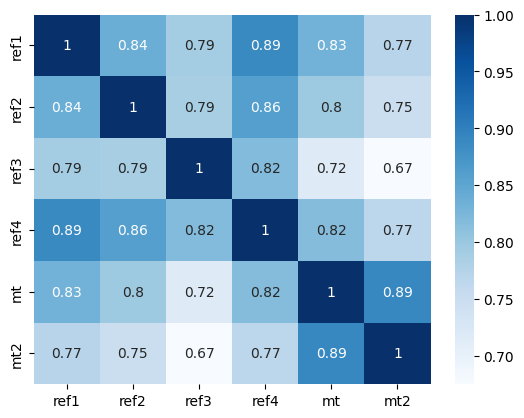

SL_425
src
151605.1445348483
107414.33371279857
ref1
13430.575594060203
6452.325681229313
ref2
15903.570293995983
7830.280546226433
ref3
19269.206159347214
10107.321134332571
ref4
12515.907044689526
6179.822961723855
mt
17349.019110232377
8631.739286297972
mt2
22748.468650529016
10013.574529655978
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.850508     0.802009     0.892743   0.843771   
ref2_SL_425     0.850508     1.000000     0.798191     0.869548   0.815082   
ref3_SL_425     0.802009     0.798191     1.000000     0.829831   0.729879   
ref4_SL_425     0.892743     0.869548     0.829831     1.000000   0.826477   
mt_SL_425       0.843771     0.815082     0.729879     0.826477   1.000000   
mt2_SL_425      0.786482     0.766347     0.691161     0.778098   0.902002   

             mt2_SL_425  
ref1_SL_425    0.786482  
ref2_SL_425    0.766347  
ref3_SL_425    0.691161  
ref4_SL_425    0.778098  
mt_SL_425      0.902002 

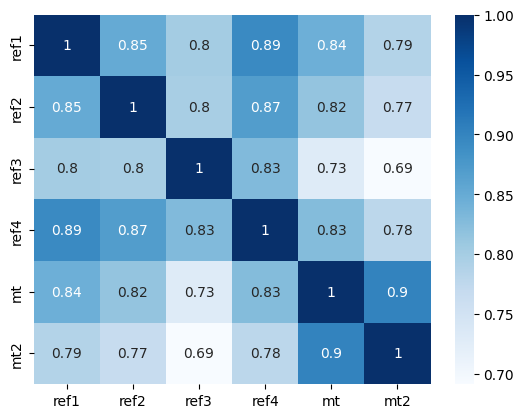

SL_450
src
349750.43900701974
239274.23862115724
ref1
28604.652594415234
11991.479902697327
ref2
33800.833802663925
14536.5790124977
ref3
41100.5227062599
19383.78970821423
ref4
26476.1278977658
11579.574133211856
mt
36566.92758176826
15948.240897563473
mt2
49466.935780093576
19120.98012377992
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.862498     0.810188     0.896883   0.852907   
ref2_SL_450     0.862498     1.000000     0.807776     0.878877   0.829357   
ref3_SL_450     0.810188     0.807776     1.000000     0.838104   0.739122   
ref4_SL_450     0.896883     0.878877     0.838104     1.000000   0.833147   
mt_SL_450       0.852907     0.829357     0.739122     0.833147   1.000000   
mt2_SL_450      0.798906     0.781473     0.703720     0.786063   0.912123   

             mt2_SL_450  
ref1_SL_450    0.798906  
ref2_SL_450    0.781473  
ref3_SL_450    0.703720  
ref4_SL_450    0.786063  
mt_SL_450      0.912123  
mt

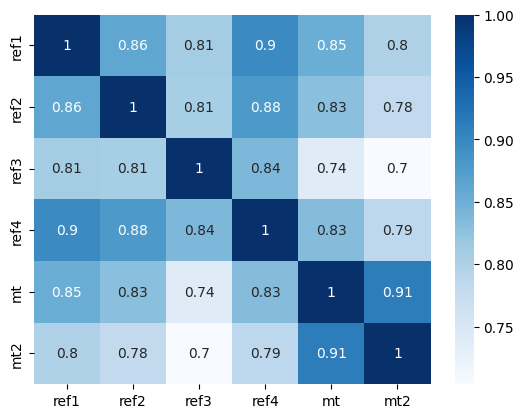

SL_475
src
816009.8847112523
525034.1888591917
ref1
62094.93552760841
22550.40828218472
ref2
73059.16159523887
26861.902299624784
ref3
89064.81195466864
36503.373902749154
ref4
57035.58321042634
21671.195325507968
mt
78376.80463505663
30521.312392660213
mt2
109392.36523195928
36662.77919530238
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.873280     0.816094     0.900102   0.858938   
ref2_SL_475     0.873280     1.000000     0.815362     0.887151   0.840118   
ref3_SL_475     0.816094     0.815362     1.000000     0.843965   0.743791   
ref4_SL_475     0.900102     0.887151     0.843965     1.000000   0.836393   
mt_SL_475       0.858938     0.840118     0.743791     0.836393   1.000000   
mt2_SL_475      0.808869     0.794221     0.712401     0.791559   0.921785   

             mt2_SL_475  
ref1_SL_475    0.808869  
ref2_SL_475    0.794221  
ref3_SL_475    0.712401  
ref4_SL_475    0.791559  
mt_SL_475      0.921785  
mt

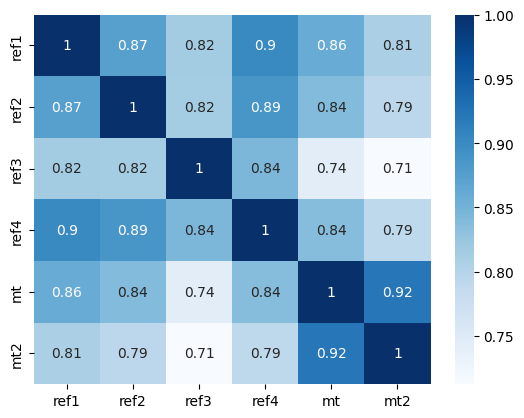

SL_500
src
1924403.405301824
1175499.1198987286
ref1
137210.71064924743
41858.26434891188
ref2
160420.73515261066
50076.22166408488
ref3
195911.7694366913
69039.85465523115
ref4
124977.52155906802
40279.735203948294
mt
170741.97702418716
58579.58375410369
mt2
245783.1054874408
69117.80170741974
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.882815     0.819883     0.902523   0.862393   
ref2_SL_500     0.882815     1.000000     0.820923     0.894276   0.847782   
ref3_SL_500     0.819883     0.820923     1.000000     0.847598   0.744425   
ref4_SL_500     0.902523     0.894276     0.847598     1.000000   0.836800   
mt_SL_500       0.862393     0.847782     0.744425     0.836800   1.000000   
mt2_SL_500      0.816597     0.804644     0.717396     0.794833   0.930768   

             mt2_SL_500  
ref1_SL_500    0.816597  
ref2_SL_500    0.804644  
ref3_SL_500    0.717396  
ref4_SL_500    0.794833  
mt_SL_500      0.930768  
m

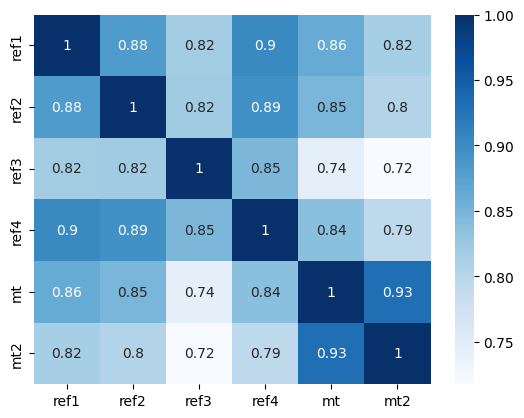

SL_525
src
4584894.057092059
2539933.8119729375
ref1
308152.1101297536
78497.14964362181
ref2
357393.11097631184
95444.3327343811
ref3
436997.61264543986
131314.40610681038
ref4
278175.8663906337
75010.29200092424
mt
377769.70101994165
111518.982294855
mt2
560449.3175215671
133363.4961018944
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.891156     0.821745     0.904262   0.863782   
ref2_SL_525     0.891156     1.000000     0.824524     0.900260   0.852826   
ref3_SL_525     0.821745     0.824524     1.000000     0.849222   0.741615   
ref4_SL_525     0.904262     0.900260     0.849222     1.000000   0.834936   
mt_SL_525       0.863782     0.852826     0.741615     0.834936   1.000000   
mt2_SL_525      0.822344     0.812892     0.719004     0.796153   0.938973   

             mt2_SL_525  
ref1_SL_525    0.822344  
ref2_SL_525    0.812892  
ref3_SL_525    0.719004  
ref4_SL_525    0.796153  
mt_SL_525      0.938973  
mt2_

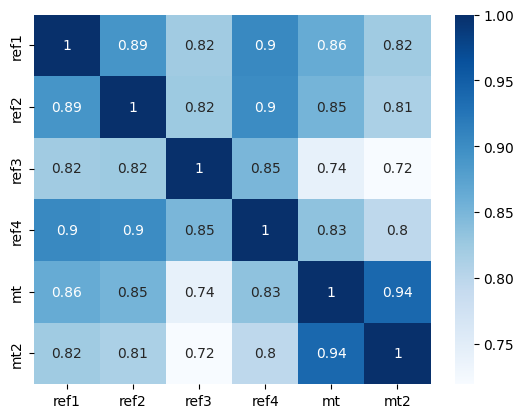

SL_550
src
11029694.493780375
5527291.345079647
ref1
702199.7504315766
145452.10741701676
ref2
806782.338219039
177542.1849891648
ref3
987404.6533306616
251635.6497121171
ref4
628000.0282550809
139911.08130752255
mt
848107.4085886403
209506.744576975
mt2
1295472.7155814422
255026.35024075187
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.898400     0.821870     0.905419   0.863545   
ref2_SL_550     0.898400     1.000000     0.826277     0.905170   0.855707   
ref3_SL_550     0.821870     0.826277     1.000000     0.849056   0.735920   
ref4_SL_550     0.905419     0.905170     0.849056     1.000000   0.831294   
mt_SL_550       0.863545     0.855707     0.735920     0.831294   1.000000   
mt2_SL_550      0.826360     0.819159     0.717568     0.795781   0.946377   

             mt2_SL_550  
ref1_SL_550    0.826360  
ref2_SL_550    0.819159  
ref3_SL_550    0.717568  
ref4_SL_550    0.795781  
mt_SL_550      0.946377  
mt2_

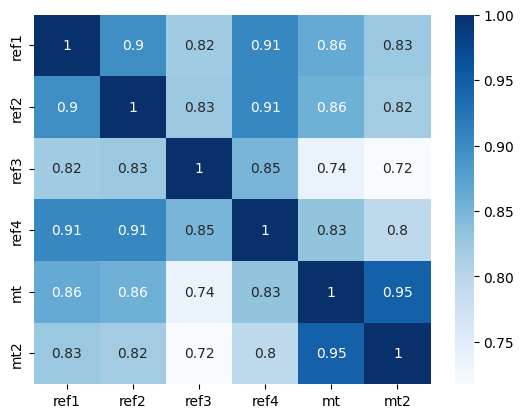

SL_575
src
26777380.81795083
12368663.179223837
ref1
1620801.4434855212
267958.2943635249
ref2
1842913.642096644
338085.70590553817
ref3
2257484.970195444
479441.6418337722
ref4
1435760.179505723
262737.64430537756
mt
1929985.125605749
397590.2676560428
mt2
3031787.7602126654
489062.32051221246
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.904663     0.820429     0.906081   0.862044   
ref2_SL_575     0.904663     1.000000     0.826314     0.909098   0.856828   
ref3_SL_575     0.820429     0.826314     1.000000     0.847297   0.727829   
ref4_SL_575     0.906081     0.909098     0.847297     1.000000   0.826285   
mt_SL_575       0.862044     0.856828     0.727829     0.826285   1.000000   
mt2_SL_575      0.828878     0.823658     0.713434     0.793964   0.952999   

             mt2_SL_575  
ref1_SL_575    0.828878  
ref2_SL_575    0.823658  
ref3_SL_575    0.713434  
ref4_SL_575    0.793964  
mt_SL_575      0.952999  
m

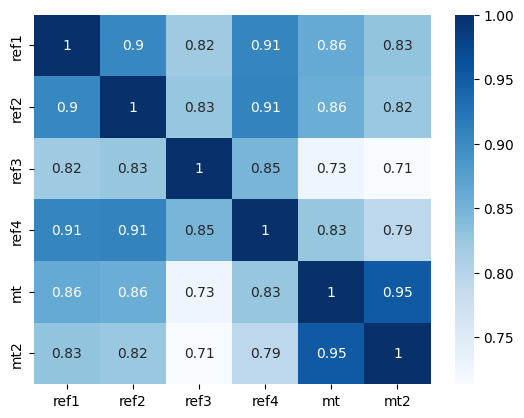

SL_600
src
65571469.76712747
27455892.468231287
ref1
3783084.113350443
503190.1907563751
ref2
4254196.322344252
639450.847312763
ref3
5216554.500345228
928421.0063110862
ref4
3319129.367560388
488637.4473588725
mt
4446717.734947516
756423.827053312
mt2
7174981.39348228
940294.4424037258
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.910063     0.817575     0.906317   0.859566   
ref2_SL_600     0.910063     1.000000     0.824768     0.912149   0.856528   
ref3_SL_600     0.817575     0.824768     1.000000     0.844123   0.717755   
ref4_SL_600     0.906317     0.912149     0.844123     1.000000   0.820237   
mt_SL_600       0.859566     0.856528     0.717755     0.820237   1.000000   
mt2_SL_600      0.830108     0.826599     0.706934     0.790923   0.958882   

             mt2_SL_600  
ref1_SL_600    0.830108  
ref2_SL_600    0.826599  
ref3_SL_600    0.706934  
ref4_SL_600    0.790923  
mt_SL_600      0.958882  
mt2_SL_60

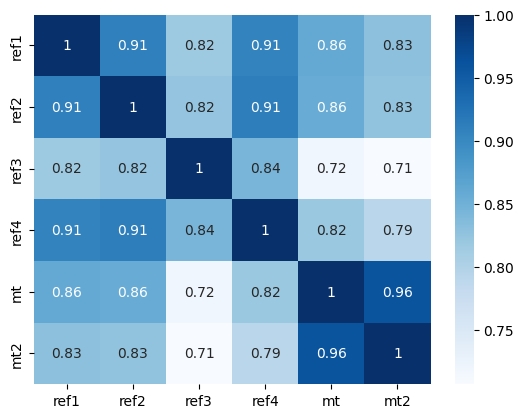

SL_625
src
161874865.1296033
61125063.16988797
ref1
8915130.922679067
937167.4698083829
ref2
9911711.046421446
1215957.1474472065
ref3
12170304.167544274
1773892.733681195
ref4
7747420.152583456
914588.4449908418
mt
10360800.519358978
1458786.014061937
mt2
17150820.535405792
1820993.6516791391
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.914714     0.813440     0.906185   0.856334   
ref2_SL_625     0.914714     1.000000     0.821767     0.914424   0.855090   
ref3_SL_625     0.813440     0.821767     1.000000     0.839682   0.706042   
ref4_SL_625     0.906185     0.914424     0.839682     1.000000   0.813407   
mt_SL_625       0.856334     0.855090     0.706042     0.813407   1.000000   
mt2_SL_625      0.830237     0.828186     0.698375     0.786856   0.964082   

             mt2_SL_625  
ref1_SL_625    0.830237  
ref2_SL_625    0.828186  
ref3_SL_625    0.698375  
ref4_SL_625    0.786856  
mt_SL_625      0.964082  
mt

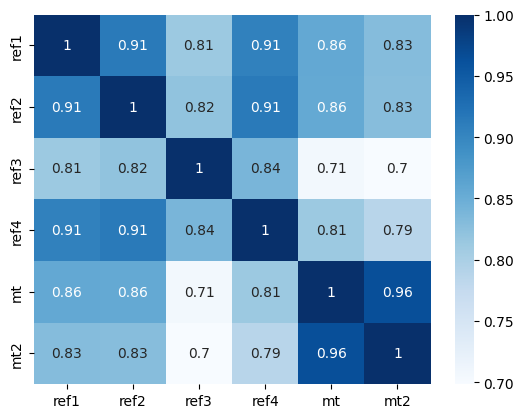

SL_650
src
402663287.21272
136555136.96661842
ref1
21181448.232908837
1753546.7439505844
ref2
23280581.584862344
2333002.768500796
ref3
28637340.58923164
3460583.262073828
ref4
18234770.970242053
1713271.829946838
mt
24383912.399129435
2786541.6984179644
mt2
41362953.35530331
3434983.8263862664
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.918718     0.808135     0.905734   0.852524   
ref2_SL_650     0.918718     1.000000     0.817431     0.916017   0.852742   
ref3_SL_650     0.808135     0.817431     1.000000     0.834101   0.692972   
ref4_SL_650     0.905734     0.916017     0.834101     1.000000   0.806000   
mt_SL_650       0.852524     0.852742     0.692972     0.806000   1.000000   
mt2_SL_650      0.829430     0.828603     0.688036     0.781939   0.968660   

             mt2_SL_650  
ref1_SL_650    0.829430  
ref2_SL_650    0.828603  
ref3_SL_650    0.688036  
ref4_SL_650    0.781939  
mt_SL_650      0.968660  
m

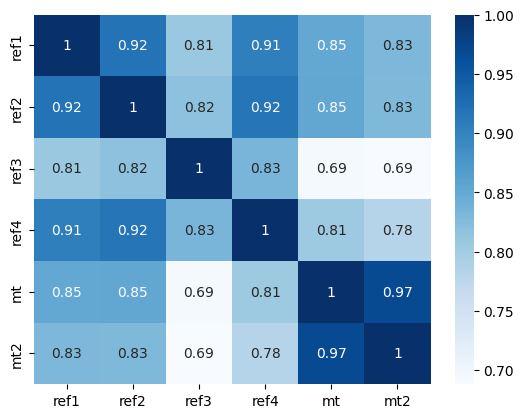

SL_675
src
1008763482.5921872
301100437.7826258
ref1
50673499.045114025
3324003.065791509
ref2
55067606.63242434
4498422.587045612
ref3
67899253.95030364
6747529.148537874
ref4
43224666.925059386
3211718.9248255277
mt
57899777.42182671
5280726.224427741
mt2
100544540.43819806
6614218.256028629
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.922166     0.801756     0.905001   0.848273   
ref2_SL_675     0.922166     1.000000     0.811865     0.917015   0.849671   
ref3_SL_675     0.801756     0.811865     1.000000     0.827488   0.678778   
ref4_SL_675     0.905001     0.917015     0.827488     1.000000   0.798175   
mt_SL_675       0.848273     0.849671     0.678778     0.798175   1.000000   
mt2_SL_675      0.827834     0.828023     0.676167     0.776326   0.972676   

             mt2_SL_675  
ref1_SL_675    0.827834  
ref2_SL_675    0.828023  
ref3_SL_675    0.676167  
ref4_SL_675    0.776326  
mt_SL_675      0.972676  
mt

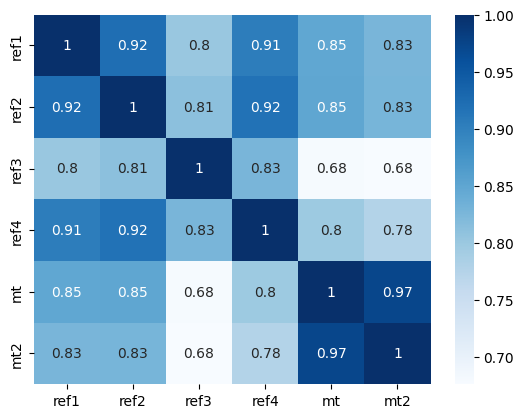

SL_700
src
2543988667.46707
660574048.4768372
ref1
121934498.32802267
6329408.617461263
ref2
131053570.95237492
8577444.277250562
ref3
162077577.47766778
13089457.310062984
ref4
103083840.10893789
6024446.193039482
mt
138564461.87564394
10022540.425773568
mt2
246107606.42202407
12601682.399536308
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.925140     0.794384     0.904021   0.843686   
ref2_SL_700     0.925140     1.000000     0.805168     0.917494   0.846026   
ref3_SL_700     0.794384     0.805168     1.000000     0.819931   0.663655   
ref4_SL_700     0.904021     0.917494     0.819931     1.000000   0.790057   
mt_SL_700       0.843686     0.846026     0.663655     0.790057   1.000000   
mt2_SL_700      0.825576     0.826596     0.662993     0.770154   0.976189   

             mt2_SL_700  
ref1_SL_700    0.825576  
ref2_SL_700    0.826596  
ref3_SL_700    0.662993  
ref4_SL_700    0.770154  
mt_SL_700      0.976189  

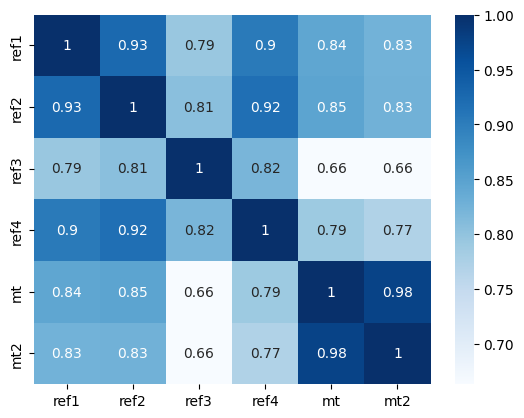

SL_725
src
6455374132.250073
1453516880.8054214
ref1
294838935.841575
11871313.49900476
ref2
313540903.6054739
16364377.147467576
ref3
389197205.8941072
25406239.923446886
ref4
247102522.8236503
11307489.309110647
mt
333891141.0896542
19048745.991922267
mt2
606112175.2209655
24177426.824229
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.927707     0.786091     0.902818   0.838848   
ref2_SL_725     0.927707     1.000000     0.797425     0.917520   0.841931   
ref3_SL_725     0.786091     0.797425     1.000000     0.811509   0.647766   
ref4_SL_725     0.902818     0.917520     0.811509     1.000000   0.781746   
mt_SL_725       0.838848     0.841931     0.647766     0.781746   1.000000   
mt2_SL_725      0.822766     0.824460     0.648713     0.763538   0.979256   

             mt2_SL_725  
ref1_SL_725    0.822766  
ref2_SL_725    0.824460  
ref3_SL_725    0.648713  
ref4_SL_725    0.763538  
mt_SL_725      0.979256  
mt2_S

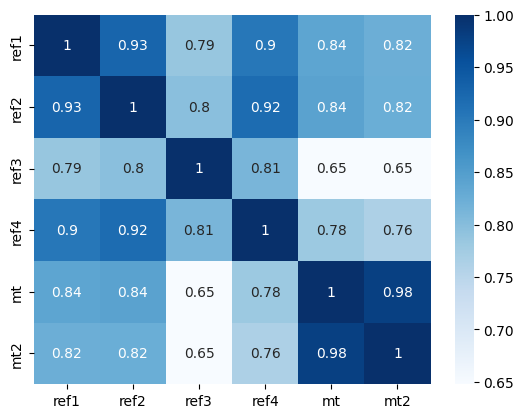

SL_750
src
16474751893.586031
3216083910.8851676
ref1
715831451.354816
22752657.272206023
ref2
753565798.8227681
31790641.954930127
ref3
939521677.6760082
50033731.904612094
ref4
594905955.0429281
22092321.906598266
mt
809384746.2324054
35883506.84561695
mt2
1500810077.1842308
46435285.40096208
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.929927     0.776940     0.901417   0.833827   
ref2_SL_750     0.929927     1.000000     0.788716     0.917149   0.837487   
ref3_SL_750     0.776940     0.788716     1.000000     0.802289   0.631251   
ref4_SL_750     0.901417     0.917149     0.802289     1.000000   0.773321   
mt_SL_750       0.833827     0.837487     0.631251     0.773321   1.000000   
mt2_SL_750      0.819501     0.821732     0.633507     0.756583   0.981928   

             mt2_SL_750  
ref1_SL_750    0.819501  
ref2_SL_750    0.821732  
ref3_SL_750    0.633507  
ref4_SL_750    0.756583  
mt_SL_750      0.981928  
m

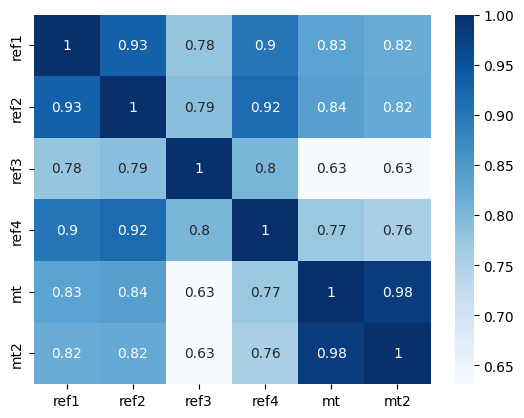

SL_775
src
42269568179.47928
7078075105.309652
ref1
1743875570.4846005
43088088.35550375
ref2
1818282091.5561678
61584598.67962139
ref3
2278620916.198624
98565714.76829617
ref4
1437514839.5595047
42792295.35314467
mt
1972261171.6286235
67609837.65481648
mt2
3733924588.329539
89270783.42634177
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.931851     0.766989     0.899835   0.828675   
ref2_SL_775     0.931851     1.000000     0.779112     0.916432   0.832775   
ref3_SL_775     0.766989     0.779112     1.000000     0.792330   0.614231   
ref4_SL_775     0.899835     0.916432     0.792330     1.000000   0.764846   
mt_SL_775       0.828675     0.832775     0.614231     0.764846   1.000000   
mt2_SL_775      0.815864     0.818518     0.617533     0.749377   0.984252   

             mt2_SL_775  
ref1_SL_775    0.815864  
ref2_SL_775    0.818518  
ref3_SL_775    0.617533  
ref4_SL_775    0.749377  
mt_SL_775      0.984252  
mt2

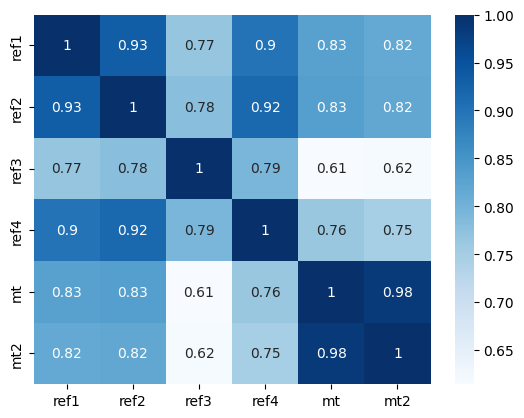

SL_800
src
108987902198.81746
15553008816.681133
ref1
4260479391.035866
80514405.6188832
ref2
4402343551.108728
117220318.33379303
ref3
5549285578.416044
192145167.3859549
ref4
3484359790.7200937
82117868.19576067
mt
4827665308.956
128602382.3959825
mt2
9328899202.26546
171869224.36495173
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.933521     0.756290     0.898089   0.823436   
ref2_SL_800     0.933521     1.000000     0.768681     0.915410   0.827863   
ref3_SL_800     0.756290     0.768681     1.000000     0.781685   0.596812   
ref4_SL_800     0.898089     0.915410     0.781685     1.000000   0.756374   
mt_SL_800       0.823436     0.827863     0.596812     0.756374   1.000000   
mt2_SL_800      0.811929     0.814908     0.600934     0.741995   0.986272   

             mt2_SL_800  
ref1_SL_800    0.811929  
ref2_SL_800    0.814908  
ref3_SL_800    0.600934  
ref4_SL_800    0.741995  
mt_SL_800      0.986272  
mt2_SL_

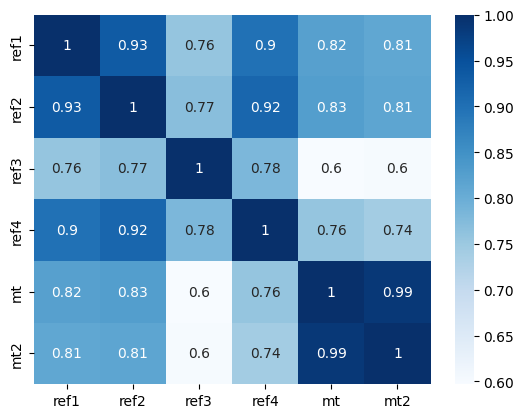

SL_825
src
282299752766.7757
34216605990.864147
ref1
10433748753.780415
152097135.13099286
ref2
10690352526.850702
220762883.51223966
ref3
13564500808.89472
374121853.7424481
ref4
8467854385.392926
156763799.15488648
mt
11863593753.369951
250653022.2421444
mt2
23394310137.254574
333100599.6611322
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.934974     0.744894     0.896192   0.818144   
ref2_SL_825     0.934974     1.000000     0.757484     0.914119   0.822805   
ref3_SL_825     0.744894     0.757484     1.000000     0.770405   0.579087   
ref4_SL_825     0.896192     0.914119     0.770405     1.000000   0.747946   
mt_SL_825       0.818144     0.822805     0.579087     0.747946   1.000000   
mt2_SL_825      0.807756     0.810979     0.583837     0.734503   0.988025   

             mt2_SL_825  
ref1_SL_825    0.807756  
ref2_SL_825    0.810979  
ref3_SL_825    0.583837  
ref4_SL_825    0.734503  
mt_SL_825      0.988025  

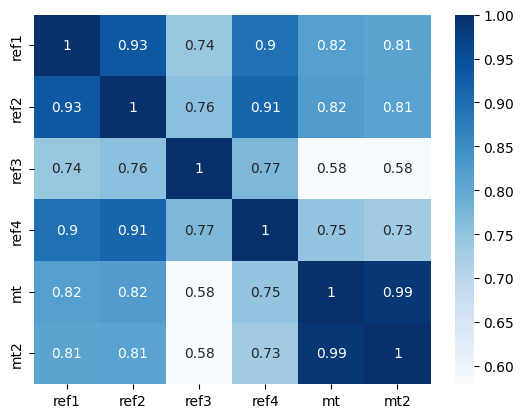

SL_850
src
734302046467.6154
75362205367.15195
ref1
25603332735.371635
287412958.2943149
ref2
26026591587.92475
424401692.30299294
ref3
33266068969.156612
727410876.047314
ref4
20624821701.68325
298964271.34349954
mt
29253665212.15041
491887677.87697464
mt2
58860399092.26558
646007613.9406362
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.936240     0.732849     0.894155   0.812827   
ref2_SL_850     0.936240     1.000000     0.745580     0.912589   0.817648   
ref3_SL_850     0.732849     0.745580     1.000000     0.758536   0.561141   
ref4_SL_850     0.894155     0.912589     0.758536     1.000000   0.739597   
mt_SL_850       0.812827     0.817648     0.561141     0.739597   1.000000   
mt2_SL_850      0.803399     0.806798     0.566357     0.726957   0.989546   

             mt2_SL_850  
ref1_SL_850    0.803399  
ref2_SL_850    0.806798  
ref3_SL_850    0.566357  
ref4_SL_850    0.726957  
mt_SL_850      0.989546  
mt2

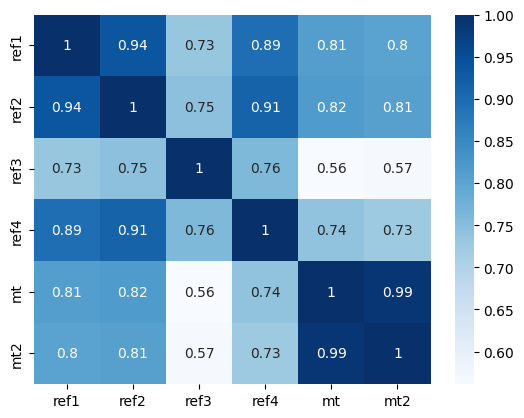

SL_875
src
1917482458681.6265
166811632657.35742
ref1
62934814676.03454
536533016.0953175
ref2
63506227078.50891
820065594.0504047
ref3
81824461168.5345
1433596681.4359083
ref4
50330190750.791176
575149529.5031198
mt
72350126715.93887
965949131.0333691
mt2
148529258450.85587
1253615802.8028202
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.937345     0.720204     0.891988   0.807509   
ref2_SL_875     0.937345     1.000000     0.733027     0.910846   0.812428   
ref3_SL_875     0.720204     0.733027     1.000000     0.746123   0.543050   
ref4_SL_875     0.891988     0.910846     0.746123     1.000000   0.731353   
mt_SL_875       0.807509     0.812428     0.543050     0.731353   1.000000   
mt2_SL_875      0.798902     0.802424     0.548597     0.719403   0.990865   

             mt2_SL_875  
ref1_SL_875    0.798902  
ref2_SL_875    0.802424  
ref3_SL_875    0.548597  
ref4_SL_875    0.719403  
mt_SL_875      0.990865  
mt

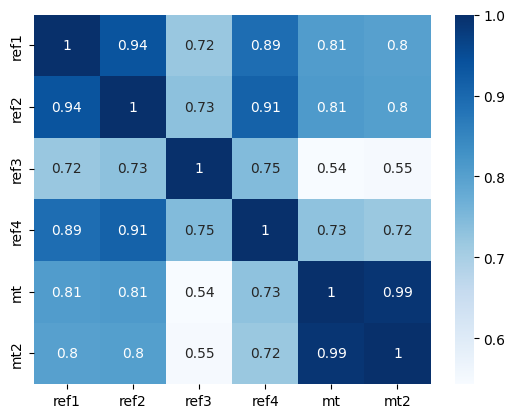

SL_900
src
5025169717931.154
371164455251.421
ref1
154921503102.13947
1027838008.2298756
ref2
155262583407.18887
1582711427.0944476
ref3
201800726752.5146
2810020184.991462
ref4
123017661346.08028
1098419066.1335168
mt
179403547121.38318
1858716001.650289
mt2
375786077389.3764
2434096112.078246
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.938311     0.707007     0.889700   0.802208   
ref2_SL_900     0.938311     1.000000     0.719880     0.908912   0.807176   
ref3_SL_900     0.707007     0.719880     1.000000     0.733211   0.524885   
ref4_SL_900     0.889700     0.908912     0.733211     1.000000   0.723238   
mt_SL_900       0.802208     0.807176     0.524885     0.723238   1.000000   
mt2_SL_900      0.794304     0.797903     0.530651     0.711882   0.992008   

             mt2_SL_900  
ref1_SL_900    0.794304  
ref2_SL_900    0.797903  
ref3_SL_900    0.530651  
ref4_SL_900    0.711882  
mt_SL_900      0.992008  
m

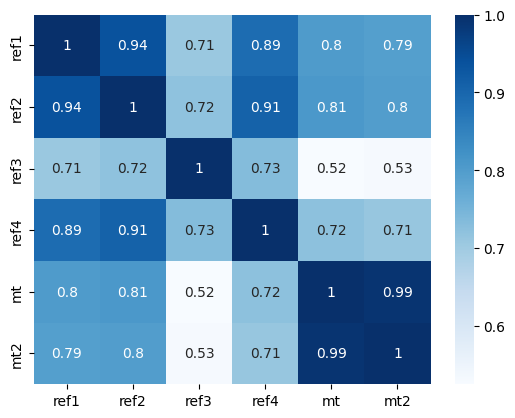

SL_925
src
13213338425008.05
836014175755.9829
ref1
381826726134.3428
1975983226.1732452
ref2
380245855833.07697
3034264338.6788154
ref3
498898405656.8717
5490486725.004016
ref4
301096526287.1985
2109217793.0324862
mt
445879128258.0774
3524343611.71274
mt2
952996973282.1396
4728693633.610302
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.939157     0.693304     0.887298   0.796938   
ref2_SL_925     0.939157     1.000000     0.706194     0.906805   0.801916   
ref3_SL_925     0.693304     0.706194     1.000000     0.719844   0.506710   
ref4_SL_925     0.887298     0.906805     0.719844     1.000000   0.715270   
mt_SL_925       0.796938     0.801916     0.506710     0.715270   1.000000   
mt2_SL_925      0.789637     0.793278     0.512603     0.704428   0.993000   

             mt2_SL_925  
ref1_SL_925    0.789637  
ref2_SL_925    0.793278  
ref3_SL_925    0.512603  
ref4_SL_925    0.704428  
mt_SL_925      0.993000  
mt2_

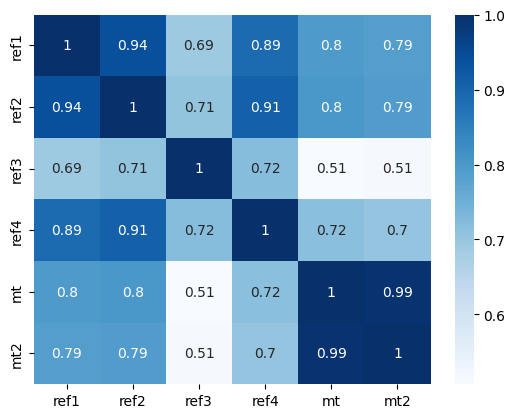

SL_950
src
34850247472212.29
1884283331109.4531
ref1
942059940945.67
3784927513.9954624
ref2
932653375211.0201
5911006860.928738
ref3
1236114638977.3247
10741080868.407276
ref4
737834306163.1926
4026690377.3947315
mt
1110401019082.1833
6704254404.391577
mt2
2421934927759.5195
9190946615.318497
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.939898     0.679144     0.884788   0.791711   
ref2_SL_950     0.939898     1.000000     0.692021     0.904541   0.796669   
ref3_SL_950     0.679144     0.692021     1.000000     0.706066   0.488583   
ref4_SL_950     0.884788     0.904541     0.706066     1.000000   0.707463   
mt_SL_950       0.791711     0.796669     0.488583     0.707463   1.000000   
mt2_SL_950      0.784928     0.788581     0.494529     0.697066   0.993861   

             mt2_SL_950  
ref1_SL_950    0.784928  
ref2_SL_950    0.788581  
ref3_SL_950    0.494529  
ref4_SL_950    0.697066  
mt_SL_950      0.993861  
mt

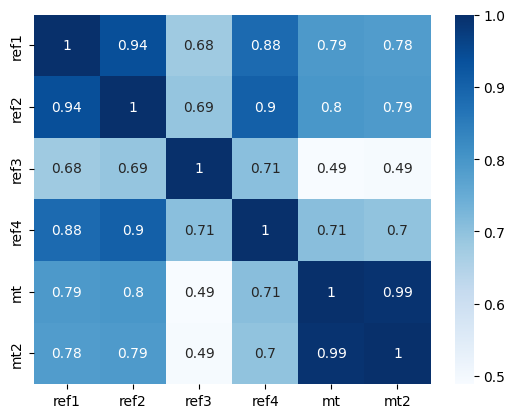

SL_975
src
92178233039508.98
4249520576092.678
ref1
2326404731254.0273
7290026809.746664
ref2
2290645571494.709
11547790595.249878
ref3
3068904325178.7983
21099553199.575607
ref4
1809905675288.8872
7732986056.982789
mt
2770249253993.393
12882446044.884008
mt2
6166870665625.95
17872356419.044777
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.940547     0.664576     0.882175   0.786537   
ref2_SL_975     0.940547     1.000000     0.677415     0.902134   0.791452   
ref3_SL_975     0.664576     0.677415     1.000000     0.691919   0.470560   
ref4_SL_975     0.882175     0.902134     0.691919     1.000000   0.699829   
mt_SL_975       0.786537     0.791452     0.470560     0.699829   1.000000   
mt2_SL_975      0.780199     0.783842     0.476499     0.689821   0.994608   

             mt2_SL_975  
ref1_SL_975    0.780199  
ref2_SL_975    0.783842  
ref3_SL_975    0.476499  
ref4_SL_975    0.689821  
mt_SL_975      0.994608  
m

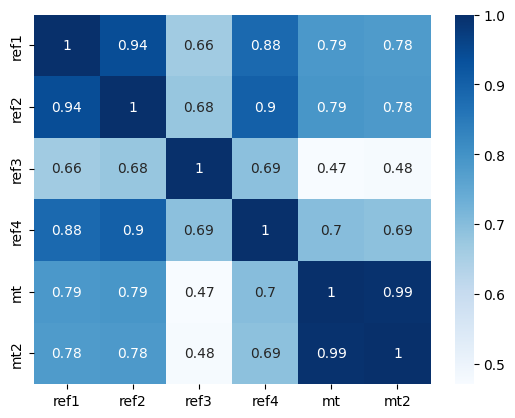

gini
src
0.32971138523171883
0.3342593905576323
ref1
0.42474364559051603
0.4293420465674444
ref2
0.4224646036148676
0.42920716813147997
ref3
0.4196353303720555
0.423509088666214
ref4
0.4344753886933059
0.43721913552359803
mt
0.416485214803536
0.41927919758186666
mt2
0.4276836822415805
0.4277192372235229
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.733090   0.746674   0.796715  0.729303  0.664700
ref2_gini   0.733090   1.000000   0.750305   0.716848  0.711369  0.717231
ref3_gini   0.746674   0.750305   1.000000   0.693688  0.680973  0.631453
ref4_gini   0.796715   0.716848   0.693688   1.000000  0.697775  0.682712
mt_gini     0.729303   0.711369   0.680973   0.697775  1.000000  0.844579
mt2_gini    0.664700   0.717231   0.631453   0.682712  0.844579  1.000000


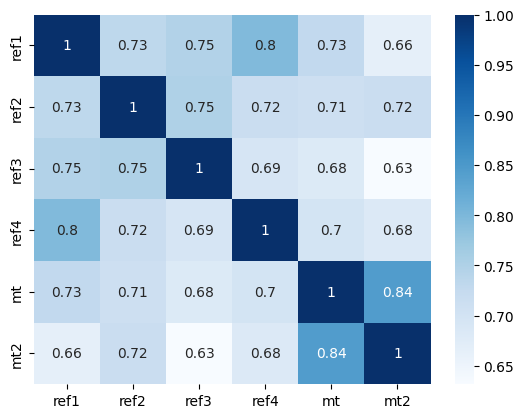

kl
src
-4.6569741162768965
-4.700664247164787
ref1
-4.345437598803553
-4.416899443972566
ref2
-4.313492402476961
-4.391611261448416
ref3
-4.283923437689221
-4.336470476219821
ref4
-4.359246710835296
-4.422545288237524
mt
-4.282178185665325
-4.346003193616667
mt2
-4.291501131195245
-4.360666685568036
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.972384  0.962902  0.971506  0.945234  0.937336
ref2_kl  0.972384  1.000000  0.974332  0.976992  0.956195  0.949595
ref3_kl  0.962902  0.974332  1.000000  0.964866  0.947649  0.940138
ref4_kl  0.971506  0.976992  0.964866  1.000000  0.949352  0.941541
mt_kl    0.945234  0.956195  0.947649  0.949352  1.000000  0.988541
mt2_kl   0.937336  0.949595  0.940138  0.941541  0.988541  1.000000


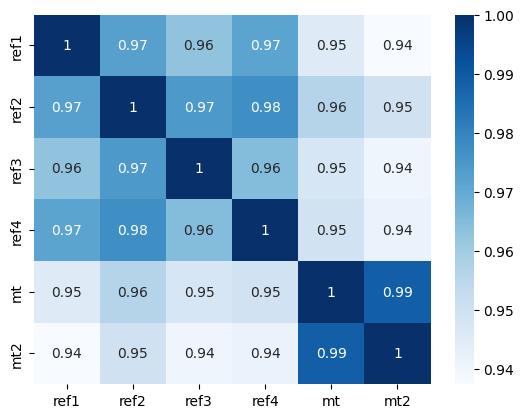

cv
src
0.619461482618071
0.6188531130334651
ref1
0.7970959099734578
0.7900000272603016
ref2
0.791400431218263
0.7877652850847591
ref3
0.7879189553885559
0.776120581243241
ref4
0.8192620956553085
0.8111916565563336
mt
0.7736223835318464
0.7613808112237037
mt2
0.8029753288238891
0.7918057808345442
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.728900  0.717094  0.806152  0.740802  0.671865
ref2_cv  0.728900  1.000000  0.731556  0.744240  0.717486  0.702111
ref3_cv  0.717094  0.731556  1.000000  0.690357  0.681038  0.600170
ref4_cv  0.806152  0.744240  0.690357  1.000000  0.732992  0.712063
mt_cv    0.740802  0.717486  0.681038  0.732992  1.000000  0.802793
mt2_cv   0.671865  0.702111  0.600170  0.712063  0.802793  1.000000


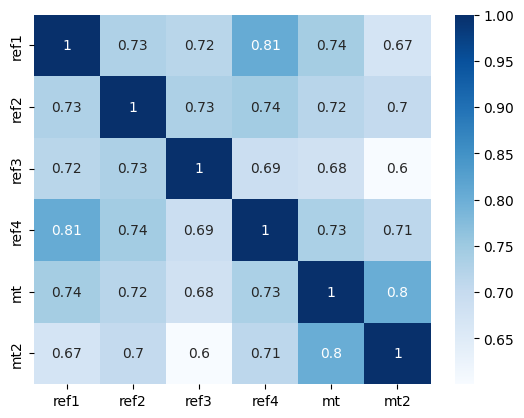

lv
src
70.61660964375977
64.19573431566207
ref1
26.592735806127806
22.63796762051023
ref2
29.933383388294008
25.75060237996655
ref3
31.998417603106198
28.376098873393616
ref4
26.462034432302364
22.129944915088753
mt
30.209702813375678
26.560867608474506
mt2
34.673425289767444
29.597219157372017
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.719399  0.669002  0.789639  0.733362  0.637844
ref2_lv  0.719399  1.000000  0.620234  0.767625  0.713752  0.629659
ref3_lv  0.669002  0.620234  1.000000  0.641831  0.591484  0.480934
ref4_lv  0.789639  0.767625  0.641831  1.000000  0.736571  0.678874
mt_lv    0.733362  0.713752  0.591484  0.736571  1.000000  0.799757
mt2_lv   0.637844  0.629659  0.480934  0.678874  0.799757  1.000000


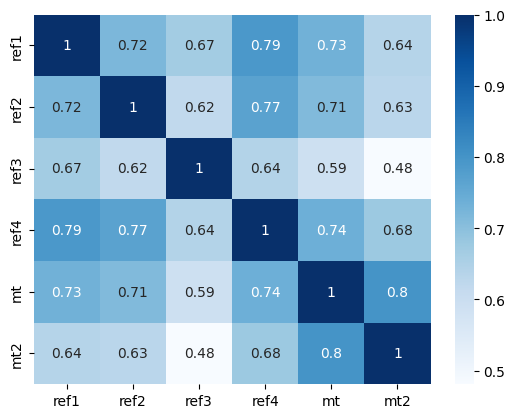

renyi
src
-1211.938583862788
-1159.3914677763003
ref1
-387.9036893954653
-351.7089321140815
ref2
-413.0225108024532
-356.42028280331385
ref3
-439.5175183132666
-386.8332520001512
ref4
-381.5237760338266
-330.94298173453825
mt
-427.0244120494649
-375.04997393328256
mt2
-446.68727514944726
-408.58558991473734
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.962566    0.936599    0.967696  0.946276   
ref2_renyi    0.962566    1.000000    0.939016    0.963065  0.944690   
ref3_renyi    0.936599    0.939016    1.000000    0.934688  0.917810   
ref4_renyi    0.967696    0.963065    0.934688    1.000000  0.946439   
mt_renyi      0.946276    0.944690    0.917810    0.946439  1.000000   
mt2_renyi     0.939885    0.939900    0.911007    0.941762  0.972359   

            mt2_renyi  
ref1_renyi   0.939885  
ref2_renyi   0.939900  
ref3_renyi   0.911007  
ref4_renyi   0.941762  
mt_renyi     0.972359  
mt2_renyi    1.000000  


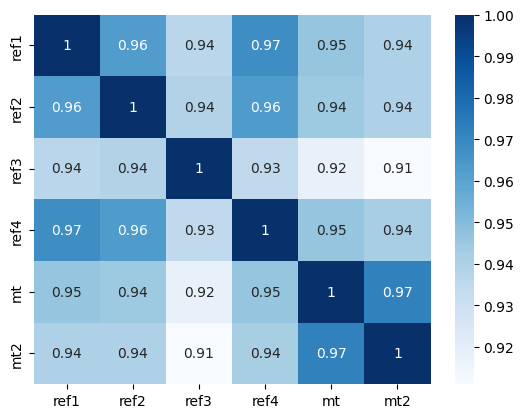

42.02190154044549
14.767998579932321
16.322143032153917
17.933889122377852
14.471547221820526
17.183622976617396


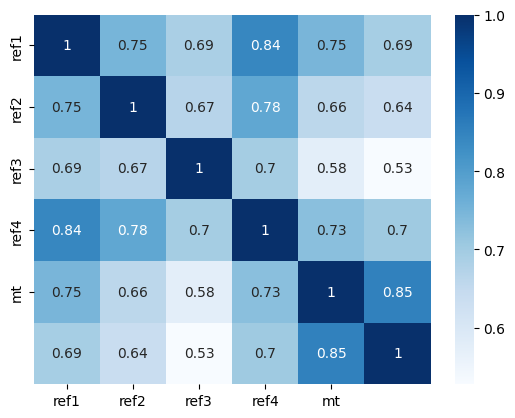

*************************************
14.769661578996644
14.769661578996644
16.317392755677666
18.07446798317749
14.531893294448892
17.291255347727255
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


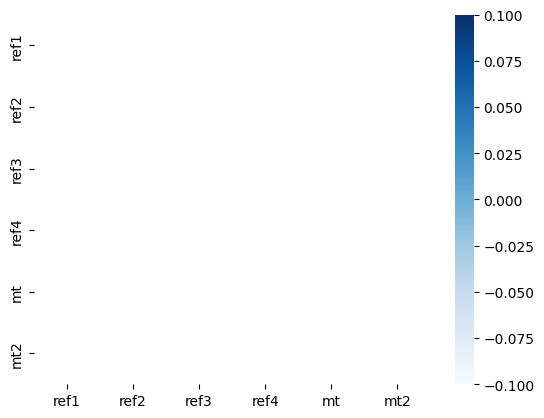

L
src
10.211511127247567
9.91642159210252
ref1
7.139604947443514
6.7617476099443055
ref2
6.838549953626816
6.692233949784422
ref3
8.146633902550628
7.974187086279697
ref4
6.937877185512768
6.4971268877380215
mt
7.126153894618427
6.727668103937302
mt2
7.588798374685339
7.100668354497198
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.706505  0.616904  0.910472  0.714808  0.869098
ref2_L  0.706505  1.000000  0.523599  0.696164  0.759519  0.686893
ref3_L  0.616904  0.523599  1.000000  0.596012  0.498132  0.564851
ref4_L  0.910472  0.696164  0.596012  1.000000  0.657744  0.835435
mt_L    0.714808  0.759519  0.498132  0.657744  1.000000  0.801939
mt2_L   0.869098  0.686893  0.564851  0.835435  0.801939  1.000000


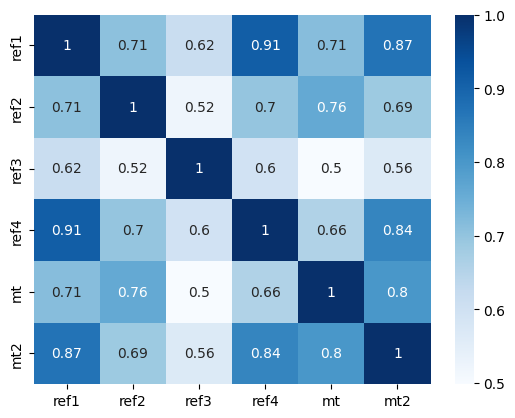

SL_25
src
1.7158199036178436
1.7084754300384066
ref1
1.4918619926289538
1.4842310042944435
ref2
1.4994799945333268
1.4952991543187766
ref3
1.5545827219118085
1.5499335643710728
ref4
1.4800564047448022
1.4670259540463517
mt
1.5080076485050973
1.5041438168052976
mt2
1.5159652802677683
1.5102304103323823
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.757513    0.690496    0.853369  0.763591   
ref2_SL_25    0.757513    1.000000    0.684203    0.776865  0.775328   
ref3_SL_25    0.690496    0.684203    1.000000    0.676980  0.641875   
ref4_SL_25    0.853369    0.776865    0.676980    1.000000  0.744970   
mt_SL_25      0.763591    0.775328    0.641875    0.744970  1.000000   
mt2_SL_25     0.768232    0.724252    0.661330    0.760960  0.855336   

            mt2_SL_25  
ref1_SL_25   0.768232  
ref2_SL_25   0.724252  
ref3_SL_25   0.661330  
ref4_SL_25   0.760960  
mt_SL_25     0.855336  
mt2_SL_25    1.000000  


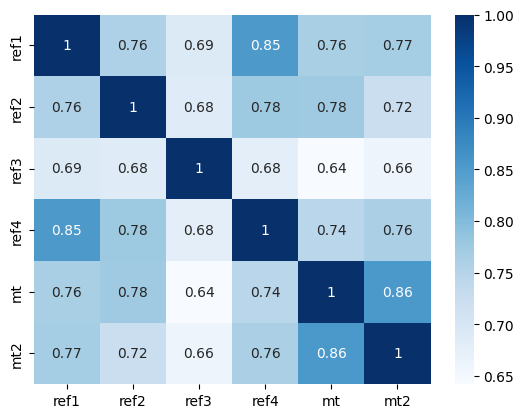

SL_50
src
3.032333587802964
2.994348112198704
ref1
2.3888753786957295
2.339373684175349
ref2
2.3897026115096187
2.373809856174255
ref3
2.578461023154866
2.553481995552943
ref4
2.352275395630017
2.3050801409091193
mt
2.42299880682216
2.3967986630479325
mt2
2.466675984309536
2.4281277330774858
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.753101    0.658979    0.876640  0.749746   
ref2_SL_50    0.753101    1.000000    0.635192    0.761680  0.781613   
ref3_SL_50    0.658979    0.635192    1.000000    0.642881  0.589642   
ref4_SL_50    0.876640    0.761680    0.642881    1.000000  0.715759   
mt_SL_50      0.749746    0.781613    0.589642    0.715759  1.000000   
mt2_SL_50     0.806380    0.722703    0.628514    0.787206  0.841783   

            mt2_SL_50  
ref1_SL_50   0.806380  
ref2_SL_50   0.722703  
ref3_SL_50   0.628514  
ref4_SL_50   0.787206  
mt_SL_50     0.841783  
mt2_SL_50    1.000000  


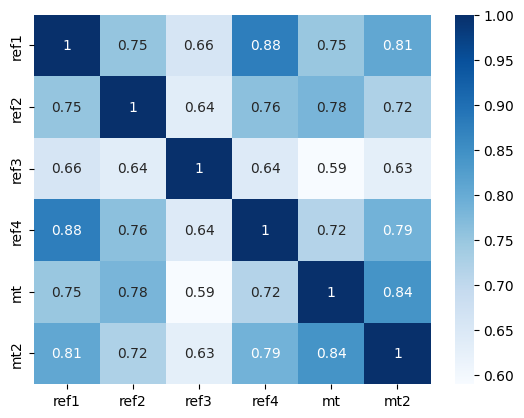

SL_75
src
5.500150418205578
5.387426818826963
ref1
4.033853403971302
3.9050894043982924
ref2
3.97336572973293
3.922778656592766
ref3
4.4880269005544395
4.405058660890628
ref4
3.9443485183453157
3.8121150629771035
mt
4.075269553679771
3.959904968197419
mt2
4.228947072538433
4.060416550960905
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.734822    0.635346    0.895808  0.733719   
ref2_SL_75    0.734822    1.000000    0.580496    0.733344  0.777021   
ref3_SL_75    0.635346    0.580496    1.000000    0.616736  0.542906   
ref4_SL_75    0.895808    0.733344    0.616736    1.000000  0.686977   
mt_SL_75      0.733719    0.777021    0.542906    0.686977  1.000000   
mt2_SL_75     0.841004    0.708687    0.594973    0.813047  0.823575   

            mt2_SL_75  
ref1_SL_75   0.841004  
ref2_SL_75   0.708687  
ref3_SL_75   0.594973  
ref4_SL_75   0.813047  
mt_SL_75     0.823575  
mt2_SL_75    1.000000  


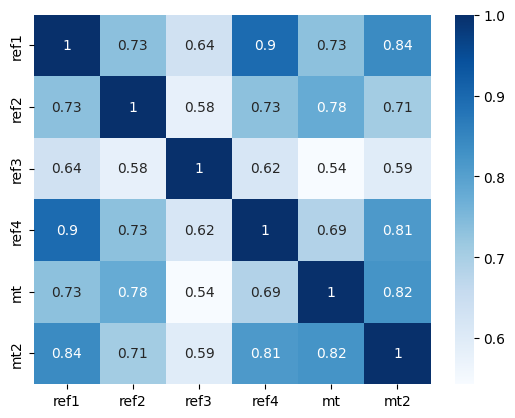

SL_100
src
10.211511127247567
9.91642159210252
ref1
7.139604947443514
6.7617476099443055
ref2
6.838549953626816
6.692233949784422
ref3
8.146633902550628
7.974187086279697
ref4
6.937877185512768
6.4971268877380215
mt
7.126153894618427
6.727668103937302
mt2
7.588798374685339
7.100668354497198
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.706505     0.616904     0.910472   0.714808   
ref2_SL_100     0.706505     1.000000     0.523599     0.696164   0.759519   
ref3_SL_100     0.616904     0.523599     1.000000     0.596012   0.498132   
ref4_SL_100     0.910472     0.696164     0.596012     1.000000   0.657744   
mt_SL_100       0.714808     0.759519     0.498132     0.657744   1.000000   
mt2_SL_100      0.869098     0.686893     0.564851     0.835435   0.801939   

             mt2_SL_100  
ref1_SL_100    0.869098  
ref2_SL_100    0.686893  
ref3_SL_100    0.564851  
ref4_SL_100    0.835435  
mt_SL_100      0.801939  
mt2_S

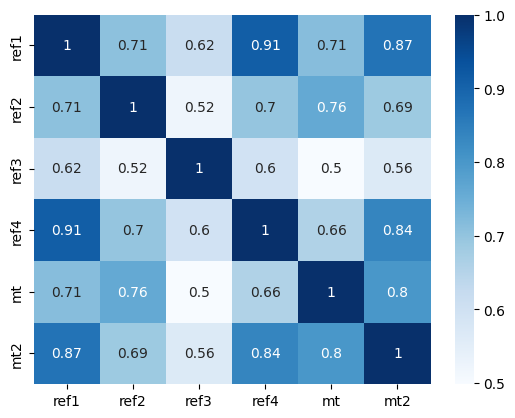

SL_125
src
19.365030885588965
18.687936361637508
ref1
13.216426418257193
12.403891653232934
ref2
12.13464528289454
11.718795827538115
ref3
15.38064747861784
14.495838886046425
ref4
12.775956880531139
11.887251265514466
mt
12.91842025945023
11.67796030872384
mt2
14.215833849742102
13.024028273001822
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.670668     0.601226     0.921262   0.693947   
ref2_SL_125     0.670668     1.000000     0.466724     0.653013   0.728335   
ref3_SL_125     0.601226     0.466724     1.000000     0.578552   0.454207   
ref4_SL_125     0.921262     0.653013     0.578552     1.000000   0.629109   
mt_SL_125       0.693947     0.728335     0.454207     0.629109   1.000000   
mt2_SL_125      0.890379     0.659103     0.539367     0.854086   0.778547   

             mt2_SL_125  
ref1_SL_125    0.890379  
ref2_SL_125    0.659103  
ref3_SL_125    0.539367  
ref4_SL_125    0.854086  
mt_SL_125      0.778547

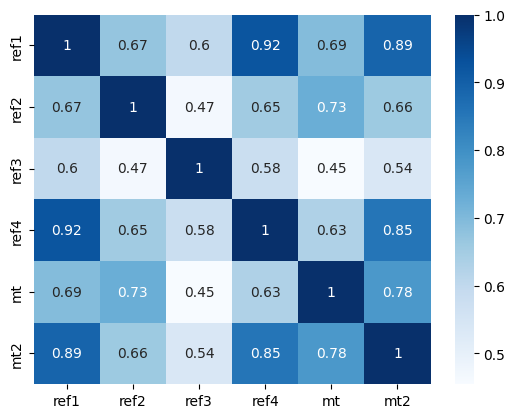

SL_150
src
37.45052879320806
35.78847869113898
ref1
25.55899073204543
22.839428326568274
ref2
22.145913367939876
21.157481248666315
ref3
30.1581182848865
27.384609304645362
ref4
24.605316458694013
21.84100817200696
mt
24.24817058293042
21.200184582257954
mt2
27.758517904847995
24.319105987658197
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.629264     0.587270     0.928998   0.672737   
ref2_SL_150     0.629264     1.000000     0.412008     0.605930   0.684123   
ref3_SL_150     0.587270     0.412008     1.000000     0.563326   0.412524   
ref4_SL_150     0.928998     0.605930     0.563326     1.000000   0.602981   
mt_SL_150       0.672737     0.684123     0.412524     0.602981   1.000000   
mt2_SL_150      0.905561     0.625890     0.519018     0.869452   0.755396   

             mt2_SL_150  
ref1_SL_150    0.905561  
ref2_SL_150    0.625890  
ref3_SL_150    0.519018  
ref4_SL_150    0.869452  
mt_SL_150      0.755396  


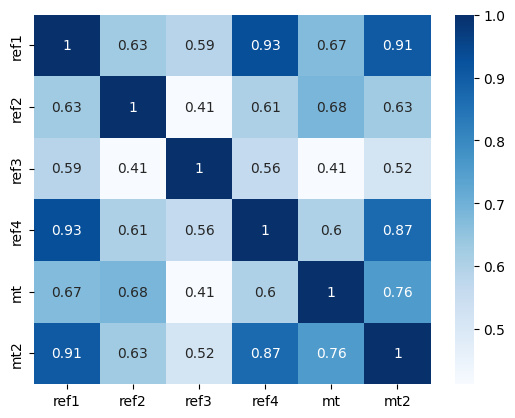

SL_175
src
73.76707514674146
69.69690026132474
ref1
51.56605076621578
42.6495244773685
ref2
41.495093655546654
38.56431173553854
ref3
61.33260443990914
51.55187413384296
ref4
49.49209843156027
40.950737595528445
mt
47.09913217135267
39.18752399425195
mt2
56.421824750911334
45.42315555411177
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.583965     0.574987     0.934349   0.652873   
ref2_SL_175     0.583965     1.000000     0.361132     0.556455   0.629036   
ref3_SL_175     0.574987     0.361132     1.000000     0.550007   0.375423   
ref4_SL_175     0.934349     0.556455     0.550007     1.000000   0.581310   
mt_SL_175       0.652873     0.629036     0.375423     0.581310   1.000000   
mt2_SL_175      0.915572     0.587456     0.503882     0.881901   0.734433   

             mt2_SL_175  
ref1_SL_175    0.915572  
ref2_SL_175    0.587456  
ref3_SL_175    0.503882  
ref4_SL_175    0.881901  
mt_SL_175      0.734433  
mt2_S

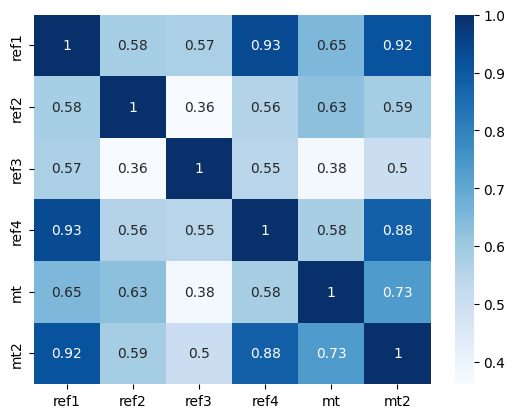

SL_200
src
147.84281085773674
137.00847151636816
ref1
108.30129549753686
82.87526666087945
ref2
79.70460719703036
71.09367699160124
ref3
129.15603511630658
99.20770970036205
ref4
103.73599308835553
79.56292478571936
mt
94.63197891915796
72.12446371474603
mt2
119.16194954877344
86.85621021450842
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.536281     0.564744     0.937737   0.635842   
ref2_SL_200     0.536281     1.000000     0.315008     0.505891   0.566474   
ref3_SL_200     0.564744     0.315008     1.000000     0.538569   0.344954   
ref4_SL_200     0.937737     0.505891     0.538569     1.000000   0.565635   
mt_SL_200       0.635842     0.566474     0.344954     0.565635   1.000000   
mt2_SL_200      0.921249     0.544171     0.493673     0.891576   0.717276   

             mt2_SL_200  
ref1_SL_200    0.921249  
ref2_SL_200    0.544171  
ref3_SL_200    0.493673  
ref4_SL_200    0.891576  
mt_SL_200      0.717276  
m

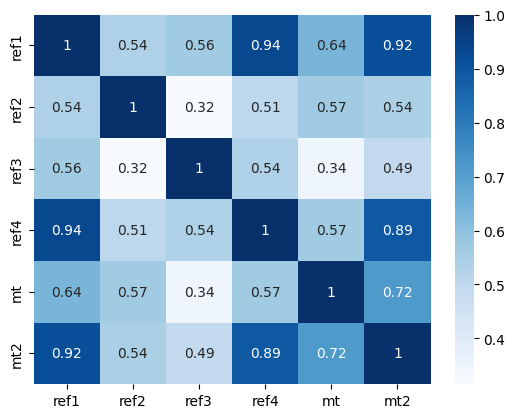

SL_225
src
301.2466761680831
275.52337897331546
ref1
236.06318394357382
160.84267010393586
ref2
156.7227050063238
134.5607315618875
ref3
281.01423075800767
200.7478179807876
ref4
225.8426443577601
158.09996923835814
mt
196.5754987730019
136.74811376691025
mt2
260.8639338912608
174.45874747732208
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.487600     0.556932     0.939359   0.622768   
ref2_SL_225     0.487600     1.000000     0.273848     0.455427   0.500453   
ref3_SL_225     0.556932     0.273848     1.000000     0.529074   0.322348   
ref4_SL_225     0.939359     0.455427     0.529074     1.000000   0.556877   
mt_SL_225       0.622768     0.500453     0.322348     0.556877   1.000000   
mt2_SL_225      0.923258     0.496841     0.487883     0.898456   0.705021   

             mt2_SL_225  
ref1_SL_225    0.923258  
ref2_SL_225    0.496841  
ref3_SL_225    0.487883  
ref4_SL_225    0.898456  
mt_SL_225      0.705021  


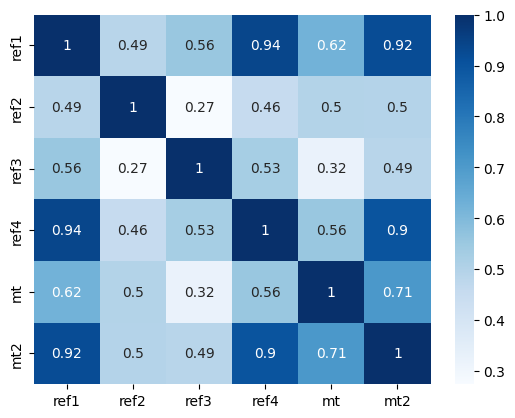

SL_250
src
623.645866435032
555.8978641182189
ref1
532.0193051961094
318.4367651354533
ref2
315.0038796017301
257.0581398061957
ref3
630.0473047986399
414.35830883601045
ref4
508.6849964956193
314.1047576551738
mt
421.8236107554122
270.54572563201714
mt2
590.1767601351069
362.04894082932435
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.439180     0.551800     0.939270   0.614343   
ref2_SL_250     0.439180     1.000000     0.237422     0.406147   0.434827   
ref3_SL_250     0.551800     0.237422     1.000000     0.521577   0.307978   
ref4_SL_250     0.939270     0.406147     0.521577     1.000000   0.555280   
mt_SL_250       0.614343     0.434827     0.307978     0.555280   1.000000   
mt2_SL_250      0.922116     0.446728     0.485932     0.902458   0.698134   

             mt2_SL_250  
ref1_SL_250    0.922116  
ref2_SL_250    0.446728  
ref3_SL_250    0.485932  
ref4_SL_250    0.902458  
mt_SL_250      0.698134  
mt2_S

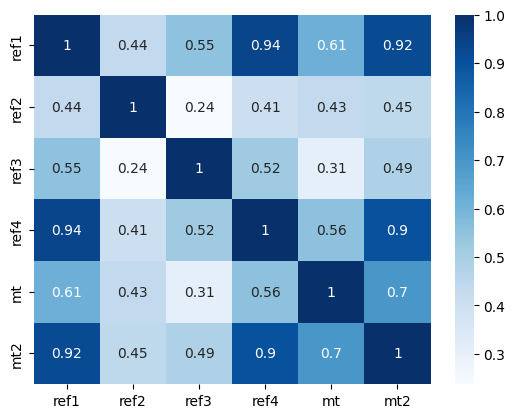

SL_275
src
1310.977397071309
1132.7542992350716
ref1
1234.7153227101512
638.092800503381
ref2
646.2418899068914
507.73324003268624
ref3
1451.2573160071868
867.4356493755811
ref4
1180.3209881923656
631.2549892436339
mt
933.9282594203886
541.0475614919601
mt2
1375.2902506488015
750.3268050917161
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.392107     0.549423     0.937473   0.610803   
ref2_SL_275     0.392107     1.000000     0.205298     0.358982   0.372668   
ref3_SL_275     0.549423     0.205298     1.000000     0.516102   0.301544   
ref4_SL_275     0.937473     0.358982     0.516102     1.000000   0.560478   
mt_SL_275       0.610803     0.372668     0.301544     0.560478   1.000000   
mt2_SL_275      0.918253     0.395393     0.487264     0.903516   0.696430   

             mt2_SL_275  
ref1_SL_275    0.918253  
ref2_SL_275    0.395393  
ref3_SL_275    0.487264  
ref4_SL_275    0.903516  
mt_SL_275      0.696430  
mt

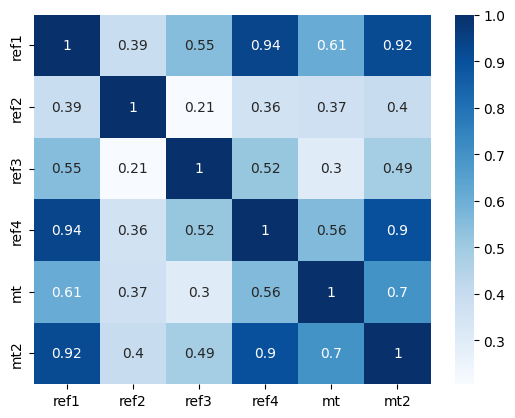

SL_300
src
2796.8218905645454
2387.612248532461
ref1
2938.948594302444
1342.2040533228069
ref2
1351.2058040988431
1012.5994891293271
ref3
3423.5922259457484
1869.855036853749
ref4
2809.4839156986923
1261.943888779403
mt
2129.9543357398693
1083.0006652792003
mt2
3289.719610144084
1495.7131943918712
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.347259     0.549717     0.933992   0.611985   
ref2_SL_300     0.347259     1.000000     0.177003     0.314659   0.315982   
ref3_SL_300     0.549717     0.177003     1.000000     0.512623   0.302302   
ref4_SL_300     0.933992     0.314659     0.512623     1.000000   0.571627   
mt_SL_300       0.611985     0.315982     0.302302     0.571627   1.000000   
mt2_SL_300      0.912065     0.344472     0.491365     0.901644   0.699178   

             mt2_SL_300  
ref1_SL_300    0.912065  
ref2_SL_300    0.344472  
ref3_SL_300    0.491365  
ref4_SL_300    0.901644  
mt_SL_300      0.699178 

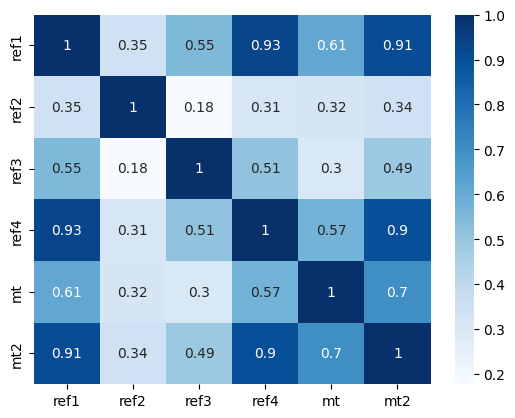

SL_325
src
6052.440412343158
5067.499631975445
ref1
7147.829183956739
2789.672769441208
ref2
2875.1012614617584
2045.2662934728583
ref3
8246.248426248554
3978.7305496411027
ref4
6833.492606391822
2564.632615906898
mt
4993.890207374547
2221.2555571388148
mt2
8050.749509499944
3243.979717675998
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.305282     0.552476     0.928905   0.617407   
ref2_SL_325     0.305282     1.000000     0.152087     0.273677   0.265746   
ref3_SL_325     0.552476     0.152087     1.000000     0.511058   0.309267   
ref4_SL_325     0.928905     0.273677     0.511058     1.000000   0.587589   
mt_SL_325       0.617407     0.265746     0.309267     0.587589   1.000000   
mt2_SL_325      0.903949     0.295464     0.497757     0.896960   0.705288   

             mt2_SL_325  
ref1_SL_325    0.903949  
ref2_SL_325    0.295464  
ref3_SL_325    0.497757  
ref4_SL_325    0.896960  
mt_SL_325      0.705288  
mt2

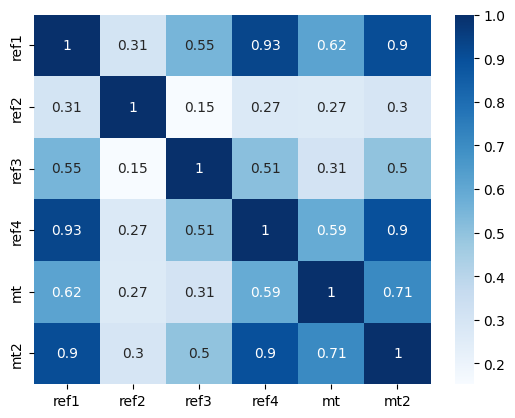

SL_350
src
13279.478374280556
10815.499306469592
ref1
17704.23671409464
5828.749908475145
ref2
6216.842980905902
4247.514709634932
ref3
20222.414377619996
8617.298690271376
ref4
16926.88039296598
5411.969720441899
mt
12010.024261985165
4665.338644921985
mt2
20095.929330513816
7124.196769176768
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.266595     0.557401     0.922365   0.626392   
ref2_SL_350     0.266595     1.000000     0.130151     0.236316   0.222130   
ref3_SL_350     0.557401     0.130151     1.000000     0.511261   0.321355   
ref4_SL_350     0.922365     0.236316     0.511261     1.000000   0.607104   
mt_SL_350       0.626392     0.222130     0.321355     0.607104   1.000000   
mt2_SL_350      0.894305     0.249579     0.505980     0.889685   0.713523   

             mt2_SL_350  
ref1_SL_350    0.894305  
ref2_SL_350    0.249579  
ref3_SL_350    0.505980  
ref4_SL_350    0.889685  
mt_SL_350      0.713523  
mt

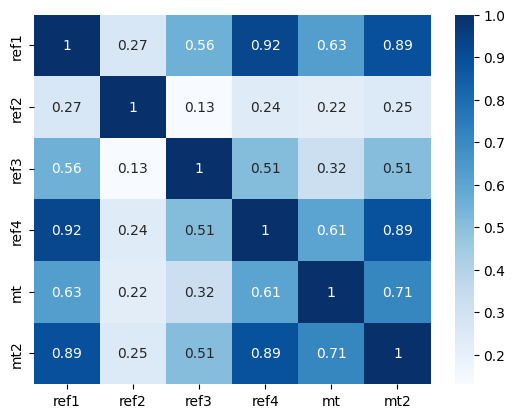

SL_375
src
29526.03133636129
23324.288337065693
ref1
44532.85002417088
12274.7578481862
ref2
13642.288659404485
8752.565600565948
ref3
50362.87025702361
18529.843727466658
ref4
42578.479770283724
11771.031770648375
mt
29556.00444245939
9807.902414759184
mt2
51028.47275701645
15885.453039566157
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.231414     0.564129     0.914582   0.638172   
ref2_SL_375     0.231414     1.000000     0.110846     0.202668   0.184776   
ref3_SL_375     0.564129     0.110846     1.000000     0.513032   0.337493   
ref4_SL_375     0.914582     0.202668     0.513032     1.000000   0.628936   
mt_SL_375       0.638172     0.184776     0.337493     0.628936   1.000000   
mt2_SL_375      0.883513     0.207662     0.515580     0.880122   0.722692   

             mt2_SL_375  
ref1_SL_375    0.883513  
ref2_SL_375    0.207662  
ref3_SL_375    0.515580  
ref4_SL_375    0.880122  
mt_SL_375      0.722692  
mt

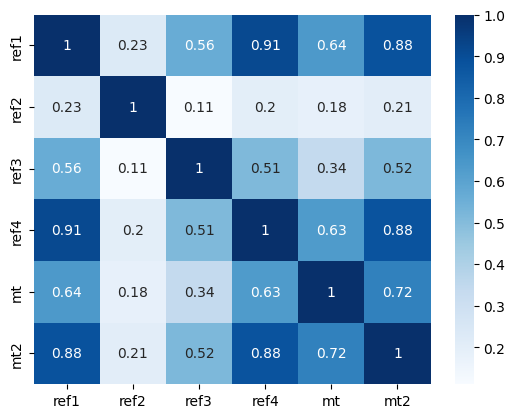

SL_400
src
66494.96119344678
50745.4892341152
ref1
113493.80527301799
26062.26592347219
ref2
30343.527915744922
18186.232561915785
ref3
127097.08676905412
41118.47046102671
ref4
108508.65569951851
25833.318477088862
mt
74249.00476041471
20612.98215557177
mt2
131508.75952111327
34866.647380017646
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.199781     0.572264     0.905808   0.651976   
ref2_SL_400     0.199781     1.000000     0.093863     0.172675   0.153050   
ref3_SL_400     0.572264     0.093863     1.000000     0.516120   0.356675   
ref4_SL_400     0.905808     0.172675     0.516120     1.000000   0.651970   
mt_SL_400       0.651976     0.153050     0.356675     0.651970   1.000000   
mt2_SL_400      0.871918     0.170186     0.526109     0.868620   0.731778   

             mt2_SL_400  
ref1_SL_400    0.871918  
ref2_SL_400    0.170186  
ref3_SL_400    0.526109  
ref4_SL_400    0.868620  
mt_SL_400      0.731778  


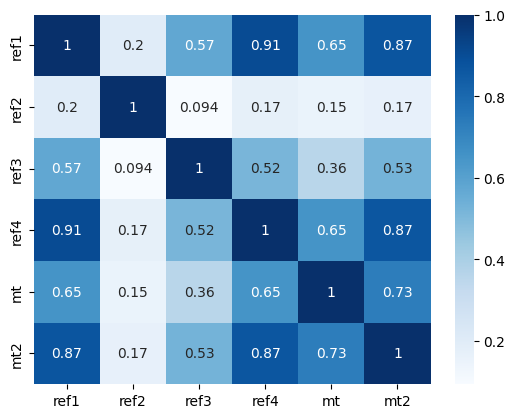

SL_425
src
151605.1445348483
107414.33371279857
ref1
292500.27311255026
56775.61612369763
ref2
68331.04492173035
38517.4536578224
ref3
324415.2436649688
89671.04656002598
ref4
279624.4389960142
57116.577959182636
mt
189955.3941814022
42047.65309856247
mt2
343319.10495306767
75119.25342016676
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.171607     0.581404     0.896306   0.667100   
ref2_SL_425     0.171607     1.000000     0.078927     0.146166   0.126212   
ref3_SL_425     0.581404     0.078927     1.000000     0.520245   0.377999   
ref4_SL_425     0.896306     0.146166     0.520245     1.000000   0.675269   
mt_SL_425       0.667100     0.126212     0.377999     0.675269   1.000000   
mt2_SL_425      0.859805     0.137299     0.537141     0.855534   0.739997   

             mt2_SL_425  
ref1_SL_425    0.859805  
ref2_SL_425    0.137299  
ref3_SL_425    0.537141  
ref4_SL_425    0.855534  
mt_SL_425      0.739997  
mt2_

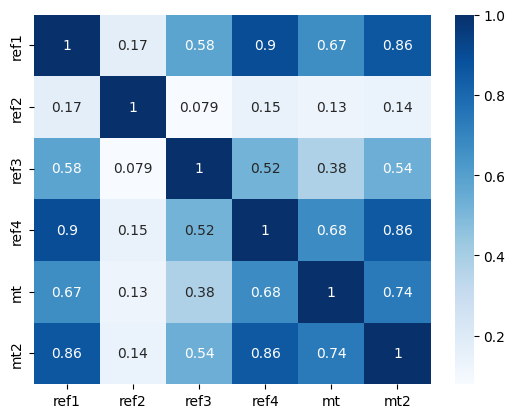

SL_450
src
349750.43900701974
239274.23862115724
ref1
761156.5200718307
121467.47140655231
ref2
155634.7908627896
81335.18177161846
ref3
836246.4082055672
194842.5784623716
ref4
727543.5692830175
127054.2865733999
mt
493809.6313905442
89733.19779132327
mt2
906456.67179425
161246.58805027528
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.146707     0.591165     0.886331   0.682933   
ref2_SL_450     0.146707     1.000000     0.065794     0.122903   0.103531   
ref3_SL_450     0.591165     0.065794     1.000000     0.525116   0.400688   
ref4_SL_450     0.886331     0.122903     0.525116     1.000000   0.698090   
mt_SL_450       0.682933     0.103531     0.400688     0.698090   1.000000   
mt2_SL_450      0.847395     0.108893     0.548285     0.841197   0.746803   

             mt2_SL_450  
ref1_SL_450    0.847395  
ref2_SL_450    0.108893  
ref3_SL_450    0.548285  
ref4_SL_450    0.841197  
mt_SL_450      0.746803  
mt2_S

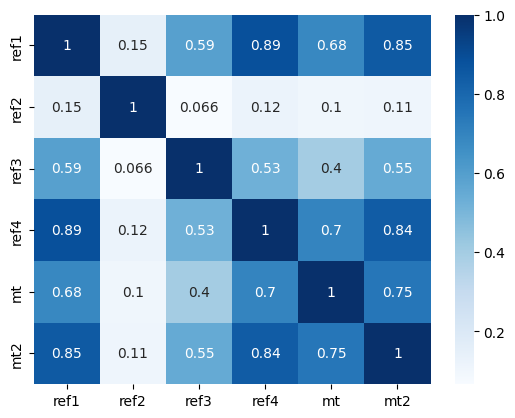

SL_475
src
816009.8847112523
525034.1888591917
ref1
1997444.1943311165
262706.61849983525
ref2
358216.0980345317
167273.23093941
ref3
2174094.7680552257
424168.15656755865
ref4
1908897.2385010056
284049.5876880311
mt
1301736.7408915423
195429.4780140348
mt2
2417277.295875957
347557.95934491354
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.124835     0.601199     0.876112   0.698979   
ref2_SL_475     0.124835     1.000000     0.054243     0.102599   0.084342   
ref3_SL_475     0.601199     0.054243     1.000000     0.530452   0.424090   
ref4_SL_475     0.876112     0.102599     0.530452     1.000000   0.719882   
mt_SL_475       0.698979     0.084342     0.424090     0.719882   1.000000   
mt2_SL_475      0.834842     0.084679     0.559200     0.825905   0.751866   

             mt2_SL_475  
ref1_SL_475    0.834842  
ref2_SL_475    0.084679  
ref3_SL_475    0.559200  
ref4_SL_475    0.825905  
mt_SL_475      0.751866  
mt

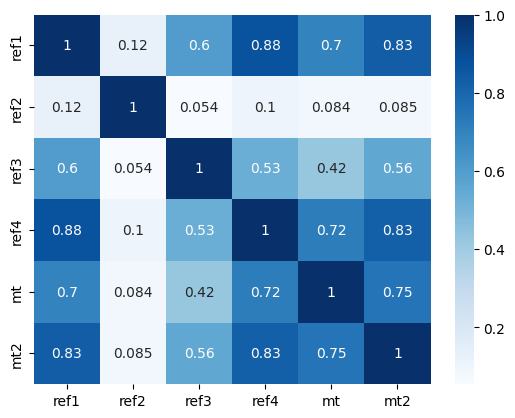

SL_500
src
1924403.405301824
1175499.1198987286
ref1
5280685.872680563
577465.0455830214
ref2
832514.360813156
352325.0493756217
ref3
5694775.9315382615
898517.5063461419
ref4
5045624.918959743
637671.1824272231
mt
3473277.951065661
424666.1116084916
mt2
6503688.930535486
752000.660672043
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.105711     0.611208     0.865840   0.714851   
ref2_SL_500     0.105711     1.000000     0.044080     0.084955   0.068066   
ref3_SL_500     0.611208     0.044080     1.000000     0.535997   0.447679   
ref4_SL_500     0.865840     0.084955     0.535997     1.000000   0.740260   
mt_SL_500       0.714851     0.068066     0.447679     0.740260   1.000000   
mt2_SL_500      0.822246     0.064267     0.569601     0.809904   0.755028   

             mt2_SL_500  
ref1_SL_500    0.822246  
ref2_SL_500    0.064267  
ref3_SL_500    0.569601  
ref4_SL_500    0.809904  
mt_SL_500      0.755028  
mt2_SL_

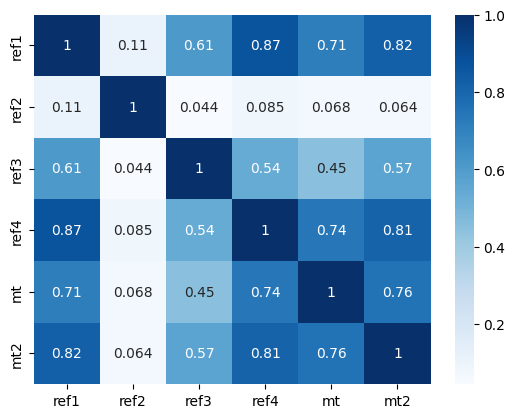

SL_525
src
4584894.057092059
2539933.8119729375
ref1
14052839.547750674
1250518.4613507185
ref2
1952291.6333221353
734967.7943284833
ref3
15015968.544974318
2059098.3822842734
ref4
13424735.558460947
1418063.7526867583
mt
9364768.111402392
913354.4207689468
mt2
17638045.827613294
1632528.5520845042
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.089043     0.620949     0.855668   0.730262   
ref2_SL_525     0.089043     1.000000     0.035131     0.069670   0.054219   
ref3_SL_525     0.620949     0.035131     1.000000     0.541526   0.471043   
ref4_SL_525     0.855668     0.069670     0.541526     1.000000   0.758982   
mt_SL_525       0.730262     0.054219     0.471043     0.758982   1.000000   
mt2_SL_525      0.809661     0.047214     0.579268     0.793396   0.756257   

             mt2_SL_525  
ref1_SL_525    0.809661  
ref2_SL_525    0.047214  
ref3_SL_525    0.579268  
ref4_SL_525    0.793396  
mt_SL_525      0.756257

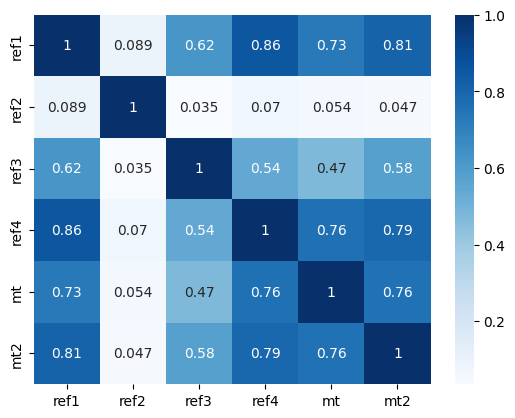

SL_550
src
11029694.493780375
5527291.345079647
ref1
37618603.815432884
2796170.1916645337
ref2
4616743.1443246035
1532058.0376251626
ref3
39829036.261016354
4620902.414946947
ref4
35930797.75575973
3137163.5883007846
mt
25478438.43330473
1947369.1364050042
mt2
48179918.32298728
3573282.9055510894
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.074548     0.630236     0.845711   0.745011   
ref2_SL_550     0.074548     1.000000     0.027246     0.056455   0.042398   
ref3_SL_550     0.630236     0.027246     1.000000     0.546858   0.493873   
ref4_SL_550     0.845711     0.056455     0.546858     1.000000   0.775917   
mt_SL_550       0.745011     0.042398     0.493873     0.775917   1.000000   
mt2_SL_550      0.797110     0.033075     0.588038     0.776538   0.755605   

             mt2_SL_550  
ref1_SL_550    0.797110  
ref2_SL_550    0.033075  
ref3_SL_550    0.588038  
ref4_SL_550    0.776538  
mt_SL_550      0.755605 

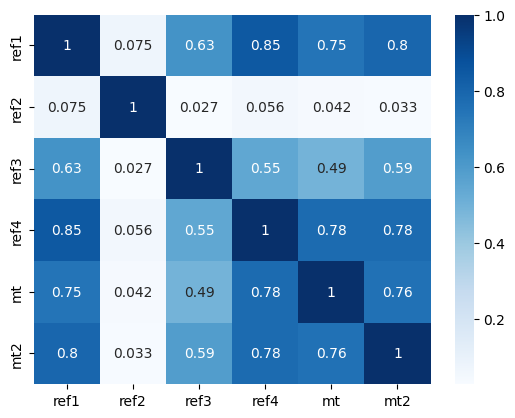

SL_575
src
26777380.81795083
12368663.179223837
ref1
101242484.04371639
6343145.855286624
ref2
11003334.136546833
3249678.765831936
ref3
106208900.39674409
10247954.89410495
ref4
96684961.4563249
6961692.741960346
mt
69859758.80978529
4121192.1852883995
mt2
132472185.7535478
8098111.297806259
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.061955     0.638933     0.836045   0.758970   
ref2_SL_575     0.061955     1.000000     0.020293     0.045046   0.032277   
ref3_SL_575     0.638933     0.020293     1.000000     0.551851   0.515946   
ref4_SL_575     0.836045     0.045046     0.551851     1.000000   0.791020   
mt_SL_575       0.758970     0.032277     0.515946     0.791020   1.000000   
mt2_SL_575      0.784596     0.021424     0.595804     0.759454   0.753185   

             mt2_SL_575  
ref1_SL_575    0.784596  
ref2_SL_575    0.021424  
ref3_SL_575    0.595804  
ref4_SL_575    0.759454  
mt_SL_575      0.753185  
mt2

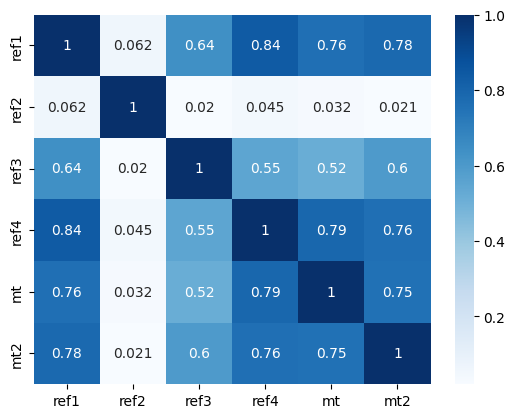

SL_600
src
65571469.76712747
27455892.468231287
ref1
273804374.61358315
14576509.400606763
ref2
26417543.543710005
6949569.69905345
ref3
284593303.0761398
23057416.776596148
ref4
261445100.21054938
15512659.172265004
mt
192839242.16540575
8741990.236932622
mt2
366424640.320955
18399607.167487286
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.051019     0.646953     0.826722   0.772061   
ref2_SL_600     0.051019     1.000000     0.014159     0.035201   0.023586   
ref3_SL_600     0.646953     0.014159     1.000000     0.556402   0.537113   
ref4_SL_600     0.826722     0.035201     0.556402     1.000000   0.804305   
mt_SL_600       0.772061     0.023586     0.537113     0.804305   1.000000   
mt2_SL_600      0.772110     0.011874     0.602506     0.742235   0.749137   

             mt2_SL_600  
ref1_SL_600    0.772110  
ref2_SL_600    0.011874  
ref3_SL_600    0.602506  
ref4_SL_600    0.742235  
mt_SL_600      0.749137  


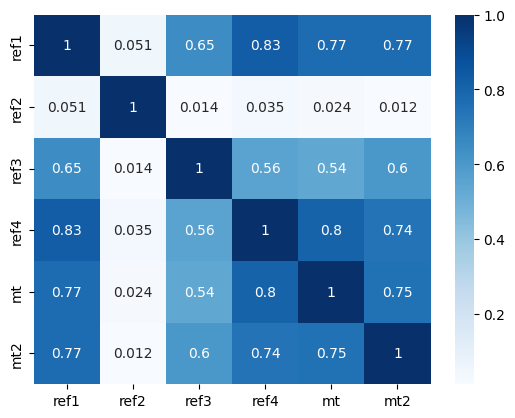

SL_625
src
161874865.1296033
61125063.16988797
ref1
743810513.7472281
33554033.081962287
ref2
63861631.34943586
15225356.104401907
ref3
765972978.5227042
51991951.24954462
ref4
710166103.5189456
35140337.8983476
mt
535402383.8157927
18645952.546665125
mt2
1019145118.6775403
41898851.963128135
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.041517     0.654244     0.817767   0.784252   
ref2_SL_625     0.041517     1.000000     0.008746     0.026705   0.016107   
ref3_SL_625     0.654244     0.008746     1.000000     0.560440   0.557283   
ref4_SL_625     0.817767     0.026705     0.560440     1.000000   0.815830   
mt_SL_625       0.784252     0.016107     0.557283     0.815830   1.000000   
mt2_SL_625      0.759639     0.004081     0.608121     0.724956   0.743617   

             mt2_SL_625  
ref1_SL_625    0.759639  
ref2_SL_625    0.004081  
ref3_SL_625    0.608121  
ref4_SL_625    0.724956  
mt_SL_625      0.743617  
mt2

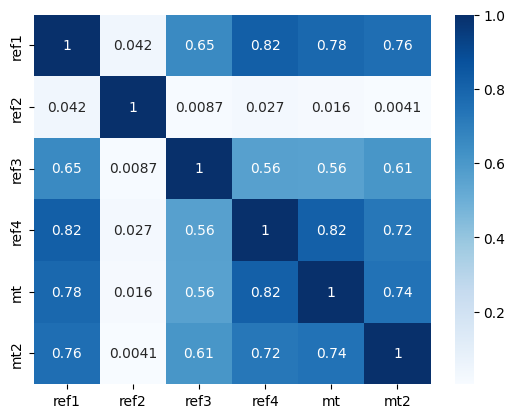

SL_650
src
402663287.21272
136555136.96661842
ref1
2028990225.9157498
77344047.09729892
ref2
155375013.4953728
33069079.122363932
ref3
2070031676.4404137
117465390.08595839
ref4
1937086854.170974
79891134.31920555
mt
1493972886.8712673
40501112.342352405
mt2
2849011250.0031137
93274587.90682024
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.033256     0.660788     0.809190   0.795537   
ref2_SL_650     0.033256     1.000000     0.003969     0.019370   0.009660   
ref3_SL_650     0.660788     0.003969     1.000000     0.563925   0.576410   
ref4_SL_650     0.809190     0.019370     0.563925     1.000000   0.825682   
mt_SL_650       0.795537     0.009660     0.576410     0.825682   1.000000   
mt2_SL_650      0.747167    -0.002251     0.612655     0.707672   0.736786   

             mt2_SL_650  
ref1_SL_650    0.747167  
ref2_SL_650   -0.002251  
ref3_SL_650    0.612655  
ref4_SL_650    0.707672  
mt_SL_650      0.736786  
m

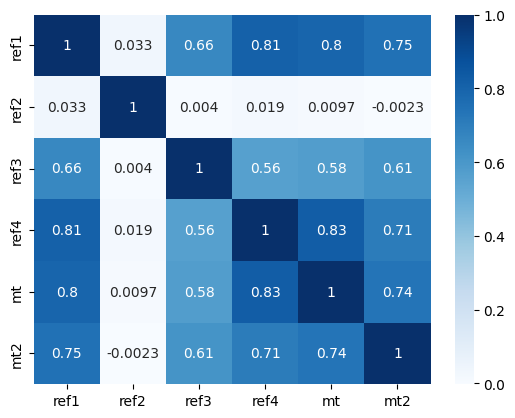

SL_675
src
1008763482.5921872
301100437.7826258
ref1
5556025130.403829
178063102.75820932
ref2
380313280.95240074
71513319.36765686
ref3
5615480107.0321665
265765872.0548702
ref4
5304183746.594034
181465586.6770481
mt
4186914960.5271263
88086396.74764752
mt2
8001931017.53428
202539849.48156953
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.026064     0.666588     0.800987   0.805934   
ref2_SL_675     0.026064     1.000000    -0.000243     0.013033   0.004098   
ref3_SL_675     0.666588    -0.000243     1.000000     0.566838   0.594483   
ref4_SL_675     0.800987     0.013033     0.566838     1.000000   0.833961   
mt_SL_675       0.805934     0.004098     0.594483     0.833961   1.000000   
mt2_SL_675      0.734683    -0.007376     0.616136     0.690427   0.728798   

             mt2_SL_675  
ref1_SL_675    0.734683  
ref2_SL_675   -0.007376  
ref3_SL_675    0.616136  
ref4_SL_675    0.690427  
mt_SL_675      0.728798  
mt

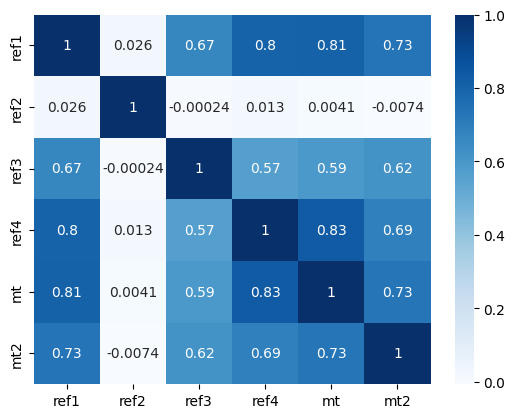

SL_700
src
2543988667.46707
660574048.4768372
ref1
15268683407.743196
402495832.8386673
ref2
936172344.4619703
154847948.14938474
ref3
15287347968.861147
596309778.7549701
ref4
14576523283.34813
408427035.00917864
mt
11778480190.792978
194066607.89901567
mt2
22573047740.676258
440496395.4351448
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.019794     0.671664     0.793145   0.815475   
ref2_SL_700     0.019794     1.000000    -0.003955     0.007554  -0.000703   
ref3_SL_700     0.671664    -0.003955     1.000000     0.569179   0.611515   
ref4_SL_700     0.793145     0.007554     0.569179     1.000000   0.840778   
mt_SL_700       0.815475    -0.000703     0.611515     0.840778   1.000000   
mt2_SL_700      0.722176    -0.011505     0.618609     0.673255   0.719801   

             mt2_SL_700  
ref1_SL_700    0.722176  
ref2_SL_700   -0.011505  
ref3_SL_700    0.618609  
ref4_SL_700    0.673255  
mt_SL_700      0.719801  
m

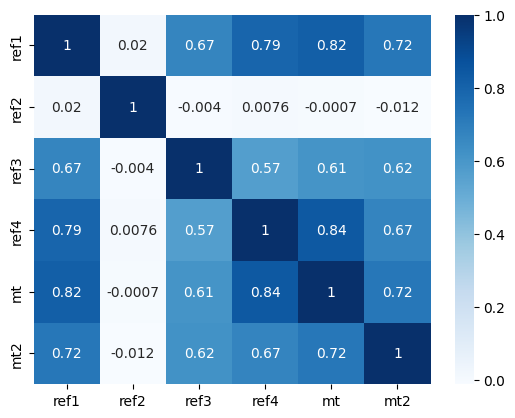

SL_725
src
6455374132.250073
1453516880.8054214
ref1
42100890465.96187
910626342.7824051
ref2
2316684396.252967
333074954.8698865
ref3
41755689870.56682
1336828319.990561
ref4
40193241560.67351
920471349.2963827
mt
33244474008.024387
429290749.6272493
mt2
63936113655.19579
974427155.7286874
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.014320     0.676048     0.785645   0.824200   
ref2_SL_725     0.014320     1.000000    -0.007219     0.002812  -0.004846   
ref3_SL_725     0.676048    -0.007219     1.000000     0.570961   0.627538   
ref4_SL_725     0.785645     0.002812     0.570961     1.000000   0.846244   
mt_SL_725       0.824200    -0.004846     0.627538     0.846244   1.000000   
mt2_SL_725      0.709640    -0.014816     0.620126     0.656188   0.709932   

             mt2_SL_725  
ref1_SL_725    0.709640  
ref2_SL_725   -0.014816  
ref3_SL_725    0.620126  
ref4_SL_725    0.656188  
mt_SL_725      0.709932  
mt2_S

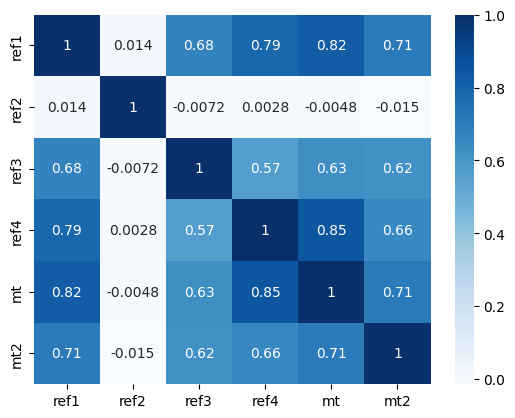

SL_750
src
16474751893.586031
3216083910.8851676
ref1
116450857650.57617
2061890319.0626454
ref2
5761352121.4002695
730773657.9885166
ref3
114406700752.40941
3018559314.2572527
ref4
111179190195.47475
2074166189.3920422
mt
94103816397.1918
963131675.9171965
mt2
181777532991.9863
2192670263.075741
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.009533     0.679782     0.778465   0.832155   
ref2_SL_750     0.009533     1.000000    -0.010085    -0.001297  -0.008418   
ref3_SL_750     0.679782    -0.010085     1.000000     0.572206   0.642593   
ref4_SL_750     0.778465    -0.001297     0.572206     1.000000   0.850471   
mt_SL_750       0.832155    -0.008418     0.642593     0.850471   1.000000   
mt2_SL_750      0.697074    -0.017456     0.620749     0.639248   0.699319   

             mt2_SL_750  
ref1_SL_750    0.697074  
ref2_SL_750   -0.017456  
ref3_SL_750    0.620749  
ref4_SL_750    0.639248  
mt_SL_750      0.699319  

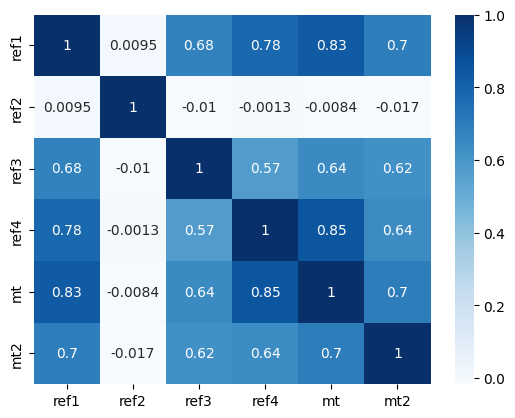

SL_775
src
42269568179.47928
7078075105.309652
ref1
323052892271.9299
4671569618.84524
ref2
14394104606.587358
1604887625.9225893
ref3
314385516064.1093
6830824219.4903965
ref4
308447504074.9073
4671428625.742763
mt
267055317876.2099
2164090564.968098
mt2
518631821904.8514
4936445672.943127
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.005341     0.682907     0.771581   0.839386   
ref2_SL_775     0.005341     1.000000    -0.012595    -0.004860  -0.011493   
ref3_SL_775     0.682907    -0.012595     1.000000     0.572941   0.656731   
ref4_SL_775     0.771581    -0.004860     0.572941     1.000000   0.853563   
mt_SL_775       0.839386    -0.011493     0.656731     0.853563   1.000000   
mt2_SL_775      0.684479    -0.019546     0.620539     0.622459   0.688074   

             mt2_SL_775  
ref1_SL_775    0.684479  
ref2_SL_775   -0.019546  
ref3_SL_775    0.620539  
ref4_SL_775    0.622459  
mt_SL_775      0.688074  
mt2_S

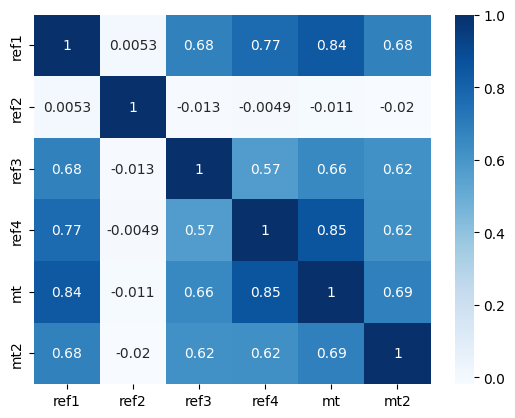

SL_800
src
108987902198.81746
15553008816.681133
ref1
898687829574.7655
10525337330.035412
ref2
36116865666.22429
3530890004.301272
ref3
866321489466.0914
15426251313.174864
ref4
858121960160.1907
10660357555.173105
mt
759577622433.1261
4757888173.089947
mt2
1484562978676.097
11118468329.272663
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.001665     0.685471     0.764968   0.845943   
ref2_SL_800     0.001665     1.000000    -0.014785    -0.007952  -0.014136   
ref3_SL_800     0.685471    -0.014785     1.000000     0.573198   0.670006   
ref4_SL_800     0.764968    -0.007952     0.573198     1.000000   0.855623   
mt_SL_800       0.845943    -0.014136     0.670006     0.855623   1.000000   
mt2_SL_800      0.671860    -0.021184     0.619561     0.605838   0.676302   

             mt2_SL_800  
ref1_SL_800    0.671860  
ref2_SL_800   -0.021184  
ref3_SL_800    0.619561  
ref4_SL_800    0.605838  
mt_SL_800      0.676302  
m

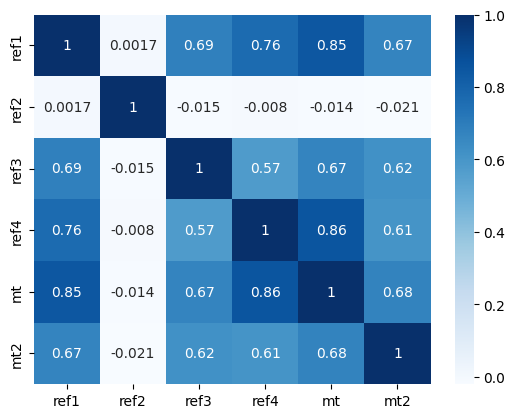

SL_825
src
282299752766.7757
34216605990.864147
ref1
2506564674343.1016
23607872710.936707
ref2
90984900023.91689
7773187335.620649
ref3
2393521029596.5757
34871316977.15791
ref4
2393620301906.1226
24455376222.43094
mt
2164757705778.0142
10455285220.683949
mt2
4262472945021.031
25051996551.549507
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000    -0.001562     0.687518     0.758604   0.851872   
ref2_SL_825    -0.001562     1.000000    -0.016690    -0.010637  -0.016401   
ref3_SL_825     0.687518    -0.016690     1.000000     0.573011   0.682472   
ref4_SL_825     0.758604    -0.010637     0.573011     1.000000   0.856744   
mt_SL_825       0.851872    -0.016401     0.682472     0.856744   1.000000   
mt2_SL_825      0.659223    -0.022454     0.617875     0.589404   0.664094   

             mt2_SL_825  
ref1_SL_825    0.659223  
ref2_SL_825   -0.022454  
ref3_SL_825    0.617875  
ref4_SL_825    0.589404  
mt_SL_825      0.664094  

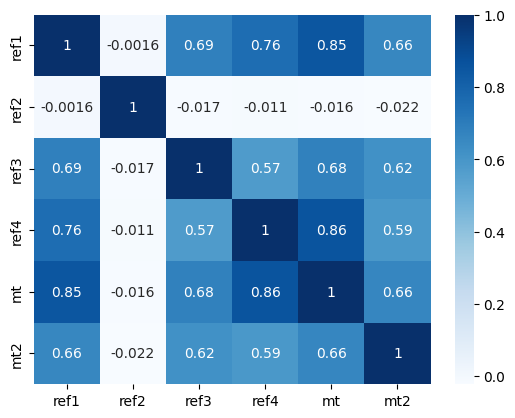

SL_850
src
734302046467.6154
75362205367.15195
ref1
7008405639168.016
52315765838.104385
ref2
230058065042.3076
17081301228.100784
ref3
6629457117949.287
78896620016.25835
ref4
6693193883819.479
55254434285.77832
mt
6180413024642.766
22983837623.121056
mt2
12273204769417.719
57341681488.47967
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000    -0.004400     0.689094     0.752464   0.857218   
ref2_SL_850    -0.004400     1.000000    -0.018339    -0.012969  -0.018336   
ref3_SL_850     0.689094    -0.018339     1.000000     0.572415   0.694184   
ref4_SL_850     0.752464    -0.012969     0.572415     1.000000   0.857012   
mt_SL_850       0.857218    -0.018336     0.694184     0.857012   1.000000   
mt2_SL_850      0.646579    -0.023421     0.615543     0.573171   0.651536   

             mt2_SL_850  
ref1_SL_850    0.646579  
ref2_SL_850   -0.023421  
ref3_SL_850    0.615543  
ref4_SL_850    0.573171  
mt_SL_850      0.651536  
mt2

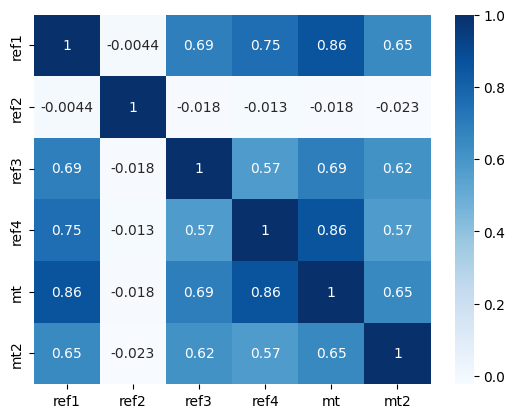

SL_875
src
1917482458681.6265
166811632657.35742
ref1
19641263666273.797
115991541293.56886
ref2
583708316886.9563
37141196480.18575
ref3
18405440890327.902
178647323199.89996
ref4
18759494881479.2
124988745367.0922
mt
17673183671019.89
50436382629.654594
mt2
35432649064934.13
131384780385.10463
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000    -0.006897     0.690241     0.746527   0.862024   
ref2_SL_875    -0.006897     1.000000    -0.019759    -0.014995  -0.019982   
ref3_SL_875     0.690241    -0.019759     1.000000     0.571441   0.705195   
ref4_SL_875     0.746527    -0.014995     0.571441     1.000000   0.856508   
mt_SL_875       0.862024    -0.019982     0.705195     0.856508   1.000000   
mt2_SL_875      0.633938    -0.024140     0.612622     0.557155   0.638699   

             mt2_SL_875  
ref1_SL_875    0.633938  
ref2_SL_875   -0.024140  
ref3_SL_875    0.612622  
ref4_SL_875    0.557155  
mt_SL_875      0.638699  


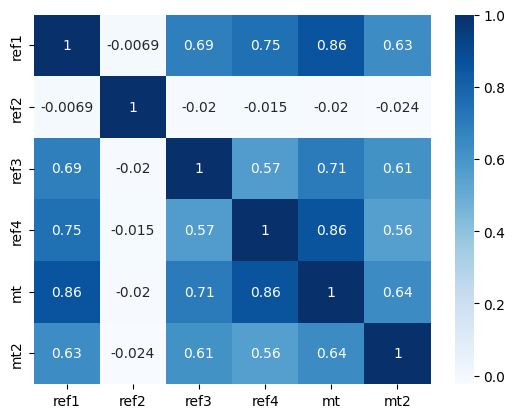

SL_900
src
5025169717931.154
371164455251.421
ref1
55166159813698.37
257285730888.63678
ref2
1485704651156.5107
79575742116.35716
ref3
51214201547666.234
404811282944.03076
ref4
52693847442976.055
277985802911.0414
mt
50609293174809.59
110609425365.10686
mt2
102546354282486.69
299790014846.8879
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000    -0.009095     0.690999     0.740772   0.866330   
ref2_SL_900    -0.009095     1.000000    -0.020975    -0.016754  -0.021375   
ref3_SL_900     0.690999    -0.020975     1.000000     0.570124   0.715555   
ref4_SL_900     0.740772    -0.016754     0.570124     1.000000   0.855305   
mt_SL_900       0.866330    -0.021375     0.715555     0.855305   1.000000   
mt2_SL_900      0.621313    -0.024657     0.609168     0.541369   0.625652   

             mt2_SL_900  
ref1_SL_900    0.621313  
ref2_SL_900   -0.024657  
ref3_SL_900    0.609168  
ref4_SL_900    0.541369  
mt_SL_900      0.625652  
m

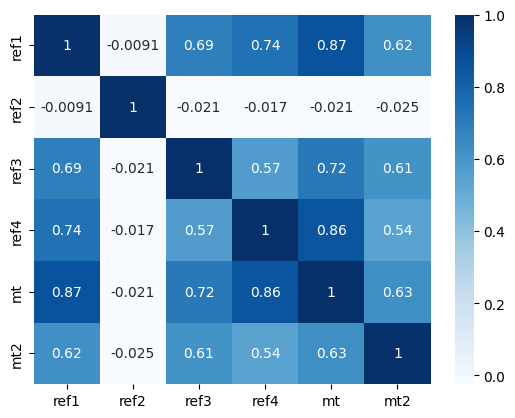

SL_925
src
13213338425008.05
836014175755.9829
ref1
155265751991284.5
570927753503.7024
ref2
3792640947871.821
170548070365.89185
ref3
142811046902320.75
917909893587.5916
ref4
148318223457065.9
615005425739.2699
mt
145111695549845.8
242677481009.20758
mt2
297464234986837.75
679796860573.5634
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000    -0.011032     0.691405     0.735182   0.870173   
ref2_SL_925    -0.011032     1.000000    -0.022007    -0.018281  -0.022546   
ref3_SL_925     0.691405    -0.022007     1.000000     0.568493   0.725311   
ref4_SL_925     0.735182    -0.018281     0.568493     1.000000   0.853471   
mt_SL_925       0.870173    -0.022546     0.725311     0.853471   1.000000   
mt2_SL_925      0.608716    -0.025007     0.605231     0.525824   0.612452   

             mt2_SL_925  
ref1_SL_925    0.608716  
ref2_SL_925   -0.025007  
ref3_SL_925    0.605231  
ref4_SL_925    0.525824  
mt_SL_925      0.612452  
mt2

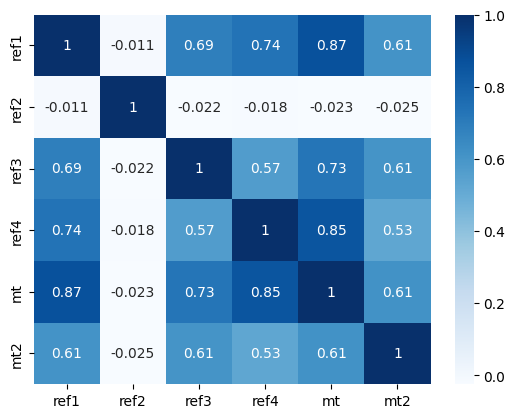

SL_950
src
34850247472212.29
1884283331109.4531
ref1
437852173685609.2
1267376086820.1426
ref2
9707885459158.865
370210657493.09094
ref3
399037997447991.7
2082644900243.352
ref4
418285487373823.56
1384086510974.7588
mt
416560076065855.2
532833150473.97
mt2
864727287089945.2
1541271936829.4912
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000    -0.012739     0.691494     0.729737   0.873586   
ref2_SL_950    -0.012739     1.000000    -0.022876    -0.019605  -0.023524   
ref3_SL_950     0.691494    -0.022876     1.000000     0.566578   0.734510   
ref4_SL_950     0.729737    -0.019605     0.566578     1.000000   0.851065   
mt_SL_950       0.873586    -0.023524     0.734510     0.851065   1.000000   
mt2_SL_950      0.596160    -0.025222     0.600859     0.510531   0.599153   

             mt2_SL_950  
ref1_SL_950    0.596160  
ref2_SL_950   -0.025222  
ref3_SL_950    0.600859  
ref4_SL_950    0.510531  
mt_SL_950      0.599153  
mt2

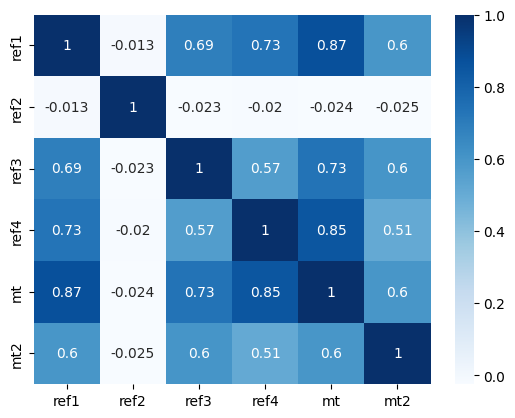

SL_975
src
92178233039508.98
4249520576092.678
ref1
1237029954941325.5
2814321254789.3184
ref2
24910861530980.02
808390262370.4792
ref3
1117130362116991.4
4727996767780.149
ref4
1181803814439176.8
3094754957905.1577
mt
1197041274587907.8
1173661481123.753
mt2
2518779052344463.5
3439817151395.492
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000    -0.014243     0.691298     0.724424   0.876603   
ref2_SL_975    -0.014243     1.000000    -0.023600    -0.020751  -0.024333   
ref3_SL_975     0.691298    -0.023600     1.000000     0.564406   0.743191   
ref4_SL_975     0.724424    -0.020751     0.564406     1.000000   0.848143   
mt_SL_975       0.876603    -0.024333     0.743191     0.848143   1.000000   
mt2_SL_975      0.583659    -0.025326     0.596097     0.495501   0.585799   

             mt2_SL_975  
ref1_SL_975    0.583659  
ref2_SL_975   -0.025326  
ref3_SL_975    0.596097  
ref4_SL_975    0.495501  
mt_SL_975      0.585799  


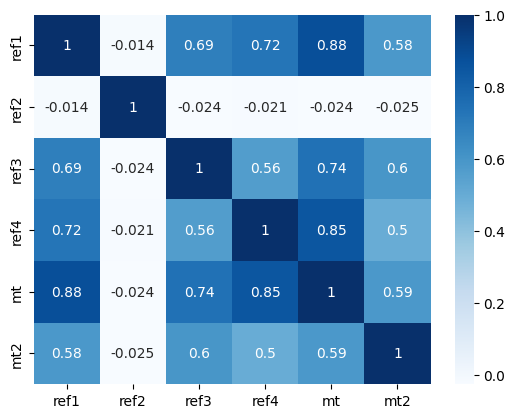

gini
src
0.32971138523171883
0.3342593905576323
ref1
0.44627421576872883
0.44449666447070163
ref2
0.40762426286624
0.4069214610359163
ref3
0.4288295431772443
0.423859140241433
ref4
0.448524293145077
0.44251897578531063
mt
0.417331752534721
0.41567899050493556
mt2
0.44305464446404635
0.4431987807033866
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.518910   0.600775   0.826448  0.668035  0.767228
ref2_gini   0.518910   1.000000   0.536616   0.558537  0.609164  0.639628
ref3_gini   0.600775   0.536616   1.000000   0.631985  0.567918  0.605291
ref4_gini   0.826448   0.558537   0.631985   1.000000  0.659066  0.789672
mt_gini     0.668035   0.609164   0.567918   0.659066  1.000000  0.739472
mt2_gini    0.767228   0.639628   0.605291   0.789672  0.739472  1.000000


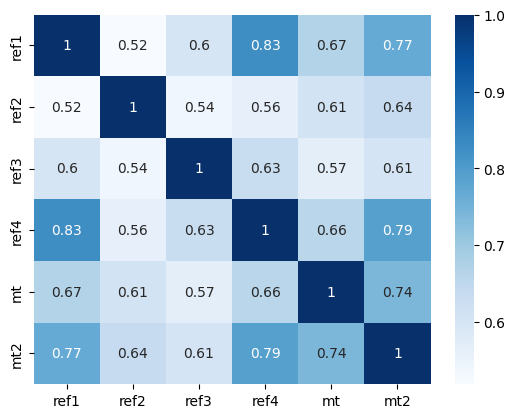

kl
src
-4.6569741162768965
-4.700664247164787
ref1
-4.272713487126267
-4.304929619106197
ref2
-4.339515495710869
-4.406069230358835
ref3
-4.225448140221351
-4.264253990286479
ref4
-4.305035753951337
-4.324774621717667
mt
-4.271120517407621
-4.309620719615964
mt2
-4.239470787413927
-4.272022170089509
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.970955  0.956087  0.979278  0.972499  0.980412
ref2_kl  0.970955  1.000000  0.960316  0.961423  0.977837  0.973219
ref3_kl  0.956087  0.960316  1.000000  0.950870  0.957469  0.959375
ref4_kl  0.979278  0.961423  0.950870  1.000000  0.962168  0.969459
mt_kl    0.972499  0.977837  0.957469  0.962168  1.000000  0.982669
mt2_kl   0.980412  0.973219  0.959375  0.969459  0.982669  1.000000


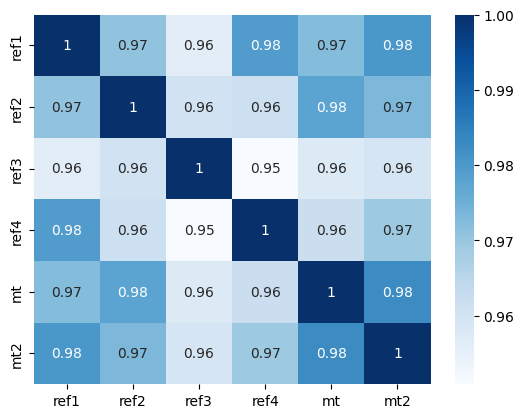

cv
src
0.619461482618071
0.6188531130334651
ref1
0.9377449796251054
0.8893892880480694
ref2
0.7987734182507666
0.7825436265016998
ref3
0.8796093474290689
0.825271332020295
ref4
0.9475047288945363
0.8995161543530488
mt
0.8366144584209861
0.803102325213478
mt2
0.9189462638766713
0.909060088050426
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.396347  0.577057  0.879991  0.660744  0.860782
ref2_cv  0.396347  1.000000  0.385081  0.409678  0.488524  0.475757
ref3_cv  0.577057  0.385081  1.000000  0.590470  0.469995  0.589684
ref4_cv  0.879991  0.409678  0.590470  1.000000  0.645023  0.859573
mt_cv    0.660744  0.488524  0.469995  0.645023  1.000000  0.725065
mt2_cv   0.860782  0.475757  0.589684  0.859573  0.725065  1.000000


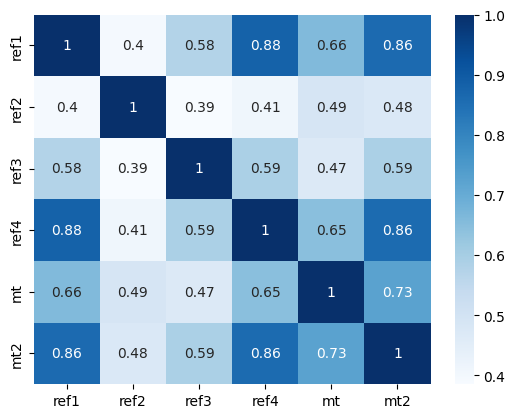

lv
src
70.61660964375977
64.19573431566207
ref1
84.22798640679845
50.87567365802084
ref2
49.73501226526721
40.52012420119131
ref3
95.63799847867584
60.84811302131979
ref4
82.01617934521747
46.05154002646453
mt
65.0552832768221
41.32221507523456
mt2
93.19674434669889
54.24211599186377
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.494403  0.509334  0.887988  0.630096  0.889491
ref2_lv  0.494403  1.000000  0.243669  0.479673  0.391817  0.519812
ref3_lv  0.509334  0.243669  1.000000  0.481705  0.340868  0.440542
ref4_lv  0.887988  0.479673  0.481705  1.000000  0.659817  0.920468
mt_lv    0.630096  0.391817  0.340868  0.659817  1.000000  0.737790
mt2_lv   0.889491  0.519812  0.440542  0.920468  0.737790  1.000000


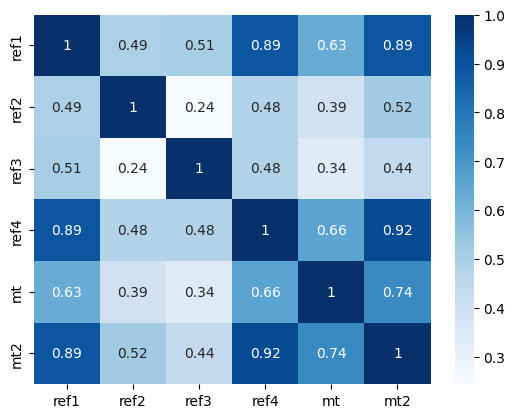

renyi
src
-1211.938583862788
-1159.3914677763003
ref1
-726.991106971894
-645.2393274724031
ref2
-643.6874352297278
-559.6980524943509
ref3
-823.5103771990723
-743.5876118257402
ref4
-720.5569047848227
-669.1654446774438
mt
-672.2587924086839
-567.7729231620287
mt2
-762.8394250821236
-697.728328779478
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.848794    0.853810    0.968107  0.889576   
ref2_renyi    0.848794    1.000000    0.839183    0.847576  0.897657   
ref3_renyi    0.853810    0.839183    1.000000    0.866677  0.846069   
ref4_renyi    0.968107    0.847576    0.866677    1.000000  0.876308   
mt_renyi      0.889576    0.897657    0.846069    0.876308  1.000000   
mt2_renyi     0.970455    0.854514    0.867233    0.971816  0.905428   

            mt2_renyi  
ref1_renyi   0.970455  
ref2_renyi   0.854514  
ref3_renyi   0.867233  
ref4_renyi   0.971816  
mt_renyi     0.905428  
mt2_renyi    1.000000  


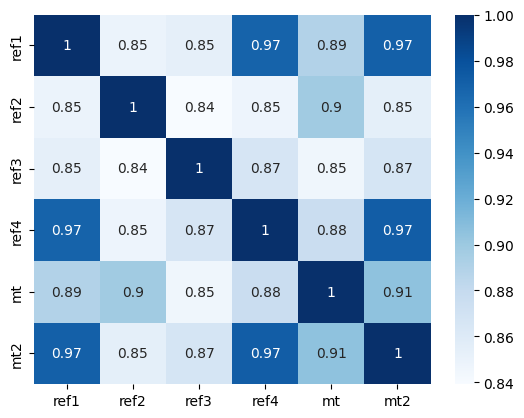

42.02190154044549
54.41321475988005
32.107163954427136
59.03412330899205
52.72303655551932
41.065848040795075


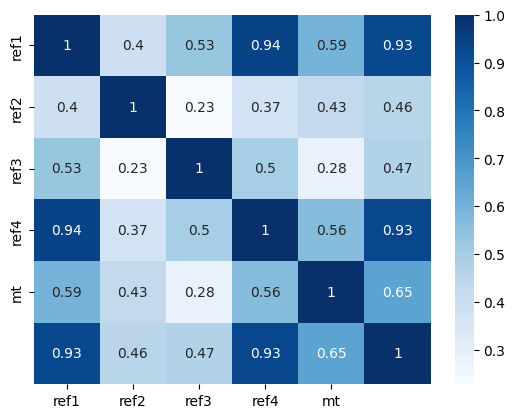

*************************************
54.37696801597435
54.37696801597435
32.08421868327242
60.068768881684115
52.710350002457794
41.02489689231113
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se Sp

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


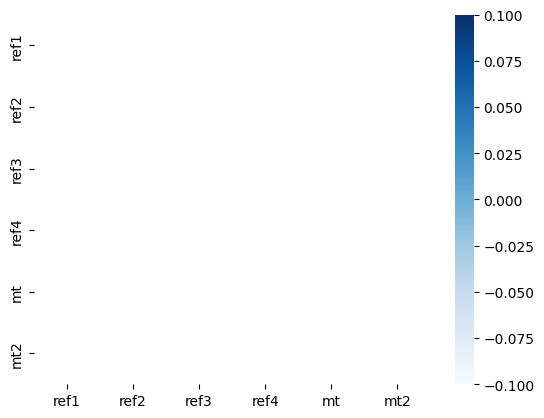

L
src
10.211511127247567
9.91642159210252
ref1
7.065084230654849
6.643263645654657
ref2
6.911661730400833
6.595600776764078
ref3
7.7290142735223295
7.379297543961841
ref4
6.943989020206794
6.495736553205643
mt
7.126153894618427
6.727668103937302
mt2
7.588798374685339
7.100668354497198
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.770808  0.700509  0.909371  0.644928  0.801929
ref2_L  0.770808  1.000000  0.641689  0.784042  0.640589  0.670987
ref3_L  0.700509  0.641689  1.000000  0.689487  0.497537  0.595532
ref4_L  0.909371  0.784042  0.689487  1.000000  0.628972  0.793396
mt_L    0.644928  0.640589  0.497537  0.628972  1.000000  0.801939
mt2_L   0.801929  0.670987  0.595532  0.793396  0.801939  1.000000


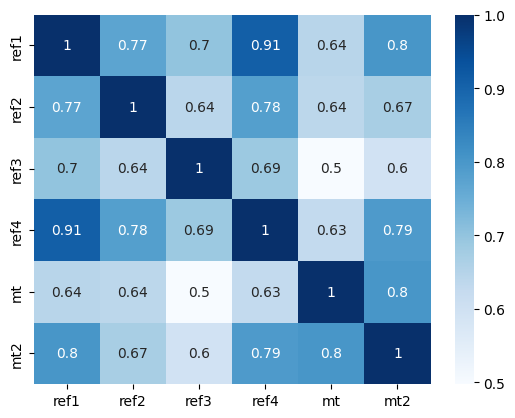

SL_25
src
1.7158199036178436
1.7084754300384066
ref1
1.4869492044256674
1.4816191883490168
ref2
1.49391528370487
1.4901440667358636
ref3
1.5272485361443653
1.5168528880357537
ref4
1.4796643661168656
1.4665731627100715
mt
1.5080076485050973
1.5041438168052976
mt2
1.5159652802677683
1.5102304103323823
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.798467    0.741415    0.860514  0.707175   
ref2_SL_25    0.798467    1.000000    0.731121    0.815471  0.716166   
ref3_SL_25    0.741415    0.731121    1.000000    0.719052  0.614276   
ref4_SL_25    0.860514    0.815471    0.719052    1.000000  0.719340   
mt_SL_25      0.707175    0.716166    0.614276    0.719340  1.000000   
mt2_SL_25     0.723171    0.702911    0.642915    0.735332  0.855336   

            mt2_SL_25  
ref1_SL_25   0.723171  
ref2_SL_25   0.702911  
ref3_SL_25   0.642915  
ref4_SL_25   0.735332  
mt_SL_25     0.855336  
mt2_SL_25    1.000000  


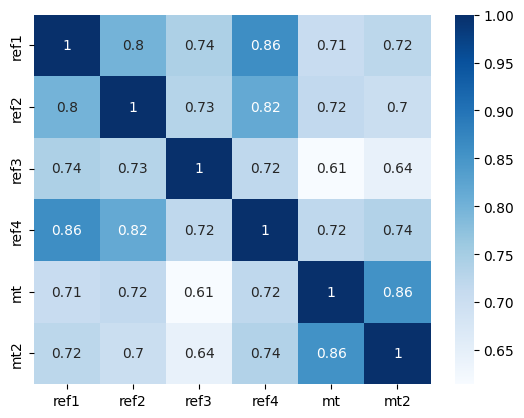

SL_50
src
3.032333587802964
2.994348112198704
ref1
2.374416848996417
2.3303098189121645
ref2
2.3815580016543496
2.366567033590661
ref3
2.4969618395929483
2.468434066730852
ref4
2.3518541747499957
2.2975680784387134
mt
2.42299880682216
2.3967986630479325
mt2
2.466675984309536
2.4281277330774858
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.795060    0.723905    0.879639  0.684902   
ref2_SL_50    0.795060    1.000000    0.700343    0.811976  0.698222   
ref3_SL_50    0.723905    0.700343    1.000000    0.705667  0.567382   
ref4_SL_50    0.879639    0.811976    0.705667    1.000000  0.686613   
mt_SL_50      0.684902    0.698222    0.567382    0.686613  1.000000   
mt2_SL_50     0.750318    0.696972    0.621771    0.754277  0.841783   

            mt2_SL_50  
ref1_SL_50   0.750318  
ref2_SL_50   0.696972  
ref3_SL_50   0.621771  
ref4_SL_50   0.754277  
mt_SL_50     0.841783  
mt2_SL_50    1.000000  


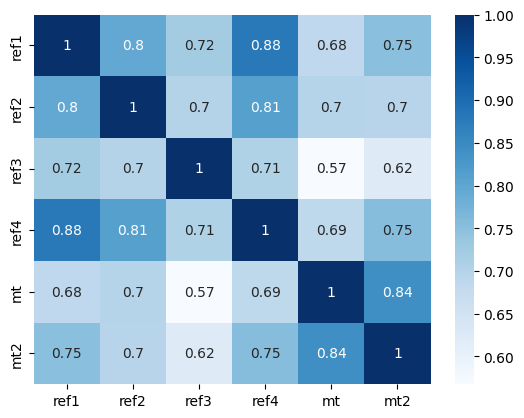

SL_75
src
5.500150418205578
5.387426818826963
ref1
3.9998605718873654
3.8585938562762485
ref2
3.9777462640457872
3.8892503416203215
ref3
4.295952073280773
4.195502424991252
ref4
3.9451646260094715
3.8096501272271746
mt
4.075269553679771
3.959904968197419
mt2
4.228947072538433
4.060416550960905
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.785025    0.710911    0.895942  0.664570   
ref2_SL_75    0.785025    1.000000    0.670803    0.800941  0.673813   
ref3_SL_75    0.710911    0.670803    1.000000    0.697171  0.530138   
ref4_SL_75    0.895942    0.800941    0.697171    1.000000  0.656974   
mt_SL_75      0.664570    0.673813    0.530138    0.656974  1.000000   
mt2_SL_75     0.777519    0.686140    0.606289    0.774811  0.823575   

            mt2_SL_75  
ref1_SL_75   0.777519  
ref2_SL_75   0.686140  
ref3_SL_75   0.606289  
ref4_SL_75   0.774811  
mt_SL_75     0.823575  
mt2_SL_75    1.000000  


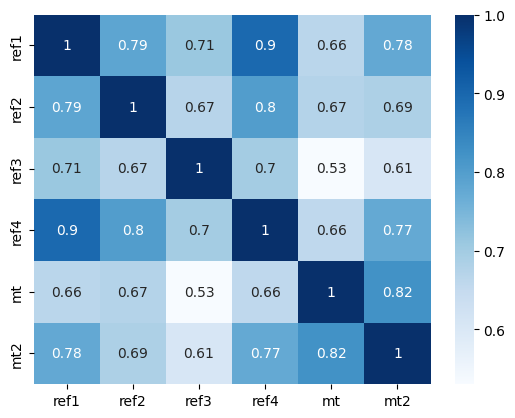

SL_100
src
10.211511127247567
9.91642159210252
ref1
7.065084230654849
6.643263645654657
ref2
6.911661730400833
6.595600776764078
ref3
7.7290142735223295
7.379297543961841
ref4
6.943989020206794
6.495736553205643
mt
7.126153894618427
6.727668103937302
mt2
7.588798374685339
7.100668354497198
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.770808     0.700509     0.909371   0.644928   
ref2_SL_100     0.770808     1.000000     0.641689     0.784042   0.640589   
ref3_SL_100     0.700509     0.641689     1.000000     0.689487   0.497537   
ref4_SL_100     0.909371     0.784042     0.689487     1.000000   0.628972   
mt_SL_100       0.644928     0.640589     0.497537     0.628972   1.000000   
mt2_SL_100      0.801929     0.670987     0.595532     0.793396   0.801939   

             mt2_SL_100  
ref1_SL_100    0.801929  
ref2_SL_100    0.670987  
ref3_SL_100    0.595532  
ref4_SL_100    0.793396  
mt_SL_100      0.801939  
mt2_SL

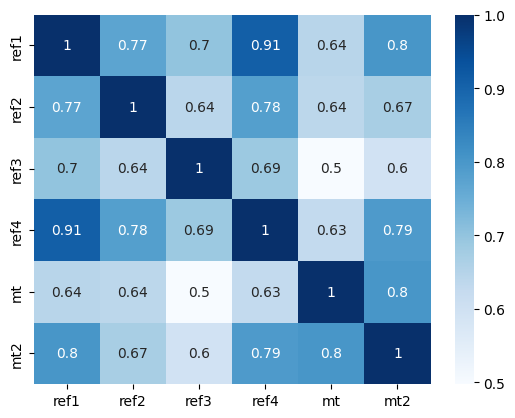

SL_125
src
19.365030885588965
18.687936361637508
ref1
13.05660337636528
11.944066631657318
ref2
12.45647686871516
11.608009383170783
ref3
14.504025240032618
13.248246296346284
ref4
12.79971062514059
11.878371421589122
mt
12.91842025945023
11.67796030872384
mt2
14.215833849742102
13.024028273001822
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.753670     0.690761     0.920237   0.625654   
ref2_SL_125     0.753670     1.000000     0.612010     0.762831   0.598862   
ref3_SL_125     0.690761     0.612010     1.000000     0.680421   0.467081   
ref4_SL_125     0.920237     0.762831     0.680421     1.000000   0.602437   
mt_SL_125       0.625654     0.598862     0.467081     0.602437   1.000000   
mt2_SL_125      0.822061     0.651590     0.587547     0.808639   0.778547   

             mt2_SL_125  
ref1_SL_125    0.822061  
ref2_SL_125    0.651590  
ref3_SL_125    0.587547  
ref4_SL_125    0.808639  
mt_SL_125      0.778547 

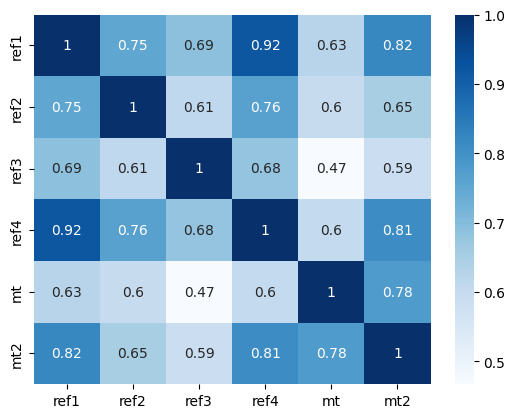

SL_150
src
37.45052879320806
35.78847869113898
ref1
25.216772667301278
22.062910900386655
ref2
23.252042669104497
20.9802009467479
ref3
28.347467536328647
24.53059374016863
ref4
24.68335251179279
21.83035639364951
mt
24.24817058293042
21.200184582257954
mt2
27.758517904847995
24.319105987658197
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.734835     0.680735     0.928831   0.606903   
ref2_SL_150     0.734835     1.000000     0.581690     0.739174   0.551055   
ref3_SL_150     0.680735     0.581690     1.000000     0.669596   0.438483   
ref4_SL_150     0.928831     0.739174     0.669596     1.000000   0.577980   
mt_SL_150       0.606903     0.551055     0.438483     0.577980   1.000000   
mt2_SL_150      0.836957     0.628144     0.580877     0.819870   0.755396   

             mt2_SL_150  
ref1_SL_150    0.836957  
ref2_SL_150    0.628144  
ref3_SL_150    0.580877  
ref4_SL_150    0.819870  
mt_SL_150      0.755396  
m

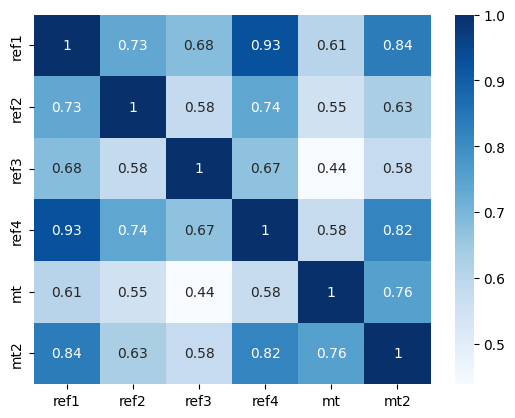

SL_175
src
73.76707514674146
69.69690026132474
ref1
50.82810732988402
41.28871306083464
ref2
44.916267697751685
38.828501791606044
ref3
57.6178600715383
46.00358202642943
ref4
49.73195899166953
40.525609336298345
mt
47.09913217135267
39.18752399425195
mt2
56.421824750911334
45.42315555411177
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.715665     0.670361     0.935373   0.589090   
ref2_SL_175     0.715665     1.000000     0.551289     0.715034   0.500733   
ref3_SL_175     0.670361     0.551289     1.000000     0.657590   0.412567   
ref4_SL_175     0.935373     0.715034     0.657590     1.000000   0.556486   
mt_SL_175       0.589090     0.500733     0.412567     0.556486   1.000000   
mt2_SL_175      0.846053     0.601159     0.574657     0.826651   0.734433   

             mt2_SL_175  
ref1_SL_175    0.846053  
ref2_SL_175    0.601159  
ref3_SL_175    0.574657  
ref4_SL_175    0.826651  
mt_SL_175      0.734433  
mt2_

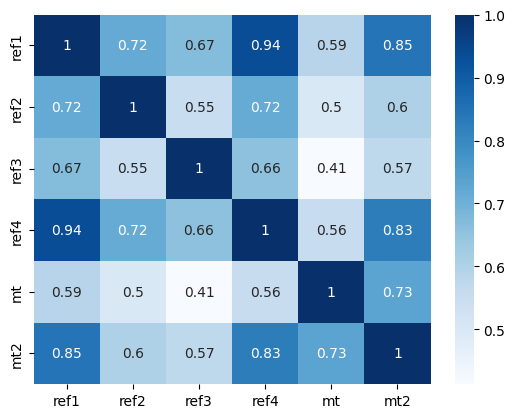

SL_200
src
147.84281085773674
137.00847151636816
ref1
106.69504453681779
79.67534533054146
ref2
89.71316618067999
72.79142432523062
ref3
121.5486524728279
89.3467786639509
ref4
104.45183918550117
78.52323327861514
mt
94.63197891915796
72.12446371474603
mt2
119.16194954877344
86.85621021450842
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.697466     0.660046     0.940037   0.572798   
ref2_SL_200     0.697466     1.000000     0.521580     0.692130   0.451592   
ref3_SL_200     0.660046     0.521580     1.000000     0.645291   0.390453   
ref4_SL_200     0.940037     0.692130     0.645291     1.000000   0.538807   
mt_SL_200       0.572798     0.451592     0.390453     0.538807   1.000000   
mt2_SL_200      0.849221     0.571480     0.568452     0.828744   0.717276   

             mt2_SL_200  
ref1_SL_200    0.849221  
ref2_SL_200    0.571480  
ref3_SL_200    0.568452  
ref4_SL_200    0.828744  
mt_SL_200      0.717276  
mt2

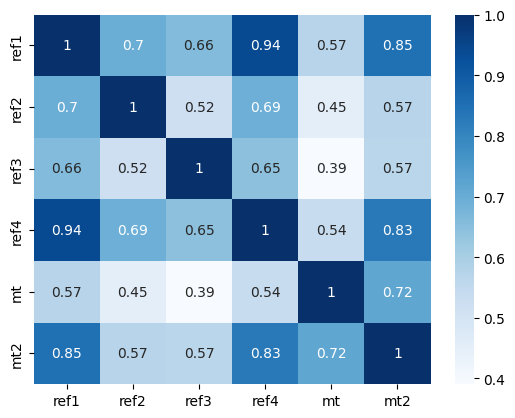

SL_225
src
301.2466761680831
275.52337897331546
ref1
232.5393716675845
156.80991037438517
ref2
185.07104266935517
138.93328980818896
ref3
265.4256905216623
178.39157253714575
ref4
227.95037434834077
155.0343895781229
mt
196.5754987730019
136.74811376691025
mt2
260.8639338912608
174.45874747732208
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.681249     0.650370     0.942977   0.558693   
ref2_SL_225     0.681249     1.000000     0.493265     0.671673   0.406650   
ref3_SL_225     0.650370     0.493265     1.000000     0.633551   0.373096   
ref4_SL_225     0.942977     0.671673     0.633551     1.000000   0.525579   
mt_SL_225       0.558693     0.406650     0.373096     0.525579   1.000000   
mt2_SL_225      0.846756     0.540170     0.562114     0.826164   0.705021   

             mt2_SL_225  
ref1_SL_225    0.846756  
ref2_SL_225    0.540170  
ref3_SL_225    0.562114  
ref4_SL_225    0.826164  
mt_SL_225      0.705021  

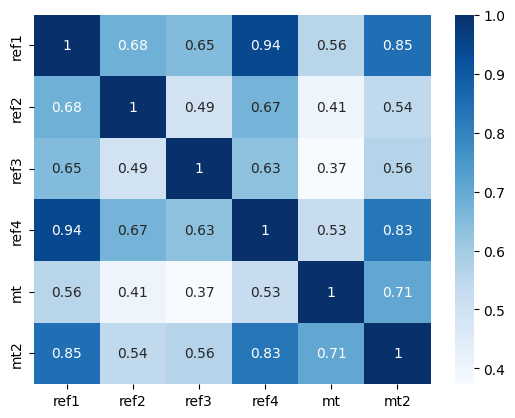

SL_250
src
623.645866435032
555.8978641182189
ref1
524.2595735559845
309.75338496056685
ref2
393.7338159354037
276.0710622821084
ref3
598.0620632150027
361.08556942843325
ref4
514.8519364799334
308.607527270038
mt
421.8236107554122
270.54572563201714
mt2
590.1767601351069
362.04894082932435
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.667609     0.641885     0.944354   0.547384   
ref2_SL_250     0.667609     1.000000     0.466865     0.654291   0.367849   
ref3_SL_250     0.641885     0.466865     1.000000     0.623041   0.361068   
ref4_SL_250     0.944354     0.654291     0.623041     1.000000   0.517112   
mt_SL_250       0.547384     0.367849     0.361068     0.517112   1.000000   
mt2_SL_250      0.839307     0.508353     0.555676     0.819196   0.698134   

             mt2_SL_250  
ref1_SL_250    0.839307  
ref2_SL_250    0.508353  
ref3_SL_250    0.555676  
ref4_SL_250    0.819196  
mt_SL_250      0.698134  
mt2_S

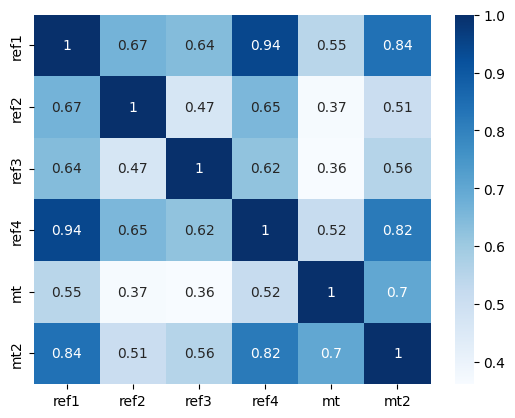

SL_275
src
1310.977397071309
1132.7542992350716
ref1
1217.6676170866044
624.2598745148448
ref2
862.2482652508937
545.9289370715137
ref3
1385.5897162881733
744.0550338520552
ref4
1198.3083408868606
630.5397658403739
mt
933.9282594203886
541.0475614919601
mt2
1375.2902506488015
750.3268050917161
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.656732     0.635027     0.944346   0.539295   
ref2_SL_275     0.656732     1.000000     0.442714     0.640108   0.336025   
ref3_SL_275     0.635027     0.442714     1.000000     0.614222   0.354503   
ref4_SL_275     0.944346     0.640108     0.614222     1.000000   0.513346   
mt_SL_275       0.539295     0.336025     0.354503     0.513346   1.000000   
mt2_SL_275      0.827758     0.477061     0.549274     0.808358   0.696430   

             mt2_SL_275  
ref1_SL_275    0.827758  
ref2_SL_275    0.477061  
ref3_SL_275    0.549274  
ref4_SL_275    0.808358  
mt_SL_275      0.696430  
mt

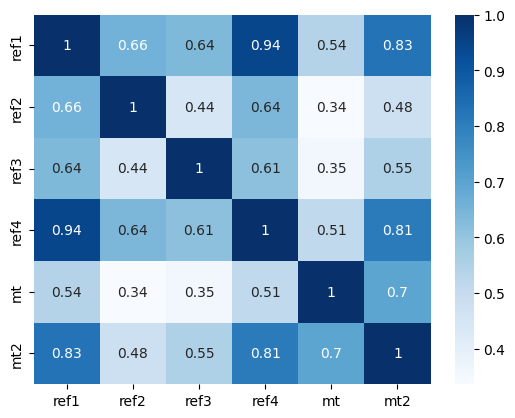

SL_300
src
2796.8218905645454
2387.612248532461
ref1
2901.8924525583693
1281.7137151277702
ref2
1939.4471035901493
1111.631542007382
ref3
3288.9951156458897
1540.7558759157987
ref4
2861.8540244259484
1284.9407377827827
mt
2129.9543357398693
1083.0006652792003
mt2
3289.719610144084
1495.7131943918712
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.648494     0.630079     0.943145   0.534582   
ref2_SL_300     0.648494     1.000000     0.421008     0.628899   0.311129   
ref3_SL_300     0.630079     0.421008     1.000000     0.607355   0.353151   
ref4_SL_300     0.943145     0.628899     0.607355     1.000000   0.513893   
mt_SL_300       0.534582     0.311129     0.353151     0.513893   1.000000   
mt2_SL_300      0.813104     0.447147     0.543087     0.794338   0.699178   

             mt2_SL_300  
ref1_SL_300    0.813104  
ref2_SL_300    0.447147  
ref3_SL_300    0.543087  
ref4_SL_300    0.794338  
mt_SL_300      0.69917

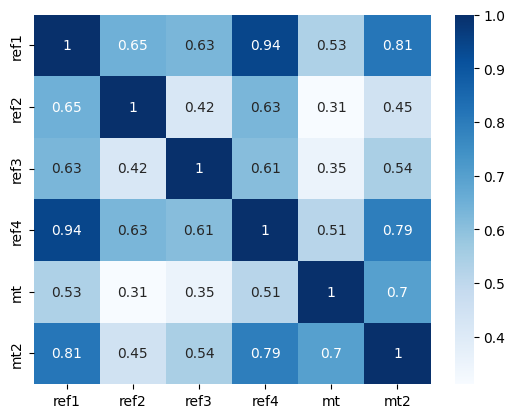

SL_325
src
6052.440412343158
5067.499631975445
ref1
7069.070558130303
2643.7951751212386
ref2
4470.054912405991
2270.1551095423733
ref3
7971.968479419075
3208.339530111478
ref4
6985.7695809727
2582.17169543333
mt
4993.890207374547
2221.2555571388148
mt2
8050.749509499944
3243.979717675998
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.642580     0.627171     0.940957   0.533134   
ref2_SL_325     0.642580     1.000000     0.401846     0.620250   0.292534   
ref3_SL_325     0.627171     0.401846     1.000000     0.602533   0.356469   
ref4_SL_325     0.940957     0.620250     0.602533     1.000000   0.518123   
mt_SL_325       0.533134     0.292534     0.356469     0.518123   1.000000   
mt2_SL_325      0.796340     0.419237     0.537285     0.777903   0.705288   

             mt2_SL_325  
ref1_SL_325    0.796340  
ref2_SL_325    0.419237  
ref3_SL_325    0.537285  
ref4_SL_325    0.777903  
mt_SL_325      0.705288  
mt2_SL_

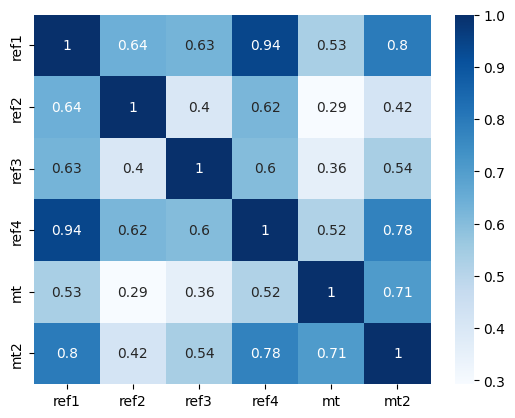

SL_350
src
13279.478374280556
10815.499306469592
ref1
17543.621871217376
5517.393206886154
ref2
10531.533275236694
4605.550109120226
ref3
19670.631386187935
6715.674019988327
ref4
17369.152709251513
5446.282671035484
mt
12010.024261985165
4665.338644921985
mt2
20095.929330513816
7124.196769176768
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.638592     0.626293     0.937981   0.534623   
ref2_SL_350     0.638592     1.000000     0.385262     0.613685   0.279321   
ref3_SL_350     0.626293     0.385262     1.000000     0.599712   0.363742   
ref4_SL_350     0.937981     0.613685     0.599712     1.000000   0.525279   
mt_SL_350       0.534623     0.279321     0.363742     0.525279   1.000000   
mt2_SL_350      0.778363     0.393728     0.531998     0.759819   0.713523   

             mt2_SL_350  
ref1_SL_350    0.778363  
ref2_SL_350    0.393728  
ref3_SL_350    0.531998  
ref4_SL_350    0.759819  
mt_SL_350      0.713523  

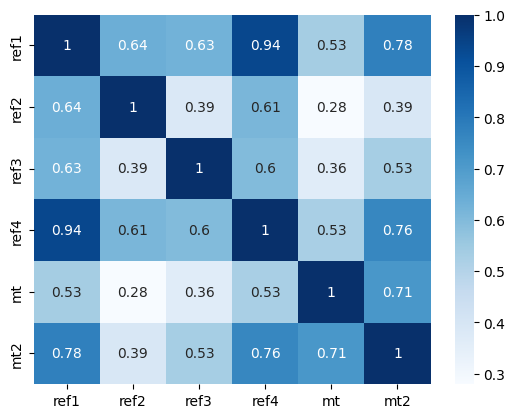

SL_375
src
29526.03133636129
23324.288337065693
ref1
44229.666507198526
11661.018027162547
ref2
25304.618206053387
9501.256900938839
ref3
49280.116065777496
14349.704153530472
ref4
43861.61731189191
11886.15289696616
mt
29556.00444245939
9807.902414759184
mt2
51028.47275701645
15885.453039566157
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.636128     0.627331     0.934400   0.538587   
ref2_SL_375     0.636128     1.000000     0.371243     0.608746   0.270488   
ref3_SL_375     0.627331     0.371243     1.000000     0.598746   0.374183   
ref4_SL_375     0.934400     0.608746     0.598746     1.000000   0.534582   
mt_SL_375       0.538587     0.270488     0.374183     0.534582   1.000000   
mt2_SL_375      0.759919     0.370797     0.527286     0.740777   0.722692   

             mt2_SL_375  
ref1_SL_375    0.759919  
ref2_SL_375    0.370797  
ref3_SL_375    0.527286  
ref4_SL_375    0.740777  
mt_SL_375      0.722692  


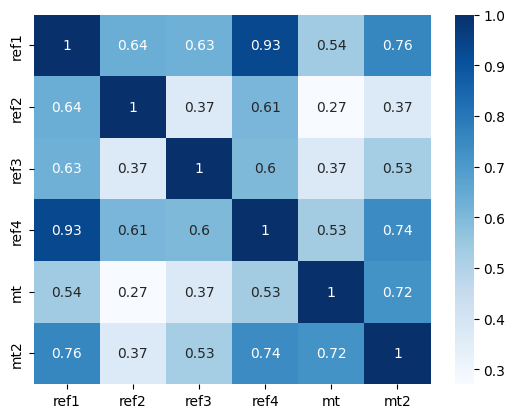

SL_400
src
66494.96119344678
50745.4892341152
ref1
113009.6944373276
25291.19718451128
ref2
61871.368250925785
19546.18577319069
ref3
125070.33056638445
31485.73014435333
ref4
112227.45025037351
26359.229683751943
mt
74249.00476041471
20612.98215557177
mt2
131508.75952111327
34866.647380017646
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.634827     0.630087     0.930376   0.544506   
ref2_SL_400     0.634827     1.000000     0.359737     0.605038   0.265087   
ref3_SL_400     0.630087     0.359737     1.000000     0.599419   0.387008   
ref4_SL_400     0.930376     0.605038     0.599419     1.000000   0.545306   
mt_SL_400       0.544506     0.265087     0.387008     0.545306   1.000000   
mt2_SL_400      0.741568     0.350446     0.523142     0.721347   0.731778   

             mt2_SL_400  
ref1_SL_400    0.741568  
ref2_SL_400    0.350446  
ref3_SL_400    0.523142  
ref4_SL_400    0.721347  
mt_SL_400      0.731778  
mt

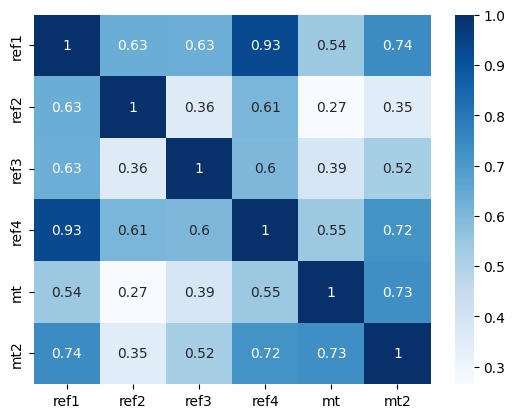

SL_425
src
151605.1445348483
107414.33371279857
ref1
292066.807350595
54436.95529334256
ref2
153638.87499722475
41449.27071971045
ref3
320967.12346204364
69539.2590503908
ref4
290391.64265265514
58841.83422983347
mt
189955.3941814022
42047.65309856247
mt2
343319.10495306767
75119.25342016676
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.634392     0.634320     0.926042   0.551866   
ref2_SL_425     0.634392     1.000000     0.350662     0.602245   0.262284   
ref3_SL_425     0.634320     0.350662     1.000000     0.601477   0.401494   
ref4_SL_425     0.926042     0.602245     0.601477     1.000000   0.556823   
mt_SL_425       0.551866     0.262284     0.401494     0.556823   1.000000   
mt2_SL_425      0.723690     0.332541     0.519497     0.701967   0.739997   

             mt2_SL_425  
ref1_SL_425    0.723690  
ref2_SL_425    0.332541  
ref3_SL_425    0.519497  
ref4_SL_425    0.701967  
mt_SL_425      0.739997  
mt2_

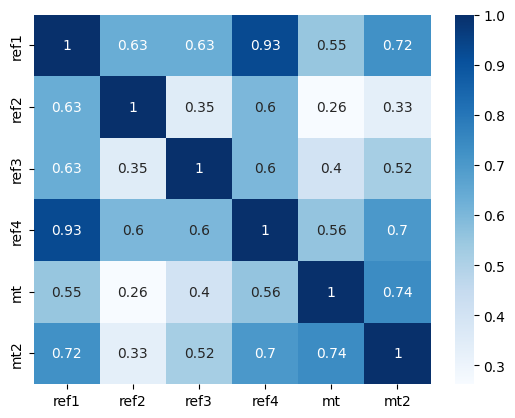

SL_450
src
349750.43900701974
239274.23862115724
ref1
762304.2388441634
116930.88593383803
ref2
386784.7990861542
88860.16346090293
ref3
831631.1297506267
153671.1984408623
ref4
758690.3152808176
132032.56508278596
mt
493809.6313905442
89733.19779132327
mt2
906456.67179425
161246.58805027528
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.634594     0.639767     0.921502   0.560197   
ref2_SL_450     0.634594     1.000000     0.343909     0.600129   0.261389   
ref3_SL_450     0.639767     0.343909     1.000000     0.604657   0.417004   
ref4_SL_450     0.921502     0.600129     0.604657     1.000000   0.568618   
mt_SL_450       0.560197     0.261389     0.417004     0.568618   1.000000   
mt2_SL_450      0.706504     0.316865     0.516234     0.682935   0.746803   

             mt2_SL_450  
ref1_SL_450    0.706504  
ref2_SL_450    0.316865  
ref3_SL_450    0.516234  
ref4_SL_450    0.682935  
mt_SL_450      0.746803  
mt2_

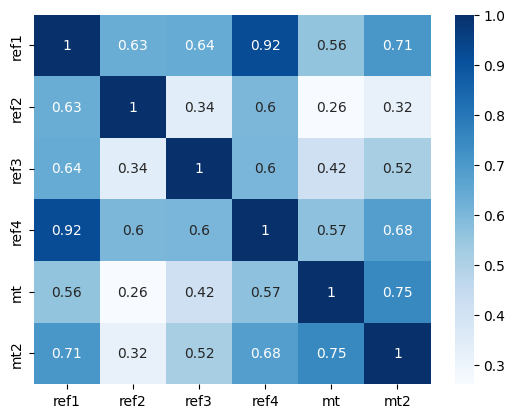

SL_475
src
816009.8847112523
525034.1888591917
ref1
2006776.7452787189
256207.99641465954
ref2
985655.3412827074
189139.3503530277
ref3
2172841.4150970946
345527.38434328104
ref4
1998925.2089878207
297299.9655533213
mt
1301736.7408915423
195429.4780140348
mt2
2417277.295875957
347557.95934491354
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.635269     0.646167     0.916837   0.569090   
ref2_SL_475     0.635269     1.000000     0.339349     0.598515   0.261847   
ref3_SL_475     0.646167     0.339349     1.000000     0.608703   0.433001   
ref4_SL_475     0.916837     0.598515     0.608703     1.000000   0.580293   
mt_SL_475       0.569090     0.261847     0.433001     0.580293   1.000000   
mt2_SL_475      0.690101     0.303150     0.513212     0.664436   0.751866   

             mt2_SL_475  
ref1_SL_475    0.690101  
ref2_SL_475    0.303150  
ref3_SL_475    0.513212  
ref4_SL_475    0.664436  
mt_SL_475      0.751866  


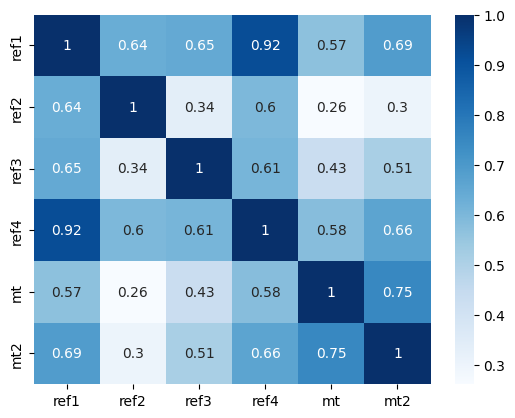

SL_500
src
1924403.405301824
1175499.1198987286
ref1
5322841.838958706
556559.6528187161
ref2
2539146.4982613325
402854.2235376296
ref3
5718953.461585838
770882.8064229
ref4
5305670.010264766
660384.3594968237
mt
3473277.951065661
424666.1116084916
mt2
6503688.930535486
752000.660672043
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.636305     0.653279     0.912105   0.578207   
ref2_SL_500     0.636305     1.000000     0.336846     0.597287   0.263225   
ref3_SL_500     0.653279     0.336846     1.000000     0.613382   0.449051   
ref4_SL_500     0.912105     0.597287     0.613382     1.000000   0.591552   
mt_SL_500       0.578207     0.263225     0.449051     0.591552   1.000000   
mt2_SL_500      0.674481     0.291114     0.510280     0.646561   0.755028   

             mt2_SL_500  
ref1_SL_500    0.674481  
ref2_SL_500    0.291114  
ref3_SL_500    0.510280  
ref4_SL_500    0.646561  
mt_SL_500      0.755028  
mt2_SL_50

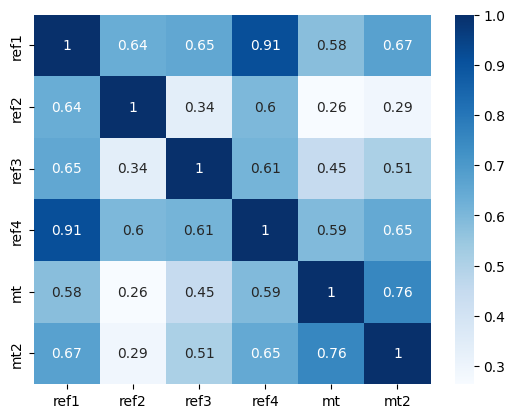

SL_525
src
4584894.057092059
2539933.8119729375
ref1
14213260.537225338
1223251.8539352622
ref2
6604763.873875221
871797.8547530565
ref3
15151023.917342221
1684180.6501963967
ref4
14175458.905562172
1446520.2710557994
mt
9364768.111402392
913354.4207689468
mt2
17638045.827613294
1632528.5520845042
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.637633     0.660888     0.907351   0.587278   
ref2_SL_525     0.637633     1.000000     0.336255     0.596365   0.265195   
ref3_SL_525     0.660888     0.336255     1.000000     0.618493   0.464812   
ref4_SL_525     0.907351     0.596365     0.618493     1.000000   0.602184   
mt_SL_525       0.587278     0.265195     0.464812     0.602184   1.000000   
mt2_SL_525      0.659582     0.280485     0.507294     0.629338   0.756257   

             mt2_SL_525  
ref1_SL_525    0.659582  
ref2_SL_525    0.280485  
ref3_SL_525    0.507294  
ref4_SL_525    0.629338  
mt_SL_525      0.756257 

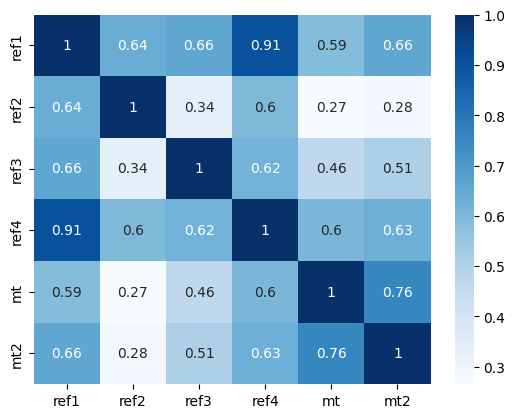

SL_550
src
11029694.493780375
5527291.345079647
ref1
38180943.79146667
2680189.590195045
ref2
17330219.890109062
1895901.0735346414
ref3
40375234.01761301
3727987.4013773142
ref4
38097128.158869036
3149474.993001364
mt
25478438.43330473
1947369.1364050042
mt2
48179918.32298728
3573282.9055510894
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.639215     0.668813     0.902603   0.596088   
ref2_SL_550     0.639215     1.000000     0.337436     0.595702   0.267507   
ref3_SL_550     0.668813     0.337436     1.000000     0.623869   0.480025   
ref4_SL_550     0.902603     0.595702     0.623869     1.000000   0.612051   
mt_SL_550       0.596088     0.267507     0.480025     0.612051   1.000000   
mt2_SL_550      0.645306     0.271010     0.504124     0.612746   0.755605   

             mt2_SL_550  
ref1_SL_550    0.645306  
ref2_SL_550    0.271010  
ref3_SL_550    0.504124  
ref4_SL_550    0.612746  
mt_SL_550      0.755605  


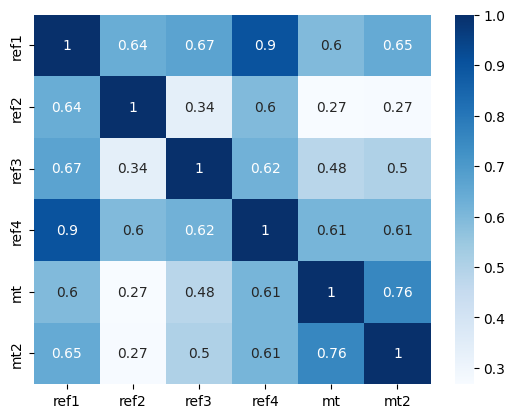

SL_575
src
26777380.81795083
12368663.179223837
ref1
103121917.48496118
6102507.997205838
ref2
45831007.745156765
4045224.9876545174
ref3
108167851.47366597
8215120.527615246
ref4
102934307.18983307
6970838.161209367
mt
69859758.80978529
4121192.1852883995
mt2
132472185.7535478
8098111.297806259
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.641036     0.676905     0.897883   0.604477   
ref2_SL_575     0.641036     1.000000     0.340253     0.595273   0.269978   
ref3_SL_575     0.676905     0.340253     1.000000     0.629375   0.494500   
ref4_SL_575     0.897883     0.595273     0.629375     1.000000   0.621065   
mt_SL_575       0.604477     0.269978     0.494500     0.621065   1.000000   
mt2_SL_575      0.631543     0.262465     0.500663     0.596741   0.753185   

             mt2_SL_575  
ref1_SL_575    0.631543  
ref2_SL_575    0.262465  
ref3_SL_575    0.500663  
ref4_SL_575    0.596741  
mt_SL_575      0.753185  


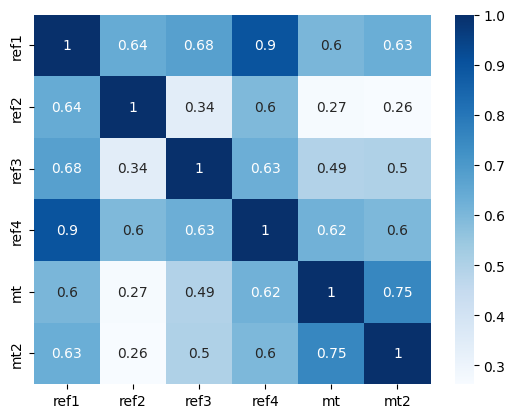

SL_600
src
65571469.76712747
27455892.468231287
ref1
279895511.10079044
13464433.59727445
ref2
122069369.19263461
8726091.053878158
ref3
291202272.9226168
18006742.29009786
ref4
279469389.5975977
15512692.041858846
mt
192839242.16540575
8741990.236932622
mt2
366424640.320955
18399607.167487286
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.643097     0.685049     0.893206   0.612322   
ref2_SL_600     0.643097     1.000000     0.344581     0.595066   0.272472   
ref3_SL_600     0.685049     0.344581     1.000000     0.634910   0.508106   
ref4_SL_600     0.893206     0.595066     0.634910     1.000000   0.629180   
mt_SL_600       0.612322     0.272472     0.508106     0.629180   1.000000   
mt2_SL_600      0.618179     0.254657     0.496824     0.581264   0.749137   

             mt2_SL_600  
ref1_SL_600    0.618179  
ref2_SL_600    0.254657  
ref3_SL_600    0.496824  
ref4_SL_600    0.581264  
mt_SL_600      0.749137  
mt

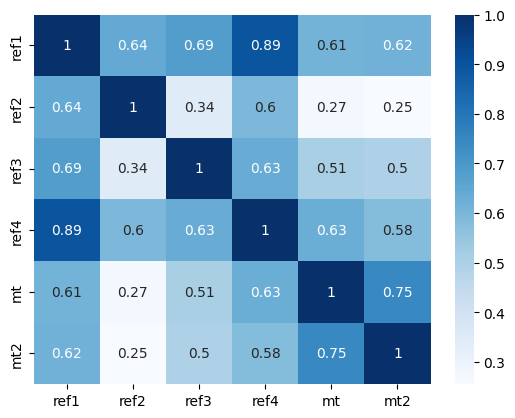

SL_625
src
161874865.1296033
61125063.16988797
ref1
763137952.4887607
29606499.71504356
ref2
327245422.0704664
18622627.649272956
ref3
787481523.0798082
40043096.06871251
ref4
762146631.1102089
35037122.44917897
mt
535402383.8157927
18645952.546665125
mt2
1019145118.6775403
41898851.963128135
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.645409     0.693156     0.888584   0.619535   
ref2_SL_625     0.645409     1.000000     0.350305     0.595080   0.274891   
ref3_SL_625     0.693156     0.350305     1.000000     0.640398   0.520752   
ref4_SL_625     0.888584     0.595080     0.640398     1.000000   0.636379   
mt_SL_625       0.619535     0.274891     0.520752     0.636379   1.000000   
mt2_SL_625      0.605104     0.247426     0.492544     0.566252   0.743617   

             mt2_SL_625  
ref1_SL_625    0.605104  
ref2_SL_625    0.247426  
ref3_SL_625    0.492544  
ref4_SL_625    0.566252  
mt_SL_625      0.743617  
mt2

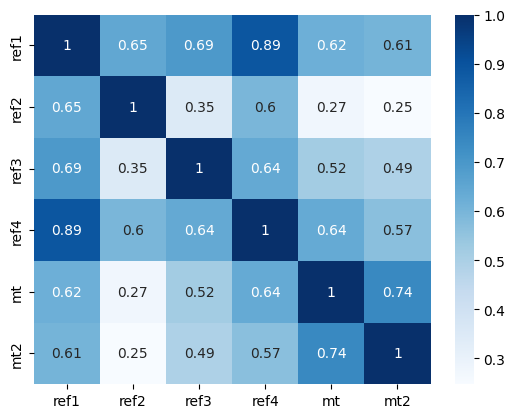

SL_650
src
402663287.21272
136555136.96661842
ref1
2089390588.0543244
65166474.78707352
ref2
882521010.5778048
39771485.17315441
ref3
2138436010.7734663
89249127.36550698
ref4
2086994458.4188287
79601901.03247246
mt
1493972886.8712673
40501112.342352405
mt2
2849011250.0031137
93274587.90682024
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.647988     0.701165     0.884026   0.626050   
ref2_SL_650     0.647988     1.000000     0.357319     0.595320   0.277165   
ref3_SL_650     0.701165     0.357319     1.000000     0.645787   0.532386   
ref4_SL_650     0.884026     0.595320     0.645787     1.000000   0.642666   
mt_SL_650       0.626050     0.277165     0.532386     0.642666   1.000000   
mt2_SL_650      0.592223     0.240637     0.487779     0.551645   0.736786   

             mt2_SL_650  
ref1_SL_650    0.592223  
ref2_SL_650    0.240637  
ref3_SL_650    0.487779  
ref4_SL_650    0.551645  
mt_SL_650      0.736786  
mt

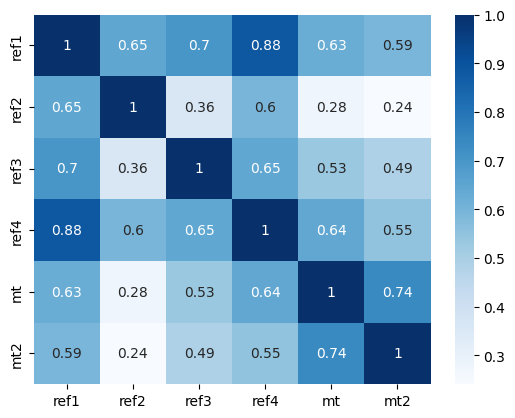

SL_675
src
1008763482.5921872
301100437.7826258
ref1
5742667536.140955
144206813.23488975
ref2
2393082354.0287414
85138808.64578281
ref3
5829669048.260489
199960914.8891108
ref4
5736543205.400178
181215650.38204604
mt
4186914960.5271263
88086396.74764752
mt2
8001931017.53428
202539849.48156953
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.650853     0.709032     0.879539   0.631824   
ref2_SL_675     0.650853     1.000000     0.365531     0.595794   0.279242   
ref3_SL_675     0.709032     0.365531     1.000000     0.651046   0.542980   
ref4_SL_675     0.879539     0.595794     0.651046     1.000000   0.648059   
mt_SL_675       0.631824     0.279242     0.542980     0.648059   1.000000   
mt2_SL_675      0.579450     0.234181     0.482501     0.537387   0.728798   

             mt2_SL_675  
ref1_SL_675    0.579450  
ref2_SL_675    0.234181  
ref3_SL_675    0.482501  
ref4_SL_675    0.537387  
mt_SL_675      0.728798  
mt

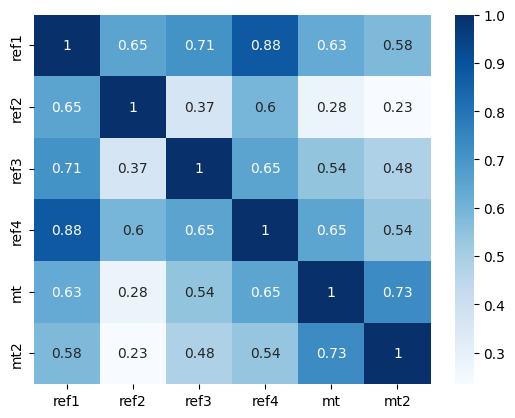

SL_700
src
2543988667.46707
660574048.4768372
ref1
15840537489.346603
321281182.34837604
ref2
6522204228.511622
188693875.5270808
ref3
15950741228.787447
457076188.1992363
ref4
15823731562.131674
403570241.7837923
mt
11778480190.792978
194066607.89901567
mt2
22573047740.676258
440496395.4351448
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.654026     0.716734     0.875132   0.636824   
ref2_SL_700     0.654026     1.000000     0.374856     0.596515   0.281087   
ref3_SL_700     0.716734     0.374856     1.000000     0.656158   0.552523   
ref4_SL_700     0.875132     0.596515     0.656158     1.000000   0.652585   
mt_SL_700       0.636824     0.281087     0.552523     0.652585   1.000000   
mt2_SL_700      0.566718     0.227971     0.476698     0.523427   0.719801   

             mt2_SL_700  
ref1_SL_700    0.566718  
ref2_SL_700    0.227971  
ref3_SL_700    0.476698  
ref4_SL_700    0.523427  
mt_SL_700      0.719801  
m

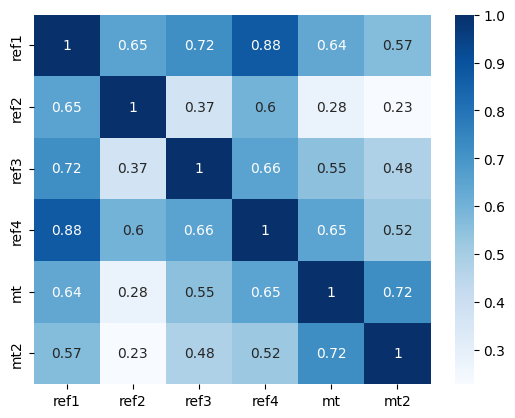

SL_725
src
6455374132.250073
1453516880.8054214
ref1
43841634583.43223
719467921.4269595
ref2
17859966119.254196
414652927.30066156
ref3
43794297347.86703
1024140220.5562193
ref4
43791869119.4568
896887164.1949109
mt
33244474008.024387
429290749.6272493
mt2
63936113655.19579
974427155.7286874
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.657526     0.724257     0.870812   0.641033   
ref2_SL_725     0.657526     1.000000     0.385218     0.597495   0.282677   
ref3_SL_725     0.724257     0.385218     1.000000     0.661117   0.561019   
ref4_SL_725     0.870812     0.597495     0.661117     1.000000   0.656276   
mt_SL_725       0.641033     0.282677     0.561019     0.656276   1.000000   
mt2_SL_725      0.553968     0.221939     0.470371     0.509725   0.709932   

             mt2_SL_725  
ref1_SL_725    0.553968  
ref2_SL_725    0.221939  
ref3_SL_725    0.470371  
ref4_SL_725    0.509725  
mt_SL_725      0.709932  
mt2

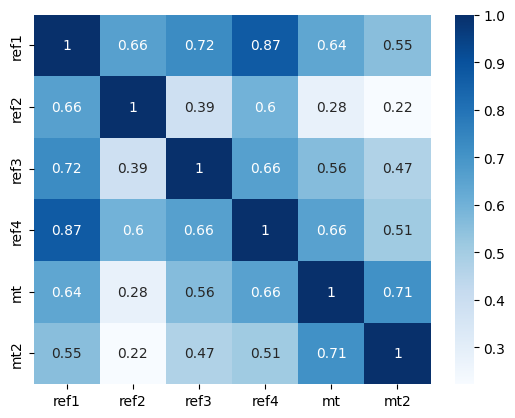

SL_750
src
16474751893.586031
3216083910.8851676
ref1
121723304760.31485
1603450818.362917
ref2
49122493151.57004
909832607.9299192
ref3
120635362969.0243
2274299965.1710935
ref4
121565635917.22786
1994378470.8726351
mt
94103816397.1918
963131675.9171965
mt2
181777532991.9863
2192670263.075741
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.661371     0.731600     0.866589   0.644437   
ref2_SL_750     0.661371     1.000000     0.396547     0.598747   0.283993   
ref3_SL_750     0.731600     0.396547     1.000000     0.665928   0.568481   
ref4_SL_750     0.866589     0.598747     0.665928     1.000000   0.659167   
mt_SL_750       0.644437     0.283993     0.568481     0.659167   1.000000   
mt2_SL_750      0.541159     0.216032     0.463526     0.496245   0.699319   

             mt2_SL_750  
ref1_SL_750    0.541159  
ref2_SL_750    0.216032  
ref3_SL_750    0.463526  
ref4_SL_750    0.496245  
mt_SL_750      0.699319  
mt

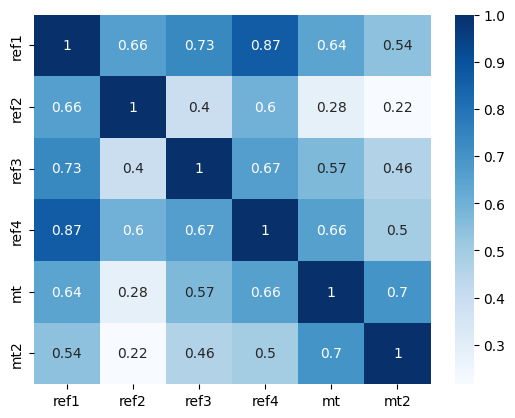

SL_775
src
42269568179.47928
7078075105.309652
ref1
338961024846.94104
3671444905.5542884
ref2
135666761745.33302
1975395654.3081517
ref3
333335056023.2852
5131292718.821151
ref4
338436004403.1207
4437047905.936607
mt
267055317876.2099
2164090564.968098
mt2
518631821904.8514
4936445672.943127
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.665575     0.738767     0.862471   0.647031   
ref2_SL_775     0.665575     1.000000     0.408775     0.600283   0.285026   
ref3_SL_775     0.738767     0.408775     1.000000     0.670601   0.574927   
ref4_SL_775     0.862471     0.600283     0.670601     1.000000   0.661295   
mt_SL_775       0.647031     0.285026     0.574927     0.661295   1.000000   
mt2_SL_775      0.528258     0.210209     0.456181     0.482960   0.688074   

             mt2_SL_775  
ref1_SL_775    0.528258  
ref2_SL_775    0.210209  
ref3_SL_775    0.456181  
ref4_SL_775    0.482960  
mt_SL_775      0.688074  
mt2

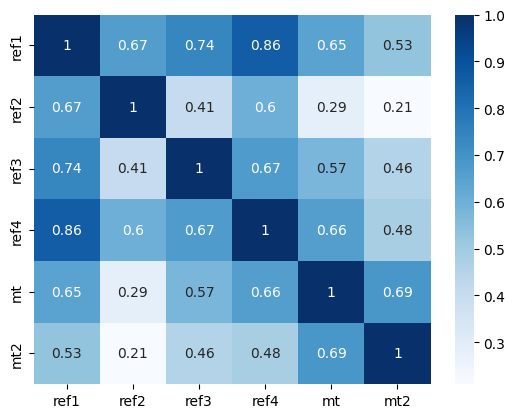

SL_800
src
108987902198.81746
15553008816.681133
ref1
946545347733.2224
8258913023.885681
ref2
376142794650.81
4345623043.95106
ref3
923787757583.7811
11646329182.996952
ref4
944743024828.4227
10146230873.02627
mt
759577622433.1261
4757888173.089947
mt2
1484562978676.097
11118468329.272663
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.670150     0.745770     0.858470   0.648813   
ref2_SL_800     0.670150     1.000000     0.421842     0.602117   0.285768   
ref3_SL_800     0.745770     0.421842     1.000000     0.675153   0.580377   
ref4_SL_800     0.858470     0.602117     0.675153     1.000000   0.662695   
mt_SL_800       0.648813     0.285768     0.580377     0.662695   1.000000   
mt2_SL_800      0.515244     0.204442     0.448358     0.469848   0.676302   

             mt2_SL_800  
ref1_SL_800    0.515244  
ref2_SL_800    0.204442  
ref3_SL_800    0.448358  
ref4_SL_800    0.469848  
mt_SL_800      0.676302  
mt2_SL

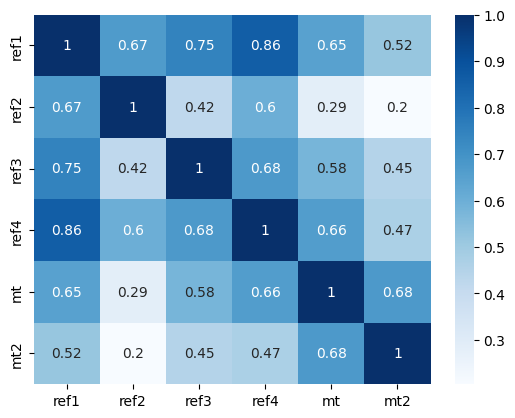

SL_825
src
282299752766.7757
34216605990.864147
ref1
2650219465819.212
18394484446.844944
ref2
1046700145793.7628
9544704316.986027
ref3
2567374916346.475
26423125218.71392
ref4
2643939639910.638
23539319948.287678
mt
2164757705778.0142
10455285220.683949
mt2
4262472945021.031
25051996551.549507
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.675104     0.752622     0.854598   0.649788   
ref2_SL_825     0.675104     1.000000     0.435684     0.604259   0.286218   
ref3_SL_825     0.752622     0.435684     1.000000     0.679603   0.584857   
ref4_SL_825     0.854598     0.604259     0.679603     1.000000   0.663402   
mt_SL_825       0.649788     0.286218     0.584857     0.663402   1.000000   
mt2_SL_825      0.502105     0.198709     0.440082     0.456893   0.664094   

             mt2_SL_825  
ref1_SL_825    0.502105  
ref2_SL_825    0.198709  
ref3_SL_825    0.440082  
ref4_SL_825    0.456893  
mt_SL_825      0.664094  


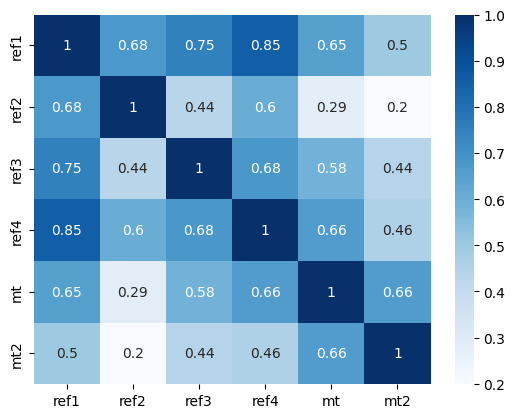

SL_850
src
734302046467.6154
75362205367.15195
ref1
7438916409962.895
41061832668.47609
ref2
2922775196199.601
21006474444.952637
ref3
7154475001231.43
58971932244.069214
ref4
7416940700764.576
54634159362.60955
mt
6180413024642.766
22983837623.121056
mt2
12273204769417.719
57341681488.47967
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.680439     0.759339     0.850867   0.649960   
ref2_SL_850     0.680439     1.000000     0.450240     0.606721   0.286374   
ref3_SL_850     0.759339     0.450240     1.000000     0.683972   0.588391   
ref4_SL_850     0.850867     0.606721     0.683972     1.000000   0.663450   
mt_SL_850       0.649960     0.286374     0.588391     0.663450   1.000000   
mt2_SL_850      0.488837     0.192997     0.431382     0.444084   0.651536   

             mt2_SL_850  
ref1_SL_850    0.488837  
ref2_SL_850    0.192997  
ref3_SL_850    0.431382  
ref4_SL_850    0.444084  
mt_SL_850      0.651536  
mt2_

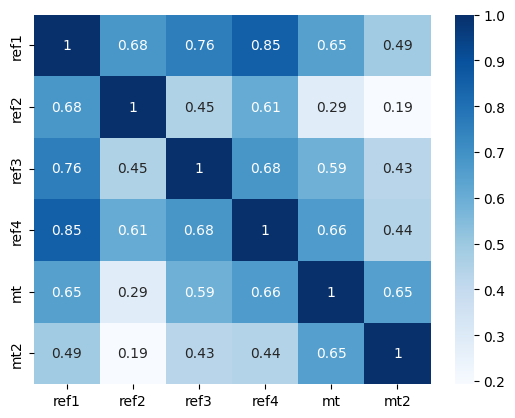

SL_875
src
1917482458681.6265
166811632657.35742
ref1
20929959608958.17
92119913116.40402
ref2
8188292333830.96
45585411953.377815
ref3
19988807476884.74
133337184223.26747
ref4
20853211535055.156
123130501416.1882
mt
17673183671019.89
50436382629.654594
mt2
35432649064934.13
131384780385.10463
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.686153     0.765937     0.847290   0.649337   
ref2_SL_875     0.686153     1.000000     0.465449     0.609510   0.286237   
ref3_SL_875     0.765937     0.465449     1.000000     0.688283   0.591005   
ref4_SL_875     0.847290     0.609510     0.688283     1.000000   0.662869   
mt_SL_875       0.649337     0.286237     0.591005     0.662869   1.000000   
mt2_SL_875      0.475443     0.187297     0.422292     0.431413   0.638699   

             mt2_SL_875  
ref1_SL_875    0.475443  
ref2_SL_875    0.187297  
ref3_SL_875    0.422292  
ref4_SL_875    0.431413  
mt_SL_875      0.638699  
m

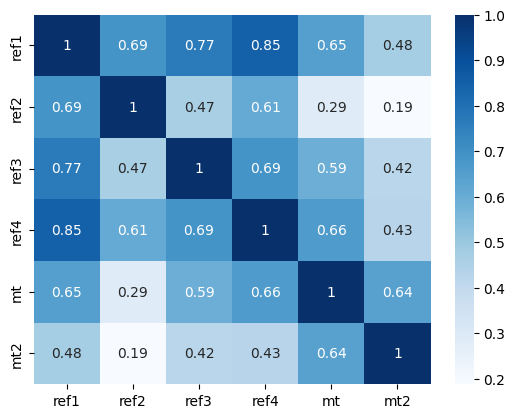

SL_900
src
5025169717931.154
371164455251.421
ref1
59020866218211.664
205933691644.30823
ref2
23011447385324.12
100202892289.1784
ref3
55984662438338.11
298606816589.244
ref4
58754288308977.13
271500760610.03656
mt
50609293174809.59
110609425365.10686
mt2
102546354282486.69
299790014846.8879
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.692241     0.772433     0.843883   0.647933   
ref2_SL_900     0.692241     1.000000     0.481244     0.612636   0.285812   
ref3_SL_900     0.772433     0.481244     1.000000     0.692559   0.592724   
ref4_SL_900     0.843883     0.612636     0.692559     1.000000   0.661690   
mt_SL_900       0.647933     0.285812     0.592724     0.661690   1.000000   
mt2_SL_900      0.461934     0.181608     0.412844     0.418875   0.625652   

             mt2_SL_900  
ref1_SL_900    0.461934  
ref2_SL_900    0.181608  
ref3_SL_900    0.412844  
ref4_SL_900    0.418875  
mt_SL_900      0.625652  
mt2_

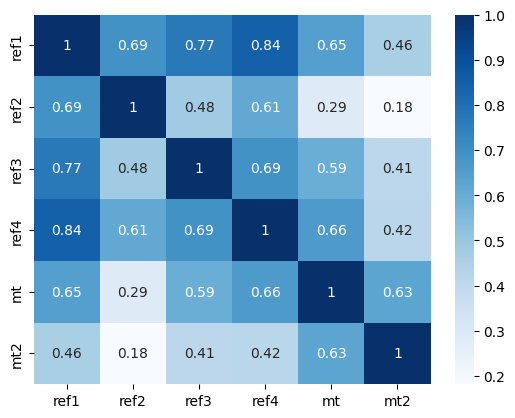

SL_925
src
13213338425008.05
836014175755.9829
ref1
166790961445313.97
461386667190.6447
ref2
64860569699831.984
218353221899.38495
ref3
157173553186576.2
684359935984.2155
ref4
165871586471161.28
605515452788.6816
mt
145111695549845.8
242677481009.20758
mt2
297464234986837.75
679796860573.5634
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.698691     0.778841     0.840660   0.645760   
ref2_SL_925     0.698691     1.000000     0.497560     0.616103   0.285103   
ref3_SL_925     0.778841     0.497560     1.000000     0.696822   0.593573   
ref4_SL_925     0.840660     0.616103     0.696822     1.000000   0.659939   
mt_SL_925       0.645760     0.285103     0.593573     0.659939   1.000000   
mt2_SL_925      0.448323     0.175929     0.403074     0.406468   0.612452   

             mt2_SL_925  
ref1_SL_925    0.448323  
ref2_SL_925    0.175929  
ref3_SL_925    0.403074  
ref4_SL_925    0.406468  
mt_SL_925      0.612452  
m

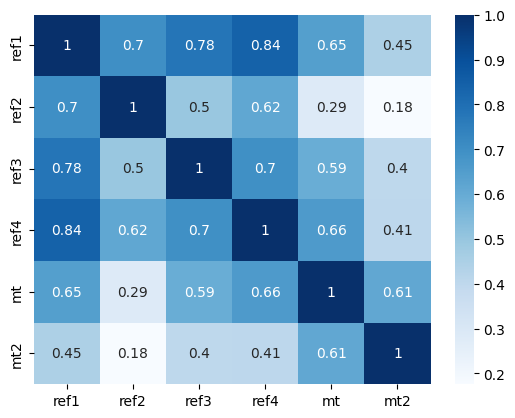

SL_950
src
34850247472212.29
1884283331109.4531
ref1
472306280989867.2
1039921902501.7092
ref2
183333675070142.66
477932425978.9429
ref3
442257979356047.9
1541792222092.9546
ref4
469159940270263.44
1371141573949.1987
mt
416560076065855.2
532833150473.97
mt2
864727287089945.2
1541271936829.4912
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.705487     0.785174     0.837636   0.642835   
ref2_SL_950     0.705487     1.000000     0.514326     0.619916   0.284116   
ref3_SL_950     0.785174     0.514326     1.000000     0.701094   0.593580   
ref4_SL_950     0.837636     0.619916     0.701094     1.000000   0.657642   
mt_SL_950       0.642835     0.284116     0.593580     0.657642   1.000000   
mt2_SL_950      0.434630     0.170265     0.393018     0.394195   0.599153   

             mt2_SL_950  
ref1_SL_950    0.434630  
ref2_SL_950    0.170265  
ref3_SL_950    0.393018  
ref4_SL_950    0.394195  
mt_SL_950      0.599153  
mt

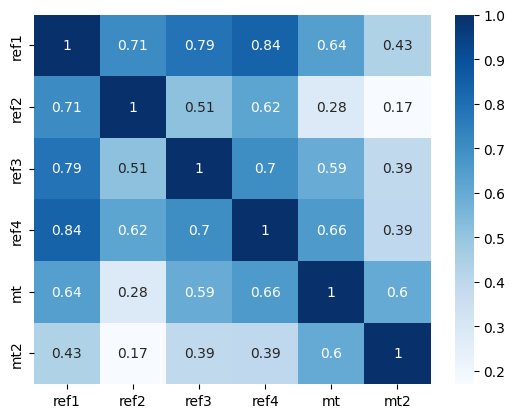

SL_975
src
92178233039508.98
4249520576092.678
ref1
1340036671536332.2
2347694614232.09
ref2
519602292942604.94
1051938554463.8206
ref3
1247146318560074.2
3448325515999.2334
ref4
1329352321512279.8
3010881066171.503
mt
1197041274587907.8
1173661481123.753
mt2
2518779052344463.5
3439817151395.492
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.712608     0.791445     0.834828   0.639178   
ref2_SL_975     0.712608     1.000000     0.531472     0.624076   0.282860   
ref3_SL_975     0.791445     0.531472     1.000000     0.705396   0.592771   
ref4_SL_975     0.834828     0.624076     0.705396     1.000000   0.654823   
mt_SL_975       0.639178     0.282860     0.592771     0.654823   1.000000   
mt2_SL_975      0.420878     0.164621     0.382711     0.382056   0.585799   

             mt2_SL_975  
ref1_SL_975    0.420878  
ref2_SL_975    0.164621  
ref3_SL_975    0.382711  
ref4_SL_975    0.382056  
mt_SL_975      0.585799  


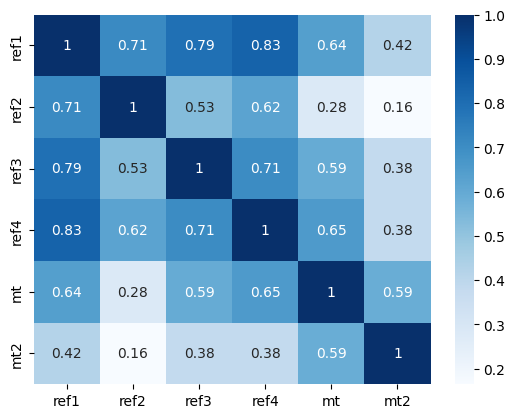

gini
src
0.32971138523171883
0.3342593905576323
ref1
0.4471039301805804
0.4459058462669493
ref2
0.42227941198203806
0.4214762695549462
ref3
0.4374437356396911
0.434193534875556
ref4
0.448900095309018
0.4435119872025642
mt
0.417331752534721
0.41567899050493556
mt2
0.44305464446404635
0.4431987807033866
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.651487   0.690457   0.830208  0.623230  0.728542
ref2_gini   0.651487   1.000000   0.664137   0.672930  0.572571  0.655204
ref3_gini   0.690457   0.664137   1.000000   0.685878  0.558221  0.631806
ref4_gini   0.830208   0.672930   0.685878   1.000000  0.641419  0.778251
mt_gini     0.623230   0.572571   0.558221   0.641419  1.000000  0.739472
mt2_gini    0.728542   0.655204   0.631806   0.778251  0.739472  1.000000


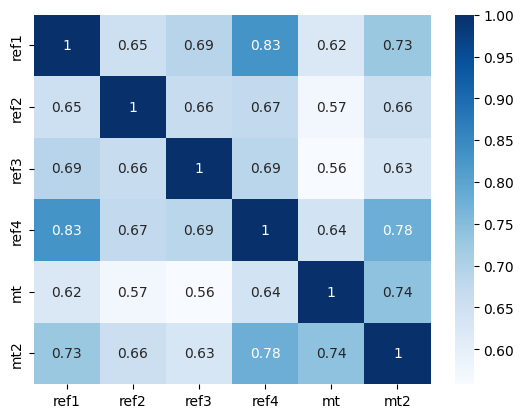

kl
src
-4.6569741162768965
-4.700664247164787
ref1
-4.274537985485156
-4.314281287348642
ref2
-4.303982483613123
-4.361273763949236
ref3
-4.228328461132061
-4.27214606793925
ref4
-4.301229722444487
-4.339984650221303
mt
-4.271120517407621
-4.309620719615964
mt2
-4.239470787413927
-4.272022170089509
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.968475  0.959995  0.973938  0.940058  0.946941
ref2_kl  0.968475  1.000000  0.966308  0.968971  0.946750  0.946250
ref3_kl  0.959995  0.966308  1.000000  0.960358  0.932758  0.937581
ref4_kl  0.973938  0.968971  0.960358  1.000000  0.940883  0.947255
mt_kl    0.940058  0.946750  0.932758  0.940883  1.000000  0.982669
mt2_kl   0.946941  0.946250  0.937581  0.947255  0.982669  1.000000


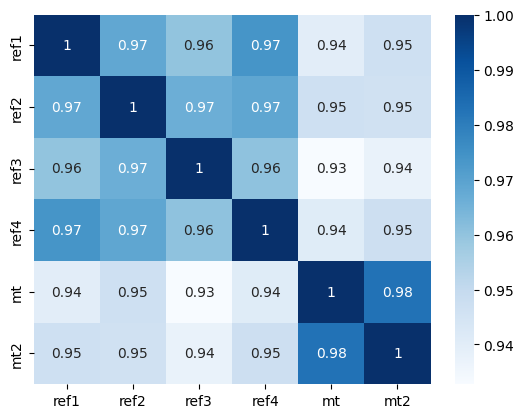

cv
src
0.619461482618071
0.6188531130334651
ref1
0.9385677046129264
0.8932397704223286
ref2
0.8509483576245798
0.8189097371887432
ref3
0.9030466407514068
0.8644105521785741
ref4
0.9474916636129248
0.9003129630247317
mt
0.8366144584209861
0.803102325213478
mt2
0.9189462638766713
0.909060088050426
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.611030  0.672361  0.875434  0.624743  0.822073
ref2_cv  0.611030  1.000000  0.583504  0.594840  0.488351  0.594436
ref3_cv  0.672361  0.583504  1.000000  0.655997  0.482332  0.632852
ref4_cv  0.875434  0.594840  0.655997  1.000000  0.630567  0.851943
mt_cv    0.624743  0.488351  0.482332  0.630567  1.000000  0.725065
mt2_cv   0.822073  0.594436  0.632852  0.851943  0.725065  1.000000


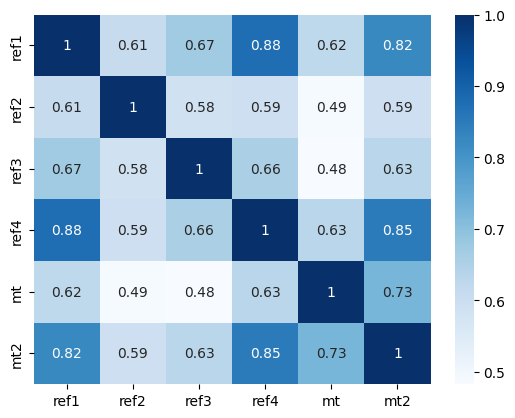

lv
src
70.61660964375977
64.19573431566207
ref1
83.45511187174218
48.31583721446905
ref2
62.717274922727796
43.06672401962288
ref3
92.75936031956459
54.86221089930997
ref4
82.98177494415584
45.92595839008398
mt
65.0552832768221
41.32221507523456
mt2
93.19674434669889
54.24211599186377
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.694322  0.594511  0.935254  0.584627  0.811111
ref2_lv  0.694322  1.000000  0.405418  0.672664  0.390068  0.512145
ref3_lv  0.594511  0.405418  1.000000  0.578511  0.415909  0.528383
ref4_lv  0.935254  0.672664  0.578511  1.000000  0.595941  0.807773
mt_lv    0.584627  0.390068  0.415909  0.595941  1.000000  0.737790
mt2_lv   0.811111  0.512145  0.528383  0.807773  0.737790  1.000000


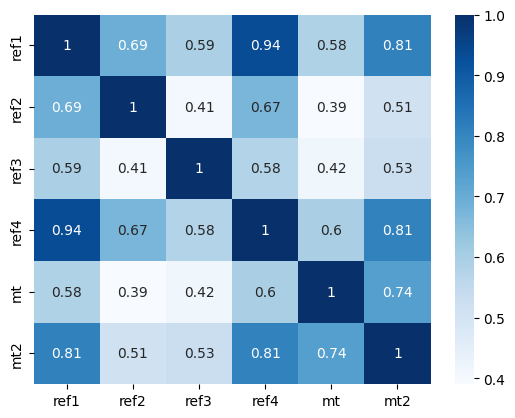

renyi
src
-1211.938583862788
-1159.3914677763003
ref1
-717.2859432868039
-642.9453875032174
ref2
-664.6678281387744
-580.2961770228536
ref3
-776.9729512242487
-696.1041928257154
ref4
-718.2161866163536
-663.0712066333067
mt
-672.2587924086839
-567.7729231620287
mt2
-762.8394250821236
-697.728328779478
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.888753    0.896591    0.973900  0.878525   
ref2_renyi    0.888753    1.000000    0.858461    0.889554  0.869341   
ref3_renyi    0.896591    0.858461    1.000000    0.896765  0.842219   
ref4_renyi    0.973900    0.889554    0.896765    1.000000  0.868621   
mt_renyi      0.878525    0.869341    0.842219    0.868621  1.000000   
mt2_renyi     0.963041    0.881596    0.883418    0.963573  0.905428   

            mt2_renyi  
ref1_renyi   0.963041  
ref2_renyi   0.881596  
ref3_renyi   0.883418  
ref4_renyi   0.963573  
mt_renyi     0.905428  
mt2_renyi    1.000000  


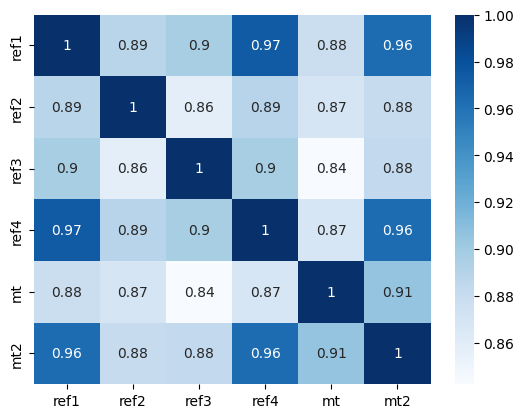

42.02190154044549
53.72567426691354
40.34788398106574
58.24959132482864
53.2159784869968
41.065848040795075


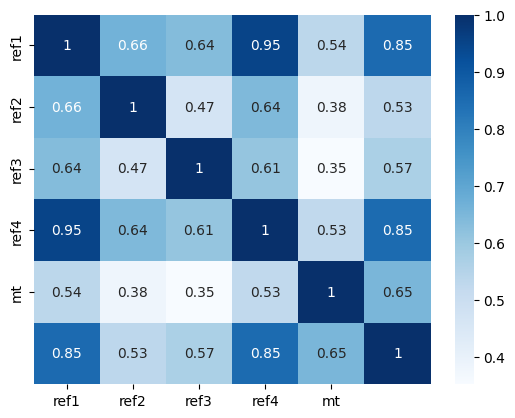

*************************************
53.685557633884905
53.685557633884905
40.292523498217584
58.692626397992946
53.17931231415953
41.042113833443906
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


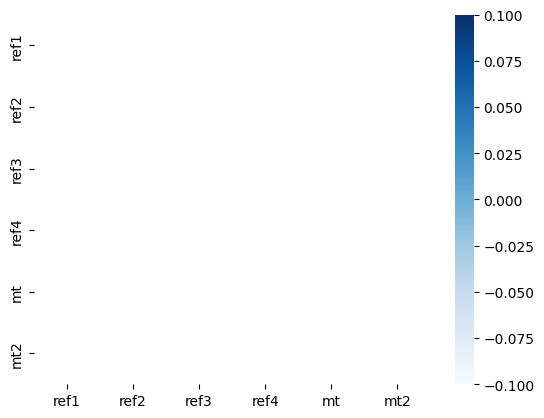

L
src
10.359164788583737
10.123614579255745
ref1
4.6099765543033975
4.541131865506825
ref2
4.976233675579946
4.9157519962939045
ref3
5.292001035151867
5.269765320278349
ref4
4.3858981936858275
4.3131686879778215
mt
5.068877886262579
4.88776934617219
mt2
5.046018045651242
4.894587961806762
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.824610  0.731071  0.851092  0.802314  0.772912
ref2_L  0.824610  1.000000  0.697239  0.830046  0.787949  0.766293
ref3_L  0.731071  0.697239  1.000000  0.725151  0.714194  0.741559
ref4_L  0.851092  0.830046  0.725151  1.000000  0.766959  0.742152
mt_L    0.802314  0.787949  0.714194  0.766959  1.000000  0.907183
mt2_L   0.772912  0.766293  0.741559  0.742152  0.907183  1.000000


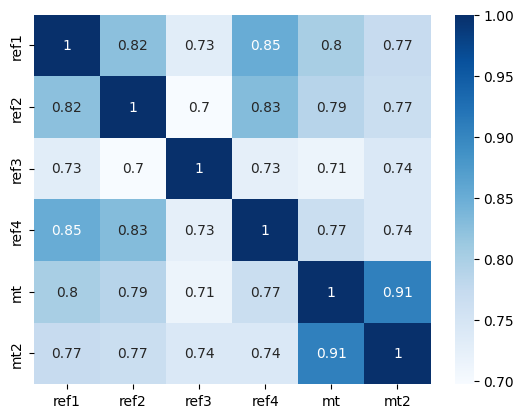

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.3407432262595778
1.34471356846622
ref2
1.3682464956469143
1.36091745587914
ref3
1.3949138925311786
1.3973621199941095
ref4
1.315564823724925
1.3143466511656858
mt
1.3744323235734601
1.3697648693055418
mt2
1.36843170610647
1.3561119754937003
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.823003    0.763081    0.869477  0.834113   
ref2_SL_25    0.823003    1.000000    0.753093    0.829906  0.816741   
ref3_SL_25    0.763081    0.753093    1.000000    0.748985  0.767924   
ref4_SL_25    0.869477    0.829906    0.748985    1.000000  0.807168   
mt_SL_25      0.834113    0.816741    0.767924    0.807168  1.000000   
mt2_SL_25     0.798553    0.793318    0.779012    0.785855  0.913706   

            mt2_SL_25  
ref1_SL_25   0.798553  
ref2_SL_25   0.793318  
ref3_SL_25   0.779012  
ref4_SL_25   0.785855  
mt_SL_25     0.913706  
mt2_SL_25    1.000000  


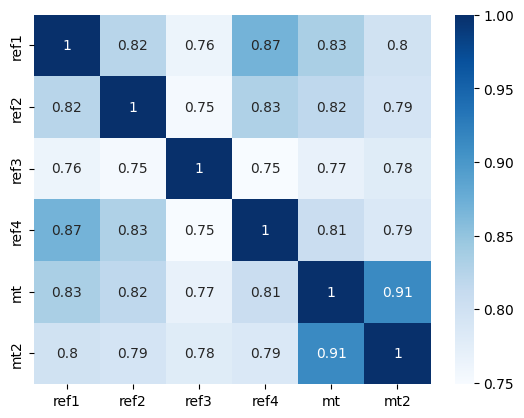

SL_50
src
3.0671973011635125
3.032966843199389
ref1
1.9373490221915777
1.9293358644316032
ref2
2.0154524209349725
1.996200761148442
ref3
2.0877216395418596
2.101501107135223
ref4
1.8766462069150087
1.8722525469976024
mt
2.035074742400435
2.0157470783381326
mt2
2.0218519181882417
1.9843828312086662
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.829528    0.746828    0.861535  0.822344   
ref2_SL_50    0.829528    1.000000    0.729489    0.834866  0.807474   
ref3_SL_50    0.746828    0.729489    1.000000    0.735811  0.743938   
ref4_SL_50    0.861535    0.834866    0.735811    1.000000  0.791192   
mt_SL_50      0.822344    0.807474    0.743938    0.791192  1.000000   
mt2_SL_50     0.792221    0.787563    0.765925    0.770005  0.912738   

            mt2_SL_50  
ref1_SL_50   0.792221  
ref2_SL_50   0.787563  
ref3_SL_50   0.765925  
ref4_SL_50   0.770005  
mt_SL_50     0.912738  
mt2_SL_50    1.000000  


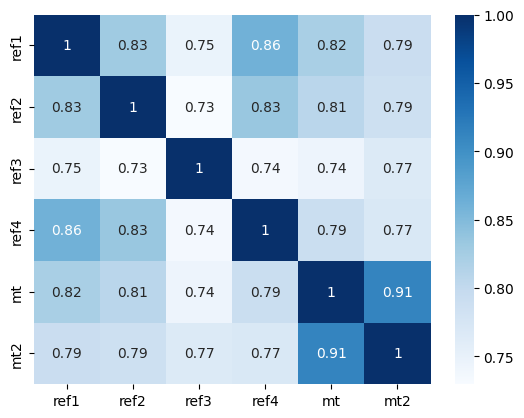

SL_75
src
5.5762344444241885
5.474223342002128
ref1
2.9363362890097866
2.88961640047319
ref2
3.1124715211164986
3.07378080774947
ref3
3.268701675242602
3.2809189836951655
ref4
2.816459343767808
2.8018718408068635
mt
3.1574651451642324
3.0827653697725284
mt2
3.136899296115913
3.045472219911791
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.830271    0.737287    0.855396  0.812234   
ref2_SL_75    0.830271    1.000000    0.712330    0.835337  0.798588   
ref3_SL_75    0.737287    0.712330    1.000000    0.729003  0.727632   
ref4_SL_75    0.855396    0.835337    0.729003    1.000000  0.777897   
mt_SL_75      0.812234    0.798588    0.727632    0.777897  1.000000   
mt2_SL_75     0.783928    0.778228    0.754255    0.755359  0.910379   

            mt2_SL_75  
ref1_SL_75   0.783928  
ref2_SL_75   0.778228  
ref3_SL_75   0.754255  
ref4_SL_75   0.755359  
mt_SL_75     0.910379  
mt2_SL_75    1.000000  


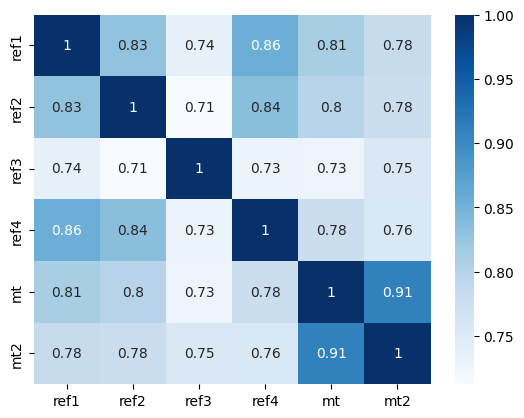

SL_100
src
10.359164788583737
10.123614579255745
ref1
4.6099765543033975
4.541131865506825
ref2
4.976233675579946
4.9157519962939045
ref3
5.292001035151867
5.269765320278349
ref4
4.3858981936858275
4.3131686879778215
mt
5.068877886262579
4.88776934617219
mt2
5.046018045651242
4.894587961806762
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.824610     0.731071     0.851092   0.802314   
ref2_SL_100     0.824610     1.000000     0.697239     0.830046   0.787949   
ref3_SL_100     0.731071     0.697239     1.000000     0.725151   0.714194   
ref4_SL_100     0.851092     0.830046     0.725151     1.000000   0.766959   
mt_SL_100       0.802314     0.787949     0.714194     0.766959   1.000000   
mt2_SL_100      0.772912     0.766293     0.741559     0.742152   0.907183   

             mt2_SL_100  
ref1_SL_100    0.772912  
ref2_SL_100    0.766293  
ref3_SL_100    0.741559  
ref4_SL_100    0.742152  
mt_SL_100      0.907183  
mt

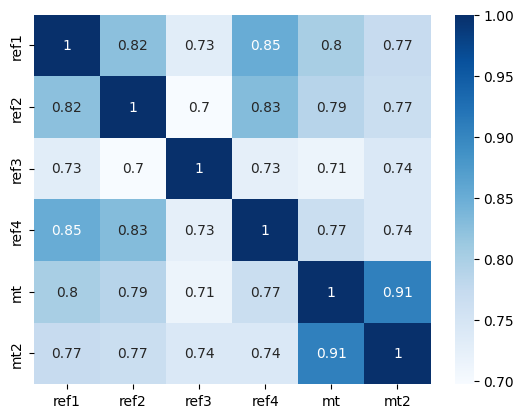

SL_125
src
19.634351008953868
18.984081758810827
ref1
7.447832449406116
7.266522998673068
ref2
8.182209367109582
8.009037945749911
ref3
8.805697153377263
8.688490202151932
ref4
7.035474458061648
6.879865591849888
mt
8.363245108239383
7.973503250363868
mt2
8.359367590051237
8.037927505536217
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.813496     0.726509     0.848734   0.792125   
ref2_SL_125     0.813496     1.000000     0.682335     0.819385   0.775515   
ref3_SL_125     0.726509     0.682335     1.000000     0.722651   0.701126   
ref4_SL_125     0.848734     0.819385     0.722651     1.000000   0.758292   
mt_SL_125       0.792125     0.775515     0.701126     0.758292   1.000000   
mt2_SL_125      0.759136     0.753125     0.726031     0.730563   0.902591   

             mt2_SL_125  
ref1_SL_125    0.759136  
ref2_SL_125    0.753125  
ref3_SL_125    0.726031  
ref4_SL_125    0.730563  
mt_SL_125      0.902591  
mt2_S

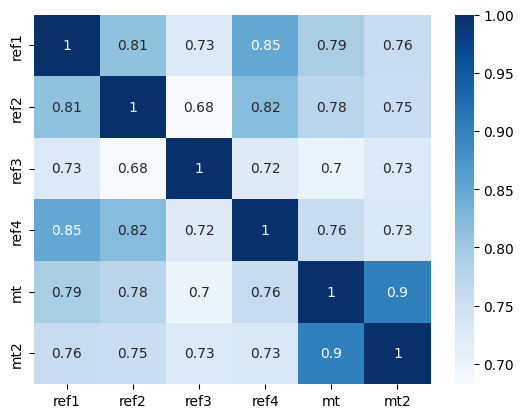

SL_150
src
37.92546190950008
36.245652911575796
ref1
12.335251126002053
11.849301024640855
ref2
13.782886168770387
13.425669432396845
ref3
15.005870710060162
14.565476104802109
ref4
11.576231216807518
11.198882814375832
mt
14.12452774484044
13.006562387659422
mt2
14.205487122045625
13.383714178396371
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.798163     0.723093     0.848337   0.781903   
ref2_SL_150     0.798163     1.000000     0.667691     0.804769   0.762545   
ref3_SL_150     0.723093     0.667691     1.000000     0.721403   0.687837   
ref4_SL_150     0.848337     0.804769     0.721403     1.000000   0.752206   
mt_SL_150       0.781903     0.762545     0.687837     0.752206   1.000000   
mt2_SL_150      0.743277     0.740320     0.707400     0.721152   0.896103   

             mt2_SL_150  
ref1_SL_150    0.743277  
ref2_SL_150    0.740320  
ref3_SL_150    0.707400  
ref4_SL_150    0.721152  
mt_SL_150      0.8961

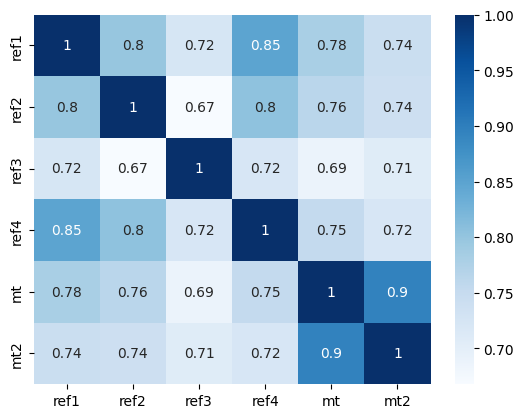

SL_175
src
74.59367553068095
71.2767390568266
ref1
20.895865906977246
19.84676089285234
ref2
23.729563184498154
22.686633267290304
ref3
26.13089974698261
24.901686850885255
ref4
19.48693881107971
18.722661735606554
mt
24.35520993794936
21.87788948775302
mt2
24.70213300423133
22.678501931655738
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.780210     0.720924     0.849812   0.772402   
ref2_SL_175     0.780210     1.000000     0.654684     0.788545   0.751174   
ref3_SL_175     0.720924     0.654684     1.000000     0.722293   0.675041   
ref4_SL_175     0.849812     0.788545     0.722293     1.000000   0.749377   
mt_SL_175       0.772402     0.751174     0.675041     0.749377   1.000000   
mt2_SL_175      0.726724     0.729556     0.686879     0.714856   0.887672   

             mt2_SL_175  
ref1_SL_175    0.726724  
ref2_SL_175    0.729556  
ref3_SL_175    0.686879  
ref4_SL_175    0.714856  
mt_SL_175      0.887672  
mt

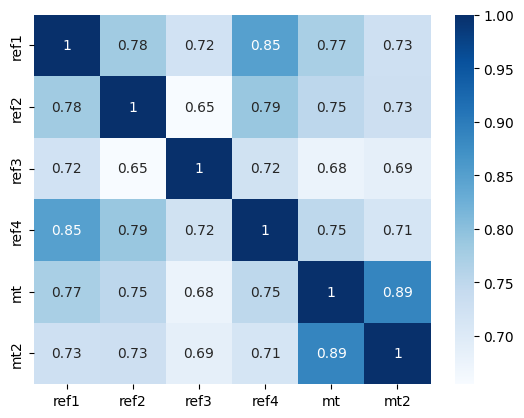

SL_200
src
149.29007454484417
140.79844066957907
ref1
36.156833742610736
33.730351027533324
ref2
41.696569699952406
38.840755952493154
ref3
46.43506149752584
42.77406798265943
ref4
33.50594456951875
31.39477399437733
mt
42.806467047141744
37.541957293251045
mt2
43.88929974808539
39.56282465710347
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.761818     0.720477     0.852956   0.764898   
ref2_SL_200     0.761818     1.000000     0.645413     0.773739   0.743929   
ref3_SL_200     0.720477     0.645413     1.000000     0.726703   0.664410   
ref4_SL_200     0.852956     0.773739     0.726703     1.000000   0.750761   
mt_SL_200       0.764898     0.743929     0.664410     0.750761   1.000000   
mt2_SL_200      0.711601     0.722344     0.666936     0.712754   0.877908   

             mt2_SL_200  
ref1_SL_200    0.711601  
ref2_SL_200    0.722344  
ref3_SL_200    0.666936  
ref4_SL_200    0.712754  
mt_SL_200      0.877908  

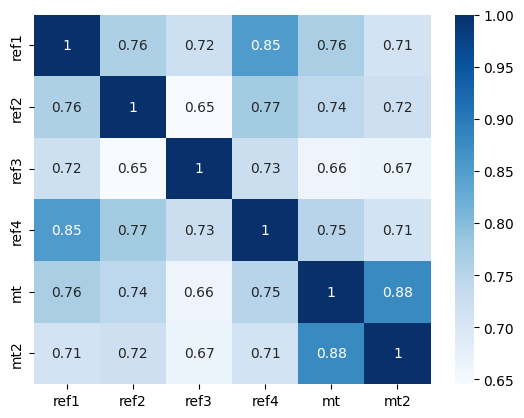

SL_225
src
303.8405857924159
280.9173422693609
ref1
63.86380530438842
58.205849211862834
ref2
74.71740581599433
67.60035339697177
ref3
84.13626895973738
75.26610352412445
ref4
58.78971168366422
53.479296796176726
mt
76.60961441961264
64.59196030892556
mt2
79.60957394212657
68.22316413445711
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.745633     0.722370     0.857424   0.761111   
ref2_SL_225     0.745633     1.000000     0.641962     0.763416   0.743021   
ref3_SL_225     0.722370     0.641962     1.000000     0.735856   0.658137   
ref4_SL_225     0.857424     0.763416     0.735856     1.000000   0.757348   
mt_SL_225       0.761111     0.743021     0.658137     0.757348   1.000000   
mt2_SL_225      0.700465     0.719686     0.650697     0.715608   0.868180   

             mt2_SL_225  
ref1_SL_225    0.700465  
ref2_SL_225    0.719686  
ref3_SL_225    0.650697  
ref4_SL_225    0.715608  
mt_SL_225      0.868180  
mt2_S

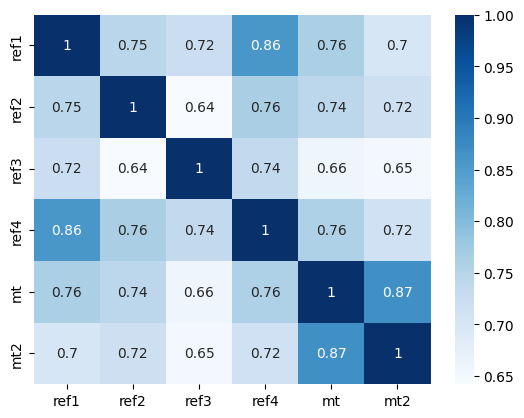

SL_250
src
628.4544909090951
577.7790438817206
ref1
115.13039113275433
100.34513744847243
ref2
136.48737745791445
118.22012191124895
ref3
155.37720743417015
138.50861823642254
ref4
105.2210471288307
92.02305133498254
mt
139.53253382971698
114.88986803616159
mt2
147.36649741933397
121.7993471751278
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.734235     0.727031     0.862736   0.762735   
ref2_SL_250     0.734235     1.000000     0.645604     0.759838   0.749566   
ref3_SL_250     0.727031     0.645604     1.000000     0.750071   0.658164   
ref4_SL_250     0.862736     0.759838     0.750071     1.000000   0.769654   
mt_SL_250       0.762735     0.749566     0.658164     0.769654   1.000000   
mt2_SL_250      0.695502     0.721824     0.640879     0.723340   0.860373   

             mt2_SL_250  
ref1_SL_250    0.695502  
ref2_SL_250    0.721824  
ref3_SL_250    0.640879  
ref4_SL_250    0.723340  
mt_SL_250      0.860373 

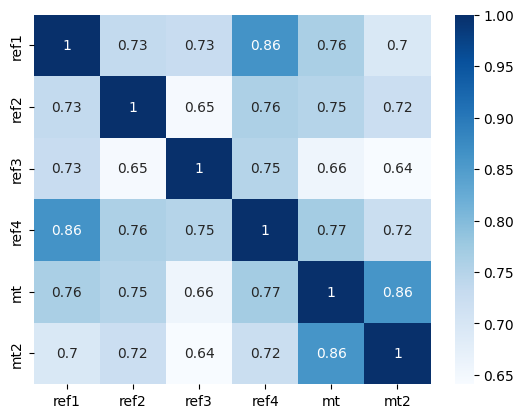

SL_275
src
1320.1522165503627
1219.778984730092
ref1
211.88275418368616
174.61941865967927
ref2
254.1444953920462
206.7918737975921
ref3
292.41745780136614
247.22684781531288
ref4
192.09305045562377
162.86833309367645
mt
258.586282070164
203.07270973907146
mt2
278.38876206457627
218.75886035942384
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.729392     0.734367     0.868369   0.770582   
ref2_SL_275     0.729392     1.000000     0.656301     0.763818   0.763081   
ref3_SL_275     0.734367     0.656301     1.000000     0.768384   0.665219   
ref4_SL_275     0.868369     0.763818     0.768384     1.000000   0.787096   
mt_SL_275       0.770582     0.763081     0.665219     0.787096   1.000000   
mt2_SL_275      0.697585     0.728235     0.638677     0.734834   0.856251   

             mt2_SL_275  
ref1_SL_275    0.697585  
ref2_SL_275    0.728235  
ref3_SL_275    0.638677  
ref4_SL_275    0.734834  
mt_SL_275      0.856251 

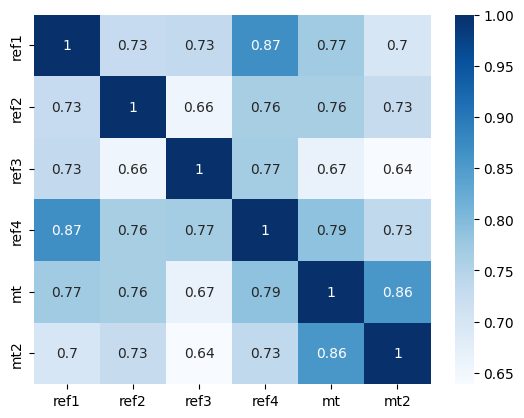

SL_300
src
2814.3535145845594
2540.753413906092
ref1
398.27195120120814
311.282561344029
ref2
482.4298961950352
371.7967196611812
ref3
560.8634380191721
445.3165985660007
ref4
357.7921125153064
289.77860069027133
mt
487.6548490963618
366.18381074789954
mt2
536.7986859372029
394.58090654820046
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.731549     0.743707     0.873893   0.783922   
ref2_SL_300     0.731549     1.000000     0.672761     0.774646   0.781586   
ref3_SL_300     0.743707     0.672761     1.000000     0.788884   0.678252   
ref4_SL_300     0.873893     0.774646     0.788884     1.000000   0.807744   
mt_SL_300       0.783922     0.781586     0.678252     0.807744   1.000000   
mt2_SL_300      0.705961     0.737883     0.643354     0.748304   0.856723   

             mt2_SL_300  
ref1_SL_300    0.705961  
ref2_SL_300    0.737883  
ref3_SL_300    0.643354  
ref4_SL_300    0.748304  
mt_SL_300      0.856723  
mt2

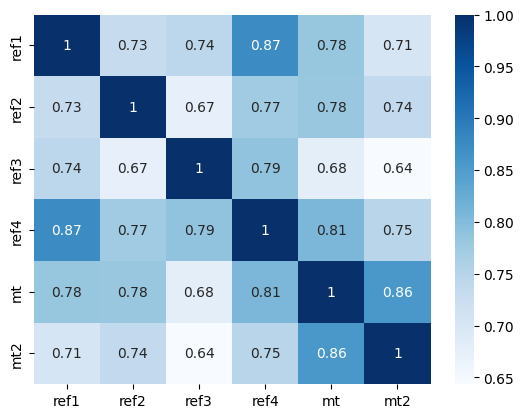

SL_325
src
6084.052939199673
5462.138856697426
ref1
765.0646248407402
566.9654353753043
ref2
933.7540151011985
681.360185531081
ref3
1096.5147653834713
820.1708886727483
ref4
680.1874589519654
521.8411064542112
mt
936.0956751672378
663.787219982315
mt2
1056.8334104175387
723.6693371068855
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.739874     0.754051     0.879044   0.800668   
ref2_SL_325     0.739874     1.000000     0.692967     0.790566   0.802321   
ref3_SL_325     0.754051     0.692967     1.000000     0.809502   0.694740   
ref4_SL_325     0.879044     0.790566     0.809502     1.000000   0.828820   
mt_SL_325       0.800668     0.802321     0.694740     0.828820   1.000000   
mt2_SL_325      0.718778     0.749554     0.652781     0.761946   0.861535   

             mt2_SL_325  
ref1_SL_325    0.718778  
ref2_SL_325    0.749554  
ref3_SL_325    0.652781  
ref4_SL_325    0.761946  
mt_SL_325      0.861535  
mt2_SL_

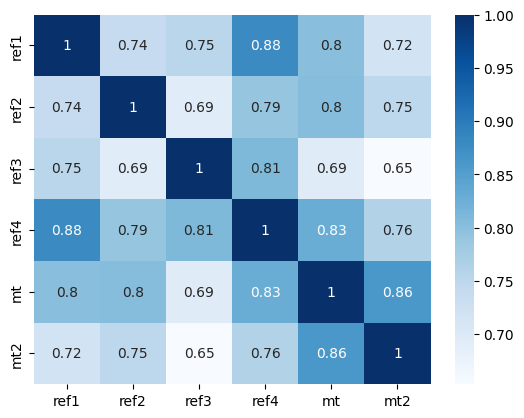

SL_350
src
13326.018221127724
11692.845168165546
ref1
1502.7511004803532
1007.5961871608906
ref2
1843.064294671297
1218.3956177936693
ref3
2185.445454920137
1520.4300066098967
ref4
1320.3410462764937
940.8899999914312
mt
1829.7812238986971
1205.2198597141
mt2
2124.969509764815
1330.9609070370548
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.752761     0.764435     0.883714   0.818279   
ref2_SL_350     0.752761     1.000000     0.714803     0.809468   0.822672   
ref3_SL_350     0.764435     0.714803     1.000000     0.828672   0.711687   
ref4_SL_350     0.883714     0.809468     0.828672     1.000000   0.847684   
mt_SL_350       0.818279     0.822672     0.711687     0.847684   1.000000   
mt2_SL_350      0.733938     0.762121     0.664428     0.774411   0.869593   

             mt2_SL_350  
ref1_SL_350    0.733938  
ref2_SL_350    0.762121  
ref3_SL_350    0.664428  
ref4_SL_350    0.774411  
mt_SL_350      0.869593  


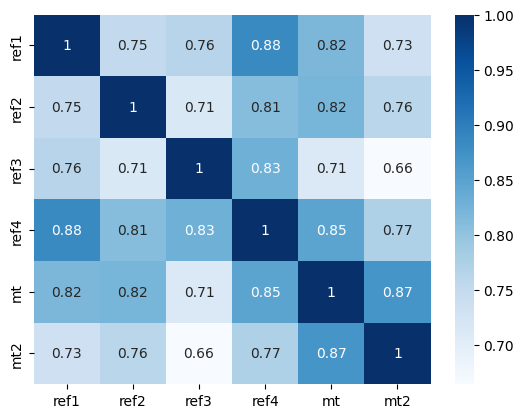

SL_375
src
29547.541988410783
25794.64486383465
ref1
3019.215575260288
1852.7793615445507
ref2
3709.9343771522613
2301.0902782053254
ref3
4440.765421054934
2775.4146357159543
ref4
2617.820313615203
1674.9683685024174
mt
3643.566331213972
2212.9969966482827
mt2
4364.166728833037
2436.3536946149543
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.768414     0.774159     0.887887   0.834680   
ref2_SL_375     0.768414     1.000000     0.736500     0.829439   0.840814   
ref3_SL_375     0.774159     0.736500     1.000000     0.845546   0.726616   
ref4_SL_375     0.887887     0.829439     0.845546     1.000000   0.862601   
mt_SL_375       0.834680     0.840814     0.726616     0.862601   1.000000   
mt2_SL_375      0.749707     0.774678     0.676141     0.784932   0.879547   

             mt2_SL_375  
ref1_SL_375    0.749707  
ref2_SL_375    0.774678  
ref3_SL_375    0.676141  
ref4_SL_375    0.784932  
mt_SL_375      0.879547  

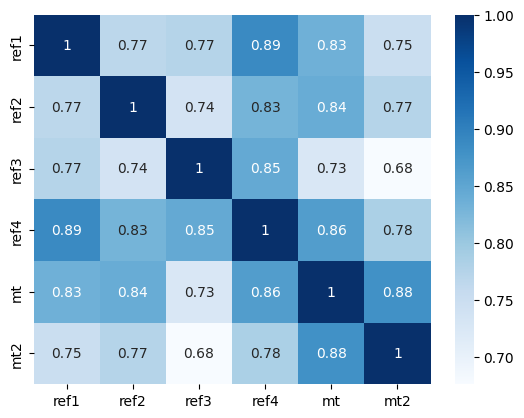

SL_400
src
66263.42583599311
56824.85462524026
ref1
6204.646135470495
3379.780074337415
ref2
7614.2307305279255
4240.638628748846
ref3
9198.507051239561
5146.052496345981
ref4
5301.861946428487
3052.9084414022523
mt
7393.410160575161
4103.08848605793
mt2
9153.685688413216
4448.080406258003
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.785260     0.782827     0.891592   0.848670   
ref2_SL_400     0.785260     1.000000     0.756823     0.849033   0.855845   
ref3_SL_400     0.782827     0.756823     1.000000     0.859874   0.738044   
ref4_SL_400     0.891592     0.849033     0.859874     1.000000   0.872921   
mt_SL_400       0.848670     0.855845     0.738044     0.872921   1.000000   
mt2_SL_400      0.764908     0.786570     0.686447     0.793204   0.890249   

             mt2_SL_400  
ref1_SL_400    0.764908  
ref2_SL_400    0.786570  
ref3_SL_400    0.686447  
ref4_SL_400    0.793204  
mt_SL_400      0.890249  
mt2_SL

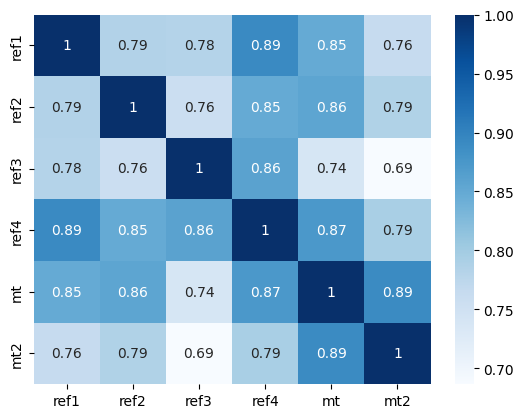

SL_425
src
150170.28195142408
126458.59758375768
ref1
13036.51031988714
6232.617192900324
ref2
15926.55609250942
7661.863242543048
ref3
19416.325239983267
9624.80857894381
ref4
10966.041979624577
5442.462853458212
mt
15290.441392824605
7616.696386674828
mt2
19599.421568361806
8170.467960495622
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.802114     0.790285     0.894865   0.859847   
ref2_SL_425     0.802114     1.000000     0.775044     0.867310   0.867588   
ref3_SL_425     0.790285     0.775044     1.000000     0.871776   0.745433   
ref4_SL_425     0.894865     0.867310     0.871776     1.000000   0.878813   
mt_SL_425       0.859847     0.867588     0.745433     0.878813   1.000000   
mt2_SL_425      0.778864     0.797371     0.694523     0.799207   0.900917   

             mt2_SL_425  
ref1_SL_425    0.778864  
ref2_SL_425    0.797371  
ref3_SL_425    0.694523  
ref4_SL_425    0.799207  
mt_SL_425      0.900917  
mt

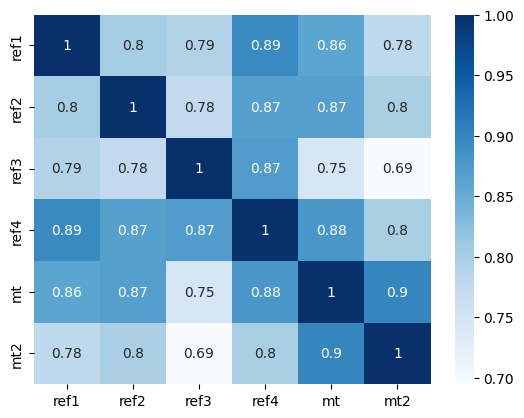

SL_450
src
343632.9097266221
283095.18838540884
ref1
27978.6231153839
11439.763282547567
ref2
33926.08089661326
14225.605793669873
ref3
41738.92382376792
18149.919151805996
ref4
23149.270208189424
10074.965760008134
mt
32226.276293457657
14173.19121689544
mt2
42805.768239644545
15285.887356321375
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.818193     0.796535     0.897745   0.868315   
ref2_SL_450     0.818193     1.000000     0.790839     0.883758   0.876287   
ref3_SL_450     0.796535     0.790839     1.000000     0.881545   0.748878   
ref4_SL_450     0.897745     0.883758     0.881545     1.000000   0.880876   
mt_SL_450       0.868315     0.876287     0.748878     0.880876   1.000000   
mt2_SL_450      0.791256     0.806840     0.700022     0.803072   0.911099   

             mt2_SL_450  
ref1_SL_450    0.791256  
ref2_SL_450    0.806840  
ref3_SL_450    0.700022  
ref4_SL_450    0.803072  
mt_SL_450      0.911099  

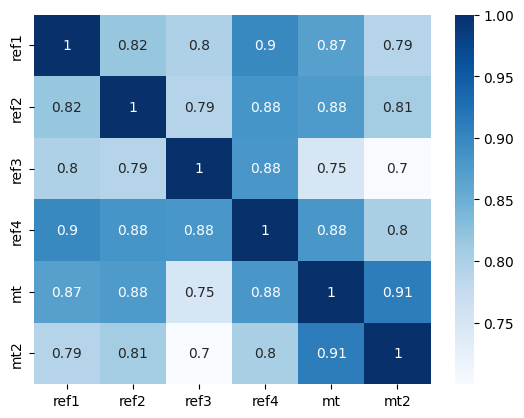

SL_475
src
793365.4482151263
640119.8046014623
ref1
61252.06330315808
20878.545483113798
ref2
73523.65054057525
26414.12017728966
ref3
91297.88882963604
33521.0239304266
ref4
49826.10740972006
18375.50842360718
mt
69189.97041265745
26630.734836451207
mt2
95256.43615409735
28914.359714894083
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.833046     0.801656     0.900267   0.874425   
ref2_SL_475     0.833046     1.000000     0.804160     0.898176   0.882360   
ref3_SL_475     0.801656     0.804160     1.000000     0.889524   0.748805   
ref4_SL_475     0.900267     0.898176     0.889524     1.000000   0.879834   
mt_SL_475       0.874425     0.882360     0.748805     0.879834   1.000000   
mt2_SL_475      0.801989     0.814870     0.702899     0.804989   0.920575   

             mt2_SL_475  
ref1_SL_475    0.801989  
ref2_SL_475    0.814870  
ref3_SL_475    0.702899  
ref4_SL_475    0.804989  
mt_SL_475      0.920575  
mt2_S

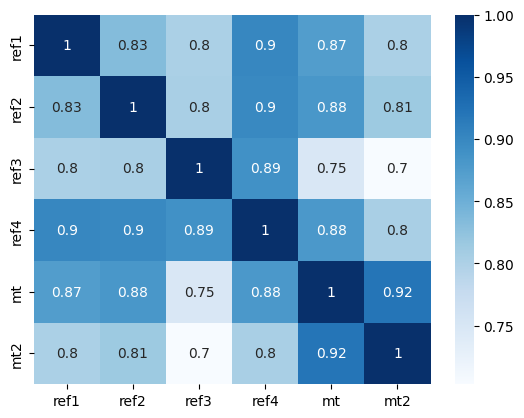

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
136553.84264254154
38438.08077597858
ref2
161910.0265123497
48154.022997754764
ref3
202976.84696726064
62096.719228155576
ref4
109201.62687751451
33644.63636815132
mt
151220.95531025968
49624.18007304595
mt2
215689.31639846557
54944.04839418787
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.846465     0.805762     0.902460   0.878588   
ref2_SL_500     0.846465     1.000000     0.815125     0.910566   0.886254   
ref3_SL_500     0.805762     0.815125     1.000000     0.896040   0.745749   
ref4_SL_500     0.902460     0.910566     0.896040     1.000000   0.876368   
mt_SL_500       0.878588     0.886254     0.745749     0.876368   1.000000   
mt2_SL_500      0.811097     0.821449     0.703278     0.805163   0.929262   

             mt2_SL_500  
ref1_SL_500    0.811097  
ref2_SL_500    0.821449  
ref3_SL_500    0.703278  
ref4_SL_500    0.805163  
mt_SL_500      0.929262 

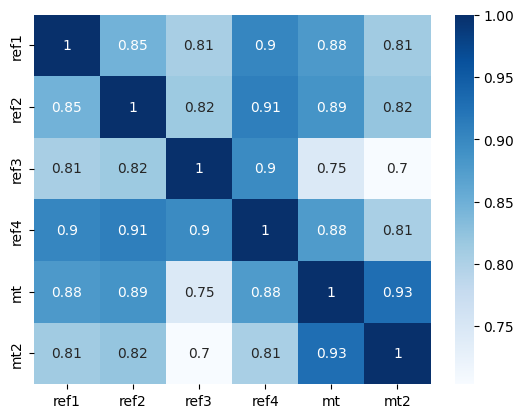

SL_525
src
4331606.646061756
3141367.4417431457
ref1
309415.2881916271
70682.94455730385
ref2
361809.93328390154
88766.39672097209
ref3
458082.34241691453
118626.1268681634
ref4
243312.89139154725
61644.487272220504
mt
336112.85042976635
92899.96664631687
mt2
496179.75284028973
104178.3330094569
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.858406     0.808974     0.904351   0.881196   
ref2_SL_525     0.858406     1.000000     0.823944     0.921046   0.888380   
ref3_SL_525     0.808974     0.823944     1.000000     0.901376   0.740239   
ref4_SL_525     0.904351     0.921046     0.901376     1.000000   0.871053   
mt_SL_525       0.881196     0.888380     0.740239     0.871053   1.000000   
mt2_SL_525      0.818682     0.826632     0.701368     0.803796   0.937152   

             mt2_SL_525  
ref1_SL_525    0.818682  
ref2_SL_525    0.826632  
ref3_SL_525    0.701368  
ref4_SL_525    0.803796  
mt_SL_525      0.937152  


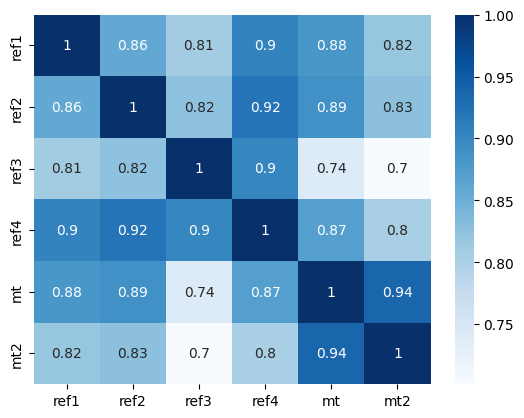

SL_550
src
10231354.187866237
7329958.645473514
ref1
711155.7083923565
131221.72284510077
ref2
819257.9843751682
165746.50070228957
ref3
1047972.6461519685
225447.81499462167
ref4
550190.3946077443
113938.24560629956
mt
758805.9663462823
172866.89080899657
mt2
1157773.3414949207
195976.75542624953
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.868920     0.811404     0.905966   0.882580   
ref2_SL_550     0.868920     1.000000     0.830860     0.929797   0.889084   
ref3_SL_550     0.811404     0.830860     1.000000     0.905765   0.732743   
ref4_SL_550     0.905966     0.929797     0.905765     1.000000   0.864340   
mt_SL_550       0.882580     0.889084     0.732743     0.864340   1.000000   
mt2_SL_550      0.824880     0.830511     0.697410     0.801078   0.944271   

             mt2_SL_550  
ref1_SL_550    0.824880  
ref2_SL_550    0.830511  
ref3_SL_550    0.697410  
ref4_SL_550    0.801078  
mt_SL_550      0.944271 

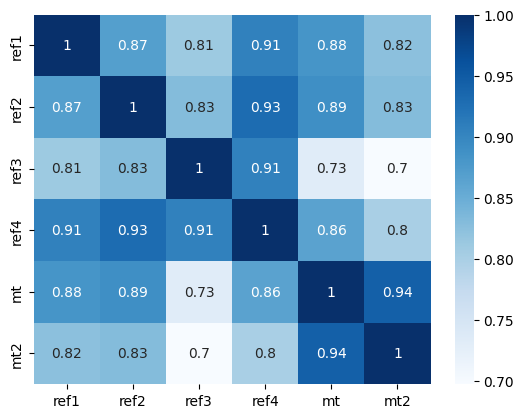

SL_575
src
24325330.39833967
16966711.067660846
ref1
1654697.818217567
247170.78391670104
ref2
1876999.3479929974
311240.8523734503
ref3
2426869.217700285
425338.85234782775
ref4
1260383.2689374306
210603.81111935124
mt
1737596.8274020175
322048.5434343149
mt2
2735777.6060166247
365824.4148136568
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.878117     0.813153     0.907325   0.883010   
ref2_SL_575     0.878117     1.000000     0.836120     0.937019   0.888652   
ref3_SL_575     0.813153     0.836120     1.000000     0.909398   0.723654   
ref4_SL_575     0.907325     0.937019     0.909398     1.000000   0.856580   
mt_SL_575       0.883010     0.888652     0.723654     0.856580   1.000000   
mt2_SL_575      0.829836     0.833204     0.691652     0.797182   0.950664   

             mt2_SL_575  
ref1_SL_575    0.829836  
ref2_SL_575    0.833204  
ref3_SL_575    0.691652  
ref4_SL_575    0.797182  
mt_SL_575      0.950664  

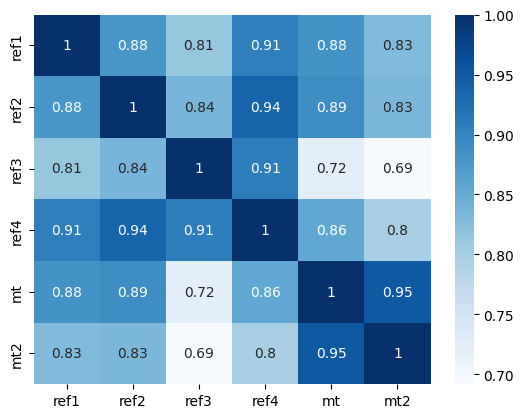

SL_600
src
58189712.87790054
39214596.580572255
ref1
3890480.417418258
474493.7362239374
ref2
4345117.762926735
589406.5091782311
ref3
5680968.447725666
819512.4809970774
ref4
2920008.92770034
393974.0914132332
mt
4030016.404159651
603106.4008891226
mt2
6536409.041859104
684032.4349933038
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.886131     0.814307     0.908451   0.882701   
ref2_SL_600     0.886131     1.000000     0.839956     0.942910   0.887314   
ref3_SL_600     0.814307     0.839956     1.000000     0.912422   0.713296   
ref4_SL_600     0.908451     0.942910     0.912422     1.000000   0.848034   
mt_SL_600       0.882701     0.887314     0.713296     0.848034   1.000000   
mt2_SL_600      0.833698     0.834838     0.684332     0.792270   0.956383   

             mt2_SL_600  
ref1_SL_600    0.833698  
ref2_SL_600    0.834838  
ref3_SL_600    0.684332  
ref4_SL_600    0.792270  
mt_SL_600      0.956383  
mt2_SL_

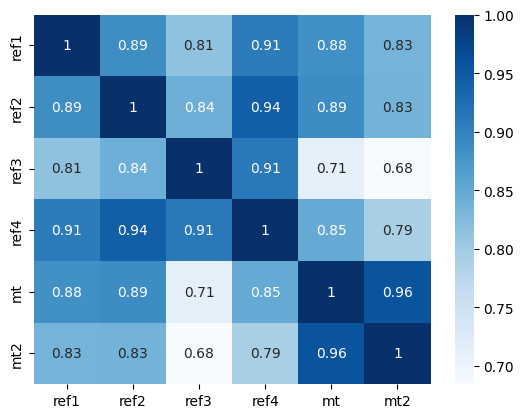

SL_625
src
140004729.32922277
89386250.1037006
ref1
9227733.85681274
895743.2700997246
ref2
10149918.312038692
1111049.959287124
ref3
13424464.769222062
1587186.1565643752
ref4
6830562.326805548
741128.5334806817
mt
9452999.255751906
1132058.9157018599
mt2
15768027.073073475
1284847.1172909453
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.893099     0.814938     0.909362   0.881821   
ref2_SL_625     0.893099     1.000000     0.842578     0.947656   0.885257   
ref3_SL_625     0.814938     0.842578     1.000000     0.914956   0.701931   
ref4_SL_625     0.909362     0.947656     0.914956     1.000000   0.838905   
mt_SL_625       0.881821     0.885257     0.701931     0.838905   1.000000   
mt2_SL_625      0.836608     0.835546     0.675672     0.786488   0.961481   

             mt2_SL_625  
ref1_SL_625    0.836608  
ref2_SL_625    0.835546  
ref3_SL_625    0.675672  
ref4_SL_625    0.786488  
mt_SL_625      0.961481  
mt

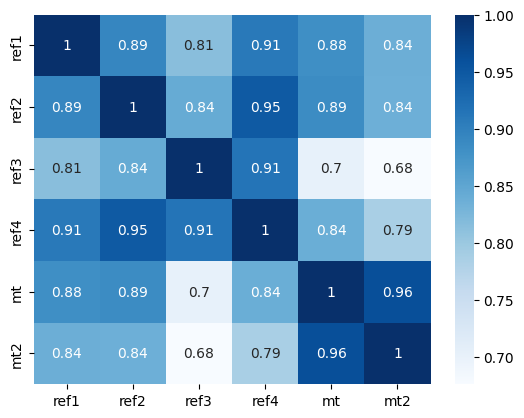

SL_650
src
338703171.3009422
210335993.3140239
ref1
22047497.471988354
1689900.9916648285
ref2
23896078.402880166
2100565.186989951
ref3
31984006.181248296
3083653.393872695
ref4
16109589.611400988
1397655.547640711
mt
22393779.7728759
2146612.7889328618
mt2
38356185.386257485
2448275.124867836
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.899158     0.815109     0.910074   0.880501   
ref2_SL_650     0.899158     1.000000     0.844169     0.951425   0.882633   
ref3_SL_650     0.815109     0.844169     1.000000     0.917091   0.689771   
ref4_SL_650     0.910074     0.951425     0.917091     1.000000   0.829344   
mt_SL_650       0.880501     0.882633     0.689771     0.829344   1.000000   
mt2_SL_650      0.838698     0.835454     0.665877     0.779968   0.966012   

             mt2_SL_650  
ref1_SL_650    0.838698  
ref2_SL_650    0.835454  
ref3_SL_650    0.665877  
ref4_SL_650    0.779968  
mt_SL_650      0.966012  
m

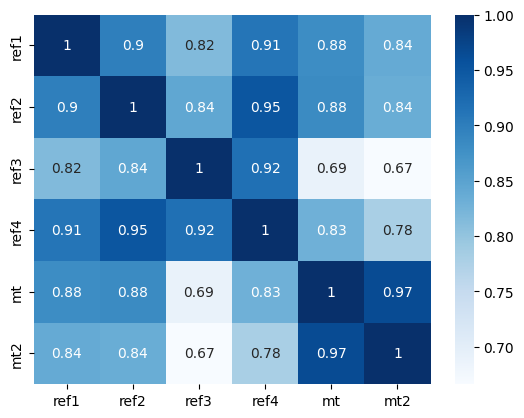

SL_675
src
823697155.0790491
502847016.137499
ref1
52996967.629915565
3205951.617650326
ref2
56640695.39992588
3977702.675757657
ref3
76744010.89867663
5929971.20121398
ref4
38256712.88420908
2590998.7237676326
mt
53507283.84893059
4061391.204966115
mt2
93976609.94581798
4609799.792427638
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.904432     0.814870     0.910603   0.878847   
ref2_SL_675     0.904432     1.000000     0.844886     0.954362   0.879565   
ref3_SL_675     0.814870     0.844886     1.000000     0.918900   0.676990   
ref4_SL_675     0.910603     0.954362     0.918900     1.000000   0.819470   
mt_SL_675       0.878847     0.879565     0.676990     0.819470   1.000000   
mt2_SL_675      0.840088     0.834686     0.655130     0.772832   0.970028   

             mt2_SL_675  
ref1_SL_675    0.840088  
ref2_SL_675    0.834686  
ref3_SL_675    0.655130  
ref4_SL_675    0.772832  
mt_SL_675      0.970028  
mt2_SL_

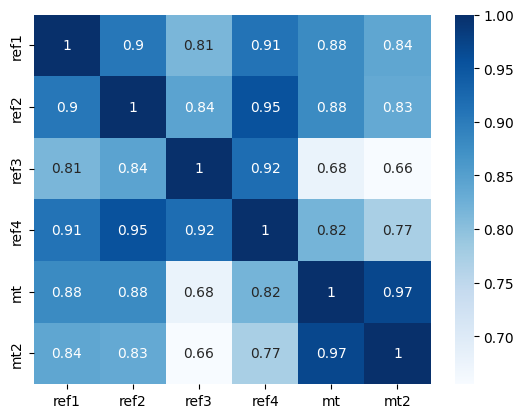

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
128029615.64323252
6018665.4040080365
ref2
135038986.23408443
7399360.399786854
ref3
185268360.69926855
11352515.161828712
ref4
91377834.46153058
4896058.095369096
mt
128799048.56258518
7733539.104759373
mt2
231687326.9675747
8752206.17399044
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.909032     0.814265     0.910964   0.876942   
ref2_SL_700     0.909032     1.000000     0.844863     0.956594   0.876156   
ref3_SL_700     0.814265     0.844863     1.000000     0.920440   0.663729   
ref4_SL_700     0.910964     0.956594     0.920440     1.000000   0.809375   
mt_SL_700       0.876942     0.876156     0.663729     0.809375   1.000000   
mt2_SL_700      0.840889     0.833355     0.643599     0.765189   0.973579   

             mt2_SL_700  
ref1_SL_700    0.840889  
ref2_SL_700    0.833355  
ref3_SL_700    0.643599  
ref4_SL_700    0.765189  
mt_SL_700      0.973579  


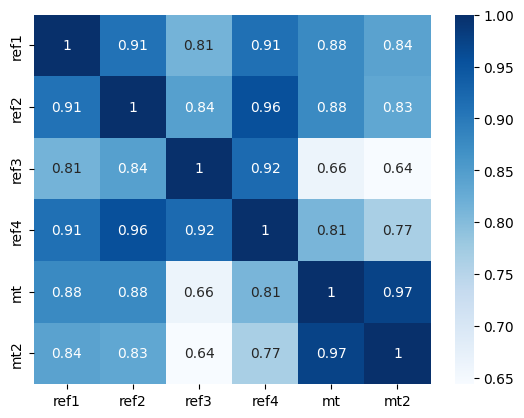

SL_725
src
4944587689.869408
2766777160.633936
ref1
310566506.8182264
11451425.190148927
ref2
323566040.5123445
13917935.102339448
ref3
449600562.5544628
21800569.427553803
ref4
219316197.69261628
9393234.6023104
mt
312012289.90025884
14781835.089769937
mt2
574269873.4550728
16478638.811434017
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.913057     0.813331     0.911168   0.874853   
ref2_SL_725     0.913057     1.000000     0.844212     0.958226   0.872492   
ref3_SL_725     0.813331     0.844212     1.000000     0.921755   0.650107   
ref4_SL_725     0.911168     0.958226     0.921755     1.000000   0.799133   
mt_SL_725       0.874853     0.872492     0.650107     0.799133   1.000000   
mt2_SL_725      0.841200     0.831565     0.631429     0.757137   0.976711   

             mt2_SL_725  
ref1_SL_725    0.841200  
ref2_SL_725    0.831565  
ref3_SL_725    0.631429  
ref4_SL_725    0.757137  
mt_SL_725      0.976711  
mt

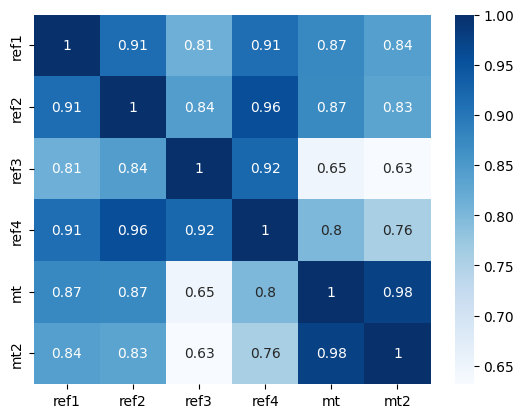

SL_750
src
12201196322.126482
6533701117.122557
ref1
755905669.7987343
21705556.65659243
ref2
778635017.5200782
26406233.881011643
ref3
1095963696.1968334
41739488.28928518
ref4
528504871.8499549
17875782.880151324
mt
759965209.4446714
28228675.681360155
mt2
1430044052.4989495
31148228.82948593
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.916590     0.812099     0.911227   0.872635   
ref2_SL_750     0.916590     1.000000     0.843027     0.959349   0.868644   
ref3_SL_750     0.812099     0.843027     1.000000     0.922883   0.636222   
ref4_SL_750     0.911227     0.959349     0.922883     1.000000   0.788804   
mt_SL_750       0.872635     0.868644     0.636222     0.788804   1.000000   
mt2_SL_750      0.841108     0.829411     0.618754     0.748763   0.979470   

             mt2_SL_750  
ref1_SL_750    0.841108  
ref2_SL_750    0.829411  
ref3_SL_750    0.618754  
ref4_SL_750    0.748763  
mt_SL_750      0.979470  
m

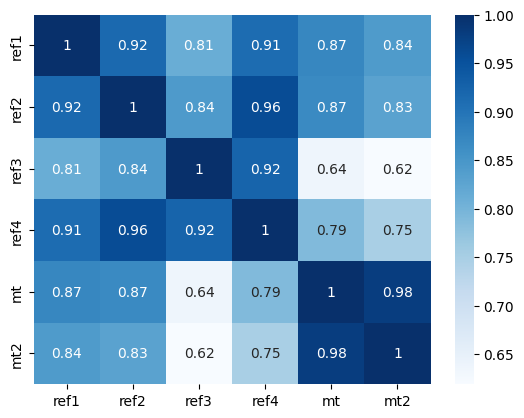

SL_775
src
30245243673.27781
15503724864.782127
ref1
1844974970.659699
41226440.26222678
ref2
1880661401.4871917
50172057.93556824
ref3
2681827545.870802
79810345.79104005
ref4
1277864957.2225509
34054755.44080525
mt
1859678731.202036
53434567.190030396
mt2
3575520690.1464133
58922374.06505738
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.919705     0.810596     0.911150   0.870334   
ref2_SL_775     0.919705     1.000000     0.841388     0.960039   0.864675   
ref3_SL_775     0.810596     0.841388     1.000000     0.923852   0.622157   
ref4_SL_775     0.911150     0.960039     0.923852     1.000000   0.778438   
mt_SL_775       0.870334     0.864675     0.622157     0.778438   1.000000   
mt2_SL_775      0.840693     0.826977     0.605688     0.740144   0.981896   

             mt2_SL_775  
ref1_SL_775    0.840693  
ref2_SL_775    0.826977  
ref3_SL_775    0.605688  
ref4_SL_775    0.740144  
mt_SL_775      0.981896  
mt

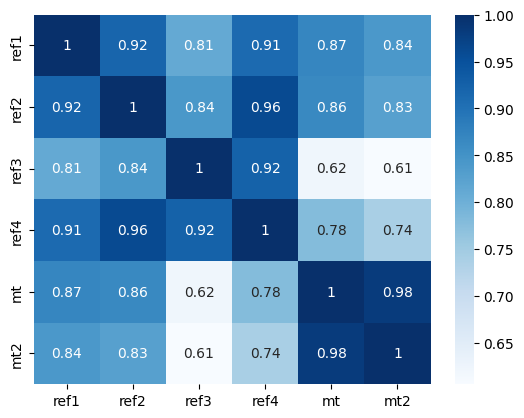

SL_800
src
75308449146.75627
37154119080.28433
ref1
4513485100.394923
79079563.92800364
ref2
4556909409.8484955
95170047.15785633
ref3
6584063970.792878
152372167.86238104
ref4
3098398556.1514525
64943915.35292505
mt
4568927515.456073
100704148.3324143
mt2
8971482977.186079
112009698.90573367
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.922464     0.808844     0.910948   0.867987   
ref2_SL_800     0.922464     1.000000     0.839359     0.960360   0.860635   
ref3_SL_800     0.808844     0.839359     1.000000     0.924686   0.607983   
ref4_SL_800     0.910948     0.960360     0.924686     1.000000   0.768074   
mt_SL_800       0.867987     0.860635     0.607983     0.768074   1.000000   
mt2_SL_800      0.840021     0.824336     0.592334     0.731349   0.984027   

             mt2_SL_800  
ref1_SL_800    0.840021  
ref2_SL_800    0.824336  
ref3_SL_800    0.592334  
ref4_SL_800    0.731349  
mt_SL_800      0.984027  
mt2

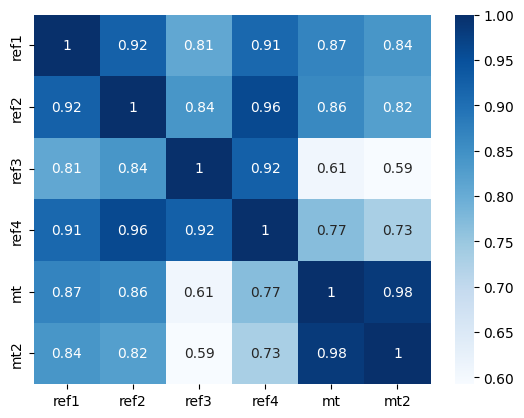

SL_825
src
188328461125.37543
88759479197.95065
ref1
11062680055.55317
151361415.4305618
ref2
11071957083.596783
184923671.59866422
ref3
16210080494.701344
291094231.2038912
ref4
7530199554.908303
124015518.96035141
mt
11263610638.523373
191203806.90588462
mt2
22580738299.560047
215377879.71173677
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.924920     0.806863     0.910627   0.865626   
ref2_SL_825     0.924920     1.000000     0.836997     0.960364   0.856570   
ref3_SL_825     0.806863     0.836997     1.000000     0.925404   0.593760   
ref4_SL_825     0.910627     0.960364     0.925404     1.000000   0.757749   
mt_SL_825       0.865626     0.856570     0.593760     0.757749   1.000000   
mt2_SL_825      0.839152     0.821552     0.578781     0.722437   0.985897   

             mt2_SL_825  
ref1_SL_825    0.839152  
ref2_SL_825    0.821552  
ref3_SL_825    0.578781  
ref4_SL_825    0.722437  
mt_SL_825      0.985897 

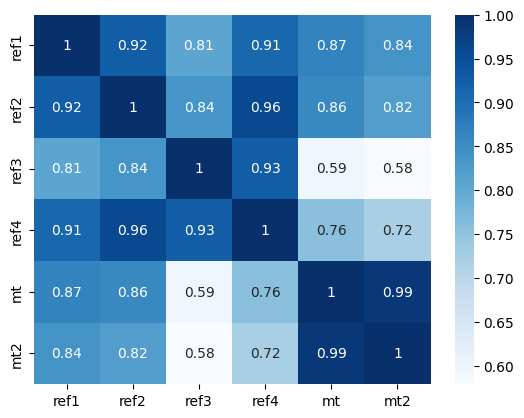

SL_850
src
472965874424.6596
209696852072.8994
ref1
27157880279.170948
288785697.7737365
ref2
26965751240.209454
353182687.7587713
ref3
40006897246.90873
557297107.0283945
ref4
18336992070.98227
237977338.3488351
mt
27849791525.007023
355599352.1735269
mt2
56990767694.053764
414535644.6255045
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.927116     0.804672     0.910195   0.863277   
ref2_SL_850     0.927116     1.000000     0.834347     0.960095   0.852515   
ref3_SL_850     0.804672     0.834347     1.000000     0.926022   0.579541   
ref4_SL_850     0.910195     0.960095     0.926022     1.000000   0.747490   
mt_SL_850       0.863277     0.852515     0.579541     0.747490   1.000000   
mt2_SL_850      0.838140     0.818682     0.565107     0.713461   0.987538   

             mt2_SL_850  
ref1_SL_850    0.838140  
ref2_SL_850    0.818682  
ref3_SL_850    0.565107  
ref4_SL_850    0.713461  
mt_SL_850      0.987538  
mt2

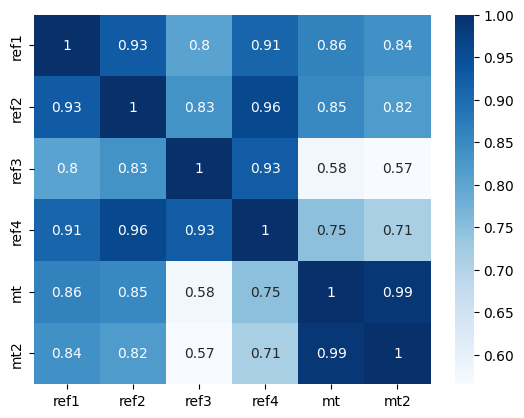

SL_875
src
1192729481778.0728
501307929419.6415
ref1
66758281585.822334
551351540.5925813
ref2
65811098010.34799
668094688.0562897
ref3
98946485023.41304
1085866350.8804073
ref4
44726679091.81199
457108715.4560274
mt
69035833397.8175
661691000.9316341
mt2
144188789872.59622
804615395.7905784
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.929090     0.802286     0.909657   0.860961   
ref2_SL_875     0.929090     1.000000     0.831448     0.959591   0.848504   
ref3_SL_875     0.802286     0.831448     1.000000     0.926554   0.565370   
ref4_SL_875     0.909657     0.959591     0.926554     1.000000   0.737322   
mt_SL_875       0.860961     0.848504     0.565370     0.737322   1.000000   
mt2_SL_875      0.837027     0.815774     0.551378     0.704465   0.988976   

             mt2_SL_875  
ref1_SL_875    0.837027  
ref2_SL_875    0.815774  
ref3_SL_875    0.551378  
ref4_SL_875    0.704465  
mt_SL_875      0.988976  
mt2_

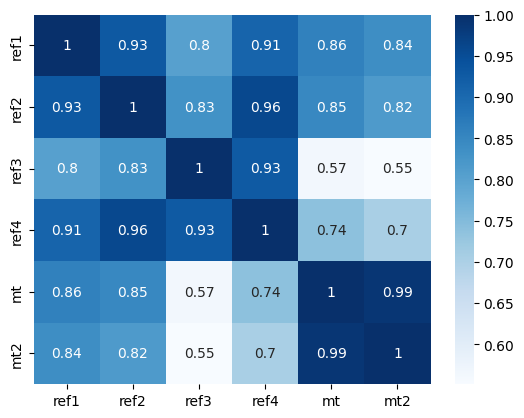

SL_900
src
3020011763176.6636
1193341285325.353
ref1
164284279683.4809
1057038627.9110444
ref2
160904874149.69778
1287621254.3307066
ref3
245166649854.2411
2083048779.7085042
ref4
109247270208.26704
872575568.7055779
mt
171510649531.33112
1238557559.3042576
mt2
365601233605.38654
1563420634.9457011
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.930875     0.799720     0.909020   0.858699   
ref2_SL_900     0.930875     1.000000     0.828332     0.958882   0.844564   
ref3_SL_900     0.799720     0.828332     1.000000     0.927011   0.551287   
ref4_SL_900     0.909020     0.958882     0.927011     1.000000   0.727268   
mt_SL_900       0.858699     0.844564     0.551287     0.727268   1.000000   
mt2_SL_900      0.835852     0.812867     0.537654     0.695488   0.990237   

             mt2_SL_900  
ref1_SL_900    0.835852  
ref2_SL_900    0.812867  
ref3_SL_900    0.537654  
ref4_SL_900    0.695488  
mt_SL_900      0.990237

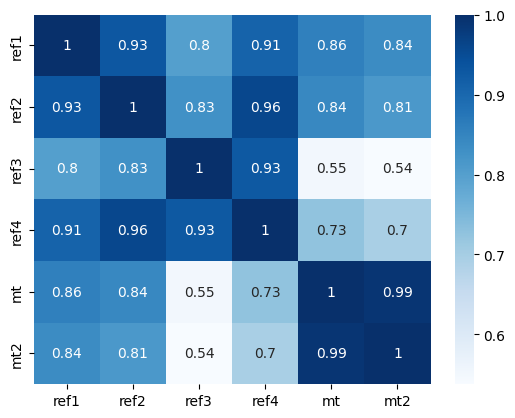

SL_925
src
7676878874728.81
2825871516031.6035
ref1
404662928935.62146
2016768619.6218748
ref2
394026122748.8652
2484895873.2925606
ref3
608438336681.3798
4002825893.4844065
ref4
267157870372.32648
1667420354.0555787
mt
426924206642.5594
2333114233.9578776
mt2
928834525217.4852
3040850904.333089
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.932497     0.796985     0.908288   0.856504   
ref2_SL_925     0.932497     1.000000     0.825028     0.957994   0.840717   
ref3_SL_925     0.796985     0.825028     1.000000     0.927403   0.537324   
ref4_SL_925     0.908288     0.957994     0.927403     1.000000   0.717343   
mt_SL_925       0.856504     0.840717     0.537324     0.717343   1.000000   
mt2_SL_925      0.834648     0.809998     0.523985     0.686563   0.991343   

             mt2_SL_925  
ref1_SL_925    0.834648  
ref2_SL_925    0.809998  
ref3_SL_925    0.523985  
ref4_SL_925    0.686563  
mt_SL_925      0.991343  


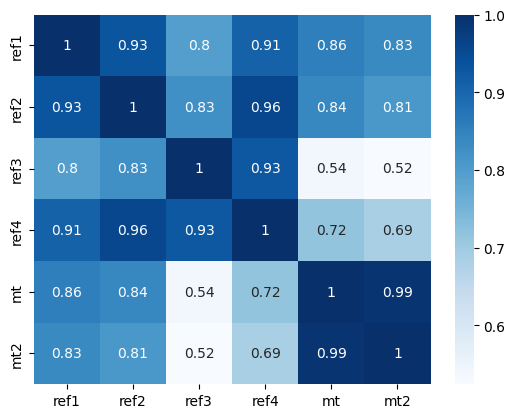

SL_950
src
19589480415784.91
6695745864435.366
ref1
997553531632.7188
3850392743.494394
ref2
966236482361.7386
4801252478.340346
ref3
1512099560609.5576
7698594126.297383
ref4
653977640914.18
3141173538.152942
mt
1064517097258.659
4397671006.582131
mt2
2363974763244.173
5919963162.507609
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.933978     0.794094     0.907466   0.854392   
ref2_SL_950     0.933978     1.000000     0.821559     0.956949   0.836982   
ref3_SL_950     0.794094     0.821559     1.000000     0.927738   0.523510   
ref4_SL_950     0.907466     0.956949     0.927738     1.000000   0.707564   
mt_SL_950       0.854392     0.836982     0.523510     0.707564   1.000000   
mt2_SL_950      0.833443     0.807193     0.510413     0.677716   0.992313   

             mt2_SL_950  
ref1_SL_950    0.833443  
ref2_SL_950    0.807193  
ref3_SL_950    0.510413  
ref4_SL_950    0.677716  
mt_SL_950      0.992313  
mt2_SL_9

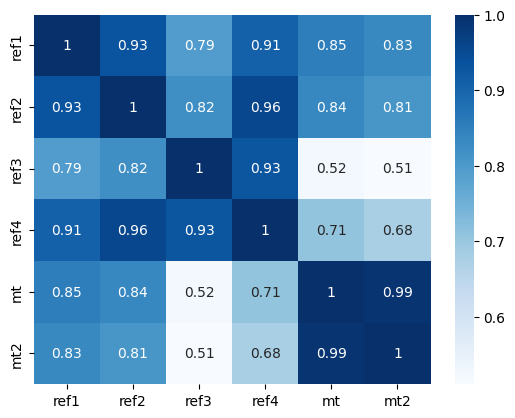

SL_975
src
50173418288827.71
15873783084476.455
ref1
2460788999858.136
7367212744.552352
ref2
2372321240350.792
9226008741.455822
ref3
3762535213871.178
14857622471.830265
ref4
1602258607456.2273
5929739899.24576
mt
2658349317273.822
8304547187.8504715
mt2
6026314422160.091
11470085293.487595
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.935338     0.791056     0.906558   0.852371   
ref2_SL_975     0.935338     1.000000     0.817945     0.955765   0.833376   
ref3_SL_975     0.791056     0.817945     1.000000     0.928023   0.509871   
ref4_SL_975     0.906558     0.955765     0.928023     1.000000   0.697944   
mt_SL_975       0.852371     0.833376     0.509871     0.697944   1.000000   
mt2_SL_975      0.832259     0.804477     0.496974     0.668972   0.993166   

             mt2_SL_975  
ref1_SL_975    0.832259  
ref2_SL_975    0.804477  
ref3_SL_975    0.496974  
ref4_SL_975    0.668972  
mt_SL_975      0.993166  
mt2

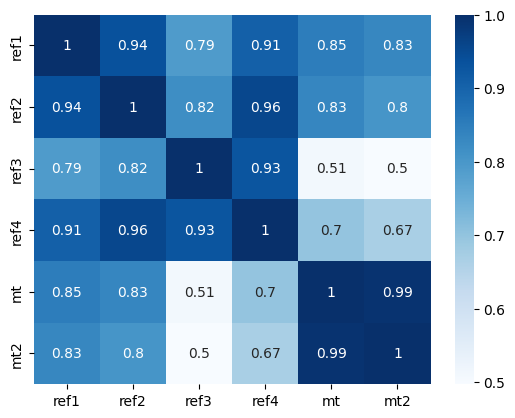

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.42674324675836095
0.43207228967986455
ref2
0.422439400261458
0.42671208269917715
ref3
0.413629193007908
0.419893975861793
ref4
0.44089526726898215
0.4447772660815224
mt
0.4187818722372393
0.420658747376075
mt2
0.42955883039059367
0.4321004228334282
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.727830   0.723496   0.809474  0.783357  0.719150
ref2_gini   0.727830   1.000000   0.709741   0.675867  0.751700  0.786646
ref3_gini   0.723496   0.709741   1.000000   0.670885  0.734330  0.617893
ref4_gini   0.809474   0.675867   0.670885   1.000000  0.736696  0.704473
mt_gini     0.783357   0.751700   0.734330   0.736696  1.000000  0.836344
mt2_gini    0.719150   0.786646   0.617893   0.704473  0.836344  1.000000


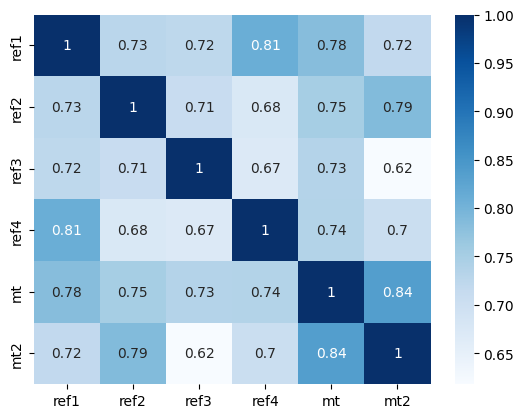

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.323901452498077
-4.401590704805772
ref2
-4.294467201125633
-4.360154162398958
ref3
-4.263678103107898
-4.330691413723366
ref4
-4.332697853221387
-4.408159136123911
mt
-4.262291424297914
-4.320235216440981
mt2
-4.274385735291829
-4.345306919808216
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.978571  0.958790  0.975267  0.975074  0.970224
ref2_kl  0.978571  1.000000  0.968114  0.976630  0.983625  0.979248
ref3_kl  0.958790  0.968114  1.000000  0.955698  0.972687  0.962581
ref4_kl  0.975267  0.976630  0.955698  1.000000  0.972576  0.965210
mt_kl    0.975074  0.983625  0.972687  0.972576  1.000000  0.986619
mt2_kl   0.970224  0.979248  0.962581  0.965210  0.986619  1.000000


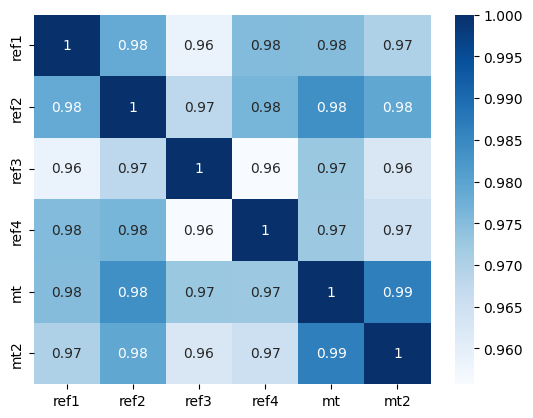

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.7997572514825775
0.7951307088544582
ref2
0.7891636855166333
0.7791068223388138
ref3
0.773303206120526
0.763074342917414
ref4
0.8289448368358109
0.8173689224081677
mt
0.7763824034387409
0.7646162845460482
mt2
0.8053471119338138
0.8029192372872653
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.714727  0.682800  0.803281  0.789724  0.714662
ref2_cv  0.714727  1.000000  0.697836  0.705153  0.753846  0.747614
ref3_cv  0.682800  0.697836  1.000000  0.681425  0.707799  0.589013
ref4_cv  0.803281  0.705153  0.681425  1.000000  0.774092  0.745396
mt_cv    0.789724  0.753846  0.707799  0.774092  1.000000  0.814204
mt2_cv   0.714662  0.747614  0.589013  0.745396  0.814204  1.000000


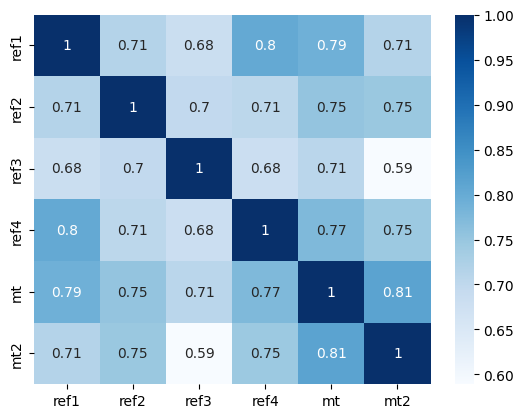

lv
src
72.35425230811832
69.03561950442358
ref1
26.066152924955134
21.78868064010414
ref2
29.707817516687026
24.614091676609533
ref3
30.94958169995186
26.072962910570975
ref4
25.123678319116163
21.30654687024833
mt
28.20092019988337
25.033431310347304
mt2
32.08796263403536
26.990392291082006
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.648723  0.618102  0.756001  0.732614  0.584575
ref2_lv  0.648723  1.000000  0.549709  0.720206  0.775705  0.688202
ref3_lv  0.618102  0.549709  1.000000  0.673862  0.615478  0.498874
ref4_lv  0.756001  0.720206  0.673862  1.000000  0.766286  0.681236
mt_lv    0.732614  0.775705  0.615478  0.766286  1.000000  0.782275
mt2_lv   0.584575  0.688202  0.498874  0.681236  0.782275  1.000000


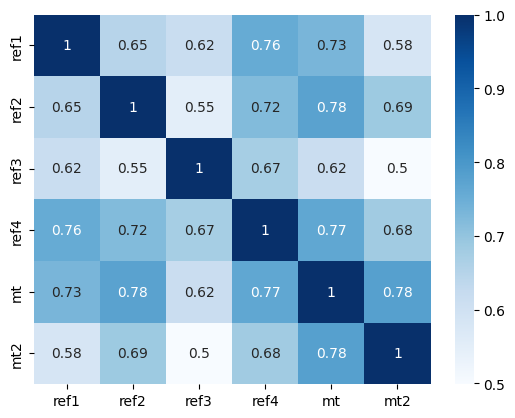

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-372.0544013910453
-337.7458291919761
ref2
-410.0800746037385
-354.803706728828
ref3
-430.50151799718094
-385.8126479040966
ref4
-360.732673240864
-314.9554721459135
mt
-400.52962657035476
-365.14051794778936
mt2
-411.194143451049
-368.0949645698354
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.949032    0.943184    0.963297  0.953737   
ref2_renyi    0.949032    1.000000    0.939194    0.953639  0.955985   
ref3_renyi    0.943184    0.939194    1.000000    0.937230  0.942815   
ref4_renyi    0.963297    0.953639    0.937230    1.000000  0.952925   
mt_renyi      0.953737    0.955985    0.942815    0.952925  1.000000   
mt2_renyi     0.950892    0.955544    0.948550    0.949535  0.970651   

            mt2_renyi  
ref1_renyi   0.950892  
ref2_renyi   0.955544  
ref3_renyi   0.948550  
ref4_renyi   0.949535  
mt_renyi     0.970651  
mt2_renyi    1.000000  


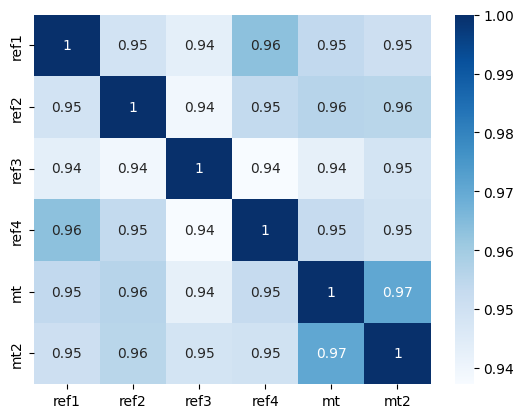

41.78302361451637
14.34837421092281
16.34338334591145
17.560553043072773
13.770525703802658
16.194133627251986


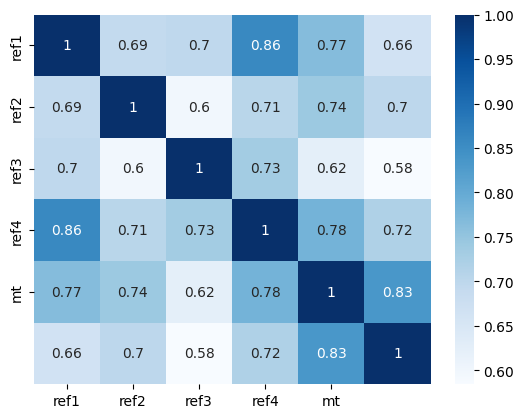

*************************************
14.332191694810836
14.332191694810836
16.392001175240832
17.852124509687233
13.83162473323172
16.266596917573384
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


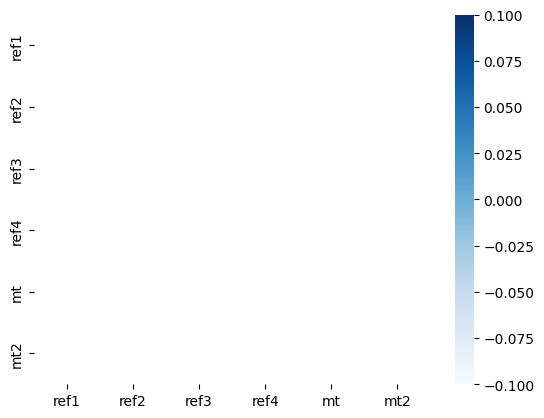

L
src
10.359164788583737
10.123614579255745
ref1
4.518668585727272
4.4394726390536965
ref2
4.7719387223340455
4.720278070749677
ref3
4.909293139545902
4.833310959597085
ref4
4.381664878898302
4.312944405356733
mt
5.068877886262579
4.88776934617219
mt2
5.046018045651242
4.894587961806762
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.838264  0.775326  0.857188  0.730127  0.700998
ref2_L  0.838264  1.000000  0.800567  0.858810  0.726893  0.712964
ref3_L  0.775326  0.800567  1.000000  0.787920  0.689554  0.698571
ref4_L  0.857188  0.858810  0.787920  1.000000  0.729508  0.705171
mt_L    0.730127  0.726893  0.689554  0.729508  1.000000  0.907183
mt2_L   0.700998  0.712964  0.698571  0.705171  0.907183  1.000000


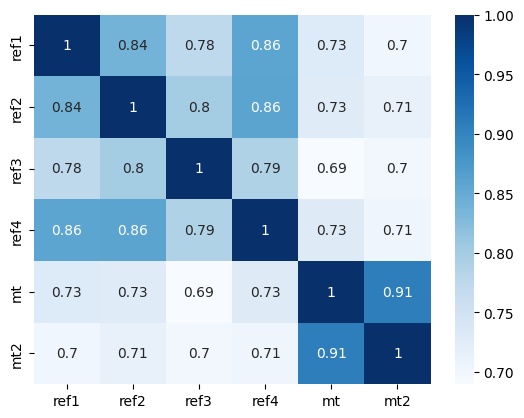

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.3312033327598582
1.3329250328149203
ref2
1.3500561164422524
1.3450397357557478
ref3
1.363267584099565
1.3621394907574138
ref4
1.314904913991478
1.3144924341773783
mt
1.3744323235734601
1.3697648693055418
mt2
1.36843170610647
1.3561119754937003
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.852561    0.808121    0.881026  0.798522   
ref2_SL_25    0.852561    1.000000    0.824216    0.855779  0.781433   
ref3_SL_25    0.808121    0.824216    1.000000    0.801227  0.754380   
ref4_SL_25    0.881026    0.855779    0.801227    1.000000  0.793597   
mt_SL_25      0.798522    0.781433    0.754380    0.793597  1.000000   
mt2_SL_25     0.768383    0.772490    0.760386    0.774405  0.913706   

            mt2_SL_25  
ref1_SL_25   0.768383  
ref2_SL_25   0.772490  
ref3_SL_25   0.760386  
ref4_SL_25   0.774405  
mt_SL_25     0.913706  
mt2_SL_25    1.000000  


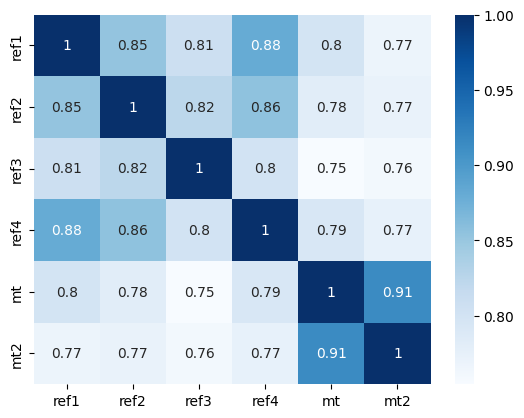

SL_50
src
3.0671973011635125
3.032966843199389
ref1
1.9137318462963286
1.9114503693106912
ref2
1.9678854855755172
1.9543197962117262
ref3
2.001743437805902
1.988245669041032
ref4
1.8751383307033365
1.871916278438739
mt
2.035074742400435
2.0157470783381326
mt2
2.0218519181882417
1.9843828312086662
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.851590    0.795155    0.873186  0.773368   
ref2_SL_50    0.851590    1.000000    0.812846    0.858229  0.760498   
ref3_SL_50    0.795155    0.812846    1.000000    0.793255  0.726549   
ref4_SL_50    0.873186    0.858229    0.793255    1.000000  0.769695   
mt_SL_50      0.773368    0.760498    0.726549    0.769695  1.000000   
mt2_SL_50     0.746510    0.752808    0.738125    0.749988  0.912738   

            mt2_SL_50  
ref1_SL_50   0.746510  
ref2_SL_50   0.752808  
ref3_SL_50   0.738125  
ref4_SL_50   0.749988  
mt_SL_50     0.912738  
mt2_SL_50    1.000000  


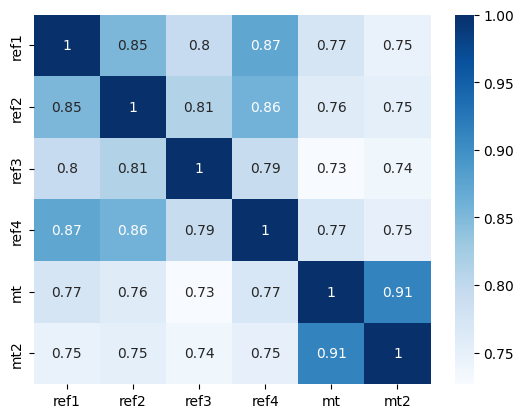

SL_75
src
5.5762344444241885
5.474223342002128
ref1
2.8885432320234394
2.8695998093390003
ref2
3.010866607224077
2.9788687810701857
ref3
3.0810652272453063
3.0487901305780443
ref4
2.81379143938433
2.79195295320059
mt
3.1574651451642324
3.0827653697725284
mt2
3.136899296115913
3.045472219911791
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.846403    0.784295    0.865036  0.750701   
ref2_SL_75    0.846403    1.000000    0.805590    0.859297  0.743000   
ref3_SL_75    0.784295    0.805590    1.000000    0.789336  0.705913   
ref4_SL_75    0.865036    0.859297    0.789336    1.000000  0.748287   
mt_SL_75      0.750701    0.743000    0.705913    0.748287  1.000000   
mt2_SL_75     0.723669    0.732688    0.717660    0.726576  0.910379   

            mt2_SL_75  
ref1_SL_75   0.723669  
ref2_SL_75   0.732688  
ref3_SL_75   0.717660  
ref4_SL_75   0.726576  
mt_SL_75     0.910379  
mt2_SL_75    1.000000  


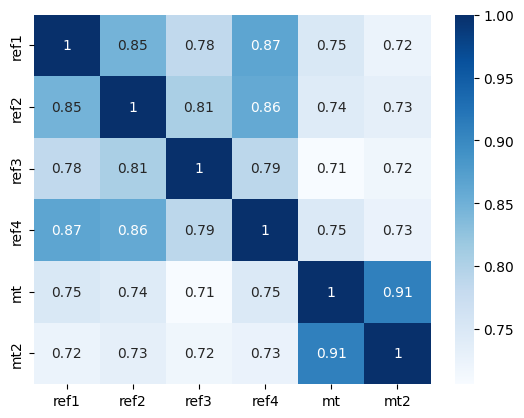

SL_100
src
10.359164788583737
10.123614579255745
ref1
4.518668585727272
4.4394726390536965
ref2
4.7719387223340455
4.720278070749677
ref3
4.909293139545902
4.833310959597085
ref4
4.381664878898302
4.312944405356733
mt
5.068877886262579
4.88776934617219
mt2
5.046018045651242
4.894587961806762
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.838264     0.775326     0.857188   0.730127   
ref2_SL_100     0.838264     1.000000     0.800567     0.858810   0.726893   
ref3_SL_100     0.775326     0.800567     1.000000     0.787920   0.689554   
ref4_SL_100     0.857188     0.858810     0.787920     1.000000   0.729508   
mt_SL_100       0.730127     0.726893     0.689554     0.729508   1.000000   
mt2_SL_100      0.700998     0.712964     0.698571     0.705171   0.907183   

             mt2_SL_100  
ref1_SL_100    0.700998  
ref2_SL_100    0.712964  
ref3_SL_100    0.698571  
ref4_SL_100    0.705171  
mt_SL_100      0.907183  
mt2_

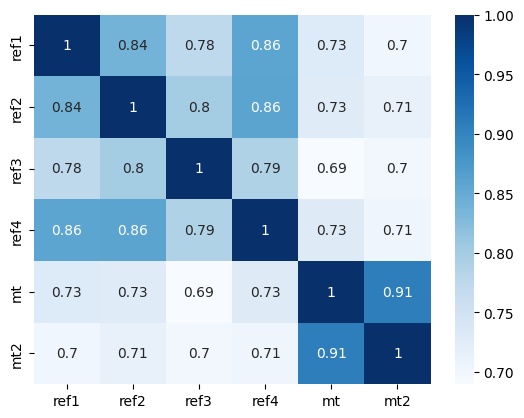

SL_125
src
19.634351008953868
18.984081758810827
ref1
7.276495626882247
7.11428445089706
ref2
7.780261112797417
7.61689134053341
ref3
8.044233560024026
7.791392704394359
ref4
7.029324235031355
6.854805015383146
mt
8.363245108239383
7.973503250363868
mt2
8.359367590051237
8.037927505536217
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.828703     0.768307     0.850496   0.712059   
ref2_SL_125     0.828703     1.000000     0.796659     0.856696   0.711616   
ref3_SL_125     0.768307     0.796659     1.000000     0.787884   0.675941   
ref4_SL_125     0.850496     0.856696     0.787884     1.000000   0.713703   
mt_SL_125       0.712059     0.711616     0.675941     0.713703   1.000000   
mt2_SL_125      0.679689     0.694521     0.680343     0.686490   0.902591   

             mt2_SL_125  
ref1_SL_125    0.679689  
ref2_SL_125    0.694521  
ref3_SL_125    0.680343  
ref4_SL_125    0.686490  
mt_SL_125      0.902591  
mt2_SL_

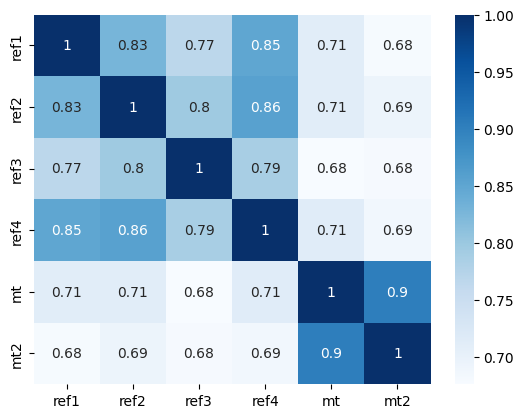

SL_150
src
37.92546190950008
36.245652911575796
ref1
12.014266643835573
11.586184243655024
ref2
12.996957525657306
12.56304152223256
ref3
13.50222709329035
12.885808704790685
ref4
11.568382127319166
11.160497229650943
mt
14.12452774484044
13.006562387659422
mt2
14.205487122045625
13.383714178396371
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.819087     0.763678     0.845769   0.697722   
ref2_SL_150     0.819087     1.000000     0.793599     0.853187   0.697966   
ref3_SL_150     0.763678     0.793599     1.000000     0.788867   0.664975   
ref4_SL_150     0.845769     0.853187     0.788867     1.000000   0.701780   
mt_SL_150       0.697722     0.697966     0.664975     0.701780   1.000000   
mt2_SL_150      0.661399     0.678739     0.663407     0.671665   0.896103   

             mt2_SL_150  
ref1_SL_150    0.661399  
ref2_SL_150    0.678739  
ref3_SL_150    0.663407  
ref4_SL_150    0.671665  
mt_SL_150      0.896103

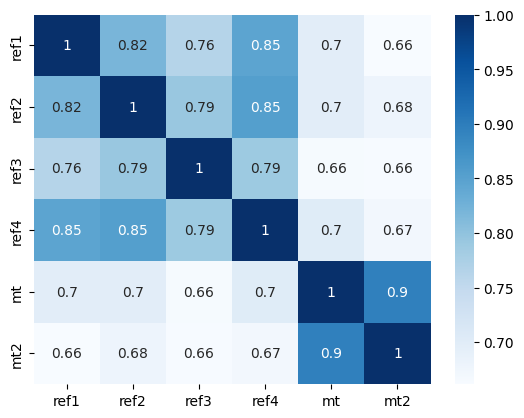

SL_175
src
74.59367553068095
71.2767390568266
ref1
20.29034709955771
19.30484577625584
ref2
22.19090772953655
21.028636269464673
ref3
23.159666654102818
21.826675682846677
ref4
19.47971604677699
18.68788012249104
mt
24.35520993794936
21.87788948775302
mt2
24.70213300423133
22.678501931655738
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.810831     0.762170     0.843809   0.688899   
ref2_SL_175     0.810831     1.000000     0.791763     0.849037   0.687750   
ref3_SL_175     0.762170     0.791763     1.000000     0.791149   0.657543   
ref4_SL_175     0.843809     0.849037     0.791149     1.000000   0.695156   
mt_SL_175       0.688899     0.687750     0.657543     0.695156   1.000000   
mt2_SL_175      0.648236     0.667437     0.649156     0.662254   0.887672   

             mt2_SL_175  
ref1_SL_175    0.648236  
ref2_SL_175    0.667437  
ref3_SL_175    0.649156  
ref4_SL_175    0.662254  
mt_SL_175      0.887672  
mt2_

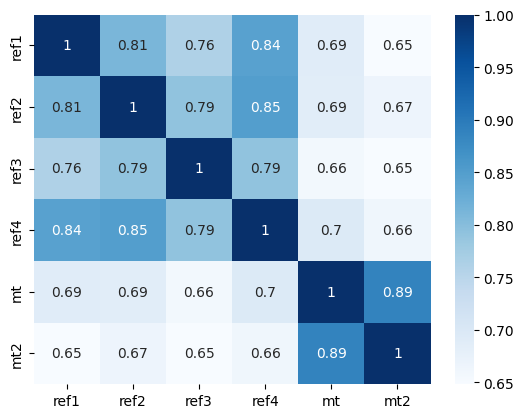

SL_200
src
149.29007454484417
140.79844066957907
ref1
35.000562486301675
32.70466778675214
ref2
38.668460239617616
35.68991130176484
ref3
40.534044148770356
37.45225068673973
ref4
33.508034132247325
31.328877043238343
mt
42.806467047141744
37.541957293251045
mt2
43.88929974808539
39.56282465710347
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.805526     0.764617     0.845350   0.687577   
ref2_SL_200     0.805526     1.000000     0.791955     0.845558   0.683374   
ref3_SL_200     0.764617     0.791955     1.000000     0.795418   0.655120   
ref4_SL_200     0.845350     0.845558     0.795418     1.000000   0.695497   
mt_SL_200       0.687577     0.683374     0.655120     0.695497   1.000000   
mt2_SL_200      0.642431     0.662520     0.639612     0.659869   0.877908   

             mt2_SL_200  
ref1_SL_200    0.642431  
ref2_SL_200    0.662520  
ref3_SL_200    0.639612  
ref4_SL_200    0.659869  
mt_SL_200      0.877908 

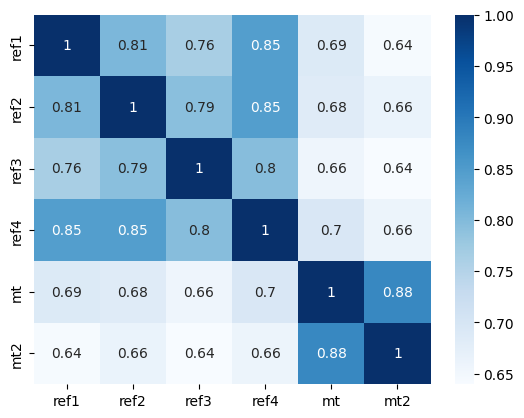

SL_225
src
303.8405857924159
280.9173422693609
ref1
61.62092146659415
55.63795756966052
ref2
68.71352264792326
61.534440080138964
ref3
72.32769621950597
65.0788907197853
ref4
58.82747322232296
53.36487926019826
mt
76.60961441961264
64.59196030892556
mt2
79.60957394212657
68.22316413445711
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.804711     0.771563     0.850795   0.695378   
ref2_SL_225     0.804711     1.000000     0.795053     0.844349   0.687160   
ref3_SL_225     0.771563     0.795053     1.000000     0.802387   0.659234   
ref4_SL_225     0.850795     0.844349     0.802387     1.000000   0.704174   
mt_SL_225       0.695378     0.687160     0.659234     0.704174   1.000000   
mt2_SL_225      0.645626     0.665324     0.636722     0.665450   0.868180   

             mt2_SL_225  
ref1_SL_225    0.645626  
ref2_SL_225    0.665324  
ref3_SL_225    0.636722  
ref4_SL_225    0.665450  
mt_SL_225      0.868180  
mt2_SL_

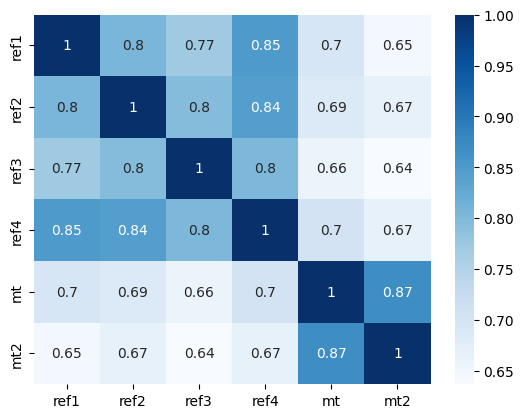

SL_250
src
628.4544909090951
577.7790438817206
ref1
110.70029234276242
95.53859784428386
ref2
124.48000629950842
107.5842567153505
ref3
131.53235903927467
113.9935973315172
ref4
105.36793512792923
91.58023702340304
mt
139.53253382971698
114.88986803616159
mt2
147.36649741933397
121.7993471751278
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.809299     0.782768     0.859849   0.712752   
ref2_SL_250     0.809299     1.000000     0.801513     0.846699   0.700378   
ref3_SL_250     0.782768     0.801513     1.000000     0.812282   0.670698   
ref4_SL_250     0.859849     0.846699     0.812282     1.000000   0.721472   
mt_SL_250       0.712752     0.700378     0.670698     0.721472   1.000000   
mt2_SL_250      0.657983     0.675884     0.641398     0.678520   0.860373   

             mt2_SL_250  
ref1_SL_250    0.657983  
ref2_SL_250    0.675884  
ref3_SL_250    0.641398  
ref4_SL_250    0.678520  
mt_SL_250      0.860373  


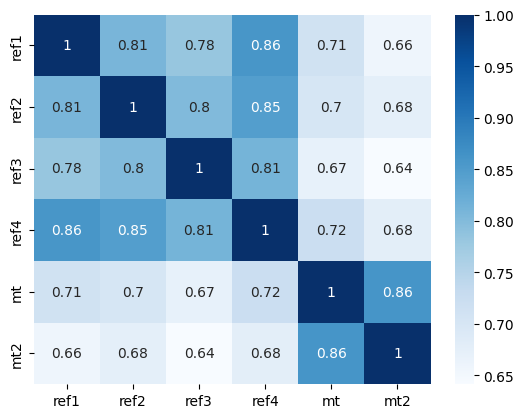

SL_275
src
1320.1522165503627
1219.778984730092
ref1
202.9590209044636
166.047338308326
ref2
229.90772960851186
190.56364660206413
ref3
243.7858245161062
201.3380175260901
ref4
192.54511635615177
161.1065622025912
mt
258.586282070164
203.07270973907146
mt2
278.38876206457627
218.75886035942384
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.819054     0.796986     0.871391   0.738307   
ref2_SL_275     0.819054     1.000000     0.810982     0.852971   0.722371   
ref3_SL_275     0.796986     0.810982     1.000000     0.824506   0.688857   
ref4_SL_275     0.871391     0.852971     0.824506     1.000000   0.745948   
mt_SL_275       0.738307     0.722371     0.688857     0.745948   1.000000   
mt2_SL_275      0.677772     0.692665     0.652858     0.697014   0.856251   

             mt2_SL_275  
ref1_SL_275    0.677772  
ref2_SL_275    0.692665  
ref3_SL_275    0.652858  
ref4_SL_275    0.697014  
mt_SL_275      0.856251  
mt

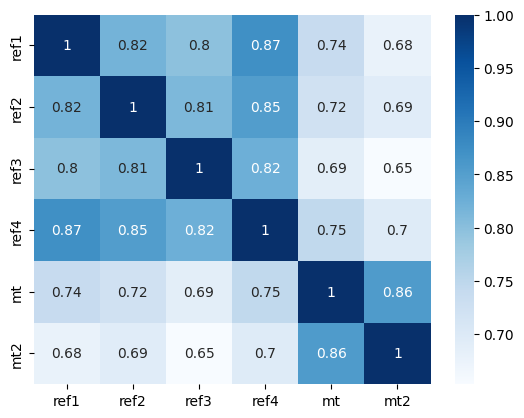

SL_300
src
2814.3535145845594
2540.753413906092
ref1
379.9262709310925
296.61673513980514
ref2
433.04558360944645
338.41285254697533
ref3
460.62715838562264
359.6591435062018
ref4
359.0601832899134
288.2745026022341
mt
487.6548490963618
366.18381074789954
mt2
536.7986859372029
394.58090654820046
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.832606     0.812313     0.883837   0.768864   
ref2_SL_300     0.832606     1.000000     0.822338     0.862451   0.750416   
ref3_SL_300     0.812313     0.822338     1.000000     0.837778   0.711388   
ref4_SL_300     0.883837     0.862451     0.837778     1.000000   0.774488   
mt_SL_300       0.768864     0.750416     0.711388     0.774488   1.000000   
mt2_SL_300      0.701912     0.713065     0.668825     0.717980   0.856723   

             mt2_SL_300  
ref1_SL_300    0.701912  
ref2_SL_300    0.713065  
ref3_SL_300    0.668825  
ref4_SL_300    0.717980  
mt_SL_300      0.856723  


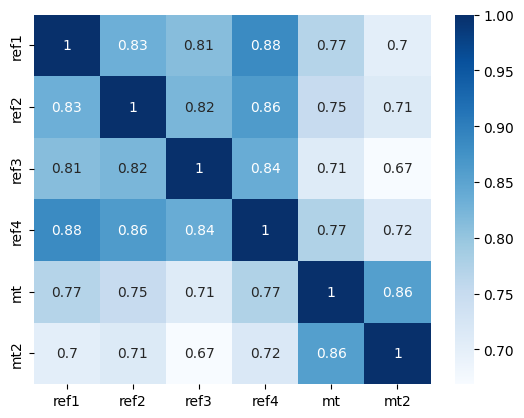

SL_325
src
6084.052939199673
5462.138856697426
ref1
726.5713919575786
527.7321385240573
ref2
832.1898099809276
605.4416315609767
ref3
887.6448534194438
645.271612060983
ref4
683.5837979170434
510.28482334094224
mt
936.0956751672378
663.787219982315
mt2
1056.8334104175387
723.6693371068855
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.848055     0.826896     0.895741   0.800405   
ref2_SL_325     0.848055     1.000000     0.834144     0.873773   0.780606   
ref3_SL_325     0.826896     0.834144     1.000000     0.850662   0.734966   
ref4_SL_325     0.895741     0.873773     0.850662     1.000000   0.803242   
mt_SL_325       0.800405     0.780606     0.734966     0.803242   1.000000   
mt2_SL_325      0.727157     0.734375     0.686451     0.738654   0.861535   

             mt2_SL_325  
ref1_SL_325    0.727157  
ref2_SL_325    0.734375  
ref3_SL_325    0.686451  
ref4_SL_325    0.738654  
mt_SL_325      0.861535  
mt2_SL_

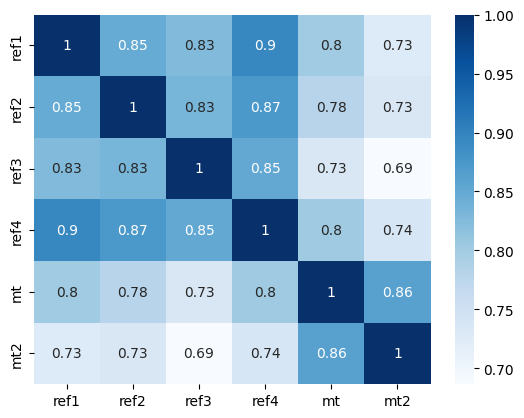

SL_350
src
13326.018221127724
11692.845168165546
ref1
1420.3716455213919
944.0628210257128
ref2
1632.30501760805
1095.3195913772715
ref3
1745.3242697391838
1167.0513592299721
ref4
1329.2077407617169
931.4389571904869
mt
1829.7812238986971
1205.2198597141
mt2
2124.969509764815
1330.9609070370548
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.863682     0.839470     0.906199   0.829395   
ref2_SL_350     0.863682     1.000000     0.845146     0.885536   0.809214   
ref3_SL_350     0.839470     0.845146     1.000000     0.862052   0.756397   
ref4_SL_350     0.906199     0.885536     0.862052     1.000000   0.828883   
mt_SL_350       0.829395     0.809214     0.756397     0.828883   1.000000   
mt2_SL_350      0.751055     0.754524     0.703273     0.757163   0.869593   

             mt2_SL_350  
ref1_SL_350    0.751055  
ref2_SL_350    0.754524  
ref3_SL_350    0.703273  
ref4_SL_350    0.757163  
mt_SL_350      0.869593  
m

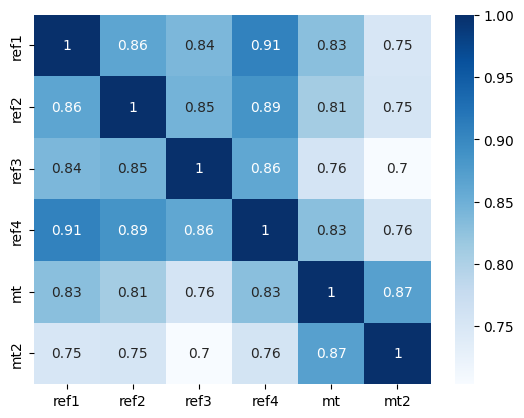

SL_375
src
29547.541988410783
25794.64486383465
ref1
2839.6110621987177
1700.4883462856208
ref2
3268.855438351682
1989.2616156919134
ref3
3502.843418648797
2143.3684561180107
ref4
2640.6234033766646
1663.4912792043826
mt
3643.566331213972
2212.9969966482827
mt2
4364.166728833037
2436.3536946149543
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.878328     0.849472     0.914879   0.853638   
ref2_SL_375     0.878328     1.000000     0.854532     0.896702   0.833711   
ref3_SL_375     0.849472     0.854532     1.000000     0.871353   0.773501   
ref4_SL_375     0.914879     0.896702     0.871353     1.000000   0.849411   
mt_SL_375       0.853638     0.833711     0.773501     0.849411   1.000000   
mt2_SL_375      0.772235     0.772316     0.717672     0.772612   0.879547   

             mt2_SL_375  
ref1_SL_375    0.772235  
ref2_SL_375    0.772316  
ref3_SL_375    0.717672  
ref4_SL_375    0.772612  
mt_SL_375      0.879547 

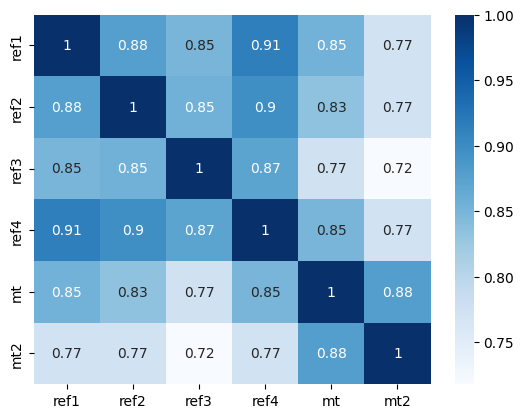

SL_400
src
66263.42583599311
56824.85462524026
ref1
5806.371818774456
3078.440839204014
ref2
6683.82901999413
3659.310994256596
ref3
7177.025378119185
3926.99482353956
ref4
5359.974568887011
3020.6379662483505
mt
7393.410160575161
4103.08848605793
mt2
9153.685688413216
4448.080406258003
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.891410     0.856848     0.921829   0.872370   
ref2_SL_400     0.891410     1.000000     0.861924     0.906683   0.852994   
ref3_SL_400     0.856848     0.861924     1.000000     0.878399   0.785329   
ref4_SL_400     0.921829     0.906683     0.878399     1.000000   0.864213   
mt_SL_400       0.872370     0.852994     0.785329     0.864213   1.000000   
mt2_SL_400      0.790201     0.787276     0.728841     0.784812   0.890249   

             mt2_SL_400  
ref1_SL_400    0.790201  
ref2_SL_400    0.787276  
ref3_SL_400    0.728841  
ref4_SL_400    0.784812  
mt_SL_400      0.890249  
mt2_SL_40

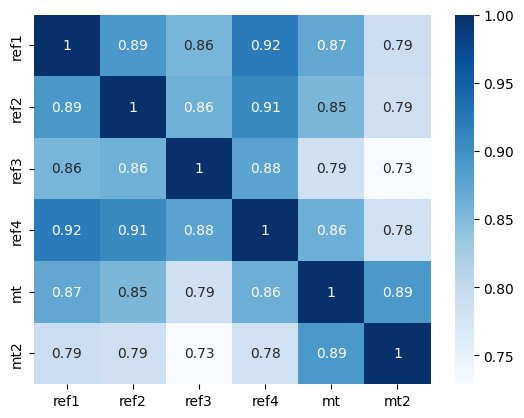

SL_425
src
150170.28195142408
126458.59758375768
ref1
12139.885450754455
5550.671210063272
ref2
13949.777631526827
6680.244387956666
ref3
15010.256718021512
7316.774846883032
ref4
11113.305357305053
5388.861982729865
mt
15290.441392824605
7616.696386674828
mt2
19599.421568361806
8170.467960495622
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.902763     0.861816     0.927276   0.885843   
ref2_SL_425     0.902763     1.000000     0.867249     0.915251   0.867060   
ref3_SL_425     0.861816     0.867249     1.000000     0.883280   0.791891   
ref4_SL_425     0.927276     0.915251     0.883280     1.000000   0.873647   
mt_SL_425       0.885843     0.867060     0.791891     0.873647   1.000000   
mt2_SL_425      0.804979     0.799384     0.736548     0.793951   0.900917   

             mt2_SL_425  
ref1_SL_425    0.804979  
ref2_SL_425    0.799384  
ref3_SL_425    0.736548  
ref4_SL_425    0.793951  
mt_SL_425      0.900917  

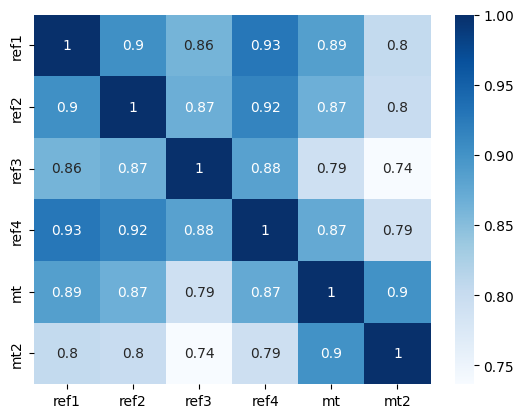

SL_450
src
343632.9097266221
283095.18838540884
ref1
25933.309435552383
10300.058530124075
ref2
29698.727202219372
12350.943850844858
ref3
32028.481014353267
13574.17375881438
ref4
23521.127183131262
10035.055617541477
mt
32226.276293457657
14173.19121689544
mt2
42805.768239644545
15285.887356321375
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.912458     0.864683     0.931488   0.894812   
ref2_SL_450     0.912458     1.000000     0.870607     0.922398   0.876508   
ref3_SL_450     0.864683     0.870607     1.000000     0.886206   0.793729   
ref4_SL_450     0.931488     0.922398     0.886206     1.000000   0.878536   
mt_SL_450       0.894812     0.876508     0.793729     0.878536   1.000000   
mt2_SL_450      0.816841     0.808843     0.740889     0.800371   0.911099   

             mt2_SL_450  
ref1_SL_450    0.816841  
ref2_SL_450    0.808843  
ref3_SL_450    0.740889  
ref4_SL_450    0.800371  
mt_SL_450      0.91109

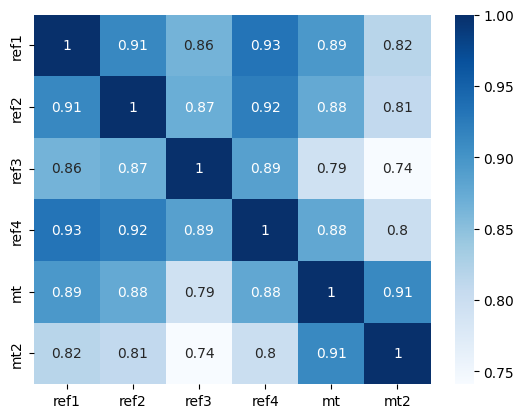

SL_475
src
793365.4482151263
640119.8046014623
ref1
56533.58284102628
18859.248660390615
ref2
64431.14601957379
22939.296034203126
ref3
69664.80419074289
25546.795971324962
ref4
50762.970854893814
18206.017520679474
mt
69189.97041265745
26630.734836451207
mt2
95256.43615409735
28914.359714894083
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.920672     0.865752     0.934711   0.900165   
ref2_SL_475     0.920672     1.000000     0.872168     0.928232   0.882149   
ref3_SL_475     0.865752     0.872168     1.000000     0.887412   0.791578   
ref4_SL_475     0.934711     0.928232     0.887412     1.000000   0.879809   
mt_SL_475       0.900165     0.882149     0.791578     0.879809   1.000000   
mt2_SL_475      0.826134     0.815940     0.742116     0.804438   0.920575   

             mt2_SL_475  
ref1_SL_475    0.826134  
ref2_SL_475    0.815940  
ref3_SL_475    0.742116  
ref4_SL_475    0.804438  
mt_SL_475      0.920575  


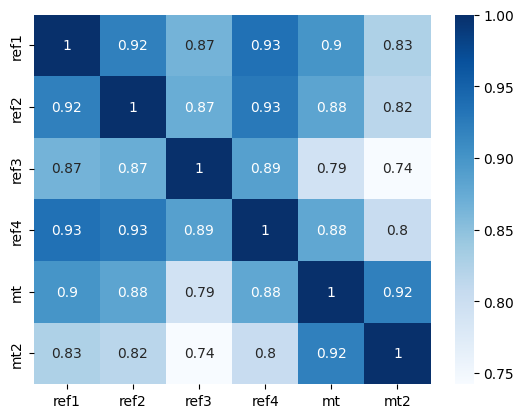

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
125564.69908501458
34745.13777620929
ref2
142254.55598958713
42766.07553831353
ref3
154276.4778594271
48130.931969960315
ref4
111558.56941177654
33205.18139378287
mt
151220.95531025968
49624.18007304595
mt2
215689.31639846557
54944.04839418787
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.927614     0.865286     0.937147   0.902720   
ref2_SL_500     0.927614     1.000000     0.872119     0.932905   0.884779   
ref3_SL_500     0.865286     0.872119     1.000000     0.887117   0.786162   
ref4_SL_500     0.937147     0.932905     0.887117     1.000000   0.878308   
mt_SL_500       0.902720     0.884779     0.786162     0.878308   1.000000   
mt2_SL_500      0.833202     0.820972     0.740534     0.806490   0.929262   

             mt2_SL_500  
ref1_SL_500    0.833202  
ref2_SL_500    0.820972  
ref3_SL_500    0.740534  
ref4_SL_500    0.806490  
mt_SL_500      0.929262  

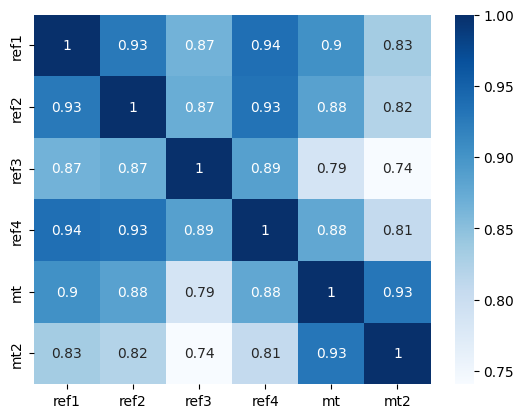

SL_525
src
4331606.646061756
3141367.4417431457
ref1
283619.53386526916
64962.62094769889
ref2
319136.8896455322
79680.38580718759
ref3
347347.8728650015
90440.83091327922
ref4
249236.9404730782
61137.45884061979
mt
336112.85042976635
92899.96664631687
mt2
496179.75284028973
104178.3330094569
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.933485     0.863491     0.938953   0.903153   
ref2_SL_525     0.933485     1.000000     0.870636     0.936576   0.885079   
ref3_SL_525     0.863491     0.870636     1.000000     0.885510   0.778113   
ref4_SL_525     0.938953     0.936576     0.885510     1.000000   0.874725   
mt_SL_525       0.903153     0.885079     0.778113     0.874725   1.000000   
mt2_SL_525      0.838358     0.824213     0.736455     0.806825   0.937152   

             mt2_SL_525  
ref1_SL_525    0.838358  
ref2_SL_525    0.824213  
ref3_SL_525    0.736455  
ref4_SL_525    0.806825  
mt_SL_525      0.937152  
mt2

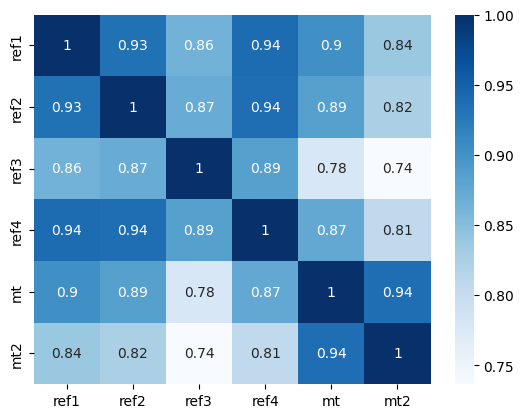

SL_550
src
10231354.187866237
7329958.645473514
ref1
650209.684658188
121690.3850755698
ref2
726278.5502803507
150019.63165143516
ref3
793795.5187023153
168442.88189497308
ref4
565071.3149724395
110861.20375978225
mt
758805.9663462823
172866.89080899657
mt2
1157773.3414949207
195976.75542624953
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.938466     0.860533     0.940250   0.901989   
ref2_SL_550     0.938466     1.000000     0.867873     0.939391   0.883597   
ref3_SL_550     0.860533     0.867873     1.000000     0.882745   0.767947   
ref4_SL_550     0.940250     0.939391     0.882745     1.000000   0.869596   
mt_SL_550       0.901989     0.883597     0.767947     0.869596   1.000000   
mt2_SL_550      0.841870     0.825909     0.730172     0.805695   0.944271   

             mt2_SL_550  
ref1_SL_550    0.841870  
ref2_SL_550    0.825909  
ref3_SL_550    0.730172  
ref4_SL_550    0.805695  
mt_SL_550      0.944271  
m

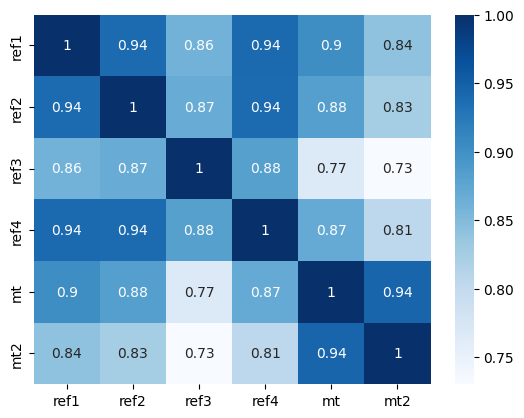

SL_575
src
24325330.39833967
16966711.067660846
ref1
1509943.1383430706
227900.62957564555
ref2
1673817.6997308256
276494.3662477657
ref3
1838256.6479088522
318771.9773884404
ref4
1297749.2651885513
207619.01636472408
mt
1737596.8274020175
322048.5434343149
mt2
2735777.6060166247
365824.4148136568
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.942707     0.856536     0.941128   0.899627   
ref2_SL_575     0.942707     1.000000     0.863961     0.941477   0.880754   
ref3_SL_575     0.856536     0.863961     1.000000     0.878944   0.756071   
ref4_SL_575     0.941128     0.941477     0.878944     1.000000   0.863326   
mt_SL_575       0.899627     0.880754     0.756071     0.863326   1.000000   
mt2_SL_575      0.843971     0.826277     0.721954     0.803319   0.950664   

             mt2_SL_575  
ref1_SL_575    0.843971  
ref2_SL_575    0.826277  
ref3_SL_575    0.721954  
ref4_SL_575    0.803319  
mt_SL_575      0.950664 

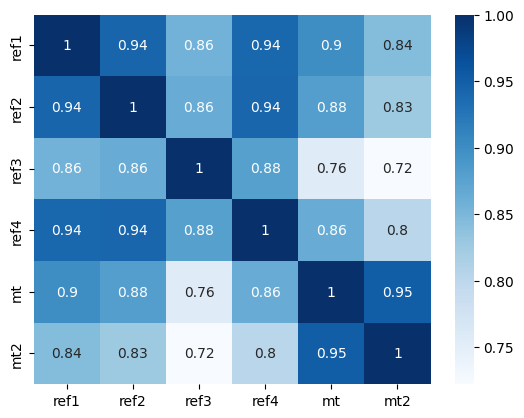

SL_600
src
58189712.87790054
39214596.580572255
ref1
3545202.2978523406
419393.07193359436
ref2
3900123.0970099787
520574.161150563
ref3
4306686.060376352
601070.0809834583
ref4
3013812.8757743393
390758.3427835226
mt
4030016.404159651
603106.4008891226
mt2
6536409.041859104
684032.4349933038
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.946337     0.851596     0.941656   0.896362   
ref2_SL_600     0.946337     1.000000     0.859006     0.942942   0.876874   
ref3_SL_600     0.851596     0.859006     1.000000     0.874204   0.742806   
ref4_SL_600     0.941656     0.942942     0.874204     1.000000   0.856215   
mt_SL_600       0.896362     0.876874     0.742806     0.856215   1.000000   
mt2_SL_600      0.844864     0.825505     0.712043     0.799886   0.956383   

             mt2_SL_600  
ref1_SL_600    0.844864  
ref2_SL_600    0.825505  
ref3_SL_600    0.712043  
ref4_SL_600    0.799886  
mt_SL_600      0.956383  
mt2

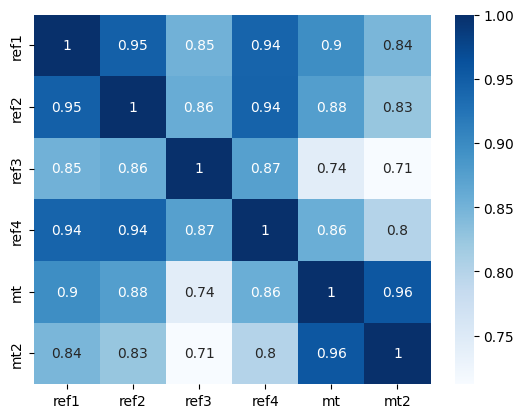

SL_625
src
140004729.32922277
89386250.1037006
ref1
8401340.244275223
796918.8717755136
ref2
9173781.286962057
968370.5839846246
ref3
10191689.714012146
1138659.3082965869
ref4
7066015.809189454
736216.8229683058
mt
9452999.255751906
1132058.9157018599
mt2
15768027.073073475
1284847.1172909453
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.949460     0.845787     0.941887   0.892415   
ref2_SL_625     0.949460     1.000000     0.853097     0.943877   0.872198   
ref3_SL_625     0.845787     0.853097     1.000000     0.868603   0.728404   
ref4_SL_625     0.941887     0.943877     0.868603     1.000000   0.848487   
mt_SL_625       0.892415     0.872198     0.728404     0.848487   1.000000   
mt2_SL_625      0.844721     0.823759     0.700661     0.795559   0.961481   

             mt2_SL_625  
ref1_SL_625    0.844721  
ref2_SL_625    0.823759  
ref3_SL_625    0.700661  
ref4_SL_625    0.795559  
mt_SL_625      0.961481  
mt

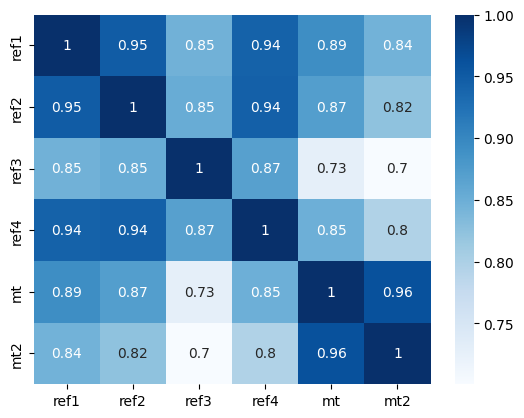

SL_650
src
338703171.3009422
210335993.3140239
ref1
20064227.583343662
1506212.6840432528
ref2
21752864.762310695
1825099.5171395903
ref3
24327661.729893588
2166432.712666675
ref4
16700548.122695459
1370492.8068147989
mt
22393779.7728759
2146612.7889328618
mt2
38356185.386257485
2448275.124867836
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.952161     0.839169     0.941862   0.887950   
ref2_SL_650     0.952161     1.000000     0.846308     0.944357   0.866915   
ref3_SL_650     0.839169     0.846308     1.000000     0.862203   0.713068   
ref4_SL_650     0.941862     0.944357     0.862203     1.000000   0.840311   
mt_SL_650       0.887950     0.866915     0.713068     0.840311   1.000000   
mt2_SL_650      0.843695     0.821186     0.688006     0.790483   0.966012   

             mt2_SL_650  
ref1_SL_650    0.843695  
ref2_SL_650    0.821186  
ref3_SL_650    0.688006  
ref4_SL_650    0.790483  
mt_SL_650      0.966012  

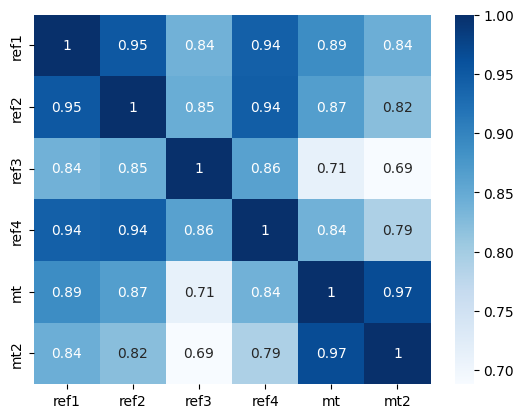

SL_675
src
823697155.0790491
502847016.137499
ref1
48227140.12557516
2820729.9441843648
ref2
51933891.24273756
3490843.595364162
ref3
58500501.656016335
4123784.622627706
ref4
39739901.82788718
2566290.6612166744
mt
53507283.84893059
4061391.204966115
mt2
93976609.94581798
4609799.792427638
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.954510     0.831787     0.941612   0.883092   
ref2_SL_675     0.954510     1.000000     0.838700     0.944441   0.861165   
ref3_SL_675     0.831787     0.838700     1.000000     0.855055   0.696959   
ref4_SL_675     0.941612     0.944441     0.855055     1.000000   0.831814   
mt_SL_675       0.883092     0.861165     0.696959     0.831814   1.000000   
mt2_SL_675      0.841920     0.817914     0.674255     0.784785   0.970028   

             mt2_SL_675  
ref1_SL_675    0.841920  
ref2_SL_675    0.817914  
ref3_SL_675    0.674255  
ref4_SL_675    0.784785  
mt_SL_675      0.970028  
mt2_S

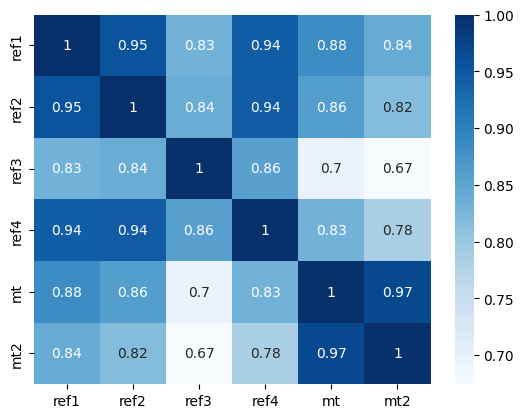

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
116539008.173069
5379260.216182532
ref2
124706932.15788797
6590117.323945469
ref3
141562674.91428545
7860167.046673539
ref4
95100358.58484036
4823922.8840719005
mt
128799048.56258518
7733539.104759373
mt2
231687326.9675747
8752206.17399044
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.956563     0.823682     0.941162   0.877936   
ref2_SL_700     0.956563     1.000000     0.830326     0.944180   0.855059   
ref3_SL_700     0.823682     0.830326     1.000000     0.847199   0.680215   
ref4_SL_700     0.941162     0.944180     0.847199     1.000000   0.823095   
mt_SL_700       0.877936     0.855059     0.680215     0.823095   1.000000   
mt2_SL_700      0.839513     0.814059     0.659573     0.778579   0.973579   

             mt2_SL_700  
ref1_SL_700    0.839513  
ref2_SL_700    0.814059  
ref3_SL_700    0.659573  
ref4_SL_700    0.778579  
mt_SL_700      0.973579  
mt2

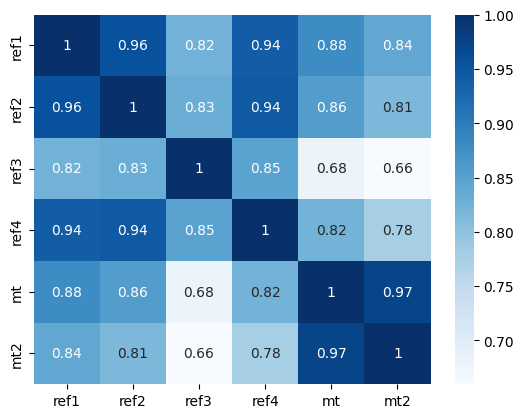

SL_725
src
4944587689.869408
2766777160.633936
ref1
282850368.6207101
10044626.334287636
ref2
300913455.2072798
12640072.750449868
ref3
344398588.4638749
15002103.314175561
ref4
228659278.13003802
9156996.006677674
mt
312012289.90025884
14781835.089769937
mt2
574269873.4550728
16478638.811434017
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.958369     0.814888     0.940533   0.872556   
ref2_SL_725     0.958369     1.000000     0.821230     0.943617   0.848686   
ref3_SL_725     0.814888     0.821230     1.000000     0.838672   0.662950   
ref4_SL_725     0.940533     0.943617     0.838672     1.000000   0.814231   
mt_SL_725       0.872556     0.848686     0.662950     0.814231   1.000000   
mt2_SL_725      0.836577     0.809721     0.644104     0.771965   0.976711   

             mt2_SL_725  
ref1_SL_725    0.836577  
ref2_SL_725    0.809721  
ref3_SL_725    0.644104  
ref4_SL_725    0.771965  
mt_SL_725      0.976711  


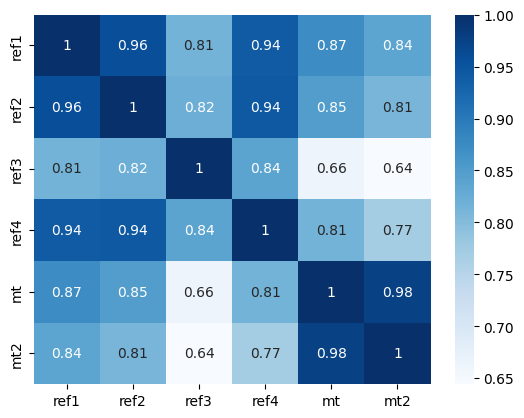

SL_750
src
12201196322.126482
6533701117.122557
ref1
688989438.6455101
18571855.110070873
ref2
729072411.5444827
24088032.215742916
ref3
841693508.9138492
28674332.365985036
ref4
551955871.0769902
17169430.6337742
mt
759965209.4446714
28228675.681360155
mt2
1430044052.4989495
31148228.82948593
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.959965     0.805435     0.939740   0.867012   
ref2_SL_750     0.959965     1.000000     0.811453     0.942784   0.842116   
ref3_SL_750     0.805435     0.811453     1.000000     0.829505   0.645265   
ref4_SL_750     0.939740     0.942784     0.829505     1.000000   0.805283   
mt_SL_750       0.867012     0.842116     0.645265     0.805283   1.000000   
mt2_SL_750      0.833203     0.804990     0.627982     0.765032   0.979470   

             mt2_SL_750  
ref1_SL_750    0.833203  
ref2_SL_750    0.804990  
ref3_SL_750    0.627982  
ref4_SL_750    0.765032  
mt_SL_750      0.979470  
mt

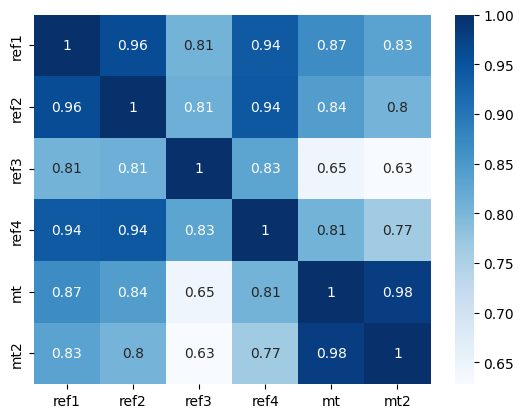

SL_775
src
30245243673.27781
15503724864.782127
ref1
1683307442.7719529
34949496.45786087
ref2
1772548533.788981
45427602.06141543
ref3
2065091464.5956218
55416900.01757819
ref4
1336729861.393423
32591805.991732217
mt
1859678731.202036
53434567.190030396
mt2
3575520690.1464133
58922374.06505738
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.961384     0.795354     0.938797   0.861350   
ref2_SL_775     0.961384     1.000000     0.801032     0.941711   0.835404   
ref3_SL_775     0.795354     0.801032     1.000000     0.819730   0.627247   
ref4_SL_775     0.938797     0.941711     0.819730     1.000000   0.796303   
mt_SL_775       0.861350     0.835404     0.627247     0.796303   1.000000   
mt2_SL_775      0.829470     0.799942     0.611327     0.757857   0.981896   

             mt2_SL_775  
ref1_SL_775    0.829470  
ref2_SL_775    0.799942  
ref3_SL_775    0.611327  
ref4_SL_775    0.757857  
mt_SL_775      0.981896  
m

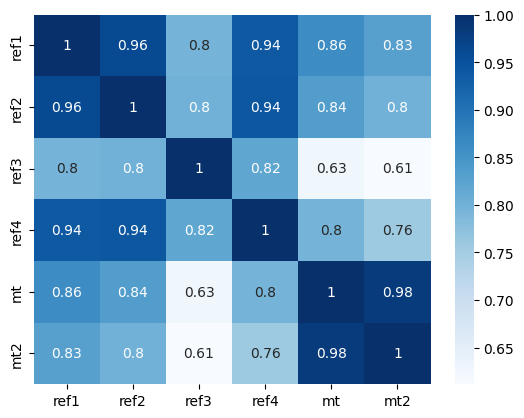

SL_800
src
75308449146.75627
37154119080.28433
ref1
4122725704.202255
65380589.07850064
ref2
4322058310.47332
85557899.5061993
ref3
5083685351.289851
104402795.06886005
ref4
3246166058.6112375
62608550.754631765
mt
4568927515.456073
100704148.3324143
mt2
8971482977.186079
112009698.90573367
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.962652     0.784671     0.937714   0.855610   
ref2_SL_800     0.962652     1.000000     0.790003     0.940421   0.828598   
ref3_SL_800     0.784671     0.790003     1.000000     0.809373   0.608976   
ref4_SL_800     0.937714     0.940421     0.809373     1.000000   0.787331   
mt_SL_800       0.855610     0.828598     0.608976     0.787331   1.000000   
mt2_SL_800      0.825448     0.794646     0.594248     0.750508   0.984027   

             mt2_SL_800  
ref1_SL_800    0.825448  
ref2_SL_800    0.794646  
ref3_SL_800    0.594248  
ref4_SL_800    0.750508  
mt_SL_800      0.984027  
mt2_S

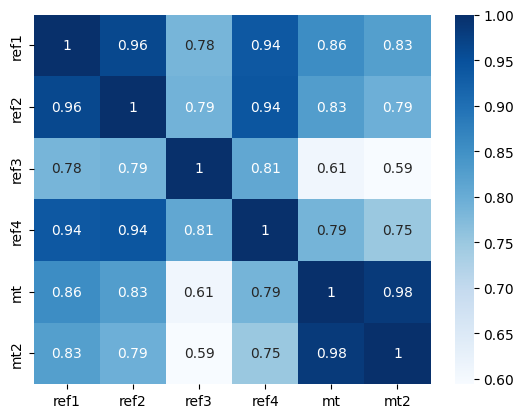

SL_825
src
188328461125.37543
88759479197.95065
ref1
10117946354.148815
121012106.1222858
ref2
10564622358.20676
162457788.15195978
ref3
12550901321.236456
196960956.9976665
ref4
7901163065.318843
120348843.90066184
mt
11263610638.523373
191203806.90588462
mt2
22580738299.560047
215377879.71173677
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.963791     0.773416     0.936501   0.849823   
ref2_SL_825     0.963791     1.000000     0.778398     0.938935   0.821737   
ref3_SL_825     0.773416     0.778398     1.000000     0.798462   0.590523   
ref4_SL_825     0.936501     0.938935     0.798462     1.000000   0.778402   
mt_SL_825       0.849823     0.821737     0.590523     0.778402   1.000000   
mt2_SL_825      0.821196     0.789162     0.576845     0.743046   0.985897   

             mt2_SL_825  
ref1_SL_825    0.821196  
ref2_SL_825    0.789162  
ref3_SL_825    0.576845  
ref4_SL_825    0.743046  
mt_SL_825      0.985897 

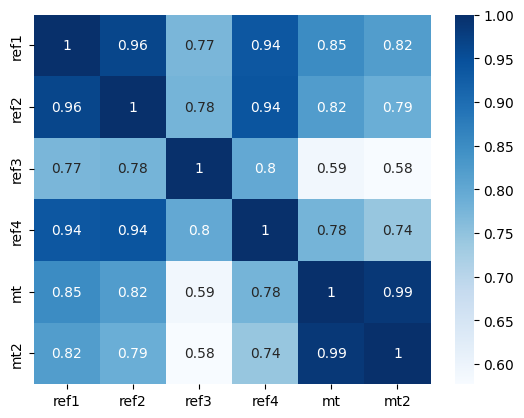

SL_850
src
472965874424.6596
209696852072.8994
ref1
24873581597.23501
233962514.27455378
ref2
25877778994.17342
308064692.5253479
ref3
31064597678.908062
374442084.79884183
ref4
19268345695.04039
228892919.84037405
mt
27849791525.007023
355599352.1735269
mt2
56990767694.053764
414535644.6255045
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.964819     0.761616     0.935166   0.844016   
ref2_SL_850     0.964819     1.000000     0.766252     0.937268   0.814852   
ref3_SL_850     0.761616     0.766252     1.000000     0.787025   0.571955   
ref4_SL_850     0.935166     0.937268     0.787025     1.000000   0.769545   
mt_SL_850       0.844016     0.814852     0.571955     0.769545   1.000000   
mt2_SL_850      0.816766     0.783539     0.559206     0.735521   0.987538   

             mt2_SL_850  
ref1_SL_850    0.816766  
ref2_SL_850    0.783539  
ref3_SL_850    0.559206  
ref4_SL_850    0.735521  
mt_SL_850      0.987538  
m

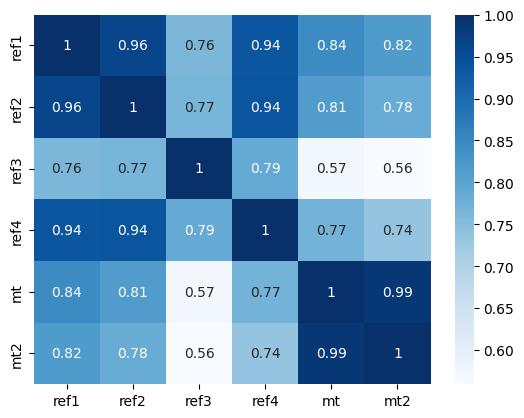

SL_875
src
1192729481778.0728
501307929419.6415
ref1
61235224278.01963
444415897.6171986
ref2
63500319772.1241
578966662.2606324
ref3
77058016557.85805
720820836.2390931
ref4
47065138139.108574
439183097.478375
mt
69035833397.8175
661691000.9316341
mt2
144188789872.59622
804615395.7905784
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.965753     0.749303     0.933714   0.838210   
ref2_SL_875     0.965753     1.000000     0.753596     0.935435   0.807970   
ref3_SL_875     0.749303     0.753596     1.000000     0.775090   0.553333   
ref4_SL_875     0.933714     0.935435     0.775090     1.000000   0.760785   
mt_SL_875       0.838210     0.807970     0.553333     0.760785   1.000000   
mt2_SL_875      0.812203     0.777822     0.541415     0.727979   0.988976   

             mt2_SL_875  
ref1_SL_875    0.812203  
ref2_SL_875    0.777822  
ref3_SL_875    0.541415  
ref4_SL_875    0.727979  
mt_SL_875      0.988976  
mt2_SL_

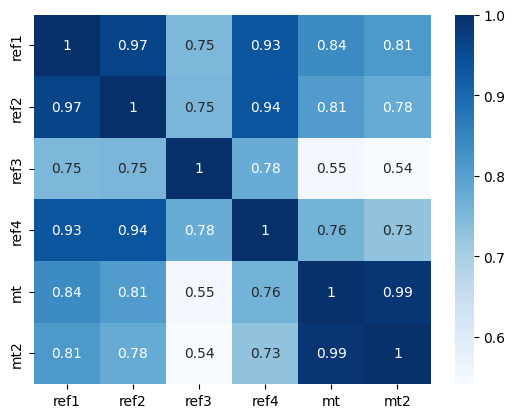

SL_900
src
3020011763176.6636
1193341285325.353
ref1
150932582934.9127
843924249.2058915
ref2
156059297517.8274
1098130369.8866253
ref3
191523425940.61844
1382987238.4642525
ref4
115119142398.43483
854819074.1968008
mt
171510649531.33112
1238557559.3042576
mt2
365601233605.38654
1563420634.9457011
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.966604     0.736506     0.932152   0.832424   
ref2_SL_900     0.966604     1.000000     0.740466     0.933448   0.801114   
ref3_SL_900     0.736506     0.740466     1.000000     0.762686   0.534713   
ref4_SL_900     0.932152     0.933448     0.762686     1.000000   0.752141   
mt_SL_900       0.832424     0.801114     0.534713     0.752141   1.000000   
mt2_SL_900      0.807546     0.772047     0.523544     0.720458   0.990237   

             mt2_SL_900  
ref1_SL_900    0.807546  
ref2_SL_900    0.772047  
ref3_SL_900    0.523544  
ref4_SL_900    0.720458  
mt_SL_900      0.990237 

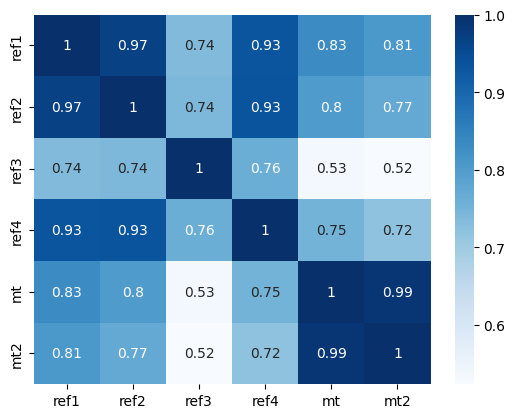

SL_925
src
7676878874728.81
2825871516031.6035
ref1
372394610314.68445
1594139387.1635625
ref2
384039478612.72266
2099319469.367939
ref3
476857280361.49335
2646209813.7663755
ref4
281903198908.1948
1647120203.3183362
mt
426924206642.5594
2333114233.9578776
mt2
928834525217.4852
3040850904.333089
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.967386     0.723258     0.930483   0.826673   
ref2_SL_925     0.967386     1.000000     0.726895     0.931317   0.794303   
ref3_SL_925     0.723258     0.726895     1.000000     0.749844   0.516148   
ref4_SL_925     0.930483     0.931317     0.749844     1.000000   0.743632   
mt_SL_925       0.826673     0.794303     0.516148     0.743632   1.000000   
mt2_SL_925      0.802826     0.766246     0.505660     0.712989   0.991343   

             mt2_SL_925  
ref1_SL_925    0.802826  
ref2_SL_925    0.766246  
ref3_SL_925    0.505660  
ref4_SL_925    0.712989  
mt_SL_925      0.991343  


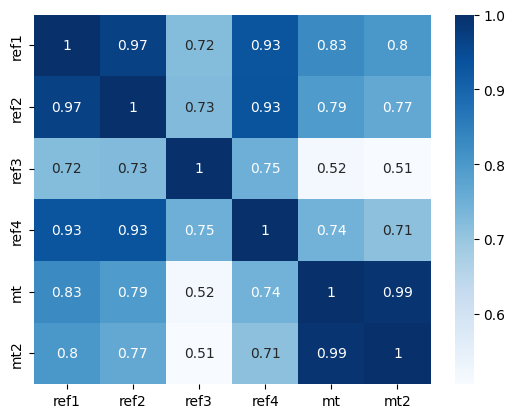

SL_950
src
19589480415784.91
6695745864435.366
ref1
919596356516.361
3041455621.3067303
ref2
946144947389.442
3984380916.370597
ref3
1189170242007.3298
5083783647.70694
ref4
691008369560.5026
3080257343.052862
mt
1064517097258.659
4397671006.582131
mt2
2363974763244.173
5919963162.507609
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.968106     0.709594     0.928712   0.820970   
ref2_SL_950     0.968106     1.000000     0.712918     0.929050   0.787551   
ref3_SL_950     0.709594     0.712918     1.000000     0.736594   0.497688   
ref4_SL_950     0.928712     0.929050     0.736594     1.000000   0.735271   
mt_SL_950       0.820970     0.787551     0.497688     0.735271   1.000000   
mt2_SL_950      0.798070     0.760446     0.487826     0.705601   0.992313   

             mt2_SL_950  
ref1_SL_950    0.798070  
ref2_SL_950    0.760446  
ref3_SL_950    0.487826  
ref4_SL_950    0.705601  
mt_SL_950      0.992313  
mt2_SL_9

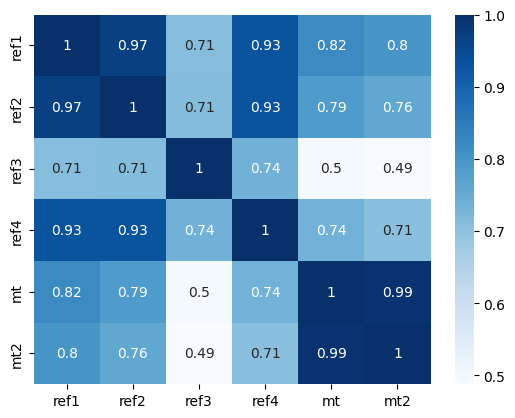

SL_975
src
50173418288827.71
15873783084476.455
ref1
2272538721478.2954
5787936843.531358
ref2
2333301386976.09
7564693904.628111
ref3
2969810042903.813
9768835303.032368
ref4
1695261946994.2634
5755423055.633503
mt
2658349317273.822
8304547187.8504715
mt2
6026314422160.091
11470085293.487595
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.968773     0.695547     0.926842   0.815325   
ref2_SL_975     0.968773     1.000000     0.698573     0.926656   0.780872   
ref3_SL_975     0.695547     0.698573     1.000000     0.722971   0.479377   
ref4_SL_975     0.926842     0.926656     0.722971     1.000000   0.727072   
mt_SL_975       0.815325     0.780872     0.479377     0.727072   1.000000   
mt2_SL_975      0.793303     0.754666     0.470095     0.698316   0.993166   

             mt2_SL_975  
ref1_SL_975    0.793303  
ref2_SL_975    0.754666  
ref3_SL_975    0.470095  
ref4_SL_975    0.698316  
mt_SL_975      0.993166  
mt2

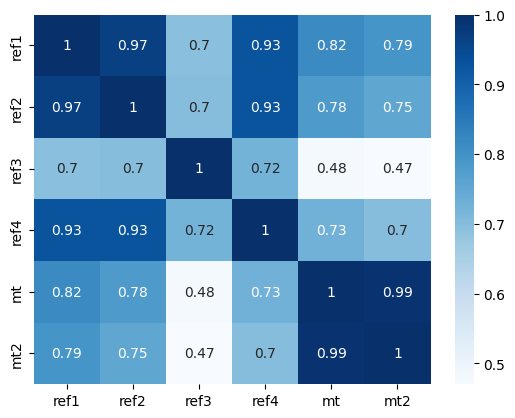

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.4304576515559778
0.4342342503162759
ref2
0.4276369412045839
0.43082509318320394
ref3
0.42291374547817956
0.42516639914832854
ref4
0.4411699686377683
0.4446293674719158
mt
0.4187818722372393
0.420658747376075
mt2
0.42955883039059367
0.4321004228334282
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.749803   0.760429   0.808945  0.733819  0.688516
ref2_gini   0.749803   1.000000   0.782442   0.739216  0.719502  0.755536
ref3_gini   0.760429   0.782442   1.000000   0.723957  0.707586  0.650338
ref4_gini   0.808945   0.739216   0.723957   1.000000  0.717505  0.696837
mt_gini     0.733819   0.719502   0.707586   0.717505  1.000000  0.836344
mt2_gini    0.688516   0.755536   0.650338   0.696837  0.836344  1.000000


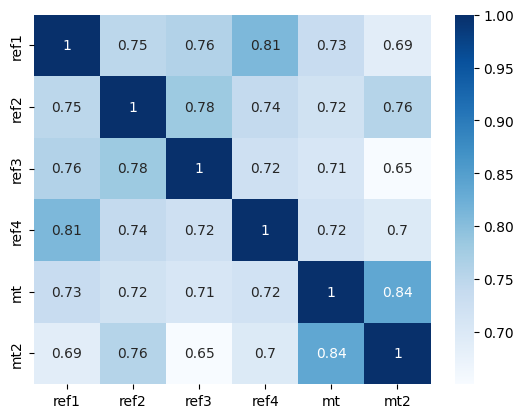

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.318673747504593
-4.405933359277764
ref2
-4.286164666049224
-4.359902596811946
ref3
-4.270715267543558
-4.340479573801979
ref4
-4.328797855015526
-4.402508430700289
mt
-4.262291424297914
-4.320235216440981
mt2
-4.274385735291829
-4.345306919808216
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.972181  0.962045  0.970424  0.942957  0.935800
ref2_kl  0.972181  1.000000  0.974910  0.977912  0.955242  0.949138
ref3_kl  0.962045  0.974910  1.000000  0.965289  0.946533  0.938174
ref4_kl  0.970424  0.977912  0.965289  1.000000  0.949491  0.941494
mt_kl    0.942957  0.955242  0.946533  0.949491  1.000000  0.986619
mt2_kl   0.935800  0.949138  0.938174  0.941494  0.986619  1.000000


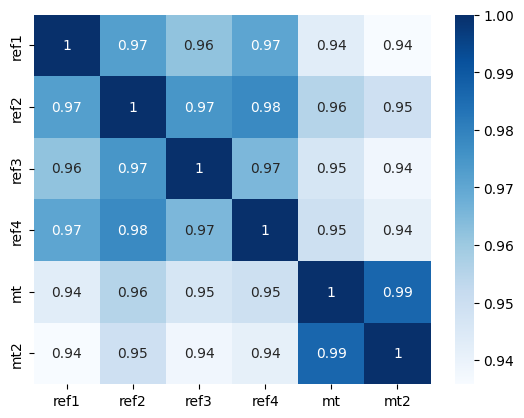

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.8071647498393056
0.8006739534358953
ref2
0.7991071744508954
0.7920285834857874
ref3
0.7892032859358724
0.7765723518077562
ref4
0.8296046052558809
0.8144368054565616
mt
0.7763824034387409
0.7646162845460482
mt2
0.8053471119338138
0.8029192372872653
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.762087  0.757705  0.823467  0.760293  0.708703
ref2_cv  0.762087  1.000000  0.787774  0.769107  0.736461  0.745474
ref3_cv  0.757705  0.787774  1.000000  0.738639  0.712417  0.648764
ref4_cv  0.823467  0.769107  0.738639  1.000000  0.758249  0.737118
mt_cv    0.760293  0.736461  0.712417  0.758249  1.000000  0.814204
mt2_cv   0.708703  0.745474  0.648764  0.737118  0.814204  1.000000


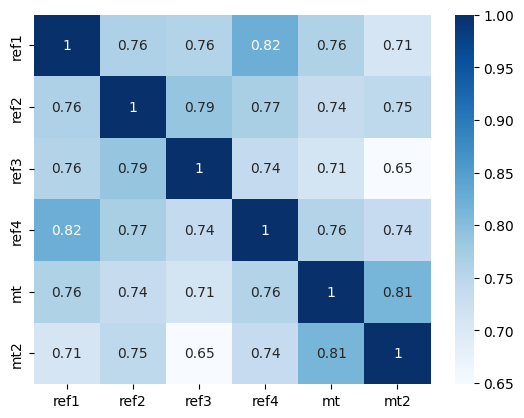

lv
src
72.35425230811832
69.03561950442358
ref1
25.09759289685218
21.518682941979556
ref2
27.88559165204667
23.537067772614243
ref3
27.991711901081445
24.290930204873774
ref4
25.067747440476904
21.243659343102028
mt
28.20092019988337
25.033431310347304
mt2
32.08796263403536
26.990392291082006
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.732185  0.724763  0.802317  0.754059  0.613557
ref2_lv  0.732185  1.000000  0.700431  0.769582  0.744726  0.641320
ref3_lv  0.724763  0.700431  1.000000  0.733328  0.671177  0.544955
ref4_lv  0.802317  0.769582  0.733328  1.000000  0.754854  0.664322
mt_lv    0.754059  0.744726  0.671177  0.754854  1.000000  0.782275
mt2_lv   0.613557  0.641320  0.544955  0.664322  0.782275  1.000000


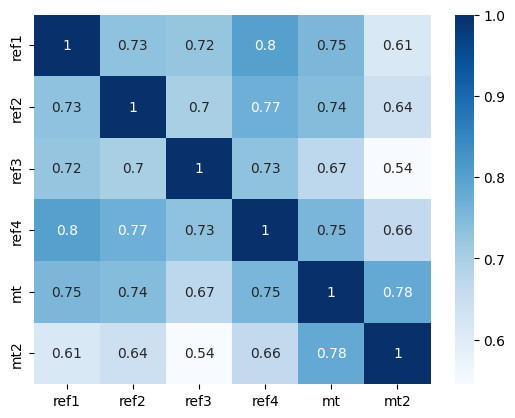

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-362.91550095053697
-326.5755439126374
ref2
-386.97307707880634
-333.77024836971873
ref3
-394.36495733328076
-348.93568762491964
ref4
-359.1944319801544
-315.89227969403476
mt
-400.52962657035476
-365.14051794778936
mt2
-411.194143451049
-368.0949645698354
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.964329    0.953762    0.967411  0.946129   
ref2_renyi    0.964329    1.000000    0.953486    0.962560  0.947625   
ref3_renyi    0.953762    0.953486    1.000000    0.950297  0.935731   
ref4_renyi    0.967411    0.962560    0.950297    1.000000  0.945412   
mt_renyi      0.946129    0.947625    0.935731    0.945412  1.000000   
mt2_renyi     0.942363    0.944528    0.936201    0.940442  0.970651   

            mt2_renyi  
ref1_renyi   0.942363  
ref2_renyi   0.944528  
ref3_renyi   0.936201  
ref4_renyi   0.940442  
mt_renyi     0.970651  
mt2_renyi    1.000000  


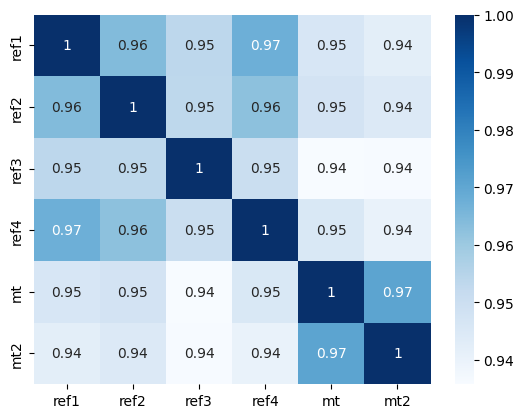

41.78302361451637
13.981929328631317
15.273992725718047
15.711600246947938
13.755059074084581
16.194133627251986


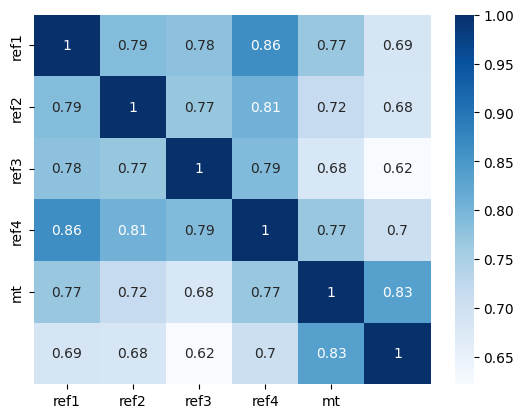

*************************************
13.962903400658627
13.962903400658627
15.278738461857307
15.777235219888764
13.76486606338067
16.35100334218294
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se 

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


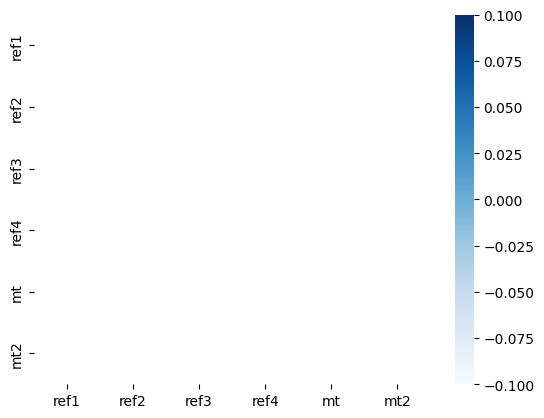

L
src
10.359164788583737
10.123614579255745
ref1
6.546739642942597
6.392054519610346
ref2
6.884748435668313
6.69992751016194
ref3
7.241794707543649
6.961565265302066
ref4
6.344519457634491
6.079987623022447
mt
6.959374224530754
6.735877874455657
mt2
6.973958041170644
6.724049662002454
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.861894  0.778990  0.891999  0.857658  0.803449
ref2_L  0.861894  1.000000  0.754966  0.870956  0.818481  0.807437
ref3_L  0.778990  0.754966  1.000000  0.755903  0.767555  0.765269
ref4_L  0.891999  0.870956  0.755903  1.000000  0.813620  0.780293
mt_L    0.857658  0.818481  0.767555  0.813620  1.000000  0.912729
mt2_L   0.803449  0.807437  0.765269  0.780293  0.912729  1.000000


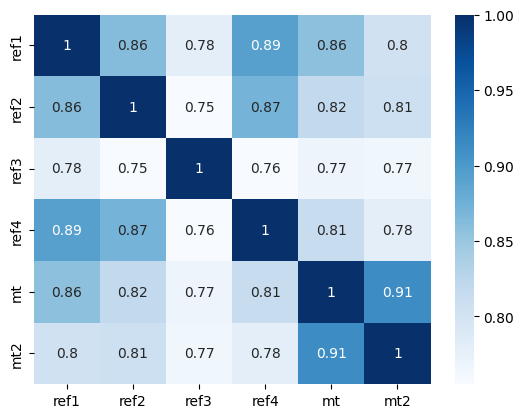

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.4884012949352519
1.4868416111669323
ref2
1.5150473308244397
1.5146551825834966
ref3
1.5346844772509403
1.5254414002710521
ref4
1.4733668735734866
1.4677412530594096
mt
1.517099869392838
1.5137467379741645
mt2
1.5138657895933612
1.5134297284333316
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.801147    0.761718    0.865243  0.823476   
ref2_SL_25    0.801147    1.000000    0.756134    0.818018  0.765689   
ref3_SL_25    0.761718    0.756134    1.000000    0.756906  0.776611   
ref4_SL_25    0.865243    0.818018    0.756906    1.000000  0.797720   
mt_SL_25      0.823476    0.765689    0.776611    0.797720  1.000000   
mt2_SL_25     0.760798    0.751613    0.774977    0.745368  0.880652   

            mt2_SL_25  
ref1_SL_25   0.760798  
ref2_SL_25   0.751613  
ref3_SL_25   0.774977  
ref4_SL_25   0.745368  
mt_SL_25     0.880652  
mt2_SL_25    1.000000  


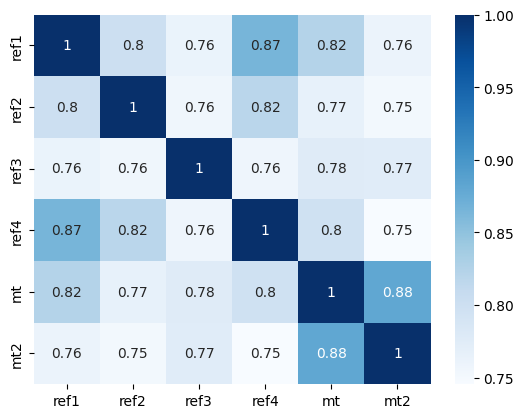

SL_50
src
3.0671973011635125
3.032966843199389
ref1
2.345935125503848
2.3378079517786436
ref2
2.4208405783858056
2.407950820315486
ref3
2.4839481485996378
2.450208035940074
ref4
2.3036927955260427
2.2715966682903623
mt
2.4305263986136523
2.419297941060912
mt2
2.424572168214121
2.4118397829987503
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.832319    0.770571    0.875808  0.836050   
ref2_SL_50    0.832319    1.000000    0.757033    0.844604  0.786239   
ref3_SL_50    0.770571    0.757033    1.000000    0.759951  0.770992   
ref4_SL_50    0.875808    0.844604    0.759951    1.000000  0.800490   
mt_SL_50      0.836050    0.786239    0.770992    0.800490  1.000000   
mt2_SL_50     0.776453    0.777874    0.777613    0.756296  0.894522   

            mt2_SL_50  
ref1_SL_50   0.776453  
ref2_SL_50   0.777874  
ref3_SL_50   0.777613  
ref4_SL_50   0.756296  
mt_SL_50     0.894522  
mt2_SL_50    1.000000  


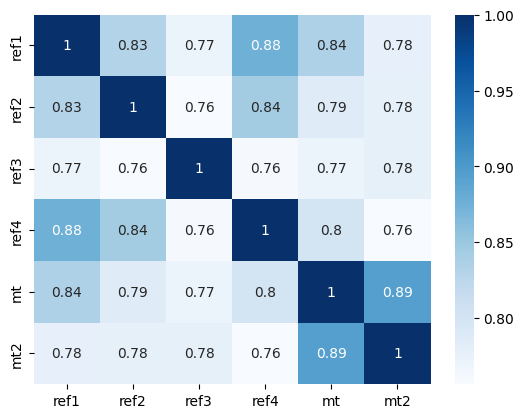

SL_75
src
5.5762344444241885
5.474223342002128
ref1
3.852907276886451
3.8038471819976793
ref2
4.018866274901233
3.9627803047626173
ref3
4.175845080683772
4.078692486086141
ref4
3.757474015802921
3.6452876623569828
mt
4.048079459223321
3.989986692928212
mt2
4.04389148236062
3.9576111566473022
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.850636    0.775288    0.885270  0.847704   
ref2_SL_75    0.850636    1.000000    0.755975    0.860831  0.803409   
ref3_SL_75    0.775288    0.755975    1.000000    0.759175  0.768004   
ref4_SL_75    0.885270    0.860831    0.759175    1.000000  0.806645   
mt_SL_75      0.847704    0.803409    0.768004    0.806645  1.000000   
mt2_SL_75     0.791011    0.794223    0.772518    0.768486  0.905013   

            mt2_SL_75  
ref1_SL_75   0.791011  
ref2_SL_75   0.794223  
ref3_SL_75   0.772518  
ref4_SL_75   0.768486  
mt_SL_75     0.905013  
mt2_SL_75    1.000000  


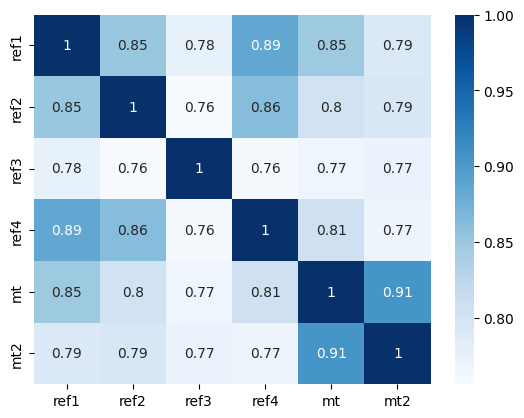

SL_100
src
10.359164788583737
10.123614579255745
ref1
6.546739642942597
6.392054519610346
ref2
6.884748435668313
6.69992751016194
ref3
7.241794707543649
6.961565265302066
ref4
6.344519457634491
6.079987623022447
mt
6.959374224530754
6.735877874455657
mt2
6.973958041170644
6.724049662002454
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.861894     0.778990     0.891999   0.857658   
ref2_SL_100     0.861894     1.000000     0.754966     0.870956   0.818481   
ref3_SL_100     0.778990     0.754966     1.000000     0.755903   0.767555   
ref4_SL_100     0.891999     0.870956     0.755903     1.000000   0.813620   
mt_SL_100       0.857658     0.818481     0.767555     0.813620   1.000000   
mt2_SL_100      0.803449     0.807437     0.765269     0.780293   0.912729   

             mt2_SL_100  
ref1_SL_100    0.803449  
ref2_SL_100    0.807437  
ref3_SL_100    0.765269  
ref4_SL_100    0.780293  
mt_SL_100      0.912729  
mt2_SL

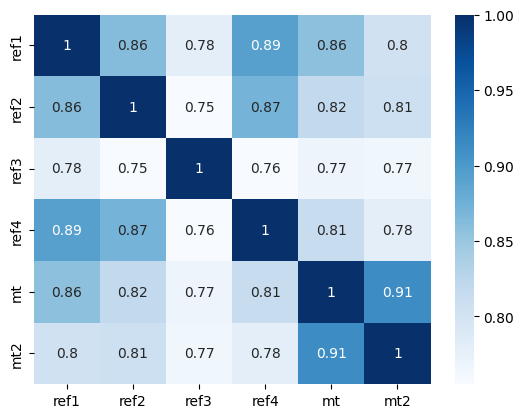

SL_125
src
19.634351008953868
18.984081758810827
ref1
11.466553941768753
10.994206457255256
ref2
12.128186714426457
11.660919278884766
ref3
12.90788799671887
12.249549909734323
ref4
11.04615268081541
10.480513006646625
mt
12.302527839144838
11.68440094321236
mt2
12.38739560369087
11.706990868668786
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.867672     0.782651     0.894986   0.865169   
ref2_SL_125     0.867672     1.000000     0.755129     0.876672   0.831565   
ref3_SL_125     0.782651     0.755129     1.000000     0.750995   0.768494   
ref4_SL_125     0.894986     0.876672     0.750995     1.000000   0.819543   
mt_SL_125       0.865169     0.831565     0.768494     0.819543   1.000000   
mt2_SL_125      0.812408     0.819665     0.757202     0.790921   0.917548   

             mt2_SL_125  
ref1_SL_125    0.812408  
ref2_SL_125    0.819665  
ref3_SL_125    0.757202  
ref4_SL_125    0.790921  
mt_SL_125      0.917548

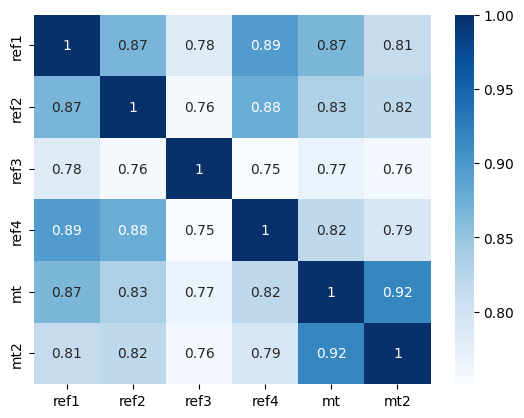

SL_150
src
37.92546190950008
36.245652911575796
ref1
20.657979773538624
19.43768513436318
ref2
21.925519033252037
20.60845601357358
ref3
23.592715777936423
21.8990965386727
ref4
19.78366661465464
18.533900465458437
mt
22.30890221734287
20.877405316485813
mt2
22.60643001749154
20.746971385894273
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.868275     0.786206     0.893613   0.869474   
ref2_SL_150     0.868275     1.000000     0.757080     0.878998   0.842445   
ref3_SL_150     0.786206     0.757080     1.000000     0.745557   0.769830   
ref4_SL_150     0.893613     0.878998     0.745557     1.000000   0.823510   
mt_SL_150       0.869474     0.842445     0.769830     0.823510   1.000000   
mt2_SL_150      0.816855     0.831225     0.748819     0.800117   0.919397   

             mt2_SL_150  
ref1_SL_150    0.816855  
ref2_SL_150    0.831225  
ref3_SL_150    0.748819  
ref4_SL_150    0.800117  
mt_SL_150      0.919397  
m

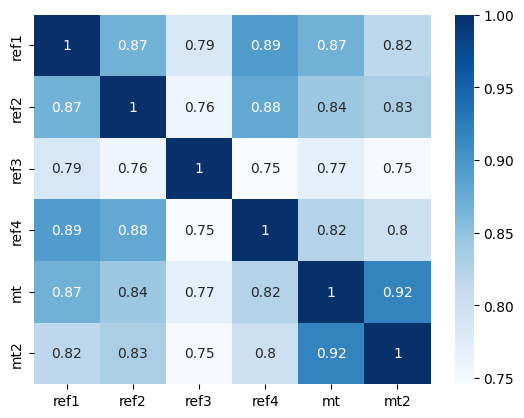

SL_175
src
74.59367553068095
71.2767390568266
ref1
38.22785454416932
35.455680262704234
ref2
40.624255365506045
36.6663978355823
ref3
44.14762100735676
40.682788006170895
ref4
36.38976563349977
32.727032958996745
mt
41.42670423445181
37.188275953628406
mt2
42.31333413837638
37.959499715724874
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.863859     0.789010     0.887664   0.869929   
ref2_SL_175     0.863859     1.000000     0.761023     0.878906   0.850971   
ref3_SL_175     0.789010     0.761023     1.000000     0.740754   0.770865   
ref4_SL_175     0.887664     0.878906     0.740754     1.000000   0.825413   
mt_SL_175       0.869929     0.850971     0.770865     0.825413   1.000000   
mt2_SL_175      0.816205     0.841684     0.740529     0.807762   0.918387   

             mt2_SL_175  
ref1_SL_175    0.816205  
ref2_SL_175    0.841684  
ref3_SL_175    0.740529  
ref4_SL_175    0.807762  
mt_SL_175      0.918387  
mt2

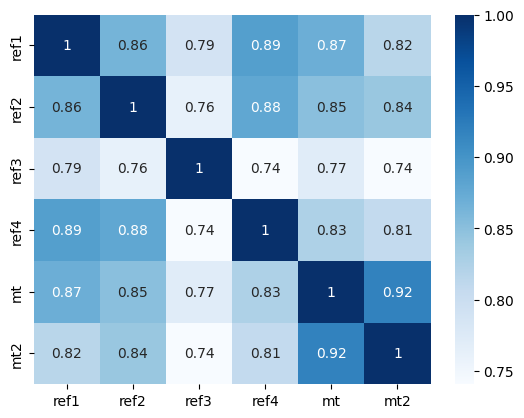

SL_200
src
149.29007454484417
140.79844066957907
ref1
72.5841713434249
65.84014314391968
ref2
77.06911100046554
67.27402157223085
ref3
84.46492364430483
76.91761865567491
ref4
68.65343728716907
59.28836951975679
mt
78.66933097924795
68.99505431720215
mt2
81.11803507294078
69.80006654686534
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.854790     0.790136     0.877339   0.866152   
ref2_SL_200     0.854790     1.000000     0.766813     0.877475   0.857217   
ref3_SL_200     0.790136     0.766813     1.000000     0.737544   0.771167   
ref4_SL_200     0.877339     0.877475     0.737544     1.000000   0.825715   
mt_SL_200       0.866152     0.857217     0.771167     0.825715   1.000000   
mt2_SL_200      0.810351     0.850428     0.732725     0.813801   0.914824   

             mt2_SL_200  
ref1_SL_200    0.810351  
ref2_SL_200    0.850428  
ref3_SL_200    0.732725  
ref4_SL_200    0.813801  
mt_SL_200      0.914824  
mt2_SL

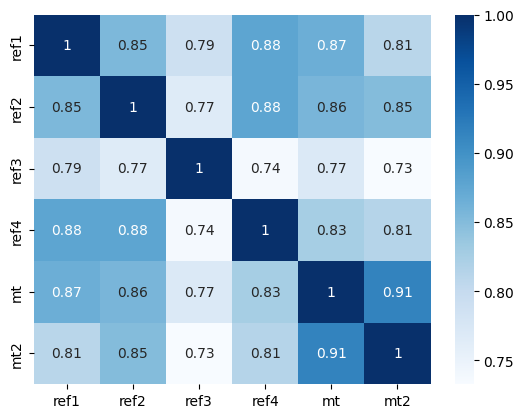

SL_225
src
303.8405857924159
280.9173422693609
ref1
141.27204217296267
121.51910391898548
ref2
149.574713911927
126.74540627481572
ref3
165.03721349339995
147.0261785197226
ref4
132.68959520885974
112.28680812131903
mt
152.5879183978382
130.09641698030532
mt2
159.08519909796496
133.15947836122643
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.841671     0.788613     0.863199   0.858107   
ref2_SL_225     0.841671     1.000000     0.774048     0.875799   0.861491   
ref3_SL_225     0.788613     0.774048     1.000000     0.736496   0.770520   
ref4_SL_225     0.863199     0.875799     0.736496     1.000000   0.825193   
mt_SL_225       0.858107     0.861491     0.770520     0.825193   1.000000   
mt2_SL_225      0.799650     0.857004     0.725712     0.818301   0.909175   

             mt2_SL_225  
ref1_SL_225    0.799650  
ref2_SL_225    0.857004  
ref3_SL_225    0.725712  
ref4_SL_225    0.818301  
mt_SL_225      0.909175  

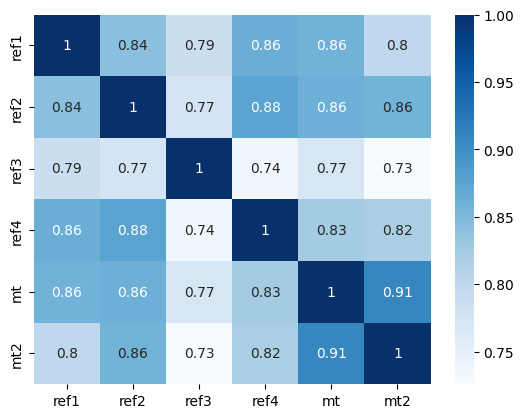

SL_250
src
628.4544909090951
577.7790438817206
ref1
281.5807955107528
231.5636328231543
ref2
296.70946945591714
237.97212871441562
ref3
328.9594640146193
290.01103615139186
ref4
262.41142768679447
213.6581552297547
mt
301.9311555382658
245.34534235655784
mt2
318.80027332941495
254.9049728011867
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.825262     0.783647     0.846028   0.846105   
ref2_SL_250     0.825262     1.000000     0.782166     0.874818   0.864247   
ref3_SL_250     0.783647     0.782166     1.000000     0.737729   0.768861   
ref4_SL_250     0.846028     0.874818     0.737729     1.000000   0.824690   
mt_SL_250       0.846105     0.864247     0.768861     0.824690   1.000000   
mt2_SL_250      0.784828     0.861273     0.719631     0.821503   0.902027   

             mt2_SL_250  
ref1_SL_250    0.784828  
ref2_SL_250    0.861273  
ref3_SL_250    0.719631  
ref4_SL_250    0.821503  
mt_SL_250      0.902027  
m

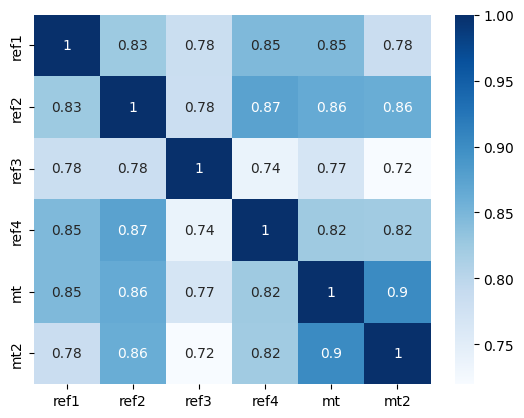

SL_275
src
1320.1522165503627
1219.778984730092
ref1
574.162372296313
453.0959025896884
ref2
600.996994826485
455.57583547265386
ref3
668.1558896234113
567.4465069535627
ref4
530.3439849595588
401.05959016110637
mt
608.7617534074363
486.1368574813887
mt2
652.0626852965453
504.7593393828241
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.806379     0.774766     0.826677   0.830745   
ref2_SL_275     0.806379     1.000000     0.790556     0.875180   0.865985   
ref3_SL_275     0.774766     0.790556     1.000000     0.740941   0.766216   
ref4_SL_275     0.826677     0.875180     0.740941     1.000000   0.824937   
mt_SL_275       0.830745     0.865985     0.766216     0.824937   1.000000   
mt2_SL_275      0.766840     0.863408     0.714420     0.823792   0.894026   

             mt2_SL_275  
ref1_SL_275    0.766840  
ref2_SL_275    0.863408  
ref3_SL_275    0.714420  
ref4_SL_275    0.823792  
mt_SL_275      0.894026  
mt2_SL

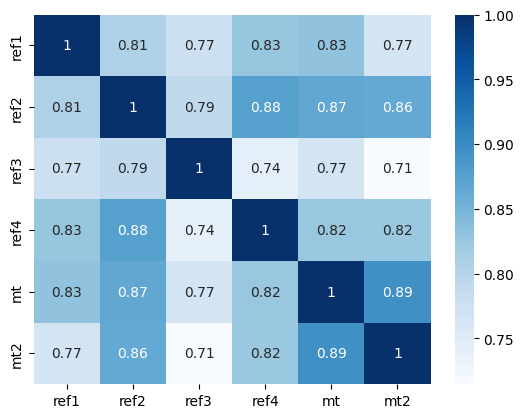

SL_300
src
2814.3535145845594
2540.753413906092
ref1
1196.3774978375839
920.9540798770122
ref2
1241.6637593536225
899.7862341138218
ref3
1381.3457410892622
1137.1268103934526
ref4
1093.9431810744325
779.0652861915714
mt
1249.126031524079
970.1334104140686
mt2
1359.680282249903
975.7897972478445
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.785822     0.761888     0.805932   0.812799   
ref2_SL_300     0.785822     1.000000     0.798638     0.877194   0.867158   
ref3_SL_300     0.761888     0.798638     1.000000     0.745525   0.762648   
ref4_SL_300     0.805932     0.877194     0.745525     1.000000   0.826445   
mt_SL_300       0.812799     0.867158     0.762648     0.826445   1.000000   
mt2_SL_300      0.746709     0.863799     0.709827     0.825634   0.885819   

             mt2_SL_300  
ref1_SL_300    0.746709  
ref2_SL_300    0.863799  
ref3_SL_300    0.709827  
ref4_SL_300    0.825634  
mt_SL_300      0.885819  
m

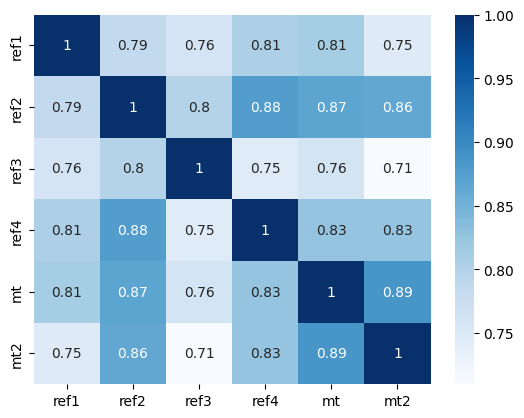

SL_325
src
6084.052939199673
5462.138856697426
ref1
2544.4235019118937
1883.2677835056147
ref2
2613.402271634539
1789.9613305036112
ref3
2903.5323056405973
2297.03559308062
ref4
2299.9128245327297
1539.1538693052194
mt
2605.2296040955403
1934.2722130795596
mt2
2886.9905143975075
1982.5497183826976
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.764324     0.745290     0.784442   0.793090   
ref2_SL_325     0.764324     1.000000     0.805924     0.880862   0.868131   
ref3_SL_325     0.745290     0.805924     1.000000     0.750703   0.758208   
ref4_SL_325     0.784442     0.880862     0.750703     1.000000   0.829480   
mt_SL_325       0.793090     0.868131     0.758208     0.829480   1.000000   
mt2_SL_325      0.725383     0.862941     0.705463     0.827495   0.877996   

             mt2_SL_325  
ref1_SL_325    0.725383  
ref2_SL_325    0.862941  
ref3_SL_325    0.705463  
ref4_SL_325    0.827495  
mt_SL_325      0.877996 

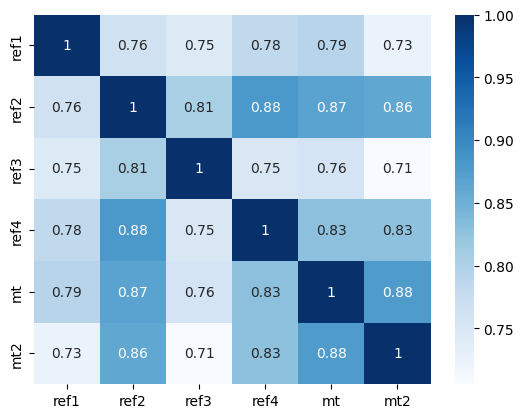

SL_350
src
13326.018221127724
11692.845168165546
ref1
5516.5060667366215
3750.4992975377863
ref2
5596.676533382996
3590.4101286945915
ref3
6198.179144707087
4550.330959548044
ref4
4921.788423264418
3111.7909633130794
mt
5516.089835127257
3895.647021998997
mt2
6234.397173629029
4049.063870172906
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.742509     0.725518     0.762691   0.772375   
ref2_SL_350     0.742509     1.000000     0.812045     0.885959   0.869168   
ref3_SL_350     0.725518     0.812045     1.000000     0.755673   0.752913   
ref4_SL_350     0.762691     0.885959     0.755673     1.000000   0.834087   
mt_SL_350       0.772375     0.869168     0.752913     0.834087   1.000000   
mt2_SL_350      0.703641     0.861325     0.700880     0.829769   0.871054   

             mt2_SL_350  
ref1_SL_350    0.703641  
ref2_SL_350    0.861325  
ref3_SL_350    0.700880  
ref4_SL_350    0.829769  
mt_SL_350      0.871054  
m

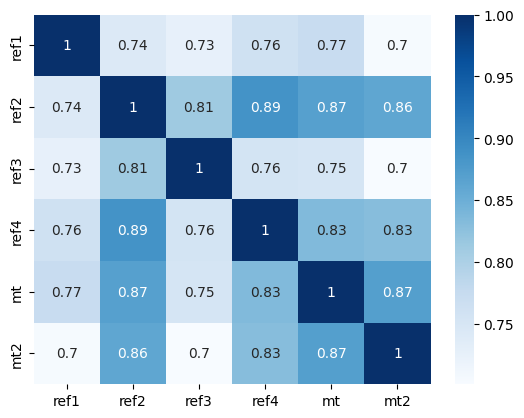

SL_375
src
29547.541988410783
25794.64486383465
ref1
12177.320567105999
7557.822041819528
ref2
12179.151311071379
7329.99970131614
ref3
13422.701447631727
9447.340988833
ref4
10706.76243993831
6238.640791704742
mt
11842.460958066502
7899.48926051451
mt2
13676.2672287071
8295.967283159596
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.720865     0.703258     0.741006   0.751270   
ref2_SL_375     0.720865     1.000000     0.816744     0.892123   0.870428   
ref3_SL_375     0.703258     0.816744     1.000000     0.759714   0.746733   
ref4_SL_375     0.741006     0.892123     0.759714     1.000000   0.840136   
mt_SL_375       0.751270     0.870428     0.746733     0.840136   1.000000   
mt2_SL_375      0.682051     0.859372     0.695642     0.832739   0.865376   

             mt2_SL_375  
ref1_SL_375    0.682051  
ref2_SL_375    0.859372  
ref3_SL_375    0.695642  
ref4_SL_375    0.832739  
mt_SL_375      0.865376  
mt2_SL_3

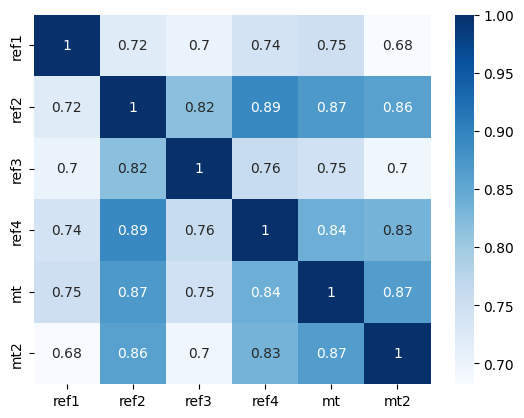

SL_400
src
66263.42583599311
56824.85462524026
ref1
27334.919959434937
15135.036756922938
ref2
26897.773400583457
15021.900569168916
ref3
29457.720109449776
19993.283293368462
ref4
23646.77634368035
12833.79614834888
mt
25750.367719832502
16144.936656878917
mt2
30441.17926235139
16981.46877467956
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.699733     0.679223     0.719587   0.730209   
ref2_SL_400     0.699733     1.000000     0.819871     0.898940   0.871981   
ref3_SL_400     0.679223     0.819871     1.000000     0.762259   0.739601   
ref4_SL_400     0.719587     0.898940     0.762259     1.000000   0.847380   
mt_SL_400       0.730209     0.871981     0.739601     0.847380   1.000000   
mt2_SL_400      0.660974     0.857394     0.689376     0.836562   0.861220   

             mt2_SL_400  
ref1_SL_400    0.660974  
ref2_SL_400    0.857394  
ref3_SL_400    0.689376  
ref4_SL_400    0.836562  
mt_SL_400      0.861220  

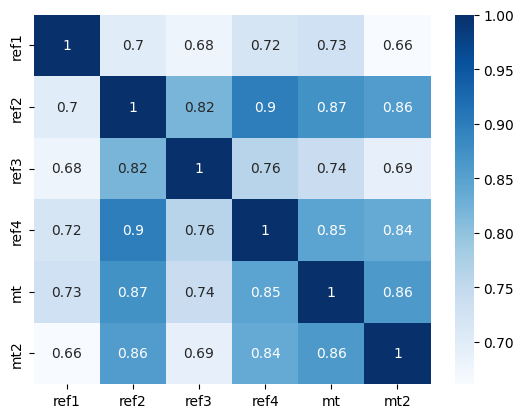

SL_425
src
150170.28195142408
126458.59758375768
ref1
62322.3338561009
31029.879281122332
ref2
60214.54084923205
30878.222063776884
ref3
65450.53880433682
41571.405661364464
ref4
52960.80334649567
26716.832175908632
mt
56649.42875311947
33474.0948015614
mt2
68674.31381714108
34026.85992226092
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.679318     0.654071     0.698544   0.709453   
ref2_SL_425     0.679318     1.000000     0.821361     0.906003   0.873820   
ref3_SL_425     0.654071     0.821361     1.000000     0.762923   0.731429   
ref4_SL_425     0.698544     0.906003     0.762923     1.000000   0.855503   
mt_SL_425       0.709453     0.873820     0.731429     0.855503   1.000000   
mt2_SL_425      0.640590     0.855589     0.681806     0.841272   0.858718   

             mt2_SL_425  
ref1_SL_425    0.640590  
ref2_SL_425    0.855589  
ref3_SL_425    0.681806  
ref4_SL_425    0.841272  
mt_SL_425      0.858718  
mt2

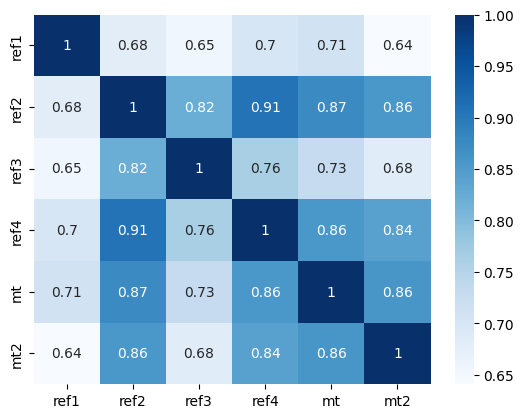

SL_450
src
343632.9097266221
283095.18838540884
ref1
144156.15070798955
65697.10194214148
ref2
136483.39854600833
64814.27275851249
ref3
147090.4239390684
86296.30250721757
ref4
120153.60229071877
55170.40330149876
mt
125967.25885813453
69773.19514790569
mt2
156859.80005305822
69639.21426609793
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.659709     0.628355     0.677928   0.689119   
ref2_SL_450     0.659709     1.000000     0.821215     0.912955   0.875879   
ref3_SL_450     0.628355     0.821215     1.000000     0.761499   0.722129   
ref4_SL_450     0.677928     0.912955     0.761499     1.000000   0.864165   
mt_SL_450       0.689119     0.875879     0.722129     0.864165   1.000000   
mt2_SL_450      0.620955     0.854055     0.672761     0.846805   0.857890   

             mt2_SL_450  
ref1_SL_450    0.620955  
ref2_SL_450    0.854055  
ref3_SL_450    0.672761  
ref4_SL_450    0.846805  
mt_SL_450      0.857890  
m

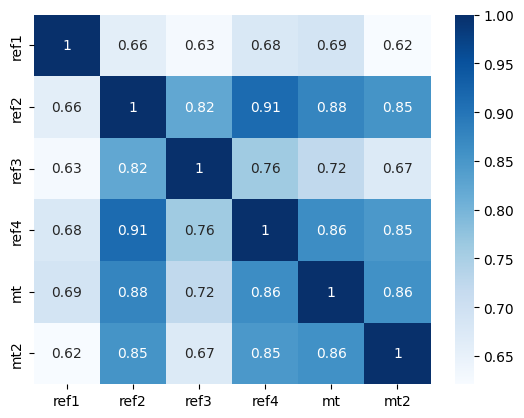

SL_475
src
793365.4482151263
640119.8046014623
ref1
337921.27088125347
138474.39418499463
ref2
312895.8612132659
136675.10360226737
ref3
334077.64341178996
181405.08965752512
ref4
275861.57903077005
114790.69140765324
mt
282872.8645551401
147136.33680998057
mt2
362401.4071607664
144728.4184738006
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.640912     0.602512     0.657754   0.669224   
ref2_SL_475     0.640912     1.000000     0.819486     0.919517   0.878055   
ref3_SL_475     0.602512     0.819486     1.000000     0.757933   0.711633   
ref4_SL_475     0.657754     0.919517     0.757933     1.000000   0.873039   
mt_SL_475       0.669224     0.878055     0.711633     0.873039   1.000000   
mt2_SL_475      0.602037     0.852808     0.662172     0.853023   0.858662   

             mt2_SL_475  
ref1_SL_475    0.602037  
ref2_SL_475    0.852808  
ref3_SL_475    0.662172  
ref4_SL_475    0.853023  
mt_SL_475      0.858662  

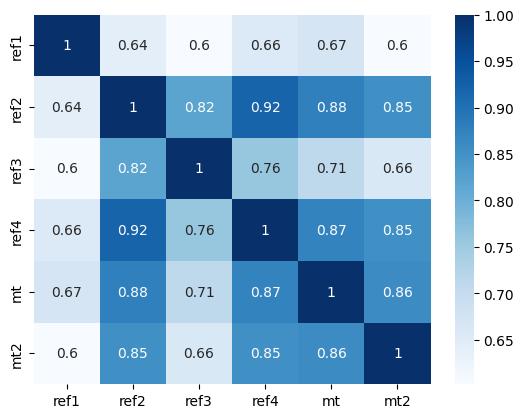

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
801948.5771891158
293666.76166764065
ref2
724856.4306757466
289056.3725046865
ref3
766248.2094757949
382219.8271526835
ref4
640369.5481587687
242375.2395320062
mt
641002.2814413718
310787.563186555
mt2
846131.2706130453
302933.3239423289
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.622878     0.576867     0.638023   0.649727   
ref2_SL_500     0.622878     1.000000     0.816264     0.925487   0.880224   
ref3_SL_500     0.576867     0.816264     1.000000     0.752286   0.699911   
ref4_SL_500     0.638023     0.925487     0.752286     1.000000   0.881830   
mt_SL_500       0.649727     0.880224     0.699911     0.881830   1.000000   
mt2_SL_500      0.583763     0.851807     0.650059     0.859751   0.860881   

             mt2_SL_500  
ref1_SL_500    0.583763  
ref2_SL_500    0.851807  
ref3_SL_500    0.650059  
ref4_SL_500    0.859751  
mt_SL_500      0.860881  
mt2_S

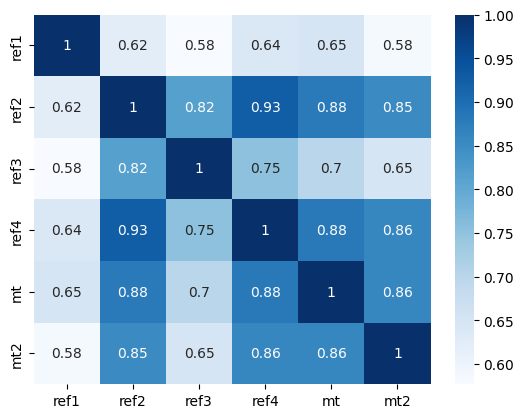

SL_525
src
4331606.646061756
3141367.4417431457
ref1
1924897.844751111
622661.5707918644
ref2
1695385.4192983839
612954.894414484
ref3
1773570.9563187945
822254.4291784847
ref4
1501774.7863826107
514231.3626681001
mt
1464756.312188894
660264.6930486585
mt2
1994785.1315271468
631196.1219571246
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.605531     0.551650     0.618723   0.630564   
ref2_SL_525     0.605531     1.000000     0.811664     0.930739   0.882258   
ref3_SL_525     0.551650     0.811664     1.000000     0.744703   0.686976   
ref4_SL_525     0.618723     0.930739     0.744703     1.000000   0.890296   
mt_SL_525       0.630564     0.882258     0.686976     0.890296   1.000000   
mt2_SL_525      0.566043     0.850980     0.636509     0.866798   0.864345   

             mt2_SL_525  
ref1_SL_525    0.566043  
ref2_SL_525    0.850980  
ref3_SL_525    0.636509  
ref4_SL_525    0.866798  
mt_SL_525      0.864345  
mt2

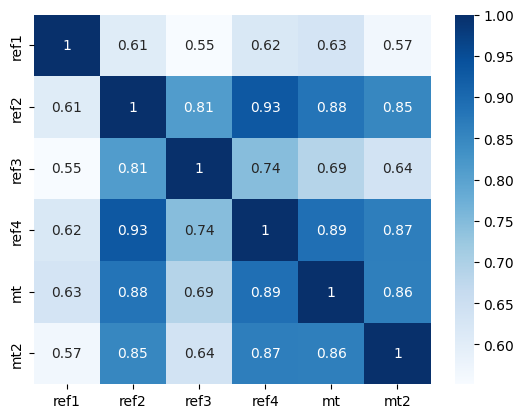

SL_550
src
10231354.187866237
7329958.645473514
ref1
4668796.866734685
1297260.986900683
ref2
4000548.7905191113
1335342.9058524314
ref3
4140099.9442759342
1795314.923768323
ref4
3555458.77066563
1098292.5556690611
mt
3373243.55944444
1397445.7603631518
mt2
4745003.357160566
1368064.1139596323
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.588785     0.527017     0.599845   0.611673   
ref2_SL_550     0.588785     1.000000     0.805819     0.935210   0.884042   
ref3_SL_550     0.527017     0.805819     1.000000     0.735374   0.672884   
ref4_SL_550     0.599845     0.935210     0.735374     1.000000   0.898248   
mt_SL_550       0.611673     0.884042     0.672884     0.898248   1.000000   
mt2_SL_550      0.548792     0.850243     0.621661     0.873977   0.868823   

             mt2_SL_550  
ref1_SL_550    0.548792  
ref2_SL_550    0.850243  
ref3_SL_550    0.621661  
ref4_SL_550    0.873977  
mt_SL_550      0.868823  
mt

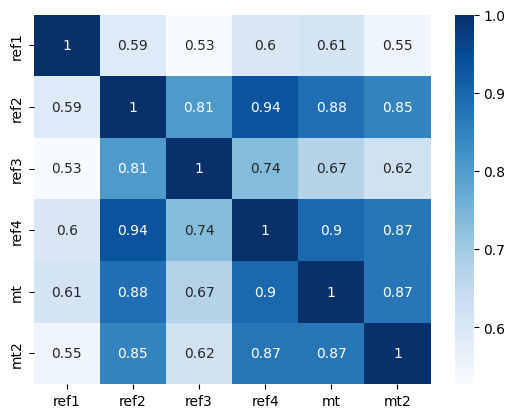

SL_575
src
24325330.39833967
16966711.067660846
ref1
11433186.692834195
2697365.9491532724
ref2
9517215.375129424
2771368.6563083706
ref3
9741085.1440108
3856741.515469351
ref4
8492056.339554982
2339724.551077802
mt
7824877.049086473
3005641.229100312
mt2
11380438.659073114
2930432.0715201925
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.572554     0.503067     0.581375   0.593008   
ref2_SL_575     0.572554     1.000000     0.798865     0.938889   0.885482   
ref3_SL_575     0.503067     0.798865     1.000000     0.724517   0.657733   
ref4_SL_575     0.581375     0.938889     0.724517     1.000000   0.905560   
mt_SL_575       0.593008     0.885482     0.657733     0.905560   1.000000   
mt2_SL_575      0.531938     0.849509     0.605684     0.881124   0.874077   

             mt2_SL_575  
ref1_SL_575    0.531938  
ref2_SL_575    0.849509  
ref3_SL_575    0.605684  
ref4_SL_575    0.881124  
mt_SL_575      0.874077  
mt2

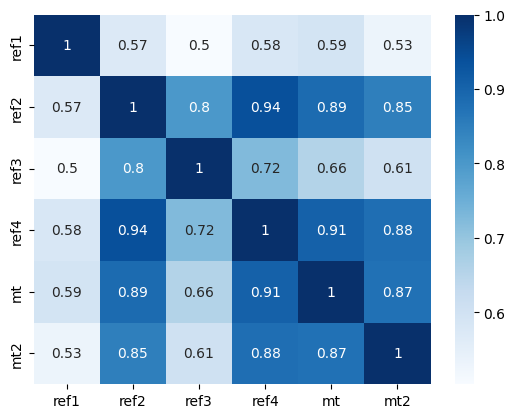

SL_600
src
58189712.87790054
39214596.580572255
ref1
28245237.532146424
5745408.405460412
ref2
22812530.052657098
5783495.814786345
ref3
23089306.255535584
8314746.967965297
ref4
20449814.267498344
4921308.308864666
mt
18274830.877212077
6498810.605428619
mt2
27503609.468142994
6180493.832538404
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.556766     0.479858     0.563306   0.574543   
ref2_SL_600     0.556766     1.000000     0.790939     0.941799   0.886508   
ref3_SL_600     0.479858     0.790939     1.000000     0.712350   0.641650   
ref4_SL_600     0.563306     0.941799     0.712350     1.000000   0.912154   
mt_SL_600       0.574543     0.886508     0.641650     0.912154   1.000000   
mt2_SL_600      0.515427     0.848705     0.588765     0.888099   0.879879   

             mt2_SL_600  
ref1_SL_600    0.515427  
ref2_SL_600    0.848705  
ref3_SL_600    0.588765  
ref4_SL_600    0.888099  
mt_SL_600      0.879879  


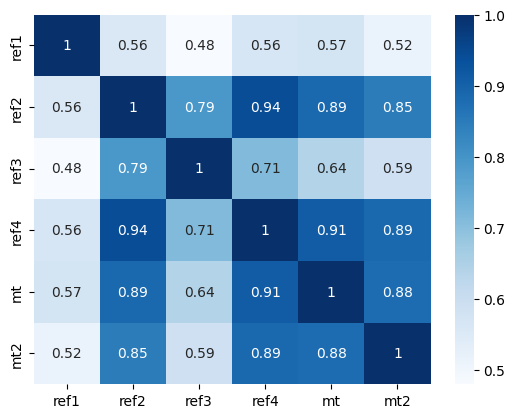

SL_625
src
140004729.32922277
89386250.1037006
ref1
70341270.65653865
12181427.72821824
ref2
55064198.92841556
12268320.733784284
ref3
55107761.635890745
17777356.4262466
ref4
49622358.83652155
10572105.12868577
mt
42953339.43724827
13908291.707759969
mt2
66938860.97597661
13013376.251337351
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.541358     0.457423     0.545629   0.556271   
ref2_SL_625     0.541358     1.000000     0.782174     0.943988   0.887076   
ref3_SL_625     0.457423     0.782174     1.000000     0.699086   0.624782   
ref4_SL_625     0.545629     0.943988     0.699086     1.000000   0.917999   
mt_SL_625       0.556271     0.887076     0.624782     0.917999   1.000000   
mt2_SL_625      0.499224     0.847771     0.571094     0.894795   0.886020   

             mt2_SL_625  
ref1_SL_625    0.499224  
ref2_SL_625    0.847771  
ref3_SL_625    0.571094  
ref4_SL_625    0.894795  
mt_SL_625      0.886020  
mt2_

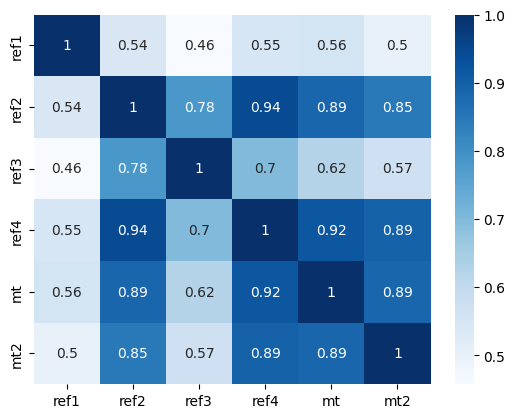

SL_650
src
338703171.3009422
210335993.3140239
ref1
176463121.9913672
25738278.366515044
ref2
133775825.91239178
25675531.886977434
ref3
132379286.53819253
38262919.26107305
ref4
121267786.68163328
22616473.10370507
mt
101566166.10095777
29749964.402143635
mt2
163981864.48365492
27827758.65874009
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.526281     0.435774     0.528339   0.538205   
ref2_SL_650     0.526281     1.000000     0.772695     0.945518   0.887165   
ref3_SL_650     0.435774     0.772695     1.000000     0.684923   0.607287   
ref4_SL_650     0.528339     0.945518     0.684923     1.000000   0.923101   
mt_SL_650       0.538205     0.887165     0.607287     0.923101   1.000000   
mt2_SL_650      0.483309     0.846662     0.552859     0.901134   0.892320   

             mt2_SL_650  
ref1_SL_650    0.483309  
ref2_SL_650    0.846662  
ref3_SL_650    0.552859  
ref4_SL_650    0.901134  
mt_SL_650      0.892320  

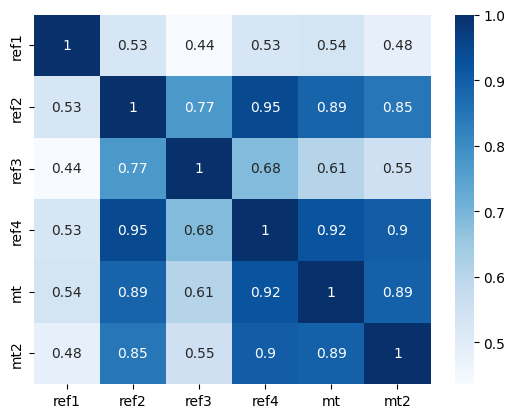

SL_675
src
823697155.0790491
502847016.137499
ref1
445644194.5550455
55098664.81433122
ref2
326961164.85379195
54110046.217711404
ref3
319928585.77165043
83649510.14310855
ref4
298315496.5281008
48899820.4791507
mt
241527233.86589065
63584159.97321676
mt2
404140347.5050623
58817206.96181625
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.511499     0.414911     0.511431   0.520366   
ref2_SL_675     0.511499     1.000000     0.762613     0.946456   0.886779   
ref3_SL_675     0.414911     0.762613     1.000000     0.670041   0.589321   
ref4_SL_675     0.511431     0.946456     0.670041     1.000000   0.927492   
mt_SL_675       0.520366     0.886779     0.589321     0.927492   1.000000   
mt2_SL_675      0.467673     0.845351     0.534235     0.907064   0.898631   

             mt2_SL_675  
ref1_SL_675    0.467673  
ref2_SL_675    0.845351  
ref3_SL_675    0.534235  
ref4_SL_675    0.907064  
mt_SL_675      0.898631  
mt2_S

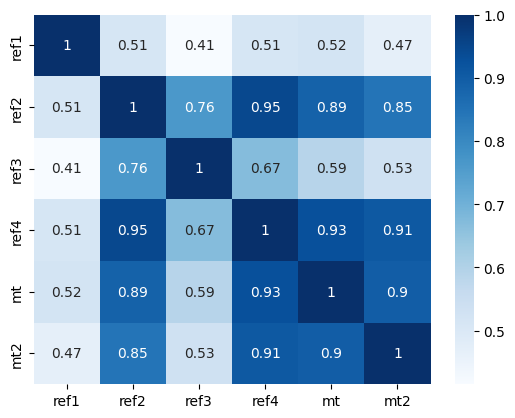

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
1132256365.5547843
118713814.91220346
ref2
803595664.0672153
114374829.96602318
ref3
777577267.9302121
184257104.99212366
ref4
738351125.1389337
103752811.14597392
mt
577453325.3468091
136191973.527882
mt2
1001600841.1712052
124357160.15293667
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.496986     0.394829     0.494902   0.502785   
ref2_SL_700     0.496986     1.000000     0.752031     0.946872   0.885932   
ref3_SL_700     0.394829     0.752031     1.000000     0.654599   0.571036   
ref4_SL_700     0.494902     0.946872     0.654599     1.000000   0.931222   
mt_SL_700       0.502785     0.885932     0.571036     0.931222   1.000000   
mt2_SL_700      0.452320     0.843824     0.515384     0.912557   0.904836   

             mt2_SL_700  
ref1_SL_700    0.452320  
ref2_SL_700    0.843824  
ref3_SL_700    0.515384  
ref4_SL_700    0.912557  
mt_SL_700      0.904836  

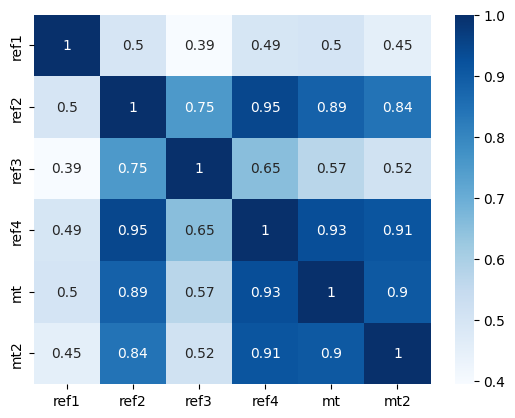

SL_725
src
4944587689.869408
2766777160.633936
ref1
2892510526.131874
256284964.54273897
ref2
1985305338.0863447
243700173.62099856
ref3
1899910707.2279973
389275289.4153242
ref4
1837859471.2563233
220179469.89015132
mt
1387650449.7368295
294497019.22801495
mt2
2495203436.7556696
263323114.72852045
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.482725     0.375515     0.478752   0.485496   
ref2_SL_725     0.482725     1.000000     0.741040     0.946833   0.884653   
ref3_SL_725     0.375515     0.741040     1.000000     0.638739   0.552571   
ref4_SL_725     0.478752     0.946833     0.638739     1.000000   0.934352   
mt_SL_725       0.485496     0.884653     0.552571     0.934352   1.000000   
mt2_SL_725      0.437256     0.842078     0.496450     0.917604   0.910847   

             mt2_SL_725  
ref1_SL_725    0.437256  
ref2_SL_725    0.842078  
ref3_SL_725    0.496450  
ref4_SL_725    0.917604  
mt_SL_725      0.910847

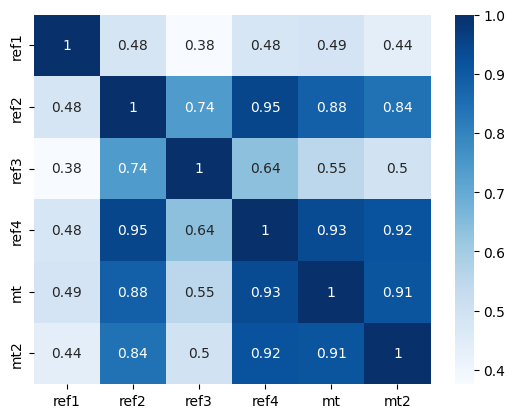

SL_750
src
12201196322.126482
6533701117.122557
ref1
7425910944.194507
554168216.0021698
ref2
4928354690.625855
521714278.96876264
ref3
4665221991.116419
829044778.6656888
ref4
4598749062.417868
467884550.0058603
mt
3350751276.8438444
639244527.2895625
mt2
6246013298.761232
568348665.8618487
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.468705     0.356956     0.462978   0.468531   
ref2_SL_750     0.468705     1.000000     0.729719     0.946402   0.882977   
ref3_SL_750     0.356956     0.729719     1.000000     0.622582   0.534051   
ref4_SL_750     0.462978     0.946402     0.622582     1.000000   0.936946   
mt_SL_750       0.468531     0.882977     0.534051     0.936946   1.000000   
mt2_SL_750      0.422494     0.840119     0.477560     0.922208   0.916601   

             mt2_SL_750  
ref1_SL_750    0.422494  
ref2_SL_750    0.840119  
ref3_SL_750    0.477560  
ref4_SL_750    0.922208  
mt_SL_750      0.916601  
mt2_

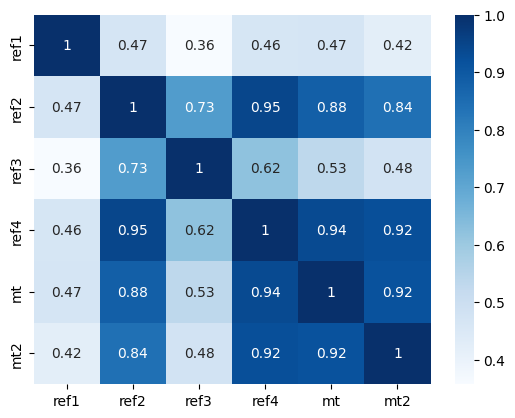

SL_775
src
30245243673.27781
15503724864.782127
ref1
19149577691.22144
1187779423.8541684
ref2
12288762819.47847
1123680354.7365465
ref3
11508513106.505245
1791743883.0461984
ref4
11563012238.574238
989031737.8868914
mt
8128229179.125988
1389631363.635585
mt2
15704903679.916534
1221101489.097465
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.454923     0.339137     0.447580   0.451922   
ref2_SL_775     0.454923     1.000000     0.718137     0.945635   0.880944   
ref3_SL_775     0.339137     0.718137     1.000000     0.606236   0.515588   
ref4_SL_775     0.447580     0.945635     0.606236     1.000000   0.939072   
mt_SL_775       0.451922     0.880944     0.515588     0.939072   1.000000   
mt2_SL_775      0.408048     0.837960     0.458823     0.926385   0.922057   

             mt2_SL_775  
ref1_SL_775    0.408048  
ref2_SL_775    0.837960  
ref3_SL_775    0.458823  
ref4_SL_775    0.926385  
mt_SL_775      0.922057  


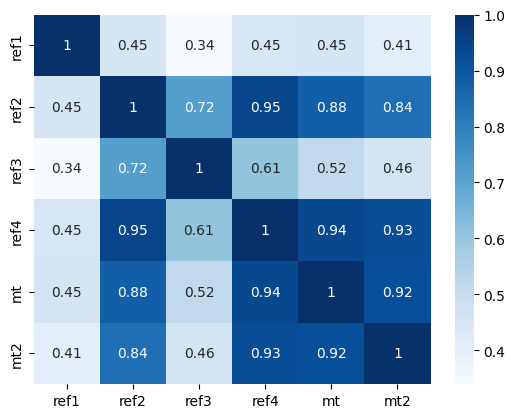

SL_800
src
75308449146.75627
37154119080.28433
ref1
49580617362.6082
2529408097.8931026
ref2
30768179277.30667
2410336172.6400223
ref3
28512779165.5749
3897905499.5625634
ref4
29203960658.285004
2108007829.0531306
mt
19803368648.614864
2999160930.134754
mt2
39651962235.64799
2600001220.225865
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.441377     0.322040     0.432560   0.435695   
ref2_SL_800     0.441377     1.000000     0.706353     0.944583   0.878595   
ref3_SL_800     0.322040     0.706353     1.000000     0.589789   0.497273   
ref4_SL_800     0.432560     0.944583     0.589789     1.000000   0.940793   
mt_SL_800       0.435695     0.878595     0.497273     0.940793   1.000000   
mt2_SL_800      0.393929     0.835619     0.440332     0.930156   0.927192   

             mt2_SL_800  
ref1_SL_800    0.393929  
ref2_SL_800    0.835619  
ref3_SL_800    0.440332  
ref4_SL_800    0.930156  
mt_SL_800      0.927192  
mt2

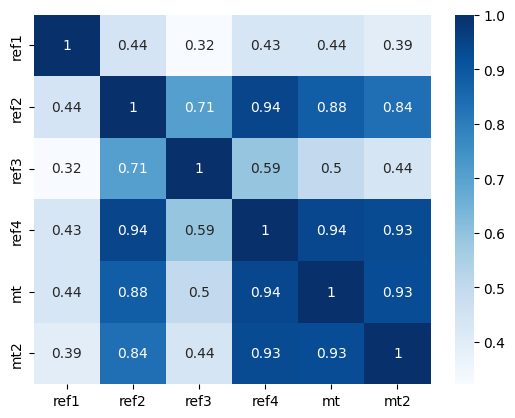

SL_825
src
188328461125.37543
88759479197.95065
ref1
128835121847.57701
5390617302.876395
ref2
77329892175.17682
5159400218.742308
ref3
70926079779.14247
8519130681.142979
ref4
74062336948.9836
4498419267.1704445
mt
48447738355.10822
6408366528.640537
mt2
100499438554.53941
5524577494.649001
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.428068     0.305648     0.417917   0.419873   
ref2_SL_825     0.428068     1.000000     0.694420     0.943293   0.875970   
ref3_SL_825     0.305648     0.694420     1.000000     0.573322   0.479187   
ref4_SL_825     0.417917     0.943293     0.573322     1.000000   0.942170   
mt_SL_825       0.419873     0.875970     0.479187     0.942170   1.000000   
mt2_SL_825      0.380152     0.833115     0.422162     0.933547   0.931996   

             mt2_SL_825  
ref1_SL_825    0.380152  
ref2_SL_825    0.833115  
ref3_SL_825    0.422162  
ref4_SL_825    0.933547  
mt_SL_825      0.931996  
mt2_

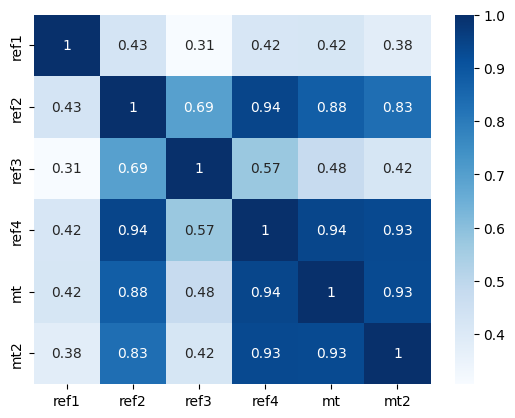

SL_850
src
472965874424.6596
209696852072.8994
ref1
335868606526.9776
11496563596.937773
ref2
195037359868.0959
11054232516.823997
ref3
177091540308.71512
18633996139.834503
ref4
188535464930.55554
9610207794.463177
mt
118988440696.00156
13705892894.823982
mt2
255631698140.94696
11927353603.49126
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.415002     0.289945     0.403651   0.404473   
ref2_SL_850     0.415002     1.000000     0.682382     0.941803   0.873106   
ref3_SL_850     0.289945     0.682382     1.000000     0.556900   0.461395   
ref4_SL_850     0.403651     0.941803     0.556900     1.000000   0.943257   
mt_SL_850       0.404473     0.873106     0.461395     0.943257   1.000000   
mt2_SL_850      0.366728     0.830469     0.404378     0.936588   0.936470   

             mt2_SL_850  
ref1_SL_850    0.366728  
ref2_SL_850    0.830469  
ref3_SL_850    0.404378  
ref4_SL_850    0.936588  
mt_SL_850      0.936470  

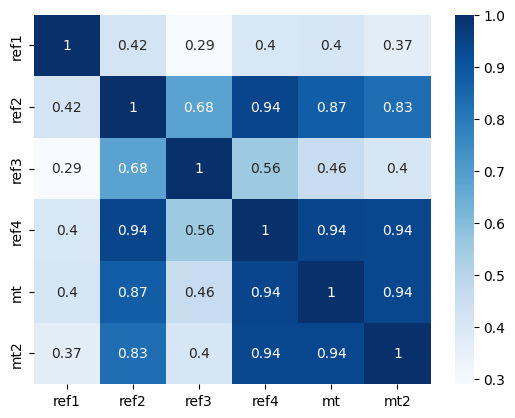

SL_875
src
1192729481778.0728
501307929419.6415
ref1
878165414691.781
24534921426.99627
ref2
493507582374.8321
23527513080.589287
ref3
443711905328.3452
40788067010.02375
ref4
481607701415.70605
20552021239.113087
mt
293319981135.33887
29339444704.287094
mt2
652393701834.9005
25522226933.780388
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.402183     0.274911     0.389763   0.389510   
ref2_SL_875     0.402183     1.000000     0.670276     0.940149   0.870041   
ref3_SL_875     0.274911     0.670276     1.000000     0.540580   0.443948   
ref4_SL_875     0.389763     0.940149     0.540580     1.000000   0.944103   
mt_SL_875       0.389510     0.870041     0.443948     0.944103   1.000000   
mt2_SL_875      0.353664     0.827703     0.387029     0.939308   0.940622   

             mt2_SL_875  
ref1_SL_875    0.353664  
ref2_SL_875    0.827703  
ref3_SL_875    0.387029  
ref4_SL_875    0.939308  
mt_SL_875      0.940622  
m

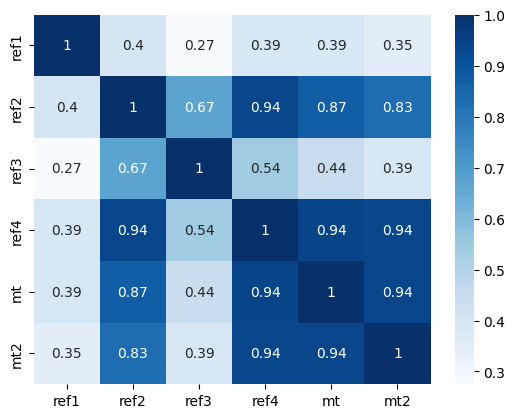

SL_900
src
3020011763176.6636
1193341285325.353
ref1
2302123795976.133
52546973670.41232
ref2
1252460488041.7368
50310552991.30789
ref3
1115342246478.3167
89340901310.38779
ref4
1234163636265.9958
44441855259.275696
mt
725597848834.2911
62444418494.57413
mt2
1670126064213.1414
54659274506.59679
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.389616     0.260530     0.376252   0.374992   
ref2_SL_900     0.389616     1.000000     0.658135     0.938359   0.866806   
ref3_SL_900     0.260530     0.658135     1.000000     0.524410   0.426889   
ref4_SL_900     0.376252     0.938359     0.524410     1.000000   0.944751   
mt_SL_900       0.374992     0.866806     0.426889     0.944751   1.000000   
mt2_SL_900      0.340968     0.824836     0.370154     0.941736   0.944465   

             mt2_SL_900  
ref1_SL_900    0.340968  
ref2_SL_900    0.824836  
ref3_SL_900    0.370154  
ref4_SL_900    0.941736  
mt_SL_900      0.944465  
m

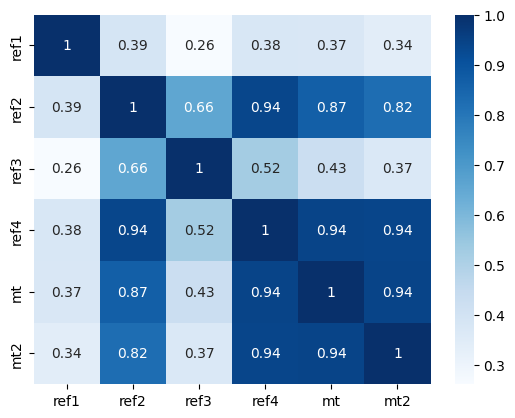

SL_925
src
7676878874728.81
2825871516031.6035
ref1
6049418192788.975
113939979430.77939
ref2
3187311541121.7373
107648286757.83405
ref3
2812015785035.2393
195809924646.09982
ref4
3171863949966.069
96763629494.04697
mt
1800871185407.7212
131939658606.21977
mt2
4287869587716.0317
117164303207.50374
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.377307     0.246783     0.363117   0.360925   
ref2_SL_925     0.377307     1.000000     0.645988     0.936459   0.863430   
ref3_SL_925     0.246783     0.645988     1.000000     0.508430   0.410248   
ref4_SL_925     0.363117     0.936459     0.508430     1.000000   0.945237   
mt_SL_925       0.360925     0.863430     0.410248     0.945237   1.000000   
mt2_SL_925      0.328645     0.821888     0.353781     0.943902   0.948016   

             mt2_SL_925  
ref1_SL_925    0.328645  
ref2_SL_925    0.821888  
ref3_SL_925    0.353781  
ref4_SL_925    0.943902  
mt_SL_925      0.948016 

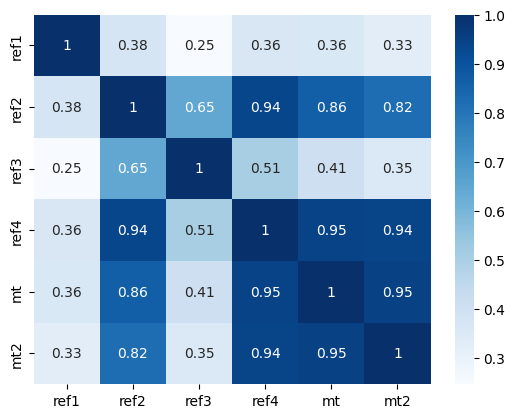

SL_950
src
19589480415784.91
6695745864435.366
ref1
15930544901337.818
247165074195.86526
ref2
8131649627148.988
230466554028.00653
ref3
7109430552760.797
429404116000.494
ref4
8173562208781.654
210780787540.58466
mt
4483524233312.185
282188721617.51495
mt2
11038305085980.809
251355175637.33563
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.365261     0.233652     0.350357   0.347309   
ref2_SL_950     0.365261     1.000000     0.633858     0.934472   0.859940   
ref3_SL_950     0.233652     0.633858     1.000000     0.492674   0.394050   
ref4_SL_950     0.350357     0.934472     0.492674     1.000000   0.945595   
mt_SL_950       0.347309     0.859940     0.394050     0.945595   1.000000   
mt2_SL_950      0.316697     0.818877     0.337933     0.945831   0.951294   

             mt2_SL_950  
ref1_SL_950    0.316697  
ref2_SL_950    0.818877  
ref3_SL_950    0.337933  
ref4_SL_950    0.945831  
mt_SL_950      0.951294  
m

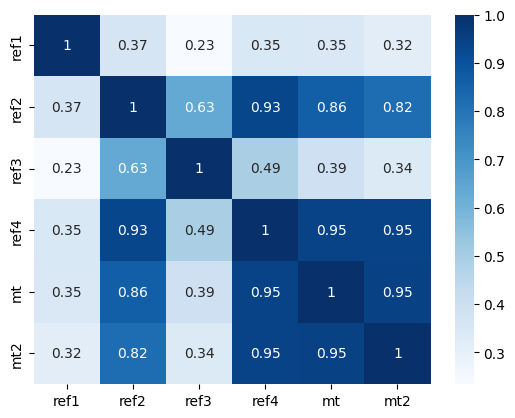

SL_975
src
50173418288827.71
15873783084476.455
ref1
42033004376550.39
536365322485.9887
ref2
20793944505491.527
493686062947.08386
ref3
18020644870530.42
937412976372.2145
ref4
21113702697337.215
459297000076.02783
mt
11195089541542.629
603867218777.3384
mt2
28487487524856.254
539657448660.47815
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.353483     0.221117     0.337970   0.334145   
ref2_SL_975     0.353483     1.000000     0.621766     0.932415   0.856358   
ref3_SL_975     0.221117     0.621766     1.000000     0.477171   0.378313   
ref4_SL_975     0.337970     0.932415     0.477171     1.000000   0.945852   
mt_SL_975       0.334145     0.856358     0.378313     0.945852   1.000000   
mt2_SL_975      0.305123     0.815819     0.322622     0.947549   0.954318   

             mt2_SL_975  
ref1_SL_975    0.305123  
ref2_SL_975    0.815819  
ref3_SL_975    0.322622  
ref4_SL_975    0.947549  
mt_SL_975      0.954318  

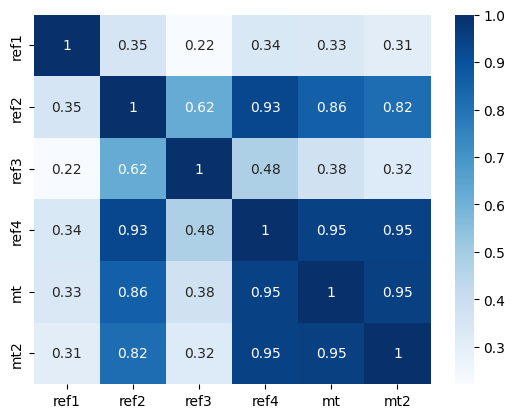

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.4010368424411201
0.400615551199377
ref2
0.385689099296457
0.3873168669928696
ref3
0.3856407621880125
0.3876213767945571
ref4
0.40759461723335005
0.40711220961886097
mt
0.3883905388082276
0.38770784983795786
mt2
0.3977263769680306
0.39816874452064743
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.607266   0.592827   0.681431  0.717163  0.642235
ref2_gini   0.607266   1.000000   0.649158   0.663808  0.642225  0.705200
ref3_gini   0.592827   0.649158   1.000000   0.583392  0.701676  0.598563
ref4_gini   0.681431   0.663808   0.583392   1.000000  0.690628  0.622907
mt_gini     0.717163   0.642225   0.701676   0.690628  1.000000  0.791704
mt2_gini    0.642235   0.705200   0.598563   0.622907  0.791704  1.000000


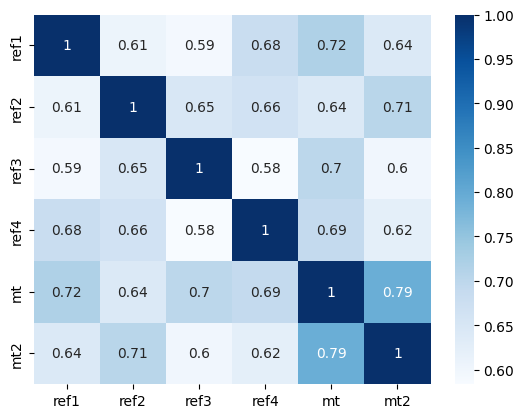

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.376833215790771
-4.444957498602793
ref2
-4.36839477561949
-4.442392690402146
ref3
-4.322646024452258
-4.347942366518335
ref4
-4.403943482687431
-4.526463839941072
mt
-4.325409526297352
-4.380937302401361
mt2
-4.344052910447628
-4.424839065214715
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.978552  0.962179  0.976141  0.976532  0.976040
ref2_kl  0.978552  1.000000  0.973339  0.974859  0.983234  0.981742
ref3_kl  0.962179  0.973339  1.000000  0.959006  0.975273  0.969811
ref4_kl  0.976141  0.974859  0.959006  1.000000  0.972970  0.967601
mt_kl    0.976532  0.983234  0.975273  0.972970  1.000000  0.987890
mt2_kl   0.976040  0.981742  0.969811  0.967601  0.987890  1.000000


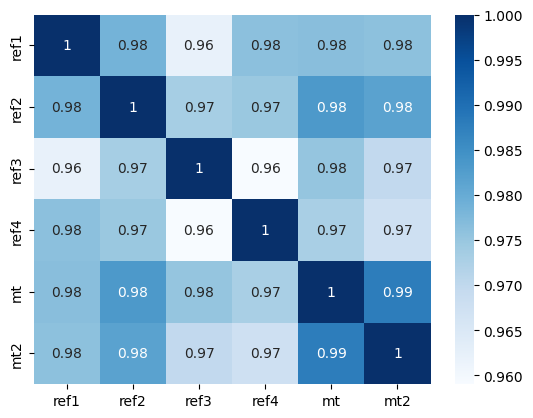

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.7830509730091196
0.7547088733889928
ref2
0.7498558293074891
0.7335790084185468
ref3
0.7435752494850761
0.7381623605172717
ref4
0.7951508671506642
0.7824889314973638
mt
0.7482140489001441
0.7444170840030621
mt2
0.7673575496749723
0.7534434088543069
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.628571  0.599359  0.722050  0.717021  0.673018
ref2_cv  0.628571  1.000000  0.655930  0.697990  0.704301  0.755952
ref3_cv  0.599359  0.655930  1.000000  0.624226  0.721953  0.652761
ref4_cv  0.722050  0.697990  0.624226  1.000000  0.717618  0.701749
mt_cv    0.717021  0.704301  0.721953  0.717618  1.000000  0.821462
mt2_cv   0.673018  0.755952  0.652761  0.701749  0.821462  1.000000


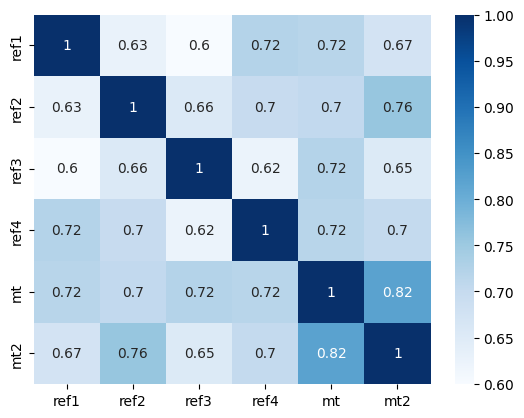

lv
src
72.35425230811832
69.03561950442358
ref1
43.57457358745765
35.97756786843402
ref2
44.07584095808037
35.80026589235105
ref3
46.46443302025414
40.650721074307015
ref4
41.452112254492775
34.457569890297336
mt
42.7994873910154
36.58827084007069
mt2
48.30325888851968
41.452631769746176
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.676856  0.652399  0.729388  0.766773  0.656231
ref2_lv  0.676856  1.000000  0.673735  0.825267  0.781022  0.747807
ref3_lv  0.652399  0.673735  1.000000  0.672622  0.625745  0.572314
ref4_lv  0.729388  0.825267  0.672622  1.000000  0.786391  0.765858
mt_lv    0.766773  0.781022  0.625745  0.786391  1.000000  0.835105
mt2_lv   0.656231  0.747807  0.572314  0.765858  0.835105  1.000000


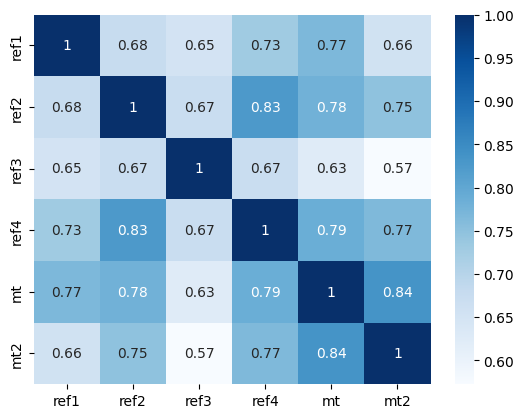

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-607.3717990101982
-528.0787818486872
ref2
-636.0277253285046
-538.6928029799294
ref3
-660.8177270428166
-579.2341896126704
ref4
-603.1956081601547
-525.4943525304318
mt
-622.5682074460502
-552.2265013158881
mt2
-642.8141738872146
-550.6109339050756
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.956779    0.947383    0.971559  0.970859   
ref2_renyi    0.956779    1.000000    0.949213    0.966339  0.959150   
ref3_renyi    0.947383    0.949213    1.000000    0.947754  0.956685   
ref4_renyi    0.971559    0.966339    0.947754    1.000000  0.968311   
mt_renyi      0.970859    0.959150    0.956685    0.968311  1.000000   
mt2_renyi     0.964919    0.962417    0.952118    0.965956  0.979223   

            mt2_renyi  
ref1_renyi   0.964919  
ref2_renyi   0.962417  
ref3_renyi   0.952118  
ref4_renyi   0.965956  
mt_renyi     0.979223  
mt2_renyi    1.000000  


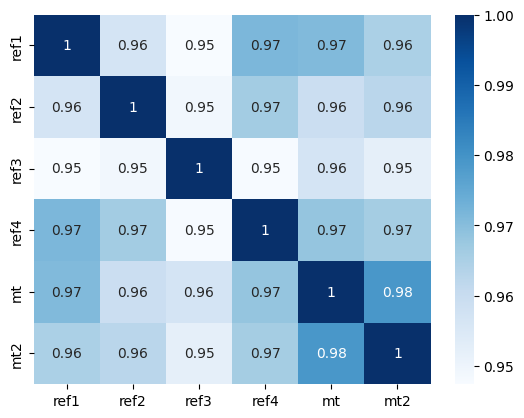

41.78302361451637
28.780612621720145
28.70961835336397
30.820403754816958
27.50553673128145
28.963060562397253


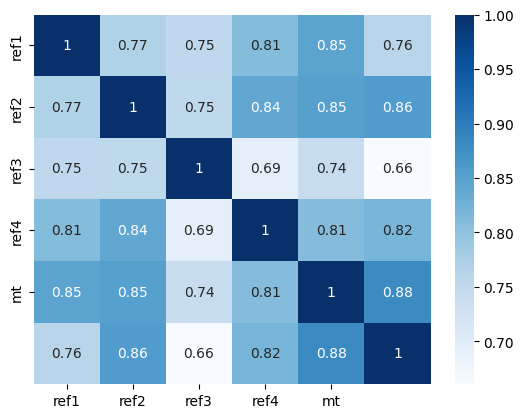

*************************************
28.709562091963935
28.709562091963935
28.75763402360439
31.230819635461152
27.46380748460267
29.045997231686766
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se 

/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/cepin/miniconda3/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


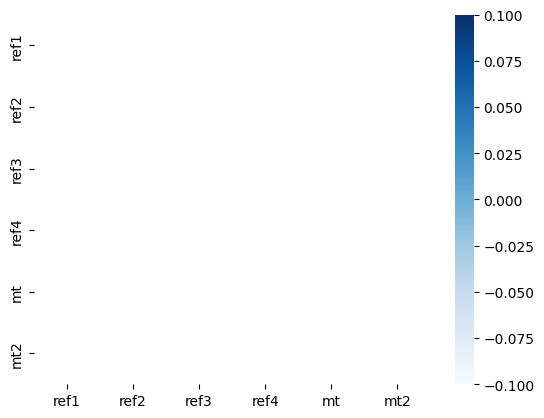

L
src
10.359164788583737
10.123614579255745
ref1
6.476680965324111
6.303775635338418
ref2
6.7369550107732765
6.544689022780706
ref3
6.886576959292068
6.651236912957392
ref4
6.345603753226437
6.079948220608963
mt
6.959374224530754
6.735877874455657
mt2
6.973958041170644
6.724049662002454
          ref1_L    ref2_L    ref3_L    ref4_L      mt_L     mt2_L
ref1_L  1.000000  0.845760  0.814005  0.871580  0.759867  0.715165
ref2_L  0.845760  1.000000  0.840224  0.886948  0.754851  0.742419
ref3_L  0.814005  0.840224  1.000000  0.824631  0.739290  0.721310
ref4_L  0.871580  0.886948  0.824631  1.000000  0.762270  0.730047
mt_L    0.759867  0.754851  0.739290  0.762270  1.000000  0.912729
mt2_L   0.715165  0.742419  0.721310  0.730047  0.912729  1.000000


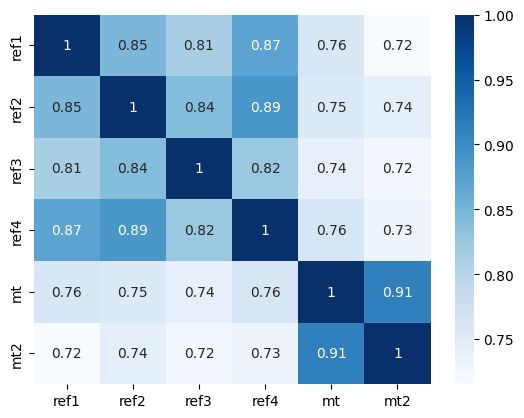

SL_25
src
1.7277963069408389
1.7200074415889737
ref1
1.4830405345862296
1.4793577478247157
ref2
1.5028337084610914
1.4977177778920048
ref3
1.5111821560618195
1.5069971395210247
ref4
1.4730372305936485
1.4666976603950772
mt
1.517099869392838
1.5137467379741645
mt2
1.5138657895933612
1.5134297284333316
            ref1_SL_25  ref2_SL_25  ref3_SL_25  ref4_SL_25  mt_SL_25  \
ref1_SL_25    1.000000    0.824474    0.801512    0.860762  0.768428   
ref2_SL_25    0.824474    1.000000    0.823952    0.839795  0.739133   
ref3_SL_25    0.801512    0.823952    1.000000    0.793628  0.748465   
ref4_SL_25    0.860762    0.839795    0.793628    1.000000  0.770921   
mt_SL_25      0.768428    0.739133    0.748465    0.770921  1.000000   
mt2_SL_25     0.717636    0.723202    0.733039    0.720474  0.880652   

            mt2_SL_25  
ref1_SL_25   0.717636  
ref2_SL_25   0.723202  
ref3_SL_25   0.733039  
ref4_SL_25   0.720474  
mt_SL_25     0.880652  
mt2_SL_25    1.000000  


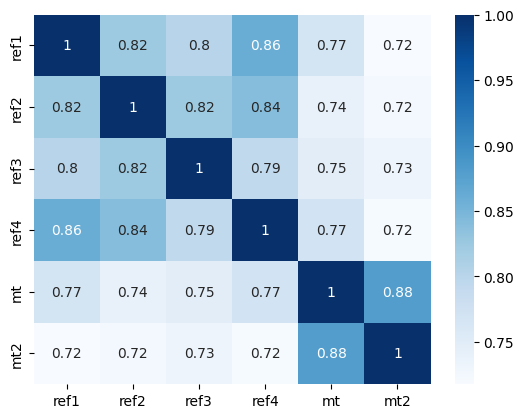

SL_50
src
3.0671973011635125
3.032966843199389
ref1
2.330859844724677
2.319459552348138
ref2
2.387269982567229
2.3587926653068343
ref3
2.4139142110181644
2.389644299168719
ref4
2.303197923224165
2.270848232641951
mt
2.4305263986136523
2.419297941060912
mt2
2.424572168214121
2.4118397829987503
            ref1_SL_50  ref2_SL_50  ref3_SL_50  ref4_SL_50  mt_SL_50  \
ref1_SL_50    1.000000    0.837492    0.808371    0.865406  0.765369   
ref2_SL_50    0.837492    1.000000    0.829518    0.860186  0.744035   
ref3_SL_50    0.808371    0.829518    1.000000    0.805922  0.742218   
ref4_SL_50    0.865406    0.860186    0.805922    1.000000  0.764957   
mt_SL_50      0.765369    0.744035    0.742218    0.764957  1.000000   
mt2_SL_50     0.716575    0.732237    0.729657    0.722193  0.894522   

            mt2_SL_50  
ref1_SL_50   0.716575  
ref2_SL_50   0.732237  
ref3_SL_50   0.729657  
ref4_SL_50   0.722193  
mt_SL_50     0.894522  
mt2_SL_50    1.000000  


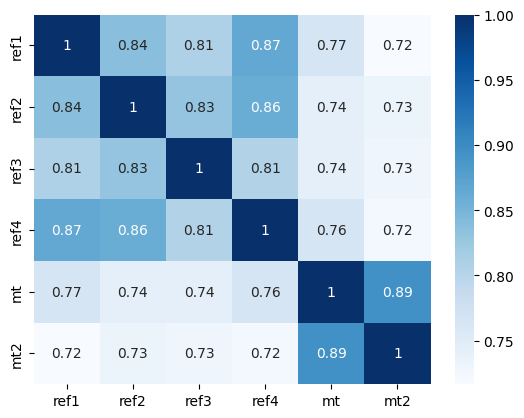

SL_75
src
5.5762344444241885
5.474223342002128
ref1
3.8192492339005772
3.7625514861250613
ref2
3.945628162316025
3.8821914196808702
ref3
4.011630777736566
3.9296639716793007
ref4
3.7572112636716706
3.6433012037303527
mt
4.048079459223321
3.989986692928212
mt2
4.04389148236062
3.9576111566473022
            ref1_SL_75  ref2_SL_75  ref3_SL_75  ref4_SL_75  mt_SL_75  \
ref1_SL_75    1.000000    0.843193    0.811646    0.869312  0.762399   
ref2_SL_75    0.843193    1.000000    0.834812    0.875342  0.749345   
ref3_SL_75    0.811646    0.834812    1.000000    0.816322  0.739397   
ref4_SL_75    0.869312    0.875342    0.816322    1.000000  0.762651   
mt_SL_75      0.762399    0.749345    0.739397    0.762651  1.000000   
mt2_SL_75     0.715634    0.737553    0.725010    0.725678  0.905013   

            mt2_SL_75  
ref1_SL_75   0.715634  
ref2_SL_75   0.737553  
ref3_SL_75   0.725010  
ref4_SL_75   0.725678  
mt_SL_75     0.905013  
mt2_SL_75    1.000000  


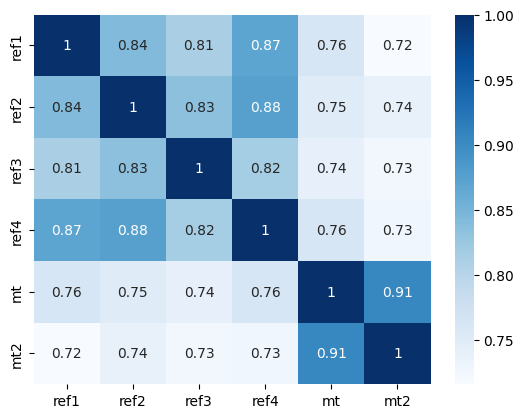

SL_100
src
10.359164788583737
10.123614579255745
ref1
6.476680965324111
6.303775635338418
ref2
6.7369550107732765
6.544689022780706
ref3
6.886576959292068
6.651236912957392
ref4
6.345603753226437
6.079948220608963
mt
6.959374224530754
6.735877874455657
mt2
6.973958041170644
6.724049662002454
             ref1_SL_100  ref2_SL_100  ref3_SL_100  ref4_SL_100  mt_SL_100  \
ref1_SL_100     1.000000     0.845760     0.814005     0.871580   0.759867   
ref2_SL_100     0.845760     1.000000     0.840224     0.886948   0.754851   
ref3_SL_100     0.814005     0.840224     1.000000     0.824631   0.739290   
ref4_SL_100     0.871580     0.886948     0.824631     1.000000   0.762270   
mt_SL_100       0.759867     0.754851     0.739290     0.762270   1.000000   
mt2_SL_100      0.715165     0.742419     0.721310     0.730047   0.912729   

             mt2_SL_100  
ref1_SL_100    0.715165  
ref2_SL_100    0.742419  
ref3_SL_100    0.721310  
ref4_SL_100    0.730047  
mt_SL_100      0.912729  
mt2_

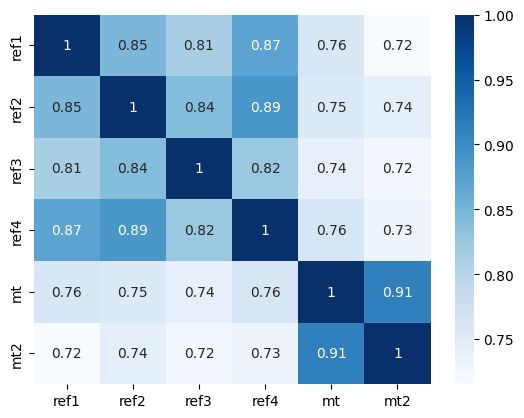

SL_125
src
19.634351008953868
18.984081758810827
ref1
11.32345929640117
10.901799012888823
ref2
11.839761084960244
11.280302968028735
ref3
12.165055007554269
11.550319527425222
ref4
11.051471965910105
10.466264725622791
mt
12.302527839144838
11.68440094321236
mt2
12.38739560369087
11.706990868668786
             ref1_SL_125  ref2_SL_125  ref3_SL_125  ref4_SL_125  mt_SL_125  \
ref1_SL_125     1.000000     0.846723     0.816399     0.872048   0.758093   
ref2_SL_125     0.846723     1.000000     0.845510     0.895348   0.760335   
ref3_SL_125     0.816399     0.845510     1.000000     0.830493   0.740763   
ref4_SL_125     0.872048     0.895348     0.830493     1.000000   0.762572   
mt_SL_125       0.758093     0.760335     0.740763     0.762572   1.000000   
mt2_SL_125      0.715135     0.748069     0.718497     0.734997   0.917548   

             mt2_SL_125  
ref1_SL_125    0.715135  
ref2_SL_125    0.748069  
ref3_SL_125    0.718497  
ref4_SL_125    0.734997  
mt_SL_125      0.91754

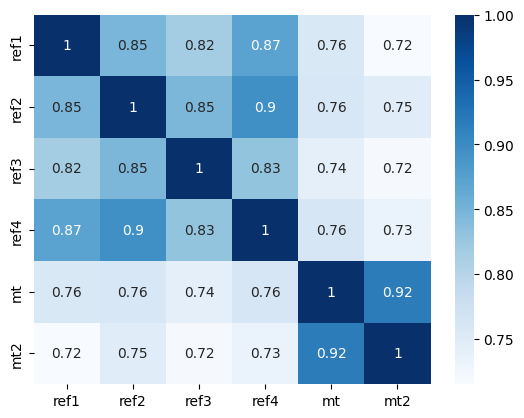

SL_150
src
37.92546190950008
36.245652911575796
ref1
20.364042462323145
19.16571170406519
ref2
21.37095556177003
20.010399278331782
ref3
22.061596601793653
20.66478158216409
ref4
19.80031211229316
18.43269411652011
mt
22.30890221734287
20.877405316485813
mt2
22.60643001749154
20.746971385894273
             ref1_SL_150  ref2_SL_150  ref3_SL_150  ref4_SL_150  mt_SL_150  \
ref1_SL_150     1.000000     0.846714     0.819086     0.870890   0.757339   
ref2_SL_150     0.846714     1.000000     0.850309     0.900630   0.765723   
ref3_SL_150     0.819086     0.850309     1.000000     0.833920   0.742993   
ref4_SL_150     0.870890     0.900630     0.833920     1.000000   0.763020   
mt_SL_150       0.757339     0.765723     0.742993     0.763020   1.000000   
mt2_SL_150      0.715597     0.754903     0.716341     0.740557   0.919397   

             mt2_SL_150  
ref1_SL_150    0.715597  
ref2_SL_150    0.754903  
ref3_SL_150    0.716341  
ref4_SL_150    0.740557  
mt_SL_150      0.919397  
m

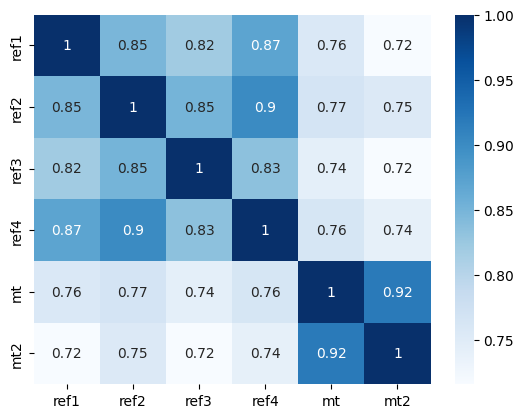

SL_175
src
74.59367553068095
71.2767390568266
ref1
37.61177211831632
34.744035978969535
ref2
39.56394332894807
36.06071943761466
ref3
41.00758857245082
37.58901876284682
ref4
36.43460404568717
32.62959607494365
mt
41.42670423445181
37.188275953628406
mt2
42.31333413837638
37.959499715724874
             ref1_SL_175  ref2_SL_175  ref3_SL_175  ref4_SL_175  mt_SL_175  \
ref1_SL_175     1.000000     0.846110     0.822016     0.868431   0.757754   
ref2_SL_175     0.846110     1.000000     0.854300     0.903037   0.771055   
ref3_SL_175     0.822016     0.854300     1.000000     0.835220   0.745463   
ref4_SL_175     0.868431     0.903037     0.835220     1.000000   0.763601   
mt_SL_175       0.757754     0.771055     0.745463     0.763601   1.000000   
mt2_SL_175      0.716602     0.762820     0.714750     0.746701   0.918387   

             mt2_SL_175  
ref1_SL_175    0.716602  
ref2_SL_175    0.762820  
ref3_SL_175    0.714750  
ref4_SL_175    0.746701  
mt_SL_175      0.918387  
mt2_S

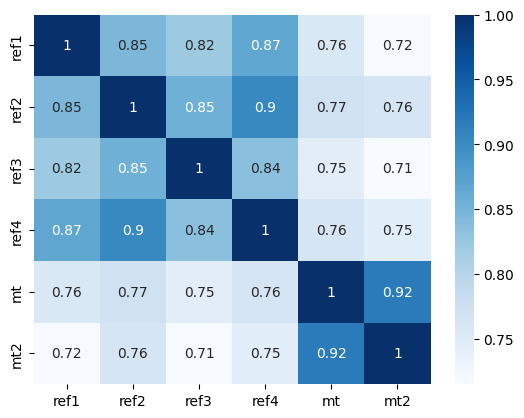

SL_200
src
149.29007454484417
140.79844066957907
ref1
71.25489665833963
64.40326412276451
ref2
75.0430755197614
66.99780093590928
ref3
78.02606988251189
69.56436850322116
ref4
68.76583126690387
59.388027753602216
mt
78.66933097924795
68.99505431720215
mt2
81.11803507294078
69.80006654686534
             ref1_SL_200  ref2_SL_200  ref3_SL_200  ref4_SL_200  mt_SL_200  \
ref1_SL_200     1.000000     0.845211     0.824963     0.865051   0.759321   
ref2_SL_200     0.845211     1.000000     0.857280     0.903072   0.776406   
ref3_SL_200     0.824963     0.857280     1.000000     0.834846   0.747862   
ref4_SL_200     0.865051     0.903072     0.834846     1.000000   0.764615   
mt_SL_200       0.759321     0.776406     0.747862     0.764615   1.000000   
mt2_SL_200      0.718104     0.771397     0.713711     0.753265   0.914824   

             mt2_SL_200  
ref1_SL_200    0.718104  
ref2_SL_200    0.771397  
ref3_SL_200    0.713711  
ref4_SL_200    0.753265  
mt_SL_200      0.914824  
mt2_S

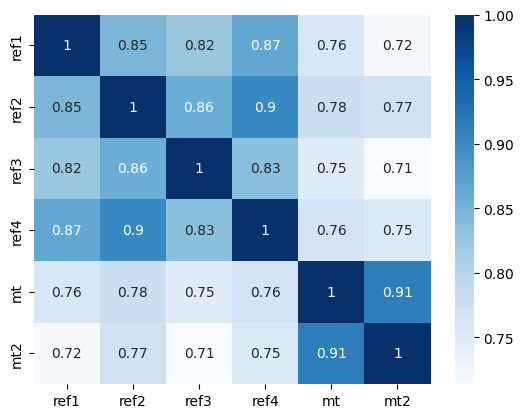

SL_225
src
303.8405857924159
280.9173422693609
ref1
138.3063781208348
120.3369864179677
ref2
145.6957793999782
124.51882461447997
ref3
151.8012506890692
131.45556637338197
ref4
132.96040719338083
112.1410019135586
mt
152.5879183978382
130.09641698030532
mt2
159.08519909796496
133.15947836122643
             ref1_SL_225  ref2_SL_225  ref3_SL_225  ref4_SL_225  mt_SL_225  \
ref1_SL_225     1.000000     0.844241     0.827583     0.861101   0.761827   
ref2_SL_225     0.844241     1.000000     0.859190     0.901441   0.781826   
ref3_SL_225     0.827583     0.859190     1.000000     0.833268   0.749972   
ref4_SL_225     0.861101     0.901441     0.833268     1.000000   0.766470   
mt_SL_225       0.761827     0.781826     0.749972     0.766470   1.000000   
mt2_SL_225      0.719923     0.780057     0.713190     0.760019   0.909175   

             mt2_SL_225  
ref1_SL_225    0.719923  
ref2_SL_225    0.780057  
ref3_SL_225    0.713190  
ref4_SL_225    0.760019  
mt_SL_225      0.909175  
m

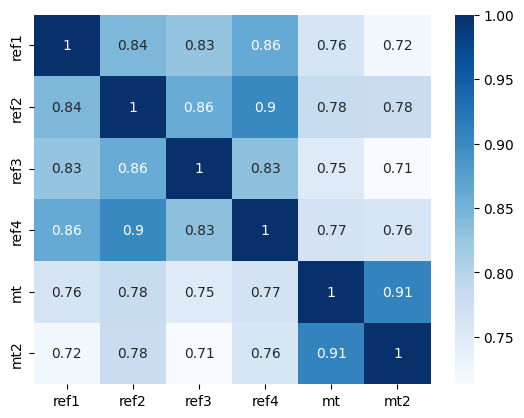

SL_250
src
628.4544909090951
577.7790438817206
ref1
274.73477880429243
228.93346880184012
ref2
289.26172363943715
235.4492468849307
ref3
301.6513376343589
255.4011935590466
ref4
263.04923538631783
213.3343959693199
mt
301.9311555382658
245.34534235655784
mt2
318.80027332941495
254.9049728011867
             ref1_SL_250  ref2_SL_250  ref3_SL_250  ref4_SL_250  mt_SL_250  \
ref1_SL_250     1.000000     0.843316     0.829465     0.856828   0.764881   
ref2_SL_250     0.843316     1.000000     0.860094     0.898908   0.787306   
ref3_SL_250     0.829465     0.860094     1.000000     0.830875   0.751594   
ref4_SL_250     0.856828     0.898908     0.830875     1.000000   0.769534   
mt_SL_250       0.764881     0.787306     0.751594     0.769534   1.000000   
mt2_SL_250      0.721762     0.788231     0.713060     0.766762   0.902027   

             mt2_SL_250  
ref1_SL_250    0.721762  
ref2_SL_250    0.788231  
ref3_SL_250    0.713060  
ref4_SL_250    0.766762  
mt_SL_250      0.902027  
m

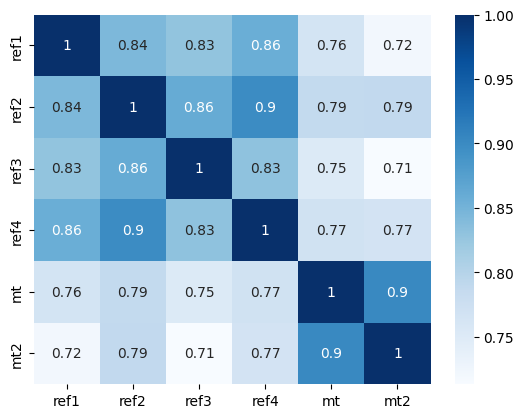

SL_275
src
1320.1522165503627
1219.778984730092
ref1
557.8500973231694
447.0471893122584
ref2
586.6636542947049
452.4681560203342
ref3
611.5934914129581
497.7496668267205
ref4
531.8267097069627
403.7003624611471
mt
608.7617534074363
486.1368574813887
mt2
652.0626852965453
504.7593393828241
             ref1_SL_275  ref2_SL_275  ref3_SL_275  ref4_SL_275  mt_SL_275  \
ref1_SL_275     1.000000     0.842433     0.830179     0.852341   0.767984   
ref2_SL_275     0.842433     1.000000     0.860124     0.896153   0.792774   
ref3_SL_275     0.830179     0.860124     1.000000     0.827906   0.752508   
ref4_SL_275     0.852341     0.896153     0.827906     1.000000   0.774041   
mt_SL_275       0.767984     0.792774     0.752508     0.774041   1.000000   
mt2_SL_275      0.723255     0.795453     0.713071     0.773384   0.894026   

             mt2_SL_275  
ref1_SL_275    0.723255  
ref2_SL_275    0.795453  
ref3_SL_275    0.713071  
ref4_SL_275    0.773384  
mt_SL_275      0.894026  
mt2_SL

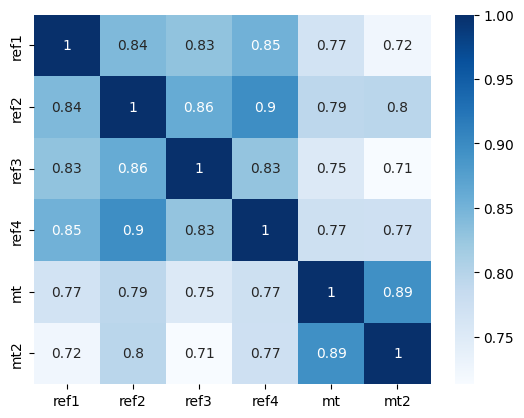

SL_300
src
2814.3535145845594
2540.753413906092
ref1
1156.4321818469168
894.3981895506973
ref2
1214.0724976731785
878.8530596354603
ref3
1263.7841135483982
973.8753680216823
ref4
1097.3667629151025
797.4167137265249
mt
1249.126031524079
970.1334104140686
mt2
1359.680282249903
975.7897972478445
             ref1_SL_300  ref2_SL_300  ref3_SL_300  ref4_SL_300  mt_SL_300  \
ref1_SL_300     1.000000     0.841489     0.829342     0.847607   0.770613   
ref2_SL_300     0.841489     1.000000     0.859426     0.893665   0.798112   
ref3_SL_300     0.829342     0.859426     1.000000     0.824430   0.752465   
ref4_SL_300     0.847607     0.893665     0.824430     1.000000   0.780060   
mt_SL_300       0.770613     0.798112     0.752465     0.780060   1.000000   
mt2_SL_300      0.724027     0.801415     0.712861     0.779875   0.885819   

             mt2_SL_300  
ref1_SL_300    0.724027  
ref2_SL_300    0.801415  
ref3_SL_300    0.712861  
ref4_SL_300    0.779875  
mt_SL_300      0.885819  
mt

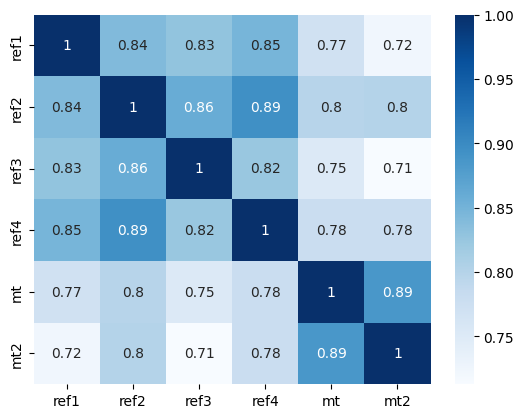

SL_325
src
6084.052939199673
5462.138856697426
ref1
2444.405142331385
1787.2993712008188
ref2
2560.4909299203423
1751.1703268331203
ref3
2658.6022140712826
1950.8496741685694
ref4
2307.796879721442
1560.1466743734125
mt
2605.2296040955403
1934.2722130795596
mt2
2886.9905143975075
1982.5497183826976
             ref1_SL_325  ref2_SL_325  ref3_SL_325  ref4_SL_325  mt_SL_325  \
ref1_SL_325     1.000000     0.840330     0.826666     0.842491   0.772321   
ref2_SL_325     0.840330     1.000000     0.858114     0.891702   0.803175   
ref3_SL_325     0.826666     0.858114     1.000000     0.820364   0.751205   
ref4_SL_325     0.842491     0.891702     0.820364     1.000000   0.787511   
mt_SL_325       0.772321     0.803175     0.751205     0.787511   1.000000   
mt2_SL_325      0.723767     0.805952     0.712013     0.786309   0.877996   

             mt2_SL_325  
ref1_SL_325    0.723767  
ref2_SL_325    0.805952  
ref3_SL_325    0.712013  
ref4_SL_325    0.786309  
mt_SL_325      0.877996

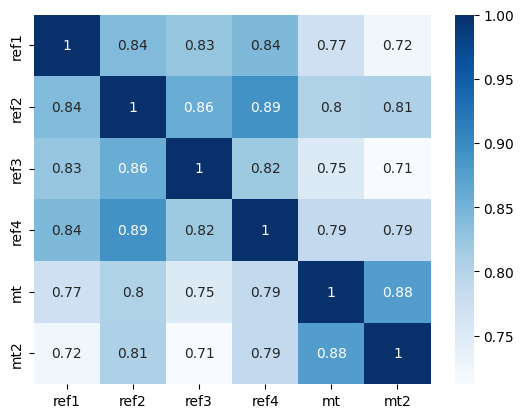

SL_350
src
13326.018221127724
11692.845168165546
ref1
5261.698171357089
3626.0667945439727
ref2
5496.279634341913
3541.3211161204977
ref3
5687.520139416131
3962.42079537045
ref4
4939.947013686172
3160.4867846665547
mt
5516.089835127257
3895.647021998997
mt2
6234.397173629029
4049.063870172906
             ref1_SL_350  ref2_SL_350  ref3_SL_350  ref4_SL_350  mt_SL_350  \
ref1_SL_350     1.000000     0.838802     0.821999     0.836810   0.772791   
ref2_SL_350     0.838802     1.000000     0.856250     0.890303   0.807815   
ref3_SL_350     0.821999     0.856250     1.000000     0.815523   0.748487   
ref4_SL_350     0.836810     0.890303     0.815523     1.000000   0.796201   
mt_SL_350       0.772791     0.807815     0.748487     0.796201   1.000000   
mt2_SL_350      0.722268     0.809023     0.710108     0.792800   0.871054   

             mt2_SL_350  
ref1_SL_350    0.722268  
ref2_SL_350    0.809023  
ref3_SL_350    0.710108  
ref4_SL_350    0.792800  
mt_SL_350      0.871054  
mt2

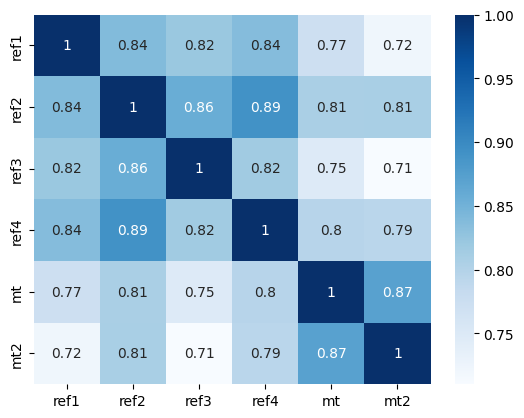

SL_375
src
29547.541988410783
25794.64486383465
ref1
11519.63932213089
7339.586003698364
ref2
11992.809845543945
7182.329850543241
ref3
12359.773261701679
8138.353200621954
ref4
10748.667985273358
6249.090588310494
mt
11842.460958066502
7899.48926051451
mt2
13676.2672287071
8295.967283159596
             ref1_SL_375  ref2_SL_375  ref3_SL_375  ref4_SL_375  mt_SL_375  \
ref1_SL_375     1.000000     0.836780     0.815325     0.830386   0.771854   
ref2_SL_375     0.836780     1.000000     0.853843     0.889337   0.811886   
ref3_SL_375     0.815325     0.853843     1.000000     0.809678   0.744112   
ref4_SL_375     0.830386     0.889337     0.809678     1.000000   0.805862   
mt_SL_375       0.771854     0.811886     0.744112     0.805862   1.000000   
mt2_SL_375      0.719437     0.810662     0.706779     0.799464   0.865376   

             mt2_SL_375  
ref1_SL_375    0.719437  
ref2_SL_375    0.810662  
ref3_SL_375    0.706779  
ref4_SL_375    0.799464  
mt_SL_375      0.865376  
mt2_

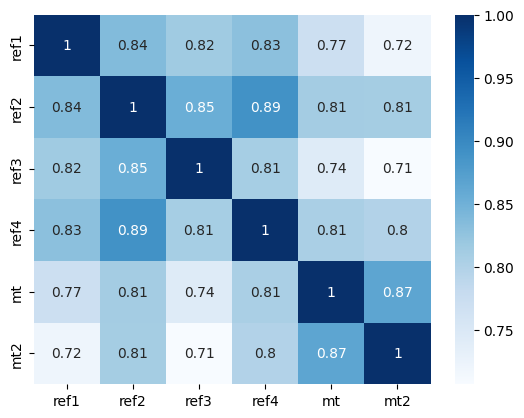

SL_400
src
66263.42583599311
56824.85462524026
ref1
25620.929587700244
15025.972374773759
ref2
26566.36345897357
14723.69905204291
ref3
27256.122710638883
16764.50455388567
ref4
23743.77772831652
12865.716081336108
mt
25750.367719832502
16144.936656878917
mt2
30441.17926235139
16981.46877467956
             ref1_SL_400  ref2_SL_400  ref3_SL_400  ref4_SL_400  mt_SL_400  \
ref1_SL_400     1.000000     0.834188     0.806748     0.823085   0.769464   
ref2_SL_400     0.834188     1.000000     0.850861     0.888569   0.815253   
ref3_SL_400     0.806748     0.850861     1.000000     0.802616   0.737935   
ref4_SL_400     0.823085     0.888569     0.802616     1.000000   0.816194   
mt_SL_400       0.769464     0.815253     0.737935     0.816194   1.000000   
mt2_SL_400      0.715282     0.810944     0.701752     0.806388   0.861220   

             mt2_SL_400  
ref1_SL_400    0.715282  
ref2_SL_400    0.810944  
ref3_SL_400    0.701752  
ref4_SL_400    0.806388  
mt_SL_400      0.861220  
m

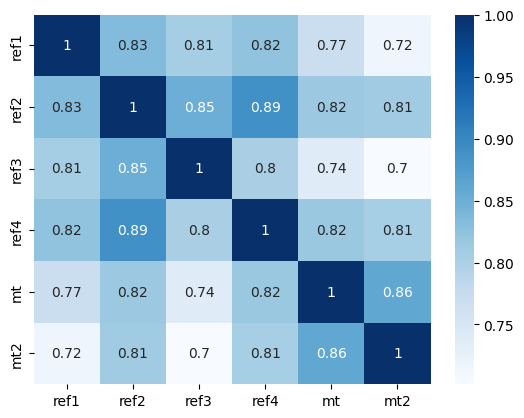

SL_425
src
150170.28195142408
126458.59758375768
ref1
57823.82179440582
30915.427616697452
ref2
59673.471989384976
30585.208065110695
ref3
60933.74670867295
34913.99017365696
ref4
53186.11291633082
27002.185736126474
mt
56649.42875311947
33474.0948015614
mt2
68674.31381714108
34026.85992226092
             ref1_SL_425  ref2_SL_425  ref3_SL_425  ref4_SL_425  mt_SL_425  \
ref1_SL_425     1.000000     0.830992     0.796453     0.814830   0.765654   
ref2_SL_425     0.830992     1.000000     0.847250     0.887721   0.817790   
ref3_SL_425     0.796453     0.847250     1.000000     0.794176   0.729875   
ref4_SL_425     0.814830     0.887721     0.794176     1.000000   0.826886   
mt_SL_425       0.765654     0.817790     0.729875     0.826886   1.000000   
mt2_SL_425      0.709870     0.809962     0.694859     0.813608   0.858718   

             mt2_SL_425  
ref1_SL_425    0.709870  
ref2_SL_425    0.809962  
ref3_SL_425    0.694859  
ref4_SL_425    0.813608  
mt_SL_425      0.858718  
mt

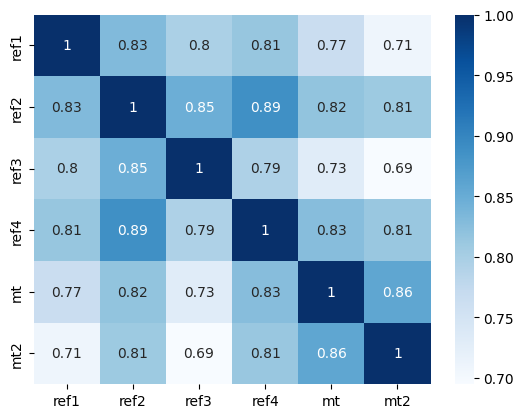

SL_450
src
343632.9097266221
283095.18838540884
ref1
132288.2421869431
64087.673679893756
ref2
135763.532249471
64218.98813036413
ref3
137973.79216787784
73203.18666665687
ref4
120678.65862848372
55386.69208549357
mt
125967.25885813453
69773.19514790569
mt2
156859.80005305822
69639.21426609793
             ref1_SL_450  ref2_SL_450  ref3_SL_450  ref4_SL_450  mt_SL_450  \
ref1_SL_450     1.000000     0.827190     0.784668     0.805600   0.760489   
ref2_SL_450     0.827190     1.000000     0.842956     0.886523   0.819385   
ref3_SL_450     0.784668     0.842956     1.000000     0.784271   0.719910   
ref4_SL_450     0.805600     0.886523     0.784271     1.000000   0.837643   
mt_SL_450       0.760489     0.819385     0.719910     0.837643   1.000000   
mt2_SL_450      0.703299     0.807803     0.686031     0.821106   0.857890   

             mt2_SL_450  
ref1_SL_450    0.703299  
ref2_SL_450    0.807803  
ref3_SL_450    0.686031  
ref4_SL_450    0.821106  
mt_SL_450      0.857890  
mt

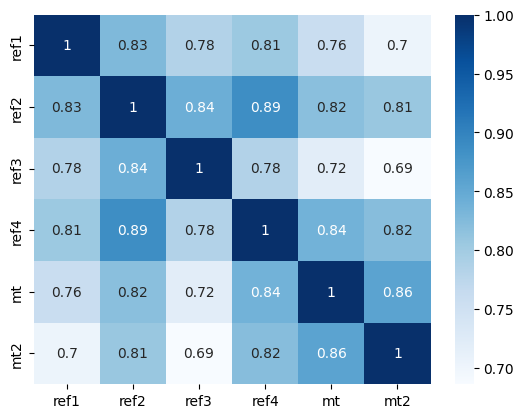

SL_475
src
793365.4482151263
640119.8046014623
ref1
306491.93830447627
133854.3859138225
ref2
312530.4435570951
134105.4181262378
ref3
316167.2951202878
154489.11714462723
ref4
277088.342605364
115058.52153318147
mt
282872.8645551401
147136.33680998057
mt2
362401.4071607664
144728.4184738006
             ref1_SL_475  ref2_SL_475  ref3_SL_475  ref4_SL_475  mt_SL_475  \
ref1_SL_475     1.000000     0.822806     0.771628     0.795420   0.754043   
ref2_SL_475     0.822806     1.000000     0.837934     0.884747   0.819939   
ref3_SL_475     0.771628     0.837934     1.000000     0.772889   0.708076   
ref4_SL_475     0.795420     0.884747     0.772889     1.000000   0.848200   
mt_SL_475       0.754043     0.819939     0.708076     0.848200   1.000000   
mt2_SL_475      0.695668     0.804547     0.675293     0.828818   0.858662   

             mt2_SL_475  
ref1_SL_475    0.695668  
ref2_SL_475    0.804547  
ref3_SL_475    0.675293  
ref4_SL_475    0.828818  
mt_SL_475      0.858662  
mt2_

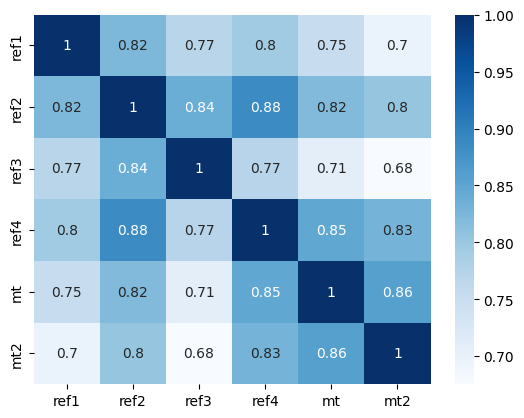

SL_500
src
1846781.7383113564
1440687.6995618176
ref1
718477.4981376396
283017.8212401946
ref2
727285.0091139221
282468.1664841488
ref3
732633.8448470508
324593.9639561642
ref4
643239.9331657458
243062.36395099622
mt
641002.2814413718
310787.563186555
mt2
846131.2706130453
302933.3239423289
             ref1_SL_500  ref2_SL_500  ref3_SL_500  ref4_SL_500  mt_SL_500  \
ref1_SL_500     1.000000     0.817872     0.757557     0.784347   0.746382   
ref2_SL_500     0.817872     1.000000     0.832161     0.882222   0.819371   
ref3_SL_500     0.757557     0.832161     1.000000     0.760082   0.694458   
ref4_SL_500     0.784347     0.882222     0.760082     1.000000   0.858328   
mt_SL_500       0.746382     0.819371     0.694458     0.858328   1.000000   
mt2_SL_500      0.687067     0.800262     0.662736     0.836643   0.860881   

             mt2_SL_500  
ref1_SL_500    0.687067  
ref2_SL_500    0.800262  
ref3_SL_500    0.662736  
ref4_SL_500    0.836643  
mt_SL_500      0.860881  
mt2_S

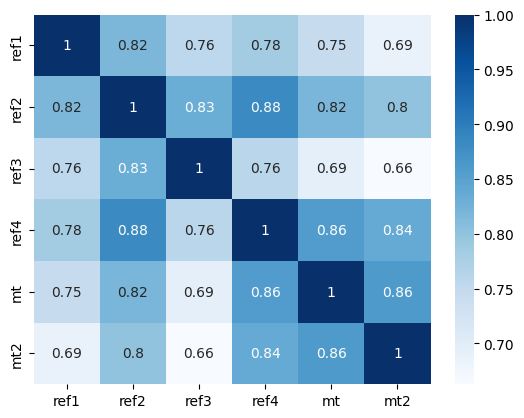

SL_525
src
4331606.646061756
3141367.4417431457
ref1
1702727.7632155283
600542.9648256282
ref2
1709443.8810761317
599084.5670288281
ref3
1715551.6642534672
688236.4779823339
ref4
1508489.661730699
516975.5269434114
mt
1464756.312188894
660264.6930486585
mt2
1994785.1315271468
631196.1219571246
             ref1_SL_525  ref2_SL_525  ref3_SL_525  ref4_SL_525  mt_SL_525  \
ref1_SL_525     1.000000     0.812430     0.742656     0.772454   0.737568   
ref2_SL_525     0.812430     1.000000     0.825634     0.878833   0.817624   
ref3_SL_525     0.742656     0.825634     1.000000     0.745954   0.679182   
ref4_SL_525     0.772454     0.878833     0.745954     1.000000   0.867846   
mt_SL_525       0.737568     0.817624     0.679182     0.867846   1.000000   
mt2_SL_525      0.677575     0.795005     0.648509     0.844466   0.864345   

             mt2_SL_525  
ref1_SL_525    0.677575  
ref2_SL_525    0.795005  
ref3_SL_525    0.648509  
ref4_SL_525    0.844466  
mt_SL_525      0.864345  
mt

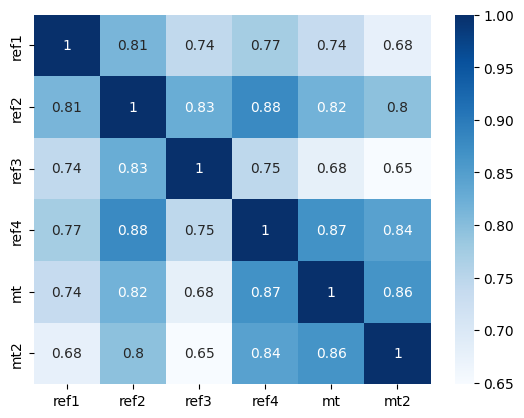

SL_550
src
10231354.187866237
7329958.645473514
ref1
4076444.456044297
1270582.5216511744
ref2
4055209.0324470955
1277009.6531988496
ref3
4056862.2869255533
1457643.8808953147
ref4
3571131.2777768564
1101280.1839771175
mt
3373243.55944444
1397445.7603631518
mt2
4745003.357160566
1368064.1139596323
             ref1_SL_550  ref2_SL_550  ref3_SL_550  ref4_SL_550  mt_SL_550  \
ref1_SL_550     1.000000     0.806524     0.727096     0.759827   0.727659   
ref2_SL_550     0.806524     1.000000     0.818372     0.874519   0.814667   
ref3_SL_550     0.727096     0.818372     1.000000     0.730640   0.662411   
ref4_SL_550     0.759827     0.874519     0.730640     1.000000   0.876621   
mt_SL_550       0.727659     0.814667     0.662411     0.876621   1.000000   
mt2_SL_550      0.667262     0.788827     0.632793     0.852166   0.868823   

             mt2_SL_550  
ref1_SL_550    0.667262  
ref2_SL_550    0.788827  
ref3_SL_550    0.632793  
ref4_SL_550    0.852166  
mt_SL_550      0.868823 

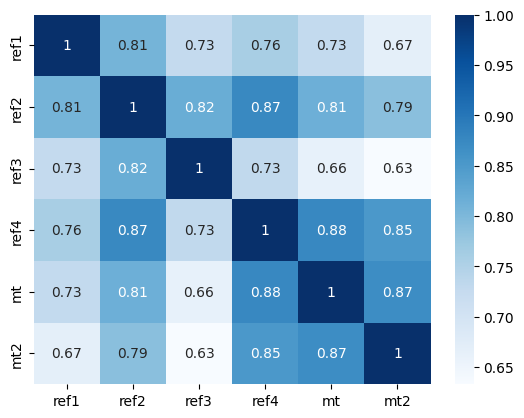

SL_575
src
24325330.39833967
16966711.067660846
ref1
9851658.739627449
2675985.906653228
ref2
9702446.085245902
2685803.774688543
ref3
9682584.920062566
3172849.0830101715
ref4
8528454.626958733
2347602.53664083
mt
7824877.049086473
3005641.229100312
mt2
11380438.659073114
2930432.0715201925
             ref1_SL_575  ref2_SL_575  ref3_SL_575  ref4_SL_575  mt_SL_575  \
ref1_SL_575     1.000000     0.800197     0.711026     0.746550   0.716721   
ref2_SL_575     0.800197     1.000000     0.810408     0.869261   0.810498   
ref3_SL_575     0.711026     0.810408     1.000000     0.714293   0.644333   
ref4_SL_575     0.746550     0.869261     0.714293     1.000000   0.884567   
mt_SL_575       0.716721     0.810498     0.644333     0.884567   1.000000   
mt2_SL_575      0.656192     0.781779     0.615791     0.859632   0.874077   

             mt2_SL_575  
ref1_SL_575    0.656192  
ref2_SL_575    0.781779  
ref3_SL_575    0.615791  
ref4_SL_575    0.859632  
mt_SL_575      0.874077  
mt2_

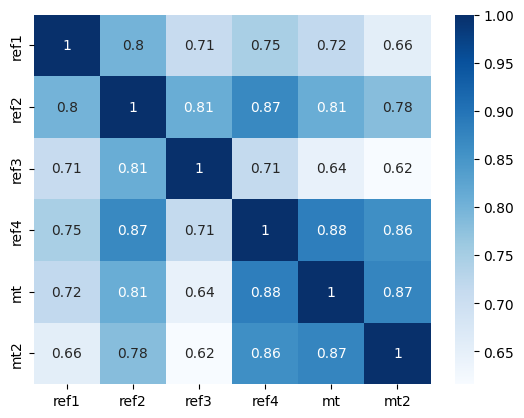

SL_600
src
58189712.87790054
39214596.580572255
ref1
24017826.08922081
5638705.736567018
ref2
23398440.17070161
5669522.863678746
ref3
23311510.744292025
6769876.220866388
ref4
20533640.56532702
4919105.07766491
mt
18274830.877212077
6498810.605428619
mt2
27503609.468142994
6180493.832538404
             ref1_SL_600  ref2_SL_600  ref3_SL_600  ref4_SL_600  mt_SL_600  \
ref1_SL_600     1.000000     0.793496     0.694568     0.732708   0.704831   
ref2_SL_600     0.793496     1.000000     0.801786     0.863074   0.805139   
ref3_SL_600     0.694568     0.801786     1.000000     0.697076   0.625152   
ref4_SL_600     0.732708     0.863074     0.697076     1.000000   0.891640   
mt_SL_600       0.704831     0.805139     0.625152     0.891640   1.000000   
mt2_SL_600      0.644432     0.773911     0.597717     0.866767   0.879879   

             mt2_SL_600  
ref1_SL_600    0.644432  
ref2_SL_600    0.773911  
ref3_SL_600    0.597717  
ref4_SL_600    0.866767  
mt_SL_600      0.879879  
mt2_

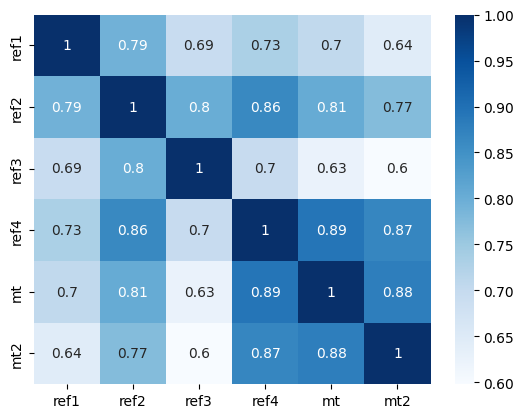

SL_625
src
140004729.32922277
89386250.1037006
ref1
59030285.78432023
12061854.66272157
ref2
56843510.271152586
12224470.867354529
ref3
56585662.71357138
14433495.397381272
ref4
49812935.321184814
10504230.019818185
mt
42953339.43724827
13908291.707759969
mt2
66938860.97597661
13013376.251337351
             ref1_SL_625  ref2_SL_625  ref3_SL_625  ref4_SL_625  mt_SL_625  \
ref1_SL_625     1.000000     0.786463     0.677827     0.718380   0.692075   
ref2_SL_625     0.786463     1.000000     0.792556     0.855993   0.798639   
ref3_SL_625     0.677827     0.792556     1.000000     0.679149   0.605077   
ref4_SL_625     0.718380     0.855993     0.679149     1.000000   0.897836   
mt_SL_625       0.692075     0.798639     0.605077     0.897836   1.000000   
mt2_SL_625      0.632049     0.765275     0.578782     0.873500   0.886020   

             mt2_SL_625  
ref1_SL_625    0.632049  
ref2_SL_625    0.765275  
ref3_SL_625    0.578782  
ref4_SL_625    0.873500  
mt_SL_625      0.886020  


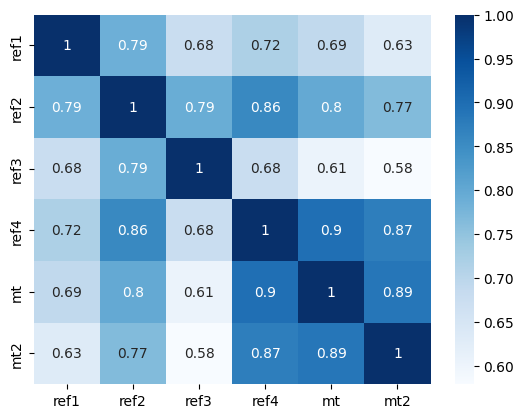

SL_650
src
338703171.3009422
210335993.3140239
ref1
146172976.6584724
25568635.220926136
ref2
139037790.0960534
25935178.164041862
ref3
138417454.12096485
31033365.970226772
ref4
121692788.60830869
22510147.35346413
mt
101566166.10095777
29749964.402143635
mt2
163981864.48365492
27827758.65874009
             ref1_SL_650  ref2_SL_650  ref3_SL_650  ref4_SL_650  mt_SL_650  \
ref1_SL_650     1.000000     0.779142     0.660890     0.703641   0.678549   
ref2_SL_650     0.779142     1.000000     0.782773     0.848068   0.791064   
ref3_SL_650     0.660890     0.782773     1.000000     0.660666   0.584316   
ref4_SL_650     0.703641     0.848068     0.660666     1.000000   0.903176   
mt_SL_650       0.678549     0.791064     0.584316     0.903176   1.000000   
mt2_SL_650      0.619114     0.755926     0.559192     0.879775   0.892320   

             mt2_SL_650  
ref1_SL_650    0.619114  
ref2_SL_650    0.755926  
ref3_SL_650    0.559192  
ref4_SL_650    0.879775  
mt_SL_650      0.892320  

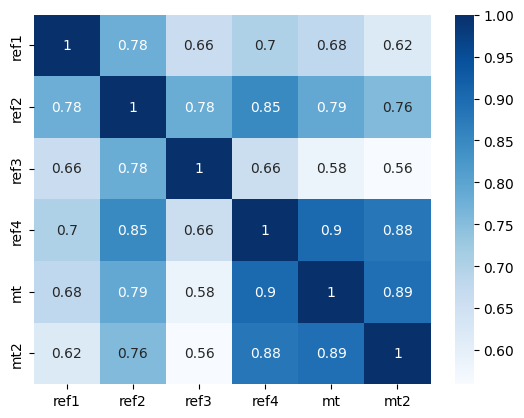

SL_675
src
823697155.0790491
502847016.137499
ref1
364466373.0603604
55103212.245599024
ref2
342238347.71085376
55168070.08751185
ref3
341056351.3769734
66918554.42793825
ref4
299236305.2090035
48323810.55986026
mt
241527233.86589065
63584159.97321676
mt2
404140347.5050623
58817206.96181625
             ref1_SL_675  ref2_SL_675  ref3_SL_675  ref4_SL_675  mt_SL_675  \
ref1_SL_675     1.000000     0.771573     0.643832     0.688560   0.664356   
ref2_SL_675     0.771573     1.000000     0.772487     0.839360   0.782493   
ref3_SL_675     0.643832     0.772487     1.000000     0.641773   0.563067   
ref4_SL_675     0.688560     0.839360     0.641773     1.000000   0.907708   
mt_SL_675       0.664356     0.782493     0.563067     0.907708   1.000000   
mt2_SL_675      0.605702     0.745924     0.539140     0.885563   0.898631   

             mt2_SL_675  
ref1_SL_675    0.605702  
ref2_SL_675    0.745924  
ref3_SL_675    0.539140  
ref4_SL_675    0.885563  
mt_SL_675      0.898631  
mt2_S

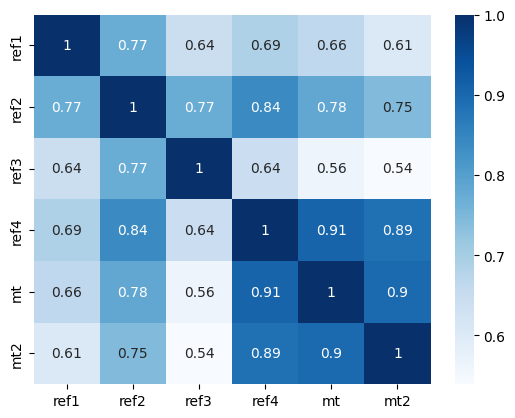

SL_700
src
2013245380.4490345
1189849287.2139273
ref1
914546694.8387046
118478177.31050672
ref2
847360500.5838172
118483151.86968598
ref3
846104605.0383937
144622517.51947427
ref4
740258320.6327673
103609129.39992996
mt
577453325.3468091
136191973.527882
mt2
1001600841.1712052
124357160.15293667
             ref1_SL_700  ref2_SL_700  ref3_SL_700  ref4_SL_700  mt_SL_700  \
ref1_SL_700     1.000000     0.763795     0.626719     0.673203   0.649601   
ref2_SL_700     0.763795     1.000000     0.761751     0.829929   0.773017   
ref3_SL_700     0.626719     0.761751     1.000000     0.622602   0.541518   
ref4_SL_700     0.673203     0.829929     0.622602     1.000000   0.911490   
mt_SL_700       0.649601     0.773017     0.541518     0.911490   1.000000   
mt2_SL_700      0.591887     0.735329     0.518806     0.890848   0.904836   

             mt2_SL_700  
ref1_SL_700    0.591887  
ref2_SL_700    0.735329  
ref3_SL_700    0.518806  
ref4_SL_700    0.890848  
mt_SL_700      0.904836  


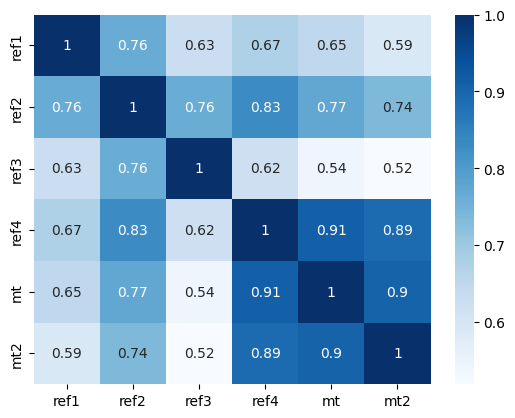

SL_725
src
4944587689.869408
2766777160.633936
ref1
2308261683.015235
257965817.99911684
ref2
2109423699.5702171
252607614.01666996
ref3
2112540289.9418933
313651605.4770957
ref4
1841519440.7645354
216691803.0495762
mt
1387650449.7368295
294497019.22801495
mt2
2495203436.7556696
263323114.72852045
             ref1_SL_725  ref2_SL_725  ref3_SL_725  ref4_SL_725  mt_SL_725  \
ref1_SL_725     1.000000     0.755844     0.609606     0.657628   0.634389   
ref2_SL_725     0.755844     1.000000     0.750613     0.819840   0.762728   
ref3_SL_725     0.609606     0.750613     1.000000     0.603276   0.519834   
ref4_SL_725     0.657628     0.819840     0.603276     1.000000   0.914591   
mt_SL_725       0.634389     0.762728     0.519834     0.914591   1.000000   
mt2_SL_725      0.577747     0.724202     0.498350     0.895632   0.910847   

             mt2_SL_725  
ref1_SL_725    0.577747  
ref2_SL_725    0.724202  
ref3_SL_725    0.498350  
ref4_SL_725    0.895632  
mt_SL_725      0.910847 

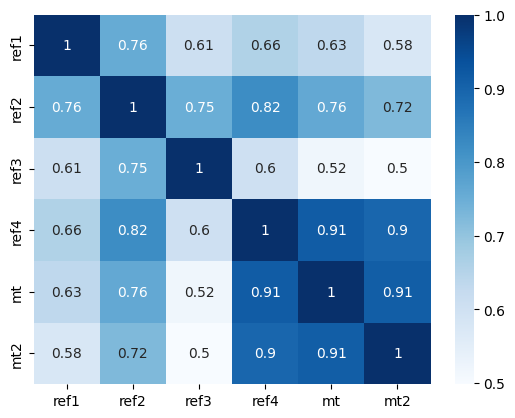

SL_750
src
12201196322.126482
6533701117.122557
ref1
5857074121.726467
560895673.6865907
ref2
5277632764.541573
536013465.72594976
ref3
5306370053.568307
680716669.9623306
ref4
4604777664.237286
459747194.3878803
mt
3350751276.8438444
639244527.2895625
mt2
6246013298.761232
568348665.8618487
             ref1_SL_750  ref2_SL_750  ref3_SL_750  ref4_SL_750  mt_SL_750  \
ref1_SL_750     1.000000     0.747757     0.592542     0.641891   0.618821   
ref2_SL_750     0.747757     1.000000     0.739116     0.809156   0.751720   
ref3_SL_750     0.592542     0.739116     1.000000     0.583904   0.498168   
ref4_SL_750     0.641891     0.809156     0.583904     1.000000   0.917083   
mt_SL_750       0.618821     0.751720     0.498168     0.917083   1.000000   
mt2_SL_750      0.563354     0.712606     0.477917     0.899926   0.916601   

             mt2_SL_750  
ref1_SL_750    0.563354  
ref2_SL_750    0.712606  
ref3_SL_750    0.477917  
ref4_SL_750    0.899926  
mt_SL_750      0.916601  
mt2_

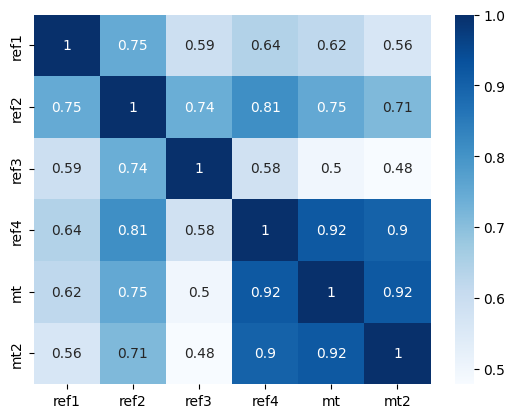

SL_775
src
30245243673.27781
15503724864.782127
ref1
14934548351.211737
1210862042.2209191
ref2
13265650639.696299
1149852385.1914558
ref3
13404119024.252214
1463747262.8063333
ref4
11569278476.0969
988516131.073498
mt
8128229179.125988
1389631363.635585
mt2
15704903679.916534
1221101489.097465
             ref1_SL_775  ref2_SL_775  ref3_SL_775  ref4_SL_775  mt_SL_775  \
ref1_SL_775     1.000000     0.739564     0.575571     0.626045   0.602992   
ref2_SL_775     0.739564     1.000000     0.727301     0.797938   0.740085   
ref3_SL_775     0.575571     0.727301     1.000000     0.564584   0.476648   
ref4_SL_775     0.626045     0.797938     0.564584     1.000000   0.919039   
mt_SL_775       0.602992     0.740085     0.476648     0.919039   1.000000   
mt2_SL_775      0.548780     0.700601     0.457630     0.903751   0.922057   

             mt2_SL_775  
ref1_SL_775    0.548780  
ref2_SL_775    0.700601  
ref3_SL_775    0.457630  
ref4_SL_775    0.903751  
mt_SL_775      0.922057  
m

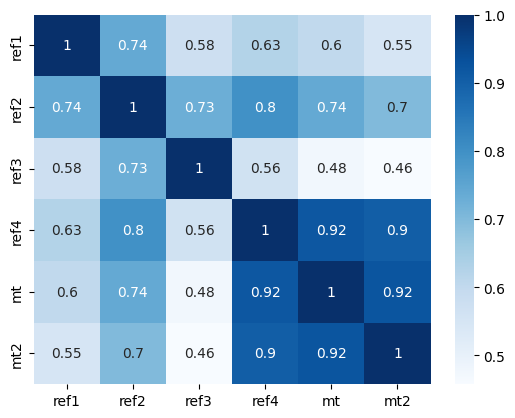

SL_800
src
75308449146.75627
37154119080.28433
ref1
38250045817.51337
2596202501.3760633
ref2
33487014370.454697
2470290146.187824
ref3
34038620993.677723
3141457937.611573
ref4
29194792027.082527
2098358821.3178854
mt
19803368648.614864
2999160930.134754
mt2
39651962235.64799
2600001220.225865
             ref1_SL_800  ref2_SL_800  ref3_SL_800  ref4_SL_800  mt_SL_800  \
ref1_SL_800     1.000000     0.731297     0.558730     0.610136   0.586990   
ref2_SL_800     0.731297     1.000000     0.715207     0.786243   0.727909   
ref3_SL_800     0.558730     0.715207     1.000000     0.545404   0.455388   
ref4_SL_800     0.610136     0.786243     0.545404     1.000000   0.920526   
mt_SL_800       0.586990     0.727909     0.455388     0.920526   1.000000   
mt2_SL_800      0.534092     0.688246     0.437599     0.907135   0.927192   

             mt2_SL_800  
ref1_SL_800    0.534092  
ref2_SL_800    0.688246  
ref3_SL_800    0.437599  
ref4_SL_800    0.907135  
mt_SL_800      0.927192  
m

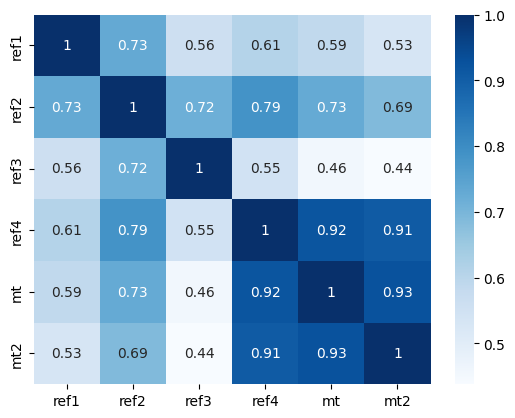

SL_825
src
188328461125.37543
88759479197.95065
ref1
98361880626.92546
5464627891.611612
ref2
84866646931.65735
5325305989.558522
ref3
86866348669.14868
6772430457.895308
ref4
73969463021.21542
4525421154.770063
mt
48447738355.10822
6408366528.640537
mt2
100499438554.53941
5524577494.649001
             ref1_SL_825  ref2_SL_825  ref3_SL_825  ref4_SL_825  mt_SL_825  \
ref1_SL_825     1.000000     0.722983     0.542053     0.594210   0.570894   
ref2_SL_825     0.722983     1.000000     0.702865     0.774127   0.715275   
ref3_SL_825     0.542053     0.702865     1.000000     0.526441   0.434483   
ref4_SL_825     0.594210     0.774127     0.526441     1.000000   0.921611   
mt_SL_825       0.570894     0.715275     0.434483     0.921611   1.000000   
mt2_SL_825      0.519354     0.675598     0.417914     0.910108   0.931996   

             mt2_SL_825  
ref1_SL_825    0.519354  
ref2_SL_825    0.675598  
ref3_SL_825    0.417914  
ref4_SL_825    0.910108  
mt_SL_825      0.931996  
mt2_S

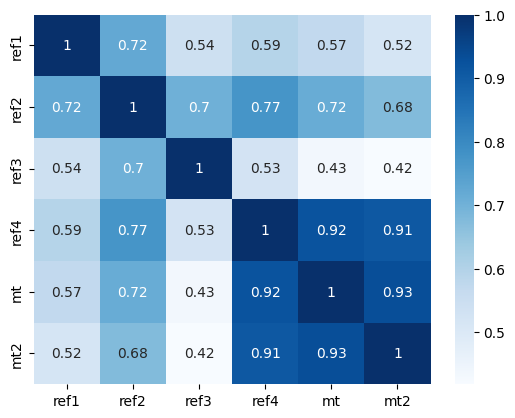

SL_850
src
472965874424.6596
209696852072.8994
ref1
253873168421.65555
11583159088.014942
ref2
215861021060.07806
11505747171.542843
ref3
222709379603.6153
14509243055.009556
ref4
188106620197.59662
9872645693.168856
mt
118988440696.00156
13705892894.823982
mt2
255631698140.94696
11927353603.49126
             ref1_SL_850  ref2_SL_850  ref3_SL_850  ref4_SL_850  mt_SL_850  \
ref1_SL_850     1.000000     0.714648     0.525569     0.578308   0.554777   
ref2_SL_850     0.714648     1.000000     0.690309     0.761643   0.702259   
ref3_SL_850     0.525569     0.690309     1.000000     0.507761   0.414011   
ref4_SL_850     0.578308     0.761643     0.507761     1.000000   0.922351   
mt_SL_850       0.554777     0.702259     0.414011     0.922351   1.000000   
mt2_SL_850      0.504621     0.662710     0.398652     0.912701   0.936470   

             mt2_SL_850  
ref1_SL_850    0.504621  
ref2_SL_850    0.662710  
ref3_SL_850    0.398652  
ref4_SL_850    0.912701  
mt_SL_850      0.936470 

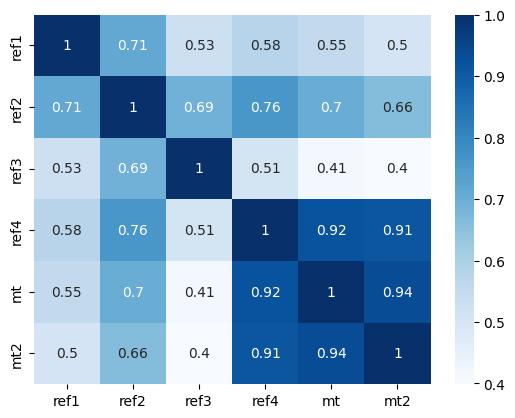

SL_875
src
1192729481778.0728
501307929419.6415
ref1
657438839740.822
24923689356.158012
ref2
550885255416.1051
24381070668.381912
ref3
573459448263.018
31357031240.95692
ref4
479983977296.9102
21548808347.5362
mt
293319981135.33887
29339444704.287094
mt2
652393701834.9005
25522226933.780388
             ref1_SL_875  ref2_SL_875  ref3_SL_875  ref4_SL_875  mt_SL_875  \
ref1_SL_875     1.000000     0.706317     0.509304     0.562468   0.538701   
ref2_SL_875     0.706317     1.000000     0.677566     0.748840   0.688932   
ref3_SL_875     0.509304     0.677566     1.000000     0.489423   0.394038   
ref4_SL_875     0.562468     0.748840     0.489423     1.000000   0.922800   
mt_SL_875       0.538701     0.688932     0.394038     0.922800   1.000000   
mt2_SL_875      0.489947     0.649633     0.379875     0.914947   0.940622   

             mt2_SL_875  
ref1_SL_875    0.489947  
ref2_SL_875    0.649633  
ref3_SL_875    0.379875  
ref4_SL_875    0.914947  
mt_SL_875      0.940622  
mt2_

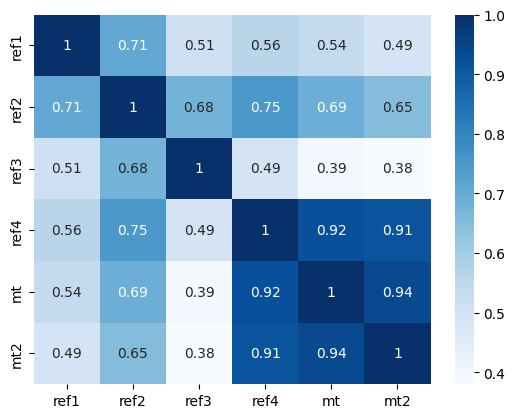

SL_900
src
3020011763176.6636
1193341285325.353
ref1
1707689262882.1523
53770643646.04331
ref2
1410197962524.101
52400034655.45645
ref3
1482595486472.9624
67772445356.173706
ref4
1228560907785.637
47053749934.13137
mt
725597848834.2911
62444418494.57413
mt2
1670126064213.1414
54659274506.59679
             ref1_SL_900  ref2_SL_900  ref3_SL_900  ref4_SL_900  mt_SL_900  \
ref1_SL_900     1.000000     0.698011     0.493282     0.546726   0.522723   
ref2_SL_900     0.698011     1.000000     0.664664     0.735764   0.675356   
ref3_SL_900     0.493282     0.664664     1.000000     0.471477   0.374615   
ref4_SL_900     0.546726     0.735764     0.471477     1.000000   0.923006   
mt_SL_900       0.522723     0.675356     0.374615     0.923006   1.000000   
mt2_SL_900      0.475378     0.636414     0.361634     0.916878   0.944465   

             mt2_SL_900  
ref1_SL_900    0.475378  
ref2_SL_900    0.636414  
ref3_SL_900    0.361634  
ref4_SL_900    0.916878  
mt_SL_900      0.944465  
mt

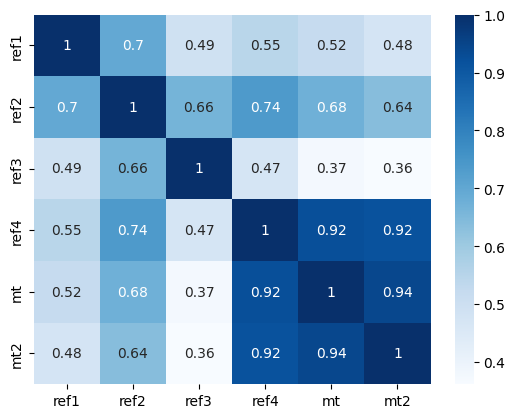

SL_925
src
7676878874728.81
2825871516031.6035
ref1
4447909686742.86
116442951817.07733
ref2
3620113071685.5635
112693356404.43356
ref3
3847559876719.2153
147070458739.69977
ref4
3153549407825.5933
102564941489.42957
mt
1800871185407.7212
131939658606.21977
mt2
4287869587716.0317
117164303207.50374
             ref1_SL_925  ref2_SL_925  ref3_SL_925  ref4_SL_925  mt_SL_925  \
ref1_SL_925     1.000000     0.689749     0.477521     0.531113   0.506890   
ref2_SL_925     0.689749     1.000000     0.651627     0.722460   0.661590   
ref3_SL_925     0.477521     0.651627     1.000000     0.453966   0.355783   
ref4_SL_925     0.531113     0.722460     0.453966     1.000000   0.923008   
mt_SL_925       0.506890     0.661590     0.355783     0.923008   1.000000   
mt2_SL_925      0.460955     0.623095     0.343966     0.918525   0.948016   

             mt2_SL_925  
ref1_SL_925    0.460955  
ref2_SL_925    0.623095  
ref3_SL_925    0.343966  
ref4_SL_925    0.918525  
mt_SL_925      0.948016

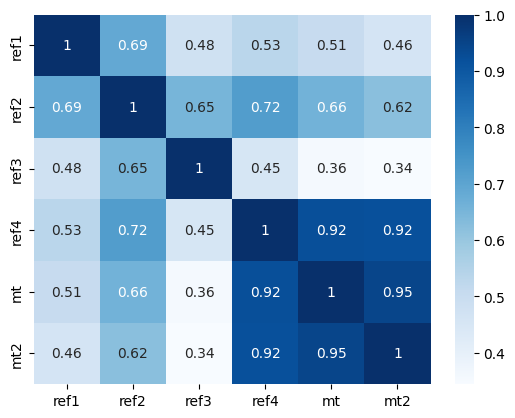

SL_950
src
19589480415784.91
6695745864435.366
ref1
11614139098085.387
253466030043.33527
ref2
9317232325992.078
242234435192.56866
ref3
10020426176511.686
317724591197.6283
ref4
8115782406234.718
223114518884.33582
mt
4483524233312.185
282188721617.51495
mt2
11038305085980.809
251355175637.33563
             ref1_SL_950  ref2_SL_950  ref3_SL_950  ref4_SL_950  mt_SL_950  \
ref1_SL_950     1.000000     0.681551     0.462041     0.515661   0.491244   
ref2_SL_950     0.681551     1.000000     0.638480     0.708969   0.647687   
ref3_SL_950     0.462041     0.638480     1.000000     0.436924   0.337572   
ref4_SL_950     0.515661     0.708969     0.436924     1.000000   0.922844   
mt_SL_950       0.491244     0.647687     0.337572     0.922844   1.000000   
mt2_SL_950      0.446714     0.609717     0.326900     0.919916   0.951294   

             mt2_SL_950  
ref1_SL_950    0.446714  
ref2_SL_950    0.609717  
ref3_SL_950    0.326900  
ref4_SL_950    0.919916  
mt_SL_950      0.951294  

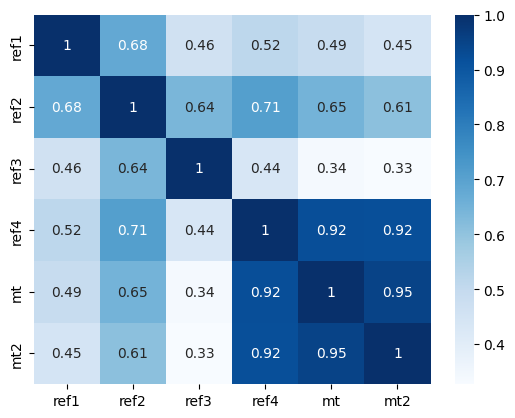

SL_975
src
50173418288827.71
15873783084476.455
ref1
30395077002686.48
546961674855.01215
ref2
24037108153639.023
519117633391.41077
ref3
26183549782315.527
682008232602.3203
ref4
20935940242886.574
485153765005.65234
mt
11195089541542.629
603867218777.3384
mt2
28487487524856.254
539657448660.47815
             ref1_SL_975  ref2_SL_975  ref3_SL_975  ref4_SL_975  mt_SL_975  \
ref1_SL_975     1.000000     0.673430     0.446855     0.500395   0.475822   
ref2_SL_975     0.673430     1.000000     0.625244     0.695329   0.633695   
ref3_SL_975     0.446855     0.625244     1.000000     0.420380   0.320005   
ref4_SL_975     0.500395     0.695329     0.420380     1.000000   0.922545   
mt_SL_975       0.475822     0.633695     0.320005     0.922545   1.000000   
mt2_SL_975      0.432686     0.596317     0.310457     0.921080   0.954318   

             mt2_SL_975  
ref1_SL_975    0.432686  
ref2_SL_975    0.596317  
ref3_SL_975    0.310457  
ref4_SL_975    0.921080  
mt_SL_975      0.954318

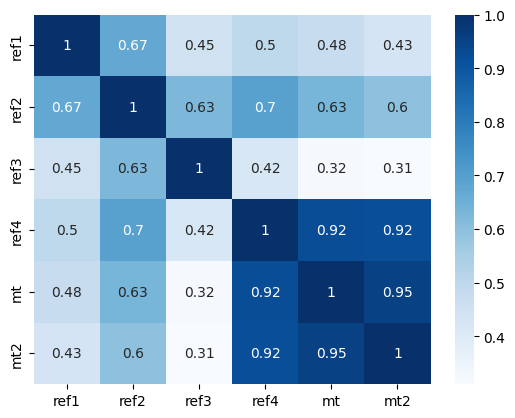

gini
src
0.31563828206910927
0.3213567916370929
ref1
0.40340993966042127
0.40208344537824947
ref2
0.3927399165071558
0.3917046790356469
ref3
0.3937490523419432
0.3937859590789786
ref4
0.4077316962624612
0.40800387896868684
mt
0.3883905388082276
0.38770784983795786
mt2
0.3977263769680306
0.39816874452064743
           ref1_gini  ref2_gini  ref3_gini  ref4_gini   mt_gini  mt2_gini
ref1_gini   1.000000   0.681370   0.681980   0.710001  0.658943  0.599790
ref2_gini   0.681370   1.000000   0.739076   0.711348  0.638220  0.670359
ref3_gini   0.681980   0.739076   1.000000   0.661754  0.659886  0.595470
ref4_gini   0.710001   0.711348   0.661754   1.000000  0.666319  0.609249
mt_gini     0.658943   0.638220   0.659886   0.666319  1.000000  0.791704
mt2_gini    0.599790   0.670359   0.595470   0.609249  0.791704  1.000000


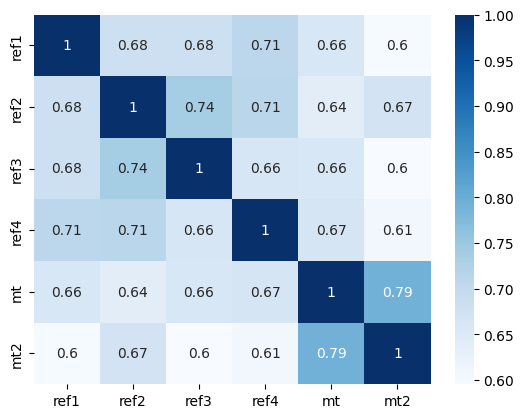

kl
src
-4.884333617860042
-4.932975311904325
ref1
-4.375580756234848
-4.471786823582061
ref2
-4.357992551868425
-4.44834380046887
ref3
-4.332488087673564
-4.372560867287387
ref4
-4.400340281836
-4.514973162549409
mt
-4.325409526297352
-4.380937302401361
mt2
-4.344052910447628
-4.424839065214715
          ref1_kl   ref2_kl   ref3_kl   ref4_kl     mt_kl    mt2_kl
ref1_kl  1.000000  0.973865  0.965243  0.972639  0.946574  0.942987
ref2_kl  0.973865  1.000000  0.976889  0.978030  0.956233  0.953082
ref3_kl  0.965243  0.976889  1.000000  0.967251  0.949483  0.945128
ref4_kl  0.972639  0.978030  0.967251  1.000000  0.951602  0.946148
mt_kl    0.946574  0.956233  0.949483  0.951602  1.000000  0.987890
mt2_kl   0.942987  0.953082  0.945128  0.946148  0.987890  1.000000


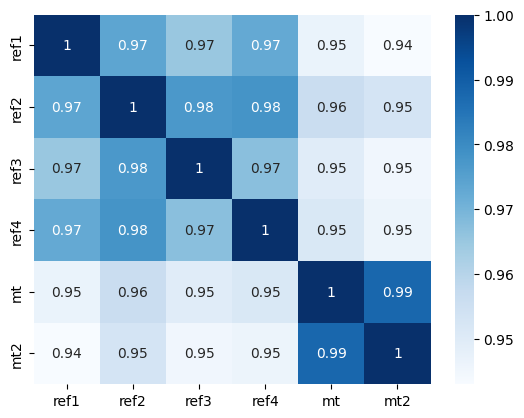

cv
src
0.6024360151910284
0.6016211538294783
ref1
0.7878905177032147
0.7665451058348818
ref2
0.7648304771955067
0.7517974724720469
ref3
0.7616955883473338
0.7507516633273782
ref4
0.7951983985549635
0.7831238518079991
mt
0.7482140489001441
0.7444170840030621
mt2
0.7673575496749723
0.7534434088543069
          ref1_cv   ref2_cv   ref3_cv   ref4_cv     mt_cv    mt2_cv
ref1_cv  1.000000  0.724385  0.691203  0.766273  0.687224  0.653180
ref2_cv  0.724385  1.000000  0.741435  0.742947  0.695040  0.731510
ref3_cv  0.691203  0.741435  1.000000  0.686377  0.686759  0.650314
ref4_cv  0.766273  0.742947  0.686377  1.000000  0.696324  0.688182
mt_cv    0.687224  0.695040  0.686759  0.696324  1.000000  0.821462
mt2_cv   0.653180  0.731510  0.650314  0.688182  0.821462  1.000000


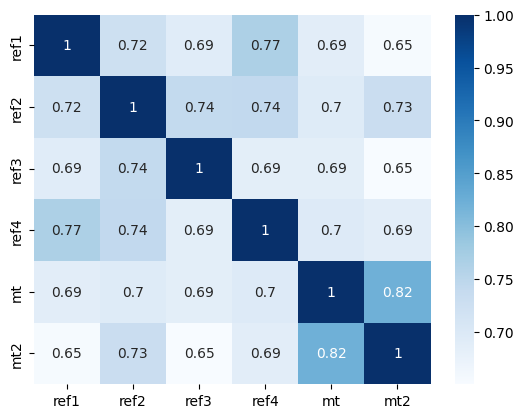

lv
src
72.35425230811832
69.03561950442358
ref1
42.2415362362976
35.78369037548454
ref2
43.538585150833825
36.170454652545274
ref3
44.4293139962987
38.635304102203634
ref4
41.35379913057194
34.307097813492625
mt
42.7994873910154
36.58827084007069
mt2
48.30325888851968
41.452631769746176
          ref1_lv   ref2_lv   ref3_lv   ref4_lv     mt_lv    mt2_lv
ref1_lv  1.000000  0.795276  0.773289  0.821214  0.774113  0.683395
ref2_lv  0.795276  1.000000  0.775227  0.861902  0.767897  0.723253
ref3_lv  0.773289  0.775227  1.000000  0.780938  0.682543  0.626533
ref4_lv  0.821214  0.861902  0.780938  1.000000  0.764970  0.752435
mt_lv    0.774113  0.767897  0.682543  0.764970  1.000000  0.835105
mt2_lv   0.683395  0.723253  0.626533  0.752435  0.835105  1.000000


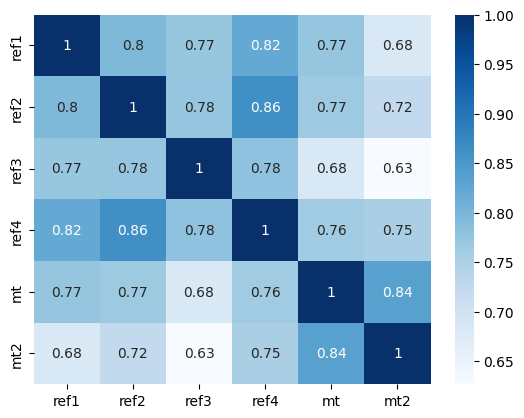

renyi
src
-1427.9866835017451
-1356.6203925467917
ref1
-600.7004504197579
-535.6160308927231
ref2
-619.3230612642548
-546.4042917881115
ref3
-628.6835022337216
-551.4037157181353
ref4
-601.4283789115375
-525.8899584504193
mt
-622.5682074460502
-552.2265013158881
mt2
-642.8141738872146
-550.6109339050756
            ref1_renyi  ref2_renyi  ref3_renyi  ref4_renyi  mt_renyi  \
ref1_renyi    1.000000    0.970269    0.963876    0.976807  0.963182   
ref2_renyi    0.970269    1.000000    0.964230    0.973272  0.957929   
ref3_renyi    0.963876    0.964230    1.000000    0.961654  0.954178   
ref4_renyi    0.976807    0.973272    0.961654    1.000000  0.961824   
mt_renyi      0.963182    0.957929    0.954178    0.961824  1.000000   
mt2_renyi     0.957046    0.955708    0.947430    0.957924  0.979223   

            mt2_renyi  
ref1_renyi   0.957046  
ref2_renyi   0.955708  
ref3_renyi   0.947430  
ref4_renyi   0.957924  
mt_renyi     0.979223  
mt2_renyi    1.000000  


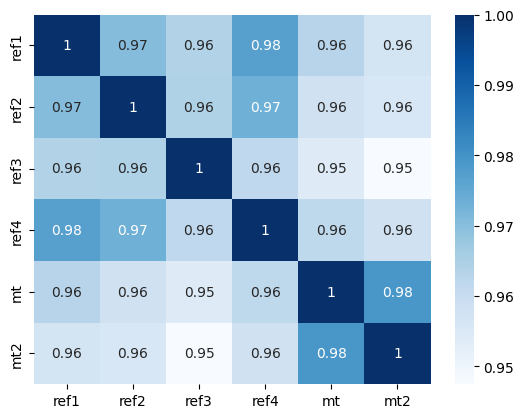

41.78302361451637
28.197880738793028
28.60568290961561
29.47025949590195
27.506966872139955
28.963060562397253


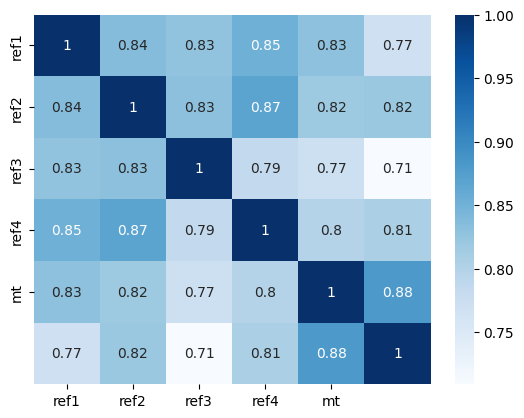

*************************************
28.128691316422515
28.128691316422515
28.612846715853628
29.589013525909866
27.43930592610696
29.132980567226266
                                            source_sent  \
0     Sony, Disney Back To Work On Third Spider-Man ...   
1     Looks like there will be a homecoming of sorts...   
2     The two studios announced on Friday that they ...   
3     The as yet untitled film will be released on J...   
4     Amy Pascal will also produce through Pascal Pi...   
...                                                 ...   
1755  Unsurprisingly, the driver of this growth in i...   
1756  "The biggest growth is coming from China. In t...   
1757  As for the growth in investments, there are no...   
1758  In a December 2018 report the Energy Informati...   
1759  In Canada, there is just one LNG project under...   

                                              ref_sent1  \
0     Disney se vrací, bude spolupracovat se Sony na...   
1     Vypadá to, že se

In [11]:
import seaborn as sns
import numpy as np
from scipy.stats import pearsonr
import matplotlib.pyplot as plt

def analyze(suffix):
    ref1_mean=np.mean([r for s in ref1_surps for r in s])
    ref2_mean=np.mean([r for s in ref2_surps for r in s])
    ref3_mean=np.mean([r for s in ref3_surps for r in s])
    ref4_mean=np.mean([r for s in ref4_surps for r in s])

    trans_mean=np.mean([r for s in trans_surps for r in s])
    trans2_mean=np.mean([r for s in trans2_surps for r in s])

    ref_glob_mean=np.mean([r for ref_surps in (ref1_surps,ref2_surps,ref3_surps,ref4_surps, trans_surps, trans2_surps) for s in ref_surps for r in s])
    src_mean=np.mean([r for s in src_surps for r in s])
    print(ref1_mean)
    print(ref2_mean)
    print(ref3_mean)
    print(ref4_mean)
    print(trans_mean)
    print(ref_glob_mean)
    results={}
    results["src"]={}
    results["ref1"]={}
    results["ref2"]={}
    results["ref3"]={}
    results["ref4"]={}
    results["mt"]={}
    results["mt2"]={}
    df["mt_comet"]=trans_comet
    df["mt2_comet"]=trans2_comet

    for fn in fnames:
        print(fn)
        df["src_"+fn]=compute_metrics(src_surps, fn)
        df["ref1_"+fn]=compute_metrics(ref1_surps, fn)
        df["ref2_"+fn]=compute_metrics(ref2_surps, fn)
        df["ref3_"+fn]=compute_metrics(ref3_surps, fn)
        df["ref4_"+fn]=compute_metrics(ref4_surps, fn)
        df["mt_"+fn]=compute_metrics(trans_surps, fn)
        df["mt2_"+fn]=compute_metrics(trans2_surps, fn)
        for d in ["src","ref1","ref2", "ref3", "ref4", "mt", "mt2"]:
            print(d)
            print(df[d+"_"+fn].mean())
            print(df[d+"_"+fn].median())
            results[d][fn+"_mean"]=df[d+"_"+fn].mean()
            results[d][fn+"_median"]=df[d+"_"+fn].median()
            results[d][fn+"_std"]=df[d+"_"+fn].std()

        corr=df[["ref1_"+fn,"ref2_"+fn, "ref3_"+fn, "ref4_"+fn, "mt_"+fn, "mt2_"+fn]].corr()
        print(corr)

        sns.heatmap(corr, cmap="Blues", annot=True, 
                    xticklabels=["ref1","ref2","ref3","ref4","mt", "mt2"], yticklabels=["ref1","ref2","ref3","ref4","mt", "mt2"])
        plt.savefig(f"out_img/heatmap_opt{suffix}_{fn}.png", bbox_inches='tight', transparent=True, pad_inches=0)
        plt.show()

    fn="gv"
    df["src_"+fn]=[gv(src_surp,mean=src_mean) for src_surp in src_surps]
    df["ref1_"+fn]=[gv(ref1_surp, mean=ref1_mean)  for ref1_surp in ref1_surps]
    df["ref2_"+fn]=[gv(ref2_surp, mean=ref2_mean) for ref2_surp in ref2_surps]
    df["ref3_"+fn]=[gv(ref3_surp, mean=ref3_mean) for ref3_surp in ref3_surps]
    df["ref4_"+fn]=[gv(ref4_surp, mean=ref4_mean) for ref4_surp in ref4_surps]
    df["mt_"+fn]=[gv(trans_surp, mean=trans_mean) for trans_surp in trans_surps]
    df["mt2_"+fn]=[gv(trans_surp, mean=trans2_mean) for trans_surp in trans2_surps]

    print(df["src_"+fn].mean())
    print(df["ref1_"+fn].mean())
    print(df["ref2_"+fn].mean())
    print(df["ref3_"+fn].mean())
    print(df["ref4_"+fn].mean())
    print(df["mt_"+fn].mean())
    for d in ["src","ref1","ref2", "ref3", "ref4", "mt", "mt2"]:
        results[d][fn+"_mean"]=df[d+"_"+fn].mean()
        results[d][fn+"_median"]=df[d+"_"+fn].median()
        results[d][fn+"_std"]=df[d+"_"+fn].std()
    corr=df[["ref1_"+fn,"ref2_"+fn, "ref3_"+fn, "ref4_"+fn, "mt_"+fn, "mt2_"+fn]].corr()

    sns.heatmap(corr, cmap="Blues", annot=True, 
        xticklabels=["ref1","ref2","ref3","ref4","mt"], yticklabels=["ref1","ref2","ref3","ref4","mt"])
    plt.savefig(f"out_img/heatmap_opt{suffix}_{fn}.png", bbox_inches='tight', transparent=True, pad_inches=0)
    plt.show()
    print("*************************************")
    fn="gv_glob"
    df["src_"+fn]=[gv(ref1_surp, mean=ref_glob_mean)  for ref1_surp in ref1_surps]
    df["ref1_"+fn]=[gv(ref1_surp, mean=ref_glob_mean)  for ref1_surp in ref1_surps]
    df["ref2_"+fn]=[gv(ref2_surp, mean=ref_glob_mean) for ref2_surp in ref2_surps]
    df["ref3_"+fn]=[gv(ref3_surp, mean=ref_glob_mean) for ref3_surp in ref3_surps]
    df["ref4_"+fn]=[gv(ref4_surp, mean=ref_glob_mean) for ref4_surp in ref4_surps]
    df["mt_"+fn]=[gv(trans_surp, mean=ref_glob_mean) for trans_surp in trans_surps]
    df["mt2_"+fn]=[gv(trans_surp, mean=ref_glob_mean) for trans_surp in trans2_surps]

    print(df["src_"+fn].mean())
    print(df["ref1_"+fn].mean())
    print(df["ref2_"+fn].mean())
    print(df["ref3_"+fn].mean())
    print(df["ref4_"+fn].mean())
    print(df["mt_"+fn].mean())

    print(df)
    for d in ["src","ref1","ref2", "ref3", "ref4", "mt", "mt2"]:
        results[d][fn+"_mean"]=df[d+"_"+fn].mean()
        results[d][fn+"_median"]=df[d+"_"+fn].median()
        results[d][fn+"_std"]=df[d+"_"+fn].std()

    r=pd.DataFrame.from_dict(results)
    r.to_csv(f"ort_results{suffix}.csv")
for suffix in ["_tok_BUT", "_tok_MU","_BUT", "_MU","_tok_no_punct_BUT", "_tok_no_punct_MU" ]:
    for orig in [True, False]:
        print(suffix)
        df, src_surps, trans_surps, trans2_surps, ref1_surps, ref2_surps, ref3_surps, ref4_surps, trans_comet, trans2_comet=process_files(suffix, orig)
        if orig:
            analyze(suffix+"_orig")
        else:
            analyze(suffix)

In [ ]:
fn="lv"
t=0.89
#print(df)
print(df[(df["mt2_comet"]>t) & (df["mt_comet"]>t) ])
hq=df[(df["mt2_comet"]>t) & (df["mt_comet"]>t)]
for d in ["src","ref1","ref2", "ref3", "ref4", "mt", "mt2"]:
    print(d)
    print(hq[d+"_"+fn].mean())
    print(hq[d+"_"+fn].median())